We have a few elements that can be useful. Word counts, average word length, parts of speech, and the content of the review. 

Let's see which words are associated with each game.

we can group vectors by week or month... we can get bi and trigrams counts for each month.



In [34]:
# Load com.miHoYo.GenshinImpact

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
# from google_play_scraper import app, Sort, reviews_all, permissions

from os import listdir, path
from os.path import isfile, join
import pickle
from collections import Counter

# import these modules
import nltk
from nltk.corpus import stopwords
nltk.data.path.append('/tf/school/Capstone')
nltk.download('wordnet', download_dir='/tf/school/Capstone')
nltk.download('omw-1.4', download_dir='/tf/school/Capstone')
nltk.download('stopwords', download_dir='/tf/school/Capstone')
from nltk.stem import WordNetLemmatizer

my_stopwords = nltk.corpus.stopwords.words('english')
stemmer = nltk.stem.snowball.PorterStemmer(ignore_stopwords=False).stem
my_punctuation = '!"$%&\'()*+,-./:;<=>?[\\]^_`{|}~•@'


import commonFunctions as cf

import re


def getReviewsDf(app_id = None):
    mypath = 'sentReviews/'
    reviews_df = None
    if path.exists(mypath + app_id):
        reviews_df = pd.read_pickle(mypath + app_id, compression='gzip')

    return reviews_df

# reviews_df = getReviewsDf('com.YoStarEN.Arknights.pkl')

reviews_df = cf.getReviewsDf()

display(reviews_df.columns)
print(len(reviews_df))
# Let's remove some elements that won't help us that much this includes foreign languages...
reviews_df = reviews_df[reviews_df['review_average_word_len'] < 15]

# remove reviews that don't have the POS tags
tempCols = ['NN','NNS','NNP','NNPS','VB','VBG','VBD','VBN','VBP','VBZ','JJ','JJR','JJS']

reviews_df['sum'] = reviews_df[tempCols].sum(axis=1)
reviews_df = reviews_df[reviews_df['sum'] > 0]

print(len(reviews_df))

reviews_df.head()

[nltk_data] Downloading package wordnet to /tf/school/Capstone...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /tf/school/Capstone...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package stopwords to /tf/school/Capstone...
[nltk_data]   Package stopwords is already up-to-date!


Index(['reviewId', 'userName', 'content', 'score', 'thumbsUpCount', 'at',
       'title', 'description', 'summary', 'size', 'developer', 'contentRating',
       'updated', 'released', 'appId', 'sentiment', 'review_word_count',
       'review_average_word_len', 'NN', 'NNS', 'NNP', 'NNPS', 'VB', 'VBG',
       'VBD', 'VBN', 'VBP', 'VBZ', 'JJ', 'JJR', 'JJS'],
      dtype='object')

2461319
1503346


,reviewId,userName,content,score,thumbsUpCount,at,title,description,summary,size,...,VB,VBG,VBD,VBN,VBP,VBZ,JJ,JJR,JJS,sum
0,gp:AOqpTOHeXtcxesY0s6oCJYMlDPBOZ4Zdnj6HzbPhcd1...,Derrick Frantal,Fun. Strategic. Nice art. But most importantly...,5,0,2022-03-15 01:52:10,Arknights,Take on the role of a key member of Rhodes Isl...,"Through the darkness, we see light",92M,...,0,0,0,0,0,0,0,0,0,3
1,gp:AOqpTOFnfbcsywKq4__k6rBBWkoKtmj5R8mXfRTQqVg...,M A.,Hardest game i ever play,5,0,2022-03-15 01:24:59,Arknights,Take on the role of a key member of Rhodes Isl...,"Through the darkness, we see light",92M,...,0,0,0,0,0,0,0,0,0,2
2,gp:AOqpTOH7IFtnDuyQdwXbdHktD9pSQcZ1051pC5Hsfn_...,Kazzi,"most rewarding for rewards and gacha, immersiv...",5,1,2022-03-15 00:34:13,Arknights,Take on the role of a key member of Rhodes Isl...,"Through the darkness, we see light",92M,...,3,0,0,0,0,0,4,0,0,13
3,gp:AOqpTOEHcra3ybz74C9MhORbu8xdgaI5ALU0zQh3q1O...,Arjey Bagasbas,"For F2P players and weebs here, this is a game...",5,0,2022-03-14 23:56:09,Arknights,Take on the role of a key member of Rhodes Isl...,"Through the darkness, we see light",92M,...,3,0,0,0,4,5,5,0,0,41
4,gp:AOqpTOG-4_b2Qow31H3SxYxv_Sr3PKTt2_3ZH4ZeGiy...,Zweï,Strategy rpg × tower defence blended to perfec...,5,0,2022-03-14 23:07:11,Arknights,Take on the role of a key member of Rhodes Isl...,"Through the darkness, we see light",92M,...,0,0,0,0,0,0,0,0,0,4


In [35]:
# we can preprocess some text...



from nltk.corpus import wordnet
import nltk
nltk.download('wordnet', download_dir='/tf/school/Capstone')


from nltk.stem import WordNetLemmatizer
 
lemmatizer = WordNetLemmatizer()
 
    
    
my_stopwords = nltk.corpus.stopwords.words('english')
word_rooter = nltk.stem.snowball.PorterStemmer(ignore_stopwords=False).stem



reviews_df['content']=reviews_df['content'].str.lower()

# remove extra whitespaces
def remove_whitespace(text):
    return  " ".join(text.split())


def remove_puncuation(text):
    my_punctuation = '!"$%&\'()*+,-./:;<=>?[\\]^_`{|}~•@'
    return re.sub('['+my_punctuation + ']+', '', text) # strip punctuation

def remove_numbers(text):
    return re.sub('([0-9]+)', '', text) # remove numbers

def remove_stopwords(text):
     return " ".join([word for word in text.split(' ')
                            if word not in my_stopwords]) # remove stopwords
def lemmatize_stemming(text):
    return word_rooter(WordNetLemmatizer().lemmatize(text, pos='v'))


reviews_df['content']=reviews_df['content'].apply(lambda x: remove_whitespace(x))

reviews_df['content']=reviews_df['content'].apply(lambda x: remove_puncuation(x))

reviews_df['content']=reviews_df['content'].apply(lambda x: remove_numbers(x))

reviews_df['content']=reviews_df['content'].apply(lambda x: remove_stopwords(x))

reviews_df['content']=reviews_df['content'].apply(lambda x: lemmatize_stemming(x))




from nltk import word_tokenize

# reviews_df['content']=reviews_df['content'].apply(lambda X: word_tokenize(X))

[nltk_data] Downloading package wordnet to /tf/school/Capstone...
[nltk_data]   Package wordnet is already up-to-date!


In [36]:
reviews_df.head()

,reviewId,userName,content,score,thumbsUpCount,at,title,description,summary,size,...,VB,VBG,VBD,VBN,VBP,VBZ,JJ,JJR,JJS,sum
0,gp:AOqpTOHeXtcxesY0s6oCJYMlDPBOZ4Zdnj6HzbPhcd1...,Derrick Frantal,fun strategic nice art importantly fun,5,0,2022-03-15 01:52:10,Arknights,Take on the role of a key member of Rhodes Isl...,"Through the darkness, we see light",92M,...,0,0,0,0,0,0,0,0,0,3
1,gp:AOqpTOFnfbcsywKq4__k6rBBWkoKtmj5R8mXfRTQqVg...,M A.,hardest game ever play,5,0,2022-03-15 01:24:59,Arknights,Take on the role of a key member of Rhodes Isl...,"Through the darkness, we see light",92M,...,0,0,0,0,0,0,0,0,0,2
2,gp:AOqpTOH7IFtnDuyQdwXbdHktD9pSQcZ1051pC5Hsfn_...,Kazzi,rewarding rewards gacha immersive content char...,5,1,2022-03-15 00:34:13,Arknights,Take on the role of a key member of Rhodes Isl...,"Through the darkness, we see light",92M,...,3,0,0,0,0,0,4,0,0,13
3,gp:AOqpTOEHcra3ybz74C9MhORbu8xdgaI5ALU0zQh3q1O...,Arjey Bagasbas,fp players weebs game fits especially ones lov...,5,0,2022-03-14 23:56:09,Arknights,Take on the role of a key member of Rhodes Isl...,"Through the darkness, we see light",92M,...,3,0,0,0,4,5,5,0,0,41
4,gp:AOqpTOG-4_b2Qow31H3SxYxv_Sr3PKTt2_3ZH4ZeGiy...,Zweï,strategy rpg × tower defence blended perfect,5,0,2022-03-14 23:07:11,Arknights,Take on the role of a key member of Rhodes Isl...,"Through the darkness, we see light",92M,...,0,0,0,0,0,0,0,0,0,4


In [37]:
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer

no_features = 1000

documents = reviews_df['content']


# NMF is able to use tf-idf
tfidf_vectorizer = TfidfVectorizer(max_df=0.85, min_df=10, max_features=no_features, stop_words='english')
tfidf = tfidf_vectorizer.fit_transform(documents)
tfidf_feature_names = tfidf_vectorizer.get_feature_names()

# LDA can only use raw term counts for LDA because it is a probabilistic graphical model
tf_vectorizer = CountVectorizer(max_df=0.85, min_df=10, max_features=no_features, stop_words='english')
tf = tf_vectorizer.fit_transform(documents)
tf_feature_names = tf_vectorizer.get_feature_names()

/.local/lib/python3.8/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [38]:
# Let's try again...
# https://towardsdatascience.com/topic-modeling-and-latent-dirichlet-allocation-in-python-9bf156893c24


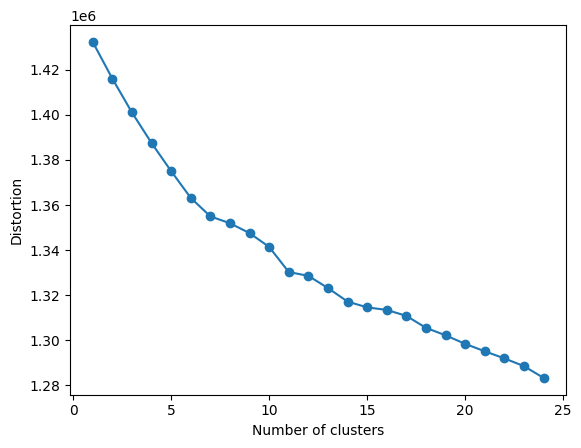

In [39]:
# calculate distortion for a range of number of cluster
from sklearn.cluster import KMeans
import numpy as np
from sklearn.decomposition import NMF, LatentDirichletAllocation


X = tfidf
distortions = []

for i in range(1, 25):
#     lda = LatentDirichletAllocation(n_topics=i, max_iter=5,
#                                     learning_method='online', 
#                                     learning_offset=50.,
#                                     random_state=0).fit(tf)

    km = KMeans(
        n_clusters=i, init='random',
        n_init=10, max_iter=300,
        tol=1e-04, random_state=0
    )
    km.fit(X)
    distortions.append(km.inertia_)

# plot
plt.plot(range(1, 25), distortions, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Distortion')
plt.show()

In [40]:
# calculate distortion for a range of number of cluster
# from sklearn.cluster import KMeans
# import numpy as np


# X = tfidf
# distortions = []

# for i in range(1, 11):
#     km = KMeans(
#         n_clusters=i, init='random',
#         n_init=10, max_iter=300,
#         tol=1e-04, random_state=0
#     )
#     km.fit(X)
#     distortions.append(km.inertia_)

# # plot
# plt.plot(range(1, 11), distortions, marker='o')
# plt.xlabel('Number of clusters')
# plt.ylabel('Distortion')
# plt.show()

In [41]:
# from sklearn.cluster import KMeans

# km = KMeans(
#     n_clusters=7, init='random',
#     n_init=10, max_iter=300, 
#     tol=1e-04, random_state=0
# )
# y_km = km.fit_predict(X)

# reviews_df['cluster'] = y_km

In [42]:
# reviews_df.head()

In [43]:
# reviews_df[['score','cluster']].groupby('cluster').mean().reset_index()

In [44]:
# plt.scatter(
#     X[y_km == 0, 0], X[y_km == 0, 1],
#     s=50, c='lightgreen',
#     marker='s', edgecolor='black',
#     label='cluster 1'
# )

# plt.scatter(
#     X[y_km == 1, 0], X[y_km == 1, 1],
#     s=50, c='orange',
#     marker='o', edgecolor='black',
#     label='cluster 2'
# )

# plt.scatter(
#     X[y_km == 2, 0], X[y_km == 2, 1],
#     s=50, c='lightblue',
#     marker='v', edgecolor='black',
#     label='cluster 3'
# )

# # plot the centroids
# plt.scatter(
#     km.cluster_centers_[:, 0], km.cluster_centers_[:, 1],
#     s=250, marker='*',
#     c='red', edgecolor='black',
#     label='centroids'
# )
# plt.legend(scatterpoints=1)
# plt.grid()
# plt.show()

In [45]:
#NOTE: we have to plot the number of the cluster somehow. We don't know 0,0 is cluster 0

# to me it looks like there might be 5 groups not the 7. The three in the bottom left appear pretty close and what is the 0,0 position?
# before we get too far we need to know what this 0,0 is. It's possible we need to remove that if it is dirty data.

# display(reviews_df['score'].mean())
# display((reviews_df[reviews_df['cluster'] == 0])['score'].mean())
# display((reviews_df[reviews_df['cluster'] == 0])['score'].values[:10])
# display((reviews_df[reviews_df['cluster'] == 0])['sentiment'].values[:10])
# (reviews_df[reviews_df['cluster'] == 0])['content'].values[:10]

In [46]:
# I can see some weird situations... someone gave a score of 1, but the sentiment was positive, and when I read it
# it was also informative and sounded good. Maybe the cluster is properly grouping good comments?


# km = KMeans(
#     n_clusters=5, init='random',
#     n_init=10, max_iter=300, 
#     tol=1e-04, random_state=0
# )
# y_km = km.fit_predict(X)

# # reviews_df['cluster'] = y_km



# plt.scatter(
#     km.cluster_centers_[:, 0], km.cluster_centers_[:, 1],
#     s=250, marker='*',
#     c='red', edgecolor='black',
#     label='centroids'
# )
# plt.legend(scatterpoints=1)
# plt.grid()
# plt.show()

In [47]:
# LDA

# from sklearn.decomposition import LatentDirichletAllocation
# from sklearn.model_selection import GridSearchCV

# # lda = LatentDirichletAllocation(n_topics=no_topics, max_iter=5, learning_method='online', learning_offset=50.,random_state=0).fit(tf)


# # Define Search Param
# search_params = {'n_components': [5,7,10], 'learning_decay': [.5]}

# # Init the Model
# lda = LatentDirichletAllocation(n_jobs=-1)

# # Init Grid Search Class
# model = GridSearchCV(lda, param_grid=search_params)

# # Do the Grid Search
# model.fit(tf)

In [48]:
# # Best Model
# best_lda_model = model.best_estimator_

# # Model Parameters
# print("Best Model's Params: ", model.best_params_)

# # Log Likelihood Score
# print("Best Log Likelihood Score: ", model.best_score_)

# # Perplexity
# print("Model Perplexity: ", best_lda_model.perplexity(tf))

In [49]:

# LDA can only use raw term counts for LDA because it is a probabilistic graphical model
tf_vectorizer = CountVectorizer(max_df=0.80, min_df=10, max_features=no_features, stop_words='english')
tf = tf_vectorizer.fit_transform(documents)
tf_feature_names = tf_vectorizer.get_feature_names()


def display_topics(model, feature_names, no_top_words):
    for topic_idx, topic in enumerate(model.components_):
        print("Topic %d:" % (topic_idx))
        print(" ".join([feature_names[i]
                        for i in topic.argsort()[:-no_top_words - 1:-1]]))

        
lda = LatentDirichletAllocation(n_components=5,n_jobs=-1,
                                max_iter=5, learning_method='online', learning_offset=50.,random_state=0).fit(tf)
     

/.local/lib/python3.8/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [50]:
display_topics(lda, tf_feature_names, 20)

Topic 0:
game play fix app update phone download time account im data problem cat wont screen lost error start playing help
Topic 1:
game love best great gam played mobile amazing ive games play far final rpg fantasy playing im fan like worth
Topic 2:
game cards yugioh dont make like money star duel need bad think add deck want im better got spend people
Topic 3:
game good fun great play really like awesome gam pay free graphics cool easy time win pretty old real story
Topic 4:
game card fun nice characters really playing new hard enjoy story like bit pvp monsters games cats lot play monster


In [51]:
reviews_df['title'].unique()

array(['Arknights', 'Azur Lane', 'Fate/Grand Order (English)',
       'Disney Twisted-Wonderland', 'DRAGON BALL LEGENDS',
       'MY HERO ULTRA IMPACT', 'ONE PIECE Bounty Rush',
       'SLIME - ISEKAI Memories', 'DRAGON BALL Z DOKKAN BATTLE',
       'Summoners War', 'Princess Connect! Re: Dive',
       'Pokémon Masters EX', 'Idle Heroes', 'Guardian Tales', 'AFK Arena',
       'Genshin Impact', 'Honkai Impact 3rd', 'ONE PIECE TREASURE CRUISE',
       'Identity V', 'MARVEL Future Fight', 'The Seven Deadly Sins',
       'MapleStory M - Fantasy MMORPG', 'Fire Emblem Heroes',
       'Mario Kart Tour', 'RAID: Shadow Legends',
       'HATSUNE MIKU: COLORFUL STAGE!', 'DISSIDIA FINAL FANTASY OO',
       'FINAL FANTASY  BRAVE EXVIUS', 'FFBE WAR OF THE VISIONS',
       'Epic Seven', 'Evertale', 'ANOTHER EDEN Global', 'The Battle Cats',
       'Puzzle & Dragons', 'Yu-Gi-Oh! Duel Links',
       'Yu-Gi-Oh! Master Duel'], dtype=object)

In [52]:
lda.components_.shape


(5, 1000)

In [53]:
W = lda.transform(tf)

In [54]:
W.shape

(1503346, 5)

In [55]:
W[0]

array([0.04      , 0.04060681, 0.04      , 0.46011462, 0.41927857])

In [56]:
W[0:5]

array([[0.04      , 0.04060681, 0.04      , 0.46011462, 0.41927857],
       [0.06822041, 0.06877752, 0.06690384, 0.72863786, 0.06746037],
       [0.01602537, 0.33155003, 0.09727487, 0.01546336, 0.53968637],
       [0.07452397, 0.00777821, 0.75568508, 0.00776125, 0.15425149],
       [0.04      , 0.24000052, 0.04      , 0.29652746, 0.38347202]])

In [57]:
# get the highest field
clusters= [np.argsort(x)[-1] for x in W]
# clusters

In [58]:
print(len(reviews_df))
print(len(clusters))

1503346
1503346


In [59]:
reviews_df['lda_clusters'] = clusters

In [60]:
reviews_df[reviews_df['lda_clusters'] == 0]['content']

5                             keep crashing logging g ultra 
11         giving one star game crashes every time try ge...
14              trying log day play crashes every single tim
17         reason give one star cause got new phone went ...
19         unplayable new player download frequently cras...
                                 ...                        
2461291    phone never ran hot please fix optimization bo...
2461297    first try looks great theres bug black screen ...
2461301    ingame download keeps turning reason pls solve...
2461304    problem linking konami id android version sets...
2461312     hours pc satisfied game moment putting  stars...
Name: content, Length: 317831, dtype: object

In [61]:
reviews_df[reviews_df['lda_clusters'] == 1]['content']

10         game great pw  yostar make anime game maybe great
20         cant believe ive playing game year expect good...
34         game long dialogues characters yes building en...
39                                      amazing game love iy
92                                            best getcha ev
                                 ...                        
2461281                                  best yugioh game ev
2461287     interactions incorrect overall im blown away gam
2461290    im addicted game im excited build nostalgic fa...
2461300               game got back yugioh many years im lov
2461307                                  best yugioh app tim
Name: content, Length: 307642, dtype: object

In [62]:
reviews_df[reviews_df['lda_clusters'] == 2]['content']

3          fp players weebs game fits especially ones lov...
9          quit alr rated unwelcoming new players pity le...
29         lot players would stayed playing add basic qol...
36         hope arknights implement auto clear stage star...
60                                      love need say anymor
                                 ...                        
2461276    greatest yu gi oh game ever better duel links ...
2461286                  il gioco di carte yugioh definitivo
2461296    love much better duel links getting card much ...
2461311                         rip duel links linked us gam
2461317                                 gave ward dating tip
Name: content, Length: 269265, dtype: object

In [63]:
emotions = pd.read_pickle('emotions_dictionary.plk')

In [64]:
print(type(emotions))

<class 'dict'>


In [65]:
# Regex for identifying words that don’t have numbers.
reg = re.compile(r'[a-zA-Z]+')


match = re.findall(reg, "I was born on June 24") 

In [66]:
match

['I', 'was', 'born', 'on', 'June']

In [67]:

from nltk.corpus import wordnet
import nltk
nltk.download('wordnet', download_dir='/tf/school/Capstone')


from nltk.stem import WordNetLemmatizer
 
lemmatizer = WordNetLemmatizer()
 
    
    
my_stopwords = nltk.corpus.stopwords.words('english')
word_rooter = nltk.stem.snowball.PorterStemmer(ignore_stopwords=False).stem

# nltk.download('averaged_perceptron_tagger', download_dir='/tf/school/Capstone')
# emotions.values()

[nltk_data] Downloading package wordnet to /tf/school/Capstone...
[nltk_data]   Package wordnet is already up-to-date!


In [68]:
word_rooter('acceptance')

'accept'

In [69]:
rootedEmotions = {}

for word in emotions.keys():
    if(word_rooter(word) in rootedEmotions):
        # we need to append
        rootedEmotions[word_rooter(word)].extend([word_rooter(x) for x in emotions[word] ])
    else:
        rootedEmotions[word_rooter(word)] = [word_rooter(x) for x in emotions[word] ]

In [70]:
rootedEmotions

{'accept': ['accept'],
 'admir': ['admir', 'appreci'],
 'ador': ['ador', 'latria'],
 'affect': ['affect',
  'affection',
  'fond',
  'tender',
  'heart',
  'warm',
  'warmhearted',
  'philia'],
 'afraid': ['afraid'],
 'agit': ['agit'],
 'agoni': ['agoni', 'suffer', 'excruci'],
 'aggress': ['aggress', 'belliger'],
 'alarm': ['alarm', 'alert', 'alarm'],
 'alien': ['alien'],
 'amaz': ['astonish', 'amaz'],
 'ambival': ['ambival', 'ambival'],
 'amus': ['entertain', 'amus'],
 'anger': ['anger', 'see_r'],
 'anguish': ['pain', 'anguish', 'hurt'],
 'annoy': ['annoy', 'harass', 'harri', 'pester', 'vex'],
 'anticip': ['anticip'],
 'anxiou': ['anxiou', 'nervou', 'queasi', 'uneasi', 'unquiet'],
 'apathi': ['apathi', 'indiffer', 'numb', 'spiritless'],
 'apprehens': ['apprehens',
  'arrest',
  'catch',
  'collar',
  'pinch',
  'taking_into_custodi'],
 'arrog': ['arrog', 'chesti', 'self-import'],
 'assert': ['assert', 'self-assert', 'self-assert'],
 'astonish': ['amaz', 'astoni', 'astonish', 'astound'

In [71]:
documents = reviews_df['content'].values

In [72]:
def getEmotion(word):
    def findWordInList(word):
        for elem in rootedEmotions.values():
            if word in elem:
                return True
        return False
    
    word = word_rooter(word)
#     print(word)
    if findWordInList(word):
        # get the main word
        for key in rootedEmotions.keys():
            if word in rootedEmotions[key]:
                # if we find the rooted word in a list then get the main word and
                # return it.
                return key
    return None

import re

def tokenize_stem_emotion_vect(text):
    if text is None or text == '':
        return []
#     print(text)
    match = re.findall(reg, text)
#     print(match)
    
    words = [getEmotion(x.lower()) for x in match]
    return [x for x in words if x]

In [73]:
print('ador' in rootedEmotions.values())
tokenize_stem_emotion_vect('I adore it')

False


['ador']

In [74]:
'ador' in ['ador']

True

In [75]:
# rootedEmotions.keys()
# list(rootedEmotions.values())
# rootedEmotions.values()
# fun, rewarding, cute, worth, unfair, patient, perfect, uplifting, great,crash,tri,good, lack, smooth
print(len(documents))
' '.join(tokenize_stem_emotion_vect(documents[20]))

1503346


'depress like interest'

In [76]:
reviews_df['emotions']= reviews_df['content'].apply(lambda x: tokenize_stem_emotion_vect(x))

In [77]:
reviews_df['emotions']

0                                 []
1                                 []
2                          [content]
3                             [love]
4                                 []
                     ...            
2461312    [irrit, hope, disappoint]
2461313                       [like]
2461315                 [hope, like]
2461316                           []
2461317                           []
Name: emotions, Length: 1503346, dtype: object

In [78]:
tf_emotions_vectorizer = CountVectorizer(max_df=0.80, min_df=10, max_features=100, stop_words='english')



# docs = ' '.join()

tf_emotions = tf_emotions_vectorizer.fit_transform(reviews_df['emotions'].apply(lambda x: ' '.join(x) ).values)
tf_emotions_feature_names = tf_emotions_vectorizer.get_feature_names()

/.local/lib/python3.8/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [79]:
# distortions =[]
# for i in range(1, 25):
#     km = KMeans(
#         n_clusters=i, init='random',
#         n_init=10, max_iter=300,
#         tol=1e-04, random_state=0
#     )
#     km.fit(tf_emotions)
#     distortions.append(km.inertia_)

# # plot
# plt.plot(range(1, 25), distortions, marker='o')
# plt.xlabel('Number of clusters')
# plt.ylabel('Distortion')
# plt.show()

In [80]:
# distortions =[]
# for i in range(1, 5):
#     km = KMeans(
#         n_clusters=i, init='random',
#         n_init=10, max_iter=300,
#         tol=1e-04, random_state=0
#     )
#     km.fit(tf_emotions)
#     distortions.append(km.inertia_)

# # plot
# plt.plot(range(1, 5), distortions, marker='o')
# plt.xlabel('Number of clusters')
# plt.ylabel('Distortion')
# plt.show()

In [81]:

def display_topics(model, feature_names, no_top_words):
    for topic_idx, topic in enumerate(model.components_):
        print("Topic %d:" % (topic_idx))
        print(" ".join([feature_names[i]
                        for i in topic.argsort()[:-no_top_words - 1:-1]]))

        
# lda = LatentDirichletAllocation(n_components=3,n_jobs=-1,
#                                 max_iter=5, learning_method='online', learning_offset=50.,random_state=0).fit(tf_emotions)
     

In [82]:
# display_topics(lda, tf_emotions_feature_names, 20)

In [83]:
# print(len(tf_emotions_feature_names))
# print(tf_emotions_feature_names)

In [84]:
emotionNames = [x for x in rootedEmotions.keys()]

In [85]:
print(len(emotionNames))
# emotionNames

270


In [86]:
reviews_df['emotions'].values[3] #in emotionNames

['love']

In [98]:
# create a dictionary for each emotion and store an array of the counts for each pandas row...
pandas_emotions_dict = {}
for emotion in emotionNames:
    # we'll automatically create empty arrays for each review
    pandas_emotions_dict[emotion]=[0] * len(reviews_df)

for index, row in enumerate(reviews_df['emotions'].values):
    print(index)
    print(row)
    for emotion in row:
        print(emotion)
        pandas_emotions_dict[emotion][index] = pandas_emotions_dict[emotion][index] +1

0
[]
1
[]
2
['content']
content
3
['love']
love
4
[]
5
[]
6
['hate']
hate
7
['piti']
piti
8
[]
9
[]
10
['dread']
dread
11
[]
12
['love', 'like']
love
like
13
['like', 'enjoy']
like
enjoy
14
['enjoy']
enjoy
15
['like', 'weak']
like
weak
16
['expect', 'love', 'amaz', 'impati']
expect
love
amaz
impati
17
['enjoy', 'like', 'sullen']
enjoy
like
sullen
18
[]
19
['like', 'like']
like
like
20
['depress', 'like', 'interest']
depress
like
interest
21
['love', 'pleas']
love
pleas
22
[]
23
['pleas']
pleas
24
['like']
like
25
['attract']
attract
26
[]
27
['long']
long
28
['hope', 'enjoy', 'ecstasi', 'enjoy', 'trust', 'annoy', 'discomfort']
hope
enjoy
ecstasi
enjoy
trust
annoy
discomfort
29
['pleas', 'agoni']
pleas
agoni
30
['ecstasi', 'amaz']
ecstasi
amaz
31
['amaz', 'love']
amaz
love
32
[]
33
['interest']
interest
34
['love', 'long', 'shame']
love
long
shame
35
['love', 'like', 'thank']
love
like
thank
36
[]
37
['like', 'bore', 'hope', 'like', 'enjoy']
like
bore
hope
like
enjoy
38
['enjoy']
enjoy


827
[]
828
[]
829
[]
830
[]
831
['stuck']
stuck
832
['piti']
piti
833
[]
834
[]
835
[]
836
[]
837
[]
838
[]
839
['depress', 'curios', 'love']
depress
curios
love
840
['eager']
eager
841
['ecstasi']
ecstasi
842
[]
843
['disappoint']
disappoint
844
[]
845
[]
846
['ecstasi']
ecstasi
847
['like']
like
848
[]
849
[]
850
['strong']
strong
851
['interest']
interest
852
['long', 'like', 'pleas']
long
like
pleas
853
[]
854
[]
855
[]
856
[]
857
[]
858
['seren', 'enjoy', 'content']
seren
enjoy
content
859
[]
860
[]
861
['polit', 'accept']
polit
accept
862
[]
863
[]
864
['like']
like
865
['like', 'hate', 'thank']
like
hate
thank
866
[]
867
['passion', 'hate', 'content']
passion
hate
content
868
[]
869
['happi', 'amaz']
happi
amaz
870
['disappoint']
disappoint
871
[]
872
['thank']
thank
873
['enjoy', 'like', 'like']
enjoy
like
like
874
['friendli', 'toler']
friendli
toler
875
[]
876
[]
877
['annoy']
annoy
878
['pleas']
pleas
879
['love', 'love', 'love', 'loopi', 'like', 'hope', 'like', 'love']
love

1530
[]
1531
['like', 'irrit']
like
irrit
1532
['bore', 'amaz', 'love']
bore
amaz
love
1533
['like']
like
1534
[]
1535
[]
1536
['friendli']
friendli
1537
['love']
love
1538
[]
1539
[]
1540
['depress', 'curios', 'content', 'enjoy']
depress
curios
content
enjoy
1541
['intrigu', 'love', 'content']
intrigu
love
content
1542
[]
1543
['vigil']
vigil
1544
[]
1545
[]
1546
['amaz', 'interest']
amaz
interest
1547
['sad', 'sad']
sad
sad
1548
[]
1549
[]
1550
['like']
like
1551
['amus', 'love', 'fascin', 'amaz']
amus
love
fascin
amaz
1552
['bore']
bore
1553
['love', 'thank']
love
thank
1554
[]
1555
['enjoy']
enjoy
1556
[]
1557
['hope']
hope
1558
['love', 'friendli']
love
friendli
1559
['interest', 'enjoy', 'hope', 'enjoy']
interest
enjoy
hope
enjoy
1560
[]
1561
[]
1562
['enjoy']
enjoy
1563
['amaz', 'gloomi', 'interest']
amaz
gloomi
interest
1564
[]
1565
[]
1566
['enjoy', 'annoy']
enjoy
annoy
1567
[]
1568
['enjoy']
enjoy
1569
[]
1570
['like', 'enjoy']
like
enjoy
1571
[]
1572
['like']
like
1573
[]
15

[]
2458
['polit', 'polit', 'hate', 'gloomi']
polit
polit
hate
gloomi
2459
['like']
like
2460
[]
2461
['gloomi', 'polit', 'shame']
gloomi
polit
shame
2462
[]
2463
['bore', 'like']
bore
like
2464
['friendli', 'like', 'long']
friendli
like
long
2465
['love', 'like']
love
like
2466
['enjoy']
enjoy
2467
['stuck']
stuck
2468
[]
2469
[]
2470
[]
2471
['polit', 'content']
polit
content
2472
[]
2473
['polit']
polit
2474
['polit']
polit
2475
['pleas', 'love']
pleas
love
2476
[]
2477
['long']
long
2478
[]
2479
['like']
like
2480
[]
2481
['content', 'content', 'piti']
content
content
piti
2482
[]
2483
[]
2484
['enjoy', 'admir', 'enjoy', 'depress', 'curios']
enjoy
admir
enjoy
depress
curios
2485
['comfort']
comfort
2486
[]
2487
['expect']
expect
2488
['pleas', 'like']
pleas
like
2489
[]
2490
['content']
content
2491
[]
2492
['interest']
interest
2493
['thrill', 'cheer']
thrill
cheer
2494
[]
2495
['hope']
hope
2496
['polit', 'ecstasi']
polit
ecstasi
2497
['like', 'like']
like
like
2498
[]
2499
[]
250

['like', 'hope']
like
hope
3343
['love', 'like']
love
like
3344
['friendli', 'affect']
friendli
affect
3345
[]
3346
[]
3347
['optimist']
optimist
3348
['love', 'ecstasi']
love
ecstasi
3349
[]
3350
[]
3351
['interest', 'love', 'amaz', 'amaz']
interest
love
amaz
amaz
3352
['interest']
interest
3353
['interest']
interest
3354
['depress', 'enjoy']
depress
enjoy
3355
[]
3356
['like', 'like', 'baffl']
like
like
baffl
3357
['puzzl', 'long']
puzzl
long
3358
['polit']
polit
3359
[]
3360
[]
3361
['hate']
hate
3362
['friendli']
friendli
3363
[]
3364
[]
3365
[]
3366
['amaz', 'love']
amaz
love
3367
['love']
love
3368
['piti', 'ecstasi', 'hope', 'bore']
piti
ecstasi
hope
bore
3369
['love']
love
3370
['weak', 'hope', 'like', 'weak', 'hope']
weak
hope
like
weak
hope
3371
[]
3372
['love', 'love']
love
love
3373
[]
3374
['lazi']
lazi
3375
['eager']
eager
3376
['pleas']
pleas
3377
['enjoy']
enjoy
3378
['like', 'curios', 'like']
like
curios
like
3379
['like', 'hope']
like
hope
3380
['love']
love
3381
[]
3

thank
4260
[]
4261
[]
4262
['depress', 'curios', 'enjoy']
depress
curios
enjoy
4263
['friendli']
friendli
4264
['love']
love
4265
['enjoy', 'dread', 'like', 'like']
enjoy
dread
like
like
4266
['depress', 'viciou']
depress
viciou
4267
['like', 'toler', 'careless']
like
toler
careless
4268
['enjoy']
enjoy
4269
['elat', 'content']
elat
content
4270
[]
4271
[]
4272
['long']
long
4273
[]
4274
['attent']
attent
4275
['friendli', 'satisfact']
friendli
satisfact
4276
[]
4277
[]
4278
['love', 'long', 'interest', 'ecstasi']
love
long
interest
ecstasi
4279
[]
4280
['love']
love
4281
[]
4282
[]
4283
['content', 'long', 'admir']
content
long
admir
4284
['amaz']
amaz
4285
['love', 'enjoy']
love
enjoy
4286
['patienc']
patienc
4287
['like']
like
4288
['ador']
ador
4289
['friendli', 'depress', 'annoy', 'enjoy']
friendli
depress
annoy
enjoy
4290
[]
4291
[]
4292
['love', 'enjoy']
love
enjoy
4293
[]
4294
[]
4295
['amaz', 'ecstasi', 'amaz']
amaz
ecstasi
amaz
4296
[]
4297
['frustrat']
frustrat
4298
[]
4299


love
attract
5139
[]
5140
['friendli', 'comfort']
friendli
comfort
5141
['like', 'delight', 'toler']
like
delight
toler
5142
['long']
long
5143
[]
5144
['amaz', 'doubt', 'like', 'friendli', 'enjoy']
amaz
doubt
like
friendli
enjoy
5145
[]
5146
['attent']
attent
5147
['stuck', 'love']
stuck
love
5148
['love', 'love', 'pleas']
love
love
pleas
5149
['thank', 'like']
thank
like
5150
['like', 'hope', 'eager', 'pleas']
like
hope
eager
pleas
5151
[]
5152
['thank']
thank
5153
['like', 'like']
like
like
5154
[]
5155
['enjoy']
enjoy
5156
['friendli', 'content']
friendli
content
5157
['like']
like
5158
[]
5159
['like']
like
5160
[]
5161
['love', 'vigil']
love
vigil
5162
['interest']
interest
5163
[]
5164
['gloomi']
gloomi
5165
['depress', 'comfort']
depress
comfort
5166
['long', 'love', 'amaz', 'ecstasi']
long
love
amaz
ecstasi
5167
[]
5168
['sad', 'thank']
sad
thank
5169
[]
5170
['long', 'amaz', 'friendli']
long
amaz
friendli
5171
[]
5172
[]
5173
['amaz', 'friendli', 'attent']
amaz
friendli
atten

dread
6143
['enjoy']
enjoy
6144
['content', 'enjoy', 'like', 'baffl', 'enjoy']
content
enjoy
like
baffl
enjoy
6145
['like']
like
6146
[]
6147
[]
6148
['enjoy', 'like']
enjoy
like
6149
['ecstasi', 'kind']
ecstasi
kind
6150
[]
6151
[]
6152
['enjoy', 'enjoy']
enjoy
enjoy
6153
['love', 'love', 'love', 'excit', 'hope', 'long']
love
love
love
excit
hope
long
6154
[]
6155
[]
6156
[]
6157
['friendli', 'like']
friendli
like
6158
['interest', 'bore', 'like', 'elat', 'bore', 'like']
interest
bore
like
elat
bore
like
6159
[]
6160
['pleas', 'annoy']
pleas
annoy
6161
['grumpi', 'content', 'interest', 'curios', 'enjoy', 'enjoy']
grumpi
content
interest
curios
enjoy
enjoy
6162
['ecstasi']
ecstasi
6163
[]
6164
['friendli', 'love']
friendli
love
6165
['ecstasi']
ecstasi
6166
['love']
love
6167
[]
6168
[]
6169
['interest', 'love']
interest
love
6170
[]
6171
[]
6172
['interest', 'content', 'content']
interest
content
content
6173
['piti']
piti
6174
[]
6175
['like']
like
6176
[]
6177
['curios', 'content']


hate
7092
['stuck']
stuck
7093
['like', 'love', 'love', 'enjoy']
like
love
love
enjoy
7094
['comfort', 'content', 'ecstasi', 'enjoy', 'amaz']
comfort
content
ecstasi
enjoy
amaz
7095
['like', 'friendli']
like
friendli
7096
[]
7097
[]
7098
[]
7099
[]
7100
['content', 'depress']
content
depress
7101
['amaz', 'depress', 'curios', 'love']
amaz
depress
curios
love
7102
['love', 'comfort', 'depress', 'hope']
love
comfort
depress
hope
7103
['piti']
piti
7104
['comfort']
comfort
7105
['amaz']
amaz
7106
['pleas']
pleas
7107
[]
7108
['friendli', 'excit', 'thank']
friendli
excit
thank
7109
['happi', 'dread', 'impati']
happi
dread
impati
7110
['enjoy']
enjoy
7111
['enjoy']
enjoy
7112
[]
7113
['like']
like
7114
['vigil']
vigil
7115
[]
7116
['friendli']
friendli
7117
['like']
like
7118
['intrigu']
intrigu
7119
['like', 'like', 'suspici']
like
like
suspici
7120
['bore', 'content']
bore
content
7121
[]
7122
[]
7123
['love']
love
7124
[]
7125
[]
7126
[]
7127
['impati', 'ecstasi']
impati
ecstasi
7128
['h

['love', 'isol', 'love', 'mad']
love
isol
love
mad
8137
[]
8138
['amaz', 'like', 'relax']
amaz
like
relax
8139
[]
8140
['friendli', 'enjoy', 'content', 'hope', 'like']
friendli
enjoy
content
hope
like
8141
['friendli']
friendli
8142
['love', 'hope']
love
hope
8143
['enjoy']
enjoy
8144
['amaz']
amaz
8145
[]
8146
[]
8147
['amaz', 'friendli']
amaz
friendli
8148
[]
8149
['long', 'pleas']
long
pleas
8150
[]
8151
['love', 'love', 'enjoy', 'ecstasi']
love
love
enjoy
ecstasi
8152
['like', 'bore']
like
bore
8153
['like', 'bore', 'pleas']
like
bore
pleas
8154
[]
8155
['thrill']
thrill
8156
['love', 'neg', 'infuri', 'enjoy', 'annoy']
love
neg
infuri
enjoy
annoy
8157
['love']
love
8158
[]
8159
['bore']
bore
8160
[]
8161
[]
8162
['like', 'like', 'stuck', 'suspici']
like
like
stuck
suspici
8163
[]
8164
['like', 'gloomi', 'bore', 'amaz']
like
gloomi
bore
amaz
8165
['curios']
curios
8166
['love']
love
8167
['depress']
depress
8168
[]
8169
['annoy', 'depress', 'pleas']
annoy
depress
pleas
8170
['like',

[]
9086
['friendli', 'bore', 'depress', 'enjoy', 'long', 'enjoy', 'hope', 'content']
friendli
bore
depress
enjoy
long
enjoy
hope
content
9087
[]
9088
['pleas']
pleas
9089
['pleas']
pleas
9090
['love']
love
9091
['enjoy']
enjoy
9092
['enjoy', 'enjoy']
enjoy
enjoy
9093
[]
9094
[]
9095
['like', 'pleas']
like
pleas
9096
[]
9097
['curios', 'depress']
curios
depress
9098
['thank']
thank
9099
[]
9100
['comfort']
comfort
9101
[]
9102
['interest']
interest
9103
[]
9104
['bore', 'gloomi', 'like', 'like']
bore
gloomi
like
like
9105
[]
9106
['like', 'bore', 'enjoy', 'regret']
like
bore
enjoy
regret
9107
['like']
like
9108
['hope']
hope
9109
['amaz', 'love']
amaz
love
9110
[]
9111
[]
9112
[]
9113
['bore', 'thank']
bore
thank
9114
['friendli', 'like']
friendli
like
9115
['comfort', 'friendli', 'like']
comfort
friendli
like
9116
['love', 'enjoy', 'frustrat']
love
enjoy
frustrat
9117
[]
9118
[]
9119
['interest', 'content']
interest
content
9120
[]
9121
['pleas', 'baffl', 'anguish']
pleas
baffl
anguish

10166
[]
10167
['admir', 'love', 'thank']
admir
love
thank
10168
[]
10169
[]
10170
['love', 'gloomi', 'hope']
love
gloomi
hope
10171
['care', 'friendli']
care
friendli
10172
['like', 'ecstasi']
like
ecstasi
10173
['enjoy', 'comfort', 'eager', 'eager']
enjoy
comfort
eager
eager
10174
[]
10175
['amaz', 'thrill', 'afraid']
amaz
thrill
afraid
10176
['comfort', 'ecstasi', 'comfort', 'amaz']
comfort
ecstasi
comfort
amaz
10177
[]
10178
['friendli', 'care']
friendli
care
10179
[]
10180
['love']
love
10181
['like', 'comfort', 'depress', 'like', 'like']
like
comfort
depress
like
like
10182
[]
10183
['anguish', 'anguish']
anguish
anguish
10184
['love']
love
10185
['bore']
bore
10186
[]
10187
['depress', 'like']
depress
like
10188
['like', 'ecstasi', 'ecstasi']
like
ecstasi
ecstasi
10189
[]
10190
['like']
like
10191
[]
10192
['pleas']
pleas
10193
['love', 'like']
love
like
10194
['like', 'like', 'enjoy', 'like', 'love', 'like', 'kind']
like
like
enjoy
like
love
like
kind
10195
[]
10196
[]
10197
[]

[]
11150
[]
11151
['like']
like
11152
['amaz', 'care', 'long', 'comfort']
amaz
care
long
comfort
11153
['ecstasi', 'ecstasi']
ecstasi
ecstasi
11154
[]
11155
[]
11156
[]
11157
['love']
love
11158
['love']
love
11159
[]
11160
[]
11161
[]
11162
['interest', 'suspens', 'love', 'friendli', 'comfort', 'amaz']
interest
suspens
love
friendli
comfort
amaz
11163
['annoy']
annoy
11164
[]
11165
['like']
like
11166
[]
11167
['like', 'vigil', 'annoy', 'neglect', 'agoni']
like
vigil
annoy
neglect
agoni
11168
[]
11169
[]
11170
[]
11171
['love', 'amaz', 'like', 'like']
love
amaz
like
like
11172
['frustrat']
frustrat
11173
['friendli', 'amaz', 'baffl']
friendli
amaz
baffl
11174
[]
11175
[]
11176
['like']
like
11177
['amaz', 'amaz']
amaz
amaz
11178
['depress']
depress
11179
[]
11180
['amaz', 'interest', 'like', 'undermin']
amaz
interest
like
undermin
11181
['thank', 'ecstasi', 'enjoy', 'ecstasi']
thank
ecstasi
enjoy
ecstasi
11182
[]
11183
['amaz']
amaz
11184
['friendli']
friendli
11185
['comfort']
comfor

love
stuck
enjoy
enjoy
pleas
12110
['love']
love
12111
['care']
care
12112
['like', 'love']
like
love
12113
[]
12114
['pleas', 'thank']
pleas
thank
12115
['long', 'love', 'long', 'like', 'pleas']
long
love
long
like
pleas
12116
['amaz', 'amaz']
amaz
amaz
12117
[]
12118
[]
12119
['kind']
kind
12120
[]
12121
[]
12122
[]
12123
['bore']
bore
12124
['love', 'love', 'love']
love
love
love
12125
[]
12126
[]
12127
['pleas']
pleas
12128
[]
12129
['expect', 'love']
expect
love
12130
['enjoy', 'accept', 'impati', 'enjoy', 'long']
enjoy
accept
impati
enjoy
long
12131
['amaz', 'lazi']
amaz
lazi
12132
[]
12133
[]
12134
[]
12135
['bore', 'hope']
bore
hope
12136
['long']
long
12137
[]
12138
['pleas']
pleas
12139
[]
12140
[]
12141
[]
12142
[]
12143
[]
12144
[]
12145
[]
12146
[]
12147
[]
12148
['ecstasi', 'enjoy']
ecstasi
enjoy
12149
[]
12150
[]
12151
['bore', 'interest', 'enjoy']
bore
interest
enjoy
12152
['amaz']
amaz
12153
['love', 'attract']
love
attract
12154
[]
12155
['kind']
kind
12156
['like']
l

like
13141
['friendli']
friendli
13142
[]
13143
['amaz']
amaz
13144
['love', 'amaz']
love
amaz
13145
['friendli']
friendli
13146
[]
13147
['kind', 'like', 'kind', 'kind']
kind
like
kind
kind
13148
['like', 'like']
like
like
13149
['love', 'love']
love
love
13150
['long']
long
13151
['like']
like
13152
['like', 'like', 'long', 'long', 'love', 'affect']
like
like
long
long
love
affect
13153
[]
13154
['love', 'like', 'enjoy']
love
like
enjoy
13155
[]
13156
['gloomi', 'like']
gloomi
like
13157
['bore', 'bore', 'dread']
bore
bore
dread
13158
['friendli', 'amaz']
friendli
amaz
13159
['vigil', 'attract']
vigil
attract
13160
['long']
long
13161
['friendli']
friendli
13162
[]
13163
[]
13164
[]
13165
['love', 'eager', 'enjoy', 'like', 'ecstasi', 'ecstasi']
love
eager
enjoy
like
ecstasi
ecstasi
13166
[]
13167
['amaz']
amaz
13168
['enjoy']
enjoy
13169
['hope', 'curios', 'enjoy']
hope
curios
enjoy
13170
['depress', 'long', 'love']
depress
long
love
13171
[]
13172
[]
13173
['love', 'expect', 'ecstas

['love', 'like']
love
like
14101
['loopi', 'bore', 'enjoy', 'kind']
loopi
bore
enjoy
kind
14102
['like']
like
14103
[]
14104
[]
14105
[]
14106
['content']
content
14107
['like', 'comfort']
like
comfort
14108
['depress']
depress
14109
[]
14110
[]
14111
['like', 'like']
like
like
14112
['love']
love
14113
[]
14114
['kind', 'alarm']
kind
alarm
14115
[]
14116
['bore']
bore
14117
['disturb']
disturb
14118
['worthi', 'determin']
worthi
determin
14119
[]
14120
['amaz']
amaz
14121
['thank', 'thank', 'thank', 'thank']
thank
thank
thank
thank
14122
[]
14123
['hate', 'bore']
hate
bore
14124
['pleas', 'ecstasi', 'like']
pleas
ecstasi
like
14125
[]
14126
['like', 'like']
like
like
14127
[]
14128
['depress']
depress
14129
[]
14130
['interest']
interest
14131
['like', 'long', 'happi']
like
long
happi
14132
[]
14133
['love']
love
14134
[]
14135
['amaz', 'amaz', 'ecstasi']
amaz
amaz
ecstasi
14136
['love']
love
14137
['kind', 'amaz', 'interest']
kind
amaz
interest
14138
[]
14139
[]
14140
['comfort']
com

15080
[]
15081
['amaz']
amaz
15082
['enjoy', 'like', 'disgust']
enjoy
like
disgust
15083
[]
15084
['like', 'like', 'like', 'depress', 'hope']
like
like
like
depress
hope
15085
[]
15086
['dread', 'annoy']
dread
annoy
15087
['love', 'eager', 'mad', 'ecstasi', 'enjoy', 'hope']
love
eager
mad
ecstasi
enjoy
hope
15088
[]
15089
[]
15090
['amaz']
amaz
15091
[]
15092
['annoy']
annoy
15093
[]
15094
['excit']
excit
15095
[]
15096
['amaz', 'vigil', 'expect', 'mad', 'love', 'like', 'like', 'expect']
amaz
vigil
expect
mad
love
like
like
expect
15097
['happi']
happi
15098
[]
15099
['stuck', 'like', 'frustrat', 'long']
stuck
like
frustrat
long
15100
[]
15101
['enjoy', 'enjoy']
enjoy
enjoy
15102
['enjoy']
enjoy
15103
['awe', 'pleas', 'love', 'worthi']
awe
pleas
love
worthi
15104
['indign', 'amaz', 'intrigu', 'fascin', 'enjoy']
indign
amaz
intrigu
fascin
enjoy
15105
[]
15106
['like']
like
15107
['pleas']
pleas
15108
[]
15109
['amaz']
amaz
15110
['amaz']
amaz
15111
['annoy', 'vigil', 'like']
annoy
vigil

['like']
like
16026
[]
16027
[]
16028
['amaz']
amaz
16029
['like']
like
16030
[]
16031
['expect', 'like']
expect
like
16032
['interest']
interest
16033
['reliev']
reliev
16034
['amaz']
amaz
16035
['ador', 'enjoy', 'love']
ador
enjoy
love
16036
[]
16037
[]
16038
['love']
love
16039
[]
16040
[]
16041
[]
16042
['bore']
bore
16043
[]
16044
['amaz', 'content', 'love']
amaz
content
love
16045
[]
16046
[]
16047
[]
16048
['love']
love
16049
[]
16050
['like', 'like', 'like', 'enjoy', 'love', 'like']
like
like
like
enjoy
love
like
16051
[]
16052
['love']
love
16053
[]
16054
[]
16055
['kind', 'sad']
kind
sad
16056
['amaz', 'piti']
amaz
piti
16057
['love']
love
16058
['depress', 'curios', 'happi', 'hope']
depress
curios
happi
hope
16059
['friendli']
friendli
16060
['pleas', 'enjoy', 'depress', 'viciou', 'loopi', 'embarrass']
pleas
enjoy
depress
viciou
loopi
embarrass
16061
[]
16062
[]
16063
['enjoy', 'like', 'like']
enjoy
like
like
16064
['enjoy', 'enjoy', 'long', 'ecstasi']
enjoy
enjoy
long
ecsta

['gloomi', 'dread']
gloomi
dread
16971
['thank']
thank
16972
['love']
love
16973
['annoy', 'enjoy', 'disappoint', 'like']
annoy
enjoy
disappoint
like
16974
['dread']
dread
16975
[]
16976
['enjoy', 'ecstasi', 'like', 'ecstasi']
enjoy
ecstasi
like
ecstasi
16977
['toler']
toler
16978
[]
16979
['like', 'excit']
like
excit
16980
[]
16981
['attract', 'enjoy', 'comfort', 'like', 'enjoy', 'love']
attract
enjoy
comfort
like
enjoy
love
16982
[]
16983
['dread', 'dread']
dread
dread
16984
[]
16985
['ecstasi', 'posit', 'delight', 'curios', 'enjoy', 'like']
ecstasi
posit
delight
curios
enjoy
like
16986
[]
16987
[]
16988
['like', 'enjoy', 'disgust']
like
enjoy
disgust
16989
['amus']
amus
16990
['excit', 'content', 'interest']
excit
content
interest
16991
[]
16992
['enjoy', 'like']
enjoy
like
16993
['patienc', 'comfort', 'strong', 'enjoy']
patienc
comfort
strong
enjoy
16994
[]
16995
[]
16996
['comfort', 'interest']
comfort
interest
16997
[]
16998
['love']
love
16999
[]
17000
[]
17001
['love']
love
170

love
disappoint
content
stuck
17942
[]
17943
[]
17944
[]
17945
[]
17946
['weak', 'puzzl']
weak
puzzl
17947
['dread', 'bore']
dread
bore
17948
[]
17949
['enjoy', 'ecstasi', 'happi', 'happi']
enjoy
ecstasi
happi
happi
17950
[]
17951
['interest']
interest
17952
['love', 'amaz']
love
amaz
17953
[]
17954
['like']
like
17955
['like']
like
17956
[]
17957
[]
17958
['amaz', 'friendli', 'hope', 'ecstasi']
amaz
friendli
hope
ecstasi
17959
['bore']
bore
17960
['interest', 'delight']
interest
delight
17961
['interest', 'comfort']
interest
comfort
17962
[]
17963
[]
17964
[]
17965
['unsur', 'amus']
unsur
amus
17966
['eager', 'disappoint', 'bore']
eager
disappoint
bore
17967
[]
17968
['amaz', 'hope']
amaz
hope
17969
['love']
love
17970
['friendli', 'love', 'care', 'like']
friendli
love
care
like
17971
['long']
long
17972
['long']
long
17973
[]
17974
['mad']
mad
17975
['comfort', 'trust', 'like']
comfort
trust
like
17976
['amaz', 'friendli', 'eager']
amaz
friendli
eager
17977
['like']
like
17978
[]
179

18875
['doubt']
doubt
18876
[]
18877
['friendli', 'amaz']
friendli
amaz
18878
['love', 'mad', 'ador']
love
mad
ador
18879
[]
18880
[]
18881
['bore', 'baffl', 'enjoy']
bore
baffl
enjoy
18882
[]
18883
['enjoy', 'enjoy']
enjoy
enjoy
18884
[]
18885
['enjoy', 'baffl', 'curios', 'thank']
enjoy
baffl
curios
thank
18886
['thank', 'doubt']
thank
doubt
18887
['stuck']
stuck
18888
['enjoy', 'friendli']
enjoy
friendli
18889
['love', 'interest', 'annoy']
love
interest
annoy
18890
[]
18891
[]
18892
['friendli']
friendli
18893
['long']
long
18894
[]
18895
['hope']
hope
18896
['like']
like
18897
['amaz']
amaz
18898
[]
18899
[]
18900
['care', 'hope']
care
hope
18901
['dread']
dread
18902
[]
18903
[]
18904
[]
18905
[]
18906
['like']
like
18907
['amus', 'hope']
amus
hope
18908
['apprehens']
apprehens
18909
[]
18910
[]
18911
[]
18912
['baffl', 'hope', 'hope', 'sad']
baffl
hope
hope
sad
18913
['enjoy', 'friendli', 'relax', 'love', 'eager']
enjoy
friendli
relax
love
eager
18914
['bore', 'bore']
bore
bore
18

['enjoy']
enjoy
19930
['friendli']
friendli
19931
[]
19932
['love']
love
19933
[]
19934
['trust']
trust
19935
[]
19936
[]
19937
['worri', 'enjoy', 'love']
worri
enjoy
love
19938
[]
19939
['bore', 'determin', 'interest']
bore
determin
interest
19940
[]
19941
['love']
love
19942
[]
19943
[]
19944
['love']
love
19945
[]
19946
[]
19947
['amaz']
amaz
19948
['disgust']
disgust
19949
[]
19950
[]
19951
[]
19952
['stuck']
stuck
19953
['pleas']
pleas
19954
[]
19955
['annoy']
annoy
19956
['baffl', 'suspici', 'ecstasi']
baffl
suspici
ecstasi
19957
[]
19958
[]
19959
['like', 'stuck']
like
stuck
19960
[]
19961
['annoy']
annoy
19962
['annoy']
annoy
19963
['thank']
thank
19964
[]
19965
['friendli', 'hope']
friendli
hope
19966
['stuck']
stuck
19967
['love', 'like', 'pleas', 'content', 'thank']
love
like
pleas
content
thank
19968
[]
19969
[]
19970
['friendli', 'comfort']
friendli
comfort
19971
['enjoy', 'enjoy']
enjoy
enjoy
19972
['love']
love
19973
['love', 'amaz']
love
amaz
19974
[]
19975
['comfort']


21017
[]
21018
['kind']
kind
21019
['like']
like
21020
[]
21021
[]
21022
[]
21023
['comfort']
comfort
21024
[]
21025
[]
21026
[]
21027
['love', 'happi']
love
happi
21028
['amaz', 'like']
amaz
like
21029
['suspici']
suspici
21030
['enjoy', 'admir']
enjoy
admir
21031
['enjoy']
enjoy
21032
['love']
love
21033
[]
21034
['expect', 'kind', 'baffl']
expect
kind
baffl
21035
['curios']
curios
21036
['love', 'bore']
love
bore
21037
['like']
like
21038
[]
21039
[]
21040
['enjoy', 'frustrat', 'love']
enjoy
frustrat
love
21041
['friendli', 'like', 'expect', 'eager', 'kind', 'tire', 'friendli', 'like']
friendli
like
expect
eager
kind
tire
friendli
like
21042
[]
21043
['enjoy']
enjoy
21044
[]
21045
['love']
love
21046
['love', 'hope']
love
hope
21047
[]
21048
['vigil']
vigil
21049
['idl']
idl
21050
['amaz', 'friendli']
amaz
friendli
21051
['friendli', 'hope', 'hope']
friendli
hope
hope
21052
['long', 'annoy', 'bore']
long
annoy
bore
21053
['relax']
relax
21054
[]
21055
[]
21056
['comfort', 'interest'

[]
22052
[]
22053
['baffl']
baffl
22054
['annoy']
annoy
22055
[]
22056
['rage']
rage
22057
['like']
like
22058
[]
22059
[]
22060
['love', 'dread']
love
dread
22061
['like', 'like', 'hope']
like
like
hope
22062
['thank', 'hope', 'ecstasi']
thank
hope
ecstasi
22063
['love']
love
22064
[]
22065
[]
22066
['depress', 'thank']
depress
thank
22067
['love', 'love']
love
love
22068
[]
22069
['relax']
relax
22070
['comfort']
comfort
22071
['friendli']
friendli
22072
[]
22073
[]
22074
[]
22075
['doubt']
doubt
22076
['comfort']
comfort
22077
[]
22078
[]
22079
[]
22080
[]
22081
['love', 'amaz']
love
amaz
22082
[]
22083
['trust']
trust
22084
[]
22085
[]
22086
['like', 'thank', 'love', 'hope']
like
thank
love
hope
22087
['ecstasi', 'content', 'friendli']
ecstasi
content
friendli
22088
['annoy']
annoy
22089
['ador']
ador
22090
['love']
love
22091
['long']
long
22092
['pleas']
pleas
22093
[]
22094
[]
22095
['friendli']
friendli
22096
[]
22097
['content', 'love', 'like']
content
love
like
22098
['friend

23101
[]
23102
[]
23103
['amaz', 'enjoy']
amaz
enjoy
23104
['love']
love
23105
[]
23106
[]
23107
[]
23108
['enjoy']
enjoy
23109
['ecstasi']
ecstasi
23110
['love']
love
23111
['dread', 'content', 'depress', 'curios', 'enjoy']
dread
content
depress
curios
enjoy
23112
['love', 'ecstasi', 'pleas']
love
ecstasi
pleas
23113
['pleas', 'pleas']
pleas
pleas
23114
['amaz']
amaz
23115
[]
23116
['torment']
torment
23117
['love']
love
23118
['enjoy', 'enjoy']
enjoy
enjoy
23119
[]
23120
['piti']
piti
23121
['careless']
careless
23122
['pleas']
pleas
23123
[]
23124
['friendli', 'piti']
friendli
piti
23125
[]
23126
['baffl', 'baffl']
baffl
baffl
23127
['attract']
attract
23128
[]
23129
['love', 'hate']
love
hate
23130
[]
23131
[]
23132
['annoy', 'enjoy']
annoy
enjoy
23133
[]
23134
['polit']
polit
23135
['love']
love
23136
['enjoy', 'love']
enjoy
love
23137
[]
23138
['enjoy', 'like', 'ecstasi']
enjoy
like
ecstasi
23139
[]
23140
['long']
long
23141
['piti']
piti
23142
[]
23143
[]
23144
[]
23145
[]
23146

24147
['love']
love
24148
['amaz']
amaz
24149
[]
24150
['hate', 'love']
hate
love
24151
[]
24152
[]
24153
['hate']
hate
24154
['kind', 'love', 'comfort', 'love', 'long']
kind
love
comfort
love
long
24155
['piti', 'piti', 'sad', 'mad', 'pleas']
piti
piti
sad
mad
pleas
24156
['love']
love
24157
[]
24158
[]
24159
[]
24160
['ecstasi', 'ecstasi', 'baffl']
ecstasi
ecstasi
baffl
24161
['like', 'bore', 'long']
like
bore
long
24162
[]
24163
[]
24164
[]
24165
[]
24166
['ecstasi']
ecstasi
24167
[]
24168
[]
24169
[]
24170
[]
24171
['love']
love
24172
[]
24173
['amaz', 'amaz', 'apprehens', 'ecstasi', 'pleas', 'enjoy']
amaz
amaz
apprehens
ecstasi
pleas
enjoy
24174
['piti']
piti
24175
['baffl', 'like', 'pleas', 'thank']
baffl
like
pleas
thank
24176
[]
24177
['expect', 'bore', 'piti', 'long']
expect
bore
piti
long
24178
['weak', 'enjoy', 'enjoy', 'long', 'baffl']
weak
enjoy
enjoy
long
baffl
24179
['love', 'love']
love
love
24180
[]
24181
['love']
love
24182
['friendli']
friendli
24183
[]
24184
[]
2418

25209
['love', 'amaz', 'love', 'like']
love
amaz
love
like
25210
['like']
like
25211
[]
25212
[]
25213
[]
25214
[]
25215
['love', 'enlighten', 'like', 'friendli', 'patienc']
love
enlighten
like
friendli
patienc
25216
[]
25217
['hope', 'thank']
hope
thank
25218
[]
25219
[]
25220
[]
25221
['ecstasi']
ecstasi
25222
[]
25223
['baffl', 'enjoy', 'overwhelm', 'careless', 'curios']
baffl
enjoy
overwhelm
careless
curios
25224
[]
25225
['piti', 'ecstasi', 'like']
piti
ecstasi
like
25226
[]
25227
['enjoy', 'enjoy']
enjoy
enjoy
25228
['amaz', 'amaz']
amaz
amaz
25229
['love']
love
25230
['content']
content
25231
[]
25232
['love']
love
25233
['delight', 'attract']
delight
attract
25234
[]
25235
['love', 'piti']
love
piti
25236
['love', 'love']
love
love
25237
[]
25238
[]
25239
['love', 'love']
love
love
25240
['bore']
bore
25241
['depress']
depress
25242
[]
25243
[]
25244
['love', 'bore', 'piti']
love
bore
piti
25245
[]
25246
['friendli', 'comfort']
friendli
comfort
25247
['greed', 'kind', 'piti', '

26236
['long', 'content', 'dread']
long
content
dread
26237
['love', 'thrill', 'impati']
love
thrill
impati
26238
[]
26239
['interest', 'love', 'dread']
interest
love
dread
26240
['bore', 'vigil', 'dread']
bore
vigil
dread
26241
[]
26242
['amaz', 'desir', 'like']
amaz
desir
like
26243
[]
26244
[]
26245
[]
26246
['enjoy']
enjoy
26247
['care']
care
26248
['expect', 'like', 'unhappi']
expect
like
unhappi
26249
['like', 'sad', 'like']
like
sad
like
26250
['love', 'comfort', 'isol', 'hope', 'enjoy']
love
comfort
isol
hope
enjoy
26251
['love', 'ecstasi']
love
ecstasi
26252
['enjoy']
enjoy
26253
['pleas']
pleas
26254
[]
26255
['love', 'hate']
love
hate
26256
[]
26257
['disturb', 'mad', 'depress', 'curios']
disturb
mad
depress
curios
26258
['love', 'dread']
love
dread
26259
['expect', 'depress']
expect
depress
26260
['love']
love
26261
[]
26262
[]
26263
[]
26264
['love', 'interest']
love
interest
26265
['dread']
dread
26266
['vigil']
vigil
26267
['enjoy']
enjoy
26268
[]
26269
[]
26270
[]
26271

['patienc']
patienc
27330
['love', 'like', 'thank']
love
like
thank
27331
[]
27332
['amaz']
amaz
27333
['excit', 'determin', 'love']
excit
determin
love
27334
['dread']
dread
27335
['love', 'love', 'love', 'like']
love
love
love
like
27336
['enjoy', 'enjoy', 'care', 'depress']
enjoy
enjoy
care
depress
27337
[]
27338
[]
27339
['long']
long
27340
['love']
love
27341
['mad']
mad
27342
['love', 'like']
love
like
27343
[]
27344
['miser', 'piti', 'miser', 'like']
miser
piti
miser
like
27345
[]
27346
['bore', 'love']
bore
love
27347
[]
27348
[]
27349
[]
27350
['ecstasi']
ecstasi
27351
[]
27352
[]
27353
[]
27354
['like', 'piti']
like
piti
27355
['love']
love
27356
['despair']
despair
27357
['happi']
happi
27358
['enjoy', 'apprehens', 'anguish', 'friendli', 'ecstasi']
enjoy
apprehens
anguish
friendli
ecstasi
27359
['depress', 'curios']
depress
curios
27360
[]
27361
['depress', 'curios', 'depress']
depress
curios
depress
27362
[]
27363
[]
27364
['hate', 'hate']
hate
hate
27365
['love', 'love']
l

28380
[]
28381
['enjoy', 'eager']
enjoy
eager
28382
['like', 'baffl']
like
baffl
28383
['long', 'enjoy']
long
enjoy
28384
['love', 'baffl', 'amaz']
love
baffl
amaz
28385
['enjoy']
enjoy
28386
['love']
love
28387
['hate']
hate
28388
['amaz']
amaz
28389
['like']
like
28390
['loopi', 'loopi', 'loopi']
loopi
loopi
loopi
28391
[]
28392
['happi']
happi
28393
['like', 'pleas', 'like']
like
pleas
like
28394
['curios', 'enjoy', 'vigil', 'like']
curios
enjoy
vigil
like
28395
['love']
love
28396
['like', 'like', 'annoy', 'enjoy']
like
like
annoy
enjoy
28397
[]
28398
['content']
content
28399
['happi']
happi
28400
['love']
love
28401
[]
28402
['love', 'interest', 'insight', 'love', 'neg', 'disappoint', 'enjoy', 'sad', 'interest']
love
interest
insight
love
neg
disappoint
enjoy
sad
interest
28403
['disturb', 'enjoy', 'anguish', 'enjoy', 'interest', 'anguish', 'pleas', 'eager']
disturb
enjoy
anguish
enjoy
interest
anguish
pleas
eager
28404
[]
28405
['amaz']
amaz
28406
[]
28407
['ecstasi']
ecstasi
28

29456
['pleas']
pleas
29457
[]
29458
['long']
long
29459
['like', 'enjoy', 'demor', 'frustrat', 'like']
like
enjoy
demor
frustrat
like
29460
[]
29461
[]
29462
[]
29463
['depress', 'hope', 'like']
depress
hope
like
29464
['like']
like
29465
[]
29466
[]
29467
['love']
love
29468
[]
29469
['expect']
expect
29470
['ecstasi']
ecstasi
29471
['care', 'care']
care
care
29472
[]
29473
['long']
long
29474
['like']
like
29475
[]
29476
['like', 'like']
like
like
29477
['enjoy']
enjoy
29478
[]
29479
['impati', 'like', 'like']
impati
like
like
29480
[]
29481
[]
29482
['pleas']
pleas
29483
[]
29484
[]
29485
['suspici']
suspici
29486
['like', 'enjoy']
like
enjoy
29487
[]
29488
[]
29489
['hope', 'like']
hope
like
29490
['ecstasi', 'like']
ecstasi
like
29491
[]
29492
['disappoint', 'frustrat', 'impati']
disappoint
frustrat
impati
29493
[]
29494
['pleas']
pleas
29495
['long', 'reliev']
long
reliev
29496
[]
29497
['annoy']
annoy
29498
['amaz', 'love']
amaz
love
29499
[]
29500
[]
29501
['love', 'love', 'ec

[]
30607
[]
30608
['ecstasi']
ecstasi
30609
['content', 'like']
content
like
30610
[]
30611
['trust']
trust
30612
['like', 'love', 'admir']
like
love
admir
30613
[]
30614
['interest', 'determin', 'like']
interest
determin
like
30615
['love']
love
30616
['enjoy']
enjoy
30617
['love']
love
30618
[]
30619
['enjoy']
enjoy
30620
['comfort']
comfort
30621
['long']
long
30622
['long']
long
30623
[]
30624
[]
30625
[]
30626
['loopi', 'like']
loopi
like
30627
['enjoy', 'anguish']
enjoy
anguish
30628
[]
30629
['amaz', 'fascin', 'like', 'apprehens']
amaz
fascin
like
apprehens
30630
['enjoy', 'love', 'friendli']
enjoy
love
friendli
30631
['bore', 'bore']
bore
bore
30632
['baffl', 'like', 'frustrat']
baffl
like
frustrat
30633
['amaz', 'enjoy', 'reliev']
amaz
enjoy
reliev
30634
['hate']
hate
30635
[]
30636
['neglect', 'long', 'thank']
neglect
long
thank
30637
['astonish', 'bore', 'like', 'kind', 'amus', 'comfort']
astonish
bore
like
kind
amus
comfort
30638
['mad']
mad
30639
['like', 'amaz', 'annoy']


pleas
31775
['love']
love
31776
[]
31777
[]
31778
[]
31779
[]
31780
[]
31781
['love', 'enjoy']
love
enjoy
31782
['enjoy']
enjoy
31783
[]
31784
[]
31785
[]
31786
['vigil', 'like', 'long', 'shame', 'like']
vigil
like
long
shame
like
31787
[]
31788
['baffl']
baffl
31789
['love', 'hatr', 'anger', 'loath']
love
hatr
anger
loath
31790
['depress', 'annoy', 'anguish', 'dread']
depress
annoy
anguish
dread
31791
['amaz']
amaz
31792
[]
31793
[]
31794
[]
31795
[]
31796
[]
31797
[]
31798
['amaz', 'friendli', 'hope']
amaz
friendli
hope
31799
['comfort', 'dread', 'dread', 'baffl']
comfort
dread
dread
baffl
31800
[]
31801
['amaz', 'hate', 'like', 'loath', 'love', 'ecstasi']
amaz
hate
like
loath
love
ecstasi
31802
['love']
love
31803
[]
31804
['bore']
bore
31805
[]
31806
['love']
love
31807
[]
31808
['interest', 'like']
interest
like
31809
[]
31810
['love', 'vigil']
love
vigil
31811
['enjoy', 'enjoy', 'pleas', 'enjoy']
enjoy
enjoy
pleas
enjoy
31812
['disturb', 'lazi']
disturb
lazi
31813
['doubt', 'drea

['anguish']
anguish
32920
['like']
like
32921
[]
32922
[]
32923
[]
32924
[]
32925
['like', 'depress']
like
depress
32926
['amaz']
amaz
32927
[]
32928
['ecstasi', 'like', 'like']
ecstasi
like
like
32929
[]
32930
['love']
love
32931
[]
32932
['amus']
amus
32933
[]
32934
['worri']
worri
32935
['enjoy', 'enjoy', 'like', 'like', 'enjoy', 'like', 'like', 'enjoy', 'ecstasi', 'thank']
enjoy
enjoy
like
like
enjoy
like
like
enjoy
ecstasi
thank
32936
[]
32937
[]
32938
['polit']
polit
32939
[]
32940
['comfort', 'enjoy', 'dread', 'enjoy', 'neglect', 'enjoy', 'baffl', 'enjoy', 'content']
comfort
enjoy
dread
enjoy
neglect
enjoy
baffl
enjoy
content
32941
['pleas']
pleas
32942
['ecstasi']
ecstasi
32943
[]
32944
['hate', 'like', 'love']
hate
like
love
32945
['like', 'careless']
like
careless
32946
[]
32947
[]
32948
['enjoy']
enjoy
32949
['focus', 'attract']
focus
attract
32950
['astonish', 'amaz', 'intrigu', 'disturb', 'depress']
astonish
amaz
intrigu
disturb
depress
32951
[]
32952
['interest']
interest

[]
34036
[]
34037
['stuck', 'pleas']
stuck
pleas
34038
['love']
love
34039
[]
34040
['excit', 'enjoy', 'depress']
excit
enjoy
depress
34041
[]
34042
[]
34043
['stuck', 'stuck', 'like', 'hope']
stuck
stuck
like
hope
34044
['disappoint']
disappoint
34045
['disappoint', 'shock', 'pleas', 'like']
disappoint
shock
pleas
like
34046
['love']
love
34047
['love']
love
34048
[]
34049
['enjoy', 'attract', 'hate', 'love', 'regret', 'hope', 'enjoy', 'toler', 'attract', 'like']
enjoy
attract
hate
love
regret
hope
enjoy
toler
attract
like
34050
[]
34051
['expect', 'content', 'long', 'content']
expect
content
long
content
34052
['suspici']
suspici
34053
['love', 'ecstasi']
love
ecstasi
34054
['love', 'amaz']
love
amaz
34055
[]
34056
['disappoint']
disappoint
34057
['like', 'hate', 'dislik']
like
hate
dislik
34058
[]
34059
[]
34060
[]
34061
['love', 'enjoy', 'vigil']
love
enjoy
vigil
34062
[]
34063
['love', 'tire']
love
tire
34064
['apprehens', 'stress']
apprehens
stress
34065
['irrit']
irrit
34066
[]


attract
like
35090
[]
35091
[]
35092
[]
35093
['love']
love
35094
['like']
like
35095
['like', 'pleas']
like
pleas
35096
['nasti']
nasti
35097
['like', 'ecstasi']
like
ecstasi
35098
['vigil', 'amaz']
vigil
amaz
35099
['bore']
bore
35100
['thank', 'thank']
thank
thank
35101
[]
35102
[]
35103
['love']
love
35104
['amaz']
amaz
35105
[]
35106
['love', 'toler', 'ecstasi', 'interest', 'shameless', 'hope', 'pleas']
love
toler
ecstasi
interest
shameless
hope
pleas
35107
[]
35108
['impati', 'amus', 'relax']
impati
amus
relax
35109
[]
35110
['love']
love
35111
['love']
love
35112
['content']
content
35113
[]
35114
[]
35115
[]
35116
[]
35117
['long', 'annoy', 'pleas', 'enjoy']
long
annoy
pleas
enjoy
35118
['love', 'like', 'annoy', 'content', 'expect', 'like']
love
like
annoy
content
expect
like
35119
['love']
love
35120
[]
35121
['enjoy', 'enjoy']
enjoy
enjoy
35122
[]
35123
[]
35124
[]
35125
[]
35126
['love', 'love']
love
love
35127
[]
35128
[]
35129
['like']
like
35130
['amaz', 'love']
amaz
love

36169
['love']
love
36170
['dread']
dread
36171
['pleas']
pleas
36172
['like']
like
36173
[]
36174
[]
36175
['long', 'thank', 'amaz', 'depress', 'hope', 'thank']
long
thank
amaz
depress
hope
thank
36176
['depress', 'depress']
depress
depress
36177
['dread', 'depress']
dread
depress
36178
['like', 'amus']
like
amus
36179
[]
36180
[]
36181
['baffl']
baffl
36182
[]
36183
['attract']
attract
36184
['thank']
thank
36185
[]
36186
['thank', 'expect']
thank
expect
36187
['amus', 'excit']
amus
excit
36188
['love', 'bore']
love
bore
36189
['love', 'worri', 'ecstasi', 'interest']
love
worri
ecstasi
interest
36190
[]
36191
['troubl', 'pleas', 'delight']
troubl
pleas
delight
36192
[]
36193
['love']
love
36194
[]
36195
[]
36196
[]
36197
[]
36198
[]
36199
['thank', 'excit']
thank
excit
36200
['long', 'love']
long
love
36201
['happi', 'depress', 'impati', 'hope', 'annoy']
happi
depress
impati
hope
annoy
36202
[]
36203
[]
36204
['baffl', 'dread']
baffl
dread
36205
['love']
love
36206
['tire', 'lazi']
t

long
pleas
annoy
37185
[]
37186
['hope']
hope
37187
['like', 'enjoy', 'suspici']
like
enjoy
suspici
37188
['interest']
interest
37189
['amaz', 'love']
amaz
love
37190
[]
37191
['expect', 'surpris']
expect
surpris
37192
[]
37193
['expect']
expect
37194
['love', 'ecstasi', 'pleas']
love
ecstasi
pleas
37195
['ecstasi', 'ecstasi', 'surpris']
ecstasi
ecstasi
surpris
37196
['excit', 'disappoint']
excit
disappoint
37197
['delight', 'astonish', 'kind', 'annoy']
delight
astonish
kind
annoy
37198
[]
37199
['love']
love
37200
[]
37201
['enjoy']
enjoy
37202
['ecstasi']
ecstasi
37203
[]
37204
['hope']
hope
37205
['annoy']
annoy
37206
[]
37207
['amaz']
amaz
37208
['like', 'like', 'ecstasi', 'like', 'long']
like
like
ecstasi
like
long
37209
['interest', 'hate', 'like']
interest
hate
like
37210
['content']
content
37211
[]
37212
['interest', 'attent', 'elat']
interest
attent
elat
37213
['love', 'eager']
love
eager
37214
['like', 'pleas']
like
pleas
37215
[]
37216
['expect', 'bitter']
expect
bitter
372

38072
['love', 'like']
love
like
38073
['amaz', 'like']
amaz
like
38074
[]
38075
['happi']
happi
38076
['like', 'like', 'neglect', 'like', 'bore', 'sad']
like
like
neglect
like
bore
sad
38077
['love', 'depress', 'sad']
love
depress
sad
38078
['disappoint']
disappoint
38079
['amaz']
amaz
38080
[]
38081
[]
38082
[]
38083
['enjoy']
enjoy
38084
[]
38085
['love', 'ecstasi', 'enjoy']
love
ecstasi
enjoy
38086
[]
38087
[]
38088
['love', 'bore', 'love', 'long']
love
bore
love
long
38089
['pleas']
pleas
38090
['love', 'ecstasi']
love
ecstasi
38091
['love', 'disappoint', 'love']
love
disappoint
love
38092
['enjoy']
enjoy
38093
[]
38094
[]
38095
['amaz', 'love']
amaz
love
38096
['amaz', 'ecstasi', 'patienc']
amaz
ecstasi
patienc
38097
[]
38098
['love', 'love']
love
love
38099
['long', 'pleas', 'like']
long
pleas
like
38100
['enjoy']
enjoy
38101
['like', 'enjoy', 'hope']
like
enjoy
hope
38102
[]
38103
['enjoy', 'toler', 'love', 'hope', 'excit']
enjoy
toler
love
hope
excit
38104
['stuck', 'disappoin

[]
39015
['enjoy', 'ecstasi']
enjoy
ecstasi
39016
['love', 'love']
love
love
39017
['love']
love
39018
[]
39019
['love', 'long', 'amaz']
love
long
amaz
39020
['love', 'like']
love
like
39021
['depress', 'ecstasi']
depress
ecstasi
39022
[]
39023
['love', 'pleas', 'suspici', 'affect']
love
pleas
suspici
affect
39024
['interest', 'expect', 'love', 'comfort', 'flakey', 'enjoy']
interest
expect
love
comfort
flakey
enjoy
39025
[]
39026
['amus']
amus
39027
['love']
love
39028
['love', 'excit']
love
excit
39029
[]
39030
['interest', 'like', 'expect']
interest
like
expect
39031
[]
39032
['suspici']
suspici
39033
['love']
love
39034
[]
39035
['love', 'amaz', 'suspici', 'love', 'sad', 'like', 'hope', 'baffl', 'hope', 'amaz']
love
amaz
suspici
love
sad
like
hope
baffl
hope
amaz
39036
['ecstasi', 'delight']
ecstasi
delight
39037
['like', 'surpris']
like
surpris
39038
['love', 'pleas']
love
pleas
39039
['love', 'like']
love
like
39040
['amaz', 'like']
amaz
like
39041
[]
39042
['like']
like
39043
[]


39971
['thank']
thank
39972
['like']
like
39973
['like']
like
39974
['enjoy', 'enjoy', 'depress']
enjoy
enjoy
depress
39975
['like']
like
39976
['like']
like
39977
[]
39978
[]
39979
['love', 'pleas', 'pleas', 'pleas']
love
pleas
pleas
pleas
39980
[]
39981
[]
39982
['love']
love
39983
[]
39984
[]
39985
['amaz', 'like']
amaz
like
39986
[]
39987
['amaz', 'baffl']
amaz
baffl
39988
['disturb', 'annoy']
disturb
annoy
39989
['love']
love
39990
['love']
love
39991
[]
39992
['baffl', 'strong']
baffl
strong
39993
[]
39994
['irrit']
irrit
39995
['like', 'like']
like
like
39996
[]
39997
[]
39998
['enjoy']
enjoy
39999
['like', 'pleas']
like
pleas
40000
['friendli']
friendli
40001
['amaz']
amaz
40002
['overwhelm', 'enjoy', 'hope']
overwhelm
enjoy
hope
40003
['kind', 'like', 'like', 'neg', 'like']
kind
like
like
neg
like
40004
['love']
love
40005
['enjoy', 'enjoy']
enjoy
enjoy
40006
['love']
love
40007
['enjoy', 'like']
enjoy
like
40008
['love', 'gloomi']
love
gloomi
40009
[]
40010
['upset']
upset
40

41072
['love', 'like']
love
like
41073
['love']
love
41074
[]
41075
[]
41076
[]
41077
['love']
love
41078
[]
41079
[]
41080
[]
41081
[]
41082
[]
41083
[]
41084
[]
41085
['like', 'tire', 'pleas']
like
tire
pleas
41086
['amaz', 'love']
amaz
love
41087
['hate']
hate
41088
[]
41089
[]
41090
[]
41091
[]
41092
['disappoint']
disappoint
41093
[]
41094
['pleas']
pleas
41095
['love', 'vigil']
love
vigil
41096
[]
41097
[]
41098
[]
41099
[]
41100
[]
41101
['baffl']
baffl
41102
['like']
like
41103
[]
41104
['love', 'pleas', 'pleas', 'pleas']
love
pleas
pleas
pleas
41105
['pleas', 'pleas', 'pleas', 'pleas']
pleas
pleas
pleas
pleas
41106
['like', 'love']
like
love
41107
['long', 'love']
long
love
41108
[]
41109
[]
41110
['love']
love
41111
['disappoint']
disappoint
41112
['excit']
excit
41113
['like', 'ecstasi']
like
ecstasi
41114
['like']
like
41115
['amaz', 'like']
amaz
like
41116
['like']
like
41117
['love', 'worthi', 'dread', 'depress', 'dread', 'ecstasi']
love
worthi
dread
depress
dread
ecstasi

42212
[]
42213
['love']
love
42214
['interest']
interest
42215
['interest', 'eager']
interest
eager
42216
['love']
love
42217
['amaz', 'pleas', 'pleas', 'annoy']
amaz
pleas
pleas
annoy
42218
['comfort', 'amaz']
comfort
amaz
42219
[]
42220
['love', 'love', 'love', 'annoy']
love
love
love
annoy
42221
[]
42222
[]
42223
['depress']
depress
42224
['like']
like
42225
['love', 'love']
love
love
42226
[]
42227
[]
42228
[]
42229
[]
42230
['patienc', 'ecstasi', 'domin']
patienc
ecstasi
domin
42231
[]
42232
[]
42233
[]
42234
[]
42235
[]
42236
[]
42237
[]
42238
[]
42239
['enjoy', 'pleas', 'enjoy', 'enjoy']
enjoy
pleas
enjoy
enjoy
42240
[]
42241
['like']
like
42242
['pleas']
pleas
42243
[]
42244
['pleas']
pleas
42245
['enjoy']
enjoy
42246
['ecstasi']
ecstasi
42247
[]
42248
['like', 'frustrat', 'like']
like
frustrat
like
42249
['love', 'ecstasi']
love
ecstasi
42250
[]
42251
[]
42252
['like']
like
42253
['love']
love
42254
['love']
love
42255
[]
42256
['like']
like
42257
['pleas']
pleas
42258
['angui

['love', 'vigil', 'long', 'amaz']
love
vigil
long
amaz
43344
[]
43345
['mad']
mad
43346
['frustrat']
frustrat
43347
['love', 'interest']
love
interest
43348
['love']
love
43349
['doubt']
doubt
43350
['enjoy', 'dread']
enjoy
dread
43351
[]
43352
[]
43353
['pleas']
pleas
43354
[]
43355
[]
43356
[]
43357
['love', 'long']
love
long
43358
[]
43359
[]
43360
[]
43361
['interest']
interest
43362
['love', 'amus', 'like', 'love', 'love']
love
amus
like
love
love
43363
['enjoy', 'kind', 'like', 'astonish']
enjoy
kind
like
astonish
43364
[]
43365
['pleas', 'tire']
pleas
tire
43366
[]
43367
['amaz', 'enjoy']
amaz
enjoy
43368
[]
43369
[]
43370
[]
43371
[]
43372
['dread']
dread
43373
['ecstasi']
ecstasi
43374
[]
43375
[]
43376
['love', 'like', 'thank']
love
like
thank
43377
[]
43378
['like']
like
43379
[]
43380
[]
43381
['enjoy']
enjoy
43382
[]
43383
[]
43384
[]
43385
[]
43386
[]
43387
['annoy']
annoy
43388
['love', 'love', 'love', 'love']
love
love
love
love
43389
['ecstasi', 'baffl']
ecstasi
baffl


44519
[]
44520
['comfort']
comfort
44521
['pleas', 'frustrat']
pleas
frustrat
44522
[]
44523
[]
44524
['love', 'enjoy', 'enjoy']
love
enjoy
enjoy
44525
[]
44526
['pleas']
pleas
44527
[]
44528
['amaz', 'thank', 'amaz']
amaz
thank
amaz
44529
[]
44530
['reliev']
reliev
44531
['enjoy', 'baffl', 'upset']
enjoy
baffl
upset
44532
['pleas']
pleas
44533
[]
44534
['amaz', 'love', 'regret']
amaz
love
regret
44535
[]
44536
[]
44537
['pleas']
pleas
44538
['ecstasi', 'enjoy']
ecstasi
enjoy
44539
['amaz', 'long', 'annoy']
amaz
long
annoy
44540
['content', 'enjoy']
content
enjoy
44541
[]
44542
['love']
love
44543
['ecstasi', 'hate']
ecstasi
hate
44544
[]
44545
[]
44546
[]
44547
['strong', 'frustrat', 'enjoy', 'pleas']
strong
frustrat
enjoy
pleas
44548
['discomfort', 'annoy']
discomfort
annoy
44549
['amaz', 'anguish', 'love', 'comfort', 'ecstasi', 'like', 'amaz', 'like', 'enjoy', 'amaz']
amaz
anguish
love
comfort
ecstasi
like
amaz
like
enjoy
amaz
44550
[]
44551
[]
44552
['amaz']
amaz
44553
[]
44554
[]


45707
['like', 'expect']
like
expect
45708
['amaz', 'baffl', 'disturb']
amaz
baffl
disturb
45709
['thank']
thank
45710
['annoy']
annoy
45711
[]
45712
[]
45713
[]
45714
['thank', 'enjoy']
thank
enjoy
45715
['dread']
dread
45716
['stress']
stress
45717
['like']
like
45718
[]
45719
[]
45720
['love', 'long']
love
long
45721
['amaz', 'love']
amaz
love
45722
[]
45723
['ecstasi', 'frustrat', 'ecstasi', 'accept']
ecstasi
frustrat
ecstasi
accept
45724
['love']
love
45725
[]
45726
['enjoy', 'thank']
enjoy
thank
45727
['tire']
tire
45728
['dread']
dread
45729
['dread']
dread
45730
['like', 'comfort']
like
comfort
45731
['love']
love
45732
['pleas']
pleas
45733
[]
45734
[]
45735
[]
45736
[]
45737
['comfort']
comfort
45738
[]
45739
['happi']
happi
45740
[]
45741
[]
45742
['pleas', 'enjoy', 'irrit']
pleas
enjoy
irrit
45743
['amaz', 'thank']
amaz
thank
45744
['like', 'bore']
like
bore
45745
['love']
love
45746
['pleas']
pleas
45747
[]
45748
['amaz', 'like']
amaz
like
45749
[]
45750
['amaz', 'happi']


46893
['amaz']
amaz
46894
[]
46895
['enjoy']
enjoy
46896
[]
46897
['strong']
strong
46898
[]
46899
[]
46900
['like', 'comfort']
like
comfort
46901
['love']
love
46902
[]
46903
[]
46904
[]
46905
[]
46906
['baffl', 'thank']
baffl
thank
46907
[]
46908
['enjoy', 'like', 'love', 'enjoy']
enjoy
like
love
enjoy
46909
['pleas', 'pleas', 'love']
pleas
pleas
love
46910
[]
46911
['like']
like
46912
[]
46913
[]
46914
[]
46915
['interest']
interest
46916
[]
46917
[]
46918
['love']
love
46919
[]
46920
['depress']
depress
46921
[]
46922
[]
46923
['bore']
bore
46924
['pleas']
pleas
46925
[]
46926
[]
46927
['like']
like
46928
[]
46929
['amaz']
amaz
46930
['pleas', 'pleas']
pleas
pleas
46931
['dread', 'like']
dread
like
46932
['disappoint']
disappoint
46933
['vigil']
vigil
46934
['ecstasi']
ecstasi
46935
['enjoy', 'love']
enjoy
love
46936
['like']
like
46937
['comfort']
comfort
46938
[]
46939
[]
46940
[]
46941
['baffl']
baffl
46942
[]
46943
[]
46944
[]
46945
[]
46946
['love', 'pleas', 'enjoy', 'love']
l

overwhelm
like
47996
[]
47997
['disturb']
disturb
47998
[]
47999
['love', 'love', 'amaz']
love
love
amaz
48000
[]
48001
['amaz']
amaz
48002
[]
48003
['content', 'embarrass', 'enjoy']
content
embarrass
enjoy
48004
[]
48005
['amaz']
amaz
48006
['like']
like
48007
[]
48008
['annoy']
annoy
48009
[]
48010
['amaz']
amaz
48011
[]
48012
['amaz']
amaz
48013
['like']
like
48014
[]
48015
['amaz', 'amaz']
amaz
amaz
48016
[]
48017
[]
48018
['amaz', 'enjoy']
amaz
enjoy
48019
['pleas']
pleas
48020
[]
48021
['gloomi']
gloomi
48022
['stuck', 'impati']
stuck
impati
48023
['trust']
trust
48024
['love']
love
48025
[]
48026
['neg', 'ecstasi', 'ecstasi', 'neg']
neg
ecstasi
ecstasi
neg
48027
[]
48028
[]
48029
[]
48030
['doubt']
doubt
48031
['love', 'ecstasi']
love
ecstasi
48032
['like', 'bore']
like
bore
48033
['enjoy', 'baffl', 'thank']
enjoy
baffl
thank
48034
[]
48035
[]
48036
[]
48037
[]
48038
['like']
like
48039
[]
48040
[]
48041
[]
48042
[]
48043
['tire']
tire
48044
[]
48045
['love', 'friendli']
love
fr

49141
['seren']
seren
49142
['love', 'pleas']
love
pleas
49143
[]
49144
[]
49145
['enjoy', 'enjoy']
enjoy
enjoy
49146
['ecstasi']
ecstasi
49147
[]
49148
[]
49149
[]
49150
['like']
like
49151
['enjoy', 'amaz', 'like', 'attract']
enjoy
amaz
like
attract
49152
[]
49153
[]
49154
[]
49155
[]
49156
[]
49157
[]
49158
['annoy', 'enjoy']
annoy
enjoy
49159
['amaz', 'love', 'frustrat', 'love', 'thank']
amaz
love
frustrat
love
thank
49160
[]
49161
[]
49162
['enjoy', 'dread', 'piti', 'sad']
enjoy
dread
piti
sad
49163
[]
49164
[]
49165
['annoy']
annoy
49166
['love']
love
49167
[]
49168
['pleas']
pleas
49169
[]
49170
[]
49171
['love']
love
49172
[]
49173
['amaz', 'like']
amaz
like
49174
[]
49175
[]
49176
['like', 'love', 'regret', 'amaz']
like
love
regret
amaz
49177
['annoy', 'long']
annoy
long
49178
['like', 'disturb']
like
disturb
49179
['thank', 'attract']
thank
attract
49180
[]
49181
[]
49182
['puzzl']
puzzl
49183
[]
49184
['amaz', 'love']
amaz
love
49185
[]
49186
['like']
like
49187
[]
49188
[]


50355
['love', 'amaz']
love
amaz
50356
[]
50357
['pleas']
pleas
50358
['love']
love
50359
[]
50360
['attent']
attent
50361
[]
50362
['amaz', 'pleas', 'amaz']
amaz
pleas
amaz
50363
[]
50364
[]
50365
['like']
like
50366
['amaz', 'amaz']
amaz
amaz
50367
[]
50368
['love']
love
50369
[]
50370
[]
50371
['kind']
kind
50372
['sad', 'disturb']
sad
disturb
50373
['bore']
bore
50374
['happi', 'pleas', 'comfort']
happi
pleas
comfort
50375
['pleas']
pleas
50376
['neg', 'posit']
neg
posit
50377
[]
50378
[]
50379
['love', 'kind']
love
kind
50380
['ecstasi']
ecstasi
50381
['love']
love
50382
['like', 'love', 'hate']
like
love
hate
50383
['like', 'like']
like
like
50384
['hope']
hope
50385
[]
50386
[]
50387
[]
50388
[]
50389
['pleas', 'pleas']
pleas
pleas
50390
[]
50391
[]
50392
[]
50393
[]
50394
['posit', 'like']
posit
like
50395
['love']
love
50396
['like', 'demor', 'like']
like
demor
like
50397
['love']
love
50398
['like']
like
50399
[]
50400
[]
50401
['amaz']
amaz
50402
[]
50403
[]
50404
[]
50405
[

['thank']
thank
51497
['amaz', 'bore']
amaz
bore
51498
['love']
love
51499
[]
51500
[]
51501
[]
51502
[]
51503
[]
51504
['irrit', 'gloomi', 'hope']
irrit
gloomi
hope
51505
['like']
like
51506
[]
51507
['love']
love
51508
[]
51509
[]
51510
[]
51511
[]
51512
[]
51513
['love']
love
51514
[]
51515
[]
51516
[]
51517
[]
51518
[]
51519
['interest']
interest
51520
['attract', 'attract', 'attract', 'attract']
attract
attract
attract
attract
51521
[]
51522
[]
51523
[]
51524
['love', 'like', 'enjoy']
love
like
enjoy
51525
[]
51526
['love']
love
51527
[]
51528
[]
51529
[]
51530
['baffl', 'ecstasi', 'care', 'stress']
baffl
ecstasi
care
stress
51531
[]
51532
[]
51533
[]
51534
['amaz', 'long', 'like', 'depress']
amaz
long
like
depress
51535
[]
51536
[]
51537
[]
51538
['ecstasi', 'like', 'like']
ecstasi
like
like
51539
['like', 'like']
like
like
51540
['bore']
bore
51541
['amaz']
amaz
51542
['depress']
depress
51543
[]
51544
['love', 'pleas']
love
pleas
51545
[]
51546
[]
51547
[]
51548
[]
51549
[]
515

['like']
like
52674
[]
52675
[]
52676
[]
52677
['shameless', 'ecstasi', 'hope']
shameless
ecstasi
hope
52678
[]
52679
['like']
like
52680
['stuck', 'ecstasi']
stuck
ecstasi
52681
[]
52682
['like', 'sad']
like
sad
52683
[]
52684
['baffl']
baffl
52685
[]
52686
[]
52687
['amaz']
amaz
52688
['enjoy', 'comfort']
enjoy
comfort
52689
['pleas']
pleas
52690
[]
52691
['thank']
thank
52692
[]
52693
[]
52694
[]
52695
[]
52696
[]
52697
[]
52698
[]
52699
[]
52700
['depress']
depress
52701
['amus']
amus
52702
[]
52703
[]
52704
[]
52705
['pleas']
pleas
52706
['like']
like
52707
['thank']
thank
52708
[]
52709
['disturb']
disturb
52710
['like', 'like', 'like']
like
like
like
52711
[]
52712
[]
52713
[]
52714
['like', 'ecstasi']
like
ecstasi
52715
[]
52716
['comfort']
comfort
52717
['ecstasi']
ecstasi
52718
['enjoy']
enjoy
52719
['like']
like
52720
[]
52721
['like']
like
52722
['like']
like
52723
['like', 'like', 'pleas']
like
like
pleas
52724
[]
52725
[]
52726
[]
52727
['enjoy', 'enjoy']
enjoy
enjoy
5272

['pleas']
pleas
53915
['impati']
impati
53916
['amaz']
amaz
53917
[]
53918
['like', 'pleas', 'vigil', 'love', 'pleas']
like
pleas
vigil
love
pleas
53919
[]
53920
[]
53921
['hope']
hope
53922
[]
53923
[]
53924
[]
53925
[]
53926
['amaz']
amaz
53927
[]
53928
[]
53929
['love']
love
53930
['pleas']
pleas
53931
['amaz', 'pleas']
amaz
pleas
53932
[]
53933
['love']
love
53934
[]
53935
['ecstasi']
ecstasi
53936
[]
53937
[]
53938
['pleas']
pleas
53939
['interest']
interest
53940
[]
53941
['love']
love
53942
[]
53943
[]
53944
[]
53945
[]
53946
[]
53947
[]
53948
['interest']
interest
53949
[]
53950
['hope']
hope
53951
[]
53952
[]
53953
['like', 'love']
like
love
53954
[]
53955
[]
53956
['friendli', 'pleas', 'enjoy', 'like']
friendli
pleas
enjoy
like
53957
[]
53958
['love', 'pleas', 'love']
love
pleas
love
53959
['like']
like
53960
[]
53961
['thank', 'love']
thank
love
53962
['love', 'enjoy']
love
enjoy
53963
[]
53964
[]
53965
[]
53966
['love']
love
53967
['enjoy', 'enjoy']
enjoy
enjoy
53968
['long

['kind', 'like']
kind
like
55131
['love', 'like']
love
like
55132
['like', 'annoy', 'pleas']
like
annoy
pleas
55133
['care']
care
55134
[]
55135
['love']
love
55136
[]
55137
['love']
love
55138
[]
55139
[]
55140
[]
55141
[]
55142
['like']
like
55143
['frustrat']
frustrat
55144
['like']
like
55145
['annoy', 'kind']
annoy
kind
55146
['love']
love
55147
['love']
love
55148
[]
55149
[]
55150
[]
55151
['pleas']
pleas
55152
[]
55153
[]
55154
[]
55155
[]
55156
[]
55157
['baffl']
baffl
55158
[]
55159
[]
55160
[]
55161
[]
55162
[]
55163
[]
55164
[]
55165
['love', 'annoy']
love
annoy
55166
[]
55167
['enjoy', 'intrigu', 'love', 'annoy']
enjoy
intrigu
love
annoy
55168
[]
55169
[]
55170
[]
55171
[]
55172
[]
55173
[]
55174
[]
55175
[]
55176
['expect']
expect
55177
['like', 'bore']
like
bore
55178
[]
55179
[]
55180
['hope', 'like']
hope
like
55181
[]
55182
['calm']
calm
55183
['rage']
rage
55184
['like']
like
55185
['like', 'like', 'like']
like
like
like
55186
[]
55187
['disturb']
disturb
55188
[]
55

vigil
56375
['baffl']
baffl
56376
[]
56377
['enjoy']
enjoy
56378
['hope', 'depress', 'pleas', 'depress']
hope
depress
pleas
depress
56379
['ecstasi']
ecstasi
56380
['like']
like
56381
['ecstasi', 'like', 'love', 'amaz']
ecstasi
like
love
amaz
56382
[]
56383
[]
56384
[]
56385
[]
56386
[]
56387
['like']
like
56388
['like', 'pleas']
like
pleas
56389
['love']
love
56390
['long', 'long']
long
long
56391
[]
56392
[]
56393
[]
56394
[]
56395
[]
56396
[]
56397
[]
56398
[]
56399
[]
56400
[]
56401
[]
56402
[]
56403
['amaz']
amaz
56404
[]
56405
[]
56406
['amaz', 'love', 'like', 'hope', 'love']
amaz
love
like
hope
love
56407
['love', 'reliev']
love
reliev
56408
[]
56409
[]
56410
['love']
love
56411
[]
56412
['long']
long
56413
['love', 'love']
love
love
56414
[]
56415
[]
56416
['like', 'pleas', 'love']
like
pleas
love
56417
[]
56418
[]
56419
['amaz']
amaz
56420
[]
56421
[]
56422
['love', 'hope']
love
hope
56423
['dread', 'dread', 'hate', 'hate', 'annoy']
dread
dread
hate
hate
annoy
56424
['like', '

apprehens
love
love
57612
[]
57613
[]
57614
['pleas']
pleas
57615
['enjoy']
enjoy
57616
[]
57617
[]
57618
['like']
like
57619
[]
57620
[]
57621
['love']
love
57622
['pleas', 'thank']
pleas
thank
57623
['love']
love
57624
['toler']
toler
57625
['enjoy', 'toler']
enjoy
toler
57626
['like']
like
57627
['ecstasi', 'interest']
ecstasi
interest
57628
[]
57629
[]
57630
[]
57631
['love']
love
57632
[]
57633
[]
57634
['comfort']
comfort
57635
['love', 'amaz']
love
amaz
57636
['overwhelm']
overwhelm
57637
['pleas']
pleas
57638
['hope', 'baffl']
hope
baffl
57639
[]
57640
['sad', 'loopi', 'weak']
sad
loopi
weak
57641
['love']
love
57642
['amaz']
amaz
57643
['suspici']
suspici
57644
[]
57645
['ecstasi']
ecstasi
57646
[]
57647
['attract']
attract
57648
['amaz']
amaz
57649
[]
57650
[]
57651
['enjoy', 'friendli']
enjoy
friendli
57652
['pleas']
pleas
57653
['love', 'like', 'long']
love
like
long
57654
['toler', 'vigil']
toler
vigil
57655
['enjoy']
enjoy
57656
[]
57657
[]
57658
['love', 'baffl', 'amaz']

enjoy
frustrat
attract
58796
['baffl']
baffl
58797
['like', 'like']
like
like
58798
['bore']
bore
58799
[]
58800
[]
58801
['long']
long
58802
['love', 'love']
love
love
58803
[]
58804
['love', 'bore']
love
bore
58805
[]
58806
[]
58807
[]
58808
['like', 'ecstasi', 'sad']
like
ecstasi
sad
58809
[]
58810
[]
58811
['like']
like
58812
['love']
love
58813
['disappoint', 'long', 'pleas']
disappoint
long
pleas
58814
[]
58815
[]
58816
[]
58817
[]
58818
['like', 'thank', 'like']
like
thank
like
58819
[]
58820
['like', 'vigil', 'amaz']
like
vigil
amaz
58821
[]
58822
[]
58823
[]
58824
[]
58825
[]
58826
[]
58827
['disturb']
disturb
58828
[]
58829
['ecstasi']
ecstasi
58830
['love']
love
58831
['annoy', 'long']
annoy
long
58832
['enjoy']
enjoy
58833
['hope']
hope
58834
['amaz', 'long', 'amaz']
amaz
long
amaz
58835
[]
58836
[]
58837
['ecstasi']
ecstasi
58838
['friendli', 'like', 'baffl']
friendli
like
baffl
58839
['baffl']
baffl
58840
['overwhelm', 'dread']
overwhelm
dread
58841
[]
58842
['dread', 'an

59955
[]
59956
['ecstasi', 'admir']
ecstasi
admir
59957
[]
59958
['dread', 'dread', 'ecstasi', 'baffl', 'love', 'like']
dread
dread
ecstasi
baffl
love
like
59959
['enjoy']
enjoy
59960
['shame']
shame
59961
['like', 'like']
like
like
59962
['astonish']
astonish
59963
['focus', 'shame']
focus
shame
59964
['like', 'like']
like
like
59965
[]
59966
['like', 'reliev']
like
reliev
59967
['love']
love
59968
[]
59969
[]
59970
[]
59971
['shame', 'enjoy', 'like']
shame
enjoy
like
59972
[]
59973
['long', 'regret']
long
regret
59974
['like']
like
59975
[]
59976
['care']
care
59977
['depress', 'depress']
depress
depress
59978
['enjoy', 'enjoy']
enjoy
enjoy
59979
[]
59980
['pleas']
pleas
59981
[]
59982
['disappoint']
disappoint
59983
[]
59984
['like']
like
59985
[]
59986
['like']
like
59987
[]
59988
['ecstasi']
ecstasi
59989
['like', 'like', 'like', 'like', 'thank']
like
like
like
like
thank
59990
[]
59991
['ecstasi']
ecstasi
59992
[]
59993
['comfort']
comfort
59994
[]
59995
['like']
like
59996
['lik

[]
61149
['enjoy', 'ecstasi']
enjoy
ecstasi
61150
[]
61151
[]
61152
[]
61153
[]
61154
['like']
like
61155
['love', 'pleas']
love
pleas
61156
[]
61157
[]
61158
['pleas', 'thank']
pleas
thank
61159
[]
61160
['amaz', 'amus', 'amaz']
amaz
amus
amaz
61161
['tire', 'pleas', 'ecstasi']
tire
pleas
ecstasi
61162
['gloomi', 'pleas']
gloomi
pleas
61163
[]
61164
[]
61165
[]
61166
[]
61167
['ecstasi', 'long']
ecstasi
long
61168
['ecstasi']
ecstasi
61169
[]
61170
['love']
love
61171
['like', 'thank', 'enjoy']
like
thank
enjoy
61172
[]
61173
['amaz', 'toler', 'amaz', 'amaz']
amaz
toler
amaz
amaz
61174
[]
61175
['enjoy', 'annoy', 'pleas']
enjoy
annoy
pleas
61176
['enjoy', 'pleas']
enjoy
pleas
61177
['pleas']
pleas
61178
['pleas']
pleas
61179
[]
61180
[]
61181
['love']
love
61182
['like']
like
61183
[]
61184
['like', 'enjoy', 'happi', 'happi', 'like', 'enjoy', 'enjoy', 'enjoy']
like
enjoy
happi
happi
like
enjoy
enjoy
enjoy
61185
[]
61186
['pleas', 'enjoy']
pleas
enjoy
61187
['love', 'shame']
love
shame

62318
['depress', 'disturb', 'sad']
depress
disturb
sad
62319
['pleas', 'thank']
pleas
thank
62320
['amaz', 'like']
amaz
like
62321
[]
62322
[]
62323
['like']
like
62324
['amaz']
amaz
62325
[]
62326
['comfort', 'depress']
comfort
depress
62327
['like']
like
62328
['impati', 'like']
impati
like
62329
['enjoy']
enjoy
62330
['thank']
thank
62331
['baffl', 'love']
baffl
love
62332
[]
62333
[]
62334
[]
62335
[]
62336
['love']
love
62337
[]
62338
[]
62339
[]
62340
[]
62341
['love']
love
62342
['amaz']
amaz
62343
[]
62344
['love']
love
62345
[]
62346
['like']
like
62347
[]
62348
[]
62349
[]
62350
[]
62351
['amaz', 'amaz']
amaz
amaz
62352
['love']
love
62353
[]
62354
['like']
like
62355
['neglect']
neglect
62356
[]
62357
[]
62358
['love']
love
62359
['stuck']
stuck
62360
[]
62361
['ecstasi', 'pleas']
ecstasi
pleas
62362
[]
62363
[]
62364
[]
62365
[]
62366
[]
62367
[]
62368
[]
62369
[]
62370
[]
62371
['love', 'affect', 'ecstasi']
love
affect
ecstasi
62372
['enjoy', 'ecstasi', 'like', 'like']
en

like
apprehens
enjoy
love
63493
['like']
like
63494
['love']
love
63495
[]
63496
['amaz', 'hope']
amaz
hope
63497
[]
63498
[]
63499
[]
63500
['irrit', 'like']
irrit
like
63501
[]
63502
[]
63503
[]
63504
[]
63505
['love']
love
63506
[]
63507
['like']
like
63508
['like']
like
63509
['love']
love
63510
['enjoy']
enjoy
63511
['grumpi']
grumpi
63512
['bore', 'baffl', 'hope']
bore
baffl
hope
63513
['amaz']
amaz
63514
['love']
love
63515
['hope', 'depress', 'overwhelm', 'hate']
hope
depress
overwhelm
hate
63516
['impati', 'baffl', 'baffl', 'baffl', 'pleas', 'sad', 'enjoy']
impati
baffl
baffl
baffl
pleas
sad
enjoy
63517
['annoy', 'desir']
annoy
desir
63518
['comfort']
comfort
63519
['love', 'pleas']
love
pleas
63520
['love']
love
63521
['bore']
bore
63522
[]
63523
[]
63524
[]
63525
['amaz']
amaz
63526
[]
63527
['ecstasi']
ecstasi
63528
[]
63529
[]
63530
['love']
love
63531
['thank']
thank
63532
[]
63533
[]
63534
[]
63535
[]
63536
[]
63537
['toler']
toler
63538
['amaz', 'happi']
amaz
happi
6353

64590
['love', 'like']
love
like
64591
['like', 'enjoy']
like
enjoy
64592
[]
64593
['enjoy']
enjoy
64594
[]
64595
['like']
like
64596
[]
64597
[]
64598
['disappoint']
disappoint
64599
[]
64600
[]
64601
['tire']
tire
64602
['like', 'depress', 'amaz']
like
depress
amaz
64603
[]
64604
[]
64605
[]
64606
['happi']
happi
64607
['affect']
affect
64608
[]
64609
['love']
love
64610
[]
64611
[]
64612
['disgust', 'like', 'vigil']
disgust
like
vigil
64613
[]
64614
[]
64615
['long']
long
64616
[]
64617
[]
64618
['ecstasi', 'pleas']
ecstasi
pleas
64619
[]
64620
['enjoy']
enjoy
64621
[]
64622
[]
64623
[]
64624
['amaz']
amaz
64625
[]
64626
['pleas', 'like']
pleas
like
64627
[]
64628
[]
64629
['love', 'like']
love
like
64630
['love']
love
64631
[]
64632
[]
64633
['love', 'love']
love
love
64634
[]
64635
[]
64636
['pleas', 'troubl']
pleas
troubl
64637
[]
64638
[]
64639
[]
64640
[]
64641
[]
64642
[]
64643
[]
64644
['eager']
eager
64645
['like']
like
64646
['hate']
hate
64647
['like']
like
64648
[]
64649


['pleas']
pleas
65799
[]
65800
[]
65801
['like']
like
65802
['love']
love
65803
[]
65804
[]
65805
[]
65806
[]
65807
['eager', 'gloomi']
eager
gloomi
65808
['love']
love
65809
['amaz', 'hope', 'like', 'amaz']
amaz
hope
like
amaz
65810
['love']
love
65811
[]
65812
[]
65813
['amaz', 'love']
amaz
love
65814
[]
65815
[]
65816
[]
65817
['annoy']
annoy
65818
['thank']
thank
65819
['amaz']
amaz
65820
['strong', 'like', 'like']
strong
like
like
65821
[]
65822
[]
65823
[]
65824
[]
65825
[]
65826
[]
65827
[]
65828
[]
65829
[]
65830
[]
65831
['annoy']
annoy
65832
['disturb']
disturb
65833
[]
65834
['love']
love
65835
[]
65836
['annoy']
annoy
65837
['enjoy', 'amaz']
enjoy
amaz
65838
['like']
like
65839
['comfort']
comfort
65840
[]
65841
['love']
love
65842
[]
65843
[]
65844
['pleas']
pleas
65845
['love']
love
65846
[]
65847
['disturb']
disturb
65848
[]
65849
['bore', 'curios', 'sad', 'like']
bore
curios
sad
like
65850
[]
65851
['love', 'like', 'amaz']
love
like
amaz
65852
['love']
love
65853
['like

[]
66955
['like']
like
66956
['love']
love
66957
[]
66958
[]
66959
['irrit']
irrit
66960
[]
66961
[]
66962
[]
66963
['disappoint', 'care']
disappoint
care
66964
['disturb']
disturb
66965
['love', 'pleas']
love
pleas
66966
['disturb', 'depress']
disturb
depress
66967
['like']
like
66968
['overwhelm']
overwhelm
66969
[]
66970
['love', 'amaz']
love
amaz
66971
[]
66972
[]
66973
[]
66974
[]
66975
['amaz']
amaz
66976
[]
66977
[]
66978
['enjoy']
enjoy
66979
[]
66980
['enjoy', 'like']
enjoy
like
66981
[]
66982
['enjoy', 'long', 'annoy', 'isol']
enjoy
long
annoy
isol
66983
[]
66984
[]
66985
[]
66986
[]
66987
[]
66988
['like']
like
66989
[]
66990
[]
66991
[]
66992
['comfort']
comfort
66993
['long', 'love', 'amaz']
long
love
amaz
66994
[]
66995
[]
66996
['love']
love
66997
['love', 'depress']
love
depress
66998
[]
66999
[]
67000
[]
67001
[]
67002
['loopi', 'ecstasi']
loopi
ecstasi
67003
[]
67004
['enjoy', 'love', 'like']
enjoy
love
like
67005
['bore', 'like']
bore
like
67006
[]
67007
[]
67008
[]


68080
[]
68081
[]
68082
['frustrat', 'like', 'anguish']
frustrat
like
anguish
68083
[]
68084
['enjoy']
enjoy
68085
['love']
love
68086
[]
68087
[]
68088
['amaz']
amaz
68089
['ecstasi']
ecstasi
68090
['amaz', 'stuck']
amaz
stuck
68091
['ecstasi', 'enjoy']
ecstasi
enjoy
68092
[]
68093
[]
68094
[]
68095
[]
68096
['enjoy', 'eager', 'frustrat']
enjoy
eager
frustrat
68097
[]
68098
[]
68099
[]
68100
['amaz', 'love']
amaz
love
68101
[]
68102
['hope']
hope
68103
['love']
love
68104
[]
68105
[]
68106
[]
68107
['long']
long
68108
['love', 'love']
love
love
68109
[]
68110
['thank']
thank
68111
[]
68112
[]
68113
[]
68114
['love', 'thank']
love
thank
68115
[]
68116
[]
68117
['disturb', 'like', 'pleas']
disturb
like
pleas
68118
[]
68119
[]
68120
[]
68121
[]
68122
[]
68123
['like', 'toler', 'enjoy']
like
toler
enjoy
68124
[]
68125
['like']
like
68126
['eager']
eager
68127
[]
68128
[]
68129
['pleas']
pleas
68130
['like', 'like']
like
like
68131
['cruelti']
cruelti
68132
['pleas']
pleas
68133
[]
68134
[

depress
like
69227
['like']
like
69228
['like', 'enjoy', 'interest']
like
enjoy
interest
69229
[]
69230
['affect']
affect
69231
[]
69232
[]
69233
[]
69234
['care', 'attract', 'comfort']
care
attract
comfort
69235
['enjoy', 'bore', 'tire']
enjoy
bore
tire
69236
[]
69237
[]
69238
[]
69239
['thank']
thank
69240
['like']
like
69241
['love', 'like']
love
like
69242
[]
69243
['love', 'comfort']
love
comfort
69244
[]
69245
['depress', 'disturb']
depress
disturb
69246
['amaz']
amaz
69247
[]
69248
[]
69249
[]
69250
[]
69251
[]
69252
['long']
long
69253
['amaz']
amaz
69254
[]
69255
['amaz']
amaz
69256
[]
69257
[]
69258
['love']
love
69259
['love']
love
69260
[]
69261
['disturb', 'comfort', 'admir']
disturb
comfort
admir
69262
['comfort']
comfort
69263
['love']
love
69264
[]
69265
['amaz', 'like', 'like']
amaz
like
like
69266
['amus']
amus
69267
[]
69268
['amaz']
amaz
69269
['friendli', 'enjoy']
friendli
enjoy
69270
[]
69271
['like', 'like']
like
like
69272
['gloomi']
gloomi
69273
[]
69274
[]
692

70356
[]
70357
[]
70358
[]
70359
['long', 'disturb', 'like']
long
disturb
like
70360
['love']
love
70361
['hate', 'hope']
hate
hope
70362
[]
70363
[]
70364
['pleas', 'pleas']
pleas
pleas
70365
['curios', 'enjoy', 'curios', 'enjoy', 'love']
curios
enjoy
curios
enjoy
love
70366
[]
70367
['love', 'affect']
love
affect
70368
['hope']
hope
70369
['love']
love
70370
['like']
like
70371
[]
70372
[]
70373
['like']
like
70374
[]
70375
[]
70376
[]
70377
[]
70378
['love', 'stuck', 'vigil', 'loopi']
love
stuck
vigil
loopi
70379
['like']
like
70380
[]
70381
['love', 'baffl']
love
baffl
70382
[]
70383
['disappoint']
disappoint
70384
['like', 'like', 'depress', 'love']
like
like
depress
love
70385
['love']
love
70386
['pleas', 'like']
pleas
like
70387
['long']
long
70388
['ecstasi', 'depress', 'toler']
ecstasi
depress
toler
70389
[]
70390
['enjoy', 'like']
enjoy
like
70391
[]
70392
['enjoy']
enjoy
70393
[]
70394
['displeasur']
displeasur
70395
[]
70396
['like']
like
70397
['ecstasi', 'attract']
ecsta

friendli
71414
[]
71415
[]
71416
['ecstasi', 'depress']
ecstasi
depress
71417
['enjoy', 'baffl']
enjoy
baffl
71418
[]
71419
[]
71420
['love', 'like', 'comfort', 'comfort']
love
like
comfort
comfort
71421
['comfort']
comfort
71422
['curios', 'impati', 'impati', 'impati', 'pleas', 'toler']
curios
impati
impati
impati
pleas
toler
71423
[]
71424
[]
71425
['long', 'enjoy', 'like', 'sad', 'sad']
long
enjoy
like
sad
sad
71426
[]
71427
[]
71428
[]
71429
['love']
love
71430
['love']
love
71431
[]
71432
['amaz', 'admir', 'seren', 'love']
amaz
admir
seren
love
71433
[]
71434
['love', 'amaz', 'enjoy', 'like']
love
amaz
enjoy
like
71435
[]
71436
['baffl']
baffl
71437
['ecstasi']
ecstasi
71438
[]
71439
[]
71440
[]
71441
['hate']
hate
71442
['love']
love
71443
['love', 'love']
love
love
71444
[]
71445
[]
71446
['interest', 'amaz']
interest
amaz
71447
['love']
love
71448
[]
71449
['like']
like
71450
['love', 'love']
love
love
71451
[]
71452
['like']
like
71453
['enjoy']
enjoy
71454
['thank']
thank
714

72639
[]
72640
['baffl', 'like']
baffl
like
72641
[]
72642
[]
72643
['love', 'thank']
love
thank
72644
['annoy']
annoy
72645
['love']
love
72646
['love']
love
72647
['amaz']
amaz
72648
['love']
love
72649
['bore', 'love', 'thank']
bore
love
thank
72650
['care']
care
72651
[]
72652
['ennui', 'like', 'long']
ennui
like
long
72653
['like', 'like', 'comfort']
like
like
comfort
72654
['kind']
kind
72655
['love', 'like']
love
like
72656
[]
72657
['like']
like
72658
['love', 'content']
love
content
72659
['love']
love
72660
['like', 'enjoy', 'like']
like
enjoy
like
72661
['love']
love
72662
['like', 'dread', 'like']
like
dread
like
72663
['patienc', 'disturb']
patienc
disturb
72664
[]
72665
[]
72666
[]
72667
['like']
like
72668
[]
72669
[]
72670
[]
72671
['like']
like
72672
[]
72673
['enjoy']
enjoy
72674
['content', 'thank', 'like']
content
thank
like
72675
['love']
love
72676
[]
72677
['love', 'amaz']
love
amaz
72678
[]
72679
[]
72680
['enjoy', 'pleas']
enjoy
pleas
72681
['hope']
hope
72682


73788
['like', 'like', 'like']
like
like
like
73789
[]
73790
[]
73791
['pleas']
pleas
73792
['like', 'enjoy', 'love', 'love']
like
enjoy
love
love
73793
['like']
like
73794
[]
73795
['enjoy']
enjoy
73796
[]
73797
['enjoy', 'love']
enjoy
love
73798
[]
73799
['amaz', 'comfort', 'calm']
amaz
comfort
calm
73800
['content', 'content']
content
content
73801
[]
73802
['expect']
expect
73803
['love']
love
73804
['ecstasi', 'attent']
ecstasi
attent
73805
[]
73806
[]
73807
['thank']
thank
73808
['depress']
depress
73809
[]
73810
[]
73811
['amaz']
amaz
73812
['frustrat', 'like', 'strong', 'love', 'love', 'comfort']
frustrat
like
strong
love
love
comfort
73813
[]
73814
[]
73815
[]
73816
[]
73817
[]
73818
['disappoint']
disappoint
73819
[]
73820
['amaz']
amaz
73821
[]
73822
['ecstasi']
ecstasi
73823
['comfort']
comfort
73824
[]
73825
[]
73826
[]
73827
[]
73828
['love', 'annoy']
love
annoy
73829
['annoy', 'pleas']
annoy
pleas
73830
['like']
like
73831
[]
73832
['love']
love
73833
['enjoy', 'like', '

74902
['astonish', 'attent', 'kind', 'comfort']
astonish
attent
kind
comfort
74903
[]
74904
['dread']
dread
74905
['enjoy']
enjoy
74906
['enjoy']
enjoy
74907
['bore']
bore
74908
[]
74909
['toler', 'comfort']
toler
comfort
74910
[]
74911
['like']
like
74912
[]
74913
[]
74914
['enjoy', 'hope', 'enjoy']
enjoy
hope
enjoy
74915
['strong', 'long', 'strong']
strong
long
strong
74916
['strong']
strong
74917
[]
74918
['neglect']
neglect
74919
['disappoint']
disappoint
74920
[]
74921
[]
74922
['depress', 'care', 'interest']
depress
care
interest
74923
['expect']
expect
74924
[]
74925
['loath']
loath
74926
[]
74927
['loath', 'disturb', 'love', 'enjoy', 'enjoy']
loath
disturb
love
enjoy
enjoy
74928
['love']
love
74929
[]
74930
[]
74931
[]
74932
['amaz']
amaz
74933
[]
74934
['like', 'like']
like
like
74935
[]
74936
[]
74937
['pleas', 'depress', 'pleas', 'pleas']
pleas
depress
pleas
pleas
74938
['love']
love
74939
['love']
love
74940
[]
74941
['like']
like
74942
['love']
love
74943
['like', 'like', 

enjoy
content
long
baffl
posit
76091
[]
76092
['bore']
bore
76093
[]
76094
[]
76095
['joy', 'love', 'hope', 'love', 'pleas', 'love', 'like', 'thank']
joy
love
hope
love
pleas
love
like
thank
76096
[]
76097
[]
76098
[]
76099
['love']
love
76100
[]
76101
['love', 'ecstasi']
love
ecstasi
76102
['love', 'love', 'love', 'love']
love
love
love
love
76103
['comfort', 'enjoy']
comfort
enjoy
76104
['like', 'ecstasi']
like
ecstasi
76105
[]
76106
['pleas']
pleas
76107
['like', 'ecstasi']
like
ecstasi
76108
[]
76109
['love']
love
76110
[]
76111
['like']
like
76112
['love', 'enjoy', 'like', 'love', 'like']
love
enjoy
like
love
like
76113
[]
76114
['love']
love
76115
['comfort', 'enjoy']
comfort
enjoy
76116
['love']
love
76117
[]
76118
[]
76119
[]
76120
['comfort', 'care']
comfort
care
76121
[]
76122
['love', 'like', 'hope']
love
like
hope
76123
['love']
love
76124
['ecstasi', 'love']
ecstasi
love
76125
[]
76126
['annoy']
annoy
76127
[]
76128
[]
76129
[]
76130
['amaz']
amaz
76131
['amaz']
amaz
76132

77230
[]
77231
[]
77232
[]
77233
['love']
love
77234
['care', 'depress']
care
depress
77235
[]
77236
[]
77237
[]
77238
[]
77239
['like', 'content', 'like']
like
content
like
77240
['love', 'hope']
love
hope
77241
[]
77242
['dread', 'love']
dread
love
77243
['long', 'love', 'bore', 'disgust', 'gloomi', 'gloomi', 'disgust']
long
love
bore
disgust
gloomi
gloomi
disgust
77244
['love', 'disturb', 'disturb']
love
disturb
disturb
77245
[]
77246
[]
77247
[]
77248
['piti', 'like', 'enjoy', 'like', 'like', 'care']
piti
like
enjoy
like
like
care
77249
['affect']
affect
77250
['ecstasi', 'like']
ecstasi
like
77251
['long']
long
77252
[]
77253
['like', 'pleas']
like
pleas
77254
[]
77255
[]
77256
[]
77257
['dread', 'kind', 'hope', 'enjoy']
dread
kind
hope
enjoy
77258
[]
77259
['pleas']
pleas
77260
['love']
love
77261
[]
77262
[]
77263
['pleas', 'pleas']
pleas
pleas
77264
['friendli']
friendli
77265
[]
77266
['love', 'excit']
love
excit
77267
['like']
like
77268
['sad']
sad
77269
[]
77270
[]
77271
[]

[]
78406
['like', 'ecstasi', 'amaz']
like
ecstasi
amaz
78407
[]
78408
['like']
like
78409
['bore']
bore
78410
['love']
love
78411
['pleas']
pleas
78412
[]
78413
['long']
long
78414
[]
78415
[]
78416
[]
78417
[]
78418
[]
78419
['baffl']
baffl
78420
['annoy']
annoy
78421
['love']
love
78422
[]
78423
[]
78424
[]
78425
['like']
like
78426
['care']
care
78427
[]
78428
['baffl']
baffl
78429
[]
78430
['love']
love
78431
[]
78432
[]
78433
['like']
like
78434
['friendli', 'ecstasi', 'amaz', 'shock', 'hope']
friendli
ecstasi
amaz
shock
hope
78435
[]
78436
[]
78437
[]
78438
['bore']
bore
78439
['disappoint', 'pleas']
disappoint
pleas
78440
[]
78441
[]
78442
['enjoy', 'impati']
enjoy
impati
78443
['content']
content
78444
[]
78445
[]
78446
[]
78447
['like', 'thank', 'hope']
like
thank
hope
78448
['thank']
thank
78449
[]
78450
[]
78451
[]
78452
['like']
like
78453
['amaz', 'depress']
amaz
depress
78454
[]
78455
['amaz', 'love', 'like', 'depress', 'depress']
amaz
love
like
depress
depress
78456
['lo

[]
79604
[]
79605
['amaz', 'love', 'ecstasi']
amaz
love
ecstasi
79606
[]
79607
['ecstasi', 'amaz']
ecstasi
amaz
79608
[]
79609
['amaz']
amaz
79610
['disturb']
disturb
79611
['disturb']
disturb
79612
['amaz', 'amaz', 'disappoint', 'pleas']
amaz
amaz
disappoint
pleas
79613
['amaz', 'amaz']
amaz
amaz
79614
[]
79615
['love', 'depress']
love
depress
79616
['love', 'love']
love
love
79617
[]
79618
['amaz']
amaz
79619
[]
79620
[]
79621
[]
79622
['enjoy', 'like', 'amus']
enjoy
like
amus
79623
['love', 'depress']
love
depress
79624
[]
79625
[]
79626
[]
79627
['love']
love
79628
['hope', 'love']
hope
love
79629
[]
79630
['love']
love
79631
[]
79632
['love', 'love']
love
love
79633
[]
79634
[]
79635
['ecstasi']
ecstasi
79636
[]
79637
[]
79638
[]
79639
[]
79640
['love']
love
79641
[]
79642
['love', 'love']
love
love
79643
['pleas']
pleas
79644
['love', 'love', 'love']
love
love
love
79645
['like', 'like']
like
like
79646
[]
79647
['vigil', 'ecstasi']
vigil
ecstasi
79648
[]
79649
[]
79650
[]
79651


[]
80833
[]
80834
['like']
like
80835
[]
80836
[]
80837
[]
80838
[]
80839
[]
80840
['pleas', 'enjoy', 'like']
pleas
enjoy
like
80841
[]
80842
['like']
like
80843
['amaz', 'enjoy']
amaz
enjoy
80844
['like']
like
80845
['ecstasi', 'bore', 'like', 'gloomi']
ecstasi
bore
like
gloomi
80846
['amaz', 'love', 'amaz']
amaz
love
amaz
80847
['love', 'depress', 'like']
love
depress
like
80848
[]
80849
['long', 'annoy', 'ecstasi', 'affect']
long
annoy
ecstasi
affect
80850
[]
80851
['disturb']
disturb
80852
[]
80853
['like', 'amaz']
like
amaz
80854
['love', 'love', 'pleas', 'pleas', 'thank']
love
love
pleas
pleas
thank
80855
['stuck']
stuck
80856
[]
80857
[]
80858
[]
80859
[]
80860
['love']
love
80861
[]
80862
['amaz']
amaz
80863
[]
80864
['like']
like
80865
[]
80866
[]
80867
['like']
like
80868
['love']
love
80869
['love']
love
80870
[]
80871
['amaz', 'pleas']
amaz
pleas
80872
['amaz', 'depress', 'love']
amaz
depress
love
80873
[]
80874
[]
80875
[]
80876
['amaz', 'love', 'like', 'elat', 'thank']
am

[]
82019
['love', 'baffl', 'hope', 'annoy', 'hope']
love
baffl
hope
annoy
hope
82020
['love', 'hope', 'hope']
love
hope
hope
82021
['like', 'love']
like
love
82022
[]
82023
['overwhelm']
overwhelm
82024
['love', 'rage', 'love']
love
rage
love
82025
['love', 'surpris', 'vigil']
love
surpris
vigil
82026
['love']
love
82027
[]
82028
[]
82029
[]
82030
[]
82031
[]
82032
[]
82033
[]
82034
['amaz', 'frustrat']
amaz
frustrat
82035
[]
82036
['vigil']
vigil
82037
['depress', 'thank', 'love']
depress
thank
love
82038
['depress']
depress
82039
['like']
like
82040
[]
82041
['amaz']
amaz
82042
[]
82043
['like']
like
82044
[]
82045
['love']
love
82046
[]
82047
['love']
love
82048
[]
82049
[]
82050
['happi']
happi
82051
[]
82052
[]
82053
['long', 'disturb', 'pleas']
long
disturb
pleas
82054
[]
82055
[]
82056
['like']
like
82057
[]
82058
['love', 'ecstasi', 'friendli']
love
ecstasi
friendli
82059
[]
82060
['depress']
depress
82061
[]
82062
['like']
like
82063
['love']
love
82064
['long']
long
82065
['b

[]
83229
[]
83230
['comfort']
comfort
83231
['depress']
depress
83232
[]
83233
[]
83234
[]
83235
['like']
like
83236
['love']
love
83237
['disturb']
disturb
83238
[]
83239
['amaz']
amaz
83240
[]
83241
[]
83242
[]
83243
[]
83244
['hate']
hate
83245
['amus']
amus
83246
['depress', 'enjoy', 'disturb', 'thank']
depress
enjoy
disturb
thank
83247
['love', 'comfort', 'attract']
love
comfort
attract
83248
['depress']
depress
83249
[]
83250
[]
83251
[]
83252
[]
83253
[]
83254
['comfort']
comfort
83255
[]
83256
['love']
love
83257
[]
83258
['love', 'ecstasi']
love
ecstasi
83259
['amaz', 'love']
amaz
love
83260
[]
83261
['amaz']
amaz
83262
[]
83263
['amaz']
amaz
83264
[]
83265
[]
83266
['enjoy']
enjoy
83267
['depress', 'pleas', 'long', 'long']
depress
pleas
long
long
83268
['love']
love
83269
['enjoy']
enjoy
83270
['baffl']
baffl
83271
['amaz']
amaz
83272
[]
83273
['like', 'hope', 'excit']
like
hope
excit
83274
[]
83275
[]
83276
[]
83277
[]
83278
['hope']
hope
83279
[]
83280
[]
83281
['like', 'fl

[]
84462
['content']
content
84463
['love', 'vigil']
love
vigil
84464
[]
84465
[]
84466
[]
84467
['like', 'like', 'attent']
like
like
attent
84468
[]
84469
['triumphant', 'love']
triumphant
love
84470
[]
84471
['love', 'depress']
love
depress
84472
[]
84473
['enjoy', 'enjoy', 'ecstasi']
enjoy
enjoy
ecstasi
84474
['vigil']
vigil
84475
[]
84476
[]
84477
[]
84478
['love', 'hate', 'annoy', 'enjoy', 'pleas']
love
hate
annoy
enjoy
pleas
84479
[]
84480
['enjoy', 'hate']
enjoy
hate
84481
['hate']
hate
84482
[]
84483
[]
84484
[]
84485
['excit', 'love', 'enjoy']
excit
love
enjoy
84486
[]
84487
['love', 'love']
love
love
84488
[]
84489
['like', 'depress', 'pleas']
like
depress
pleas
84490
['love', 'love', 'love']
love
love
love
84491
['love', 'like']
love
like
84492
['bore']
bore
84493
['depress']
depress
84494
[]
84495
['amaz']
amaz
84496
['thank']
thank
84497
['love']
love
84498
['like']
like
84499
['confid', 'enjoy']
confid
enjoy
84500
[]
84501
['suspici']
suspici
84502
['long']
long
84503
['h

85667
[]
85668
['pleas']
pleas
85669
[]
85670
[]
85671
['amaz']
amaz
85672
[]
85673
[]
85674
['amaz']
amaz
85675
[]
85676
['annoy', 'hope']
annoy
hope
85677
['enjoy']
enjoy
85678
[]
85679
['enjoy', 'like', 'outrag', 'happi']
enjoy
like
outrag
happi
85680
[]
85681
['comfort', 'love']
comfort
love
85682
[]
85683
['like']
like
85684
[]
85685
[]
85686
['toler']
toler
85687
['ecstasi', 'love', 'happi']
ecstasi
love
happi
85688
[]
85689
[]
85690
['depress']
depress
85691
['ecstasi']
ecstasi
85692
[]
85693
['like']
like
85694
[]
85695
['like', 'annoy', 'like', 'annoy', 'like']
like
annoy
like
annoy
like
85696
['like', 'ecstasi']
like
ecstasi
85697
['annoy', 'annoy']
annoy
annoy
85698
['bore']
bore
85699
['like', 'bore', 'bore', 'like', 'like']
like
bore
bore
like
like
85700
['love', 'amaz']
love
amaz
85701
['pleas', 'depress', 'love']
pleas
depress
love
85702
[]
85703
[]
85704
[]
85705
[]
85706
['love']
love
85707
['comfort']
comfort
85708
['like']
like
85709
[]
85710
[]
85711
['attract']
att

like
86698
[]
86699
['enjoy']
enjoy
86700
[]
86701
[]
86702
[]
86703
[]
86704
[]
86705
[]
86706
[]
86707
['expect']
expect
86708
[]
86709
[]
86710
['love']
love
86711
[]
86712
[]
86713
[]
86714
[]
86715
[]
86716
[]
86717
['pleas']
pleas
86718
['thank', 'hope', 'like']
thank
hope
like
86719
['amaz']
amaz
86720
['frustrat', 'depress']
frustrat
depress
86721
['love']
love
86722
[]
86723
['love', 'amaz', 'amaz', 'like', 'love']
love
amaz
amaz
like
love
86724
['vigil']
vigil
86725
[]
86726
[]
86727
[]
86728
['irrit', 'comfort']
irrit
comfort
86729
['ecstasi', 'thank']
ecstasi
thank
86730
[]
86731
[]
86732
['toler']
toler
86733
['pleas']
pleas
86734
[]
86735
['ecstasi', 'baffl', 'pleas', 'pleas', 'rage']
ecstasi
baffl
pleas
pleas
rage
86736
[]
86737
['happi']
happi
86738
[]
86739
[]
86740
['love']
love
86741
[]
86742
['love']
love
86743
['love', 'love']
love
love
86744
['care', 'happi']
care
happi
86745
[]
86746
['love', 'like']
love
like
86747
[]
86748
['like']
like
86749
['love']
love
8675

['like']
like
87931
['interest']
interest
87932
['love', 'love']
love
love
87933
['amaz']
amaz
87934
['like']
like
87935
[]
87936
[]
87937
['long', 'impati', 'neglect']
long
impati
neglect
87938
[]
87939
['strong']
strong
87940
['interest']
interest
87941
['comfort', 'comfort']
comfort
comfort
87942
['amaz']
amaz
87943
['ecstasi', 'love', 'love', 'love']
ecstasi
love
love
love
87944
['enjoy']
enjoy
87945
[]
87946
[]
87947
['love']
love
87948
['love']
love
87949
[]
87950
[]
87951
[]
87952
[]
87953
[]
87954
['pleas']
pleas
87955
['like']
like
87956
[]
87957
['like']
like
87958
[]
87959
['regret']
regret
87960
[]
87961
['bore']
bore
87962
[]
87963
[]
87964
['love']
love
87965
[]
87966
[]
87967
['comfort']
comfort
87968
['amaz', 'love']
amaz
love
87969
['thank']
thank
87970
[]
87971
['content']
content
87972
['neglect', 'hope']
neglect
hope
87973
['love', 'like']
love
like
87974
['love', 'like', 'depress', 'disturb']
love
like
depress
disturb
87975
[]
87976
[]
87977
['amaz', 'love', 'like'

89065
['enjoy']
enjoy
89066
[]
89067
[]
89068
['amaz']
amaz
89069
[]
89070
[]
89071
['love', 'like']
love
like
89072
['love', 'comfort']
love
comfort
89073
[]
89074
[]
89075
['disturb']
disturb
89076
['amaz']
amaz
89077
['love']
love
89078
['vigil']
vigil
89079
['love']
love
89080
[]
89081
[]
89082
[]
89083
[]
89084
['amaz']
amaz
89085
['admir', 'hope']
admir
hope
89086
[]
89087
['love']
love
89088
[]
89089
['hope', 'like', 'love', 'enjoy']
hope
like
love
enjoy
89090
[]
89091
['amaz']
amaz
89092
[]
89093
['like', 'enjoy']
like
enjoy
89094
[]
89095
['like']
like
89096
[]
89097
['mad']
mad
89098
['depress']
depress
89099
[]
89100
['amaz', 'ecstasi']
amaz
ecstasi
89101
['like']
like
89102
[]
89103
['like']
like
89104
['love', 'love', 'love', 'love']
love
love
love
love
89105
['enjoy']
enjoy
89106
[]
89107
[]
89108
['enjoy', 'amus', 'like', 'happi', 'thank']
enjoy
amus
like
happi
thank
89109
[]
89110
[]
89111
['annoy']
annoy
89112
['enjoy', 'enjoy']
enjoy
enjoy
89113
[]
89114
[]
89115
['lo

trust
90221
[]
90222
['like']
like
90223
['amaz', 'pleas']
amaz
pleas
90224
[]
90225
['love']
love
90226
[]
90227
[]
90228
['enjoy']
enjoy
90229
[]
90230
[]
90231
[]
90232
['amaz', 'thank', 'amaz']
amaz
thank
amaz
90233
['weak']
weak
90234
['amaz']
amaz
90235
['comfort']
comfort
90236
[]
90237
['ecstasi']
ecstasi
90238
[]
90239
['long']
long
90240
[]
90241
['amaz']
amaz
90242
[]
90243
[]
90244
['love']
love
90245
['baffl']
baffl
90246
[]
90247
[]
90248
[]
90249
['like', 'like']
like
like
90250
['love']
love
90251
['like', 'ecstasi', 'enjoy']
like
ecstasi
enjoy
90252
['love', 'depress']
love
depress
90253
[]
90254
['enjoy']
enjoy
90255
['love', 'love', 'like', 'toler', 'curios', 'like']
love
love
like
toler
curios
like
90256
['depress', 'overwhelm']
depress
overwhelm
90257
[]
90258
['love']
love
90259
['amaz', 'like']
amaz
like
90260
[]
90261
[]
90262
[]
90263
[]
90264
[]
90265
['dread']
dread
90266
['dread']
dread
90267
['dread']
dread
90268
['dread']
dread
90269
['dread']
dread
90270


amus
bore
bore
amus
91440
['pleas']
pleas
91441
['love']
love
91442
[]
91443
['puzzl']
puzzl
91444
['disturb', 'lazi']
disturb
lazi
91445
[]
91446
['impati']
impati
91447
[]
91448
[]
91449
['love', 'ennui']
love
ennui
91450
[]
91451
[]
91452
['love']
love
91453
['excit']
excit
91454
[]
91455
['love']
love
91456
['like']
like
91457
[]
91458
['like']
like
91459
[]
91460
[]
91461
[]
91462
[]
91463
[]
91464
[]
91465
['pleas', 'love']
pleas
love
91466
['love', 'amaz']
love
amaz
91467
['gloomi', 'like', 'depress', 'hope', 'depress']
gloomi
like
depress
hope
depress
91468
['interest']
interest
91469
[]
91470
['bore']
bore
91471
['love']
love
91472
[]
91473
[]
91474
['baffl', 'pleas']
baffl
pleas
91475
['pleas', 'amaz', 'depress']
pleas
amaz
depress
91476
['care']
care
91477
['like']
like
91478
['comfort']
comfort
91479
['thank']
thank
91480
['trust']
trust
91481
[]
91482
['love']
love
91483
[]
91484
['amaz', 'weak', 'depress']
amaz
weak
depress
91485
['love']
love
91486
[]
91487
['like', 'dre

92647
[]
92648
[]
92649
[]
92650
['annoy']
annoy
92651
['pleas', 'pleas']
pleas
pleas
92652
[]
92653
['like']
like
92654
[]
92655
['enjoy']
enjoy
92656
[]
92657
[]
92658
['expect', 'love']
expect
love
92659
[]
92660
[]
92661
['interest', 'eager']
interest
eager
92662
['relax', 'enjoy']
relax
enjoy
92663
[]
92664
[]
92665
[]
92666
['amaz', 'disturb', 'amaz']
amaz
disturb
amaz
92667
['ecstasi', 'amaz']
ecstasi
amaz
92668
['like']
like
92669
['like', 'like']
like
like
92670
['like', 'love']
like
love
92671
[]
92672
[]
92673
[]
92674
['long']
long
92675
[]
92676
[]
92677
['like']
like
92678
[]
92679
[]
92680
['hope']
hope
92681
['like', 'depress', 'despair']
like
depress
despair
92682
[]
92683
[]
92684
['like', 'depress']
like
depress
92685
[]
92686
['like']
like
92687
['toler']
toler
92688
[]
92689
['love', 'like', 'baffl', 'impati']
love
like
baffl
impati
92690
[]
92691
['love']
love
92692
['like']
like
92693
[]
92694
['love']
love
92695
[]
92696
[]
92697
['bore']
bore
92698
['comfort']


love
93767
['amaz', 'like']
amaz
like
93768
['amaz']
amaz
93769
['love']
love
93770
[]
93771
['comfort']
comfort
93772
['love', 'long']
love
long
93773
['love', 'love']
love
love
93774
['amaz', 'ecstasi']
amaz
ecstasi
93775
[]
93776
['depress']
depress
93777
['comfort']
comfort
93778
['love']
love
93779
['like']
like
93780
['excit']
excit
93781
['depress']
depress
93782
[]
93783
[]
93784
[]
93785
['hope']
hope
93786
['relax', 'disturb', 'amaz']
relax
disturb
amaz
93787
['pleas', 'love']
pleas
love
93788
[]
93789
[]
93790
[]
93791
['enjoy', 'enjoy']
enjoy
enjoy
93792
[]
93793
['love', 'enjoy']
love
enjoy
93794
['love']
love
93795
['love']
love
93796
['love']
love
93797
[]
93798
[]
93799
[]
93800
[]
93801
['ecstasi']
ecstasi
93802
[]
93803
['love']
love
93804
[]
93805
['love', 'love']
love
love
93806
['love', 'ecstasi', 'love']
love
ecstasi
love
93807
['love', 'amaz']
love
amaz
93808
[]
93809
['like', 'depress']
like
depress
93810
[]
93811
[]
93812
['love']
love
93813
['love', 'pleas']
l

[]
94979
['love']
love
94980
[]
94981
[]
94982
['love', 'love']
love
love
94983
[]
94984
['love']
love
94985
[]
94986
[]
94987
['amaz']
amaz
94988
[]
94989
[]
94990
['love', 'enjoy']
love
enjoy
94991
[]
94992
['like', 'love']
like
love
94993
['enjoy']
enjoy
94994
['pleas', 'pleas']
pleas
pleas
94995
[]
94996
[]
94997
[]
94998
[]
94999
[]
95000
['annoy']
annoy
95001
['ecstasi', 'like', 'pleas']
ecstasi
like
pleas
95002
['pleas', 'disappoint', 'baffl']
pleas
disappoint
baffl
95003
[]
95004
['like']
like
95005
['amaz', 'love']
amaz
love
95006
['amaz']
amaz
95007
['pleas']
pleas
95008
['like', 'long']
like
long
95009
[]
95010
['amaz', 'amaz']
amaz
amaz
95011
[]
95012
[]
95013
['love', 'love', 'pleas', 'content']
love
love
pleas
content
95014
['enjoy']
enjoy
95015
['like']
like
95016
[]
95017
[]
95018
['love', 'love']
love
love
95019
[]
95020
['vigil']
vigil
95021
['like', 'comfort', 'ecstasi']
like
comfort
ecstasi
95022
[]
95023
[]
95024
[]
95025
['enjoy', 'enjoy', 'irrit']
enjoy
enjoy
irr

ecstasi
96073
[]
96074
[]
96075
['like']
like
96076
[]
96077
['like']
like
96078
[]
96079
[]
96080
[]
96081
['neglect']
neglect
96082
['amaz']
amaz
96083
['hope']
hope
96084
[]
96085
[]
96086
['disturb']
disturb
96087
['love', 'hope', 'hope']
love
hope
hope
96088
['hope', 'like', 'like', 'pleas']
hope
like
like
pleas
96089
['disturb', 'ecstasi', 'care']
disturb
ecstasi
care
96090
[]
96091
[]
96092
['depress']
depress
96093
['amaz', 'like', 'comfort', 'comfort', 'comfort', 'expect']
amaz
like
comfort
comfort
comfort
expect
96094
[]
96095
['pleas']
pleas
96096
['love']
love
96097
['love']
love
96098
['love', 'patienc', 'like']
love
patienc
like
96099
['interest']
interest
96100
['like']
like
96101
[]
96102
['love']
love
96103
['pleas', 'thank']
pleas
thank
96104
['like']
like
96105
[]
96106
['love', 'comfort']
love
comfort
96107
[]
96108
['pleas']
pleas
96109
[]
96110
[]
96111
['comfort']
comfort
96112
['love', 'hope']
love
hope
96113
['like', 'like']
like
like
96114
[]
96115
['amus', 'a

[]
97102
['love']
love
97103
['thank']
thank
97104
[]
97105
['pleas', 'hate', 'ecstasi', 'annoy']
pleas
hate
ecstasi
annoy
97106
[]
97107
['long', 'pleas']
long
pleas
97108
['ecstasi', 'depress']
ecstasi
depress
97109
['dread']
dread
97110
[]
97111
[]
97112
['annoy', 'annoy', 'pleas', 'depress']
annoy
annoy
pleas
depress
97113
['pleas']
pleas
97114
[]
97115
['ecstasi']
ecstasi
97116
[]
97117
[]
97118
[]
97119
['content', 'friendli', 'like', 'vigil']
content
friendli
like
vigil
97120
[]
97121
[]
97122
['thank']
thank
97123
[]
97124
[]
97125
[]
97126
[]
97127
[]
97128
['amaz', 'amaz', 'amaz', 'comfort']
amaz
amaz
amaz
comfort
97129
[]
97130
[]
97131
['like', 'like']
like
like
97132
['friendli']
friendli
97133
[]
97134
['like']
like
97135
['love']
love
97136
[]
97137
[]
97138
['long']
long
97139
[]
97140
['gloomi', 'enjoy', 'like', 'dislik', 'pleas']
gloomi
enjoy
like
dislik
pleas
97141
[]
97142
['amaz', 'eager']
amaz
eager
97143
[]
97144
['content']
content
97145
['like', 'miser', 'hope'

pleas
pleas
like
pleas
pleas
like
pleas
depress
depress
pleas
98318
[]
98319
[]
98320
['excit']
excit
98321
[]
98322
['curios']
curios
98323
['amaz', 'amaz']
amaz
amaz
98324
['disturb', 'disturb', 'depress']
disturb
disturb
depress
98325
[]
98326
['amaz']
amaz
98327
[]
98328
[]
98329
[]
98330
['like']
like
98331
[]
98332
[]
98333
[]
98334
['love', 'thank']
love
thank
98335
[]
98336
['amaz']
amaz
98337
[]
98338
['love', 'pleas', 'pleas']
love
pleas
pleas
98339
[]
98340
[]
98341
['amaz']
amaz
98342
['like']
like
98343
[]
98344
[]
98345
['like']
like
98346
['like']
like
98347
['like']
like
98348
[]
98349
['comfort']
comfort
98350
['like']
like
98351
[]
98352
[]
98353
[]
98354
[]
98355
[]
98356
[]
98357
['love', 'enjoy']
love
enjoy
98358
['love', 'enjoy']
love
enjoy
98359
[]
98360
[]
98361
[]
98362
['hate']
hate
98363
['love', 'love']
love
love
98364
['baffl']
baffl
98365
['love']
love
98366
[]
98367
['like']
like
98368
[]
98369
['like']
like
98370
[]
98371
[]
98372
[]
98373
[]
98374
[]
98

['comfort', 'like']
comfort
like
99484
['enjoy']
enjoy
99485
['friendli']
friendli
99486
['like']
like
99487
['desir']
desir
99488
['enjoy', 'attent', 'baffl']
enjoy
attent
baffl
99489
[]
99490
['neglect', 'attent']
neglect
attent
99491
['like', 'like', 'love']
like
like
love
99492
[]
99493
[]
99494
[]
99495
['amaz', 'love']
amaz
love
99496
[]
99497
['love']
love
99498
['comfort']
comfort
99499
[]
99500
['amaz']
amaz
99501
[]
99502
['like']
like
99503
['like', 'enjoy', 'depress', 'pleas']
like
enjoy
depress
pleas
99504
[]
99505
['love']
love
99506
['love']
love
99507
['love', 'comfort', 'comfort']
love
comfort
comfort
99508
['ecstasi', 'comfort']
ecstasi
comfort
99509
['kind', 'anguish', 'strong', 'like']
kind
anguish
strong
like
99510
[]
99511
['like']
like
99512
['dread', 'depress', 'apprehens', 'pleas', 'strong', 'ecstasi', 'ecstasi']
dread
depress
apprehens
pleas
strong
ecstasi
ecstasi
99513
[]
99514
[]
99515
[]
99516
[]
99517
[]
99518
['pleas', 'pleas']
pleas
pleas
99519
['frustra

[]
100669
['pleas']
pleas
100670
['love', 'hope', 'ecstasi', 'strong']
love
hope
ecstasi
strong
100671
['love']
love
100672
[]
100673
['amaz', 'amaz']
amaz
amaz
100674
['comfort', 'enjoy']
comfort
enjoy
100675
[]
100676
[]
100677
[]
100678
[]
100679
['like']
like
100680
[]
100681
['amaz']
amaz
100682
['love', 'long']
love
long
100683
['enjoy', 'amus']
enjoy
amus
100684
['ecstasi']
ecstasi
100685
[]
100686
['enjoy', 'amaz']
enjoy
amaz
100687
[]
100688
[]
100689
[]
100690
[]
100691
['like']
like
100692
[]
100693
[]
100694
['neglect', 'like', 'depress']
neglect
like
depress
100695
[]
100696
['attract', 'enjoy']
attract
enjoy
100697
[]
100698
[]
100699
['like', 'pleas']
like
pleas
100700
['anguish']
anguish
100701
['annoy']
annoy
100702
['like']
like
100703
[]
100704
[]
100705
[]
100706
[]
100707
[]
100708
['enjoy']
enjoy
100709
[]
100710
[]
100711
[]
100712
[]
100713
[]
100714
['content']
content
100715
['ecstasi', 'comfort']
ecstasi
comfort
100716
['love']
love
100717
[]
100718
[]
100719

['friendli']
friendli
101800
['love']
love
101801
['like', 'ecstasi']
like
ecstasi
101802
['love']
love
101803
['love']
love
101804
['love', 'amaz']
love
amaz
101805
[]
101806
['love', 'love', 'love']
love
love
love
101807
['love', 'content']
love
content
101808
[]
101809
['love', 'love', 'love', 'hope']
love
love
love
hope
101810
[]
101811
[]
101812
[]
101813
[]
101814
['desir', 'content']
desir
content
101815
[]
101816
['love', 'love', 'interest']
love
love
interest
101817
['love', 'enjoy', 'like', 'pleas', 'pleas', 'pleas']
love
enjoy
like
pleas
pleas
pleas
101818
['amaz', 'hope']
amaz
hope
101819
[]
101820
[]
101821
[]
101822
['baffl']
baffl
101823
[]
101824
[]
101825
['bore']
bore
101826
['love']
love
101827
[]
101828
[]
101829
['amaz', 'like', 'amaz']
amaz
like
amaz
101830
['ecstasi', 'love', 'pleas', 'love']
ecstasi
love
pleas
love
101831
['dread', 'content', 'loopi']
dread
content
loopi
101832
['dread', 'long']
dread
long
101833
['like', 'expect']
like
expect
101834
['amaz']
am

[]
103004
[]
103005
['like', 'like']
like
like
103006
[]
103007
[]
103008
['depress', 'depress']
depress
depress
103009
[]
103010
[]
103011
[]
103012
[]
103013
['pleas']
pleas
103014
['love']
love
103015
['enjoy', 'depress', 'love']
enjoy
depress
love
103016
['love']
love
103017
['pleas', 'like', 'enjoy']
pleas
like
enjoy
103018
[]
103019
['enjoy', 'delight', 'comfort', 'like', 'enjoy', 'like']
enjoy
delight
comfort
like
enjoy
like
103020
[]
103021
[]
103022
[]
103023
['pleas']
pleas
103024
['amaz']
amaz
103025
['like']
like
103026
[]
103027
[]
103028
[]
103029
[]
103030
['like']
like
103031
['like', 'enjoy']
like
enjoy
103032
['like', 'ecstasi', 'like']
like
ecstasi
like
103033
['enjoy']
enjoy
103034
[]
103035
['enjoy', 'stuck', 'enjoy']
enjoy
stuck
enjoy
103036
[]
103037
['depress', 'depress']
depress
depress
103038
['disturb', 'thank']
disturb
thank
103039
[]
103040
[]
103041
['comfort', 'comfort', 'love']
comfort
comfort
love
103042
[]
103043
['like']
like
103044
[]
103045
[]
10304

like
104093
['like']
like
104094
[]
104095
['admir']
admir
104096
['surpris']
surpris
104097
['amaz', 'dread', 'enjoy', 'amaz']
amaz
dread
enjoy
amaz
104098
['like', 'like']
like
like
104099
[]
104100
[]
104101
[]
104102
[]
104103
[]
104104
['thank', 'elat']
thank
elat
104105
['pleas', 'stuck']
pleas
stuck
104106
[]
104107
['amaz']
amaz
104108
['baffl']
baffl
104109
[]
104110
['excit', 'happi', 'pleas', 'comfort']
excit
happi
pleas
comfort
104111
[]
104112
[]
104113
[]
104114
[]
104115
['love', 'ecstasi']
love
ecstasi
104116
[]
104117
[]
104118
['love']
love
104119
[]
104120
['hope', 'ecstasi', 'depress', 'gloomi']
hope
ecstasi
depress
gloomi
104121
[]
104122
['amaz', 'amaz']
amaz
amaz
104123
['love']
love
104124
[]
104125
[]
104126
['amaz', 'depress']
amaz
depress
104127
['like']
like
104128
['enjoy', 'comfort', 'like', 'love']
enjoy
comfort
like
love
104129
['love']
love
104130
[]
104131
['like']
like
104132
['pleas']
pleas
104133
[]
104134
[]
104135
['enjoy', 'love', 'like', 'like']

amaz
105255
['like']
like
105256
[]
105257
[]
105258
[]
105259
['like']
like
105260
['love', 'enjoy']
love
enjoy
105261
[]
105262
[]
105263
['ecstasi', 'like']
ecstasi
like
105264
[]
105265
[]
105266
[]
105267
['ecstasi']
ecstasi
105268
[]
105269
[]
105270
[]
105271
['thank']
thank
105272
[]
105273
[]
105274
[]
105275
[]
105276
['ecstasi']
ecstasi
105277
['like']
like
105278
['love']
love
105279
[]
105280
[]
105281
['love', 'like', 'depress', 'hope']
love
like
depress
hope
105282
[]
105283
['suspens', 'long']
suspens
long
105284
['amaz', 'excit', 'like']
amaz
excit
like
105285
[]
105286
[]
105287
[]
105288
['disturb']
disturb
105289
[]
105290
['love']
love
105291
['love']
love
105292
['love']
love
105293
[]
105294
['love']
love
105295
['like', 'like']
like
like
105296
[]
105297
['amaz']
amaz
105298
['love']
love
105299
[]
105300
[]
105301
['comfort']
comfort
105302
['thank']
thank
105303
[]
105304
[]
105305
['love', 'happi']
love
happi
105306
['hope', 'enjoy', 'amus']
hope
enjoy
amus
1

106418
['pleas']
pleas
106419
[]
106420
['like']
like
106421
[]
106422
['love']
love
106423
[]
106424
[]
106425
[]
106426
['astonish']
astonish
106427
[]
106428
['love']
love
106429
['love', 'love']
love
love
106430
['love', 'like', 'like', 'ecstasi']
love
like
like
ecstasi
106431
['amaz']
amaz
106432
[]
106433
['like']
like
106434
[]
106435
['stuck']
stuck
106436
[]
106437
['like']
like
106438
['depress']
depress
106439
['pleas']
pleas
106440
['pleas']
pleas
106441
['love']
love
106442
['thank', 'hope']
thank
hope
106443
['amaz', 'like']
amaz
like
106444
[]
106445
['like', 'enjoy']
like
enjoy
106446
[]
106447
[]
106448
[]
106449
[]
106450
[]
106451
['love']
love
106452
[]
106453
['irrit', 'like']
irrit
like
106454
[]
106455
['thank']
thank
106456
['enjoy']
enjoy
106457
[]
106458
[]
106459
['pleas', 'depress']
pleas
depress
106460
[]
106461
[]
106462
[]
106463
['amaz', 'focus', 'disappoint', 'pleas', 'enjoy', 'frustrat', 'interest', 'enjoy']
amaz
focus
disappoint
pleas
enjoy
frustrat
i

love
107505
['love', 'like']
love
like
107506
[]
107507
[]
107508
[]
107509
['love', 'love']
love
love
107510
['love', 'apprehens', 'comfort']
love
apprehens
comfort
107511
[]
107512
['amaz', 'like', 'like']
amaz
like
like
107513
[]
107514
[]
107515
['love']
love
107516
[]
107517
[]
107518
['demor']
demor
107519
['content']
content
107520
['thank']
thank
107521
[]
107522
['bore', 'like']
bore
like
107523
[]
107524
[]
107525
[]
107526
['amaz']
amaz
107527
[]
107528
[]
107529
[]
107530
[]
107531
['like', 'love', 'pleas']
like
love
pleas
107532
[]
107533
[]
107534
['strong']
strong
107535
[]
107536
['love']
love
107537
['pleas']
pleas
107538
[]
107539
['enjoy', 'enjoy']
enjoy
enjoy
107540
['like']
like
107541
['love']
love
107542
[]
107543
['love']
love
107544
[]
107545
[]
107546
[]
107547
['amaz']
amaz
107548
[]
107549
[]
107550
[]
107551
['enjoy']
enjoy
107552
[]
107553
['love']
love
107554
[]
107555
[]
107556
['love', 'ecstasi', 'stuck', 'pleas']
love
ecstasi
stuck
pleas
107557
['thank

108601
['amaz']
amaz
108602
[]
108603
['disappoint', 'like', 'like', 'gloomi']
disappoint
like
like
gloomi
108604
['weak']
weak
108605
['like']
like
108606
['like']
like
108607
['love', 'vigil', 'love', 'ecstasi', 'love']
love
vigil
love
ecstasi
love
108608
['like']
like
108609
[]
108610
['love']
love
108611
['like', 'vigil']
like
vigil
108612
[]
108613
['hope']
hope
108614
['love']
love
108615
[]
108616
['like', 'happi']
like
happi
108617
['eager']
eager
108618
['enjoy']
enjoy
108619
['toler']
toler
108620
['comfort']
comfort
108621
['pleas']
pleas
108622
[]
108623
[]
108624
[]
108625
[]
108626
[]
108627
['love']
love
108628
['isol', 'excit', 'baffl']
isol
excit
baffl
108629
[]
108630
['amaz']
amaz
108631
[]
108632
['loopi']
loopi
108633
[]
108634
[]
108635
[]
108636
['long', 'like', 'pleas', 'like', 'depress', 'affect']
long
like
pleas
like
depress
affect
108637
[]
108638
['amaz']
amaz
108639
['dread']
dread
108640
['love']
love
108641
['enjoy']
enjoy
108642
['thank']
thank
108643
[]

excit
109743
['ecstasi', 'comfort']
ecstasi
comfort
109744
['love', 'like', 'amaz', 'amaz', 'thank']
love
like
amaz
amaz
thank
109745
[]
109746
[]
109747
[]
109748
['like', 'like']
like
like
109749
['disturb']
disturb
109750
['depress', 'depress']
depress
depress
109751
['ecstasi']
ecstasi
109752
['love']
love
109753
['kind', 'love', 'like', 'ecstasi', 'love']
kind
love
like
ecstasi
love
109754
['love']
love
109755
[]
109756
['irrit']
irrit
109757
['eager']
eager
109758
['like', 'comfort', 'comfort', 'enjoy']
like
comfort
comfort
enjoy
109759
['pleas']
pleas
109760
['enjoy', 'comfort', 'like', 'like', 'love', 'amaz']
enjoy
comfort
like
like
love
amaz
109761
[]
109762
[]
109763
[]
109764
[]
109765
['amaz', 'like']
amaz
like
109766
[]
109767
['comfort', 'surpris']
comfort
surpris
109768
['like']
like
109769
['like']
like
109770
[]
109771
[]
109772
[]
109773
['like']
like
109774
['depress', 'like']
depress
like
109775
['baffl']
baffl
109776
[]
109777
[]
109778
[]
109779
[]
109780
[]
10978

[]
110943
[]
110944
[]
110945
[]
110946
['love']
love
110947
[]
110948
['love', 'like']
love
like
110949
['hope']
hope
110950
[]
110951
['content']
content
110952
[]
110953
[]
110954
[]
110955
[]
110956
[]
110957
[]
110958
[]
110959
[]
110960
[]
110961
['amaz']
amaz
110962
[]
110963
[]
110964
[]
110965
['long']
long
110966
['amaz']
amaz
110967
[]
110968
[]
110969
['attract']
attract
110970
[]
110971
['love']
love
110972
['like']
like
110973
['like', 'enjoy']
like
enjoy
110974
['thank']
thank
110975
[]
110976
[]
110977
[]
110978
[]
110979
['love']
love
110980
['enjoy']
enjoy
110981
['enjoy']
enjoy
110982
['baffl', 'impati']
baffl
impati
110983
[]
110984
['pleas', 'love', 'thank']
pleas
love
thank
110985
['dread', 'love']
dread
love
110986
[]
110987
['amaz']
amaz
110988
[]
110989
[]
110990
[]
110991
['thank']
thank
110992
['pleas', 'comfort', 'pleas', 'enjoy', 'kind']
pleas
comfort
pleas
enjoy
kind
110993
['enjoy', 'ecstasi']
enjoy
ecstasi
110994
[]
110995
['baffl', 'interest']
baffl
int

111990
['amaz']
amaz
111991
[]
111992
[]
111993
[]
111994
['enjoy']
enjoy
111995
[]
111996
['amaz', 'amaz', 'amaz']
amaz
amaz
amaz
111997
['love', 'thank', 'love']
love
thank
love
111998
['love']
love
111999
['disturb']
disturb
112000
[]
112001
['pleas']
pleas
112002
['hate', 'long']
hate
long
112003
['amaz', 'love', 'thank']
amaz
love
thank
112004
[]
112005
['like', 'bore']
like
bore
112006
[]
112007
[]
112008
['ecstasi']
ecstasi
112009
[]
112010
[]
112011
[]
112012
['love']
love
112013
['love']
love
112014
['hope', 'hope', 'kind', 'like']
hope
hope
kind
like
112015
['like']
like
112016
[]
112017
['amaz', 'enjoy']
amaz
enjoy
112018
['ecstasi']
ecstasi
112019
['loopi', 'ecstasi', 'enjoy', 'annoy']
loopi
ecstasi
enjoy
annoy
112020
['calm']
calm
112021
[]
112022
[]
112023
[]
112024
['like', 'affect']
like
affect
112025
['enjoy']
enjoy
112026
['hope', 'love']
hope
love
112027
['love']
love
112028
['enjoy', 'love', 'strong']
enjoy
love
strong
112029
['love']
love
112030
['love']
love
11203

113067
[]
113068
['long', 'happi', 'love', 'amaz']
long
happi
love
amaz
113069
['like']
like
113070
[]
113071
[]
113072
[]
113073
['love']
love
113074
['pleas']
pleas
113075
['baffl']
baffl
113076
['pleas', 'like']
pleas
like
113077
[]
113078
[]
113079
[]
113080
['comfort', 'pleas']
comfort
pleas
113081
['amaz']
amaz
113082
['love', 'ecstasi', 'depress']
love
ecstasi
depress
113083
[]
113084
[]
113085
[]
113086
['pleas', 'content', 'pleas', 'pleas', 'content', 'thank']
pleas
content
pleas
pleas
content
thank
113087
[]
113088
[]
113089
['love', 'toler']
love
toler
113090
[]
113091
[]
113092
[]
113093
[]
113094
[]
113095
[]
113096
[]
113097
['amaz', 'love', 'love', 'enjoy', 'like', 'love']
amaz
love
love
enjoy
like
love
113098
['amaz', 'interest']
amaz
interest
113099
['love']
love
113100
[]
113101
[]
113102
['like', 'love']
like
love
113103
[]
113104
['enjoy', 'baffl', 'pleas', 'pleas', 'annoy']
enjoy
baffl
pleas
pleas
annoy
113105
['disturb']
disturb
113106
['love']
love
113107
['conte

[]
114307
['love', 'dislik']
love
dislik
114308
['expect']
expect
114309
['love']
love
114310
[]
114311
[]
114312
['annoy']
annoy
114313
[]
114314
['like', 'like']
like
like
114315
[]
114316
[]
114317
[]
114318
['amaz']
amaz
114319
[]
114320
[]
114321
['disturb']
disturb
114322
['love', 'hope', 'amaz', 'pleas']
love
hope
amaz
pleas
114323
[]
114324
['love', 'anxiou', 'enjoy']
love
anxiou
enjoy
114325
['loopi', 'baffl', 'loopi']
loopi
baffl
loopi
114326
['like']
like
114327
[]
114328
[]
114329
['bore', 'frustrat']
bore
frustrat
114330
[]
114331
['toler', 'tire', 'toler']
toler
tire
toler
114332
[]
114333
[]
114334
['love']
love
114335
[]
114336
[]
114337
[]
114338
['long', 'pleas']
long
pleas
114339
['amaz']
amaz
114340
[]
114341
[]
114342
[]
114343
['like', 'hope']
like
hope
114344
['disappoint', 'happi']
disappoint
happi
114345
['like']
like
114346
['like']
like
114347
['amaz', 'friendli']
amaz
friendli
114348
[]
114349
[]
114350
[]
114351
[]
114352
['pleas']
pleas
114353
[]
114354
[]

115531
['like']
like
115532
[]
115533
['enjoy', 'enjoy']
enjoy
enjoy
115534
['sad', 'overwhelm']
sad
overwhelm
115535
['enjoy', 'pleas']
enjoy
pleas
115536
['love']
love
115537
['happi']
happi
115538
['ecstasi', 'like']
ecstasi
like
115539
['love']
love
115540
['love', 'love']
love
love
115541
[]
115542
[]
115543
['love']
love
115544
['love', 'pleas']
love
pleas
115545
['amaz']
amaz
115546
['love', 'amaz']
love
amaz
115547
[]
115548
['attent', 'love']
attent
love
115549
['vigil', 'ecstasi']
vigil
ecstasi
115550
[]
115551
[]
115552
['like']
like
115553
[]
115554
[]
115555
['like', 'anguish', 'thank', 'amaz']
like
anguish
thank
amaz
115556
[]
115557
[]
115558
['amaz']
amaz
115559
[]
115560
[]
115561
['comfort', 'kind', 'like']
comfort
kind
like
115562
['neglect']
neglect
115563
[]
115564
['amaz']
amaz
115565
['pleas']
pleas
115566
[]
115567
['like']
like
115568
['like', 'happi', 'long']
like
happi
long
115569
['love', 'amaz', 'flakey']
love
amaz
flakey
115570
[]
115571
['like']
like
1155

116732
['bore', 'hope', 'excit']
bore
hope
excit
116733
[]
116734
['love']
love
116735
['care', 'thank', 'admir']
care
thank
admir
116736
['like']
like
116737
[]
116738
[]
116739
[]
116740
[]
116741
['love', 'happi', 'enjoy', 'depress']
love
happi
enjoy
depress
116742
['love']
love
116743
['enjoy']
enjoy
116744
['loopi', 'like']
loopi
like
116745
[]
116746
[]
116747
['like']
like
116748
['comfort']
comfort
116749
[]
116750
['enjoy']
enjoy
116751
['amus']
amus
116752
['comfort', 'enjoy']
comfort
enjoy
116753
[]
116754
['like', 'love', 'expect']
like
love
expect
116755
['love', 'happi', 'bore']
love
happi
bore
116756
['like']
like
116757
['frustrat']
frustrat
116758
['pleas']
pleas
116759
[]
116760
[]
116761
['amus']
amus
116762
[]
116763
['comfort', 'thank', 'surpris', 'comfort']
comfort
thank
surpris
comfort
116764
[]
116765
[]
116766
['bore']
bore
116767
[]
116768
['ecstasi']
ecstasi
116769
[]
116770
['ecstasi']
ecstasi
116771
[]
116772
['love', 'amaz']
love
amaz
116773
['bore', 'long

[]
117869
['content']
content
117870
['amaz', 'love']
amaz
love
117871
['love', 'vigil']
love
vigil
117872
[]
117873
['enjoy', 'enjoy', 'annoy', 'pleas']
enjoy
enjoy
annoy
pleas
117874
['love']
love
117875
[]
117876
['like', 'comfort']
like
comfort
117877
[]
117878
[]
117879
[]
117880
['love']
love
117881
['hope']
hope
117882
['ecstasi', 'happi']
ecstasi
happi
117883
['hope', 'enjoy']
hope
enjoy
117884
[]
117885
[]
117886
[]
117887
[]
117888
['hope']
hope
117889
['thank']
thank
117890
[]
117891
['careless']
careless
117892
['love']
love
117893
[]
117894
['amaz', 'amaz', 'amaz']
amaz
amaz
amaz
117895
['thank', 'thank', 'anticip']
thank
thank
anticip
117896
[]
117897
['amaz', 'love', 'love', 'love']
amaz
love
love
love
117898
['affect', 'joy', 'discomfort']
affect
joy
discomfort
117899
['troubl']
troubl
117900
[]
117901
['upset']
upset
117902
['like']
like
117903
[]
117904
['love']
love
117905
['hope']
hope
117906
['long']
long
117907
['enjoy', 'like']
enjoy
like
117908
[]
117909
[]
1179

119118
['comfort']
comfort
119119
[]
119120
[]
119121
[]
119122
['baffl']
baffl
119123
['ecstasi']
ecstasi
119124
['long', 'thank', 'isol']
long
thank
isol
119125
[]
119126
[]
119127
['happi']
happi
119128
[]
119129
[]
119130
['love', 'joy']
love
joy
119131
[]
119132
[]
119133
['love', 'disturb', 'hope', 'enjoy']
love
disturb
hope
enjoy
119134
['pleas']
pleas
119135
['sad', 'love']
sad
love
119136
[]
119137
['love']
love
119138
[]
119139
[]
119140
['love']
love
119141
[]
119142
['hope']
hope
119143
['like']
like
119144
[]
119145
['love', 'love']
love
love
119146
['frustrat']
frustrat
119147
['amaz', 'amaz']
amaz
amaz
119148
['pleas', 'like', 'dread', 'long']
pleas
like
dread
long
119149
[]
119150
['like', 'toler', 'like', 'upset']
like
toler
like
upset
119151
['love']
love
119152
[]
119153
['happi']
happi
119154
[]
119155
[]
119156
[]
119157
['comfort']
comfort
119158
[]
119159
[]
119160
['like', 'love']
like
love
119161
[]
119162
['love']
love
119163
[]
119164
[]
119165
[]
119166
[]
1

love
amaz
love
120354
['love', 'like']
love
like
120355
['like']
like
120356
[]
120357
[]
120358
[]
120359
['amaz']
amaz
120360
['love', 'love']
love
love
120361
[]
120362
[]
120363
['like']
like
120364
['love', 'pleas', 'pleas', 'pleas']
love
pleas
pleas
pleas
120365
[]
120366
['frustrat', 'like', 'neglect', 'ecstasi']
frustrat
like
neglect
ecstasi
120367
['love']
love
120368
['annoy']
annoy
120369
[]
120370
['love']
love
120371
['like', 'thank']
like
thank
120372
['long']
long
120373
['enjoy']
enjoy
120374
[]
120375
['love', 'enjoy']
love
enjoy
120376
[]
120377
[]
120378
[]
120379
['dread', 'pleas']
dread
pleas
120380
[]
120381
[]
120382
['stuck', 'disappoint']
stuck
disappoint
120383
['pleas']
pleas
120384
[]
120385
['depress', 'love', 'admir']
depress
love
admir
120386
[]
120387
[]
120388
[]
120389
[]
120390
['pleas']
pleas
120391
['attent', 'long', 'doubt']
attent
long
doubt
120392
[]
120393
['pleas', 'comfort']
pleas
comfort
120394
['amaz']
amaz
120395
[]
120396
[]
120397
['like'

[]
121484
[]
121485
[]
121486
[]
121487
[]
121488
['dread', 'enjoy']
dread
enjoy
121489
[]
121490
['enjoy', 'like']
enjoy
like
121491
['love', 'affect']
love
affect
121492
[]
121493
['like']
like
121494
['baffl']
baffl
121495
[]
121496
['like']
like
121497
[]
121498
['astonish', 'interest']
astonish
interest
121499
[]
121500
['expect', 'love']
expect
love
121501
[]
121502
[]
121503
[]
121504
[]
121505
['depress', 'discomfort']
depress
discomfort
121506
['love']
love
121507
[]
121508
['love', 'impati', 'impati']
love
impati
impati
121509
['disgust']
disgust
121510
[]
121511
['love', 'pleas']
love
pleas
121512
[]
121513
['hope', 'ecstasi']
hope
ecstasi
121514
['enjoy']
enjoy
121515
['hope', 'enjoy']
hope
enjoy
121516
[]
121517
['love']
love
121518
['care', 'comfort', 'content']
care
comfort
content
121519
['amaz']
amaz
121520
[]
121521
['ecstasi']
ecstasi
121522
['love']
love
121523
[]
121524
['love']
love
121525
['like']
like
121526
['love']
love
121527
[]
121528
['vigil']
vigil
121529


impati
pleas
122601
['astonish']
astonish
122602
['love']
love
122603
['gloomi']
gloomi
122604
[]
122605
['love', 'vigil']
love
vigil
122606
['like']
like
122607
['like']
like
122608
[]
122609
[]
122610
['love', 'enjoy']
love
enjoy
122611
['pleas']
pleas
122612
[]
122613
[]
122614
[]
122615
[]
122616
['love']
love
122617
[]
122618
['love', 'love']
love
love
122619
[]
122620
[]
122621
[]
122622
['hope', 'like', 'baffl', 'hope']
hope
like
baffl
hope
122623
['interest', 'pleas']
interest
pleas
122624
['love', 'eager', 'hope']
love
eager
hope
122625
[]
122626
['stuck']
stuck
122627
[]
122628
['cheeki']
cheeki
122629
['love']
love
122630
[]
122631
['like']
like
122632
['love', 'thank']
love
thank
122633
[]
122634
[]
122635
[]
122636
[]
122637
[]
122638
['love']
love
122639
['neglect', 'spite']
neglect
spite
122640
['ecstasi']
ecstasi
122641
['like']
like
122642
['like']
like
122643
['love']
love
122644
['amaz', 'kind']
amaz
kind
122645
['like']
like
122646
[]
122647
['love']
love
122648
['l

posit
love
enjoy
123651
['baffl', 'love', 'baffl']
baffl
love
baffl
123652
[]
123653
['content']
content
123654
['love']
love
123655
['enjoy']
enjoy
123656
['like', 'courag', 'amaz', 'courag', 'frustrat', 'depress', 'like', 'courag', 'bore']
like
courag
amaz
courag
frustrat
depress
like
courag
bore
123657
['love', 'thank']
love
thank
123658
[]
123659
[]
123660
[]
123661
[]
123662
[]
123663
['suspici']
suspici
123664
['love']
love
123665
['love']
love
123666
['patienc']
patienc
123667
['amaz']
amaz
123668
['like']
like
123669
[]
123670
['enjoy']
enjoy
123671
['amaz']
amaz
123672
['love']
love
123673
[]
123674
['depress']
depress
123675
[]
123676
[]
123677
['comfort']
comfort
123678
['comfort']
comfort
123679
[]
123680
['like']
like
123681
[]
123682
[]
123683
['love', 'pleas', 'excit', 'interest', 'pleas']
love
pleas
excit
interest
pleas
123684
[]
123685
[]
123686
[]
123687
[]
123688
['love', 'like']
love
like
123689
['like', 'pleas', 'pleas', 'thank']
like
pleas
pleas
thank
123690
[]
12

['amaz']
amaz
124758
[]
124759
[]
124760
['love']
love
124761
['shock']
shock
124762
[]
124763
[]
124764
[]
124765
[]
124766
['amaz']
amaz
124767
['love', 'thrill', 'excit']
love
thrill
excit
124768
[]
124769
['friendli']
friendli
124770
['love']
love
124771
['interest', 'thank']
interest
thank
124772
['long', 'kind', 'ecstasi', 'gloomi', 'gloomi']
long
kind
ecstasi
gloomi
gloomi
124773
['love', 'amaz', 'love']
love
amaz
love
124774
[]
124775
[]
124776
[]
124777
['baffl']
baffl
124778
['love', 'like']
love
like
124779
[]
124780
[]
124781
['hope', 'like', 'depress', 'hope']
hope
like
depress
hope
124782
[]
124783
[]
124784
[]
124785
[]
124786
[]
124787
[]
124788
['love', 'ecstasi']
love
ecstasi
124789
['baffl']
baffl
124790
[]
124791
['love']
love
124792
['love']
love
124793
['enjoy']
enjoy
124794
[]
124795
[]
124796
[]
124797
['baffl']
baffl
124798
[]
124799
[]
124800
['love']
love
124801
[]
124802
['love', 'content', 'like', 'enjoy']
love
content
like
enjoy
124803
[]
124804
[]
124805


[]
125871
[]
125872
[]
125873
[]
125874
['love']
love
125875
['love']
love
125876
[]
125877
[]
125878
['elat']
elat
125879
[]
125880
['toler', 'like', 'eager']
toler
like
eager
125881
['love']
love
125882
[]
125883
['like', 'enjoy', 'like']
like
enjoy
like
125884
['hope']
hope
125885
['pleas']
pleas
125886
['love']
love
125887
['like', 'pleas']
like
pleas
125888
[]
125889
[]
125890
['love']
love
125891
[]
125892
['love', 'ecstasi', 'affect', 'enjoy', 'like', 'pleas']
love
ecstasi
affect
enjoy
like
pleas
125893
['love', 'like', 'love', 'dread']
love
like
love
dread
125894
['enjoy']
enjoy
125895
['love', 'pleas']
love
pleas
125896
['enjoy', 'love']
enjoy
love
125897
[]
125898
['love']
love
125899
['thank']
thank
125900
[]
125901
['disappoint']
disappoint
125902
[]
125903
[]
125904
[]
125905
[]
125906
['like']
like
125907
['like', 'attract']
like
attract
125908
[]
125909
['excit', 'amaz']
excit
amaz
125910
[]
125911
['enjoy']
enjoy
125912
[]
125913
['dread', 'accept', 'mad', 'care']
dread

[]
127109
['pleas']
pleas
127110
[]
127111
['long', 'ecstasi', 'eager']
long
ecstasi
eager
127112
[]
127113
['love', 'love']
love
love
127114
[]
127115
['love']
love
127116
['love']
love
127117
[]
127118
[]
127119
['like', 'pleas']
like
pleas
127120
['love', 'love']
love
love
127121
[]
127122
[]
127123
['like']
like
127124
['like']
like
127125
[]
127126
['love']
love
127127
['like']
like
127128
[]
127129
[]
127130
[]
127131
['like']
like
127132
[]
127133
[]
127134
['amaz', 'cruelti']
amaz
cruelti
127135
[]
127136
['love', 'pleas']
love
pleas
127137
[]
127138
[]
127139
[]
127140
['amaz']
amaz
127141
[]
127142
['like', 'love', 'amaz']
like
love
amaz
127143
['like', 'comfort']
like
comfort
127144
[]
127145
[]
127146
[]
127147
['like', 'vigil']
like
vigil
127148
[]
127149
[]
127150
['dread']
dread
127151
[]
127152
['excit', 'impati', 'comfort']
excit
impati
comfort
127153
['strong', 'like', 'ecstasi']
strong
like
ecstasi
127154
['amus']
amus
127155
[]
127156
[]
127157
['pleas', 'pleas']
pl

love
128269
['love']
love
128270
['love', 'love']
love
love
128271
[]
128272
['love']
love
128273
[]
128274
['enjoy', 'like', 'enjoy']
enjoy
like
enjoy
128275
[]
128276
[]
128277
['amaz', 'comfort', 'like']
amaz
comfort
like
128278
[]
128279
['irrit']
irrit
128280
['anguish']
anguish
128281
['like']
like
128282
['amaz']
amaz
128283
[]
128284
['love', 'amaz']
love
amaz
128285
['love']
love
128286
['love', 'bore', 'like']
love
bore
like
128287
['amaz', 'amaz', 'love', 'pleas', 'love']
amaz
amaz
love
pleas
love
128288
[]
128289
['interest', 'love']
interest
love
128290
['love', 'amaz']
love
amaz
128291
['like']
like
128292
[]
128293
['pleas', 'long']
pleas
long
128294
[]
128295
['amaz']
amaz
128296
[]
128297
[]
128298
[]
128299
['content']
content
128300
[]
128301
[]
128302
[]
128303
['love']
love
128304
['amaz']
amaz
128305
['enjoy']
enjoy
128306
['impati', 'enjoy']
impati
enjoy
128307
['like']
like
128308
['love']
love
128309
[]
128310
['like']
like
128311
['amaz', 'like']
amaz
like
128

129433
[]
129434
[]
129435
['vigil', 'amaz']
vigil
amaz
129436
['love', 'love', 'love']
love
love
love
129437
['love', 'love']
love
love
129438
[]
129439
['love']
love
129440
[]
129441
[]
129442
[]
129443
['love', 'amaz']
love
amaz
129444
[]
129445
['excit']
excit
129446
[]
129447
[]
129448
[]
129449
[]
129450
[]
129451
[]
129452
['like']
like
129453
['amaz']
amaz
129454
[]
129455
['love']
love
129456
['happi', 'ecstasi']
happi
ecstasi
129457
['love']
love
129458
['interest']
interest
129459
[]
129460
['like']
like
129461
['love', 'amaz', 'love']
love
amaz
love
129462
[]
129463
[]
129464
[]
129465
['like', 'long']
like
long
129466
[]
129467
[]
129468
[]
129469
['vigil']
vigil
129470
[]
129471
['enjoy']
enjoy
129472
['like']
like
129473
[]
129474
['amaz', 'ecstasi', 'ecstasi', 'like', 'enjoy']
amaz
ecstasi
ecstasi
like
enjoy
129475
['enjoy', 'excit', 'amaz']
enjoy
excit
amaz
129476
[]
129477
[]
129478
['love', 'pleas']
love
pleas
129479
[]
129480
[]
129481
['pleas']
pleas
129482
[]
1294

[]
130653
['love', 'enjoy', 'enjoy', 'happi']
love
enjoy
enjoy
happi
130654
[]
130655
[]
130656
[]
130657
['impati']
impati
130658
[]
130659
['annoy']
annoy
130660
[]
130661
['enjoy']
enjoy
130662
['love', 'like', 'enjoy']
love
like
enjoy
130663
['thank']
thank
130664
[]
130665
[]
130666
['depress', 'pleas']
depress
pleas
130667
[]
130668
['love', 'amaz']
love
amaz
130669
[]
130670
[]
130671
[]
130672
[]
130673
[]
130674
['love']
love
130675
['amaz', 'happi', 'hope']
amaz
happi
hope
130676
[]
130677
[]
130678
['elat']
elat
130679
[]
130680
[]
130681
['hate', 'baffl', 'long']
hate
baffl
long
130682
['love', 'amaz', 'excit', 'love', 'troubl', 'pleas']
love
amaz
excit
love
troubl
pleas
130683
[]
130684
['love']
love
130685
['like']
like
130686
['accept']
accept
130687
[]
130688
[]
130689
[]
130690
['love']
love
130691
[]
130692
[]
130693
['love']
love
130694
[]
130695
['ecstasi']
ecstasi
130696
['like']
like
130697
[]
130698
['pleas']
pleas
130699
[]
130700
[]
130701
['hate']
hate
130702


[]
131915
['enjoy']
enjoy
131916
[]
131917
['pleas']
pleas
131918
[]
131919
[]
131920
[]
131921
['comfort']
comfort
131922
[]
131923
['love', 'love', 'love', 'love']
love
love
love
love
131924
[]
131925
[]
131926
['love']
love
131927
['depress']
depress
131928
[]
131929
['love']
love
131930
[]
131931
[]
131932
[]
131933
['long', 'pleas']
long
pleas
131934
[]
131935
[]
131936
['enjoy']
enjoy
131937
[]
131938
[]
131939
['like']
like
131940
[]
131941
['love', 'thrill', 'kind', 'baffl', 'pleas', 'pleas']
love
thrill
kind
baffl
pleas
pleas
131942
[]
131943
['enjoy', 'enjoy', 'long']
enjoy
enjoy
long
131944
['love', 'like', 'toler', 'love']
love
like
toler
love
131945
['shameless']
shameless
131946
[]
131947
[]
131948
['like']
like
131949
[]
131950
[]
131951
['love']
love
131952
['enjoy']
enjoy
131953
[]
131954
['enjoy', 'like', 'love']
enjoy
like
love
131955
['like', 'sad', 'like', 'hope', 'enlighten']
like
sad
like
hope
enlighten
131956
[]
131957
[]
131958
[]
131959
[]
131960
[]
131961
[]


[]
133154
['pleas', 'pleas']
pleas
pleas
133155
[]
133156
[]
133157
[]
133158
[]
133159
[]
133160
['love']
love
133161
['love']
love
133162
[]
133163
[]
133164
[]
133165
[]
133166
[]
133167
['enjoy', 'love']
enjoy
love
133168
['amaz']
amaz
133169
['love', 'pleas']
love
pleas
133170
['like']
like
133171
['bore']
bore
133172
['friendli']
friendli
133173
[]
133174
['amaz']
amaz
133175
['love', 'love']
love
love
133176
[]
133177
['like']
like
133178
['amaz', 'love', 'vigil']
amaz
love
vigil
133179
[]
133180
['like']
like
133181
['enjoy', 'amaz']
enjoy
amaz
133182
['amaz', 'amaz']
amaz
amaz
133183
['love', 'mad']
love
mad
133184
[]
133185
['ecstasi']
ecstasi
133186
['like']
like
133187
['love']
love
133188
[]
133189
[]
133190
['love']
love
133191
['pleas']
pleas
133192
['love', 'love']
love
love
133193
['love']
love
133194
['love']
love
133195
['love']
love
133196
[]
133197
['love']
love
133198
['amaz']
amaz
133199
['love']
love
133200
['long']
long
133201
['love']
love
133202
[]
133203
[]


[]
134361
[]
134362
[]
134363
['love', 'love']
love
love
134364
['like']
like
134365
[]
134366
['baffl']
baffl
134367
['amaz', 'love', 'hope', 'ecstasi', 'love']
amaz
love
hope
ecstasi
love
134368
[]
134369
['love', 'like', 'enjoy', 'thank']
love
like
enjoy
thank
134370
['dread']
dread
134371
['like']
like
134372
['love']
love
134373
['love', 'depress', 'baffl', 'comfort']
love
depress
baffl
comfort
134374
[]
134375
['enjoy']
enjoy
134376
[]
134377
[]
134378
[]
134379
['joy', 'reliev']
joy
reliev
134380
['love']
love
134381
['love']
love
134382
['neg']
neg
134383
[]
134384
['like']
like
134385
[]
134386
[]
134387
['love']
love
134388
[]
134389
['love']
love
134390
['astonish', 'disturb']
astonish
disturb
134391
['love', 'thank', 'comfort', 'like']
love
thank
comfort
like
134392
['amaz']
amaz
134393
['love']
love
134394
[]
134395
['love', 'like']
love
like
134396
['dread', 'enjoy', 'dread']
dread
enjoy
dread
134397
[]
134398
['pleas', 'like', 'annoy', 'like']
pleas
like
annoy
like
13439

['bore', 'love', 'bore']
bore
love
bore
135452
[]
135453
['enjoy', 'frustrat', 'love', 'hate']
enjoy
frustrat
love
hate
135454
['amaz', 'patienc', 'enjoy', 'attent']
amaz
patienc
enjoy
attent
135455
['long', 'pleas', 'love']
long
pleas
love
135456
[]
135457
[]
135458
['love']
love
135459
[]
135460
['depress']
depress
135461
[]
135462
['love']
love
135463
['love', 'enjoy', 'irrit']
love
enjoy
irrit
135464
[]
135465
['pleas']
pleas
135466
[]
135467
[]
135468
[]
135469
[]
135470
[]
135471
[]
135472
['love', 'thank']
love
thank
135473
['pleas', 'attract', 'attract']
pleas
attract
attract
135474
['like']
like
135475
['comfort']
comfort
135476
[]
135477
[]
135478
['love', 'love', 'love', 'ecstasi', 'love', 'like']
love
love
love
ecstasi
love
like
135479
[]
135480
[]
135481
['annoy']
annoy
135482
[]
135483
[]
135484
[]
135485
[]
135486
[]
135487
['love']
love
135488
[]
135489
[]
135490
['love']
love
135491
[]
135492
[]
135493
[]
135494
['love']
love
135495
['amaz']
amaz
135496
[]
135497
['lik

136670
['like']
like
136671
[]
136672
[]
136673
[]
136674
[]
136675
['strong']
strong
136676
[]
136677
['love']
love
136678
['like', 'long']
like
long
136679
[]
136680
[]
136681
['happi', 'care']
happi
care
136682
[]
136683
['bore']
bore
136684
['amaz', 'love']
amaz
love
136685
[]
136686
['love', 'sad']
love
sad
136687
[]
136688
[]
136689
['love', 'pleas']
love
pleas
136690
[]
136691
[]
136692
[]
136693
['baffl']
baffl
136694
[]
136695
['baffl']
baffl
136696
[]
136697
['love', 'pleas']
love
pleas
136698
['like']
like
136699
[]
136700
['irrit']
irrit
136701
[]
136702
[]
136703
[]
136704
['tire', 'discomfort']
tire
discomfort
136705
[]
136706
['love', 'thank']
love
thank
136707
[]
136708
[]
136709
['like']
like
136710
[]
136711
['love']
love
136712
[]
136713
['worri']
worri
136714
[]
136715
[]
136716
[]
136717
[]
136718
[]
136719
[]
136720
['love', 'love', 'depress']
love
love
depress
136721
[]
136722
['like', 'depress']
like
depress
136723
[]
136724
[]
136725
['love']
love
136726
[]
136

['strong']
strong
137823
[]
137824
[]
137825
['like']
like
137826
[]
137827
['enjoy']
enjoy
137828
['long', 'bore']
long
bore
137829
[]
137830
[]
137831
['love', 'vigil']
love
vigil
137832
['love', 'upset', 'dread']
love
upset
dread
137833
[]
137834
[]
137835
[]
137836
['depress']
depress
137837
[]
137838
[]
137839
['ecstasi']
ecstasi
137840
[]
137841
[]
137842
['vigil', 'long', 'pleas']
vigil
long
pleas
137843
['affect', 'attent', 'like', 'ecstasi']
affect
attent
like
ecstasi
137844
['pleas']
pleas
137845
['thank']
thank
137846
[]
137847
[]
137848
['neglect', 'baffl', 'pleas']
neglect
baffl
pleas
137849
['tire']
tire
137850
[]
137851
[]
137852
[]
137853
['amaz']
amaz
137854
['enjoy']
enjoy
137855
[]
137856
['stuck']
stuck
137857
['love', 'like']
love
like
137858
[]
137859
['like']
like
137860
['like']
like
137861
[]
137862
[]
137863
[]
137864
[]
137865
[]
137866
['enjoy', 'disappoint', 'enjoy']
enjoy
disappoint
enjoy
137867
[]
137868
['love']
love
137869
['love']
love
137870
['love', 

love
139141
[]
139142
[]
139143
[]
139144
['amaz', 'amaz', 'amaz']
amaz
amaz
amaz
139145
['like']
like
139146
[]
139147
['love']
love
139148
[]
139149
['amaz']
amaz
139150
['amaz']
amaz
139151
[]
139152
['like', 'like', 'amaz']
like
like
amaz
139153
[]
139154
[]
139155
['like', 'pleas', 'depress']
like
pleas
depress
139156
['amaz', 'long', 'ecstasi']
amaz
long
ecstasi
139157
[]
139158
['love']
love
139159
['like']
like
139160
['eager', 'ecstasi']
eager
ecstasi
139161
[]
139162
[]
139163
['thank']
thank
139164
['enjoy']
enjoy
139165
['amaz', 'sad']
amaz
sad
139166
['hope', 'pleas']
hope
pleas
139167
['like', 'love']
like
love
139168
[]
139169
[]
139170
[]
139171
['dread', 'like']
dread
like
139172
[]
139173
[]
139174
[]
139175
[]
139176
['bore']
bore
139177
[]
139178
['like', 'like']
like
like
139179
['love', 'comfort']
love
comfort
139180
['like']
like
139181
[]
139182
['pleas']
pleas
139183
[]
139184
['ecstasi']
ecstasi
139185
[]
139186
[]
139187
[]
139188
[]
139189
[]
139190
['love',

140474
[]
140475
[]
140476
[]
140477
['like']
like
140478
['love', 'love', 'comfort', 'like', 'like']
love
love
comfort
like
like
140479
[]
140480
['vigil']
vigil
140481
['depress']
depress
140482
['bore']
bore
140483
['love']
love
140484
[]
140485
['pleas']
pleas
140486
[]
140487
['amaz']
amaz
140488
['like', 'like']
like
like
140489
['love']
love
140490
['love']
love
140491
[]
140492
[]
140493
['amaz']
amaz
140494
['hate', 'depress']
hate
depress
140495
['comfort']
comfort
140496
[]
140497
['like', 'thank', 'amaz']
like
thank
amaz
140498
[]
140499
[]
140500
[]
140501
[]
140502
[]
140503
['like']
like
140504
[]
140505
[]
140506
[]
140507
['love']
love
140508
[]
140509
[]
140510
[]
140511
['expect']
expect
140512
['pleas']
pleas
140513
['amaz']
amaz
140514
['love']
love
140515
[]
140516
[]
140517
[]
140518
['like']
like
140519
['like']
like
140520
['love']
love
140521
['discomfort']
discomfort
140522
[]
140523
[]
140524
[]
140525
[]
140526
['like', 'annoy']
like
annoy
140527
[]
140528


[]
141855
[]
141856
['love']
love
141857
['bore']
bore
141858
[]
141859
[]
141860
[]
141861
['love', 'like', 'enjoy']
love
like
enjoy
141862
['dread']
dread
141863
[]
141864
['kind']
kind
141865
['amaz', 'relax']
amaz
relax
141866
[]
141867
['amaz', 'love']
amaz
love
141868
['hope']
hope
141869
['like']
like
141870
[]
141871
['depress']
depress
141872
['love']
love
141873
['amaz']
amaz
141874
[]
141875
[]
141876
['ecstasi']
ecstasi
141877
[]
141878
[]
141879
['enjoy']
enjoy
141880
['love']
love
141881
[]
141882
[]
141883
[]
141884
['interest']
interest
141885
['disappoint']
disappoint
141886
['enjoy']
enjoy
141887
['like', 'like', 'amaz', 'hope']
like
like
amaz
hope
141888
[]
141889
['ecstasi', 'hope', 'disgust']
ecstasi
hope
disgust
141890
['annoy', 'discomfort', 'love', 'enjoy', 'ecstasi', 'enjoy']
annoy
discomfort
love
enjoy
ecstasi
enjoy
141891
[]
141892
['like']
like
141893
['hope']
hope
141894
['dread']
dread
141895
[]
141896
['love']
love
141897
['amaz']
amaz
141898
[]
141899
['

143121
[]
143122
[]
143123
['ecstasi']
ecstasi
143124
['love']
love
143125
['amaz']
amaz
143126
[]
143127
['love']
love
143128
['isol', 'weak']
isol
weak
143129
['happi', 'happi']
happi
happi
143130
[]
143131
[]
143132
[]
143133
['toler']
toler
143134
['interest']
interest
143135
[]
143136
[]
143137
[]
143138
[]
143139
[]
143140
[]
143141
[]
143142
['love', 'love']
love
love
143143
['thank']
thank
143144
['friendli']
friendli
143145
['thank']
thank
143146
[]
143147
[]
143148
[]
143149
['amaz']
amaz
143150
['like']
like
143151
[]
143152
['like']
like
143153
['love']
love
143154
[]
143155
[]
143156
['gloomi']
gloomi
143157
[]
143158
['like']
like
143159
['depress']
depress
143160
['amaz']
amaz
143161
[]
143162
['love', 'love']
love
love
143163
[]
143164
['love']
love
143165
[]
143166
['expect', 'amaz']
expect
amaz
143167
[]
143168
[]
143169
['love', 'comfort']
love
comfort
143170
['ecstasi']
ecstasi
143171
[]
143172
['dread', 'like']
dread
like
143173
[]
143174
[]
143175
['hate', 'rage',

amus
144407
['amaz']
amaz
144408
['happi']
happi
144409
[]
144410
[]
144411
[]
144412
[]
144413
['love']
love
144414
[]
144415
[]
144416
[]
144417
[]
144418
[]
144419
[]
144420
[]
144421
['amaz', 'thank']
amaz
thank
144422
['love']
love
144423
['like']
like
144424
['frustrat']
frustrat
144425
[]
144426
['like', 'enjoy']
like
enjoy
144427
['enjoy', 'thank']
enjoy
thank
144428
['enjoy']
enjoy
144429
[]
144430
['ecstasi', 'thank']
ecstasi
thank
144431
[]
144432
['dread']
dread
144433
[]
144434
['amaz', 'love', 'amaz', 'enjoy', 'regret']
amaz
love
amaz
enjoy
regret
144435
['love', 'love']
love
love
144436
[]
144437
[]
144438
[]
144439
['enjoy', 'pleas']
enjoy
pleas
144440
[]
144441
[]
144442
[]
144443
['amaz']
amaz
144444
['love', 'amaz']
love
amaz
144445
['love']
love
144446
['bore']
bore
144447
['long', 'like']
long
like
144448
['ecstasi']
ecstasi
144449
['love']
love
144450
[]
144451
['like', 'awe']
like
awe
144452
['love']
love
144453
[]
144454
['interest', 'care']
interest
care
144455

like
like
145653
['like']
like
145654
['care']
care
145655
['love']
love
145656
[]
145657
[]
145658
[]
145659
[]
145660
['annoy']
annoy
145661
[]
145662
['ecstasi']
ecstasi
145663
['love']
love
145664
[]
145665
[]
145666
['amaz', 'love']
amaz
love
145667
['love', 'pleas']
love
pleas
145668
['love', 'amus', 'isol']
love
amus
isol
145669
['love']
love
145670
['love', 'baffl']
love
baffl
145671
[]
145672
['enjoy', 'troubl', 'love', 'pleas']
enjoy
troubl
love
pleas
145673
[]
145674
[]
145675
['amaz']
amaz
145676
['eager']
eager
145677
[]
145678
[]
145679
[]
145680
[]
145681
['like']
like
145682
[]
145683
[]
145684
[]
145685
['interest']
interest
145686
['love']
love
145687
[]
145688
['amaz']
amaz
145689
[]
145690
[]
145691
[]
145692
['love']
love
145693
[]
145694
['kind', 'like']
kind
like
145695
['long']
long
145696
[]
145697
['amaz']
amaz
145698
['amaz', 'enjoy']
amaz
enjoy
145699
['like', 'like']
like
like
145700
[]
145701
['pleas']
pleas
145702
[]
145703
[]
145704
[]
145705
['pleas']
p

146937
['dread', 'dread', 'outrag']
dread
dread
outrag
146938
[]
146939
[]
146940
[]
146941
[]
146942
['pleas', 'like']
pleas
like
146943
[]
146944
['enjoy', 'care']
enjoy
care
146945
['love', 'disappoint', 'demor', 'long']
love
disappoint
demor
long
146946
[]
146947
['like', 'depress']
like
depress
146948
[]
146949
[]
146950
['like']
like
146951
['amaz']
amaz
146952
[]
146953
[]
146954
[]
146955
['enjoy', 'enjoy', 'enjoy', 'enjoy']
enjoy
enjoy
enjoy
enjoy
146956
['amaz']
amaz
146957
[]
146958
[]
146959
['like']
like
146960
[]
146961
['amaz']
amaz
146962
['love']
love
146963
[]
146964
['amaz']
amaz
146965
[]
146966
[]
146967
['excit']
excit
146968
['enjoy', 'like']
enjoy
like
146969
[]
146970
['comfort']
comfort
146971
['enjoy', 'amaz']
enjoy
amaz
146972
[]
146973
['love', 'amaz']
love
amaz
146974
[]
146975
[]
146976
[]
146977
['love', 'like']
love
like
146978
['like']
like
146979
['love']
love
146980
[]
146981
[]
146982
['love', 'rage', 'frustrat']
love
rage
frustrat
146983
['love', '

enjoy
148227
['content']
content
148228
['love']
love
148229
['regret']
regret
148230
['amaz']
amaz
148231
[]
148232
[]
148233
['love']
love
148234
['love']
love
148235
[]
148236
[]
148237
[]
148238
[]
148239
['love', 'love']
love
love
148240
['love']
love
148241
['amaz', 'amaz']
amaz
amaz
148242
[]
148243
['like', 'like']
like
like
148244
[]
148245
['comfort']
comfort
148246
['enjoy', 'weak', 'like', 'ecstasi']
enjoy
weak
like
ecstasi
148247
['amaz', 'depress', 'like']
amaz
depress
like
148248
[]
148249
['enjoy', 'stuck', 'gloomi']
enjoy
stuck
gloomi
148250
['amaz']
amaz
148251
['love']
love
148252
['like', 'love']
like
love
148253
[]
148254
[]
148255
['brood', 'toler', 'piti']
brood
toler
piti
148256
['amaz']
amaz
148257
['love']
love
148258
[]
148259
['ecstasi', 'like']
ecstasi
like
148260
[]
148261
['like', 'hope', 'pleas']
like
hope
pleas
148262
[]
148263
['like', 'love']
like
love
148264
[]
148265
['love']
love
148266
[]
148267
[]
148268
[]
148269
['love']
love
148270
[]
148271
[

[]
149470
[]
149471
[]
149472
[]
149473
[]
149474
[]
149475
['love']
love
149476
[]
149477
['like', 'pleas', 'thank']
like
pleas
thank
149478
[]
149479
['love']
love
149480
['hate']
hate
149481
['enjoy', 'like', 'enjoy', 'long', 'like']
enjoy
like
enjoy
long
like
149482
['pleas']
pleas
149483
['attract']
attract
149484
[]
149485
[]
149486
['mad', 'enjoy']
mad
enjoy
149487
['like', 'pleas']
like
pleas
149488
['love', 'depress', 'depress', 'ecstasi', 'depress']
love
depress
depress
ecstasi
depress
149489
[]
149490
[]
149491
['thank']
thank
149492
[]
149493
['depress']
depress
149494
[]
149495
[]
149496
['like', 'ecstasi']
like
ecstasi
149497
['disturb', 'bore']
disturb
bore
149498
['like', 'sad', 'ecstasi']
like
sad
ecstasi
149499
['love', 'thank']
love
thank
149500
[]
149501
['enjoy']
enjoy
149502
[]
149503
[]
149504
['amaz', 'amaz']
amaz
amaz
149505
[]
149506
['dread']
dread
149507
[]
149508
[]
149509
['annoy', 'annoy', 'like', 'disturb']
annoy
annoy
like
disturb
149510
['love', 'like'

['long', 'bore']
long
bore
150742
['excit']
excit
150743
['pleas']
pleas
150744
['enjoy']
enjoy
150745
[]
150746
[]
150747
[]
150748
[]
150749
[]
150750
[]
150751
[]
150752
[]
150753
[]
150754
[]
150755
['amaz']
amaz
150756
['long']
long
150757
['amaz']
amaz
150758
[]
150759
[]
150760
[]
150761
[]
150762
[]
150763
['impati']
impati
150764
[]
150765
[]
150766
['love', 'love', 'love']
love
love
love
150767
['amaz']
amaz
150768
[]
150769
[]
150770
[]
150771
[]
150772
['stuck']
stuck
150773
[]
150774
[]
150775
[]
150776
['baffl', 'love']
baffl
love
150777
['love']
love
150778
['like']
like
150779
[]
150780
['long']
long
150781
[]
150782
[]
150783
[]
150784
['love', 'affect', 'like']
love
affect
like
150785
['comfort']
comfort
150786
[]
150787
['seren']
seren
150788
['love', 'long']
love
long
150789
[]
150790
['pleas', 'vigil']
pleas
vigil
150791
[]
150792
[]
150793
['love']
love
150794
[]
150795
[]
150796
['amaz', 'like', 'enjoy']
amaz
like
enjoy
150797
['hope', 'worthi']
hope
worthi
15079

enjoy
151985
[]
151986
['love', 'friendli']
love
friendli
151987
['love', 'pleas']
love
pleas
151988
[]
151989
[]
151990
[]
151991
['love']
love
151992
[]
151993
['interest', 'shame', 'love', 'hope']
interest
shame
love
hope
151994
[]
151995
['like']
like
151996
[]
151997
[]
151998
['pleas']
pleas
151999
['love', 'like', 'thank', 'love', 'apprehens']
love
like
thank
love
apprehens
152000
[]
152001
[]
152002
['love']
love
152003
['love']
love
152004
[]
152005
['amaz']
amaz
152006
[]
152007
['amaz', 'content', 'amaz']
amaz
content
amaz
152008
[]
152009
[]
152010
[]
152011
[]
152012
[]
152013
[]
152014
[]
152015
[]
152016
[]
152017
[]
152018
[]
152019
[]
152020
[]
152021
[]
152022
[]
152023
[]
152024
['rage']
rage
152025
['amaz']
amaz
152026
['love']
love
152027
[]
152028
[]
152029
['love', 'pleas']
love
pleas
152030
[]
152031
[]
152032
['love']
love
152033
['love']
love
152034
[]
152035
['like']
like
152036
['amaz']
amaz
152037
['amaz', 'love']
amaz
love
152038
[]
152039
[]
152040
[]
152

[]
153304
['like', 'like']
like
like
153305
['amaz']
amaz
153306
[]
153307
[]
153308
[]
153309
[]
153310
['pleas']
pleas
153311
['disturb']
disturb
153312
['disturb']
disturb
153313
['long']
long
153314
['like']
like
153315
['love']
love
153316
['pleas']
pleas
153317
[]
153318
[]
153319
[]
153320
[]
153321
['love']
love
153322
[]
153323
[]
153324
[]
153325
[]
153326
[]
153327
['like']
like
153328
[]
153329
[]
153330
[]
153331
['like']
like
153332
[]
153333
[]
153334
['ecstasi']
ecstasi
153335
['dislik', 'focus']
dislik
focus
153336
[]
153337
[]
153338
[]
153339
[]
153340
['enjoy', 'stress', 'admir']
enjoy
stress
admir
153341
[]
153342
['like']
like
153343
[]
153344
[]
153345
[]
153346
['thank']
thank
153347
[]
153348
['like', 'ecstasi']
like
ecstasi
153349
[]
153350
['love']
love
153351
[]
153352
[]
153353
['love', 'vigil']
love
vigil
153354
['neg', 'baffl', 'pleas']
neg
baffl
pleas
153355
[]
153356
['comfort']
comfort
153357
[]
153358
[]
153359
[]
153360
['like']
like
153361
['interes

154606
['love', 'like']
love
like
154607
[]
154608
['pleas', 'care', 'pleas']
pleas
care
pleas
154609
[]
154610
['love']
love
154611
[]
154612
[]
154613
[]
154614
['love', 'thank']
love
thank
154615
[]
154616
[]
154617
[]
154618
['like']
like
154619
['enjoy']
enjoy
154620
[]
154621
['love']
love
154622
['love', 'upset', 'like', 'like']
love
upset
like
like
154623
[]
154624
['amaz', 'like']
amaz
like
154625
[]
154626
[]
154627
['love']
love
154628
['domin']
domin
154629
['amaz']
amaz
154630
[]
154631
['hope', 'depress']
hope
depress
154632
[]
154633
['ecstasi']
ecstasi
154634
[]
154635
['love', 'like']
love
like
154636
['enjoy', 'hate', 'enjoy']
enjoy
hate
enjoy
154637
[]
154638
[]
154639
[]
154640
[]
154641
['impati', 'ecstasi', 'impati', 'troubl']
impati
ecstasi
impati
troubl
154642
['amaz']
amaz
154643
[]
154644
['love']
love
154645
[]
154646
[]
154647
['love', 'comfort']
love
comfort
154648
[]
154649
['love', 'stuck', 'love', 'discomfort']
love
stuck
love
discomfort
154650
[]
154651

hate
156034
[]
156035
['amaz']
amaz
156036
[]
156037
['ecstasi']
ecstasi
156038
['love', 'love']
love
love
156039
['amaz']
amaz
156040
[]
156041
['depress']
depress
156042
['love']
love
156043
['troubl']
troubl
156044
['love']
love
156045
[]
156046
[]
156047
['love']
love
156048
[]
156049
[]
156050
[]
156051
['amaz', 'ecstasi']
amaz
ecstasi
156052
[]
156053
['like', 'disgust', 'upset', 'enjoy']
like
disgust
upset
enjoy
156054
[]
156055
['bore']
bore
156056
[]
156057
[]
156058
['amaz']
amaz
156059
[]
156060
[]
156061
[]
156062
['pleas', 'pleas']
pleas
pleas
156063
[]
156064
[]
156065
['pleas']
pleas
156066
[]
156067
['love', 'enjoy']
love
enjoy
156068
['love', 'like']
love
like
156069
[]
156070
[]
156071
['love']
love
156072
['amaz']
amaz
156073
['like']
like
156074
[]
156075
['depress']
depress
156076
['like']
like
156077
['love', 'like', 'eager']
love
like
eager
156078
[]
156079
['troubl']
troubl
156080
[]
156081
['like']
like
156082
[]
156083
[]
156084
['love']
love
156085
[]
156086


['accept', 'puzzl']
accept
puzzl
157306
['ecstasi', 'bore']
ecstasi
bore
157307
['careless']
careless
157308
['enjoy']
enjoy
157309
['baffl']
baffl
157310
['love']
love
157311
[]
157312
['like', 'strong']
like
strong
157313
['pleas', 'thank']
pleas
thank
157314
[]
157315
['love', 'amaz']
love
amaz
157316
[]
157317
['thank']
thank
157318
['like', 'like']
like
like
157319
[]
157320
['ecstasi']
ecstasi
157321
['like']
like
157322
[]
157323
[]
157324
['content', 'content']
content
content
157325
[]
157326
['ecstasi']
ecstasi
157327
[]
157328
['hopeless', 'upset', 'enjoy']
hopeless
upset
enjoy
157329
[]
157330
['amaz']
amaz
157331
[]
157332
[]
157333
[]
157334
['like']
like
157335
['amaz']
amaz
157336
[]
157337
[]
157338
['love']
love
157339
[]
157340
['suspici', 'enjoy']
suspici
enjoy
157341
[]
157342
['amaz']
amaz
157343
['like']
like
157344
[]
157345
['love']
love
157346
['enjoy', 'vigil']
enjoy
vigil
157347
['amaz', 'amus', 'apprehens', 'attent']
amaz
amus
apprehens
attent
157348
[]
157

['amaz', 'depress']
amaz
depress
158547
['hope']
hope
158548
[]
158549
['interest', 'enjoy']
interest
enjoy
158550
[]
158551
[]
158552
[]
158553
[]
158554
['love', 'enjoy']
love
enjoy
158555
['pleas']
pleas
158556
[]
158557
['astonish', 'amaz']
astonish
amaz
158558
['ecstasi']
ecstasi
158559
[]
158560
[]
158561
[]
158562
[]
158563
[]
158564
[]
158565
['amaz']
amaz
158566
['love']
love
158567
[]
158568
['like', 'pleas']
like
pleas
158569
[]
158570
['depress', 'disturb', 'depress', 'piti']
depress
disturb
depress
piti
158571
['like', 'like']
like
like
158572
['love', 'love', 'love']
love
love
love
158573
['love', 'like']
love
like
158574
['amaz']
amaz
158575
['love', 'love']
love
love
158576
['comfort']
comfort
158577
[]
158578
['love']
love
158579
['like']
like
158580
[]
158581
['love']
love
158582
[]
158583
['amaz', 'doubt']
amaz
doubt
158584
['amaz', 'long', 'thank']
amaz
long
thank
158585
[]
158586
['amaz']
amaz
158587
[]
158588
['nostalg']
nostalg
158589
[]
158590
[]
158591
[]
15859

[]
159887
[]
159888
[]
159889
[]
159890
[]
159891
['enjoy']
enjoy
159892
['love']
love
159893
[]
159894
[]
159895
['thank']
thank
159896
[]
159897
[]
159898
['comfort']
comfort
159899
[]
159900
['amus', 'comfort', 'like', 'excit']
amus
comfort
like
excit
159901
[]
159902
[]
159903
['irrit']
irrit
159904
[]
159905
['ecstasi', 'pleas']
ecstasi
pleas
159906
['enjoy']
enjoy
159907
[]
159908
['amaz', 'love']
amaz
love
159909
['love']
love
159910
[]
159911
['like', 'enjoy']
like
enjoy
159912
['amaz', 'love']
amaz
love
159913
['love']
love
159914
[]
159915
[]
159916
[]
159917
[]
159918
['love']
love
159919
[]
159920
[]
159921
[]
159922
['amaz']
amaz
159923
[]
159924
[]
159925
[]
159926
[]
159927
[]
159928
[]
159929
[]
159930
[]
159931
[]
159932
[]
159933
['long']
long
159934
['like']
like
159935
['love', 'ecstasi', 'enjoy']
love
ecstasi
enjoy
159936
[]
159937
['amaz']
amaz
159938
['comfort']
comfort
159939
[]
159940
[]
159941
['frustrat']
frustrat
159942
['love']
love
159943
[]
159944
['aston

161086
[]
161087
[]
161088
['long']
long
161089
['love']
love
161090
[]
161091
[]
161092
['amaz']
amaz
161093
[]
161094
['love', 'comfort']
love
comfort
161095
[]
161096
[]
161097
[]
161098
['love']
love
161099
[]
161100
[]
161101
[]
161102
['eager']
eager
161103
[]
161104
[]
161105
[]
161106
['bore']
bore
161107
['like', 'comfort']
like
comfort
161108
['amaz']
amaz
161109
[]
161110
['disturb']
disturb
161111
[]
161112
[]
161113
[]
161114
['amaz', 'amaz']
amaz
amaz
161115
[]
161116
['love']
love
161117
[]
161118
[]
161119
['amaz']
amaz
161120
[]
161121
[]
161122
['love', 'dislik']
love
dislik
161123
['love']
love
161124
[]
161125
['pleas']
pleas
161126
['enjoy']
enjoy
161127
['amaz']
amaz
161128
[]
161129
['love', 'amaz', 'like']
love
amaz
like
161130
[]
161131
['like']
like
161132
[]
161133
[]
161134
['amaz']
amaz
161135
['love']
love
161136
[]
161137
['love']
love
161138
[]
161139
['depress']
depress
161140
[]
161141
[]
161142
[]
161143
['amaz', 'thank']
amaz
thank
161144
[]
161145
[

[]
162283
[]
162284
['amaz']
amaz
162285
['comfort']
comfort
162286
['love']
love
162287
['enjoy']
enjoy
162288
[]
162289
[]
162290
[]
162291
['pleas', 'thank']
pleas
thank
162292
[]
162293
['amaz']
amaz
162294
[]
162295
[]
162296
[]
162297
['like']
like
162298
[]
162299
['amaz', 'disturb']
amaz
disturb
162300
['love', 'comfort', 'amaz', 'long', 'amaz']
love
comfort
amaz
long
amaz
162301
['eager', 'ecstasi']
eager
ecstasi
162302
[]
162303
[]
162304
[]
162305
['hope']
hope
162306
['amaz']
amaz
162307
['pleas']
pleas
162308
['love']
love
162309
[]
162310
[]
162311
['love']
love
162312
['disappoint']
disappoint
162313
[]
162314
['love']
love
162315
['love']
love
162316
['amaz']
amaz
162317
[]
162318
[]
162319
['pleas']
pleas
162320
['hate']
hate
162321
[]
162322
[]
162323
[]
162324
['tire']
tire
162325
['love', 'pleas']
love
pleas
162326
['thank', 'hope']
thank
hope
162327
[]
162328
[]
162329
['amaz']
amaz
162330
[]
162331
['ecstasi', 'love']
ecstasi
love
162332
['comfort']
comfort
162333

163443
[]
163444
['like']
like
163445
[]
163446
[]
163447
[]
163448
['astonish', 'amaz']
astonish
amaz
163449
[]
163450
[]
163451
['like', 'enjoy', 'care']
like
enjoy
care
163452
[]
163453
['like']
like
163454
[]
163455
[]
163456
['pleas', 'pleas', 'thank']
pleas
pleas
thank
163457
[]
163458
['like']
like
163459
[]
163460
['pleas']
pleas
163461
['disturb']
disturb
163462
['content', 'content', 'content', 'enjoy']
content
content
content
enjoy
163463
[]
163464
['amaz', 'annoy', 'like']
amaz
annoy
like
163465
[]
163466
['like']
like
163467
[]
163468
[]
163469
[]
163470
['amaz', 'like']
amaz
like
163471
[]
163472
['stress', 'irrit']
stress
irrit
163473
['pleas', 'pleas', 'pleas']
pleas
pleas
pleas
163474
[]
163475
['like']
like
163476
[]
163477
['depress']
depress
163478
['amaz']
amaz
163479
['bore']
bore
163480
[]
163481
['amaz', 'comfort']
amaz
comfort
163482
[]
163483
[]
163484
['ecstasi']
ecstasi
163485
['like']
like
163486
[]
163487
[]
163488
[]
163489
['amaz']
amaz
163490
['enjoy']


dread
164717
[]
164718
['love']
love
164719
[]
164720
[]
164721
['amaz']
amaz
164722
['love']
love
164723
[]
164724
['enjoy']
enjoy
164725
[]
164726
[]
164727
[]
164728
['long']
long
164729
['love', 'ecstasi', 'mad']
love
ecstasi
mad
164730
['like']
like
164731
[]
164732
['love']
love
164733
['amaz', 'love', 'hope']
amaz
love
hope
164734
[]
164735
['amaz', 'happi']
amaz
happi
164736
['love']
love
164737
[]
164738
['love', 'vigil', 'love']
love
vigil
love
164739
[]
164740
['love', 'like']
love
like
164741
['happi']
happi
164742
[]
164743
['enjoy', 'enjoy']
enjoy
enjoy
164744
[]
164745
['love', 'like']
love
like
164746
['comfort']
comfort
164747
[]
164748
['like', 'stuck']
like
stuck
164749
['love', 'like']
love
like
164750
['love', 'enjoy']
love
enjoy
164751
[]
164752
[]
164753
[]
164754
['love']
love
164755
[]
164756
['interest']
interest
164757
['like', 'intrigu']
like
intrigu
164758
['enjoy']
enjoy
164759
[]
164760
[]
164761
['comfort']
comfort
164762
[]
164763
[]
164764
[]
164765
[]

165974
[]
165975
[]
165976
[]
165977
[]
165978
[]
165979
['enjoy', 'pleas', 'hope', 'ecstasi', 'pleas', 'ecstasi', 'attract']
enjoy
pleas
hope
ecstasi
pleas
ecstasi
attract
165980
['pleas', 'pleas', 'pleas', 'pleas', 'pleas', 'pleas', 'pleas', 'pleas', 'pleas']
pleas
pleas
pleas
pleas
pleas
pleas
pleas
pleas
pleas
165981
[]
165982
[]
165983
[]
165984
[]
165985
['pleas']
pleas
165986
[]
165987
[]
165988
[]
165989
['love']
love
165990
[]
165991
['hate', 'like', 'ecstasi']
hate
like
ecstasi
165992
['amaz']
amaz
165993
['like']
like
165994
[]
165995
[]
165996
[]
165997
[]
165998
['hope']
hope
165999
[]
166000
[]
166001
['love']
love
166002
['love']
love
166003
[]
166004
[]
166005
[]
166006
['disturb']
disturb
166007
['ecstasi']
ecstasi
166008
[]
166009
['amaz']
amaz
166010
[]
166011
[]
166012
[]
166013
[]
166014
['hate', 'reliev']
hate
reliev
166015
['like']
like
166016
[]
166017
[]
166018
[]
166019
[]
166020
[]
166021
['love']
love
166022
[]
166023
['love', 'hate']
love
hate
166024
[]
166

pleas
167432
[]
167433
['pleas']
pleas
167434
['love', 'pleas']
love
pleas
167435
[]
167436
['enjoy', 'kind']
enjoy
kind
167437
[]
167438
['disturb']
disturb
167439
['thank']
thank
167440
['enjoy', 'enjoy', 'enjoy']
enjoy
enjoy
enjoy
167441
['love']
love
167442
[]
167443
[]
167444
['excit']
excit
167445
[]
167446
['like']
like
167447
[]
167448
['expect', 'like', 'worthi', 'long']
expect
like
worthi
long
167449
['like']
like
167450
[]
167451
[]
167452
[]
167453
['thank']
thank
167454
[]
167455
['long']
long
167456
[]
167457
['excit']
excit
167458
[]
167459
['love', 'love']
love
love
167460
[]
167461
['love', 'pleas']
love
pleas
167462
[]
167463
[]
167464
['amaz']
amaz
167465
['like']
like
167466
['long']
long
167467
[]
167468
['ecstasi']
ecstasi
167469
['like']
like
167470
[]
167471
[]
167472
['interest', 'ecstasi', 'content']
interest
ecstasi
content
167473
['pleas']
pleas
167474
[]
167475
['love']
love
167476
[]
167477
['like', 'attract']
like
attract
167478
[]
167479
['baffl']
baffl


[]
168717
[]
168718
[]
168719
[]
168720
[]
168721
[]
168722
['enjoy']
enjoy
168723
['amaz']
amaz
168724
[]
168725
['excit']
excit
168726
['amaz', 'like', 'like', 'enjoy', 'annoy', 'upset', 'love']
amaz
like
like
enjoy
annoy
upset
love
168727
[]
168728
['thank']
thank
168729
[]
168730
[]
168731
[]
168732
[]
168733
['love', 'like']
love
like
168734
['eager', 'frustrat', 'vulner', 'enjoy', 'impati']
eager
frustrat
vulner
enjoy
impati
168735
['ecstasi']
ecstasi
168736
[]
168737
[]
168738
[]
168739
['like', 'comfort', 'like']
like
comfort
like
168740
['upset']
upset
168741
[]
168742
['comfort']
comfort
168743
['love', 'love']
love
love
168744
[]
168745
[]
168746
[]
168747
[]
168748
[]
168749
['love', 'disturb', 'offend']
love
disturb
offend
168750
[]
168751
[]
168752
[]
168753
['love']
love
168754
['like']
like
168755
['amaz', 'comfort', 'amaz', 'love', 'love']
amaz
comfort
amaz
love
love
168756
['interest', 'enjoy']
interest
enjoy
168757
['thank', 'ecstasi', 'like', 'upset']
thank
ecstasi


['enjoy']
enjoy
169966
['like']
like
169967
[]
169968
[]
169969
['surpris']
surpris
169970
[]
169971
['pleas']
pleas
169972
[]
169973
[]
169974
[]
169975
[]
169976
[]
169977
[]
169978
[]
169979
[]
169980
['love']
love
169981
[]
169982
[]
169983
['amaz', 'like', 'love', 'frustrat']
amaz
like
love
frustrat
169984
['like', 'stuck']
like
stuck
169985
[]
169986
['love']
love
169987
[]
169988
['love']
love
169989
['love']
love
169990
['love', 'thank']
love
thank
169991
['attract', 'amaz', 'attent', 'interest']
attract
amaz
attent
interest
169992
[]
169993
[]
169994
[]
169995
[]
169996
[]
169997
[]
169998
['pleas', 'thank']
pleas
thank
169999
['amaz']
amaz
170000
['love']
love
170001
[]
170002
[]
170003
[]
170004
[]
170005
[]
170006
['hate']
hate
170007
['ecstasi']
ecstasi
170008
['amaz']
amaz
170009
['love']
love
170010
['amaz']
amaz
170011
['like']
like
170012
['bore']
bore
170013
[]
170014
[]
170015
[]
170016
['love']
love
170017
[]
170018
[]
170019
['irrit', 'hope']
irrit
hope
170020
['li

['expect', 'amaz']
expect
amaz
171223
[]
171224
[]
171225
['hope', 'ecstasi']
hope
ecstasi
171226
['like', 'love']
like
love
171227
['amaz', 'like', 'love']
amaz
like
love
171228
[]
171229
['like']
like
171230
['love']
love
171231
['kind']
kind
171232
[]
171233
[]
171234
[]
171235
[]
171236
['love']
love
171237
[]
171238
[]
171239
['hope']
hope
171240
['disappoint']
disappoint
171241
[]
171242
['ecstasi']
ecstasi
171243
[]
171244
['amaz']
amaz
171245
['love', 'love']
love
love
171246
['like']
like
171247
['pleas']
pleas
171248
[]
171249
['like']
like
171250
['amaz', 'love']
amaz
love
171251
[]
171252
[]
171253
[]
171254
['love', 'regret']
love
regret
171255
[]
171256
[]
171257
['mad', 'comfort']
mad
comfort
171258
['like']
like
171259
['expect', 'enjoy']
expect
enjoy
171260
[]
171261
['comfort', 'love']
comfort
love
171262
['love']
love
171263
[]
171264
['like']
like
171265
['ecstasi', 'hope', 'love', 'neg', 'like', 'toler']
ecstasi
hope
love
neg
like
toler
171266
[]
171267
['vigil']
v

like
comfort
love
172461
['like', 'like', 'hate', 'pleas']
like
like
hate
pleas
172462
[]
172463
[]
172464
[]
172465
['amaz']
amaz
172466
[]
172467
['amaz', 'like', 'hope']
amaz
like
hope
172468
[]
172469
['like']
like
172470
['like']
like
172471
['love']
love
172472
['love', 'like']
love
like
172473
['love', 'hope', 'like']
love
hope
like
172474
[]
172475
[]
172476
['interest', 'love']
interest
love
172477
[]
172478
['amaz']
amaz
172479
['amaz']
amaz
172480
['love', 'amaz']
love
amaz
172481
[]
172482
[]
172483
[]
172484
['ecstasi']
ecstasi
172485
['love', 'like', 'love']
love
like
love
172486
['pleas']
pleas
172487
['love', 'like']
love
like
172488
['amaz', 'vigil']
amaz
vigil
172489
[]
172490
['like']
like
172491
['pleas']
pleas
172492
[]
172493
[]
172494
['pleas', 'enjoy']
pleas
enjoy
172495
['amaz']
amaz
172496
[]
172497
['enjoy', 'like']
enjoy
like
172498
['amaz', 'shame', 'content', 'attract']
amaz
shame
content
attract
172499
[]
172500
['love']
love
172501
['pleas', 'like']
plea

['expect', 'trust', 'strong']
expect
trust
strong
173712
['love', 'ador']
love
ador
173713
[]
173714
['enjoy']
enjoy
173715
[]
173716
[]
173717
[]
173718
['strong']
strong
173719
['mad', 'comfort', 'enjoy']
mad
comfort
enjoy
173720
[]
173721
['hope']
hope
173722
[]
173723
[]
173724
[]
173725
[]
173726
[]
173727
[]
173728
['hope', 'depress']
hope
depress
173729
['amaz']
amaz
173730
['like']
like
173731
[]
173732
[]
173733
[]
173734
[]
173735
['content', 'depress', 'kind', 'long']
content
depress
kind
long
173736
[]
173737
[]
173738
['friendli']
friendli
173739
['bore']
bore
173740
[]
173741
[]
173742
['like']
like
173743
[]
173744
['love', 'interest', 'dread']
love
interest
dread
173745
[]
173746
[]
173747
['love', 'furi']
love
furi
173748
[]
173749
[]
173750
[]
173751
['thank']
thank
173752
[]
173753
['like']
like
173754
[]
173755
['amaz', 'depress']
amaz
depress
173756
['amaz']
amaz
173757
[]
173758
['tire', 'enjoy']
tire
enjoy
173759
[]
173760
['like', 'ecstasi']
like
ecstasi
173761


174951
['enjoy']
enjoy
174952
[]
174953
[]
174954
['interest', 'pleas']
interest
pleas
174955
['enjoy', 'excit']
enjoy
excit
174956
[]
174957
['pleas']
pleas
174958
['vigil', 'like', 'love', 'long']
vigil
like
love
long
174959
['amaz']
amaz
174960
['like', 'thank', 'love']
like
thank
love
174961
[]
174962
[]
174963
['hope']
hope
174964
[]
174965
[]
174966
['baffl']
baffl
174967
['disturb']
disturb
174968
['love']
love
174969
['enjoy']
enjoy
174970
['pleas']
pleas
174971
['like']
like
174972
['hope', 'like']
hope
like
174973
['interest']
interest
174974
[]
174975
[]
174976
['depress']
depress
174977
['love']
love
174978
[]
174979
[]
174980
[]
174981
[]
174982
[]
174983
[]
174984
['like']
like
174985
[]
174986
['like']
like
174987
[]
174988
[]
174989
['love']
love
174990
['like']
like
174991
['like']
like
174992
['shame']
shame
174993
['long']
long
174994
['disturb']
disturb
174995
[]
174996
['enjoy', 'dislik']
enjoy
dislik
174997
[]
174998
[]
174999
['friendli', 'content', 'interest']
f

176175
[]
176176
['enjoy']
enjoy
176177
[]
176178
['love']
love
176179
['like']
like
176180
[]
176181
[]
176182
[]
176183
['amaz', 'thank']
amaz
thank
176184
['love']
love
176185
[]
176186
['dread']
dread
176187
[]
176188
[]
176189
['amaz']
amaz
176190
['love', 'amaz']
love
amaz
176191
['long']
long
176192
[]
176193
['hope']
hope
176194
['comfort', 'intrigu']
comfort
intrigu
176195
[]
176196
['comfort']
comfort
176197
[]
176198
['hate', 'baffl']
hate
baffl
176199
['astonish', 'love', 'affect', 'amaz', 'excit', 'love', 'dread', 'frustrat', 'pleas']
astonish
love
affect
amaz
excit
love
dread
frustrat
pleas
176200
['excit', 'astonish']
excit
astonish
176201
['love']
love
176202
['bore']
bore
176203
[]
176204
[]
176205
['enjoy']
enjoy
176206
['enjoy', 'enjoy', 'depress', 'depress']
enjoy
enjoy
depress
depress
176207
[]
176208
['enjoy']
enjoy
176209
['enjoy', 'enjoy']
enjoy
enjoy
176210
[]
176211
[]
176212
['pleas', 'accept']
pleas
accept
176213
[]
176214
['thank', 'depress']
thank
depress


[]
177438
['ecstasi', 'stuck']
ecstasi
stuck
177439
[]
177440
[]
177441
[]
177442
['loopi']
loopi
177443
[]
177444
[]
177445
['comfort']
comfort
177446
['like']
like
177447
[]
177448
[]
177449
[]
177450
['amaz', 'hope']
amaz
hope
177451
['disappoint']
disappoint
177452
['enjoy']
enjoy
177453
[]
177454
[]
177455
['long']
long
177456
['love']
love
177457
['love', 'amus', 'love', 'comfort']
love
amus
love
comfort
177458
[]
177459
[]
177460
[]
177461
['amaz', 'bore', 'content']
amaz
bore
content
177462
[]
177463
['hope']
hope
177464
['like']
like
177465
['pleas', 'pleas']
pleas
pleas
177466
['love']
love
177467
['amaz']
amaz
177468
['like', 'like', 'long']
like
like
long
177469
['love']
love
177470
[]
177471
['amus']
amus
177472
['like', 'like']
like
like
177473
['like', 'vigil']
like
vigil
177474
[]
177475
[]
177476
['love']
love
177477
[]
177478
[]
177479
[]
177480
['like']
like
177481
[]
177482
[]
177483
['amaz', 'amaz']
amaz
amaz
177484
[]
177485
['love']
love
177486
[]
177487
['baffl'

vigil
178656
[]
178657
[]
178658
[]
178659
[]
178660
['pleas']
pleas
178661
[]
178662
[]
178663
[]
178664
['love']
love
178665
[]
178666
['love']
love
178667
[]
178668
[]
178669
['amaz']
amaz
178670
[]
178671
['love']
love
178672
['love', 'amaz', 'thank', 'amaz']
love
amaz
thank
amaz
178673
['enjoy', 'strong', 'interest', 'interest', 'thank']
enjoy
strong
interest
interest
thank
178674
['like']
like
178675
[]
178676
[]
178677
[]
178678
[]
178679
['comfort']
comfort
178680
['amaz']
amaz
178681
['comfort']
comfort
178682
[]
178683
['love']
love
178684
['pleas']
pleas
178685
[]
178686
[]
178687
['like', 'like']
like
like
178688
[]
178689
['amus', 'love', 'baffl', 'dread', 'like']
amus
love
baffl
dread
like
178690
[]
178691
['love']
love
178692
['like', 'ecstasi', 'happi']
like
ecstasi
happi
178693
['amaz']
amaz
178694
['amaz', 'thank']
amaz
thank
178695
['love', 'like', 'love', 'like', 'hope']
love
like
love
like
hope
178696
[]
178697
['like']
like
178698
['love']
love
178699
[]
178700
['

179920
[]
179921
[]
179922
['baffl']
baffl
179923
[]
179924
[]
179925
['discomfort']
discomfort
179926
['amaz', 'amaz']
amaz
amaz
179927
[]
179928
[]
179929
['disappoint']
disappoint
179930
[]
179931
[]
179932
[]
179933
['love']
love
179934
['hope']
hope
179935
['depress', 'enjoy']
depress
enjoy
179936
['comfort']
comfort
179937
['content', 'amaz']
content
amaz
179938
[]
179939
['like', 'trust']
like
trust
179940
[]
179941
[]
179942
['amaz']
amaz
179943
[]
179944
['bore', 'ecstasi', 'doubt']
bore
ecstasi
doubt
179945
[]
179946
[]
179947
['enjoy']
enjoy
179948
['love']
love
179949
['depress', 'enjoy', 'intrigu', 'like']
depress
enjoy
intrigu
like
179950
['enjoy']
enjoy
179951
['love']
love
179952
[]
179953
[]
179954
['pleas']
pleas
179955
['love', 'thank']
love
thank
179956
[]
179957
['amaz']
amaz
179958
[]
179959
[]
179960
[]
179961
[]
179962
[]
179963
[]
179964
[]
179965
[]
179966
['pleas']
pleas
179967
['frustrat']
frustrat
179968
[]
179969
[]
179970
[]
179971
[]
179972
[]
179973
['i

love
love
181162
[]
181163
['love', 'troubl']
love
troubl
181164
[]
181165
[]
181166
['eager']
eager
181167
[]
181168
['amaz']
amaz
181169
[]
181170
['thank']
thank
181171
[]
181172
[]
181173
[]
181174
['enjoy']
enjoy
181175
[]
181176
[]
181177
['love', 'enjoy']
love
enjoy
181178
['love', 'like']
love
like
181179
['love', 'bore']
love
bore
181180
[]
181181
['overwhelm']
overwhelm
181182
['like']
like
181183
[]
181184
['amaz', 'like']
amaz
like
181185
['annoy', 'long']
annoy
long
181186
['long', 'long', 'care', 'like']
long
long
care
like
181187
['amaz']
amaz
181188
[]
181189
['amaz', 'like']
amaz
like
181190
[]
181191
[]
181192
[]
181193
['love', 'amaz']
love
amaz
181194
['love', 'pleas']
love
pleas
181195
['bore']
bore
181196
['impati', 'enjoy']
impati
enjoy
181197
['love', 'like', 'like']
love
like
like
181198
['hope']
hope
181199
[]
181200
['expect']
expect
181201
[]
181202
['love']
love
181203
[]
181204
[]
181205
['comfort']
comfort
181206
[]
181207
['love', 'weak']
love
weak
18120

182433
[]
182434
['neg', 'amaz']
neg
amaz
182435
[]
182436
[]
182437
[]
182438
[]
182439
['like']
like
182440
['troubl', 'like']
troubl
like
182441
[]
182442
['hope']
hope
182443
['love']
love
182444
['patienc']
patienc
182445
[]
182446
['strong']
strong
182447
[]
182448
[]
182449
[]
182450
[]
182451
['impati']
impati
182452
['love']
love
182453
['eager']
eager
182454
[]
182455
[]
182456
['nostalg']
nostalg
182457
['doubt']
doubt
182458
[]
182459
[]
182460
[]
182461
[]
182462
[]
182463
['like', 'irrit']
like
irrit
182464
['hope', 'hope']
hope
hope
182465
['like']
like
182466
[]
182467
[]
182468
['love', 'like']
love
like
182469
['vigil', 'love']
vigil
love
182470
['like']
like
182471
['love']
love
182472
[]
182473
[]
182474
['long']
long
182475
['love']
love
182476
['love', 'thank']
love
thank
182477
[]
182478
[]
182479
[]
182480
[]
182481
['love', 'love']
love
love
182482
[]
182483
['love', 'pleas']
love
pleas
182484
[]
182485
['ecstasi', 'enjoy']
ecstasi
enjoy
182486
[]
182487
[]
182

amaz
183666
['love', 'bore', 'love', 'pleas']
love
bore
love
pleas
183667
[]
183668
['frustrat']
frustrat
183669
[]
183670
['love']
love
183671
[]
183672
['love', 'amaz']
love
amaz
183673
['enjoy']
enjoy
183674
['pleas']
pleas
183675
[]
183676
[]
183677
[]
183678
[]
183679
['tire']
tire
183680
[]
183681
['like']
like
183682
[]
183683
['like']
like
183684
['love', 'like']
love
like
183685
[]
183686
['enjoy', 'worri', 'love', 'attract', 'frustrat', 'disturb', 'care', 'thank']
enjoy
worri
love
attract
frustrat
disturb
care
thank
183687
[]
183688
['like']
like
183689
['interest']
interest
183690
[]
183691
['like', 'love']
like
love
183692
[]
183693
['love', 'love']
love
love
183694
['pleas']
pleas
183695
['pleas']
pleas
183696
['love']
love
183697
['love']
love
183698
[]
183699
['like']
like
183700
['like']
like
183701
['enjoy', 'pleas']
enjoy
pleas
183702
['love', 'pride']
love
pride
183703
['pleas']
pleas
183704
['love']
love
183705
[]
183706
[]
183707
[]
183708
[]
183709
['enjoy', 'like

amaz
amaz
bore
pleas
184859
[]
184860
['love', 'lust', 'like', 'amaz', 'like']
love
lust
like
amaz
like
184861
['long', 'bore']
long
bore
184862
['love', 'pleas', 'thank']
love
pleas
thank
184863
[]
184864
[]
184865
['like']
like
184866
[]
184867
['ecstasi']
ecstasi
184868
['hope']
hope
184869
['enjoy']
enjoy
184870
['like', 'like']
like
like
184871
[]
184872
[]
184873
['amaz', 'hope']
amaz
hope
184874
['ecstasi', 'attract']
ecstasi
attract
184875
['amaz', 'like', 'like', 'like', 'like', 'apprehens', 'like', 'like']
amaz
like
like
like
like
apprehens
like
like
184876
['pleas']
pleas
184877
[]
184878
[]
184879
[]
184880
['love', 'pleas']
love
pleas
184881
['expect']
expect
184882
[]
184883
['like']
like
184884
[]
184885
[]
184886
[]
184887
['love']
love
184888
['love']
love
184889
['baffl', 'thank']
baffl
thank
184890
[]
184891
[]
184892
['expect']
expect
184893
[]
184894
[]
184895
[]
184896
['comfort', 'dread']
comfort
dread
184897
[]
184898
['comfort', 'enjoy']
comfort
enjoy
184899
[]

[]
186072
[]
186073
[]
186074
[]
186075
[]
186076
['attract', 'pleas', 'suspici']
attract
pleas
suspici
186077
[]
186078
[]
186079
['pleas', 'enjoy']
pleas
enjoy
186080
['reliev', 'ecstasi']
reliev
ecstasi
186081
[]
186082
['enjoy', 'ecstasi', 'baffl']
enjoy
ecstasi
baffl
186083
['pleas', 'stuck', 'vigil', 'pleas', 'love']
pleas
stuck
vigil
pleas
love
186084
[]
186085
['hope']
hope
186086
[]
186087
[]
186088
[]
186089
['frustrat']
frustrat
186090
['amaz', 'hope']
amaz
hope
186091
[]
186092
['like']
like
186093
[]
186094
[]
186095
['frustrat']
frustrat
186096
[]
186097
['like']
like
186098
[]
186099
[]
186100
['enjoy']
enjoy
186101
[]
186102
[]
186103
['ecstasi']
ecstasi
186104
[]
186105
['love']
love
186106
['like']
like
186107
['love', 'stuck']
love
stuck
186108
[]
186109
[]
186110
['comfort', 'ecstasi', 'annoy']
comfort
ecstasi
annoy
186111
[]
186112
[]
186113
['love']
love
186114
['love']
love
186115
[]
186116
[]
186117
[]
186118
[]
186119
['impati', 'impati', 'impati', 'pleas', 'lo

long
187304
['amaz']
amaz
187305
['love']
love
187306
[]
187307
[]
187308
[]
187309
['amaz', 'amaz', 'long']
amaz
amaz
long
187310
[]
187311
['amaz', 'amaz']
amaz
amaz
187312
[]
187313
[]
187314
['like']
like
187315
[]
187316
['love']
love
187317
['love']
love
187318
['friendli']
friendli
187319
['amaz']
amaz
187320
[]
187321
[]
187322
['like']
like
187323
[]
187324
[]
187325
[]
187326
[]
187327
[]
187328
['nostalg']
nostalg
187329
[]
187330
['like']
like
187331
[]
187332
[]
187333
[]
187334
['amaz']
amaz
187335
['love', 'hope']
love
hope
187336
[]
187337
[]
187338
[]
187339
['happi', 'comfort']
happi
comfort
187340
[]
187341
['like', 'hope', 'interest']
like
hope
interest
187342
['amaz', 'like']
amaz
like
187343
[]
187344
[]
187345
[]
187346
[]
187347
['pleas']
pleas
187348
['interest', 'love']
interest
love
187349
['disappoint']
disappoint
187350
['amaz', 'worthi']
amaz
worthi
187351
['love']
love
187352
['disappoint']
disappoint
187353
[]
187354
[]
187355
['regret']
regret
187356
['

[]
188394
[]
188395
[]
188396
[]
188397
[]
188398
[]
188399
[]
188400
[]
188401
['enjoy', 'amus', 'frustrat', 'attract']
enjoy
amus
frustrat
attract
188402
['pleas']
pleas
188403
[]
188404
[]
188405
['hate']
hate
188406
['love']
love
188407
[]
188408
[]
188409
[]
188410
[]
188411
[]
188412
['baffl', 'pleas']
baffl
pleas
188413
[]
188414
[]
188415
[]
188416
['like']
like
188417
['pleas', 'ecstasi']
pleas
ecstasi
188418
[]
188419
[]
188420
[]
188421
['love']
love
188422
['amaz']
amaz
188423
['amaz', 'amaz', 'like']
amaz
amaz
like
188424
['love']
love
188425
[]
188426
['love', 'vigil']
love
vigil
188427
['love']
love
188428
[]
188429
[]
188430
['fascin']
fascin
188431
['love']
love
188432
['pleas']
pleas
188433
[]
188434
[]
188435
['love', 'like', 'overwhelm']
love
like
overwhelm
188436
['amaz', 'expect']
amaz
expect
188437
[]
188438
[]
188439
['ecstasi']
ecstasi
188440
[]
188441
['amaz', 'thank']
amaz
thank
188442
[]
188443
['like']
like
188444
['love']
love
188445
[]
188446
[]
188447
[]

['love']
love
189671
[]
189672
['bore']
bore
189673
['love', 'love', 'vigil']
love
love
vigil
189674
[]
189675
['love', 'love']
love
love
189676
[]
189677
['enjoy']
enjoy
189678
[]
189679
[]
189680
['love']
love
189681
[]
189682
['love', 'enjoy']
love
enjoy
189683
[]
189684
[]
189685
[]
189686
[]
189687
[]
189688
['like']
like
189689
[]
189690
[]
189691
[]
189692
['baffl']
baffl
189693
['amaz', 'isol', 'amaz']
amaz
isol
amaz
189694
[]
189695
[]
189696
['like']
like
189697
['thank', 'long']
thank
long
189698
['like', 'pleas']
like
pleas
189699
[]
189700
['happi']
happi
189701
[]
189702
['enjoy', 'pleas']
enjoy
pleas
189703
[]
189704
['love']
love
189705
['like']
like
189706
[]
189707
['like', 'friendli']
like
friendli
189708
[]
189709
[]
189710
[]
189711
['like', 'long']
like
long
189712
['amaz']
amaz
189713
['amaz', 'pride']
amaz
pride
189714
[]
189715
[]
189716
[]
189717
[]
189718
[]
189719
['like']
like
189720
[]
189721
['thank']
thank
189722
[]
189723
['content']
content
189724
['lo

190872
[]
190873
[]
190874
[]
190875
[]
190876
[]
190877
['like']
like
190878
[]
190879
[]
190880
[]
190881
[]
190882
[]
190883
['expect']
expect
190884
[]
190885
[]
190886
[]
190887
[]
190888
[]
190889
[]
190890
['love']
love
190891
['like', 'thank']
like
thank
190892
[]
190893
['like']
like
190894
['like']
like
190895
[]
190896
[]
190897
['love']
love
190898
[]
190899
['amaz', 'love']
amaz
love
190900
['thank', 'amaz', 'amaz', 'thank', 'seren']
thank
amaz
amaz
thank
seren
190901
['pleas']
pleas
190902
[]
190903
['stuck']
stuck
190904
[]
190905
['pleas', 'enjoy', 'thank']
pleas
enjoy
thank
190906
[]
190907
['ecstasi', 'like']
ecstasi
like
190908
[]
190909
[]
190910
['amaz']
amaz
190911
['regret']
regret
190912
[]
190913
['pleas']
pleas
190914
['like', 'vigil']
like
vigil
190915
['love']
love
190916
[]
190917
['amaz']
amaz
190918
[]
190919
[]
190920
['amaz']
amaz
190921
[]
190922
[]
190923
['pleas']
pleas
190924
['amaz', 'pleas']
amaz
pleas
190925
['pleas']
pleas
190926
['pleas']
pleas

['amaz', 'love']
amaz
love
192283
['long']
long
192284
[]
192285
['weak']
weak
192286
[]
192287
[]
192288
[]
192289
['enjoy']
enjoy
192290
[]
192291
[]
192292
[]
192293
['frustrat', 'excit', 'love', 'like', 'thank', 'hope']
frustrat
excit
love
like
thank
hope
192294
['like']
like
192295
[]
192296
['like', 'disappoint']
like
disappoint
192297
['excit']
excit
192298
[]
192299
[]
192300
['baffl']
baffl
192301
['love', 'content', 'isol']
love
content
isol
192302
['ecstasi']
ecstasi
192303
[]
192304
[]
192305
['long', 'expect', 'love']
long
expect
love
192306
['like']
like
192307
['long']
long
192308
['astonish', 'hope']
astonish
hope
192309
[]
192310
['like', 'pleas']
like
pleas
192311
['comfort']
comfort
192312
[]
192313
['pleas']
pleas
192314
[]
192315
[]
192316
['love']
love
192317
['nostalg']
nostalg
192318
[]
192319
[]
192320
[]
192321
['long', 'hope']
long
hope
192322
[]
192323
['neg', 'content', 'enjoy', 'toler', 'content', 'enjoy']
neg
content
enjoy
toler
content
enjoy
192324
[]
19

love
long
193597
[]
193598
['thank']
thank
193599
['amaz']
amaz
193600
[]
193601
['love', 'long', 'dread']
love
long
dread
193602
['hope']
hope
193603
['thank', 'love']
thank
love
193604
[]
193605
['like']
like
193606
[]
193607
[]
193608
[]
193609
[]
193610
['pleas']
pleas
193611
[]
193612
[]
193613
[]
193614
['love', 'like']
love
like
193615
['long']
long
193616
['excit']
excit
193617
['love']
love
193618
[]
193619
['worthi']
worthi
193620
['love']
love
193621
['excit', 'enjoy', 'like', 'amaz']
excit
enjoy
like
amaz
193622
[]
193623
['love', 'cheer']
love
cheer
193624
[]
193625
[]
193626
['love', 'like']
love
like
193627
['amaz']
amaz
193628
[]
193629
['long']
long
193630
['comfort']
comfort
193631
['comfort']
comfort
193632
['thank', 'ecstasi', 'thank']
thank
ecstasi
thank
193633
[]
193634
[]
193635
['pleas']
pleas
193636
[]
193637
[]
193638
['love']
love
193639
[]
193640
[]
193641
['stuck']
stuck
193642
['love']
love
193643
['love']
love
193644
['enjoy']
enjoy
193645
['amaz']
amaz
1

['stuck', 'happi']
stuck
happi
194808
[]
194809
[]
194810
[]
194811
['love']
love
194812
['annoy', 'hope', 'amaz', 'eager']
annoy
hope
amaz
eager
194813
['pleas']
pleas
194814
['comfort']
comfort
194815
[]
194816
['love', 'baffl', 'baffl']
love
baffl
baffl
194817
[]
194818
['content']
content
194819
['impati']
impati
194820
[]
194821
['amus']
amus
194822
['ecstasi']
ecstasi
194823
['like']
like
194824
[]
194825
[]
194826
['love']
love
194827
['thank', 'love', 'hope']
thank
love
hope
194828
['amaz', 'like']
amaz
like
194829
['amaz', 'amaz', 'like', 'love']
amaz
amaz
like
love
194830
[]
194831
[]
194832
['amaz', 'love']
amaz
love
194833
['love']
love
194834
['like']
like
194835
['comfort']
comfort
194836
['love']
love
194837
[]
194838
['amaz']
amaz
194839
[]
194840
[]
194841
['amaz']
amaz
194842
[]
194843
['amaz', 'love', 'amaz', 'attract', 'love', 'depress', 'pleas']
amaz
love
amaz
attract
love
depress
pleas
194844
[]
194845
['like', 'eager']
like
eager
194846
['amaz', 'mad', 'like']
am

[]
196016
[]
196017
['like', 'love', 'long', 'ecstasi']
like
love
long
ecstasi
196018
['love', 'stuck']
love
stuck
196019
['like', 'expect']
like
expect
196020
[]
196021
['baffl']
baffl
196022
['like', 'hope']
like
hope
196023
['love', 'expect']
love
expect
196024
['love']
love
196025
['like', 'comfort']
like
comfort
196026
['love', 'love']
love
love
196027
[]
196028
['ecstasi', 'astonish']
ecstasi
astonish
196029
['vigil']
vigil
196030
['love']
love
196031
['amaz', 'moodi']
amaz
moodi
196032
['attract']
attract
196033
['like']
like
196034
['love', 'pleas']
love
pleas
196035
['love']
love
196036
['love', 'baffl']
love
baffl
196037
['love', 'love', 'hope', 'like']
love
love
hope
like
196038
['mad', 'like']
mad
like
196039
[]
196040
[]
196041
[]
196042
[]
196043
['thank', 'hope', 'hope']
thank
hope
hope
196044
['amaz', 'love']
amaz
love
196045
['love', 'ecstasi']
love
ecstasi
196046
['dread', 'disturb', 'depress']
dread
disturb
depress
196047
[]
196048
['long', 'depress', 'like', 'depres

amaz
197217
[]
197218
['comfort']
comfort
197219
[]
197220
['expect', 'like']
expect
like
197221
['interest', 'like']
interest
like
197222
['content']
content
197223
['disturb']
disturb
197224
['hope']
hope
197225
[]
197226
['long']
long
197227
[]
197228
[]
197229
[]
197230
[]
197231
['love', 'comfort']
love
comfort
197232
['love']
love
197233
[]
197234
['ecstasi']
ecstasi
197235
['amaz']
amaz
197236
['ecstasi']
ecstasi
197237
[]
197238
[]
197239
['love']
love
197240
['amaz']
amaz
197241
['love']
love
197242
[]
197243
['love', 'long']
love
long
197244
['enjoy']
enjoy
197245
['interest', 'hope', 'content', 'like']
interest
hope
content
like
197246
[]
197247
['love']
love
197248
['love', 'like']
love
like
197249
['amaz']
amaz
197250
['love']
love
197251
['eager']
eager
197252
['amaz']
amaz
197253
['puzzl']
puzzl
197254
[]
197255
[]
197256
['vigil']
vigil
197257
['love', 'love']
love
love
197258
['love']
love
197259
['amaz']
amaz
197260
[]
197261
[]
197262
['love', 'hope', 'like']
love
ho

['like']
like
198446
[]
198447
[]
198448
['comfort']
comfort
198449
['kind']
kind
198450
[]
198451
[]
198452
['amaz', 'amaz']
amaz
amaz
198453
[]
198454
[]
198455
['hope']
hope
198456
[]
198457
[]
198458
[]
198459
['amaz', 'eager']
amaz
eager
198460
['long', 'comfort']
long
comfort
198461
[]
198462
[]
198463
['expect']
expect
198464
[]
198465
['amaz', 'enjoy']
amaz
enjoy
198466
['comfort']
comfort
198467
['amaz']
amaz
198468
['amaz', 'comfort']
amaz
comfort
198469
[]
198470
[]
198471
['amaz']
amaz
198472
['love', 'like']
love
like
198473
['amaz', 'ecstasi', 'amaz']
amaz
ecstasi
amaz
198474
[]
198475
['amaz']
amaz
198476
[]
198477
['thank', 'eager']
thank
eager
198478
[]
198479
['amaz']
amaz
198480
[]
198481
[]
198482
['love']
love
198483
['amaz']
amaz
198484
['love']
love
198485
['long']
long
198486
['excit', 'like']
excit
like
198487
['amaz', 'comfort']
amaz
comfort
198488
[]
198489
['love', 'like']
love
like
198490
['comfort']
comfort
198491
[]
198492
[]
198493
[]
198494
[]
198495
['

amaz
199665
[]
199666
['love', 'excit', 'content']
love
excit
content
199667
['surpris', 'happi']
surpris
happi
199668
[]
199669
['like']
like
199670
[]
199671
[]
199672
['comfort']
comfort
199673
[]
199674
[]
199675
['attract']
attract
199676
[]
199677
[]
199678
['love']
love
199679
['long', 'stuck']
long
stuck
199680
[]
199681
['like', 'pleas']
like
pleas
199682
[]
199683
[]
199684
['love']
love
199685
['love', 'happi', 'ecstasi']
love
happi
ecstasi
199686
['stuck', 'annoy']
stuck
annoy
199687
['hate', 'enjoy']
hate
enjoy
199688
[]
199689
['like']
like
199690
[]
199691
[]
199692
['amaz']
amaz
199693
['love', 'happi']
love
happi
199694
[]
199695
[]
199696
[]
199697
[]
199698
[]
199699
['love', 'like', 'hope', 'depress']
love
like
hope
depress
199700
[]
199701
['love']
love
199702
[]
199703
['like', 'like']
like
like
199704
['love', 'like']
love
like
199705
[]
199706
[]
199707
[]
199708
['love']
love
199709
[]
199710
['love']
love
199711
['ecstasi']
ecstasi
199712
['love']
love
199713


200772
['like', 'thank']
like
thank
200773
['vigil']
vigil
200774
[]
200775
[]
200776
['enjoy', 'gloomi']
enjoy
gloomi
200777
['like']
like
200778
['comfort']
comfort
200779
[]
200780
['like', 'love', 'love']
like
love
love
200781
[]
200782
[]
200783
[]
200784
[]
200785
[]
200786
['overwhelm', 'accept', 'long', 'like']
overwhelm
accept
long
like
200787
[]
200788
[]
200789
['amaz']
amaz
200790
[]
200791
['love', 'hope']
love
hope
200792
[]
200793
[]
200794
['love']
love
200795
['love']
love
200796
['love', 'love']
love
love
200797
['like']
like
200798
[]
200799
['amaz', 'expect', 'frustrat', 'impati', 'love']
amaz
expect
frustrat
impati
love
200800
[]
200801
['like']
like
200802
[]
200803
[]
200804
[]
200805
[]
200806
[]
200807
[]
200808
['amus']
amus
200809
[]
200810
['content']
content
200811
[]
200812
['disturb']
disturb
200813
[]
200814
['excit', 'like', 'love']
excit
like
love
200815
[]
200816
[]
200817
['love', 'ecstasi']
love
ecstasi
200818
[]
200819
['thank']
thank
200820
['like

202118
['amaz']
amaz
202119
['love']
love
202120
['annoy']
annoy
202121
[]
202122
['excit', 'disappoint']
excit
disappoint
202123
[]
202124
['puzzl']
puzzl
202125
['love']
love
202126
[]
202127
[]
202128
['like']
like
202129
[]
202130
['comfort', 'enjoy']
comfort
enjoy
202131
['love', 'baffl', 'pleas', 'enjoy', 'like', 'thank']
love
baffl
pleas
enjoy
like
thank
202132
['content']
content
202133
[]
202134
[]
202135
[]
202136
[]
202137
['annoy']
annoy
202138
['like']
like
202139
[]
202140
[]
202141
[]
202142
['disturb', 'frustrat']
disturb
frustrat
202143
['vigil', 'love', 'hope', 'content']
vigil
love
hope
content
202144
[]
202145
['love']
love
202146
['love']
love
202147
['comfort', 'like']
comfort
like
202148
[]
202149
[]
202150
[]
202151
['love', 'vigil', 'like']
love
vigil
like
202152
[]
202153
['amaz', 'enjoy']
amaz
enjoy
202154
['love']
love
202155
[]
202156
[]
202157
[]
202158
[]
202159
['love']
love
202160
['love']
love
202161
['ecstasi', 'ecstasi']
ecstasi
ecstasi
202162
[]
202

203453
['like']
like
203454
[]
203455
['admir']
admir
203456
[]
203457
[]
203458
[]
203459
[]
203460
['amaz', 'happi']
amaz
happi
203461
[]
203462
[]
203463
[]
203464
['enjoy', 'eager']
enjoy
eager
203465
[]
203466
[]
203467
['friendli', 'love']
friendli
love
203468
[]
203469
['love']
love
203470
['bore']
bore
203471
[]
203472
['comfort']
comfort
203473
['hope']
hope
203474
['astonish']
astonish
203475
[]
203476
[]
203477
[]
203478
['like']
like
203479
[]
203480
['like']
like
203481
['love', 'like']
love
like
203482
[]
203483
['pleas']
pleas
203484
[]
203485
[]
203486
[]
203487
['like', 'hope', 'like']
like
hope
like
203488
['expect', 'thank']
expect
thank
203489
[]
203490
[]
203491
['comfort', 'amaz']
comfort
amaz
203492
['love']
love
203493
[]
203494
[]
203495
[]
203496
[]
203497
['love']
love
203498
['expect', 'thank', 'disappoint', 'love', 'comfort']
expect
thank
disappoint
love
comfort
203499
['long', 'kind']
long
kind
203500
[]
203501
['love']
love
203502
['ecstasi']
ecstasi
2035

love
like
like
204603
[]
204604
[]
204605
[]
204606
['amaz', 'ecstasi']
amaz
ecstasi
204607
[]
204608
['love']
love
204609
[]
204610
['ecstasi']
ecstasi
204611
['like']
like
204612
['love']
love
204613
['excit', 'ecstasi']
excit
ecstasi
204614
['amaz']
amaz
204615
[]
204616
[]
204617
[]
204618
['love']
love
204619
['amaz', 'pleas']
amaz
pleas
204620
[]
204621
['like']
like
204622
['like']
like
204623
[]
204624
[]
204625
['love', 'hope', 'amaz']
love
hope
amaz
204626
['content', 'long']
content
long
204627
[]
204628
['hope', 'love']
hope
love
204629
['happi']
happi
204630
['amaz', 'like']
amaz
like
204631
['pleas']
pleas
204632
['amaz']
amaz
204633
['eager', 'enjoy']
eager
enjoy
204634
['like', 'hate']
like
hate
204635
['enjoy']
enjoy
204636
['love', 'comfort']
love
comfort
204637
['amaz']
amaz
204638
['worthi']
worthi
204639
[]
204640
['amaz']
amaz
204641
['love']
love
204642
[]
204643
[]
204644
['like']
like
204645
['love', 'love']
love
love
204646
[]
204647
['love']
love
204648
['ama

[]
205855
[]
205856
['love', 'disappoint']
love
disappoint
205857
[]
205858
[]
205859
[]
205860
[]
205861
['enjoy', 'like']
enjoy
like
205862
[]
205863
['enjoy', 'like']
enjoy
like
205864
[]
205865
[]
205866
['love']
love
205867
[]
205868
[]
205869
[]
205870
['long', 'like']
long
like
205871
[]
205872
['ecstasi']
ecstasi
205873
['long', 'thank']
long
thank
205874
[]
205875
[]
205876
['amaz', 'amaz']
amaz
amaz
205877
[]
205878
['like', 'courag']
like
courag
205879
[]
205880
[]
205881
['amaz', 'interest', 'eager', 'like', 'amaz']
amaz
interest
eager
like
amaz
205882
[]
205883
['love']
love
205884
['love']
love
205885
[]
205886
['amaz']
amaz
205887
['amaz', 'love', 'pleas']
amaz
love
pleas
205888
['love']
love
205889
['expect']
expect
205890
['pleas']
pleas
205891
['amaz', 'like', 'like', 'love']
amaz
like
like
love
205892
[]
205893
['expect', 'love']
expect
love
205894
['amaz']
amaz
205895
['like']
like
205896
['unsur', 'like']
unsur
like
205897
['love', 'like', 'vigil']
love
like
vigil


207112
['love']
love
207113
['amaz', 'hope']
amaz
hope
207114
['thank']
thank
207115
[]
207116
['love', 'hope']
love
hope
207117
['love', 'enjoy']
love
enjoy
207118
[]
207119
[]
207120
['excit', 'like']
excit
like
207121
['like']
like
207122
['love', 'hope']
love
hope
207123
['troubl', 'pleas', 'thank']
troubl
pleas
thank
207124
['long']
long
207125
['like']
like
207126
['pleas']
pleas
207127
[]
207128
[]
207129
[]
207130
['enjoy', 'ecstasi', 'ecstasi']
enjoy
ecstasi
ecstasi
207131
['love', 'like', 'annoy', 'puzzl', 'love', 'like', 'like', 'like']
love
like
annoy
puzzl
love
like
like
like
207132
[]
207133
[]
207134
['love']
love
207135
['love', 'vigil', 'love']
love
vigil
love
207136
[]
207137
[]
207138
[]
207139
['ecstasi']
ecstasi
207140
['isol', 'vigil']
isol
vigil
207141
[]
207142
[]
207143
['love']
love
207144
[]
207145
[]
207146
[]
207147
['like', 'long', 'reliev']
like
long
reliev
207148
[]
207149
[]
207150
[]
207151
[]
207152
['enjoy', 'eager']
enjoy
eager
207153
[]
207154
['am

like
208341
[]
208342
[]
208343
['love', 'pleas']
love
pleas
208344
[]
208345
['love']
love
208346
['like']
like
208347
['love']
love
208348
[]
208349
[]
208350
['love']
love
208351
[]
208352
[]
208353
['comfort']
comfort
208354
['amaz']
amaz
208355
[]
208356
[]
208357
['thank']
thank
208358
['love', 'depress']
love
depress
208359
['long', 'amaz']
long
amaz
208360
['amaz']
amaz
208361
[]
208362
[]
208363
['thank']
thank
208364
['thank']
thank
208365
['enjoy']
enjoy
208366
[]
208367
[]
208368
[]
208369
[]
208370
['amaz', 'hope']
amaz
hope
208371
['love']
love
208372
['amaz', 'content']
amaz
content
208373
[]
208374
[]
208375
[]
208376
['love']
love
208377
[]
208378
['enjoy']
enjoy
208379
[]
208380
[]
208381
['amaz', 'bore', 'trust']
amaz
bore
trust
208382
[]
208383
[]
208384
[]
208385
['love', 'pleas', 'amus', 'content']
love
pleas
amus
content
208386
[]
208387
['astonish']
astonish
208388
[]
208389
[]
208390
['amaz']
amaz
208391
[]
208392
[]
208393
[]
208394
[]
208395
['love']
love
208

like
209442
[]
209443
[]
209444
['ecstasi', 'bore', 'enjoy']
ecstasi
bore
enjoy
209445
['amaz', 'enjoy', 'hope', 'amaz', 'amaz']
amaz
enjoy
hope
amaz
amaz
209446
[]
209447
[]
209448
['expect']
expect
209449
[]
209450
['like', 'like', 'hope']
like
like
hope
209451
['love', 'pleas']
love
pleas
209452
['love', 'depress', 'like', 'kind']
love
depress
like
kind
209453
['like']
like
209454
['expect', 'enjoy', 'ecstasi']
expect
enjoy
ecstasi
209455
[]
209456
['like', 'like', 'kind', 'kind', 'hope']
like
like
kind
kind
hope
209457
['like']
like
209458
[]
209459
['relax']
relax
209460
['friendli']
friendli
209461
['care']
care
209462
['impati']
impati
209463
['like']
like
209464
['piti']
piti
209465
['piti', 'impati', 'piti']
piti
impati
piti
209466
[]
209467
[]
209468
[]
209469
[]
209470
['long']
long
209471
[]
209472
['friendli', 'amus', 'love', 'comfort', 'depress']
friendli
amus
love
comfort
depress
209473
['posit', 'neg', 'impati']
posit
neg
impati
209474
['ecstasi', 'enjoy']
ecstasi
enjoy

disturb
lazi
210638
['like']
like
210639
[]
210640
[]
210641
['frustrat']
frustrat
210642
['like', 'ecstasi', 'like', 'pleas', 'bore']
like
ecstasi
like
pleas
bore
210643
[]
210644
[]
210645
[]
210646
['stuck']
stuck
210647
['like']
like
210648
[]
210649
[]
210650
['agoni', 'depress', 'love']
agoni
depress
love
210651
[]
210652
[]
210653
[]
210654
['like', 'ecstasi']
like
ecstasi
210655
['like', 'toler']
like
toler
210656
['love']
love
210657
['enjoy']
enjoy
210658
[]
210659
['amaz', 'surpris', 'love', 'amus', 'amaz']
amaz
surpris
love
amus
amaz
210660
['pleas']
pleas
210661
[]
210662
[]
210663
[]
210664
[]
210665
[]
210666
['love']
love
210667
[]
210668
['like']
like
210669
[]
210670
['care']
care
210671
[]
210672
[]
210673
['amus']
amus
210674
['pleas', 'like']
pleas
like
210675
[]
210676
['sad']
sad
210677
[]
210678
[]
210679
[]
210680
['anguish', 'anguish']
anguish
anguish
210681
[]
210682
['love']
love
210683
['mad']
mad
210684
['like']
like
210685
['demor']
demor
210686
['love', 

love
212120
[]
212121
['hate']
hate
212122
[]
212123
[]
212124
['strong']
strong
212125
[]
212126
['dread']
dread
212127
['love']
love
212128
[]
212129
[]
212130
['love']
love
212131
[]
212132
[]
212133
[]
212134
['like', 'thank', 'thank']
like
thank
thank
212135
[]
212136
[]
212137
['pleas']
pleas
212138
[]
212139
['pleas']
pleas
212140
['hope']
hope
212141
[]
212142
[]
212143
[]
212144
[]
212145
[]
212146
['love']
love
212147
[]
212148
[]
212149
[]
212150
['baffl']
baffl
212151
[]
212152
[]
212153
[]
212154
['strong']
strong
212155
[]
212156
[]
212157
[]
212158
[]
212159
[]
212160
[]
212161
['like']
like
212162
[]
212163
['like', 'love', 'ecstasi']
like
love
ecstasi
212164
[]
212165
[]
212166
['like']
like
212167
['overwhelm']
overwhelm
212168
[]
212169
['love']
love
212170
[]
212171
['pleas']
pleas
212172
[]
212173
[]
212174
[]
212175
[]
212176
[]
212177
[]
212178
[]
212179
['like', 'pleas', 'like', 'like']
like
pleas
like
like
212180
['love']
love
212181
[]
212182
['love']
love
212

213622
[]
213623
['love']
love
213624
['dread']
dread
213625
['like']
like
213626
['like', 'enjoy', 'enjoy']
like
enjoy
enjoy
213627
[]
213628
['amaz']
amaz
213629
['like']
like
213630
['pleas']
pleas
213631
['stuck']
stuck
213632
[]
213633
['strong']
strong
213634
[]
213635
[]
213636
[]
213637
[]
213638
[]
213639
['pleas', 'pleas', 'baffl']
pleas
pleas
baffl
213640
['love']
love
213641
['pleas']
pleas
213642
[]
213643
[]
213644
[]
213645
['care']
care
213646
['love']
love
213647
['love', 'pleas', 'like']
love
pleas
like
213648
[]
213649
[]
213650
['anguish']
anguish
213651
[]
213652
[]
213653
['pleas']
pleas
213654
['pleas']
pleas
213655
['attract']
attract
213656
['pleas', 'amaz']
pleas
amaz
213657
['like']
like
213658
[]
213659
['love']
love
213660
['thank', 'like']
thank
like
213661
[]
213662
[]
213663
['pleas']
pleas
213664
[]
213665
['like', 'pleas']
like
pleas
213666
[]
213667
[]
213668
[]
213669
[]
213670
['eager']
eager
213671
[]
213672
[]
213673
['dread']
dread
213674
[]
2136

215010
['love']
love
215011
[]
215012
[]
215013
['hope']
hope
215014
['disturb']
disturb
215015
[]
215016
['ecstasi']
ecstasi
215017
[]
215018
[]
215019
[]
215020
[]
215021
['love']
love
215022
[]
215023
['like']
like
215024
[]
215025
[]
215026
['love']
love
215027
[]
215028
[]
215029
[]
215030
['strong', 'hope']
strong
hope
215031
[]
215032
[]
215033
[]
215034
[]
215035
['like']
like
215036
['interest', 'overwhelm', 'like', 'dread', 'enjoy', 'depress', 'like', 'content']
interest
overwhelm
like
dread
enjoy
depress
like
content
215037
[]
215038
['long']
long
215039
['care', 'disturb']
care
disturb
215040
['pleas']
pleas
215041
['amaz', 'love']
amaz
love
215042
[]
215043
[]
215044
['like']
like
215045
[]
215046
['love']
love
215047
[]
215048
[]
215049
[]
215050
[]
215051
['like', 'like', 'care']
like
like
care
215052
[]
215053
['weak']
weak
215054
['pleas']
pleas
215055
[]
215056
['strong']
strong
215057
['piti', 'love']
piti
love
215058
['enjoy', 'like', 'hope']
enjoy
like
hope
215059


[]
216236
[]
216237
['like', 'ecstasi']
like
ecstasi
216238
[]
216239
[]
216240
[]
216241
[]
216242
['interest']
interest
216243
[]
216244
['pleas']
pleas
216245
[]
216246
['love']
love
216247
['disgust']
disgust
216248
[]
216249
[]
216250
['love']
love
216251
[]
216252
[]
216253
['like', 'like']
like
like
216254
[]
216255
['love']
love
216256
['amaz']
amaz
216257
['thank']
thank
216258
[]
216259
[]
216260
['amaz']
amaz
216261
[]
216262
[]
216263
[]
216264
['love', 'like', 'happi', 'love', 'love', 'love', 'love']
love
like
happi
love
love
love
love
216265
[]
216266
['ecstasi']
ecstasi
216267
[]
216268
['love']
love
216269
[]
216270
[]
216271
[]
216272
[]
216273
['love']
love
216274
[]
216275
[]
216276
[]
216277
['pleas']
pleas
216278
[]
216279
[]
216280
[]
216281
['stuck']
stuck
216282
['pleas']
pleas
216283
['pleas']
pleas
216284
[]
216285
[]
216286
['pleas']
pleas
216287
[]
216288
[]
216289
['bore']
bore
216290
['love', 'like']
love
like
216291
['hope']
hope
216292
[]
216293
[]
21629

217492
[]
217493
['amaz']
amaz
217494
[]
217495
[]
217496
['baffl']
baffl
217497
[]
217498
['kind']
kind
217499
[]
217500
['long']
long
217501
[]
217502
['comfort', 'dismay']
comfort
dismay
217503
[]
217504
[]
217505
['love']
love
217506
['like']
like
217507
[]
217508
['like', 'ecstasi']
like
ecstasi
217509
[]
217510
['hate']
hate
217511
[]
217512
[]
217513
[]
217514
['bore']
bore
217515
[]
217516
['strong', 'weak', 'hope', 'strong', 'weak', 'weak']
strong
weak
hope
strong
weak
weak
217517
['love']
love
217518
['weak', 'weak']
weak
weak
217519
['amaz']
amaz
217520
[]
217521
[]
217522
['disturb']
disturb
217523
[]
217524
['hope']
hope
217525
[]
217526
[]
217527
['strong']
strong
217528
[]
217529
['ecstasi', 'depress']
ecstasi
depress
217530
['hate']
hate
217531
['like']
like
217532
[]
217533
['amaz']
amaz
217534
['mad']
mad
217535
['enjoy']
enjoy
217536
['enjoy']
enjoy
217537
[]
217538
['pleas', 'hope', 'kind', 'thank']
pleas
hope
kind
thank
217539
['stuck']
stuck
217540
['like']
like
2

218602
[]
218603
['like']
like
218604
['like']
like
218605
[]
218606
[]
218607
[]
218608
['like']
like
218609
[]
218610
['strong', 'like']
strong
like
218611
['regret']
regret
218612
['like', 'vigil']
like
vigil
218613
['neg', 'disturb', 'ecstasi']
neg
disturb
ecstasi
218614
['enjoy']
enjoy
218615
['love']
love
218616
['like', 'domin']
like
domin
218617
['baffl']
baffl
218618
['loopi']
loopi
218619
['pleas']
pleas
218620
['disturb']
disturb
218621
[]
218622
[]
218623
[]
218624
[]
218625
[]
218626
[]
218627
[]
218628
[]
218629
['comfort', 'pleas', 'comfort', 'pleas', 'comfort', 'pleas', 'thank']
comfort
pleas
comfort
pleas
comfort
pleas
thank
218630
[]
218631
[]
218632
['disturb']
disturb
218633
[]
218634
['amaz']
amaz
218635
['like']
like
218636
['love', 'love']
love
love
218637
[]
218638
[]
218639
[]
218640
['depress', 'long', 'discomfort']
depress
long
discomfort
218641
[]
218642
['love', 'enjoy', 'enjoy']
love
enjoy
enjoy
218643
['like', 'pleas', 'pleas']
like
pleas
pleas
218644
[]


like
219840
['pleas', 'friendli']
pleas
friendli
219841
['toler', 'strong']
toler
strong
219842
['love']
love
219843
[]
219844
[]
219845
['like']
like
219846
[]
219847
[]
219848
[]
219849
['enjoy']
enjoy
219850
['love', 'vigil', 'like', 'love']
love
vigil
like
love
219851
['like', 'comfort']
like
comfort
219852
[]
219853
[]
219854
[]
219855
['enjoy']
enjoy
219856
[]
219857
[]
219858
[]
219859
['love']
love
219860
[]
219861
[]
219862
[]
219863
[]
219864
['ecstasi', 'love', 'attent', 'baffl', 'kind', 'bore']
ecstasi
love
attent
baffl
kind
bore
219865
['pleas', 'enjoy', 'mad']
pleas
enjoy
mad
219866
['love']
love
219867
[]
219868
['like']
like
219869
[]
219870
[]
219871
['amaz', 'relax']
amaz
relax
219872
[]
219873
[]
219874
[]
219875
[]
219876
['enjoy', 'pleas']
enjoy
pleas
219877
['like']
like
219878
['ecstasi']
ecstasi
219879
[]
219880
[]
219881
['depress', 'enjoy']
depress
enjoy
219882
[]
219883
[]
219884
[]
219885
[]
219886
['pleas']
pleas
219887
['pleas']
pleas
219888
[]
219889
['de

['enjoy', 'like', 'love']
enjoy
like
love
221094
[]
221095
['hope']
hope
221096
['love', 'enjoy']
love
enjoy
221097
[]
221098
['like', 'thank']
like
thank
221099
['weak', 'frustrat']
weak
frustrat
221100
[]
221101
[]
221102
[]
221103
[]
221104
[]
221105
[]
221106
[]
221107
['love']
love
221108
[]
221109
[]
221110
[]
221111
[]
221112
[]
221113
['like']
like
221114
[]
221115
[]
221116
[]
221117
[]
221118
['love']
love
221119
['love', 'love', 'love', 'love']
love
love
love
love
221120
['love']
love
221121
['pleas']
pleas
221122
['excit', 'excit']
excit
excit
221123
['hate']
hate
221124
[]
221125
['pleas']
pleas
221126
[]
221127
[]
221128
['amaz']
amaz
221129
['love']
love
221130
['amaz']
amaz
221131
[]
221132
[]
221133
[]
221134
[]
221135
[]
221136
[]
221137
['love']
love
221138
['pleas']
pleas
221139
[]
221140
['like', 'pleas']
like
pleas
221141
[]
221142
[]
221143
['suspici']
suspici
221144
[]
221145
[]
221146
['pleas']
pleas
221147
['hope']
hope
221148
[]
221149
[]
221150
['enjoy', 'am

[]
222313
[]
222314
['thank']
thank
222315
['like', 'love', 'strong', 'like', 'like', 'like']
like
love
strong
like
like
like
222316
[]
222317
['like', 'hate']
like
hate
222318
[]
222319
['love', 'happi', 'pleas', 'happi', 'pleas', 'thank']
love
happi
pleas
happi
pleas
thank
222320
[]
222321
[]
222322
[]
222323
['enjoy']
enjoy
222324
[]
222325
['enjoy', 'enjoy']
enjoy
enjoy
222326
[]
222327
['like', 'like']
like
like
222328
['suspici']
suspici
222329
['pleas', 'ecstasi']
pleas
ecstasi
222330
['hope']
hope
222331
['hate']
hate
222332
[]
222333
[]
222334
['weak', 'like', 'hate', 'enjoy']
weak
like
hate
enjoy
222335
['love']
love
222336
[]
222337
['love', 'enjoy']
love
enjoy
222338
['love', 'amaz', 'enjoy', 'amaz']
love
amaz
enjoy
amaz
222339
['strong', 'discomfort']
strong
discomfort
222340
['love', 'shame', 'hate', 'depress', 'hate', 'long', 'hate']
love
shame
hate
depress
hate
long
hate
222341
['stuck', 'strong', 'hope', 'gloomi']
stuck
strong
hope
gloomi
222342
[]
222343
[]
222344
['l

comfort
love
like
impati
223534
['love', 'enjoy']
love
enjoy
223535
['eager']
eager
223536
[]
223537
[]
223538
[]
223539
['long', 'like']
long
like
223540
[]
223541
[]
223542
[]
223543
['like', 'hate']
like
hate
223544
[]
223545
['love', 'love', 'thank']
love
love
thank
223546
[]
223547
[]
223548
[]
223549
['annoy']
annoy
223550
[]
223551
[]
223552
[]
223553
['amaz', 'amaz', 'love', 'love', 'thank']
amaz
amaz
love
love
thank
223554
['enjoy']
enjoy
223555
[]
223556
[]
223557
[]
223558
['sad', 'love']
sad
love
223559
['like']
like
223560
['hope']
hope
223561
[]
223562
['affect']
affect
223563
['pleas']
pleas
223564
['pleas']
pleas
223565
[]
223566
['love']
love
223567
[]
223568
['pleas']
pleas
223569
[]
223570
[]
223571
[]
223572
[]
223573
[]
223574
[]
223575
['pleas']
pleas
223576
[]
223577
['pleas']
pleas
223578
[]
223579
['shock', 'love']
shock
love
223580
[]
223581
[]
223582
['hope', 'annoy', 'love', 'pleas', 'thank', 'depress', 'enjoy', 'thank']
hope
annoy
love
pleas
thank
depress
e

224754
['like']
like
224755
['long', 'frustrat', 'like', 'disturb', 'like']
long
frustrat
like
disturb
like
224756
[]
224757
[]
224758
[]
224759
['frustrat']
frustrat
224760
[]
224761
['like']
like
224762
['baffl', 'love', 'kind']
baffl
love
kind
224763
['disappoint']
disappoint
224764
[]
224765
['pleas']
pleas
224766
[]
224767
[]
224768
[]
224769
[]
224770
[]
224771
['baffl']
baffl
224772
[]
224773
['love', 'enjoy', 'overwhelm']
love
enjoy
overwhelm
224774
['pleas', 'pleas', 'love']
pleas
pleas
love
224775
[]
224776
[]
224777
[]
224778
[]
224779
[]
224780
[]
224781
['enjoy', 'baffl']
enjoy
baffl
224782
[]
224783
[]
224784
['stuck', 'pleas']
stuck
pleas
224785
['pleas']
pleas
224786
[]
224787
[]
224788
['disappoint']
disappoint
224789
[]
224790
['posit']
posit
224791
[]
224792
['pleas']
pleas
224793
['like', 'hope']
like
hope
224794
[]
224795
['enjoy']
enjoy
224796
[]
224797
[]
224798
[]
224799
['enjoy', 'enjoy']
enjoy
enjoy
224800
['arrog', 'neglect']
arrog
neglect
224801
['baffl', 'a

226072
[]
226073
['pleas']
pleas
226074
['long', 'like', 'hope', 'apprehens', 'depress', 'like', 'thank']
long
like
hope
apprehens
depress
like
thank
226075
['like']
like
226076
[]
226077
[]
226078
['annoy']
annoy
226079
['pleas', 'pleas', 'comfort', 'like']
pleas
pleas
comfort
like
226080
['enjoy']
enjoy
226081
['troubl']
troubl
226082
[]
226083
['like']
like
226084
[]
226085
[]
226086
['thank', 'rage']
thank
rage
226087
[]
226088
['amaz', 'like']
amaz
like
226089
[]
226090
[]
226091
['pleas', 'admir', 'depress', 'enjoy', 'pleas']
pleas
admir
depress
enjoy
pleas
226092
[]
226093
[]
226094
['comfort', 'pleas', 'enjoy']
comfort
pleas
enjoy
226095
['pleas', 'hate']
pleas
hate
226096
[]
226097
['amaz']
amaz
226098
[]
226099
['love']
love
226100
['disturb']
disturb
226101
['baffl', 'baffl', 'baffl']
baffl
baffl
baffl
226102
[]
226103
[]
226104
['happi', 'like']
happi
like
226105
[]
226106
['love', 'love']
love
love
226107
['pleas', 'baffl', 'baffl']
pleas
baffl
baffl
226108
['ecstasi', 'co

hope
enjoy
227228
[]
227229
[]
227230
['love', 'enjoy']
love
enjoy
227231
['disturb']
disturb
227232
[]
227233
[]
227234
['like']
like
227235
[]
227236
[]
227237
['comfort', 'bore']
comfort
bore
227238
[]
227239
['hate', 'hate', 'hate']
hate
hate
hate
227240
['love']
love
227241
[]
227242
[]
227243
['pleas']
pleas
227244
['love', 'pleas']
love
pleas
227245
[]
227246
['love']
love
227247
[]
227248
['amaz']
amaz
227249
[]
227250
['surpris']
surpris
227251
[]
227252
[]
227253
['friendli', 'happi', 'love', 'love']
friendli
happi
love
love
227254
[]
227255
[]
227256
['disappoint']
disappoint
227257
[]
227258
['friendli']
friendli
227259
[]
227260
[]
227261
['thank']
thank
227262
[]
227263
[]
227264
[]
227265
[]
227266
[]
227267
['amaz', 'love', 'enjoy', 'like']
amaz
love
enjoy
like
227268
['enjoy', 'enjoy']
enjoy
enjoy
227269
[]
227270
[]
227271
[]
227272
['pleas', 'baffl']
pleas
baffl
227273
[]
227274
['dislik']
dislik
227275
[]
227276
['love', 'ecstasi', 'pleas', 'love', 'like']
love
ecst

228470
[]
228471
['like', 'like']
like
like
228472
['expect']
expect
228473
['enjoy']
enjoy
228474
['pleas', 'vigil', 'hope', 'thank']
pleas
vigil
hope
thank
228475
[]
228476
['thank']
thank
228477
['enjoy']
enjoy
228478
['like']
like
228479
['hope']
hope
228480
[]
228481
[]
228482
['like']
like
228483
[]
228484
['love']
love
228485
[]
228486
[]
228487
[]
228488
['interest', 'determin']
interest
determin
228489
['like']
like
228490
['like', 'patienc', 'like', 'worri']
like
patienc
like
worri
228491
[]
228492
[]
228493
['dread', 'like']
dread
like
228494
['like', 'pleas', 'amaz']
like
pleas
amaz
228495
['love']
love
228496
[]
228497
['amaz']
amaz
228498
[]
228499
['bore']
bore
228500
['like']
like
228501
[]
228502
['love', 'comfort', 'reliev']
love
comfort
reliev
228503
[]
228504
[]
228505
[]
228506
[]
228507
['love', 'love']
love
love
228508
['disappoint']
disappoint
228509
['like', 'pleas']
like
pleas
228510
['disturb']
disturb
228511
[]
228512
['love']
love
228513
[]
228514
['stuck']

dread
dread
229734
['long']
long
229735
['interest']
interest
229736
['gloomi']
gloomi
229737
['depress']
depress
229738
['like', 'love', 'enjoy']
like
love
enjoy
229739
[]
229740
['love']
love
229741
['like', 'focus', 'frustrat']
like
focus
frustrat
229742
[]
229743
['annoy']
annoy
229744
[]
229745
['content']
content
229746
['love', 'love', 'like']
love
love
like
229747
['like', 'like']
like
like
229748
[]
229749
[]
229750
[]
229751
['dislik']
dislik
229752
[]
229753
[]
229754
['like']
like
229755
[]
229756
[]
229757
[]
229758
[]
229759
['eager']
eager
229760
[]
229761
['hate']
hate
229762
[]
229763
['interest']
interest
229764
[]
229765
['annoy']
annoy
229766
['pleas']
pleas
229767
[]
229768
[]
229769
[]
229770
[]
229771
[]
229772
[]
229773
[]
229774
['like', 'intrigu']
like
intrigu
229775
['pleas']
pleas
229776
['frustrat', 'annoy']
frustrat
annoy
229777
['long']
long
229778
['like', 'pleas']
like
pleas
229779
['love']
love
229780
['bore', 'bore']
bore
bore
229781
['depress']
depre

[]
230813
[]
230814
['ecstasi', 'loopi']
ecstasi
loopi
230815
['pleas', 'like']
pleas
like
230816
[]
230817
['disappoint', 'disappoint']
disappoint
disappoint
230818
['like']
like
230819
['agoni']
agoni
230820
[]
230821
['love']
love
230822
['pleas']
pleas
230823
['loopi']
loopi
230824
['love']
love
230825
['dread']
dread
230826
[]
230827
[]
230828
[]
230829
[]
230830
[]
230831
['excit', 'expect', 'ecstasi', 'toler', 'toler', 'like', 'bore']
excit
expect
ecstasi
toler
toler
like
bore
230832
['pleas']
pleas
230833
['pleas']
pleas
230834
['love']
love
230835
['amaz', 'pleas']
amaz
pleas
230836
['disturb', 'nauseat', 'love']
disturb
nauseat
love
230837
['depress']
depress
230838
[]
230839
['pleas']
pleas
230840
[]
230841
[]
230842
['pleas']
pleas
230843
[]
230844
['anticip', 'enjoy']
anticip
enjoy
230845
[]
230846
[]
230847
[]
230848
['disturb']
disturb
230849
['love']
love
230850
['like']
like
230851
['bore', 'expect', 'baffl']
bore
expect
baffl
230852
[]
230853
['like', 'like']
like
lik

love
like
like
enjoy
231892
['infuri']
infuri
231893
[]
231894
['ecstasi', 'like', 'ecstasi', 'comfort', 'like']
ecstasi
like
ecstasi
comfort
like
231895
['amaz', 'love']
amaz
love
231896
[]
231897
[]
231898
['love']
love
231899
['enjoy', 'happi']
enjoy
happi
231900
['like']
like
231901
[]
231902
['enjoy', 'frustrat']
enjoy
frustrat
231903
['ecstasi']
ecstasi
231904
['depress']
depress
231905
[]
231906
['enjoy']
enjoy
231907
[]
231908
['like', 'like']
like
like
231909
[]
231910
['ecstasi']
ecstasi
231911
['long', 'long']
long
long
231912
[]
231913
[]
231914
['loopi', 'like']
loopi
like
231915
['enjoy']
enjoy
231916
['love']
love
231917
['like', 'enjoy', 'like']
like
enjoy
like
231918
[]
231919
[]
231920
['amus']
amus
231921
['disturb']
disturb
231922
[]
231923
[]
231924
['amaz', 'like', 'vigil']
amaz
like
vigil
231925
['interest']
interest
231926
['impati', 'ecstasi']
impati
ecstasi
231927
[]
231928
[]
231929
['comfort', 'frustrat']
comfort
frustrat
231930
['enjoy', 'toler']
enjoy
tole

[]
233074
[]
233075
[]
233076
['eager', 'depress', 'piti']
eager
depress
piti
233077
[]
233078
['love']
love
233079
['like']
like
233080
[]
233081
['enjoy']
enjoy
233082
[]
233083
['attract']
attract
233084
['mad', 'like', 'content']
mad
like
content
233085
[]
233086
['ecstasi', 'desir', 'apprehens']
ecstasi
desir
apprehens
233087
[]
233088
['love']
love
233089
['amaz', 'piti', 'enjoy', 'content']
amaz
piti
enjoy
content
233090
['baffl']
baffl
233091
[]
233092
['stuck', 'kind', 'elat', 'annoy']
stuck
kind
elat
annoy
233093
['stuck', 'baffl']
stuck
baffl
233094
['love', 'love', 'enjoy']
love
love
enjoy
233095
[]
233096
['impati', 'sad']
impati
sad
233097
[]
233098
['loopi', 'like', 'demor', 'enjoy']
loopi
like
demor
enjoy
233099
['love', 'love']
love
love
233100
[]
233101
['loopi']
loopi
233102
['ecstasi', 'pleas']
ecstasi
pleas
233103
['baffl']
baffl
233104
['hope']
hope
233105
[]
233106
[]
233107
['love', 'ecstasi', 'pleas']
love
ecstasi
pleas
233108
['ecstasi', 'content', 'demor']
ec

234148
[]
234149
[]
234150
[]
234151
['stuck']
stuck
234152
[]
234153
['like']
like
234154
[]
234155
['like', 'love', 'thank']
like
love
thank
234156
['pleas']
pleas
234157
['enjoy']
enjoy
234158
['thank', 'hope']
thank
hope
234159
[]
234160
[]
234161
['like', 'like']
like
like
234162
['toler', 'kind']
toler
kind
234163
['enjoy', 'friendli']
enjoy
friendli
234164
[]
234165
[]
234166
[]
234167
[]
234168
['like']
like
234169
['love', 'love', 'indign', 'stuck']
love
love
indign
stuck
234170
['amus']
amus
234171
['love', 'love', 'thank']
love
love
thank
234172
['tire']
tire
234173
['stuck']
stuck
234174
[]
234175
['like']
like
234176
[]
234177
[]
234178
['thank', 'enjoy']
thank
enjoy
234179
['thank']
thank
234180
['amaz', 'amaz']
amaz
amaz
234181
[]
234182
['interest']
interest
234183
[]
234184
['enjoy', 'piti', 'enjoy']
enjoy
piti
enjoy
234185
['disappoint']
disappoint
234186
['loopi']
loopi
234187
['interest', 'attent', 'like', 'love']
interest
attent
like
love
234188
['enjoy']
enjoy
234

[]
235155
['thank', 'gloomi', 'thank', 'admir']
thank
gloomi
thank
admir
235156
['love', 'baffl', 'ecstasi']
love
baffl
ecstasi
235157
[]
235158
['baffl']
baffl
235159
['enjoy', 'pleas']
enjoy
pleas
235160
[]
235161
['like']
like
235162
['like']
like
235163
['baffl', 'disappoint']
baffl
disappoint
235164
[]
235165
[]
235166
[]
235167
['pleas']
pleas
235168
[]
235169
['love']
love
235170
[]
235171
['thank']
thank
235172
['stuck']
stuck
235173
[]
235174
[]
235175
[]
235176
['baffl', 'baffl']
baffl
baffl
235177
['stuck', 'love', 'thank']
stuck
love
thank
235178
['pleas']
pleas
235179
['baffl', 'love']
baffl
love
235180
['stuck']
stuck
235181
[]
235182
['like', 'eager', 'hope', 'enjoy']
like
eager
hope
enjoy
235183
['like']
like
235184
[]
235185
[]
235186
['neg', 'depress', 'weak']
neg
depress
weak
235187
[]
235188
['like']
like
235189
['pleas']
pleas
235190
['love']
love
235191
[]
235192
[]
235193
['ecstasi', 'trust']
ecstasi
trust
235194
[]
235195
['baffl', 'pleas']
baffl
pleas
235196
[]

enjoy
236329
['enjoy', 'ecstasi', 'pleas']
enjoy
ecstasi
pleas
236330
[]
236331
['like']
like
236332
['pleas']
pleas
236333
[]
236334
['love']
love
236335
['enjoy']
enjoy
236336
['enjoy']
enjoy
236337
[]
236338
['like', 'eager', 'like', 'hope']
like
eager
like
hope
236339
[]
236340
['pleas', 'enjoy']
pleas
enjoy
236341
[]
236342
['piti']
piti
236343
[]
236344
[]
236345
['piti', 'ecstasi', 'like']
piti
ecstasi
like
236346
[]
236347
[]
236348
['toler']
toler
236349
[]
236350
['enjoy', 'enjoy']
enjoy
enjoy
236351
['love']
love
236352
['happi', 'annoy']
happi
annoy
236353
['enjoy']
enjoy
236354
[]
236355
[]
236356
[]
236357
['disturb']
disturb
236358
[]
236359
['ecstasi', 'ecstasi']
ecstasi
ecstasi
236360
['piti']
piti
236361
['enjoy', 'enjoy']
enjoy
enjoy
236362
['love', 'astonish', 'like', 'like']
love
astonish
like
like
236363
['enjoy']
enjoy
236364
['love', 'like', 'enjoy', 'enjoy']
love
like
enjoy
enjoy
236365
[]
236366
[]
236367
['loopi']
loopi
236368
['love', 'like', 'pleas']
love
l

piti
237452
[]
237453
[]
237454
['enjoy', 'disappoint']
enjoy
disappoint
237455
['like']
like
237456
['thank']
thank
237457
['love']
love
237458
['amaz', 'toler']
amaz
toler
237459
['like']
like
237460
['like']
like
237461
['pleas', 'enjoy']
pleas
enjoy
237462
[]
237463
[]
237464
['pleas']
pleas
237465
[]
237466
[]
237467
[]
237468
['annoy']
annoy
237469
[]
237470
[]
237471
['pleas', 'pleas']
pleas
pleas
237472
['like', 'ecstasi', 'ecstasi', 'ecstasi', 'pleas']
like
ecstasi
ecstasi
ecstasi
pleas
237473
['interest']
interest
237474
['content', 'ecstasi', 'disappoint', 'like']
content
ecstasi
disappoint
like
237475
['frustrat']
frustrat
237476
[]
237477
['love', 'like']
love
like
237478
[]
237479
[]
237480
['love']
love
237481
[]
237482
['comfort', 'annoy']
comfort
annoy
237483
['like']
like
237484
[]
237485
['frustrat', 'strong', 'frustrat', 'enjoy']
frustrat
strong
frustrat
enjoy
237486
['enjoy']
enjoy
237487
['baffl', 'pleas', 'pleas']
baffl
pleas
pleas
237488
['vigil']
vigil
237489
[

['love', 'piti']
love
piti
238610
['eager']
eager
238611
['piti']
piti
238612
[]
238613
['comfort']
comfort
238614
[]
238615
['baffl', 'disturb']
baffl
disturb
238616
['love']
love
238617
['trust']
trust
238618
['expect', 'expect']
expect
expect
238619
[]
238620
['enjoy', 'anguish']
enjoy
anguish
238621
[]
238622
[]
238623
[]
238624
['discomfort', 'pleas', 'like', 'like', 'thank']
discomfort
pleas
like
like
thank
238625
['amaz']
amaz
238626
[]
238627
[]
238628
['love', 'amaz', 'determin']
love
amaz
determin
238629
[]
238630
['amaz']
amaz
238631
[]
238632
['like', 'discomfort', 'pleas', 'thank']
like
discomfort
pleas
thank
238633
['like', 'greed']
like
greed
238634
[]
238635
['like', 'enjoy']
like
enjoy
238636
['annoy', 'hope']
annoy
hope
238637
['love']
love
238638
['like', 'enjoy', 'eager', 'thank']
like
enjoy
eager
thank
238639
['dread', 'hope', 'interest', 'enjoy']
dread
hope
interest
enjoy
238640
['ecstasi', 'love', 'enjoy']
ecstasi
love
enjoy
238641
[]
238642
['baffl']
baffl
23864

enjoy
ecstasi
expect
239814
['enchant']
enchant
239815
[]
239816
[]
239817
[]
239818
['like']
like
239819
['stuck']
stuck
239820
['pleas', 'thank']
pleas
thank
239821
[]
239822
['pleas']
pleas
239823
[]
239824
['loopi', 'ecstasi']
loopi
ecstasi
239825
[]
239826
[]
239827
['neg']
neg
239828
[]
239829
[]
239830
['like', 'love']
like
love
239831
['pleas']
pleas
239832
[]
239833
['love']
love
239834
[]
239835
['love']
love
239836
['pleas', 'ecstasi']
pleas
ecstasi
239837
['like']
like
239838
['pleas']
pleas
239839
[]
239840
[]
239841
[]
239842
[]
239843
['enjoy', 'hope']
enjoy
hope
239844
[]
239845
['annoy', 'hope']
annoy
hope
239846
[]
239847
['love']
love
239848
[]
239849
['pleas', 'eager']
pleas
eager
239850
[]
239851
[]
239852
[]
239853
['ecstasi', 'pleas', 'love']
ecstasi
pleas
love
239854
['enjoy', 'depress', 'thank', 'anguish', 'interest', 'pleas']
enjoy
depress
thank
anguish
interest
pleas
239855
['love']
love
239856
['baffl']
baffl
239857
['like', 'love']
like
love
239858
[]
23985

[]
241172
[]
241173
['ecstasi', 'thank']
ecstasi
thank
241174
[]
241175
[]
241176
['stuck']
stuck
241177
['stuck']
stuck
241178
['like']
like
241179
[]
241180
['eager', 'excit']
eager
excit
241181
[]
241182
['hope', 'disappoint']
hope
disappoint
241183
[]
241184
['hope', 'impati']
hope
impati
241185
['expect']
expect
241186
['hope', 'vigil']
hope
vigil
241187
['love', 'thank']
love
thank
241188
[]
241189
['excit']
excit
241190
['love']
love
241191
[]
241192
['like']
like
241193
['long', 'love']
long
love
241194
[]
241195
[]
241196
[]
241197
[]
241198
['hope']
hope
241199
['love']
love
241200
['hope']
hope
241201
['excit', 'hope']
excit
hope
241202
['ecstasi']
ecstasi
241203
[]
241204
[]
241205
['excit', 'hope']
excit
hope
241206
['love']
love
241207
['toler', 'eager']
toler
eager
241208
['excit']
excit
241209
[]
241210
[]
241211
['love', 'like', 'toler']
love
like
toler
241212
['eager']
eager
241213
[]
241214
[]
241215
['excit']
excit
241216
[]
241217
[]
241218
['ecstasi']
ecstasi
2412

[]
242456
[]
242457
['long', 'love']
long
love
242458
['love', 'like', 'love']
love
like
love
242459
['love', 'toler']
love
toler
242460
[]
242461
['love', 'like']
love
like
242462
['pleas']
pleas
242463
['strong']
strong
242464
['love', 'excit', 'hope', 'apprehens']
love
excit
hope
apprehens
242465
[]
242466
['loopi']
loopi
242467
['greed', 'love']
greed
love
242468
[]
242469
[]
242470
[]
242471
[]
242472
['like']
like
242473
['love']
love
242474
['toler', 'like', 'pleas']
toler
like
pleas
242475
['expect', 'depress', 'love', 'ecstasi']
expect
depress
love
ecstasi
242476
['neglect']
neglect
242477
['comfort', 'overwhelm']
comfort
overwhelm
242478
['ecstasi', 'ecstasi']
ecstasi
ecstasi
242479
['ecstasi']
ecstasi
242480
[]
242481
[]
242482
['enjoy', 'long', 'enjoy', 'love']
enjoy
long
enjoy
love
242483
['affect']
affect
242484
[]
242485
['love']
love
242486
['depress']
depress
242487
['enjoy', 'happi']
enjoy
happi
242488
['long', 'enjoy']
long
enjoy
242489
['annoy']
annoy
242490
['like'

affect
enjoy
243663
[]
243664
['love']
love
243665
['enjoy']
enjoy
243666
[]
243667
[]
243668
['toler']
toler
243669
[]
243670
['like', 'enjoy']
like
enjoy
243671
[]
243672
['love', 'love']
love
love
243673
[]
243674
['enjoy']
enjoy
243675
['love', 'comfort', 'love', 'love']
love
comfort
love
love
243676
['like']
like
243677
[]
243678
['hope']
hope
243679
['amaz']
amaz
243680
['love']
love
243681
[]
243682
['amaz', 'disturb']
amaz
disturb
243683
['amaz']
amaz
243684
['anger']
anger
243685
[]
243686
['love', 'pleas', 'love', 'pleas', 'pleas', 'pleas']
love
pleas
love
pleas
pleas
pleas
243687
['content']
content
243688
['enjoy']
enjoy
243689
['like']
like
243690
[]
243691
[]
243692
['enjoy']
enjoy
243693
['puzzl']
puzzl
243694
['love']
love
243695
[]
243696
['love']
love
243697
[]
243698
['love', 'love']
love
love
243699
[]
243700
['thank']
thank
243701
[]
243702
[]
243703
[]
243704
['love']
love
243705
[]
243706
[]
243707
['love']
love
243708
['love']
love
243709
['pleas', 'attent', 'pl

['love', 'ecstasi']
love
ecstasi
244904
[]
244905
['like']
like
244906
[]
244907
[]
244908
[]
244909
['baffl', 'enjoy', 'content', 'regret']
baffl
enjoy
content
regret
244910
['toler', 'like', 'like', 'hope']
toler
like
like
hope
244911
[]
244912
['like']
like
244913
[]
244914
[]
244915
[]
244916
['like', 'long', 'pleas']
like
long
pleas
244917
[]
244918
[]
244919
[]
244920
['ecstasi']
ecstasi
244921
[]
244922
[]
244923
['love']
love
244924
['love']
love
244925
['amaz']
amaz
244926
[]
244927
[]
244928
['like', 'enjoy', 'thank', 'hope', 'affect']
like
enjoy
thank
hope
affect
244929
['love']
love
244930
[]
244931
[]
244932
[]
244933
[]
244934
[]
244935
['amaz']
amaz
244936
[]
244937
['enjoy']
enjoy
244938
[]
244939
['enjoy']
enjoy
244940
['love']
love
244941
['ecstasi', 'pleas', 'pleas']
ecstasi
pleas
pleas
244942
['love', 'enjoy', 'interest']
love
enjoy
interest
244943
['amaz']
amaz
244944
[]
244945
['enjoy']
enjoy
244946
['like']
like
244947
['like', 'enjoy', 'love', 'comfort']
like
en

[]
246140
[]
246141
['like', 'like', 'like', 'like', 'love']
like
like
like
like
love
246142
['love']
love
246143
[]
246144
['piti']
piti
246145
[]
246146
['hate']
hate
246147
[]
246148
['comfort']
comfort
246149
[]
246150
[]
246151
['thrill']
thrill
246152
['dread', 'enjoy', 'sad', 'care']
dread
enjoy
sad
care
246153
[]
246154
[]
246155
[]
246156
['pleas']
pleas
246157
['love', 'love']
love
love
246158
[]
246159
[]
246160
[]
246161
['love']
love
246162
['love']
love
246163
['dread']
dread
246164
[]
246165
['amaz', 'love']
amaz
love
246166
['like', 'thank']
like
thank
246167
[]
246168
[]
246169
['dread', 'piti', 'enjoy']
dread
piti
enjoy
246170
[]
246171
[]
246172
[]
246173
[]
246174
['interest']
interest
246175
['ecstasi']
ecstasi
246176
[]
246177
[]
246178
[]
246179
['love']
love
246180
['love', 'annoy', 'love']
love
annoy
love
246181
[]
246182
[]
246183
['frustrat']
frustrat
246184
[]
246185
['reliev', 'vigil']
reliev
vigil
246186
['comfort']
comfort
246187
['pleas']
pleas
246188
['

[]
247355
[]
247356
['hate']
hate
247357
[]
247358
['love']
love
247359
['enjoy', 'ecstasi', 'enjoy', 'love']
enjoy
ecstasi
enjoy
love
247360
['bore']
bore
247361
[]
247362
['enjoy']
enjoy
247363
[]
247364
['attract']
attract
247365
[]
247366
['like']
like
247367
['love']
love
247368
[]
247369
[]
247370
[]
247371
[]
247372
[]
247373
['like', 'enjoy']
like
enjoy
247374
[]
247375
['enjoy']
enjoy
247376
[]
247377
['gloomi']
gloomi
247378
[]
247379
['like']
like
247380
[]
247381
[]
247382
[]
247383
['love']
love
247384
['love']
love
247385
[]
247386
['relax']
relax
247387
['tire', 'pleas', 'pleas', 'eager']
tire
pleas
pleas
eager
247388
['amaz']
amaz
247389
['enjoy']
enjoy
247390
[]
247391
['ecstasi']
ecstasi
247392
[]
247393
['love']
love
247394
[]
247395
['ecstasi', 'love']
ecstasi
love
247396
[]
247397
[]
247398
['amaz', 'amaz']
amaz
amaz
247399
[]
247400
['content']
content
247401
['ecstasi']
ecstasi
247402
[]
247403
[]
247404
[]
247405
[]
247406
['enjoy']
enjoy
247407
[]
247408
['long

[]
248792
[]
248793
[]
248794
['like']
like
248795
[]
248796
['bore', 'like', 'love']
bore
like
love
248797
['ecstasi', 'like', 'depress', 'sad']
ecstasi
like
depress
sad
248798
[]
248799
['gloomi']
gloomi
248800
['love', 'baffl']
love
baffl
248801
['like', 'like']
like
like
248802
['anguish', 'annoy']
anguish
annoy
248803
['ecstasi']
ecstasi
248804
[]
248805
[]
248806
[]
248807
['love']
love
248808
[]
248809
['like', 'like', 'love']
like
like
love
248810
[]
248811
[]
248812
[]
248813
['mad']
mad
248814
[]
248815
['love', 'love']
love
love
248816
[]
248817
[]
248818
['amaz', 'amaz', 'enjoy']
amaz
amaz
enjoy
248819
[]
248820
[]
248821
['like', 'like', 'enjoy']
like
like
enjoy
248822
[]
248823
[]
248824
['love']
love
248825
[]
248826
['love']
love
248827
[]
248828
['love']
love
248829
[]
248830
['content', 'love', 'love']
content
love
love
248831
[]
248832
['amaz', 'love', 'love']
amaz
love
love
248833
['love']
love
248834
['enjoy', 'amaz', 'amaz']
enjoy
amaz
amaz
248835
['love', 'ecstas

['ecstasi']
ecstasi
250026
[]
250027
['love']
love
250028
[]
250029
['like']
like
250030
[]
250031
[]
250032
[]
250033
[]
250034
['like']
like
250035
[]
250036
['like']
like
250037
['like']
like
250038
['amaz', 'love']
amaz
love
250039
['like']
like
250040
['love']
love
250041
[]
250042
['enjoy']
enjoy
250043
['love', 'admir']
love
admir
250044
['like', 'like', 'troubl']
like
like
troubl
250045
['like', 'enjoy']
like
enjoy
250046
[]
250047
['disturb']
disturb
250048
[]
250049
[]
250050
[]
250051
['attent']
attent
250052
[]
250053
['love']
love
250054
['love']
love
250055
['enjoy', 'love', 'ecstasi']
enjoy
love
ecstasi
250056
[]
250057
['enjoy', 'amaz']
enjoy
amaz
250058
[]
250059
[]
250060
[]
250061
['disturb', 'happi', 'baffl']
disturb
happi
baffl
250062
['impati']
impati
250063
['like']
like
250064
[]
250065
[]
250066
['long']
long
250067
['enjoy', 'like', 'long', 'pleasur']
enjoy
like
long
pleasur
250068
['like', 'baffl', 'like']
like
baffl
like
250069
['annoy']
annoy
250070
['affec

251221
[]
251222
[]
251223
[]
251224
['comfort', 'like', 'love']
comfort
like
love
251225
[]
251226
[]
251227
['amaz', 'amaz', 'enjoy']
amaz
amaz
enjoy
251228
[]
251229
[]
251230
['content', 'sad']
content
sad
251231
['long', 'like', 'enjoy', 'like', 'long', 'ecstasi']
long
like
enjoy
like
long
ecstasi
251232
[]
251233
['long']
long
251234
[]
251235
['bore']
bore
251236
['hope', 'enjoy']
hope
enjoy
251237
['annoy', 'discomfort']
annoy
discomfort
251238
['enjoy']
enjoy
251239
['pleas']
pleas
251240
[]
251241
[]
251242
[]
251243
['thank', 'amaz']
thank
amaz
251244
['like']
like
251245
['baffl']
baffl
251246
[]
251247
['hope', 'irrit']
hope
irrit
251248
[]
251249
['love', 'hope', 'like', 'pleas', 'thank']
love
hope
like
pleas
thank
251250
['dread']
dread
251251
[]
251252
[]
251253
['like', 'depress']
like
depress
251254
['attent']
attent
251255
['love']
love
251256
[]
251257
['bore']
bore
251258
[]
251259
['pleas']
pleas
251260
[]
251261
['enjoy', 'like', 'trust']
enjoy
like
trust
251262


['pleas']
pleas
252356
['ecstasi', 'enjoy']
ecstasi
enjoy
252357
[]
252358
['love', 'ennui']
love
ennui
252359
['enjoy']
enjoy
252360
['enjoy', 'love']
enjoy
love
252361
['love', 'long', 'frustrat', 'impati', 'enjoy']
love
long
frustrat
impati
enjoy
252362
[]
252363
['enjoy']
enjoy
252364
['like']
like
252365
[]
252366
['enjoy']
enjoy
252367
['like']
like
252368
[]
252369
[]
252370
['enjoy']
enjoy
252371
['disturb', 'love', 'enjoy', 'hope']
disturb
love
enjoy
hope
252372
[]
252373
['insult']
insult
252374
[]
252375
[]
252376
['enjoy']
enjoy
252377
['baffl']
baffl
252378
[]
252379
[]
252380
['like', 'bore']
like
bore
252381
['ecstasi', 'enjoy']
ecstasi
enjoy
252382
['love']
love
252383
[]
252384
['love', 'like']
love
like
252385
[]
252386
['amaz']
amaz
252387
[]
252388
['like']
like
252389
[]
252390
['enjoy']
enjoy
252391
['love', 'love', 'mad', 'like', 'like']
love
love
mad
like
like
252392
['enjoy']
enjoy
252393
['love']
love
252394
['enjoy']
enjoy
252395
[]
252396
['enjoy']
enjoy
252

253574
[]
253575
[]
253576
[]
253577
[]
253578
[]
253579
[]
253580
['baffl']
baffl
253581
['love', 'amaz']
love
amaz
253582
['long']
long
253583
[]
253584
[]
253585
['like']
like
253586
[]
253587
['enjoy', 'puzzl', 'love', 'ecstasi', 'mad', 'love']
enjoy
puzzl
love
ecstasi
mad
love
253588
['long', 'like', 'like', 'depress']
long
like
like
depress
253589
['amaz', 'like']
amaz
like
253590
['enjoy', 'love']
enjoy
love
253591
[]
253592
['happi']
happi
253593
['enjoy']
enjoy
253594
[]
253595
[]
253596
[]
253597
['love']
love
253598
['hate', 'annoy']
hate
annoy
253599
['amaz']
amaz
253600
[]
253601
[]
253602
['amaz']
amaz
253603
['love', 'surpris', 'amaz', 'disappoint']
love
surpris
amaz
disappoint
253604
[]
253605
[]
253606
[]
253607
['annoy']
annoy
253608
['love']
love
253609
['enjoy']
enjoy
253610
[]
253611
['friendli']
friendli
253612
['love']
love
253613
['vigil']
vigil
253614
[]
253615
[]
253616
['content']
content
253617
['comfort']
comfort
253618
['humil', 'pleas', 'pleas']
humil
ple

thank
ecstasi
254791
[]
254792
[]
254793
[]
254794
['amaz', 'enjoy', 'worthi']
amaz
enjoy
worthi
254795
['like']
like
254796
[]
254797
['happi', 'thank']
happi
thank
254798
['enjoy']
enjoy
254799
[]
254800
['happi']
happi
254801
[]
254802
['amaz', 'love', 'bore']
amaz
love
bore
254803
[]
254804
['relax']
relax
254805
['amaz']
amaz
254806
['amaz']
amaz
254807
[]
254808
['bore']
bore
254809
['hate']
hate
254810
['love', 'amaz']
love
amaz
254811
[]
254812
[]
254813
['amaz']
amaz
254814
[]
254815
[]
254816
[]
254817
[]
254818
['long', 'vigil']
long
vigil
254819
['love', 'love']
love
love
254820
['like']
like
254821
['love', 'baffl', 'love']
love
baffl
love
254822
['like', 'love']
like
love
254823
['amus']
amus
254824
['like']
like
254825
['like']
like
254826
['amaz']
amaz
254827
['like', 'like', 'annoy', 'like', 'impati']
like
like
annoy
like
impati
254828
[]
254829
[]
254830
[]
254831
[]
254832
['love']
love
254833
[]
254834
[]
254835
[]
254836
['enjoy']
enjoy
254837
['like']
like
254838


['friendli']
friendli
256103
[]
256104
['love', 'like', 'love', 'enjoy']
love
like
love
enjoy
256105
['love', 'love']
love
love
256106
['amus']
amus
256107
['pleas']
pleas
256108
['loopi']
loopi
256109
['love']
love
256110
[]
256111
['ecstasi', 'amus', 'ecstasi']
ecstasi
amus
ecstasi
256112
[]
256113
['amus']
amus
256114
['love']
love
256115
['kind']
kind
256116
[]
256117
['toler', 'enjoy', 'like', 'eager']
toler
enjoy
like
eager
256118
[]
256119
[]
256120
[]
256121
['amaz']
amaz
256122
[]
256123
[]
256124
['happi']
happi
256125
['enjoy']
enjoy
256126
[]
256127
['like']
like
256128
['enjoy']
enjoy
256129
[]
256130
['love']
love
256131
[]
256132
[]
256133
['amus', 'bore', 'ecstasi']
amus
bore
ecstasi
256134
['content']
content
256135
[]
256136
['love']
love
256137
['love']
love
256138
[]
256139
[]
256140
['loopi']
loopi
256141
['love']
love
256142
[]
256143
['love', 'like']
love
like
256144
['hope']
hope
256145
['content']
content
256146
['love', 'love']
love
love
256147
[]
256148
['enn

[]
257238
['amaz']
amaz
257239
['ecstasi', 'strong', 'enjoy', 'enjoy']
ecstasi
strong
enjoy
enjoy
257240
[]
257241
['like', 'like']
like
like
257242
[]
257243
[]
257244
['love', 'thank']
love
thank
257245
[]
257246
['amaz', 'amaz']
amaz
amaz
257247
['like', 'baffl', 'thank']
like
baffl
thank
257248
[]
257249
[]
257250
[]
257251
[]
257252
[]
257253
['enjoy']
enjoy
257254
['amaz', 'dread']
amaz
dread
257255
['content', 'ecstasi']
content
ecstasi
257256
['love', 'love', 'doubt']
love
love
doubt
257257
['like', 'hope', 'love']
like
hope
love
257258
[]
257259
[]
257260
['love']
love
257261
[]
257262
['enjoy', 'patienc', 'thank']
enjoy
patienc
thank
257263
['pleas']
pleas
257264
[]
257265
[]
257266
[]
257267
['love', 'hope']
love
hope
257268
['amus']
amus
257269
[]
257270
[]
257271
['love', 'isol']
love
isol
257272
[]
257273
['enjoy']
enjoy
257274
['enjoy']
enjoy
257275
['like', 'content']
like
content
257276
['amaz']
amaz
257277
['love', 'enjoy', 'domin']
love
enjoy
domin
257278
['love']
lo

258471
[]
258472
[]
258473
['love']
love
258474
['like']
like
258475
['love', 'hope', 'content']
love
hope
content
258476
['discomfort', 'ecstasi', 'hope', 'like']
discomfort
ecstasi
hope
like
258477
[]
258478
[]
258479
[]
258480
[]
258481
[]
258482
[]
258483
['love']
love
258484
['thank']
thank
258485
[]
258486
[]
258487
['mad', 'strong', 'strong', 'strong']
mad
strong
strong
strong
258488
[]
258489
[]
258490
[]
258491
[]
258492
['bore']
bore
258493
[]
258494
['like']
like
258495
[]
258496
['amaz', 'like', 'pleas', 'thank']
amaz
like
pleas
thank
258497
[]
258498
[]
258499
[]
258500
['like', 'love', 'posit', 'kind']
like
love
posit
kind
258501
['love', 'eager']
love
eager
258502
[]
258503
[]
258504
['amaz', 'love', 'amaz']
amaz
love
amaz
258505
['love']
love
258506
[]
258507
[]
258508
['love']
love
258509
[]
258510
[]
258511
['expect', 'thank']
expect
thank
258512
['like']
like
258513
[]
258514
['baffl', 'like']
baffl
like
258515
['love', 'love', 'love']
love
love
love
258516
['ennui']

259670
['baffl', 'possess', 'disappoint', 'gloomi', 'gloomi']
baffl
possess
disappoint
gloomi
gloomi
259671
[]
259672
['content', 'desir']
content
desir
259673
['love', 'interest']
love
interest
259674
[]
259675
['comfort', 'like', 'vigil']
comfort
like
vigil
259676
[]
259677
['hope', 'love']
hope
love
259678
[]
259679
[]
259680
[]
259681
[]
259682
['love', 'elat']
love
elat
259683
['like']
like
259684
['love']
love
259685
[]
259686
[]
259687
['enjoy']
enjoy
259688
[]
259689
[]
259690
[]
259691
['disturb']
disturb
259692
[]
259693
['love']
love
259694
['disappoint', 'like']
disappoint
like
259695
['love']
love
259696
['bore', 'comfort', 'impati', 'like']
bore
comfort
impati
like
259697
['baffl', 'thank']
baffl
thank
259698
['depress', 'reliev']
depress
reliev
259699
['like', 'suspici']
like
suspici
259700
['long']
long
259701
['amaz']
amaz
259702
['dread']
dread
259703
[]
259704
['long']
long
259705
[]
259706
[]
259707
[]
259708
[]
259709
[]
259710
[]
259711
[]
259712
[]
259713
['love'

[]
260928
['disappoint', 'hope', 'enjoy']
disappoint
hope
enjoy
260929
[]
260930
['enjoy']
enjoy
260931
['amaz']
amaz
260932
[]
260933
['pleas']
pleas
260934
[]
260935
[]
260936
[]
260937
[]
260938
['love']
love
260939
['like', 'love', 'love']
like
love
love
260940
['impati']
impati
260941
['like']
like
260942
[]
260943
['vigil', 'admir']
vigil
admir
260944
['stuck', 'ecstasi']
stuck
ecstasi
260945
['love', 'love']
love
love
260946
['affect']
affect
260947
[]
260948
[]
260949
[]
260950
[]
260951
['pleas', 'pleas']
pleas
pleas
260952
[]
260953
['love']
love
260954
['love']
love
260955
['love']
love
260956
[]
260957
['depress']
depress
260958
['like']
like
260959
[]
260960
['love']
love
260961
[]
260962
['gloomi']
gloomi
260963
[]
260964
[]
260965
['love']
love
260966
[]
260967
['thank']
thank
260968
[]
260969
['strong']
strong
260970
['amus']
amus
260971
[]
260972
[]
260973
[]
260974
[]
260975
['amaz']
amaz
260976
[]
260977
[]
260978
['love']
love
260979
['pleas', 'love', 'happi', 'like

262149
['amaz', 'like', 'amaz']
amaz
like
amaz
262150
[]
262151
[]
262152
['amaz']
amaz
262153
['like']
like
262154
['like', 'happi']
like
happi
262155
[]
262156
['amaz', 'like']
amaz
like
262157
['amaz']
amaz
262158
['amaz', 'long']
amaz
long
262159
[]
262160
[]
262161
[]
262162
['doubt', 'depress']
doubt
depress
262163
['love', 'enjoy', 'enjoy', 'comfort', 'thank']
love
enjoy
enjoy
comfort
thank
262164
[]
262165
['long', 'friendli', 'enjoy']
long
friendli
enjoy
262166
[]
262167
['love']
love
262168
['love']
love
262169
['like', 'cruelti', 'enjoy', 'like']
like
cruelti
enjoy
like
262170
['expect']
expect
262171
[]
262172
['love']
love
262173
[]
262174
['toler']
toler
262175
['amaz', 'enjoy']
amaz
enjoy
262176
[]
262177
[]
262178
[]
262179
['love']
love
262180
[]
262181
['enjoy', 'enjoy', 'disappoint']
enjoy
enjoy
disappoint
262182
['amaz', 'excit']
amaz
excit
262183
['love', 'long', 'friendli', 'eager', 'disturb']
love
long
friendli
eager
disturb
262184
['love', 'friendli', 'thank']
l

pleas
content
263382
[]
263383
[]
263384
['love']
love
263385
['amaz', 'interest']
amaz
interest
263386
[]
263387
['like']
like
263388
['amaz']
amaz
263389
['like']
like
263390
['interest']
interest
263391
['affect', 'ecstasi', 'upset', 'disturb', 'love']
affect
ecstasi
upset
disturb
love
263392
[]
263393
['amaz']
amaz
263394
[]
263395
[]
263396
[]
263397
[]
263398
[]
263399
[]
263400
[]
263401
[]
263402
[]
263403
['like']
like
263404
[]
263405
[]
263406
[]
263407
['amaz']
amaz
263408
['like', 'thank']
like
thank
263409
[]
263410
['love', 'disappoint', 'like']
love
disappoint
like
263411
[]
263412
['baffl']
baffl
263413
[]
263414
['depress']
depress
263415
[]
263416
[]
263417
['amaz']
amaz
263418
[]
263419
['comfort']
comfort
263420
['like']
like
263421
['love']
love
263422
['enjoy', 'thank']
enjoy
thank
263423
[]
263424
['love', 'long', 'like']
love
long
like
263425
['enjoy', 'vigil', 'friendli', 'baffl', 'like']
enjoy
vigil
friendli
baffl
like
263426
['love']
love
263427
['enjoy']
en

love
love
264623
['love', 'love', 'enjoy']
love
love
enjoy
264624
[]
264625
['love']
love
264626
['long']
long
264627
[]
264628
[]
264629
['love']
love
264630
[]
264631
['amaz']
amaz
264632
[]
264633
['content', 'comfort']
content
comfort
264634
[]
264635
[]
264636
[]
264637
[]
264638
['like']
like
264639
[]
264640
['amaz', 'enjoy', 'amaz', 'careless', 'annoy']
amaz
enjoy
amaz
careless
annoy
264641
['like']
like
264642
[]
264643
[]
264644
['love', 'amaz']
love
amaz
264645
['isol', 'regret']
isol
regret
264646
['love']
love
264647
[]
264648
['pleas']
pleas
264649
[]
264650
['long', 'bore', 'comfort', 'vigil']
long
bore
comfort
vigil
264651
[]
264652
[]
264653
[]
264654
[]
264655
[]
264656
['love', 'like']
love
like
264657
[]
264658
[]
264659
[]
264660
[]
264661
['astonish', 'impati', 'content', 'anguish', 'affect']
astonish
impati
content
anguish
affect
264662
['pleas']
pleas
264663
['comfort', 'content', 'like']
comfort
content
like
264664
['amaz', 'amaz']
amaz
amaz
264665
[]
264666
[]

[]
265896
[]
265897
['love', 'tire']
love
tire
265898
['love', 'pleas']
love
pleas
265899
[]
265900
[]
265901
[]
265902
[]
265903
[]
265904
['expect', 'love', 'like']
expect
love
like
265905
[]
265906
[]
265907
[]
265908
[]
265909
['enjoy', 'thank', 'pleas']
enjoy
thank
pleas
265910
[]
265911
['love', 'pleas']
love
pleas
265912
[]
265913
[]
265914
['puzzl']
puzzl
265915
[]
265916
['love']
love
265917
[]
265918
[]
265919
[]
265920
['like', 'comfort']
like
comfort
265921
[]
265922
[]
265923
['enjoy', 'pleas']
enjoy
pleas
265924
['like']
like
265925
['impati']
impati
265926
[]
265927
[]
265928
['love']
love
265929
['amaz']
amaz
265930
['love']
love
265931
[]
265932
['love', 'like', 'lazi']
love
like
lazi
265933
['interest']
interest
265934
[]
265935
[]
265936
['comfort']
comfort
265937
[]
265938
[]
265939
['amaz', 'thank']
amaz
thank
265940
[]
265941
[]
265942
['love']
love
265943
[]
265944
[]
265945
['like', 'weak']
like
weak
265946
['amaz', 'thank']
amaz
thank
265947
['enjoy']
enjoy
265

['hope']
hope
267177
[]
267178
[]
267179
[]
267180
['baffl']
baffl
267181
[]
267182
['love', 'like', 'amaz']
love
like
amaz
267183
['enjoy', 'bore']
enjoy
bore
267184
[]
267185
['love']
love
267186
[]
267187
[]
267188
['love', 'love', 'love']
love
love
love
267189
['like']
like
267190
['pleas']
pleas
267191
['amaz']
amaz
267192
[]
267193
['amaz']
amaz
267194
[]
267195
['baffl']
baffl
267196
['love']
love
267197
[]
267198
[]
267199
['amaz']
amaz
267200
['excit', 'ecstasi', 'enjoy', 'enjoy']
excit
ecstasi
enjoy
enjoy
267201
[]
267202
['enjoy', 'enjoy']
enjoy
enjoy
267203
['comfort', 'excit']
comfort
excit
267204
['love', 'happi']
love
happi
267205
[]
267206
[]
267207
[]
267208
[]
267209
[]
267210
['thank']
thank
267211
['love', 'thank', 'interest']
love
thank
interest
267212
[]
267213
['baffl', 'disturb']
baffl
disturb
267214
[]
267215
[]
267216
['love']
love
267217
[]
267218
['friendli']
friendli
267219
[]
267220
['hope', 'like', 'thank']
hope
like
thank
267221
['love', 'love']
love
lov

[]
268442
[]
268443
['bore']
bore
268444
['enjoy', 'amaz']
enjoy
amaz
268445
['amaz', 'attent']
amaz
attent
268446
[]
268447
['love']
love
268448
[]
268449
['like']
like
268450
[]
268451
[]
268452
[]
268453
['enjoy']
enjoy
268454
[]
268455
[]
268456
['love']
love
268457
['amaz', 'strong']
amaz
strong
268458
[]
268459
[]
268460
[]
268461
['love', 'love', 'love']
love
love
love
268462
['love']
love
268463
[]
268464
[]
268465
['love', 'enjoy']
love
enjoy
268466
['amaz']
amaz
268467
['comfort']
comfort
268468
[]
268469
['love']
love
268470
['long']
long
268471
[]
268472
[]
268473
[]
268474
['long']
long
268475
['like', 'frustrat']
like
frustrat
268476
['thank']
thank
268477
[]
268478
['sad']
sad
268479
['love', 'regret', 'happi', 'depress']
love
regret
happi
depress
268480
[]
268481
[]
268482
[]
268483
['love']
love
268484
['like', 'like']
like
like
268485
[]
268486
[]
268487
['long']
long
268488
['amaz']
amaz
268489
[]
268490
['love', 'ecstasi']
love
ecstasi
268491
['enjoy', 'amaz']
enjoy

269714
[]
269715
[]
269716
[]
269717
['baffl', 'love', 'pleas', 'love']
baffl
love
pleas
love
269718
['amaz', 'amaz']
amaz
amaz
269719
[]
269720
['long']
long
269721
[]
269722
[]
269723
[]
269724
[]
269725
['love', 'love']
love
love
269726
['vigil', 'comfort']
vigil
comfort
269727
['amaz']
amaz
269728
['love']
love
269729
[]
269730
['enjoy']
enjoy
269731
['love', 'thank']
love
thank
269732
['infuri']
infuri
269733
[]
269734
['like']
like
269735
['comfort']
comfort
269736
['amaz']
amaz
269737
[]
269738
[]
269739
[]
269740
[]
269741
[]
269742
['amaz']
amaz
269743
['love', 'ecstasi', 'ecstasi', 'ecstasi', 'ecstasi', 'pleas']
love
ecstasi
ecstasi
ecstasi
ecstasi
pleas
269744
['care']
care
269745
[]
269746
['love']
love
269747
['enjoy']
enjoy
269748
[]
269749
['troubl']
troubl
269750
[]
269751
['enjoy']
enjoy
269752
['love', 'like']
love
like
269753
[]
269754
[]
269755
['like', 'enjoy']
like
enjoy
269756
[]
269757
[]
269758
['love']
love
269759
[]
269760
['love', 'hope']
love
hope
269761
['

love
270863
['long']
long
270864
[]
270865
['baffl']
baffl
270866
[]
270867
[]
270868
[]
270869
[]
270870
[]
270871
[]
270872
[]
270873
[]
270874
['content', 'enjoy']
content
enjoy
270875
[]
270876
[]
270877
['bore', 'ecstasi', 'like', 'eager', 'long']
bore
ecstasi
like
eager
long
270878
[]
270879
['enjoy']
enjoy
270880
['love']
love
270881
[]
270882
['long']
long
270883
[]
270884
[]
270885
['strong']
strong
270886
['enjoy']
enjoy
270887
[]
270888
[]
270889
[]
270890
[]
270891
[]
270892
[]
270893
['amaz']
amaz
270894
[]
270895
[]
270896
['love']
love
270897
['love', 'like']
love
like
270898
[]
270899
[]
270900
['enjoy']
enjoy
270901
['attract']
attract
270902
[]
270903
[]
270904
['like', 'like', 'depress', 'hope']
like
like
depress
hope
270905
[]
270906
[]
270907
['love', 'interest']
love
interest
270908
[]
270909
[]
270910
[]
270911
['like', 'kind']
like
kind
270912
[]
270913
[]
270914
['impati']
impati
270915
[]
270916
[]
270917
[]
270918
[]
270919
['love', 'like']
love
like
270920
[

272104
['thank']
thank
272105
['amaz', 'comfort', 'like', 'love']
amaz
comfort
like
love
272106
[]
272107
[]
272108
['enjoy', 'enjoy']
enjoy
enjoy
272109
['love']
love
272110
[]
272111
['love']
love
272112
[]
272113
[]
272114
['amaz']
amaz
272115
[]
272116
['love']
love
272117
[]
272118
[]
272119
[]
272120
[]
272121
[]
272122
['love']
love
272123
[]
272124
[]
272125
['comfort']
comfort
272126
['amaz']
amaz
272127
['amaz']
amaz
272128
[]
272129
[]
272130
['amaz']
amaz
272131
['amaz', 'comfort', 'bore']
amaz
comfort
bore
272132
['amaz']
amaz
272133
[]
272134
['love']
love
272135
[]
272136
[]
272137
['love']
love
272138
[]
272139
[]
272140
['friendli', 'amaz']
friendli
amaz
272141
['love', 'vigil']
love
vigil
272142
['frustrat', 'enjoy']
frustrat
enjoy
272143
['love']
love
272144
[]
272145
[]
272146
['love']
love
272147
['love']
love
272148
['love', 'love']
love
love
272149
['like', 'happi']
like
happi
272150
['enjoy']
enjoy
272151
[]
272152
[]
272153
['long']
long
272154
[]
272155
['love

['amus']
amus
273312
[]
273313
['like']
like
273314
[]
273315
['love']
love
273316
['ecstasi', 'strong']
ecstasi
strong
273317
[]
273318
['kind']
kind
273319
[]
273320
[]
273321
['love', 'love', 'love']
love
love
love
273322
['love']
love
273323
['like']
like
273324
['expect', 'thank']
expect
thank
273325
['love']
love
273326
[]
273327
['love']
love
273328
['interest']
interest
273329
['love']
love
273330
['love', 'like']
love
like
273331
['love']
love
273332
[]
273333
['amaz', 'happi', 'thank']
amaz
happi
thank
273334
[]
273335
['nostalg']
nostalg
273336
['vigil']
vigil
273337
['amaz']
amaz
273338
[]
273339
['love']
love
273340
['love']
love
273341
['love']
love
273342
['love']
love
273343
[]
273344
[]
273345
[]
273346
[]
273347
[]
273348
['love', 'love']
love
love
273349
[]
273350
[]
273351
['enjoy']
enjoy
273352
['thank']
thank
273353
['love']
love
273354
[]
273355
[]
273356
[]
273357
[]
273358
[]
273359
[]
273360
['enjoy']
enjoy
273361
[]
273362
['love', 'hate']
love
hate
273363
[]

274508
['like', 'love']
like
love
274509
[]
274510
['amus', 'ecstasi', 'interest']
amus
ecstasi
interest
274511
[]
274512
['love']
love
274513
[]
274514
['love', 'ecstasi']
love
ecstasi
274515
['enjoy']
enjoy
274516
[]
274517
['ennui', 'thank']
ennui
thank
274518
['disappoint']
disappoint
274519
[]
274520
['reliev']
reliev
274521
[]
274522
[]
274523
[]
274524
['baffl', 'enjoy']
baffl
enjoy
274525
['friendli']
friendli
274526
['like']
like
274527
['like', 'amaz']
like
amaz
274528
[]
274529
[]
274530
['love']
love
274531
['ecstasi', 'strong']
ecstasi
strong
274532
[]
274533
['enjoy', 'relax', 'content']
enjoy
relax
content
274534
[]
274535
['pleas']
pleas
274536
[]
274537
['friendli', 'amaz']
friendli
amaz
274538
['impati']
impati
274539
['excit']
excit
274540
['love']
love
274541
[]
274542
[]
274543
['love', 'care', 'long']
love
care
long
274544
['comfort']
comfort
274545
[]
274546
[]
274547
['love', 'hope', 'like']
love
hope
like
274548
['love']
love
274549
[]
274550
['love']
love
2745

['love']
love
275641
['like']
like
275642
[]
275643
['amaz']
amaz
275644
[]
275645
[]
275646
['love']
love
275647
[]
275648
['thank']
thank
275649
['enjoy', 'like', 'enjoy', 'like', 'thank']
enjoy
like
enjoy
like
thank
275650
['long', 'ecstasi']
long
ecstasi
275651
[]
275652
['friendli']
friendli
275653
['love']
love
275654
['pleas', 'thank']
pleas
thank
275655
['content', 'content', 'content']
content
content
content
275656
[]
275657
[]
275658
[]
275659
['amaz']
amaz
275660
[]
275661
[]
275662
['attract', 'comfort', 'impati']
attract
comfort
impati
275663
[]
275664
['careless']
careless
275665
[]
275666
[]
275667
['love']
love
275668
[]
275669
['enjoy']
enjoy
275670
['love', 'baffl']
love
baffl
275671
['vigil', 'like']
vigil
like
275672
['baffl']
baffl
275673
['amaz', 'long', 'reliev']
amaz
long
reliev
275674
[]
275675
['love']
love
275676
['love']
love
275677
['friendli', 'baffl']
friendli
baffl
275678
['like']
like
275679
['love']
love
275680
[]
275681
[]
275682
[]
275683
[]
275684


['love']
love
277008
[]
277009
[]
277010
[]
277011
['amaz']
amaz
277012
['baffl']
baffl
277013
['enjoy']
enjoy
277014
['love']
love
277015
[]
277016
['amaz', 'love']
amaz
love
277017
[]
277018
['comfort', 'enjoy']
comfort
enjoy
277019
[]
277020
[]
277021
['ecstasi']
ecstasi
277022
['love']
love
277023
['ecstasi', 'baffl', 'like']
ecstasi
baffl
like
277024
[]
277025
[]
277026
['love']
love
277027
[]
277028
['like']
like
277029
['like']
like
277030
['vigil']
vigil
277031
['vigil']
vigil
277032
[]
277033
['bore']
bore
277034
['ecstasi', 'troubl']
ecstasi
troubl
277035
[]
277036
['love']
love
277037
[]
277038
[]
277039
['amaz']
amaz
277040
['love']
love
277041
[]
277042
['love', 'thank']
love
thank
277043
[]
277044
[]
277045
['baffl', 'pleas']
baffl
pleas
277046
['like']
like
277047
[]
277048
[]
277049
['doubt', 'disturb']
doubt
disturb
277050
[]
277051
[]
277052
[]
277053
[]
277054
['like']
like
277055
['anger']
anger
277056
[]
277057
[]
277058
['love', 'annoy', 'baffl', 'love']
love
anno

bore
278271
[]
278272
['love']
love
278273
['love']
love
278274
['hope', 'amaz']
hope
amaz
278275
[]
278276
['love', 'thank']
love
thank
278277
[]
278278
[]
278279
[]
278280
[]
278281
[]
278282
['love']
love
278283
['enjoy']
enjoy
278284
['like']
like
278285
['love', 'love']
love
love
278286
[]
278287
[]
278288
[]
278289
[]
278290
[]
278291
[]
278292
[]
278293
['amaz', 'impati']
amaz
impati
278294
[]
278295
[]
278296
[]
278297
['kind', 'like', 'like']
kind
like
like
278298
['like']
like
278299
['amaz', 'amaz', 'love', 'patienc']
amaz
amaz
love
patienc
278300
['hate']
hate
278301
['bore']
bore
278302
['amaz', 'love']
amaz
love
278303
['amaz', 'comfort']
amaz
comfort
278304
[]
278305
['love', 'like']
love
like
278306
[]
278307
['affect']
affect
278308
['vigil']
vigil
278309
[]
278310
['love']
love
278311
[]
278312
[]
278313
['love', 'pleas']
love
pleas
278314
['pleas']
pleas
278315
['love']
love
278316
['like']
like
278317
['like']
like
278318
['care', 'love', 'care', 'hope']
care
love
c

279534
['loopi']
loopi
279535
[]
279536
['baffl']
baffl
279537
[]
279538
['like', 'baffl', 'pleas']
like
baffl
pleas
279539
['like']
like
279540
[]
279541
['love', 'like']
love
like
279542
[]
279543
['like']
like
279544
['comfort']
comfort
279545
[]
279546
[]
279547
['dislik', 'enjoy']
dislik
enjoy
279548
['love']
love
279549
['like']
like
279550
['comfort', 'comfort', 'like', 'like', 'like', 'like']
comfort
comfort
like
like
like
like
279551
['enjoy', 'annoy']
enjoy
annoy
279552
[]
279553
['pleas']
pleas
279554
[]
279555
[]
279556
['like', 'upset']
like
upset
279557
[]
279558
[]
279559
['hate']
hate
279560
['love']
love
279561
[]
279562
['love', 'ecstasi']
love
ecstasi
279563
['love']
love
279564
['love']
love
279565
[]
279566
[]
279567
[]
279568
[]
279569
[]
279570
['like']
like
279571
[]
279572
[]
279573
[]
279574
[]
279575
['love', 'reliev', 'enjoy', 'pleas']
love
reliev
enjoy
pleas
279576
[]
279577
['depress']
depress
279578
[]
279579
['neglect']
neglect
279580
['like', 'friendli'

280717
['amaz']
amaz
280718
['amaz']
amaz
280719
['love', 'love']
love
love
280720
[]
280721
[]
280722
['baffl', 'baffl', 'love']
baffl
baffl
love
280723
[]
280724
[]
280725
['impati', 'dread']
impati
dread
280726
['love']
love
280727
[]
280728
['enjoy', 'enjoy']
enjoy
enjoy
280729
[]
280730
['love', 'like', 'like']
love
like
like
280731
['amaz', 'hope']
amaz
hope
280732
[]
280733
[]
280734
[]
280735
[]
280736
[]
280737
['impati', 'love']
impati
love
280738
['amaz']
amaz
280739
['love', 'love', 'love']
love
love
love
280740
['amaz']
amaz
280741
[]
280742
[]
280743
['amus']
amus
280744
['love', 'enjoy']
love
enjoy
280745
['amus']
amus
280746
[]
280747
[]
280748
['comfort']
comfort
280749
[]
280750
['love', 'enjoy']
love
enjoy
280751
[]
280752
[]
280753
['amaz', 'content', 'ecstasi']
amaz
content
ecstasi
280754
[]
280755
[]
280756
['content']
content
280757
[]
280758
[]
280759
[]
280760
['like']
like
280761
['love']
love
280762
[]
280763
['love', 'content']
love
content
280764
['love']
l

['love']
love
282050
[]
282051
['gloomi']
gloomi
282052
[]
282053
[]
282054
[]
282055
[]
282056
[]
282057
[]
282058
['sad']
sad
282059
['enjoy']
enjoy
282060
[]
282061
[]
282062
[]
282063
['love']
love
282064
[]
282065
['amaz']
amaz
282066
['love', 'love', 'long']
love
love
long
282067
[]
282068
['love']
love
282069
[]
282070
[]
282071
[]
282072
[]
282073
[]
282074
['amaz']
amaz
282075
[]
282076
['enjoy']
enjoy
282077
[]
282078
['like']
like
282079
[]
282080
[]
282081
[]
282082
[]
282083
['friendli']
friendli
282084
[]
282085
['mad', 'stuck', 'amaz']
mad
stuck
amaz
282086
['love']
love
282087
['amus']
amus
282088
['love', 'pleas', 'hate', 'love', 'like']
love
pleas
hate
love
like
282089
[]
282090
[]
282091
[]
282092
['like', 'love']
like
love
282093
[]
282094
['ecstasi']
ecstasi
282095
['enjoy', 'bore']
enjoy
bore
282096
['love', 'like']
love
like
282097
[]
282098
[]
282099
['strong', 'ecstasi']
strong
ecstasi
282100
['friendli']
friendli
282101
['love', 'enjoy', 'like']
love
enjoy
lik

content
283333
[]
283334
[]
283335
['love']
love
283336
[]
283337
['love', 'sad']
love
sad
283338
[]
283339
['like']
like
283340
['enjoy']
enjoy
283341
[]
283342
[]
283343
[]
283344
[]
283345
[]
283346
[]
283347
[]
283348
[]
283349
[]
283350
['long', 'like']
long
like
283351
[]
283352
[]
283353
['shame']
shame
283354
[]
283355
[]
283356
['amaz', 'content', 'amaz']
amaz
content
amaz
283357
['love']
love
283358
[]
283359
['love']
love
283360
[]
283361
['like']
like
283362
['amaz']
amaz
283363
[]
283364
[]
283365
[]
283366
['like']
like
283367
['toler']
toler
283368
[]
283369
['amaz']
amaz
283370
['like', 'enjoy', 'like']
like
enjoy
like
283371
['love', 'comfort']
love
comfort
283372
['vigil', 'like', 'vigil']
vigil
like
vigil
283373
['like']
like
283374
['love']
love
283375
[]
283376
[]
283377
['like']
like
283378
['hate']
hate
283379
['like']
like
283380
['love']
love
283381
[]
283382
['attent', 'long']
attent
long
283383
[]
283384
[]
283385
[]
283386
['excit']
excit
283387
['love']
lov

[]
284627
[]
284628
[]
284629
['long']
long
284630
['long', 'love']
long
love
284631
['amaz']
amaz
284632
[]
284633
['love']
love
284634
[]
284635
['amaz']
amaz
284636
['love', 'comfort']
love
comfort
284637
['thank', 'love', 'strong']
thank
love
strong
284638
[]
284639
['enjoy']
enjoy
284640
['love']
love
284641
[]
284642
['annoy', 'careless']
annoy
careless
284643
[]
284644
['pleas']
pleas
284645
[]
284646
[]
284647
[]
284648
['love']
love
284649
[]
284650
[]
284651
[]
284652
['ecstasi', 'enjoy']
ecstasi
enjoy
284653
[]
284654
[]
284655
[]
284656
['enjoy', 'friendli', 'enjoy', 'bore']
enjoy
friendli
enjoy
bore
284657
['love']
love
284658
['expect']
expect
284659
['love']
love
284660
['long', 'dread']
long
dread
284661
['like']
like
284662
['ecstasi', 'stuck']
ecstasi
stuck
284663
['baffl']
baffl
284664
[]
284665
['enjoy']
enjoy
284666
[]
284667
[]
284668
[]
284669
[]
284670
[]
284671
['like']
like
284672
['expect', 'amaz']
expect
amaz
284673
[]
284674
['like']
like
284675
[]
284676
[

285904
[]
285905
['baffl', 'enjoy']
baffl
enjoy
285906
[]
285907
['hate']
hate
285908
[]
285909
[]
285910
[]
285911
[]
285912
[]
285913
['love']
love
285914
[]
285915
[]
285916
['accept']
accept
285917
['love']
love
285918
['puzzl']
puzzl
285919
['like', 'long', 'ecstasi']
like
long
ecstasi
285920
['like', 'like', 'amaz']
like
like
amaz
285921
[]
285922
[]
285923
['love']
love
285924
['dread', 'happi']
dread
happi
285925
[]
285926
['love', 'baffl']
love
baffl
285927
['delight', 'disappoint']
delight
disappoint
285928
[]
285929
['love']
love
285930
['amaz']
amaz
285931
[]
285932
[]
285933
[]
285934
['love', 'hope']
love
hope
285935
[]
285936
['pleas']
pleas
285937
[]
285938
[]
285939
[]
285940
[]
285941
['pleas']
pleas
285942
[]
285943
[]
285944
[]
285945
['love']
love
285946
['amaz']
amaz
285947
[]
285948
['long', 'like', 'ecstasi']
long
like
ecstasi
285949
['amaz', 'love', 'amaz']
amaz
love
amaz
285950
[]
285951
['toler', 'toler', 'ecstasi']
toler
toler
ecstasi
285952
[]
285953
['plea

287184
[]
287185
['depress']
depress
287186
['amaz']
amaz
287187
[]
287188
[]
287189
['comfort', 'depress', 'frustrat']
comfort
depress
frustrat
287190
[]
287191
['amaz', 'like', 'love']
amaz
like
love
287192
['love', 'love', 'like']
love
love
like
287193
[]
287194
['love']
love
287195
[]
287196
[]
287197
[]
287198
['amaz']
amaz
287199
['comfort']
comfort
287200
[]
287201
[]
287202
[]
287203
[]
287204
[]
287205
[]
287206
['like']
like
287207
[]
287208
[]
287209
['amaz']
amaz
287210
[]
287211
[]
287212
['amaz', 'enjoy']
amaz
enjoy
287213
['vigil']
vigil
287214
['love', 'hate', 'enjoy']
love
hate
enjoy
287215
['content']
content
287216
['love', 'hope']
love
hope
287217
[]
287218
[]
287219
['love']
love
287220
[]
287221
['doubt']
doubt
287222
['like']
like
287223
[]
287224
['eager', 'expect', 'enjoy']
eager
expect
enjoy
287225
[]
287226
[]
287227
[]
287228
['love']
love
287229
['love']
love
287230
[]
287231
[]
287232
['comfort']
comfort
287233
[]
287234
[]
287235
['love']
love
287236
['lo

288674
[]
288675
['hate']
hate
288676
[]
288677
[]
288678
[]
288679
[]
288680
['love']
love
288681
['love']
love
288682
[]
288683
[]
288684
['like', 'baffl']
like
baffl
288685
[]
288686
['amaz']
amaz
288687
[]
288688
[]
288689
[]
288690
[]
288691
['amaz', 'love']
amaz
love
288692
['love']
love
288693
['love', 'love', 'love']
love
love
love
288694
['amaz', 'love']
amaz
love
288695
['amaz', 'amaz']
amaz
amaz
288696
['enjoy']
enjoy
288697
[]
288698
[]
288699
[]
288700
['amaz']
amaz
288701
['amaz', 'love']
amaz
love
288702
[]
288703
[]
288704
['like']
like
288705
['strong']
strong
288706
['suspici']
suspici
288707
['like']
like
288708
['pleas']
pleas
288709
['amaz']
amaz
288710
['love']
love
288711
['baffl']
baffl
288712
[]
288713
[]
288714
[]
288715
[]
288716
['baffl']
baffl
288717
[]
288718
[]
288719
['amaz', 'love']
amaz
love
288720
[]
288721
['amaz']
amaz
288722
[]
288723
[]
288724
[]
288725
['love', 'like', 'excit']
love
like
excit
288726
['love']
love
288727
['enjoy']
enjoy
288728
['

['love']
love
289959
[]
289960
['doubt']
doubt
289961
[]
289962
['amaz']
amaz
289963
[]
289964
['amaz', 'disturb']
amaz
disturb
289965
[]
289966
[]
289967
['like']
like
289968
[]
289969
['like', 'impati']
like
impati
289970
['love', 'like', 'vigil']
love
like
vigil
289971
['amaz']
amaz
289972
[]
289973
['love', 'love', 'ecstasi', 'ecstasi', 'doubt', 'ecstasi']
love
love
ecstasi
ecstasi
doubt
ecstasi
289974
['ecstasi']
ecstasi
289975
['love']
love
289976
[]
289977
['enjoy']
enjoy
289978
[]
289979
[]
289980
[]
289981
['baffl']
baffl
289982
[]
289983
[]
289984
[]
289985
[]
289986
[]
289987
[]
289988
[]
289989
['amaz']
amaz
289990
[]
289991
[]
289992
['love']
love
289993
[]
289994
['patienc']
patienc
289995
[]
289996
[]
289997
['amaz', 'pleas']
amaz
pleas
289998
[]
289999
['love']
love
290000
[]
290001
[]
290002
['amaz', 'love', 'love', 'amaz']
amaz
love
love
amaz
290003
['love', 'long']
love
long
290004
['ecstasi']
ecstasi
290005
['love', 'pleas']
love
pleas
290006
[]
290007
['ecstasi']
e

love
291393
[]
291394
[]
291395
['like']
like
291396
['hate', 'passion']
hate
passion
291397
[]
291398
['love']
love
291399
['love', 'love']
love
love
291400
['ecstasi']
ecstasi
291401
[]
291402
[]
291403
['love']
love
291404
['enjoy']
enjoy
291405
[]
291406
['love', 'love', 'love']
love
love
love
291407
[]
291408
['amaz']
amaz
291409
[]
291410
[]
291411
['long', 'ecstasi', 'pleas']
long
ecstasi
pleas
291412
[]
291413
[]
291414
[]
291415
[]
291416
[]
291417
[]
291418
['enjoy', 'amus']
enjoy
amus
291419
[]
291420
[]
291421
[]
291422
[]
291423
[]
291424
[]
291425
[]
291426
['enjoy']
enjoy
291427
[]
291428
['content', 'stuck']
content
stuck
291429
[]
291430
[]
291431
['love', 'ecstasi']
love
ecstasi
291432
['disappoint']
disappoint
291433
['love']
love
291434
[]
291435
[]
291436
[]
291437
['enjoy', 'love']
enjoy
love
291438
['love']
love
291439
[]
291440
[]
291441
['ador', 'love', 'like']
ador
love
like
291442
[]
291443
[]
291444
[]
291445
[]
291446
['love', 'love']
love
love
291447
[]
29

292634
['ecstasi']
ecstasi
292635
['long']
long
292636
['pleas', 'enjoy']
pleas
enjoy
292637
['ecstasi', 'pleas']
ecstasi
pleas
292638
['baffl']
baffl
292639
['love', 'enjoy', 'pleas']
love
enjoy
pleas
292640
['love', 'love']
love
love
292641
['love', 'pleas']
love
pleas
292642
[]
292643
[]
292644
['pleas']
pleas
292645
[]
292646
['love', 'pleas', 'enjoy']
love
pleas
enjoy
292647
['accept']
accept
292648
['love']
love
292649
[]
292650
[]
292651
[]
292652
['baffl']
baffl
292653
[]
292654
['love', 'dread', 'excit', 'love', 'disappoint']
love
dread
excit
love
disappoint
292655
['stuck', 'baffl', 'love']
stuck
baffl
love
292656
['excit', 'enjoy']
excit
enjoy
292657
['pleas', 'enjoy']
pleas
enjoy
292658
['love']
love
292659
['like']
like
292660
[]
292661
['love']
love
292662
['troubl']
troubl
292663
['amaz']
amaz
292664
[]
292665
['enjoy']
enjoy
292666
[]
292667
[]
292668
['love', 'pleas', 'pleas']
love
pleas
pleas
292669
['baffl', 'pleas']
baffl
pleas
292670
['comfort']
comfort
292671
[]
2

293884
[]
293885
['love']
love
293886
['love']
love
293887
['amaz']
amaz
293888
['love']
love
293889
['love', 'love']
love
love
293890
[]
293891
[]
293892
[]
293893
['amaz', 'amaz']
amaz
amaz
293894
[]
293895
['like']
like
293896
[]
293897
['love']
love
293898
[]
293899
[]
293900
['love', 'amaz']
love
amaz
293901
['long', 'like', 'rage', 'enjoy', 'amaz', 'curios']
long
like
rage
enjoy
amaz
curios
293902
[]
293903
[]
293904
['like', 'enjoy']
like
enjoy
293905
[]
293906
['love']
love
293907
[]
293908
['baffl', 'enjoy', 'pleas']
baffl
enjoy
pleas
293909
['love']
love
293910
['pleas', 'kind']
pleas
kind
293911
[]
293912
[]
293913
[]
293914
['like', 'amaz']
like
amaz
293915
['expect']
expect
293916
[]
293917
[]
293918
[]
293919
['ecstasi']
ecstasi
293920
['love']
love
293921
['love']
love
293922
['amaz']
amaz
293923
[]
293924
[]
293925
[]
293926
[]
293927
['love']
love
293928
[]
293929
['love']
love
293930
[]
293931
[]
293932
[]
293933
[]
293934
['amaz']
amaz
293935
['pleas', 'ecstasi']
ple

[]
295113
['ecstasi', 'ecstasi', 'baffl']
ecstasi
ecstasi
baffl
295114
[]
295115
[]
295116
['trust']
trust
295117
['love']
love
295118
[]
295119
['love']
love
295120
[]
295121
['baffl', 'pleas', 'enjoy']
baffl
pleas
enjoy
295122
['amaz']
amaz
295123
[]
295124
[]
295125
['disappoint']
disappoint
295126
[]
295127
['pleas']
pleas
295128
[]
295129
['impati', 'impati', 'impati', 'impati', 'kind']
impati
impati
impati
impati
kind
295130
[]
295131
['love']
love
295132
[]
295133
['pleas', 'thank']
pleas
thank
295134
[]
295135
[]
295136
['love', 'greed', 'care', 'gloomi']
love
greed
care
gloomi
295137
[]
295138
['like', 'love']
like
love
295139
[]
295140
['baffl']
baffl
295141
['strong', 'pleas', 'like', 'courag', 'thank']
strong
pleas
like
courag
thank
295142
['curios', 'like', 'hope']
curios
like
hope
295143
[]
295144
[]
295145
['like']
like
295146
[]
295147
['love']
love
295148
['hope']
hope
295149
[]
295150
[]
295151
[]
295152
[]
295153
[]
295154
[]
295155
[]
295156
['pleas', 'stuck']
pleas

impati
296413
['depress']
depress
296414
['ecstasi', 'love', 'disturb']
ecstasi
love
disturb
296415
[]
296416
['like', 'amaz']
like
amaz
296417
[]
296418
[]
296419
[]
296420
[]
296421
['troubl']
troubl
296422
[]
296423
[]
296424
[]
296425
[]
296426
['like']
like
296427
['love', 'ecstasi']
love
ecstasi
296428
['comfort']
comfort
296429
[]
296430
['depress', 'pleas']
depress
pleas
296431
[]
296432
[]
296433
['enjoy']
enjoy
296434
[]
296435
[]
296436
[]
296437
[]
296438
[]
296439
['pleas']
pleas
296440
['love']
love
296441
[]
296442
['love']
love
296443
['sad', 'like']
sad
like
296444
['love', 'vigil']
love
vigil
296445
['disturb', 'pleas']
disturb
pleas
296446
[]
296447
[]
296448
['hate', 'hate']
hate
hate
296449
[]
296450
['ecstasi']
ecstasi
296451
['love', 'like']
love
like
296452
[]
296453
['like']
like
296454
[]
296455
[]
296456
['stuck']
stuck
296457
[]
296458
['long', 'like']
long
like
296459
['disappoint']
disappoint
296460
['pleas']
pleas
296461
['like']
like
296462
['thank']
tha

pleas
297687
['like']
like
297688
['hope']
hope
297689
[]
297690
[]
297691
['amaz']
amaz
297692
[]
297693
['enjoy']
enjoy
297694
[]
297695
['mad']
mad
297696
['dread', 'thank']
dread
thank
297697
[]
297698
[]
297699
[]
297700
['like']
like
297701
['love']
love
297702
[]
297703
['enjoy']
enjoy
297704
['annoy', 'irrit']
annoy
irrit
297705
[]
297706
['like']
like
297707
[]
297708
['attract']
attract
297709
['expect']
expect
297710
[]
297711
['love']
love
297712
[]
297713
['ecstasi']
ecstasi
297714
[]
297715
['dread']
dread
297716
['like']
like
297717
['comfort', 'depress', 'enjoy']
comfort
depress
enjoy
297718
['like']
like
297719
[]
297720
['love']
love
297721
[]
297722
[]
297723
[]
297724
[]
297725
[]
297726
['love']
love
297727
['like', 'like', 'gloomi']
like
like
gloomi
297728
[]
297729
[]
297730
[]
297731
[]
297732
[]
297733
[]
297734
['like']
like
297735
['love', 'love']
love
love
297736
[]
297737
[]
297738
['despair']
despair
297739
['like', 'like', 'like', 'enjoy', 'stuck']
like
l

298936
[]
298937
['amaz']
amaz
298938
[]
298939
['amaz']
amaz
298940
[]
298941
[]
298942
[]
298943
['love', 'enjoy', 'pleas']
love
enjoy
pleas
298944
[]
298945
['depress']
depress
298946
['long']
long
298947
['friendli']
friendli
298948
[]
298949
['love', 'expect', 'thank']
love
expect
thank
298950
[]
298951
['love']
love
298952
[]
298953
[]
298954
[]
298955
['pleas']
pleas
298956
['love']
love
298957
[]
298958
[]
298959
[]
298960
['like', 'love', 'love']
like
love
love
298961
[]
298962
['love']
love
298963
['thank']
thank
298964
['amaz']
amaz
298965
['stuck']
stuck
298966
['toler']
toler
298967
[]
298968
[]
298969
['love', 'amaz']
love
amaz
298970
[]
298971
[]
298972
['depress']
depress
298973
[]
298974
[]
298975
['love', 'enjoy']
love
enjoy
298976
[]
298977
['baffl']
baffl
298978
[]
298979
['love']
love
298980
[]
298981
[]
298982
['love', 'hope']
love
hope
298983
[]
298984
['love', 'ecstasi', 'friendli']
love
ecstasi
friendli
298985
['stuck']
stuck
298986
[]
298987
[]
298988
[]
29898

stuck
300135
['amaz', 'enjoy', 'amaz']
amaz
enjoy
amaz
300136
['stuck']
stuck
300137
['love']
love
300138
[]
300139
['like', 'thank']
like
thank
300140
[]
300141
['ecstasi', 'pleas']
ecstasi
pleas
300142
[]
300143
[]
300144
[]
300145
[]
300146
['love']
love
300147
[]
300148
['love']
love
300149
['thank', 'thank', 'thank']
thank
thank
thank
300150
[]
300151
['like', 'enjoy', 'ecstasi', 'like']
like
enjoy
ecstasi
like
300152
['amaz', 'comfort', 'enjoy', 'amaz']
amaz
comfort
enjoy
amaz
300153
[]
300154
['enjoy', 'ecstasi']
enjoy
ecstasi
300155
['love']
love
300156
[]
300157
['enjoy']
enjoy
300158
[]
300159
['love']
love
300160
[]
300161
['like']
like
300162
[]
300163
[]
300164
['pleas']
pleas
300165
['love', 'hope', 'like']
love
hope
like
300166
[]
300167
['impati']
impati
300168
['unhappi']
unhappi
300169
['love']
love
300170
['pleas']
pleas
300171
[]
300172
['love']
love
300173
['puzzl']
puzzl
300174
['long', 'enjoy', 'like', 'dread', 'long']
long
enjoy
like
dread
long
300175
[]
300176


[]
301385
['like']
like
301386
[]
301387
['thank', 'ecstasi', 'baffl']
thank
ecstasi
baffl
301388
['love', 'like', 'enjoy']
love
like
enjoy
301389
['content']
content
301390
[]
301391
[]
301392
[]
301393
[]
301394
[]
301395
[]
301396
['amaz', 'hate']
amaz
hate
301397
['amaz', 'enjoy']
amaz
enjoy
301398
['love', 'hope']
love
hope
301399
['love', 'strong']
love
strong
301400
[]
301401
[]
301402
[]
301403
[]
301404
['love', 'embarrass', 'enjoy', 'impati', 'kind']
love
embarrass
enjoy
impati
kind
301405
[]
301406
['love']
love
301407
['love']
love
301408
['comfort']
comfort
301409
[]
301410
[]
301411
['amaz']
amaz
301412
['love']
love
301413
[]
301414
[]
301415
[]
301416
[]
301417
['puzzl']
puzzl
301418
[]
301419
['love', 'expect']
love
expect
301420
['disappoint']
disappoint
301421
['pleas', 'pleas']
pleas
pleas
301422
[]
301423
[]
301424
[]
301425
['long']
long
301426
[]
301427
[]
301428
[]
301429
['stuck']
stuck
301430
[]
301431
['resent']
resent
301432
[]
301433
[]
301434
[]
301435
[]


gloomi
thank
like
courag
gloomi
302664
[]
302665
['amus', 'enjoy']
amus
enjoy
302666
['expect', 'expect', 'like']
expect
expect
like
302667
[]
302668
['amaz', 'impati']
amaz
impati
302669
[]
302670
[]
302671
[]
302672
[]
302673
['stuck', 'stuck']
stuck
stuck
302674
['intrigu', 'fascin']
intrigu
fascin
302675
[]
302676
['love']
love
302677
[]
302678
[]
302679
[]
302680
['like']
like
302681
['hope']
hope
302682
['love']
love
302683
['comfort']
comfort
302684
['enjoy']
enjoy
302685
[]
302686
['love', 'impati', 'like', 'love', 'pleas']
love
impati
like
love
pleas
302687
['comfort']
comfort
302688
['enjoy']
enjoy
302689
[]
302690
[]
302691
['pleas']
pleas
302692
[]
302693
[]
302694
['like']
like
302695
['love', 'hate']
love
hate
302696
[]
302697
['comfort']
comfort
302698
[]
302699
[]
302700
[]
302701
[]
302702
['love']
love
302703
['love', 'like']
love
like
302704
['vigil']
vigil
302705
[]
302706
[]
302707
[]
302708
['like']
like
302709
['amaz']
amaz
302710
[]
302711
[]
302712
['enjoy']
en

[]
303947
['like', 'like', 'mad', 'depress']
like
like
mad
depress
303948
[]
303949
[]
303950
['amaz', 'attract']
amaz
attract
303951
['toler']
toler
303952
[]
303953
['ecstasi']
ecstasi
303954
[]
303955
[]
303956
[]
303957
[]
303958
[]
303959
[]
303960
[]
303961
[]
303962
[]
303963
['love']
love
303964
['love', 'hope']
love
hope
303965
[]
303966
[]
303967
['stuck']
stuck
303968
[]
303969
['pleas']
pleas
303970
['baffl']
baffl
303971
[]
303972
[]
303973
['love', 'vigil', 'like', 'happi']
love
vigil
like
happi
303974
['pleas']
pleas
303975
[]
303976
[]
303977
['pleas']
pleas
303978
[]
303979
['thank', 'love']
thank
love
303980
[]
303981
['love']
love
303982
[]
303983
[]
303984
['enjoy']
enjoy
303985
['enjoy', 'love']
enjoy
love
303986
[]
303987
[]
303988
['long', 'happi']
long
happi
303989
['depress']
depress
303990
[]
303991
['love']
love
303992
[]
303993
[]
303994
['content', 'friendli', 'irrit', 'annoy', 'like', 'dread']
content
friendli
irrit
annoy
like
dread
303995
[]
303996
['love

305254
['enjoy']
enjoy
305255
['love', 'enjoy']
love
enjoy
305256
[]
305257
['love']
love
305258
['love']
love
305259
[]
305260
[]
305261
[]
305262
['stuck']
stuck
305263
[]
305264
['pleas']
pleas
305265
['like']
like
305266
['love']
love
305267
['like']
like
305268
['love']
love
305269
[]
305270
[]
305271
['troubl']
troubl
305272
[]
305273
['disturb']
disturb
305274
[]
305275
['enjoy', 'frustrat', 'thank', 'thank']
enjoy
frustrat
thank
thank
305276
['love', 'astonish', 'nostalg']
love
astonish
nostalg
305277
[]
305278
['long']
long
305279
['love', 'love', 'frustrat']
love
love
frustrat
305280
['love']
love
305281
[]
305282
['love', 'disappoint', 'hope']
love
disappoint
hope
305283
[]
305284
[]
305285
['love']
love
305286
['stuck', 'love']
stuck
love
305287
[]
305288
[]
305289
[]
305290
[]
305291
[]
305292
['love']
love
305293
[]
305294
['comfort']
comfort
305295
[]
305296
[]
305297
[]
305298
['love', 'hope', 'long']
love
hope
long
305299
['pleas']
pleas
305300
[]
305301
[]
305302
[]
3

306525
['depress']
depress
306526
[]
306527
[]
306528
[]
306529
['amaz', 'love']
amaz
love
306530
['pleas']
pleas
306531
['baffl']
baffl
306532
[]
306533
['thank']
thank
306534
[]
306535
[]
306536
['amaz']
amaz
306537
[]
306538
[]
306539
['enjoy', 'love', 'annoy']
enjoy
love
annoy
306540
[]
306541
[]
306542
[]
306543
[]
306544
[]
306545
['ecstasi']
ecstasi
306546
['irrit']
irrit
306547
[]
306548
[]
306549
[]
306550
[]
306551
['love']
love
306552
['thank']
thank
306553
[]
306554
[]
306555
[]
306556
[]
306557
['love', 'ecstasi', 'disturb']
love
ecstasi
disturb
306558
['impati']
impati
306559
[]
306560
[]
306561
['love', 'pleas', 'thank']
love
pleas
thank
306562
[]
306563
[]
306564
[]
306565
[]
306566
[]
306567
['baffl']
baffl
306568
[]
306569
[]
306570
[]
306571
[]
306572
[]
306573
['love', 'love']
love
love
306574
[]
306575
[]
306576
['love']
love
306577
['pleas']
pleas
306578
['love', 'love', 'love']
love
love
love
306579
['like']
like
306580
[]
306581
[]
306582
['tire', 'stuck', 'vigi

['like']
like
307819
['love']
love
307820
[]
307821
[]
307822
[]
307823
['amaz', 'enjoy']
amaz
enjoy
307824
['love', 'love', 'like']
love
love
like
307825
[]
307826
[]
307827
['love', 'content']
love
content
307828
['love', 'pleas']
love
pleas
307829
[]
307830
['thank']
thank
307831
[]
307832
[]
307833
[]
307834
['love']
love
307835
[]
307836
[]
307837
['amaz']
amaz
307838
['love']
love
307839
[]
307840
[]
307841
[]
307842
['disturb']
disturb
307843
[]
307844
[]
307845
['like', 'stuck', 'love', 'disappoint']
like
stuck
love
disappoint
307846
[]
307847
['love']
love
307848
['bore']
bore
307849
[]
307850
[]
307851
['like', 'long', 'ecstasi']
like
long
ecstasi
307852
['love']
love
307853
[]
307854
['love']
love
307855
['curios', 'enjoy', 'ecstasi', 'like']
curios
enjoy
ecstasi
like
307856
['baffl']
baffl
307857
[]
307858
['love']
love
307859
['love', 'love']
love
love
307860
[]
307861
[]
307862
['hope']
hope
307863
[]
307864
['ecstasi']
ecstasi
307865
[]
307866
['baffl']
baffl
307867
[]
3

hate
309107
[]
309108
['love', 'disappoint']
love
disappoint
309109
[]
309110
[]
309111
[]
309112
['like']
like
309113
[]
309114
['love', 'pleas']
love
pleas
309115
[]
309116
[]
309117
[]
309118
['baffl']
baffl
309119
[]
309120
[]
309121
[]
309122
['love']
love
309123
[]
309124
['enjoy']
enjoy
309125
[]
309126
[]
309127
['love']
love
309128
[]
309129
[]
309130
[]
309131
[]
309132
['pleas']
pleas
309133
['love', 'stress']
love
stress
309134
[]
309135
['love']
love
309136
[]
309137
[]
309138
['baffl', 'like']
baffl
like
309139
[]
309140
[]
309141
[]
309142
[]
309143
['love']
love
309144
[]
309145
[]
309146
['ecstasi', 'pleas']
ecstasi
pleas
309147
[]
309148
[]
309149
[]
309150
[]
309151
[]
309152
['hope']
hope
309153
['stuck', 'pleas']
stuck
pleas
309154
[]
309155
['comfort', 'comfort', 'baffl']
comfort
comfort
baffl
309156
['ecstasi', 'baffl']
ecstasi
baffl
309157
[]
309158
['amaz', 'toler']
amaz
toler
309159
[]
309160
['like', 'like']
like
like
309161
['interest']
interest
309162
[]
30

[]
310408
[]
310409
['amaz']
amaz
310410
[]
310411
['eager']
eager
310412
['content', 'content']
content
content
310413
['hope', 'baffl']
hope
baffl
310414
[]
310415
[]
310416
[]
310417
[]
310418
[]
310419
[]
310420
['like']
like
310421
[]
310422
[]
310423
['long', 'enjoy', 'bore', 'amaz']
long
enjoy
bore
amaz
310424
['vigil']
vigil
310425
['like']
like
310426
['like']
like
310427
[]
310428
['like']
like
310429
[]
310430
['like']
like
310431
[]
310432
['stuck']
stuck
310433
[]
310434
['like']
like
310435
[]
310436
['pleas']
pleas
310437
['love']
love
310438
['pleas']
pleas
310439
[]
310440
[]
310441
['love', 'like']
love
like
310442
[]
310443
['enjoy', 'ecstasi']
enjoy
ecstasi
310444
['like']
like
310445
[]
310446
['pleas']
pleas
310447
['kind']
kind
310448
['love', 'enjoy']
love
enjoy
310449
['kind']
kind
310450
['bore']
bore
310451
[]
310452
['pleas']
pleas
310453
[]
310454
[]
310455
['love']
love
310456
[]
310457
[]
310458
[]
310459
[]
310460
[]
310461
[]
310462
[]
310463
['love']
l

love
311833
[]
311834
[]
311835
[]
311836
[]
311837
[]
311838
[]
311839
[]
311840
['baffl']
baffl
311841
['tire', 'ecstasi', 'reliev', 'comfort', 'amaz', 'hope']
tire
ecstasi
reliev
comfort
amaz
hope
311842
[]
311843
['pleas']
pleas
311844
[]
311845
[]
311846
['amaz', 'content', 'content', 'like', 'ecstasi']
amaz
content
content
like
ecstasi
311847
[]
311848
['like']
like
311849
['love']
love
311850
[]
311851
['love']
love
311852
[]
311853
[]
311854
[]
311855
[]
311856
['pleas']
pleas
311857
['amaz', 'vigil']
amaz
vigil
311858
[]
311859
['comfort']
comfort
311860
[]
311861
['tire']
tire
311862
[]
311863
['love']
love
311864
['enjoy', 'enjoy', 'amaz']
enjoy
enjoy
amaz
311865
['love']
love
311866
[]
311867
[]
311868
['love']
love
311869
[]
311870
['content', 'neglect']
content
neglect
311871
['enjoy']
enjoy
311872
[]
311873
[]
311874
[]
311875
['like', 'like']
like
like
311876
[]
311877
['love']
love
311878
[]
311879
['like']
like
311880
[]
311881
['pleas']
pleas
311882
['thank', 'pleas'

[]
313043
['love']
love
313044
[]
313045
['love']
love
313046
[]
313047
[]
313048
['like']
like
313049
['love', 'like']
love
like
313050
['like']
like
313051
['like']
like
313052
['ecstasi']
ecstasi
313053
[]
313054
['long', 'like']
long
like
313055
['stuck', 'ecstasi']
stuck
ecstasi
313056
['pleas']
pleas
313057
[]
313058
['depress']
depress
313059
[]
313060
[]
313061
['enjoy', 'admir', 'enjoy', 'pleas']
enjoy
admir
enjoy
pleas
313062
[]
313063
['pleas']
pleas
313064
[]
313065
['content']
content
313066
['hate']
hate
313067
['like']
like
313068
[]
313069
[]
313070
[]
313071
['like']
like
313072
[]
313073
[]
313074
['stuck']
stuck
313075
[]
313076
['interest']
interest
313077
[]
313078
[]
313079
[]
313080
[]
313081
[]
313082
['love']
love
313083
[]
313084
['love']
love
313085
[]
313086
[]
313087
[]
313088
[]
313089
[]
313090
[]
313091
['love']
love
313092
['thank']
thank
313093
['comfort']
comfort
313094
[]
313095
['enjoy', 'amus', 'comfort', 'baffl', 'like', 'love']
enjoy
amus
comfort

love
hope
like
disturb
314297
['ecstasi', 'baffl', 'enjoy']
ecstasi
baffl
enjoy
314298
[]
314299
[]
314300
['love']
love
314301
[]
314302
[]
314303
['love', 'love', 'love', 'disturb']
love
love
love
disturb
314304
['love', 'like', 'enjoy']
love
like
enjoy
314305
['love']
love
314306
['enjoy']
enjoy
314307
['dread', 'pleas']
dread
pleas
314308
['shame']
shame
314309
['vigil', 'like', 'trust']
vigil
like
trust
314310
['love']
love
314311
[]
314312
[]
314313
[]
314314
[]
314315
['amaz', 'astonish']
amaz
astonish
314316
['like', 'admir']
like
admir
314317
['pleas']
pleas
314318
[]
314319
['love']
love
314320
['comfort', 'strong']
comfort
strong
314321
[]
314322
['depress', 'like', 'courag']
depress
like
courag
314323
['love']
love
314324
['ecstasi', 'friendli']
ecstasi
friendli
314325
[]
314326
[]
314327
[]
314328
['amaz']
amaz
314329
['baffl']
baffl
314330
[]
314331
['like']
like
314332
[]
314333
[]
314334
['love', 'upset', 'pleas']
love
upset
pleas
314335
['long']
long
314336
['depress']

[]
315580
[]
315581
['love']
love
315582
[]
315583
[]
315584
['love', 'ecstasi']
love
ecstasi
315585
[]
315586
[]
315587
[]
315588
[]
315589
[]
315590
[]
315591
['stuck', 'annoy']
stuck
annoy
315592
['ecstasi', 'pleas', 'like', 'pleas']
ecstasi
pleas
like
pleas
315593
['love', 'ecstasi', 'friendli']
love
ecstasi
friendli
315594
['reliev']
reliev
315595
[]
315596
['like']
like
315597
[]
315598
[]
315599
[]
315600
[]
315601
[]
315602
['amus']
amus
315603
[]
315604
[]
315605
['comfort']
comfort
315606
[]
315607
[]
315608
['love']
love
315609
['love']
love
315610
[]
315611
[]
315612
[]
315613
[]
315614
['love']
love
315615
['like']
like
315616
[]
315617
['ecstasi']
ecstasi
315618
[]
315619
[]
315620
[]
315621
[]
315622
['love']
love
315623
[]
315624
['like', 'ecstasi', 'pleas']
like
ecstasi
pleas
315625
[]
315626
[]
315627
[]
315628
['ecstasi', 'thank']
ecstasi
thank
315629
[]
315630
[]
315631
[]
315632
[]
315633
['like']
like
315634
[]
315635
['enjoy', 'hope']
enjoy
hope
315636
['enjoy']


316863
[]
316864
[]
316865
[]
316866
[]
316867
['pleas']
pleas
316868
['hate']
hate
316869
['love']
love
316870
[]
316871
[]
316872
[]
316873
[]
316874
[]
316875
[]
316876
[]
316877
['love', 'like', 'like', 'like', 'love', 'annoy']
love
like
like
like
love
annoy
316878
[]
316879
['love']
love
316880
['love']
love
316881
[]
316882
['love', 'ecstasi']
love
ecstasi
316883
[]
316884
['baffl', 'baffl']
baffl
baffl
316885
[]
316886
['pleas']
pleas
316887
['friendli']
friendli
316888
['love', 'pleas']
love
pleas
316889
['love']
love
316890
['puzzl', 'care']
puzzl
care
316891
['amaz']
amaz
316892
['love']
love
316893
[]
316894
[]
316895
['apprehens']
apprehens
316896
['interest', 'frustrat', 'comfort']
interest
frustrat
comfort
316897
[]
316898
[]
316899
['hope']
hope
316900
['love', 'pleas']
love
pleas
316901
['love']
love
316902
['like']
like
316903
['enjoy', 'rage', 'pleas']
enjoy
rage
pleas
316904
[]
316905
[]
316906
['neg', 'comfort']
neg
comfort
316907
['content', 'pleas']
content
pleas


['love']
love
318147
['ecstasi']
ecstasi
318148
['amus']
amus
318149
[]
318150
[]
318151
['amaz']
amaz
318152
[]
318153
[]
318154
[]
318155
[]
318156
[]
318157
['suspici']
suspici
318158
[]
318159
['content']
content
318160
[]
318161
[]
318162
['hope', 'ecstasi', 'hope']
hope
ecstasi
hope
318163
[]
318164
['love']
love
318165
['enjoy']
enjoy
318166
[]
318167
[]
318168
['like', 'impati']
like
impati
318169
[]
318170
['love']
love
318171
[]
318172
[]
318173
['love', 'long']
love
long
318174
['apathi']
apathi
318175
['determin', 'enjoy']
determin
enjoy
318176
[]
318177
['love']
love
318178
[]
318179
['love', 'hope', 'disappoint', 'hope']
love
hope
disappoint
hope
318180
['like', 'enjoy', 'like', 'bore']
like
enjoy
like
bore
318181
[]
318182
['hope']
hope
318183
[]
318184
['baffl']
baffl
318185
[]
318186
[]
318187
['love']
love
318188
[]
318189
[]
318190
[]
318191
[]
318192
[]
318193
['impati']
impati
318194
[]
318195
['love']
love
318196
['love', 'puzzl', 'pleas']
love
puzzl
pleas
318197


319438
['like', 'baffl', 'long', 'strong']
like
baffl
long
strong
319439
[]
319440
['enjoy']
enjoy
319441
[]
319442
[]
319443
[]
319444
[]
319445
['tire']
tire
319446
['disgust', 'pleas']
disgust
pleas
319447
[]
319448
[]
319449
[]
319450
[]
319451
[]
319452
['baffl']
baffl
319453
[]
319454
['stuck']
stuck
319455
['comfort']
comfort
319456
[]
319457
[]
319458
[]
319459
['baffl']
baffl
319460
[]
319461
['like']
like
319462
[]
319463
[]
319464
['ecstasi']
ecstasi
319465
[]
319466
['love']
love
319467
['like']
like
319468
[]
319469
[]
319470
['stuck', 'enjoy', 'enjoy', 'stuck']
stuck
enjoy
enjoy
stuck
319471
[]
319472
['love', 'like']
love
like
319473
['stuck']
stuck
319474
[]
319475
['love']
love
319476
[]
319477
['sad', 'baffl']
sad
baffl
319478
[]
319479
['baffl', 'ecstasi', 'ecstasi']
baffl
ecstasi
ecstasi
319480
['enjoy']
enjoy
319481
['like']
like
319482
[]
319483
['attent']
attent
319484
[]
319485
[]
319486
['love', 'kind']
love
kind
319487
[]
319488
[]
319489
[]
319490
[]
319491
[

['like']
like
320534
[]
320535
['like', 'content', 'pleas']
like
content
pleas
320536
['like', 'dread', 'like', 'enjoy']
like
dread
like
enjoy
320537
[]
320538
[]
320539
[]
320540
['baffl', 'pleas']
baffl
pleas
320541
[]
320542
['pleas']
pleas
320543
[]
320544
['ecstasi']
ecstasi
320545
['content']
content
320546
[]
320547
['pleas']
pleas
320548
[]
320549
[]
320550
['love', 'vigil']
love
vigil
320551
[]
320552
['pleas']
pleas
320553
['like', 'love']
like
love
320554
[]
320555
[]
320556
[]
320557
[]
320558
[]
320559
['love']
love
320560
[]
320561
[]
320562
['depress']
depress
320563
[]
320564
[]
320565
['stuck']
stuck
320566
[]
320567
[]
320568
['pleas']
pleas
320569
['content', 'strong', 'hope']
content
strong
hope
320570
['pleas']
pleas
320571
['tire']
tire
320572
[]
320573
['pleas']
pleas
320574
[]
320575
['pleas']
pleas
320576
[]
320577
['eager', 'pleas']
eager
pleas
320578
[]
320579
['ecstasi']
ecstasi
320580
[]
320581
[]
320582
['impati', 'impati']
impati
impati
320583
[]
320584
[

like
comfort
321624
[]
321625
['loopi']
loopi
321626
[]
321627
[]
321628
['hate', 'pleas']
hate
pleas
321629
['depress']
depress
321630
['suspici']
suspici
321631
['love']
love
321632
[]
321633
['love', 'baffl', 'mad', 'happi']
love
baffl
mad
happi
321634
[]
321635
['love']
love
321636
['enjoy', 'care', 'care', 'anguish']
enjoy
care
care
anguish
321637
[]
321638
['enjoy', 'love', 'love', 'pleas']
enjoy
love
love
pleas
321639
[]
321640
['thank']
thank
321641
['hope']
hope
321642
['content']
content
321643
[]
321644
['hate']
hate
321645
[]
321646
[]
321647
[]
321648
['love']
love
321649
[]
321650
[]
321651
['dread', 'dread']
dread
dread
321652
[]
321653
['enjoy']
enjoy
321654
[]
321655
['baffl']
baffl
321656
['regret', 'trust']
regret
trust
321657
['amus', 'like', 'thank']
amus
like
thank
321658
[]
321659
['love', 'depress']
love
depress
321660
[]
321661
[]
321662
['pleas']
pleas
321663
[]
321664
['stuck', 'stuck']
stuck
stuck
321665
['love']
love
321666
[]
321667
[]
321668
[]
321669
[]


baffl
amaz
toler
enjoy
322859
['amaz', 'amaz']
amaz
amaz
322860
[]
322861
['hate', 'love']
hate
love
322862
[]
322863
['puzzl']
puzzl
322864
[]
322865
[]
322866
['love']
love
322867
[]
322868
['love']
love
322869
['ecstasi']
ecstasi
322870
['suspici']
suspici
322871
['like', 'enjoy']
like
enjoy
322872
[]
322873
[]
322874
['vigil', 'love']
vigil
love
322875
['baffl']
baffl
322876
['love']
love
322877
[]
322878
['love', 'kind', 'like']
love
kind
like
322879
['like', 'upset', 'ecstasi', 'love', 'ecstasi', 'like', 'like', 'pleas']
like
upset
ecstasi
love
ecstasi
like
like
pleas
322880
[]
322881
[]
322882
['love']
love
322883
[]
322884
['distract']
distract
322885
[]
322886
['long']
long
322887
['stuck']
stuck
322888
[]
322889
['thank']
thank
322890
['baffl']
baffl
322891
['baffl', 'like']
baffl
like
322892
['love']
love
322893
[]
322894
['long']
long
322895
['like']
like
322896
['comfort']
comfort
322897
[]
322898
['annoy', 'impati']
annoy
impati
322899
[]
322900
[]
322901
[]
322902
[]
322

[]
324116
[]
324117
['depress', 'dread']
depress
dread
324118
[]
324119
[]
324120
[]
324121
['amaz']
amaz
324122
['love']
love
324123
[]
324124
['vigil', 'like']
vigil
like
324125
['comfort', 'pleas']
comfort
pleas
324126
['love', 'long']
love
long
324127
['pleas']
pleas
324128
[]
324129
['pleas', 'love', 'like']
pleas
love
like
324130
['love', 'love']
love
love
324131
['thank']
thank
324132
[]
324133
['like']
like
324134
['stuck']
stuck
324135
['disappoint']
disappoint
324136
['pleas']
pleas
324137
['like', 'like', 'baffl', 'baffl', 'pleas']
like
like
baffl
baffl
pleas
324138
[]
324139
[]
324140
['ecstasi', 'gloomi']
ecstasi
gloomi
324141
[]
324142
['like']
like
324143
['love']
love
324144
['love']
love
324145
['puzzl']
puzzl
324146
['disturb', 'baffl']
disturb
baffl
324147
['depress']
depress
324148
[]
324149
['comfort']
comfort
324150
['amus']
amus
324151
[]
324152
[]
324153
['love']
love
324154
['stuck']
stuck
324155
[]
324156
['stuck']
stuck
324157
[]
324158
[]
324159
[]
324160
[]

['ecstasi']
ecstasi
325463
[]
325464
[]
325465
['love']
love
325466
['love', 'hope', 'like', 'amaz', 'puzzl']
love
hope
like
amaz
puzzl
325467
[]
325468
['love']
love
325469
['enjoy']
enjoy
325470
['love', 'amaz']
love
amaz
325471
['love', 'enjoy']
love
enjoy
325472
[]
325473
['long', 'long', 'pleas', 'long']
long
long
pleas
long
325474
['love']
love
325475
[]
325476
['pleas', 'love']
pleas
love
325477
['baffl', 'love']
baffl
love
325478
[]
325479
[]
325480
['pleas']
pleas
325481
[]
325482
[]
325483
[]
325484
[]
325485
['stuck', 'sad', 'baffl']
stuck
sad
baffl
325486
['pleas']
pleas
325487
[]
325488
[]
325489
['baffl']
baffl
325490
['stuck']
stuck
325491
['pleas', 'long']
pleas
long
325492
[]
325493
['like']
like
325494
['love', 'enjoy']
love
enjoy
325495
[]
325496
[]
325497
['enjoy']
enjoy
325498
['tire']
tire
325499
['like']
like
325500
[]
325501
['love', 'hope']
love
hope
325502
['pleas']
pleas
325503
['enjoy']
enjoy
325504
[]
325505
['stuck']
stuck
325506
[]
325507
['stuck', 'pleas

thank
326791
[]
326792
[]
326793
['like']
like
326794
['stuck']
stuck
326795
[]
326796
[]
326797
[]
326798
[]
326799
['love']
love
326800
['baffl']
baffl
326801
['long']
long
326802
[]
326803
['depress']
depress
326804
[]
326805
[]
326806
[]
326807
[]
326808
[]
326809
['stuck']
stuck
326810
[]
326811
['stuck']
stuck
326812
['anguish', 'like']
anguish
like
326813
['amaz']
amaz
326814
[]
326815
[]
326816
['stuck', 'pleas']
stuck
pleas
326817
['pleas']
pleas
326818
['pleas', 'admir']
pleas
admir
326819
[]
326820
['pleas', 'love']
pleas
love
326821
[]
326822
['enjoy', 'love', 'love', 'baffl']
enjoy
love
love
baffl
326823
['like', 'sad', 'long', 'frustrat', 'enjoy', 'kind']
like
sad
long
frustrat
enjoy
kind
326824
['content', 'ecstasi']
content
ecstasi
326825
[]
326826
['hate', 'love']
hate
love
326827
[]
326828
['ecstasi']
ecstasi
326829
[]
326830
[]
326831
[]
326832
[]
326833
['pleas']
pleas
326834
[]
326835
[]
326836
['stuck']
stuck
326837
['stuck', 'thank']
stuck
thank
326838
['ecstasi'

327897
[]
327898
['ecstasi', 'pleas', 'ecstasi']
ecstasi
pleas
ecstasi
327899
[]
327900
[]
327901
[]
327902
[]
327903
['love', 'troubl', 'pleas']
love
troubl
pleas
327904
[]
327905
[]
327906
[]
327907
[]
327908
[]
327909
['stuck']
stuck
327910
[]
327911
[]
327912
['disappoint']
disappoint
327913
[]
327914
[]
327915
['ecstasi']
ecstasi
327916
['love']
love
327917
['disappoint']
disappoint
327918
['focus']
focus
327919
['like', 'neg', 'annoy']
like
neg
annoy
327920
['enjoy']
enjoy
327921
['like']
like
327922
['depress']
depress
327923
['ecstasi']
ecstasi
327924
['impati']
impati
327925
['like']
like
327926
['enjoy', 'apprehens', 'pleas']
enjoy
apprehens
pleas
327927
[]
327928
['upset']
upset
327929
['ecstasi', 'like']
ecstasi
like
327930
[]
327931
['pleas']
pleas
327932
[]
327933
[]
327934
['baffl']
baffl
327935
[]
327936
[]
327937
['love', 'love']
love
love
327938
['amaz']
amaz
327939
['love', 'baffl', 'baffl']
love
baffl
baffl
327940
[]
327941
[]
327942
[]
327943
[]
327944
[]
327945
[]

['admir', 'ecstasi', 'enjoy']
admir
ecstasi
enjoy
329078
['triumphant', 'ecstasi', 'stuck', 'ecstasi', 'toler']
triumphant
ecstasi
stuck
ecstasi
toler
329079
[]
329080
[]
329081
[]
329082
['love', 'amaz']
love
amaz
329083
[]
329084
[]
329085
[]
329086
[]
329087
['stuck', 'baffl']
stuck
baffl
329088
['love']
love
329089
['pleas']
pleas
329090
[]
329091
[]
329092
['depress', 'enjoy']
depress
enjoy
329093
['stuck']
stuck
329094
[]
329095
['love', 'long']
love
long
329096
['like', 'impati', 'pleas', 'pleas', 'enjoy']
like
impati
pleas
pleas
enjoy
329097
[]
329098
['like']
like
329099
['pleas']
pleas
329100
['enjoy']
enjoy
329101
['love']
love
329102
[]
329103
['love']
love
329104
[]
329105
['ecstasi', 'like', 'stuck', 'love', 'pleas']
ecstasi
like
stuck
love
pleas
329106
[]
329107
['amaz']
amaz
329108
[]
329109
['love']
love
329110
['amaz']
amaz
329111
['nostalg', 'love', 'love']
nostalg
love
love
329112
[]
329113
['thank']
thank
329114
[]
329115
['stuck']
stuck
329116
['love']
love
329117

330428
['disappoint']
disappoint
330429
['love', 'comfort', 'amaz', 'eager']
love
comfort
amaz
eager
330430
['pleas']
pleas
330431
[]
330432
[]
330433
['strong', 'stuck', 'content']
strong
stuck
content
330434
[]
330435
['ecstasi', 'pleas']
ecstasi
pleas
330436
['long']
long
330437
[]
330438
['enjoy', 'baffl']
enjoy
baffl
330439
[]
330440
['bore', 'ecstasi']
bore
ecstasi
330441
['vigil', 'love', 'ecstasi']
vigil
love
ecstasi
330442
['stuck']
stuck
330443
['long']
long
330444
['pleas']
pleas
330445
['infuri']
infuri
330446
['enjoy']
enjoy
330447
['content']
content
330448
['like', 'like', 'long']
like
like
long
330449
[]
330450
['love', 'passion', 'love']
love
passion
love
330451
[]
330452
['long']
long
330453
['enjoy', 'stuck']
enjoy
stuck
330454
['content']
content
330455
[]
330456
['pleas']
pleas
330457
[]
330458
['love']
love
330459
['disappoint', 'love']
disappoint
love
330460
[]
330461
['pleas', 'happi', 'hope']
pleas
happi
hope
330462
['like']
like
330463
[]
330464
[]
330465
['in

331775
[]
331776
['impati']
impati
331777
['content']
content
331778
['baffl', 'like']
baffl
like
331779
['love']
love
331780
[]
331781
['baffl', 'baffl']
baffl
baffl
331782
['like', 'hope']
like
hope
331783
['impati']
impati
331784
['like']
like
331785
[]
331786
[]
331787
['pleas']
pleas
331788
[]
331789
['impati', 'ecstasi']
impati
ecstasi
331790
['love', 'amaz']
love
amaz
331791
[]
331792
['love', 'care', 'ecstasi']
love
care
ecstasi
331793
[]
331794
['love']
love
331795
['like']
like
331796
['love', 'enjoy']
love
enjoy
331797
['hate', 'ecstasi']
hate
ecstasi
331798
['like']
like
331799
[]
331800
[]
331801
['baffl', 'thank']
baffl
thank
331802
['depress']
depress
331803
[]
331804
['impati', 'like']
impati
like
331805
['love']
love
331806
['love']
love
331807
[]
331808
['like', 'ecstasi']
like
ecstasi
331809
[]
331810
[]
331811
['comfort', 'love']
comfort
love
331812
[]
331813
['amaz']
amaz
331814
['enjoy']
enjoy
331815
['like', 'ecstasi', 'like']
like
ecstasi
like
331816
['enjoy']
e

332763
['like', 'vigil']
like
vigil
332764
[]
332765
['love', 'amaz', 'amaz']
love
amaz
amaz
332766
['excit']
excit
332767
[]
332768
['love']
love
332769
[]
332770
['annoy', 'thank', 'eager']
annoy
thank
eager
332771
[]
332772
[]
332773
['like', 'frustrat', 'like', 'impati', 'curios']
like
frustrat
like
impati
curios
332774
[]
332775
['amaz', 'baffl', 'hope']
amaz
baffl
hope
332776
[]
332777
['love', 'baffl', 'baffl', 'baffl']
love
baffl
baffl
baffl
332778
['like', 'baffl', 'enjoy']
like
baffl
enjoy
332779
[]
332780
['pleas']
pleas
332781
[]
332782
[]
332783
[]
332784
[]
332785
['amaz', 'amaz']
amaz
amaz
332786
[]
332787
[]
332788
['disturb', 'enjoy']
disturb
enjoy
332789
['love']
love
332790
['love']
love
332791
['loopi']
loopi
332792
['content']
content
332793
['pleas', 'pleas']
pleas
pleas
332794
[]
332795
['love']
love
332796
['baffl']
baffl
332797
['love', 'love', 'hope']
love
love
hope
332798
['lone']
lone
332799
['baffl', 'pleas']
baffl
pleas
332800
[]
332801
['love']
love
33280

['love', 'love', 'toler', 'enjoy']
love
love
toler
enjoy
333954
[]
333955
['disappoint']
disappoint
333956
['loopi']
loopi
333957
['hope']
hope
333958
[]
333959
['like', 'baffl']
like
baffl
333960
['long']
long
333961
['expect', 'ecstasi']
expect
ecstasi
333962
[]
333963
['ecstasi', 'enjoy']
ecstasi
enjoy
333964
['hope']
hope
333965
['love']
love
333966
['like', 'amaz', 'impati']
like
amaz
impati
333967
[]
333968
[]
333969
[]
333970
['enjoy']
enjoy
333971
['pleas']
pleas
333972
[]
333973
[]
333974
['love']
love
333975
[]
333976
['amaz', 'amaz']
amaz
amaz
333977
[]
333978
[]
333979
['stuck']
stuck
333980
[]
333981
['like', 'pleas', 'like']
like
pleas
like
333982
['love']
love
333983
[]
333984
['ecstasi', 'enjoy', 'like', 'ecstasi']
ecstasi
enjoy
like
ecstasi
333985
['pleas']
pleas
333986
[]
333987
['love', 'enjoy', 'love']
love
enjoy
love
333988
['love', 'thank']
love
thank
333989
[]
333990
[]
333991
['stuck', 'like']
stuck
like
333992
['ecstasi', 'pleas']
ecstasi
pleas
333993
['neg']
n

[]
335160
[]
335161
['love']
love
335162
[]
335163
[]
335164
['bore']
bore
335165
[]
335166
[]
335167
[]
335168
[]
335169
['long', 'like']
long
like
335170
[]
335171
[]
335172
['love', 'enjoy']
love
enjoy
335173
[]
335174
[]
335175
[]
335176
['like']
like
335177
['attent']
attent
335178
[]
335179
[]
335180
['kind', 'expect', 'like', 'like']
kind
expect
like
like
335181
['love', 'expect', 'enjoy']
love
expect
enjoy
335182
['excit', 'dread']
excit
dread
335183
[]
335184
['love']
love
335185
['love']
love
335186
['expect', 'expect', 'like', 'depress']
expect
expect
like
depress
335187
[]
335188
[]
335189
[]
335190
[]
335191
['kind']
kind
335192
[]
335193
['love', 'pleas', 'like']
love
pleas
like
335194
['pleas']
pleas
335195
['interest', 'eager']
interest
eager
335196
['enjoy', 'interest', 'vigil', 'hope', 'ecstasi']
enjoy
interest
vigil
hope
ecstasi
335197
[]
335198
[]
335199
[]
335200
['enjoy']
enjoy
335201
['hate', 'hate', 'hate', 'hate']
hate
hate
hate
hate
335202
[]
335203
['love']
l

love
enjoy
interest
336252
[]
336253
['love', 'pleas', 'pleas']
love
pleas
pleas
336254
['enjoy']
enjoy
336255
['comfort']
comfort
336256
[]
336257
[]
336258
[]
336259
['astonish']
astonish
336260
['pleas', 'love']
pleas
love
336261
['bore', 'like']
bore
like
336262
['love']
love
336263
['pleas']
pleas
336264
['like']
like
336265
['long', 'kind', 'mad', 'like']
long
kind
mad
like
336266
['thank']
thank
336267
['baffl']
baffl
336268
[]
336269
['pleas']
pleas
336270
['friendli', 'depress', 'frustrat']
friendli
depress
frustrat
336271
['enjoy', 'love']
enjoy
love
336272
['pleas']
pleas
336273
[]
336274
[]
336275
['annoy', 'dread', 'annoy']
annoy
dread
annoy
336276
['stuck', 'long', 'pleas']
stuck
long
pleas
336277
['ecstasi']
ecstasi
336278
[]
336279
['love', 'thank']
love
thank
336280
[]
336281
['admir']
admir
336282
['like', 'depress']
like
depress
336283
['baffl', 'hope', 'bore']
baffl
hope
bore
336284
['love', 'anguish']
love
anguish
336285
['friendli', 'like', 'impati']
friendli
like

sad
337216
['love', 'amaz']
love
amaz
337217
['ecstasi', 'pleas']
ecstasi
pleas
337218
['amaz']
amaz
337219
[]
337220
['love']
love
337221
['enjoy']
enjoy
337222
[]
337223
[]
337224
[]
337225
['happi']
happi
337226
[]
337227
[]
337228
['ecstasi']
ecstasi
337229
['comfort']
comfort
337230
[]
337231
[]
337232
[]
337233
['pleas']
pleas
337234
['amaz', 'amaz']
amaz
amaz
337235
['love', 'like', 'content', 'like', 'enjoy']
love
like
content
like
enjoy
337236
['love']
love
337237
[]
337238
['patienc', 'love']
patienc
love
337239
[]
337240
['pleas']
pleas
337241
['long', 'depress', 'piti', 'happi']
long
depress
piti
happi
337242
[]
337243
['disturb']
disturb
337244
[]
337245
['enjoy']
enjoy
337246
['like']
like
337247
['tire', 'ecstasi']
tire
ecstasi
337248
['elat', 'gloomi']
elat
gloomi
337249
[]
337250
['love', 'content', 'enjoy']
love
content
enjoy
337251
['enjoy']
enjoy
337252
['stuck']
stuck
337253
['baffl', 'ecstasi']
baffl
ecstasi
337254
[]
337255
['pleas']
pleas
337256
['love']
love
33

338307
[]
338308
[]
338309
['enjoy', 'pleas']
enjoy
pleas
338310
['depress']
depress
338311
['love', 'content']
love
content
338312
[]
338313
['baffl']
baffl
338314
['love', 'love']
love
love
338315
['mad', 'depress', 'elat', 'gloomi', 'ecstasi']
mad
depress
elat
gloomi
ecstasi
338316
[]
338317
['amaz']
amaz
338318
[]
338319
['long', 'ecstasi']
long
ecstasi
338320
['amaz', 'enjoy']
amaz
enjoy
338321
['ecstasi']
ecstasi
338322
['care', 'like']
care
like
338323
['dread', 'pleas']
dread
pleas
338324
['regret', 'strong']
regret
strong
338325
[]
338326
['long']
long
338327
[]
338328
['excit', 'hope', 'amaz']
excit
hope
amaz
338329
['love', 'amaz', 'troubl']
love
amaz
troubl
338330
['elat', 'love']
elat
love
338331
['love', 'pleas', 'enjoy']
love
pleas
enjoy
338332
['ecstasi']
ecstasi
338333
[]
338334
['dread']
dread
338335
['content', 'enjoy']
content
enjoy
338336
[]
338337
['ecstasi', 'strong', 'ecstasi', 'thank', 'thank']
ecstasi
strong
ecstasi
thank
thank
338338
['disgust', 'ecstasi', 'e

['dread']
dread
339240
[]
339241
[]
339242
['ecstasi']
ecstasi
339243
[]
339244
['neglect', 'gloomi', 'like']
neglect
gloomi
like
339245
['enjoy', 'hate']
enjoy
hate
339246
['bore']
bore
339247
['like', 'admir']
like
admir
339248
['love']
love
339249
['content']
content
339250
['enjoy']
enjoy
339251
[]
339252
['long']
long
339253
['like', 'elat', 'gloomi']
like
elat
gloomi
339254
[]
339255
[]
339256
[]
339257
['troubl', 'ecstasi']
troubl
ecstasi
339258
['happi', 'love']
happi
love
339259
[]
339260
['content']
content
339261
['excit', 'pride', 'baffl', 'baffl']
excit
pride
baffl
baffl
339262
[]
339263
['enjoy', 'ecstasi']
enjoy
ecstasi
339264
['ecstasi', 'like', 'nostalg']
ecstasi
like
nostalg
339265
[]
339266
['amaz', 'excit', 'baffl', 'love', 'baffl']
amaz
excit
baffl
love
baffl
339267
[]
339268
['happi', 'enjoy', 'like', 'love', 'mad']
happi
enjoy
like
love
mad
339269
[]
339270
[]
339271
['love', 'enjoy', 'bore', 'happi', 'love']
love
enjoy
bore
happi
love
339272
[]
339273
['stuck', 

340339
[]
340340
['depress']
depress
340341
[]
340342
[]
340343
[]
340344
['like', 'disturb', 'like']
like
disturb
like
340345
[]
340346
['enjoy']
enjoy
340347
[]
340348
[]
340349
['like', 'amaz', 'love']
like
amaz
love
340350
[]
340351
['love', 'amus']
love
amus
340352
[]
340353
['hope']
hope
340354
[]
340355
['thank']
thank
340356
['piti', 'content']
piti
content
340357
[]
340358
['love', 'kind']
love
kind
340359
[]
340360
['like', 'content']
like
content
340361
[]
340362
['like', 'like']
like
like
340363
[]
340364
['ecstasi', 'ecstasi']
ecstasi
ecstasi
340365
['enjoy']
enjoy
340366
[]
340367
[]
340368
['enjoy', 'enjoy', 'enjoy']
enjoy
enjoy
enjoy
340369
[]
340370
['like', 'excit']
like
excit
340371
[]
340372
['love']
love
340373
[]
340374
[]
340375
['piti']
piti
340376
['troubl', 'like', 'like']
troubl
like
like
340377
['like']
like
340378
['long']
long
340379
['disturb', 'disturb', 'like']
disturb
disturb
like
340380
[]
340381
[]
340382
[]
340383
['like']
like
340384
[]
340385
[]
3

341477
[]
341478
['idl']
idl
341479
[]
341480
['enjoy', 'amaz']
enjoy
amaz
341481
['baffl', 'excit']
baffl
excit
341482
['love']
love
341483
['gloomi']
gloomi
341484
['love', 'enjoy', 'eager', 'pleas']
love
enjoy
eager
pleas
341485
[]
341486
['love']
love
341487
[]
341488
[]
341489
['neg']
neg
341490
['disappoint']
disappoint
341491
['ecstasi', 'discomfort', 'overwhelm', 'enjoy']
ecstasi
discomfort
overwhelm
enjoy
341492
['like']
like
341493
['love', 'hate']
love
hate
341494
[]
341495
['friendli', 'kind']
friendli
kind
341496
[]
341497
['dread', 'care']
dread
care
341498
['sad', 'enjoy']
sad
enjoy
341499
['upset', 'love', 'disturb']
upset
love
disturb
341500
['depress']
depress
341501
['strong', 'neg']
strong
neg
341502
['love', 'happi']
love
happi
341503
['infuri']
infuri
341504
['demor', 'frustrat', 'depress', 'like']
demor
frustrat
depress
like
341505
[]
341506
['depress', 'impati']
depress
impati
341507
['love']
love
341508
[]
341509
[]
341510
['love', 'pleas']
love
pleas
341511
['

impati
342579
[]
342580
['enjoy', 'ecstasi', 'frustrat']
enjoy
ecstasi
frustrat
342581
['enjoy']
enjoy
342582
[]
342583
[]
342584
[]
342585
['enjoy']
enjoy
342586
[]
342587
['like', 'pleas']
like
pleas
342588
['love']
love
342589
['love', 'like', 'upset', 'hope']
love
like
upset
hope
342590
[]
342591
[]
342592
['like', 'like', 'enjoy', 'ecstasi']
like
like
enjoy
ecstasi
342593
['amus']
amus
342594
['love']
love
342595
[]
342596
['comfort', 'enjoy']
comfort
enjoy
342597
[]
342598
['depress']
depress
342599
['toler', 'enjoy']
toler
enjoy
342600
['dread']
dread
342601
[]
342602
['enjoy', 'ecstasi', 'amaz', 'disturb']
enjoy
ecstasi
amaz
disturb
342603
['long']
long
342604
['friendli']
friendli
342605
['like', 'like']
like
like
342606
['pleas', 'pleas']
pleas
pleas
342607
['content']
content
342608
[]
342609
['like']
like
342610
['neglect', 'love']
neglect
love
342611
['love', 'enjoy', 'like']
love
enjoy
like
342612
['enjoy', 'enjoy']
enjoy
enjoy
342613
['love']
love
342614
['restless']
res

['depress']
depress
343698
['love']
love
343699
['love']
love
343700
[]
343701
['suspici', 'sad']
suspici
sad
343702
['neglect', 'depress']
neglect
depress
343703
['hate']
hate
343704
['like']
like
343705
[]
343706
['long']
long
343707
['like', 'ecstasi']
like
ecstasi
343708
['baffl']
baffl
343709
['tire', 'excit', 'eager', 'ecstasi', 'thank']
tire
excit
eager
ecstasi
thank
343710
[]
343711
['ecstasi', 'vigil']
ecstasi
vigil
343712
[]
343713
[]
343714
[]
343715
[]
343716
['enjoy', 'love']
enjoy
love
343717
['hope']
hope
343718
['like']
like
343719
[]
343720
[]
343721
['love', 'happi', 'amaz']
love
happi
amaz
343722
['love']
love
343723
[]
343724
['love', 'like']
love
like
343725
['enjoy', 'love', 'thank', 'eager']
enjoy
love
thank
eager
343726
[]
343727
['dread', 'dread', 'care']
dread
dread
care
343728
['pleas']
pleas
343729
['pleas', 'thank']
pleas
thank
343730
[]
343731
[]
343732
[]
343733
[]
343734
['strong']
strong
343735
[]
343736
['like', 'trust']
like
trust
343737
['love']
love

fascin
love
comfort
344733
['love', 'hate']
love
hate
344734
['content', 'frustrat']
content
frustrat
344735
['pleas', 'like', 'ecstasi']
pleas
like
ecstasi
344736
['doubt', 'frustrat']
doubt
frustrat
344737
[]
344738
[]
344739
['strong']
strong
344740
['elat']
elat
344741
['focus']
focus
344742
[]
344743
['pleas']
pleas
344744
['elat', 'gloomi', 'disappoint', 'sad', 'happi']
elat
gloomi
disappoint
sad
happi
344745
[]
344746
[]
344747
['pleas']
pleas
344748
['content']
content
344749
['toler']
toler
344750
['eager']
eager
344751
[]
344752
[]
344753
[]
344754
[]
344755
['love', 'enjoy']
love
enjoy
344756
['like', 'care', 'care']
like
care
care
344757
[]
344758
['mad', 'hope']
mad
hope
344759
[]
344760
[]
344761
['love']
love
344762
['love', 'ecstasi']
love
ecstasi
344763
[]
344764
['lazi', 'lazi', 'care', 'lazi', 'dread']
lazi
lazi
care
lazi
dread
344765
['baffl']
baffl
344766
[]
344767
[]
344768
['care']
care
344769
['depress', 'hope', 'impati', 'enjoy']
depress
hope
impati
enjoy
34477

[]
345762
[]
345763
[]
345764
[]
345765
['friendli', 'baffl']
friendli
baffl
345766
['baffl']
baffl
345767
['strong', 'long']
strong
long
345768
[]
345769
['toler', 'enjoy']
toler
enjoy
345770
['friendli', 'suspici', 'trust']
friendli
suspici
trust
345771
[]
345772
['pleas']
pleas
345773
['mad', 'content', 'bore']
mad
content
bore
345774
['love', 'hope']
love
hope
345775
['like', 'enjoy', 'enjoy']
like
enjoy
enjoy
345776
[]
345777
[]
345778
['love', 'disturb', 'long']
love
disturb
long
345779
['elat', 'gloomi']
elat
gloomi
345780
[]
345781
[]
345782
['enjoy']
enjoy
345783
[]
345784
[]
345785
['love']
love
345786
[]
345787
[]
345788
['frustrat', 'thank']
frustrat
thank
345789
['amaz', 'love', 'ecstasi', 'vigil', 'suspici']
amaz
love
ecstasi
vigil
suspici
345790
['love']
love
345791
['love', 'like']
love
like
345792
[]
345793
[]
345794
[]
345795
['like', 'friendli']
like
friendli
345796
[]
345797
['stuck']
stuck
345798
['elat', 'elat', 'greed', 'elat', 'depress']
elat
elat
greed
elat
dep

like
amaz
346906
[]
346907
[]
346908
['love']
love
346909
['amaz', 'like']
amaz
like
346910
['depress']
depress
346911
['expect', 'ecstasi']
expect
ecstasi
346912
[]
346913
[]
346914
[]
346915
[]
346916
[]
346917
['love', 'content', 'enjoy', 'enjoy', 'like', 'interest']
love
content
enjoy
enjoy
like
interest
346918
[]
346919
['love', 'gloomi']
love
gloomi
346920
[]
346921
['elat', 'gloomi', 'elat', 'gloomi', 'frustrat']
elat
gloomi
elat
gloomi
frustrat
346922
['comfort', 'amaz']
comfort
amaz
346923
[]
346924
[]
346925
[]
346926
['thank']
thank
346927
[]
346928
['worri']
worri
346929
['baffl']
baffl
346930
['piti']
piti
346931
['sad']
sad
346932
[]
346933
['love']
love
346934
['love']
love
346935
['hope', 'amaz']
hope
amaz
346936
['love']
love
346937
[]
346938
['thank', 'neglect']
thank
neglect
346939
[]
346940
['comfort']
comfort
346941
[]
346942
[]
346943
[]
346944
['hope']
hope
346945
['content']
content
346946
['enjoy', 'toler', 'strong']
enjoy
toler
strong
346947
[]
346948
[]
34694

elat
348080
['love']
love
348081
['ecstasi', 'love']
ecstasi
love
348082
['interest']
interest
348083
['comfort']
comfort
348084
[]
348085
[]
348086
[]
348087
['love']
love
348088
['comfort']
comfort
348089
['love', 'content', 'content', 'tire', 'content']
love
content
content
tire
content
348090
['love', 'hope']
love
hope
348091
['pleas', 'love']
pleas
love
348092
[]
348093
[]
348094
[]
348095
['content', 'hope']
content
hope
348096
['like', 'ecstasi', 'ecstasi', 'like']
like
ecstasi
ecstasi
like
348097
[]
348098
[]
348099
['love', 'content', 'content', 'stuck']
love
content
content
stuck
348100
[]
348101
[]
348102
[]
348103
[]
348104
['neglect', 'care', 'enjoy']
neglect
care
enjoy
348105
[]
348106
[]
348107
[]
348108
['comfort', 'apprehens', 'comfort', 'love']
comfort
apprehens
comfort
love
348109
[]
348110
['long', 'enjoy', 'expect', 'ecstasi', 'ecstasi']
long
enjoy
expect
ecstasi
ecstasi
348111
['sad']
sad
348112
[]
348113
[]
348114
['like', 'like', 'impati']
like
like
impati
34811

['frustrat', 'dread']
frustrat
dread
349203
[]
349204
['like']
like
349205
[]
349206
[]
349207
[]
349208
[]
349209
[]
349210
[]
349211
[]
349212
['ecstasi']
ecstasi
349213
['depress']
depress
349214
['depress']
depress
349215
['love', 'dread', 'like', 'love']
love
dread
like
love
349216
['love']
love
349217
['disappoint']
disappoint
349218
['enjoy', 'enjoy']
enjoy
enjoy
349219
['enjoy']
enjoy
349220
[]
349221
['enjoy']
enjoy
349222
['comfort', 'friendli']
comfort
friendli
349223
['idl']
idl
349224
[]
349225
[]
349226
[]
349227
[]
349228
['annoy']
annoy
349229
[]
349230
['elat', 'gloomi']
elat
gloomi
349231
['ecstasi']
ecstasi
349232
['vigil']
vigil
349233
[]
349234
['long', 'like', 'friendli']
long
like
friendli
349235
['upset']
upset
349236
['dread', 'content']
dread
content
349237
['excit', 'frustrat']
excit
frustrat
349238
['vigil', 'like']
vigil
like
349239
['content']
content
349240
[]
349241
[]
349242
['love', 'like', 'attract', 'attract', 'courag']
love
like
attract
attract
cour

like
idl
350258
['enjoy', 'excit', 'eager', 'thank']
enjoy
excit
eager
thank
350259
['like', 'enjoy']
like
enjoy
350260
['baffl']
baffl
350261
['admir', 'content', 'comfort']
admir
content
comfort
350262
[]
350263
['love', 'eager', 'happi', 'enjoy']
love
eager
happi
enjoy
350264
['love', 'love', 'comfort']
love
love
comfort
350265
['love', 'love']
love
love
350266
[]
350267
['love']
love
350268
[]
350269
[]
350270
['hope']
hope
350271
['toler', 'love', 'like', 'disturb', 'determin']
toler
love
like
disturb
determin
350272
['like', 'care', 'pleas', 'pleas', 'pleas']
like
care
pleas
pleas
pleas
350273
['like', 'like']
like
like
350274
[]
350275
[]
350276
[]
350277
['like']
like
350278
['enjoy']
enjoy
350279
['pleas', 'amaz', 'content', 'intrigu']
pleas
amaz
content
intrigu
350280
[]
350281
['love']
love
350282
['baffl']
baffl
350283
[]
350284
['stress', 'annoy']
stress
annoy
350285
[]
350286
['depress', 'depress', 'depress', 'ecstasi', 'depress', 'regret']
depress
depress
depress
ecstasi

gloomi
351263
['hope']
hope
351264
['baffl']
baffl
351265
['weak', 'comfort']
weak
comfort
351266
[]
351267
['hope']
hope
351268
['pleas']
pleas
351269
['shame']
shame
351270
['weak']
weak
351271
[]
351272
[]
351273
[]
351274
[]
351275
[]
351276
[]
351277
[]
351278
['enjoy']
enjoy
351279
['ecstasi']
ecstasi
351280
['like', 'like', 'like']
like
like
like
351281
[]
351282
['love', 'happi', 'ecstasi']
love
happi
ecstasi
351283
[]
351284
['like', 'like']
like
like
351285
[]
351286
[]
351287
['amaz']
amaz
351288
['love']
love
351289
[]
351290
['enjoy', 'like', 'friendli', 'content']
enjoy
like
friendli
content
351291
[]
351292
[]
351293
[]
351294
['enjoy']
enjoy
351295
[]
351296
['amaz']
amaz
351297
['love', 'hope']
love
hope
351298
[]
351299
['enjoy', 'pleas', 'elat', 'gloomi']
enjoy
pleas
elat
gloomi
351300
[]
351301
['gloomi']
gloomi
351302
[]
351303
[]
351304
[]
351305
['pleas', 'thank']
pleas
thank
351306
['happi']
happi
351307
[]
351308
['love', 'love', 'enjoy', 'enjoy']
love
love
enj

['love', 'enjoy']
love
enjoy
352285
['pleas']
pleas
352286
['overwhelm']
overwhelm
352287
['patienc']
patienc
352288
['love']
love
352289
[]
352290
['long']
long
352291
['like']
like
352292
['kind', 'love']
kind
love
352293
[]
352294
['comfort']
comfort
352295
['amus', 'interest', 'apprehens']
amus
interest
apprehens
352296
[]
352297
[]
352298
[]
352299
['enjoy', 'disappoint']
enjoy
disappoint
352300
['thank']
thank
352301
['enjoy', 'enjoy', 'enjoy']
enjoy
enjoy
enjoy
352302
[]
352303
['amaz']
amaz
352304
['like', 'bore']
like
bore
352305
[]
352306
['love', 'depress', 'depress']
love
depress
depress
352307
['baffl', 'baffl']
baffl
baffl
352308
['love']
love
352309
['thank', 'ecstasi']
thank
ecstasi
352310
[]
352311
[]
352312
[]
352313
['love', 'like', 'love', 'pleas', 'pleas', 'love']
love
like
love
pleas
pleas
love
352314
[]
352315
[]
352316
['like']
like
352317
['excit', 'like']
excit
like
352318
['enjoy', 'possess', 'tire', 'depress']
enjoy
possess
tire
depress
352319
['bore', 'vigi

[]
353442
['ecstasi', 'ecstasi']
ecstasi
ecstasi
353443
['long']
long
353444
[]
353445
[]
353446
['love']
love
353447
['frustrat']
frustrat
353448
['like', 'like']
like
like
353449
['comfort', 'enjoy', 'joy']
comfort
enjoy
joy
353450
['disappoint']
disappoint
353451
[]
353452
['love', 'anguish']
love
anguish
353453
['dread']
dread
353454
['baffl']
baffl
353455
['enjoy', 'ecstasi', 'frustrat', 'admir']
enjoy
ecstasi
frustrat
admir
353456
['love']
love
353457
[]
353458
['comfort']
comfort
353459
[]
353460
['ecstasi']
ecstasi
353461
['affect', 'like']
affect
like
353462
['ecstasi', 'ecstasi', 'depress', 'like']
ecstasi
ecstasi
depress
like
353463
['like', 'weak', 'enjoy', 'disappoint']
like
weak
enjoy
disappoint
353464
[]
353465
[]
353466
['like']
like
353467
['depress']
depress
353468
['depress']
depress
353469
['annoy']
annoy
353470
['bore']
bore
353471
['depress']
depress
353472
[]
353473
['love']
love
353474
[]
353475
[]
353476
[]
353477
['like']
like
353478
['content', 'bore', 'frien

enjoy
like
pleas
354465
['thank']
thank
354466
['like', 'like']
like
like
354467
['toler', 'irrit']
toler
irrit
354468
[]
354469
[]
354470
['upset', 'love', 'love']
upset
love
love
354471
[]
354472
[]
354473
['bore', 'love']
bore
love
354474
[]
354475
[]
354476
[]
354477
['enjoy']
enjoy
354478
['love']
love
354479
[]
354480
[]
354481
['love']
love
354482
['elat', 'thank']
elat
thank
354483
[]
354484
[]
354485
['like']
like
354486
[]
354487
[]
354488
[]
354489
['enjoy']
enjoy
354490
['amaz']
amaz
354491
['amaz']
amaz
354492
['content', 'bore', 'eager', 'hope']
content
bore
eager
hope
354493
[]
354494
[]
354495
['disappoint', 'annoy']
disappoint
annoy
354496
[]
354497
['love', 'like']
love
like
354498
['enjoy']
enjoy
354499
[]
354500
['pleas']
pleas
354501
['enjoy']
enjoy
354502
[]
354503
['gloomi']
gloomi
354504
[]
354505
['thank']
thank
354506
['frustrat', 'long', 'like', 'frustrat']
frustrat
long
like
frustrat
354507
['baffl']
baffl
354508
[]
354509
['love', 'thank', 'thank']
love
tha

355457
['love', 'amus', 'interest', 'hope']
love
amus
interest
hope
355458
['enjoy', 'like']
enjoy
like
355459
['thank']
thank
355460
['thank', 'thank']
thank
thank
355461
[]
355462
[]
355463
[]
355464
[]
355465
['amaz', 'love']
amaz
love
355466
['love']
love
355467
['love']
love
355468
['love', 'thank']
love
thank
355469
['disturb']
disturb
355470
['enjoy', 'interest', 'like']
enjoy
interest
like
355471
[]
355472
[]
355473
[]
355474
[]
355475
['friendli']
friendli
355476
['like']
like
355477
['long', 'long']
long
long
355478
[]
355479
['ecstasi', 'disturb']
ecstasi
disturb
355480
[]
355481
['amaz']
amaz
355482
['love', 'like']
love
like
355483
[]
355484
[]
355485
['love']
love
355486
['expect', 'like', 'long', 'apprehens', 'like']
expect
like
long
apprehens
like
355487
['like']
like
355488
['hate', 'anguish']
hate
anguish
355489
[]
355490
['love', 'weak', 'like']
love
weak
like
355491
['annoy']
annoy
355492
[]
355493
[]
355494
['dislik', 'like', 'dislik']
dislik
like
dislik
355495
[]


356542
[]
356543
['love', 'like', 'love', 'love', 'love', 'enjoy']
love
like
love
love
love
enjoy
356544
[]
356545
[]
356546
[]
356547
['domin', 'depress', 'frustrat']
domin
depress
frustrat
356548
[]
356549
['enjoy']
enjoy
356550
['hope', 'love']
hope
love
356551
[]
356552
['enjoy']
enjoy
356553
[]
356554
[]
356555
['long']
long
356556
['love', 'love', 'like', 'love', 'love', 'love']
love
love
like
love
love
love
356557
['love', 'love']
love
love
356558
[]
356559
[]
356560
['amaz']
amaz
356561
[]
356562
[]
356563
['amaz', 'long']
amaz
long
356564
['long']
long
356565
['long']
long
356566
[]
356567
['love', 'elat', 'gloomi']
love
elat
gloomi
356568
[]
356569
[]
356570
['love', 'impati', 'love', 'hope', 'enjoy']
love
impati
love
hope
enjoy
356571
[]
356572
['love', 'pleas']
love
pleas
356573
['impati', 'kind', 'amaz', 'amus', 'amaz', 'long']
impati
kind
amaz
amus
amaz
long
356574
['like', 'like']
like
like
356575
[]
356576
[]
356577
[]
356578
[]
356579
['ecstasi']
ecstasi
356580
['love'

['like', 'careless', 'kind']
like
careless
kind
357794
['excit', 'enjoy']
excit
enjoy
357795
[]
357796
[]
357797
[]
357798
[]
357799
['love', 'enjoy', 'relax', 'enjoy']
love
enjoy
relax
enjoy
357800
[]
357801
['love', 'hate', 'like', 'like', 'hate']
love
hate
like
like
hate
357802
['amaz', 'enjoy', 'hope']
amaz
enjoy
hope
357803
[]
357804
['amaz']
amaz
357805
['depress']
depress
357806
['eager']
eager
357807
[]
357808
[]
357809
[]
357810
[]
357811
[]
357812
['dread']
dread
357813
[]
357814
['love']
love
357815
['interest']
interest
357816
['amaz']
amaz
357817
[]
357818
['love']
love
357819
[]
357820
['strong', 'amaz']
strong
amaz
357821
['enjoy']
enjoy
357822
[]
357823
['disturb']
disturb
357824
['like']
like
357825
[]
357826
[]
357827
[]
357828
['amaz', 'enjoy']
amaz
enjoy
357829
['excit', 'hope', 'dread']
excit
hope
dread
357830
[]
357831
[]
357832
['frustrat']
frustrat
357833
[]
357834
['hate']
hate
357835
[]
357836
[]
357837
['ecstasi']
ecstasi
357838
[]
357839
['like']
like
357840

358969
['strong', 'patienc', 'strong', 'comfort']
strong
patienc
strong
comfort
358970
['amaz', 'love']
amaz
love
358971
[]
358972
['enjoy']
enjoy
358973
['enjoy']
enjoy
358974
['enjoy', 'amus', 'long']
enjoy
amus
long
358975
['friendli']
friendli
358976
[]
358977
['amaz']
amaz
358978
[]
358979
[]
358980
['enjoy']
enjoy
358981
['love', 'excit']
love
excit
358982
[]
358983
[]
358984
[]
358985
['love', 'pleas', 'thank']
love
pleas
thank
358986
['love', 'annoy']
love
annoy
358987
['apprehens']
apprehens
358988
['frustrat', 'ecstasi', 'ecstasi']
frustrat
ecstasi
ecstasi
358989
['friendli', 'strong']
friendli
strong
358990
['depress', 'amaz', 'thank']
depress
amaz
thank
358991
[]
358992
[]
358993
[]
358994
['love', 'depress', 'happi', 'like']
love
depress
happi
like
358995
['love', 'like', 'pleas', 'thank']
love
like
pleas
thank
358996
[]
358997
['pleas']
pleas
358998
[]
358999
['depress', 'elat']
depress
elat
359000
['love', 'amaz']
love
amaz
359001
['long']
long
359002
['happi']
happi
359

360161
[]
360162
[]
360163
['mad', 'annoy', 'like', 'pleas']
mad
annoy
like
pleas
360164
[]
360165
['suspici', 'expect']
suspici
expect
360166
['care', 'disgust']
care
disgust
360167
[]
360168
[]
360169
[]
360170
['comfort', 'mad']
comfort
mad
360171
[]
360172
['dread', 'dread']
dread
dread
360173
[]
360174
[]
360175
['dread']
dread
360176
['frustrat']
frustrat
360177
[]
360178
[]
360179
['long', 'like']
long
like
360180
[]
360181
['like']
like
360182
['like', 'ecstasi', 'like', 'thank', 'amaz']
like
ecstasi
like
thank
amaz
360183
[]
360184
['love', 'content', 'like', 'love', 'curios']
love
content
like
love
curios
360185
['love']
love
360186
[]
360187
[]
360188
['like']
like
360189
[]
360190
['frustrat', 'impati', 'enjoy', 'careless', 'curios']
frustrat
impati
enjoy
careless
curios
360191
['pleas']
pleas
360192
['pleas', 'baffl']
pleas
baffl
360193
[]
360194
[]
360195
['love', 'content', 'tire']
love
content
tire
360196
['frustrat', 'enjoy']
frustrat
enjoy
360197
['frustrat', 'love']


361377
[]
361378
['ecstasi']
ecstasi
361379
[]
361380
[]
361381
[]
361382
[]
361383
[]
361384
[]
361385
[]
361386
[]
361387
['enjoy']
enjoy
361388
[]
361389
[]
361390
[]
361391
['love']
love
361392
['bore', 'enjoy']
bore
enjoy
361393
[]
361394
['reliev']
reliev
361395
['depress']
depress
361396
['like']
like
361397
['like']
like
361398
['like', 'like', 'disappoint']
like
like
disappoint
361399
[]
361400
['enjoy']
enjoy
361401
[]
361402
[]
361403
['hope']
hope
361404
[]
361405
['long']
long
361406
['kind']
kind
361407
[]
361408
[]
361409
['amaz']
amaz
361410
[]
361411
[]
361412
[]
361413
[]
361414
[]
361415
['long']
long
361416
[]
361417
[]
361418
['like']
like
361419
[]
361420
['like', 'like']
like
like
361421
[]
361422
[]
361423
['amaz']
amaz
361424
[]
361425
[]
361426
['enjoy']
enjoy
361427
['long']
long
361428
[]
361429
['love', 'ecstasi']
love
ecstasi
361430
['thank']
thank
361431
['ecstasi', 'thank']
ecstasi
thank
361432
['hope', 'depress']
hope
depress
361433
[]
361434
[]
361435


362535
['love', 'like']
love
like
362536
[]
362537
[]
362538
['love']
love
362539
['tire']
tire
362540
[]
362541
[]
362542
[]
362543
['like', 'hate']
like
hate
362544
[]
362545
[]
362546
[]
362547
['dread']
dread
362548
['pleas', 'pleas']
pleas
pleas
362549
['baffl']
baffl
362550
['ecstasi']
ecstasi
362551
['love']
love
362552
[]
362553
['amaz']
amaz
362554
['love']
love
362555
['bore']
bore
362556
['friendli']
friendli
362557
['love']
love
362558
['enjoy', 'dread', 'vigil']
enjoy
dread
vigil
362559
['bore']
bore
362560
['enjoy']
enjoy
362561
['patienc', 'enjoy', 'discomfort', 'ecstasi']
patienc
enjoy
discomfort
ecstasi
362562
['love']
love
362563
[]
362564
['like', 'enjoy']
like
enjoy
362565
['love']
love
362566
[]
362567
[]
362568
[]
362569
['like']
like
362570
['pleas']
pleas
362571
[]
362572
['amus']
amus
362573
['love', 'baffl', 'baffl']
love
baffl
baffl
362574
['love']
love
362575
['curios', 'comfort']
curios
comfort
362576
[]
362577
['posit', 'like']
posit
like
362578
['ecstasi'

['grief', 'enjoy', 'expect']
grief
enjoy
expect
363593
['like']
like
363594
['enjoy', 'like', 'bore', 'gloomi']
enjoy
like
bore
gloomi
363595
[]
363596
[]
363597
[]
363598
['sad', 'like', 'thank']
sad
like
thank
363599
[]
363600
[]
363601
['dread']
dread
363602
[]
363603
[]
363604
[]
363605
[]
363606
['love', 'thank']
love
thank
363607
['love', 'pleas']
love
pleas
363608
[]
363609
[]
363610
['love']
love
363611
['love', 'comfort']
love
comfort
363612
[]
363613
['depress']
depress
363614
['baffl', 'care', 'care']
baffl
care
care
363615
[]
363616
[]
363617
['love', 'thank']
love
thank
363618
[]
363619
[]
363620
[]
363621
[]
363622
['long', 'like']
long
like
363623
['love']
love
363624
[]
363625
[]
363626
[]
363627
[]
363628
[]
363629
['eager', 'like', 'suspici', 'like', 'eager']
eager
like
suspici
like
eager
363630
['love']
love
363631
['love']
love
363632
[]
363633
['love']
love
363634
[]
363635
['enjoy', 'enjoy', 'comfort', 'amaz']
enjoy
enjoy
comfort
amaz
363636
[]
363637
['amaz']
ama

['like', 'sad']
like
sad
364735
['hate']
hate
364736
[]
364737
['love', 'love']
love
love
364738
['annoy']
annoy
364739
['thank', 'long']
thank
long
364740
['long', 'ecstasi', 'bore']
long
ecstasi
bore
364741
['long']
long
364742
[]
364743
['love']
love
364744
[]
364745
[]
364746
[]
364747
['love']
love
364748
[]
364749
[]
364750
['disappoint', 'enjoy', 'dread', 'stuck']
disappoint
enjoy
dread
stuck
364751
['love']
love
364752
['love']
love
364753
['love', 'pleas', 'thank']
love
pleas
thank
364754
['amaz', 'amus']
amaz
amus
364755
[]
364756
[]
364757
['enjoy', 'strong', 'strong']
enjoy
strong
strong
364758
[]
364759
[]
364760
['stuck', 'enjoy']
stuck
enjoy
364761
['enjoy', 'thank']
enjoy
thank
364762
['love']
love
364763
[]
364764
['like']
like
364765
['pleas']
pleas
364766
['love']
love
364767
[]
364768
[]
364769
['depress', 'comfort', 'hope']
depress
comfort
hope
364770
['amaz', 'annoy']
amaz
annoy
364771
['love']
love
364772
[]
364773
[]
364774
[]
364775
[]
364776
['enjoy', 'love']


365694
[]
365695
[]
365696
['tire']
tire
365697
['long']
long
365698
[]
365699
[]
365700
['modesti', 'eager', 'baffl']
modesti
eager
baffl
365701
[]
365702
['like']
like
365703
['long', 'long', 'attent']
long
long
attent
365704
[]
365705
['ecstasi', 'baffl']
ecstasi
baffl
365706
[]
365707
['amaz', 'amaz']
amaz
amaz
365708
['ecstasi']
ecstasi
365709
['patienc']
patienc
365710
['astonish']
astonish
365711
[]
365712
[]
365713
['amaz', 'love']
amaz
love
365714
['like', 'love', 'bore']
like
love
bore
365715
[]
365716
[]
365717
[]
365718
['long', 'love']
long
love
365719
[]
365720
['love', 'pleas']
love
pleas
365721
['like']
like
365722
[]
365723
['like']
like
365724
[]
365725
[]
365726
['bore']
bore
365727
[]
365728
[]
365729
[]
365730
['enjoy', 'enjoy', 'enjoy']
enjoy
enjoy
enjoy
365731
['love']
love
365732
[]
365733
[]
365734
[]
365735
['like', 'pleas', 'trust']
like
pleas
trust
365736
['depress']
depress
365737
['like', 'pleas', 'love']
like
pleas
love
365738
[]
365739
[]
365740
[]
36574

[]
367008
['thank']
thank
367009
['pleas', 'pleas']
pleas
pleas
367010
['like', 'like']
like
like
367011
[]
367012
['love']
love
367013
['comfort']
comfort
367014
[]
367015
[]
367016
['long']
long
367017
[]
367018
[]
367019
['comfort']
comfort
367020
['like', 'like']
like
like
367021
['enjoy', 'pleas', 'thank']
enjoy
pleas
thank
367022
['long']
long
367023
[]
367024
[]
367025
['ador', 'comfort', 'relax']
ador
comfort
relax
367026
['baffl', 'pleas']
baffl
pleas
367027
['dread', 'disappoint']
dread
disappoint
367028
['elat', 'gloomi', 'elat', 'astonish', 'elat', 'gloomi', 'content', 'thank']
elat
gloomi
elat
astonish
elat
gloomi
content
thank
367029
[]
367030
['gloomi']
gloomi
367031
['love']
love
367032
['expect', 'impati', 'long', 'enjoy', 'isol']
expect
impati
long
enjoy
isol
367033
['like']
like
367034
['amus']
amus
367035
['expect']
expect
367036
['love']
love
367037
['excit']
excit
367038
[]
367039
['pleas']
pleas
367040
['thank']
thank
367041
[]
367042
[]
367043
[]
367044
['like',

['enjoy', 'care']
enjoy
care
368310
['like', 'like', 'like']
like
like
like
368311
[]
368312
['like']
like
368313
['love']
love
368314
['love']
love
368315
['annoy']
annoy
368316
[]
368317
[]
368318
['neglect']
neglect
368319
['amus']
amus
368320
[]
368321
['like', 'hate']
like
hate
368322
['love']
love
368323
['possess']
possess
368324
['patienc', 'like']
patienc
like
368325
['love']
love
368326
[]
368327
['impati', 'pleas', 'care']
impati
pleas
care
368328
['like']
like
368329
['enjoy']
enjoy
368330
[]
368331
['love']
love
368332
['like', 'dread']
like
dread
368333
[]
368334
[]
368335
[]
368336
[]
368337
[]
368338
['like']
like
368339
['strong']
strong
368340
['enjoy']
enjoy
368341
['love', 'amaz', 'impati']
love
amaz
impati
368342
[]
368343
['enjoy', 'patienc']
enjoy
patienc
368344
[]
368345
[]
368346
['care', 'care', 'depress', 'enjoy', 'love', 'hope']
care
care
depress
enjoy
love
hope
368347
['pleas']
pleas
368348
['strong', 'strong', 'ecstasi']
strong
strong
ecstasi
368349
[]
368

love
369347
[]
369348
[]
369349
[]
369350
['enjoy']
enjoy
369351
['love']
love
369352
[]
369353
[]
369354
['baffl', 'admir']
baffl
admir
369355
[]
369356
[]
369357
['love', 'dread', 'disappoint']
love
dread
disappoint
369358
[]
369359
[]
369360
[]
369361
['thank', 'expect', 'thank', 'love']
thank
expect
thank
love
369362
[]
369363
[]
369364
[]
369365
[]
369366
['amaz']
amaz
369367
['love']
love
369368
['pleas', 'pleas']
pleas
pleas
369369
[]
369370
['like', 'ecstasi']
like
ecstasi
369371
['pleas']
pleas
369372
['pleas']
pleas
369373
['care']
care
369374
['love']
love
369375
['long', 'ecstasi']
long
ecstasi
369376
['pleas', 'pleas', 'thank']
pleas
pleas
thank
369377
['love']
love
369378
[]
369379
['pleas']
pleas
369380
['love']
love
369381
[]
369382
[]
369383
['toler', 'enjoy']
toler
enjoy
369384
[]
369385
['love', 'love']
love
love
369386
['like', 'kind']
like
kind
369387
[]
369388
['love']
love
369389
[]
369390
[]
369391
['tire', 'annoy']
tire
annoy
369392
['pleas']
pleas
369393
[]
36

hope
enjoy
like
370421
[]
370422
['care']
care
370423
[]
370424
['like']
like
370425
['dread']
dread
370426
[]
370427
[]
370428
['like', 'thank']
like
thank
370429
[]
370430
['love']
love
370431
['love', 'like']
love
like
370432
['bore', 'pleas']
bore
pleas
370433
['amaz', 'kind']
amaz
kind
370434
['like']
like
370435
['pleas']
pleas
370436
[]
370437
['love', 'patienc']
love
patienc
370438
[]
370439
[]
370440
['enjoy', 'disappoint', 'dread', 'frustrat', 'neg', 'greed']
enjoy
disappoint
dread
frustrat
neg
greed
370441
[]
370442
[]
370443
['baffl']
baffl
370444
[]
370445
['comfort', 'comfort']
comfort
comfort
370446
['love']
love
370447
[]
370448
['long', 'enjoy']
long
enjoy
370449
['love']
love
370450
['love', 'like', 'enjoy']
love
like
enjoy
370451
['like']
like
370452
['like']
like
370453
['bore']
bore
370454
['like', 'troubl', 'love', 'enjoy', 'hope', 'care', 'comfort', 'love']
like
troubl
love
enjoy
hope
care
comfort
love
370455
[]
370456
['love', 'like']
love
like
370457
[]
370458


[]
371671
[]
371672
['like', 'enjoy']
like
enjoy
371673
['like', 'pleas']
like
pleas
371674
['amaz']
amaz
371675
[]
371676
['comfort']
comfort
371677
['surpris', 'troubl']
surpris
troubl
371678
['amus']
amus
371679
[]
371680
['ecstasi']
ecstasi
371681
['kind', 'hope', 'pleas']
kind
hope
pleas
371682
['ecstasi', 'expect', 'ecstasi']
ecstasi
expect
ecstasi
371683
[]
371684
[]
371685
[]
371686
['interest', 'love']
interest
love
371687
['love']
love
371688
[]
371689
[]
371690
['enjoy']
enjoy
371691
[]
371692
['pleas', 'like']
pleas
like
371693
['long', 'weak', 'hope', 'frustrat', 'long', 'hope', 'comfort', 'hope', 'admir', 'love', 'thank']
long
weak
hope
frustrat
long
hope
comfort
hope
admir
love
thank
371694
[]
371695
[]
371696
[]
371697
[]
371698
['toler']
toler
371699
['tire', 'annoy', 'frustrat', 'pleas']
tire
annoy
frustrat
pleas
371700
[]
371701
[]
371702
['love']
love
371703
['greed']
greed
371704
[]
371705
[]
371706
['neg', 'affect', 'pleas']
neg
affect
pleas
371707
['impati']
impa

bore
372863
['enjoy']
enjoy
372864
['dread', 'isol', 'care']
dread
isol
care
372865
[]
372866
[]
372867
[]
372868
['love']
love
372869
[]
372870
[]
372871
['pride', 'excit', 'hope', 'cheer']
pride
excit
hope
cheer
372872
[]
372873
[]
372874
['love', 'care']
love
care
372875
['thank']
thank
372876
[]
372877
['friendli']
friendli
372878
[]
372879
['enjoy', 'like', 'trust']
enjoy
like
trust
372880
['long', 'cheer', 'pleas']
long
cheer
pleas
372881
['love']
love
372882
['depress']
depress
372883
['dread', 'toler', 'baffl', 'baffl']
dread
toler
baffl
baffl
372884
['love', 'like']
love
like
372885
[]
372886
[]
372887
['comfort']
comfort
372888
['content', 'hope', 'ecstasi']
content
hope
ecstasi
372889
[]
372890
['enjoy']
enjoy
372891
['long', 'sad', 'like']
long
sad
like
372892
[]
372893
['love', 'astonish']
love
astonish
372894
['love', 'hope', 'annoy']
love
hope
annoy
372895
['weak', 'strong', 'strong']
weak
strong
strong
372896
[]
372897
[]
372898
[]
372899
['enjoy', 'enjoy', 'thank', 'pl

373919
['amaz', 'love', 'like', 'hope']
amaz
love
like
hope
373920
['anguish']
anguish
373921
[]
373922
['enjoy']
enjoy
373923
['enjoy', 'hope']
enjoy
hope
373924
['love']
love
373925
['love', 'pleas', 'like', 'ecstasi', 'love', 'pleas']
love
pleas
like
ecstasi
love
pleas
373926
[]
373927
['thank']
thank
373928
['love', 'like']
love
like
373929
['enjoy']
enjoy
373930
['comfort']
comfort
373931
[]
373932
[]
373933
['love']
love
373934
[]
373935
['pleas']
pleas
373936
['ecstasi']
ecstasi
373937
[]
373938
[]
373939
['frustrat']
frustrat
373940
[]
373941
[]
373942
['baffl', 'baffl']
baffl
baffl
373943
['pleas']
pleas
373944
['like']
like
373945
[]
373946
[]
373947
['hate', 'long']
hate
long
373948
['admir']
admir
373949
['posit', 'apprehens']
posit
apprehens
373950
[]
373951
['comfort', 'pleas', 'thank']
comfort
pleas
thank
373952
['bore']
bore
373953
['comfort']
comfort
373954
['long']
long
373955
['like', 'disturb', 'like', 'determin', 'care', 'long']
like
disturb
like
determin
care
long

375099
[]
375100
['amaz', 'bore']
amaz
bore
375101
[]
375102
[]
375103
['baffl']
baffl
375104
[]
375105
['amaz']
amaz
375106
[]
375107
['comfort']
comfort
375108
['love', 'amaz']
love
amaz
375109
[]
375110
[]
375111
['hate']
hate
375112
['love', 'like']
love
like
375113
[]
375114
['like']
like
375115
[]
375116
['ecstasi', 'pleas']
ecstasi
pleas
375117
['love']
love
375118
['patienc']
patienc
375119
[]
375120
['like']
like
375121
[]
375122
['love']
love
375123
[]
375124
[]
375125
['disappoint']
disappoint
375126
[]
375127
[]
375128
['long', 'dislik', 'affect', 'weak', 'hate', 'attent', 'disgust']
long
dislik
affect
weak
hate
attent
disgust
375129
['pleas']
pleas
375130
[]
375131
[]
375132
['love']
love
375133
['comfort', 'like']
comfort
like
375134
['love', 'long']
love
long
375135
['love']
love
375136
[]
375137
[]
375138
[]
375139
['enjoy']
enjoy
375140
['amaz', 'like', 'like', 'enjoy', 'like', 'pleas', 'kind']
amaz
like
like
enjoy
like
pleas
kind
375141
['love', 'like']
love
like
3751

376258
[]
376259
['thank']
thank
376260
[]
376261
[]
376262
['love', 'hope']
love
hope
376263
['amaz', 'like']
amaz
like
376264
['love']
love
376265
[]
376266
['love', 'love']
love
love
376267
['like', 'like']
like
like
376268
[]
376269
['love', 'excit']
love
excit
376270
['sad']
sad
376271
['love']
love
376272
['enjoy']
enjoy
376273
[]
376274
['amaz', 'love', 'calm']
amaz
love
calm
376275
[]
376276
[]
376277
[]
376278
['hope']
hope
376279
['love', 'anxiou']
love
anxiou
376280
['love', 'ecstasi']
love
ecstasi
376281
[]
376282
['kind']
kind
376283
[]
376284
['love', 'comfort', 'thank']
love
comfort
thank
376285
['love']
love
376286
[]
376287
['like']
like
376288
[]
376289
['like', 'love']
like
love
376290
[]
376291
[]
376292
['amus']
amus
376293
[]
376294
[]
376295
['like']
like
376296
[]
376297
['like']
like
376298
['baffl', 'strong', 'love']
baffl
strong
love
376299
['like']
like
376300
['love']
love
376301
['hope']
hope
376302
['enjoy']
enjoy
376303
['excit', 'content', 'amus']
excit

[]
377436
['ecstasi']
ecstasi
377437
['gloomi']
gloomi
377438
['amaz', 'overwhelm']
amaz
overwhelm
377439
[]
377440
['like']
like
377441
['strong', 'depress']
strong
depress
377442
['enjoy']
enjoy
377443
[]
377444
[]
377445
[]
377446
['content']
content
377447
[]
377448
['affect', 'vigil']
affect
vigil
377449
[]
377450
['hate']
hate
377451
[]
377452
[]
377453
['love', 'pleas']
love
pleas
377454
['amaz']
amaz
377455
[]
377456
['love', 'astonish']
love
astonish
377457
['like']
like
377458
['dislik', 'love', 'thank']
dislik
love
thank
377459
[]
377460
['bore']
bore
377461
[]
377462
[]
377463
['love']
love
377464
['love']
love
377465
[]
377466
[]
377467
['long']
long
377468
[]
377469
['enjoy', 'love', 'enjoy']
enjoy
love
enjoy
377470
[]
377471
[]
377472
['enjoy', 'enjoy', 'enjoy', 'stuck']
enjoy
enjoy
enjoy
stuck
377473
['love', 'like', 'delight']
love
like
delight
377474
[]
377475
['love', 'enjoy']
love
enjoy
377476
[]
377477
['pleas', 'pleas']
pleas
pleas
377478
['admir']
admir
377479
[]

like
378453
['disappoint']
disappoint
378454
[]
378455
['amaz']
amaz
378456
['ecstasi']
ecstasi
378457
[]
378458
['thank', 'patienc', 'thank', 'pleas', 'thank']
thank
patienc
thank
pleas
thank
378459
['hate']
hate
378460
[]
378461
[]
378462
[]
378463
[]
378464
['love']
love
378465
['pleas']
pleas
378466
[]
378467
['hope', 'stuck']
hope
stuck
378468
[]
378469
[]
378470
['love']
love
378471
[]
378472
[]
378473
['surpris']
surpris
378474
['accept', 'thank', 'pleas']
accept
thank
pleas
378475
['love', 'long']
love
long
378476
[]
378477
['love', 'love']
love
love
378478
['like', 'hope']
like
hope
378479
[]
378480
['love', 'long', 'ecstasi', 'love', 'love', 'like', 'like']
love
long
ecstasi
love
love
like
like
378481
['long']
long
378482
[]
378483
[]
378484
[]
378485
['love', 'love', 'like']
love
love
like
378486
[]
378487
['like', 'unhappi', 'gloomi']
like
unhappi
gloomi
378488
['ecstasi', 'ecstasi']
ecstasi
ecstasi
378489
['love', 'long']
love
long
378490
['enjoy']
enjoy
378491
['love', 'a

[]
379619
[]
379620
['dread', 'trust', 'dread', 'regret']
dread
trust
dread
regret
379621
['thank']
thank
379622
['thank']
thank
379623
['love', 'hate']
love
hate
379624
['rage']
rage
379625
['depress', 'thank']
depress
thank
379626
[]
379627
[]
379628
['long', 'like', 'bore', 'hope']
long
like
bore
hope
379629
[]
379630
[]
379631
[]
379632
['dread', 'annoy']
dread
annoy
379633
['love', 'hope']
love
hope
379634
[]
379635
[]
379636
['like', 'long']
like
long
379637
[]
379638
['love', 'thank', 'amaz']
love
thank
amaz
379639
['ecstasi']
ecstasi
379640
['tire']
tire
379641
[]
379642
['like']
like
379643
[]
379644
[]
379645
[]
379646
[]
379647
['thank']
thank
379648
['pleas', 'depress', 'pleas', 'elat']
pleas
depress
pleas
elat
379649
[]
379650
[]
379651
[]
379652
[]
379653
[]
379654
[]
379655
[]
379656
['love', 'ecstasi']
love
ecstasi
379657
['love']
love
379658
[]
379659
['happi']
happi
379660
[]
379661
['love']
love
379662
['disturb', 'long']
disturb
long
379663
['disturb']
disturb
37966

long
enjoy
380511
[]
380512
[]
380513
[]
380514
[]
380515
['like']
like
380516
[]
380517
['love', 'amaz']
love
amaz
380518
[]
380519
['like']
like
380520
['like']
like
380521
['enjoy']
enjoy
380522
['love']
love
380523
[]
380524
['love', 'love']
love
love
380525
[]
380526
[]
380527
[]
380528
[]
380529
[]
380530
['impati', 'excit']
impati
excit
380531
[]
380532
['love']
love
380533
['love']
love
380534
[]
380535
[]
380536
[]
380537
['interest', 'bore']
interest
bore
380538
[]
380539
['love']
love
380540
[]
380541
[]
380542
['stuck', 'pleas', 'enjoy']
stuck
pleas
enjoy
380543
[]
380544
[]
380545
[]
380546
[]
380547
['sad']
sad
380548
['pleas']
pleas
380549
[]
380550
[]
380551
['upset']
upset
380552
[]
380553
[]
380554
[]
380555
[]
380556
['love']
love
380557
[]
380558
['enjoy']
enjoy
380559
['comfort']
comfort
380560
[]
380561
[]
380562
['thank', 'hope']
thank
hope
380563
[]
380564
[]
380565
['disturb', 'disturb', 'amaz']
disturb
disturb
amaz
380566
['amaz']
amaz
380567
[]
380568
['stron

['pleas']
pleas
381535
[]
381536
['love', 'enjoy']
love
enjoy
381537
['thank']
thank
381538
['amaz', 'bore', 'like', 'amaz']
amaz
bore
like
amaz
381539
[]
381540
['amaz', 'interest', 'depress', 'depress', 'isol', 'love']
amaz
interest
depress
depress
isol
love
381541
[]
381542
['love', 'thank']
love
thank
381543
[]
381544
['love', 'excit']
love
excit
381545
[]
381546
['love', 'love', 'amaz']
love
love
amaz
381547
['care', 'sad']
care
sad
381548
['like']
like
381549
[]
381550
['love', 'enjoy']
love
enjoy
381551
[]
381552
['like']
like
381553
[]
381554
[]
381555
['love']
love
381556
['love', 'comfort', 'impati', 'love', 'neg', 'hope', 'thank']
love
comfort
impati
love
neg
hope
thank
381557
[]
381558
['care', 'ecstasi']
care
ecstasi
381559
[]
381560
[]
381561
['amaz', 'love']
amaz
love
381562
['love', 'love']
love
love
381563
['care']
care
381564
['care']
care
381565
[]
381566
[]
381567
[]
381568
[]
381569
['baffl', 'amaz']
baffl
amaz
381570
['enjoy']
enjoy
381571
['pleas']
pleas
381572
[

382553
[]
382554
['love', 'like', 'love']
love
like
love
382555
['pleas']
pleas
382556
[]
382557
[]
382558
['like', 'like', 'toler']
like
like
toler
382559
['love', 'love']
love
love
382560
['love']
love
382561
[]
382562
[]
382563
['love']
love
382564
['enjoy']
enjoy
382565
[]
382566
[]
382567
['like']
like
382568
[]
382569
['ecstasi', 'sad', 'love']
ecstasi
sad
love
382570
['expect']
expect
382571
['love']
love
382572
['love', 'pleas']
love
pleas
382573
['amaz', 'bore', 'bore']
amaz
bore
bore
382574
['love', 'excit']
love
excit
382575
[]
382576
['long']
long
382577
['eager']
eager
382578
['interest']
interest
382579
[]
382580
['amus']
amus
382581
[]
382582
['amaz']
amaz
382583
['like']
like
382584
[]
382585
['hope']
hope
382586
['love']
love
382587
['ecstasi', 'pleas']
ecstasi
pleas
382588
['greed']
greed
382589
[]
382590
[]
382591
[]
382592
['love']
love
382593
['love', 'love']
love
love
382594
[]
382595
[]
382596
[]
382597
['long']
long
382598
[]
382599
['love', 'thank']
love
thank


383717
['care']
care
383718
['pleas']
pleas
383719
[]
383720
[]
383721
['love', 'tire']
love
tire
383722
['long']
long
383723
['like', 'anguish', 'thank']
like
anguish
thank
383724
['dread', 'enjoy']
dread
enjoy
383725
[]
383726
[]
383727
['worri']
worri
383728
['anxiou', 'baffl']
anxiou
baffl
383729
[]
383730
[]
383731
[]
383732
['content']
content
383733
['neglect']
neglect
383734
['anguish']
anguish
383735
['long']
long
383736
['amaz']
amaz
383737
['dread']
dread
383738
[]
383739
[]
383740
[]
383741
['bore']
bore
383742
[]
383743
['love', 'like']
love
like
383744
[]
383745
[]
383746
['amaz']
amaz
383747
[]
383748
['depress', 'annoy', 'elat', 'gloomi']
depress
annoy
elat
gloomi
383749
['long', 'bore']
long
bore
383750
[]
383751
['focus']
focus
383752
['anticip', 'afraid']
anticip
afraid
383753
['disappoint', 'elat', 'elat', 'depress', 'thank']
disappoint
elat
elat
depress
thank
383754
[]
383755
['amaz']
amaz
383756
['pleas']
pleas
383757
[]
383758
[]
383759
[]
383760
[]
383761
[]
383

interest
thank
disturb
384773
[]
384774
[]
384775
['like', 'like']
like
like
384776
[]
384777
['bore', 'pride']
bore
pride
384778
[]
384779
['like']
like
384780
['love', 'thank']
love
thank
384781
[]
384782
['like', 'pleas', 'like', 'disturb']
like
pleas
like
disturb
384783
[]
384784
[]
384785
[]
384786
['bore', 'love']
bore
love
384787
[]
384788
['depress']
depress
384789
['comfort']
comfort
384790
[]
384791
['triumphant', 'like']
triumphant
like
384792
[]
384793
[]
384794
['love', 'hate']
love
hate
384795
['patienc']
patienc
384796
[]
384797
['love', 'love']
love
love
384798
[]
384799
[]
384800
[]
384801
['love', 'pleas', 'disturb']
love
pleas
disturb
384802
[]
384803
[]
384804
['comfort']
comfort
384805
['disturb']
disturb
384806
[]
384807
['disturb']
disturb
384808
['love']
love
384809
[]
384810
['comfort']
comfort
384811
['thank', 'ecstasi', 'like', 'thank']
thank
ecstasi
like
thank
384812
[]
384813
['love']
love
384814
[]
384815
['content', 'like', 'like', 'like']
content
like
li

bore
miserli
385864
[]
385865
[]
385866
[]
385867
['enjoy']
enjoy
385868
['enjoy', 'pleas']
enjoy
pleas
385869
['dread', 'hate']
dread
hate
385870
['love', 'dread']
love
dread
385871
['love', 'elat', 'hope']
love
elat
hope
385872
['love', 'care']
love
care
385873
[]
385874
['like']
like
385875
['pleas', 'annoy', 'thank']
pleas
annoy
thank
385876
['pleas']
pleas
385877
[]
385878
['long']
long
385879
[]
385880
[]
385881
[]
385882
['love']
love
385883
['love', 'thank', 'thank']
love
thank
thank
385884
[]
385885
['love']
love
385886
['amaz']
amaz
385887
[]
385888
['elat', 'elat']
elat
elat
385889
['like', 'love']
like
love
385890
['comfort', 'strong']
comfort
strong
385891
['like']
like
385892
[]
385893
[]
385894
[]
385895
[]
385896
['love']
love
385897
[]
385898
['tire', 'enjoy', 'amaz']
tire
enjoy
amaz
385899
['thank', 'admir']
thank
admir
385900
[]
385901
['pleas']
pleas
385902
['like', 'like', 'attent']
like
like
attent
385903
['brood']
brood
385904
['pleas']
pleas
385905
['like']
like

['dislik']
dislik
386902
[]
386903
[]
386904
[]
386905
[]
386906
['love', 'thank', 'thank']
love
thank
thank
386907
['demor', 'ecstasi']
demor
ecstasi
386908
['like']
like
386909
['like']
like
386910
['love']
love
386911
['hate', 'like']
hate
like
386912
[]
386913
['annoy', 'ecstasi', 'disappoint']
annoy
ecstasi
disappoint
386914
[]
386915
['disappoint']
disappoint
386916
['like']
like
386917
['like']
like
386918
[]
386919
['love']
love
386920
['amus']
amus
386921
['amaz', 'disappoint']
amaz
disappoint
386922
['annoy']
annoy
386923
[]
386924
['thank']
thank
386925
['love']
love
386926
[]
386927
['like']
like
386928
['ecstasi']
ecstasi
386929
[]
386930
['pleas', 'pleas']
pleas
pleas
386931
[]
386932
[]
386933
[]
386934
['enjoy', 'like', 'like', 'pleas']
enjoy
like
like
pleas
386935
['gloomi']
gloomi
386936
['thank', 'long']
thank
long
386937
['amaz']
amaz
386938
[]
386939
['love']
love
386940
[]
386941
['comfort', 'friendli']
comfort
friendli
386942
['comfort']
comfort
386943
[]
386944


long
388287
['amaz', 'love']
amaz
love
388288
[]
388289
['kind', 'like', 'courag']
kind
like
courag
388290
['love', 'ecstasi']
love
ecstasi
388291
[]
388292
[]
388293
['comfort']
comfort
388294
[]
388295
[]
388296
['long']
long
388297
['disturb', 'toler']
disturb
toler
388298
['frustrat', 'impati']
frustrat
impati
388299
[]
388300
['enjoy', 'like', 'thank', 'love']
enjoy
like
thank
love
388301
[]
388302
[]
388303
[]
388304
['vigil', 'ecstasi']
vigil
ecstasi
388305
[]
388306
[]
388307
[]
388308
[]
388309
[]
388310
[]
388311
['like', 'love']
like
love
388312
['pleas']
pleas
388313
['apprehens']
apprehens
388314
['thank']
thank
388315
['comfort']
comfort
388316
[]
388317
[]
388318
['love']
love
388319
['love', 'comfort']
love
comfort
388320
[]
388321
[]
388322
['love']
love
388323
['kind']
kind
388324
['hope']
hope
388325
[]
388326
['like', 'pleas', 'pleas']
like
pleas
pleas
388327
['astonish']
astonish
388328
['like', 'pleas', 'like', 'love', 'pleas']
like
pleas
like
love
pleas
388329
['

[]
389498
['comfort']
comfort
389499
['enjoy']
enjoy
389500
['ecstasi']
ecstasi
389501
['long', 'depress']
long
depress
389502
[]
389503
['baffl']
baffl
389504
['baffl']
baffl
389505
[]
389506
[]
389507
[]
389508
['long']
long
389509
[]
389510
[]
389511
['love', 'love']
love
love
389512
['hope']
hope
389513
[]
389514
['love', 'long']
love
long
389515
[]
389516
[]
389517
[]
389518
[]
389519
[]
389520
['pleas', 'enjoy']
pleas
enjoy
389521
['ecstasi']
ecstasi
389522
[]
389523
['troubl']
troubl
389524
[]
389525
['like']
like
389526
['friendli', 'depress', 'depress', 'depress', 'depress', 'thank']
friendli
depress
depress
depress
depress
thank
389527
['kind']
kind
389528
[]
389529
['friendli']
friendli
389530
[]
389531
['love', 'friendli', 'strong', 'enjoy', 'kind', 'like']
love
friendli
strong
enjoy
kind
like
389532
[]
389533
['eager']
eager
389534
['amaz', 'strong', 'ecstasi', 'love', 'pleas']
amaz
strong
ecstasi
love
pleas
389535
['baffl']
baffl
389536
['love']
love
389537
['kind', 'like

sad
hope
strong
390537
['depress']
depress
390538
['like']
like
390539
['love', 'love']
love
love
390540
['love']
love
390541
[]
390542
['baffl']
baffl
390543
[]
390544
['dread']
dread
390545
['happi']
happi
390546
['ecstasi', 'pleas', 'neg', 'pleas']
ecstasi
pleas
neg
pleas
390547
['long']
long
390548
[]
390549
[]
390550
['love', 'love', 'thank', 'excit']
love
love
thank
excit
390551
[]
390552
[]
390553
['like', 'like']
like
like
390554
[]
390555
[]
390556
['love', 'depress', 'happi', 'happi']
love
depress
happi
happi
390557
['ecstasi']
ecstasi
390558
['amaz', 'love', 'frustrat']
amaz
love
frustrat
390559
[]
390560
['depress']
depress
390561
[]
390562
['pleas']
pleas
390563
['love', 'kind', 'pleas']
love
kind
pleas
390564
[]
390565
['love']
love
390566
['ecstasi', 'pleas']
ecstasi
pleas
390567
[]
390568
['love']
love
390569
['love', 'annoy']
love
annoy
390570
['pleas', 'affect', 'pleas', 'baffl']
pleas
affect
pleas
baffl
390571
['pleas']
pleas
390572
['love']
love
390573
[]
390574
['t

[]
391755
['disturb']
disturb
391756
['ecstasi', 'ecstasi']
ecstasi
ecstasi
391757
['expect']
expect
391758
[]
391759
['impati']
impati
391760
[]
391761
['hate', 'long']
hate
long
391762
['pleas']
pleas
391763
[]
391764
['enjoy']
enjoy
391765
['love', 'love']
love
love
391766
['interest', 'kind']
interest
kind
391767
[]
391768
[]
391769
[]
391770
['toler', 'enjoy']
toler
enjoy
391771
['love', 'pleas']
love
pleas
391772
['love']
love
391773
['alien']
alien
391774
[]
391775
['enjoy']
enjoy
391776
[]
391777
[]
391778
['enjoy']
enjoy
391779
['love', 'love']
love
love
391780
[]
391781
[]
391782
[]
391783
['love']
love
391784
[]
391785
['hate']
hate
391786
[]
391787
[]
391788
['love']
love
391789
['comfort', 'ador']
comfort
ador
391790
['enjoy', 'baffl', 'love', 'like', 'disappoint', 'like']
enjoy
baffl
love
like
disappoint
like
391791
[]
391792
[]
391793
[]
391794
['like']
like
391795
['annoy']
annoy
391796
['thank', 'attent']
thank
attent
391797
[]
391798
[]
391799
[]
391800
[]
391801
[]
3

[]
392977
[]
392978
[]
392979
[]
392980
['like', 'frustrat', 'depress', 'frustrat', 'hope', 'enjoy']
like
frustrat
depress
frustrat
hope
enjoy
392981
['enjoy', 'dread']
enjoy
dread
392982
['like', 'like']
like
like
392983
['enjoy']
enjoy
392984
[]
392985
['comfort']
comfort
392986
['like', 'thank']
like
thank
392987
['love', 'enjoy', 'amaz']
love
enjoy
amaz
392988
[]
392989
[]
392990
[]
392991
[]
392992
['eager']
eager
392993
[]
392994
['hate', 'like']
hate
like
392995
['loopi']
loopi
392996
['pleas', 'disturb']
pleas
disturb
392997
[]
392998
[]
392999
['love']
love
393000
[]
393001
['comfort']
comfort
393002
['strong', 'like', 'enjoy', 'hope', 'strong']
strong
like
enjoy
hope
strong
393003
[]
393004
['mad']
mad
393005
['like', 'hope', 'toler']
like
hope
toler
393006
['enjoy', 'enjoy']
enjoy
enjoy
393007
[]
393008
[]
393009
[]
393010
['love', 'like']
love
like
393011
[]
393012
['love', 'love', 'love', 'love']
love
love
love
love
393013
['interest', 'toler']
interest
toler
393014
[]
393

394170
[]
394171
[]
394172
['pleas', 'enjoy']
pleas
enjoy
394173
[]
394174
['pleas', 'thank']
pleas
thank
394175
[]
394176
[]
394177
['love', 'thank']
love
thank
394178
[]
394179
['rage', 'rage']
rage
rage
394180
[]
394181
[]
394182
[]
394183
['happi']
happi
394184
[]
394185
[]
394186
[]
394187
[]
394188
[]
394189
['love']
love
394190
['amus']
amus
394191
[]
394192
['pleas']
pleas
394193
[]
394194
[]
394195
[]
394196
['like', 'ecstasi']
like
ecstasi
394197
[]
394198
[]
394199
[]
394200
[]
394201
['like']
like
394202
[]
394203
[]
394204
[]
394205
['long', 'ecstasi', 'ecstasi']
long
ecstasi
ecstasi
394206
['enjoy']
enjoy
394207
['interest', 'sad', 'hope', 'excit']
interest
sad
hope
excit
394208
[]
394209
[]
394210
[]
394211
['pleas']
pleas
394212
['love', 'thank']
love
thank
394213
['frustrat']
frustrat
394214
[]
394215
['pleas', 'pleas']
pleas
pleas
394216
['enjoy', 'amaz', 'thank']
enjoy
amaz
thank
394217
['like', 'like']
like
like
394218
['pleas']
pleas
394219
[]
394220
['love']
love


[]
395412
[]
395413
['long']
long
395414
['enjoy']
enjoy
395415
['love']
love
395416
['love', 'excit']
love
excit
395417
['thank']
thank
395418
['love']
love
395419
[]
395420
['disgust']
disgust
395421
['love', 'love', 'love']
love
love
love
395422
[]
395423
[]
395424
['like']
like
395425
[]
395426
['love', 'amaz']
love
amaz
395427
['amaz', 'comfort']
amaz
comfort
395428
['suspici']
suspici
395429
[]
395430
[]
395431
['like', 'ecstasi']
like
ecstasi
395432
[]
395433
[]
395434
[]
395435
['frustrat']
frustrat
395436
[]
395437
['like']
like
395438
[]
395439
['hate']
hate
395440
['anguish', 'like', 'ecstasi']
anguish
like
ecstasi
395441
['love', 'upset']
love
upset
395442
[]
395443
[]
395444
[]
395445
['enjoy', 'enjoy']
enjoy
enjoy
395446
['love']
love
395447
[]
395448
[]
395449
['reluct']
reluct
395450
[]
395451
['love']
love
395452
['eager']
eager
395453
['love']
love
395454
['pleas']
pleas
395455
[]
395456
['love', 'ecstasi']
love
ecstasi
395457
['long', 'depress', 'interest']
long
depr

['love', 'like', 'love']
love
like
love
396669
['thank', 'hope']
thank
hope
396670
[]
396671
[]
396672
[]
396673
['enjoy']
enjoy
396674
[]
396675
[]
396676
['dread', 'dread']
dread
dread
396677
['toler', 'pleas']
toler
pleas
396678
[]
396679
[]
396680
[]
396681
[]
396682
['content']
content
396683
[]
396684
[]
396685
[]
396686
['suspici']
suspici
396687
['love']
love
396688
[]
396689
[]
396690
[]
396691
[]
396692
[]
396693
['like']
like
396694
['hate', 'hope']
hate
hope
396695
['love', 'love', 'love']
love
love
love
396696
[]
396697
[]
396698
[]
396699
[]
396700
[]
396701
[]
396702
['impati', 'bore']
impati
bore
396703
[]
396704
[]
396705
['love', 'pleas', 'impati']
love
pleas
impati
396706
['like', 'amaz']
like
amaz
396707
['love']
love
396708
[]
396709
['like', 'ecstasi']
like
ecstasi
396710
['like', 'love', 'expect', 'gloomi']
like
love
expect
gloomi
396711
['love']
love
396712
[]
396713
[]
396714
['enjoy']
enjoy
396715
['love']
love
396716
['love', 'amaz', 'love', 'like', 'ecstasi'

['excit', 'amus', 'eager', 'comfort']
excit
amus
eager
comfort
397887
[]
397888
[]
397889
[]
397890
['enjoy', 'attent']
enjoy
attent
397891
[]
397892
['pleas']
pleas
397893
[]
397894
[]
397895
[]
397896
[]
397897
[]
397898
[]
397899
['enjoy', 'hope', 'content']
enjoy
hope
content
397900
['depress']
depress
397901
[]
397902
['long']
long
397903
[]
397904
[]
397905
['pleas', 'pleas']
pleas
pleas
397906
[]
397907
['bore']
bore
397908
['disappoint']
disappoint
397909
[]
397910
['thank']
thank
397911
['stuck']
stuck
397912
[]
397913
['enjoy']
enjoy
397914
[]
397915
[]
397916
['ecstasi']
ecstasi
397917
[]
397918
['hate']
hate
397919
['love', 'comfort']
love
comfort
397920
['love']
love
397921
[]
397922
[]
397923
[]
397924
['pleas', 'surpris']
pleas
surpris
397925
['hope', 'impati', 'weak']
hope
impati
weak
397926
['reliev', 'long']
reliev
long
397927
['amaz']
amaz
397928
[]
397929
['love']
love
397930
[]
397931
['strong', 'depress']
strong
depress
397932
[]
397933
[]
397934
['love', 'love', 

thank
399082
[]
399083
['like']
like
399084
[]
399085
['love', 'ecstasi']
love
ecstasi
399086
[]
399087
[]
399088
['bore', 'like']
bore
like
399089
['ecstasi', 'pleas']
ecstasi
pleas
399090
['like']
like
399091
['pleas']
pleas
399092
[]
399093
['love']
love
399094
['ecstasi', 'pleas', 'cheer']
ecstasi
pleas
cheer
399095
['upset']
upset
399096
['sad']
sad
399097
[]
399098
['like', 'hate', 'vigil']
like
hate
vigil
399099
[]
399100
['pleas']
pleas
399101
['love']
love
399102
[]
399103
['like', 'long', 'baffl']
like
long
baffl
399104
['love']
love
399105
['pleas']
pleas
399106
['disappoint']
disappoint
399107
[]
399108
['amaz', 'thank']
amaz
thank
399109
[]
399110
[]
399111
['pleas']
pleas
399112
['ecstasi']
ecstasi
399113
['depress']
depress
399114
[]
399115
['love', 'sad', 'amaz']
love
sad
amaz
399116
['reliev']
reliev
399117
['hate']
hate
399118
['love', 'thank']
love
thank
399119
[]
399120
['confid']
confid
399121
[]
399122
[]
399123
[]
399124
['love', 'love', 'love']
love
love
love
39

400150
[]
400151
[]
400152
[]
400153
['ecstasi']
ecstasi
400154
[]
400155
['enjoy', 'annoy', 'pleas', 'enjoy']
enjoy
annoy
pleas
enjoy
400156
['hope']
hope
400157
['enjoy', 'enjoy', 'annoy']
enjoy
enjoy
annoy
400158
['like', 'ecstasi', 'like']
like
ecstasi
like
400159
[]
400160
['disappoint', 'like']
disappoint
like
400161
['comfort']
comfort
400162
[]
400163
['disturb', 'depress']
disturb
depress
400164
['enjoy', 'astonish']
enjoy
astonish
400165
[]
400166
['pleas']
pleas
400167
['pleas']
pleas
400168
['accept', 'love', 'pleas']
accept
love
pleas
400169
[]
400170
['love', 'like', 'like']
love
like
like
400171
['content', 'content', 'long']
content
content
long
400172
['enjoy']
enjoy
400173
[]
400174
[]
400175
['baffl']
baffl
400176
['hate', 'enjoy']
hate
enjoy
400177
['ador', 'content']
ador
content
400178
['thank', 'love', 'thank', 'like']
thank
love
thank
like
400179
['depress', 'long', 'neg', 'like', 'friendli', 'like', 'courag', 'attract']
depress
long
neg
like
friendli
like
coura

enjoy
enjoy
401190
['love', 'bore']
love
bore
401191
['enjoy']
enjoy
401192
[]
401193
[]
401194
['hate', 'disappoint']
hate
disappoint
401195
[]
401196
[]
401197
[]
401198
[]
401199
['pleas']
pleas
401200
['hope', 'love']
hope
love
401201
[]
401202
[]
401203
['like', 'like']
like
like
401204
['love']
love
401205
[]
401206
['depress', 'demor', 'like', 'depress']
depress
demor
like
depress
401207
[]
401208
['enjoy']
enjoy
401209
['comfort']
comfort
401210
[]
401211
['enjoy', 'love']
enjoy
love
401212
['disturb']
disturb
401213
[]
401214
[]
401215
[]
401216
['love']
love
401217
['like']
like
401218
['amaz', 'impati', 'toler', 'thank']
amaz
impati
toler
thank
401219
[]
401220
[]
401221
['amaz']
amaz
401222
['love', 'like']
love
like
401223
['love']
love
401224
['long']
long
401225
['love', 'like', 'hope']
love
like
hope
401226
[]
401227
['long']
long
401228
['love']
love
401229
[]
401230
[]
401231
[]
401232
[]
401233
[]
401234
[]
401235
[]
401236
[]
401237
['pleas', 'thank']
pleas
thank
40

402214
['love']
love
402215
[]
402216
['eager', 'thank', 'like', 'thank']
eager
thank
like
thank
402217
['like', 'pleas']
like
pleas
402218
[]
402219
[]
402220
['gloomi']
gloomi
402221
['love']
love
402222
['long']
long
402223
[]
402224
[]
402225
['like', 'love']
like
love
402226
[]
402227
['interest', 'long']
interest
long
402228
['like', 'like', 'ecstasi', 'impati', 'ecstasi', 'ecstasi']
like
like
ecstasi
impati
ecstasi
ecstasi
402229
['love', 'upset']
love
upset
402230
[]
402231
[]
402232
['ecstasi']
ecstasi
402233
['toler', 'enjoy', 'content', 'pleas']
toler
enjoy
content
pleas
402234
['thank']
thank
402235
[]
402236
[]
402237
[]
402238
['comfort', 'stuck']
comfort
stuck
402239
['pleas', 'thank']
pleas
thank
402240
['pleas']
pleas
402241
['enjoy', 'amaz', 'expect']
enjoy
amaz
expect
402242
['kind', 'thank']
kind
thank
402243
['pleas']
pleas
402244
['troubl', 'pleas']
troubl
pleas
402245
[]
402246
[]
402247
['love']
love
402248
['love', 'long', 'love', 'amaz']
love
long
love
amaz
40

403131
[]
403132
[]
403133
['like', 'pleas']
like
pleas
403134
[]
403135
['love']
love
403136
['love', 'enjoy', 'baffl']
love
enjoy
baffl
403137
['amus', 'comfort', 'enjoy']
amus
comfort
enjoy
403138
['thank']
thank
403139
[]
403140
[]
403141
['disturb']
disturb
403142
[]
403143
['comfort', 'impati', 'elat', 'gloomi', 'like', 'ecstasi', 'elat', 'pleas', 'elat', 'gloomi', 'impati']
comfort
impati
elat
gloomi
like
ecstasi
elat
pleas
elat
gloomi
impati
403144
[]
403145
[]
403146
['hope']
hope
403147
[]
403148
['love', 'enjoy']
love
enjoy
403149
['love']
love
403150
[]
403151
[]
403152
['long']
long
403153
['pleas']
pleas
403154
[]
403155
[]
403156
['elat']
elat
403157
[]
403158
['baffl', 'like']
baffl
like
403159
[]
403160
['comfort']
comfort
403161
[]
403162
['stuck']
stuck
403163
[]
403164
['pleas']
pleas
403165
['annoy']
annoy
403166
[]
403167
['love']
love
403168
[]
403169
['pleas']
pleas
403170
['love', 'hope']
love
hope
403171
[]
403172
[]
403173
[]
403174
['hope']
hope
403175
['enj

404166
['content', 'long']
content
long
404167
[]
404168
[]
404169
[]
404170
['pleas']
pleas
404171
['pleas']
pleas
404172
[]
404173
['sullen']
sullen
404174
[]
404175
[]
404176
['love', 'hope']
love
hope
404177
['frustrat', 'enjoy', 'pleas']
frustrat
enjoy
pleas
404178
['love']
love
404179
[]
404180
[]
404181
['love', 'pleas', 'pleas']
love
pleas
pleas
404182
[]
404183
[]
404184
['love']
love
404185
['annoy']
annoy
404186
['love']
love
404187
['enjoy', 'enjoy', 'affect']
enjoy
enjoy
affect
404188
[]
404189
['content']
content
404190
[]
404191
[]
404192
['pleas']
pleas
404193
[]
404194
[]
404195
['enjoy', 'hope']
enjoy
hope
404196
[]
404197
['surpris']
surpris
404198
[]
404199
['ecstasi', 'like', 'reliev']
ecstasi
like
reliev
404200
[]
404201
['disturb', 'ecstasi', 'pleas']
disturb
ecstasi
pleas
404202
['strong']
strong
404203
['like', 'hate']
like
hate
404204
['thank']
thank
404205
[]
404206
[]
404207
['like', 'comfort']
like
comfort
404208
[]
404209
['love']
love
404210
['love', 'aff

405225
['pleas']
pleas
405226
['enjoy']
enjoy
405227
['enjoy']
enjoy
405228
[]
405229
['hope']
hope
405230
[]
405231
[]
405232
['long', 'baffl']
long
baffl
405233
[]
405234
['ecstasi']
ecstasi
405235
['like']
like
405236
['dread']
dread
405237
['disturb']
disturb
405238
[]
405239
['pleas']
pleas
405240
['pleas', 'love', 'pleas']
pleas
love
pleas
405241
['depress', 'hope']
depress
hope
405242
[]
405243
[]
405244
['pleas']
pleas
405245
[]
405246
[]
405247
['love']
love
405248
['interest', 'pleas', 'like']
interest
pleas
like
405249
['love']
love
405250
['hate']
hate
405251
['pleas']
pleas
405252
['long']
long
405253
[]
405254
[]
405255
['comfort']
comfort
405256
['love', 'thank']
love
thank
405257
[]
405258
['amaz', 'desir', 'eager', 'enjoy']
amaz
desir
eager
enjoy
405259
[]
405260
['like']
like
405261
['pleas']
pleas
405262
[]
405263
[]
405264
[]
405265
['comfort', 'love']
comfort
love
405266
['interest']
interest
405267
[]
405268
[]
405269
['comfort']
comfort
405270
['love']
love
40527

['love', 'amaz']
love
amaz
406314
['long']
long
406315
[]
406316
[]
406317
[]
406318
[]
406319
[]
406320
['long', 'stuck']
long
stuck
406321
['annoy', 'enjoy', 'pleas']
annoy
enjoy
pleas
406322
[]
406323
[]
406324
['frustrat', 'frustrat', 'love', 'amaz']
frustrat
frustrat
love
amaz
406325
['admir']
admir
406326
['worri', 'love']
worri
love
406327
['love']
love
406328
[]
406329
['love']
love
406330
['hope']
hope
406331
[]
406332
['baffl']
baffl
406333
[]
406334
[]
406335
['depress', 'pleas', 'baffl']
depress
pleas
baffl
406336
['baffl']
baffl
406337
[]
406338
['love']
love
406339
[]
406340
['like']
like
406341
[]
406342
[]
406343
[]
406344
[]
406345
['love', 'long', 'annoy', 'pleas', 'love', 'annoy']
love
long
annoy
pleas
love
annoy
406346
[]
406347
[]
406348
[]
406349
[]
406350
['love']
love
406351
[]
406352
['love']
love
406353
['love']
love
406354
['like']
like
406355
['love', 'amaz', 'pleas']
love
amaz
pleas
406356
[]
406357
[]
406358
['baffl', 'baffl']
baffl
baffl
406359
['like']
l

407350
['like', 'thank', 'content', 'hope']
like
thank
content
hope
407351
['pleas', 'frustrat']
pleas
frustrat
407352
['enjoy']
enjoy
407353
['like', 'frustrat', 'discomfort', 'ecstasi']
like
frustrat
discomfort
ecstasi
407354
[]
407355
['annoy']
annoy
407356
[]
407357
[]
407358
['love']
love
407359
['gloomi']
gloomi
407360
['love', 'stress', 'baffl']
love
stress
baffl
407361
[]
407362
['love']
love
407363
[]
407364
['like', 'worthi']
like
worthi
407365
[]
407366
['thank', 'admir']
thank
admir
407367
[]
407368
['hope', 'pleas']
hope
pleas
407369
['love']
love
407370
['frustrat', 'enjoy', 'dread']
frustrat
enjoy
dread
407371
['love']
love
407372
[]
407373
[]
407374
['love']
love
407375
['love', 'comfort']
love
comfort
407376
['bore', 'enjoy']
bore
enjoy
407377
[]
407378
[]
407379
['hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate', 

excit
408463
[]
408464
[]
408465
['pleas']
pleas
408466
['enjoy', 'love']
enjoy
love
408467
['enjoy']
enjoy
408468
['love', 'bore', 'like']
love
bore
like
408469
['pleas']
pleas
408470
['pleas']
pleas
408471
[]
408472
['love']
love
408473
['expect']
expect
408474
['comfort', 'interest']
comfort
interest
408475
[]
408476
['care', 'dread']
care
dread
408477
[]
408478
[]
408479
['like']
like
408480
[]
408481
['love', 'thank', 'eager', 'enjoy', 'thank']
love
thank
eager
enjoy
thank
408482
[]
408483
['enjoy']
enjoy
408484
['love']
love
408485
[]
408486
[]
408487
[]
408488
[]
408489
['love', 'pleas']
love
pleas
408490
['like']
like
408491
['annoy']
annoy
408492
['pleas']
pleas
408493
[]
408494
['love']
love
408495
['ecstasi']
ecstasi
408496
['pleas', 'thank', 'pleas']
pleas
thank
pleas
408497
[]
408498
['disappoint']
disappoint
408499
['love']
love
408500
['love', 'hope']
love
hope
408501
[]
408502
['enjoy']
enjoy
408503
[]
408504
[]
408505
['love', 'hope']
love
hope
408506
['neglect', 'love

[]
409591
['long']
long
409592
[]
409593
['enjoy']
enjoy
409594
[]
409595
[]
409596
['enjoy', 'disturb', 'ecstasi']
enjoy
disturb
ecstasi
409597
[]
409598
[]
409599
[]
409600
[]
409601
[]
409602
[]
409603
[]
409604
[]
409605
['kind', 'pleas', 'like']
kind
pleas
like
409606
[]
409607
[]
409608
[]
409609
[]
409610
['love', 'long']
love
long
409611
['interest']
interest
409612
[]
409613
[]
409614
['love']
love
409615
['ecstasi']
ecstasi
409616
['thank']
thank
409617
[]
409618
[]
409619
[]
409620
['pleas']
pleas
409621
['like']
like
409622
['pleas', 'love']
pleas
love
409623
[]
409624
['pleas', 'comfort']
pleas
comfort
409625
['love']
love
409626
['disturb', 'annoy', 'pleas']
disturb
annoy
pleas
409627
['like', 'depress', 'ecstasi']
like
depress
ecstasi
409628
[]
409629
['kind', 'stuck']
kind
stuck
409630
['like']
like
409631
['pleas']
pleas
409632
[]
409633
[]
409634
['pleas']
pleas
409635
['love']
love
409636
[]
409637
[]
409638
['depress']
depress
409639
['long']
long
409640
[]
409641
[

410822
['aggress', 'mad', 'content', 'expect', 'long', 'disturb']
aggress
mad
content
expect
long
disturb
410823
['kind', 'like']
kind
like
410824
['love', 'love', 'love', 'like']
love
love
love
like
410825
[]
410826
['pleas', 'enjoy']
pleas
enjoy
410827
['overwhelm']
overwhelm
410828
['stuck', 'infuri']
stuck
infuri
410829
['long', 'attract']
long
attract
410830
['annoy']
annoy
410831
[]
410832
[]
410833
[]
410834
['like']
like
410835
[]
410836
[]
410837
['ecstasi', 'pleas']
ecstasi
pleas
410838
[]
410839
['stuck']
stuck
410840
[]
410841
[]
410842
['like', 'like', 'love', 'ecstasi']
like
like
love
ecstasi
410843
[]
410844
[]
410845
['like']
like
410846
['pleas', 'ecstasi']
pleas
ecstasi
410847
[]
410848
[]
410849
[]
410850
[]
410851
['enjoy']
enjoy
410852
[]
410853
['love']
love
410854
['pleas']
pleas
410855
['enjoy']
enjoy
410856
['bore']
bore
410857
[]
410858
['like']
like
410859
['like']
like
410860
['comfort']
comfort
410861
['hope', 'neg', 'like']
hope
neg
like
410862
[]
410863
[

thank
412187
[]
412188
[]
412189
['accept', 'ecstasi', 'love', 'enjoy', 'eager', 'accept', 'enjoy']
accept
ecstasi
love
enjoy
eager
accept
enjoy
412190
['long']
long
412191
['love', 'amus', 'like']
love
amus
like
412192
[]
412193
[]
412194
[]
412195
['like']
like
412196
['like']
like
412197
[]
412198
[]
412199
['eager', 'expect']
eager
expect
412200
['ecstasi']
ecstasi
412201
[]
412202
['love', 'happi', 'elat']
love
happi
elat
412203
[]
412204
[]
412205
['enjoy']
enjoy
412206
[]
412207
[]
412208
['like']
like
412209
['amaz', 'stuck', 'bore', 'pleas']
amaz
stuck
bore
pleas
412210
['love', 'long', 'love']
love
long
love
412211
[]
412212
[]
412213
['hope', 'long', 'long']
hope
long
long
412214
['baffl', 'enjoy', 'enjoy', 'love']
baffl
enjoy
enjoy
love
412215
['enjoy', 'eager']
enjoy
eager
412216
['love']
love
412217
[]
412218
['long']
long
412219
[]
412220
['love', 'affect']
love
affect
412221
['depress', 'baffl']
depress
baffl
412222
['comfort', 'like']
comfort
like
412223
[]
412224
[]
4

['pleas']
pleas
413424
[]
413425
['love']
love
413426
['love', 'bore']
love
bore
413427
['love']
love
413428
['ecstasi', 'upset']
ecstasi
upset
413429
['pleas']
pleas
413430
[]
413431
[]
413432
['love', 'regret']
love
regret
413433
['like']
like
413434
['enjoy', 'pleas']
enjoy
pleas
413435
['comfort']
comfort
413436
[]
413437
['hope']
hope
413438
['pleas', 'love']
pleas
love
413439
['amaz', 'love']
amaz
love
413440
['love', 'love', 'amaz']
love
love
amaz
413441
[]
413442
['depress']
depress
413443
['love']
love
413444
['love']
love
413445
['love', 'gloomi']
love
gloomi
413446
['pleas']
pleas
413447
[]
413448
[]
413449
['disturb', 'depress']
disturb
depress
413450
['love']
love
413451
['pleas']
pleas
413452
['love', 'bore']
love
bore
413453
[]
413454
['like', 'expect', 'like', 'pleas']
like
expect
like
pleas
413455
['love', 'ecstasi', 'love', 'ecstasi', 'like']
love
ecstasi
love
ecstasi
like
413456
['love']
love
413457
[]
413458
['like', 'love', 'enjoy', 'pleas']
like
love
enjoy
pleas
4

[]
414667
['reliev', 'thank']
reliev
thank
414668
[]
414669
[]
414670
[]
414671
['interest']
interest
414672
[]
414673
['like']
like
414674
['amaz', 'amaz', 'love']
amaz
amaz
love
414675
[]
414676
[]
414677
['pleas', 'enjoy']
pleas
enjoy
414678
[]
414679
[]
414680
[]
414681
['love', 'dread']
love
dread
414682
[]
414683
[]
414684
['pleas']
pleas
414685
[]
414686
[]
414687
['ecstasi']
ecstasi
414688
['ecstasi', 'eager']
ecstasi
eager
414689
['toler', 'like', 'disappoint']
toler
like
disappoint
414690
[]
414691
['love', 'eager', 'long', 'pleas']
love
eager
long
pleas
414692
[]
414693
[]
414694
[]
414695
['love']
love
414696
[]
414697
[]
414698
[]
414699
['enjoy']
enjoy
414700
[]
414701
['care', 'like', 'care']
care
like
care
414702
['love', 'gloomi']
love
gloomi
414703
['love']
love
414704
[]
414705
['love']
love
414706
[]
414707
[]
414708
[]
414709
[]
414710
['pleas']
pleas
414711
[]
414712
['love']
love
414713
['enjoy']
enjoy
414714
[]
414715
['love', 'ecstasi']
love
ecstasi
414716
[]
4

annoy
416002
[]
416003
['excit']
excit
416004
[]
416005
['love', 'hope']
love
hope
416006
[]
416007
[]
416008
['vigil']
vigil
416009
['love']
love
416010
['enjoy', 'interest']
enjoy
interest
416011
[]
416012
['enjoy', 'pleas']
enjoy
pleas
416013
[]
416014
[]
416015
[]
416016
['love']
love
416017
[]
416018
['like']
like
416019
[]
416020
[]
416021
['like']
like
416022
[]
416023
[]
416024
[]
416025
[]
416026
[]
416027
[]
416028
[]
416029
[]
416030
['long', 'long']
long
long
416031
['like']
like
416032
[]
416033
['depress', 'ecstasi']
depress
ecstasi
416034
[]
416035
[]
416036
[]
416037
[]
416038
['enjoy', 'hope']
enjoy
hope
416039
['pleas']
pleas
416040
[]
416041
['pleas', 'love']
pleas
love
416042
['love']
love
416043
['content', 'pleas']
content
pleas
416044
[]
416045
['pleas']
pleas
416046
[]
416047
['like', 'surpris']
like
surpris
416048
[]
416049
[]
416050
['disturb', 'enjoy']
disturb
enjoy
416051
['baffl', 'baffl', 'pleas', 'admir']
baffl
baffl
pleas
admir
416052
['enjoy', 'enjoy']


attract
disturb
417173
[]
417174
['enjoy', 'pleas']
enjoy
pleas
417175
['love']
love
417176
['disappoint', 'amus']
disappoint
amus
417177
['torment']
torment
417178
['friendli']
friendli
417179
['love', 'pleas']
love
pleas
417180
['eager']
eager
417181
[]
417182
['baffl', 'baffl']
baffl
baffl
417183
[]
417184
['baffl']
baffl
417185
['like', 'like']
like
like
417186
['like', 'hope']
like
hope
417187
[]
417188
[]
417189
['expect', 'enjoy', 'enjoy', 'frustrat']
expect
enjoy
enjoy
frustrat
417190
[]
417191
[]
417192
[]
417193
['frustrat']
frustrat
417194
[]
417195
['amaz', 'hope', 'like', 'love']
amaz
hope
like
love
417196
['like', 'amaz']
like
amaz
417197
['long']
long
417198
[]
417199
[]
417200
['baffl', 'annoy']
baffl
annoy
417201
['depress']
depress
417202
['love', 'hope', 'pleas']
love
hope
pleas
417203
[]
417204
[]
417205
[]
417206
['like', 'comfort']
like
comfort
417207
[]
417208
[]
417209
['love']
love
417210
['love', 'pleas']
love
pleas
417211
[]
417212
['impati', 'frustrat', 'lov

418341
[]
418342
[]
418343
['trust']
trust
418344
['pleas']
pleas
418345
['enjoy']
enjoy
418346
[]
418347
[]
418348
[]
418349
['ecstasi']
ecstasi
418350
['reject']
reject
418351
['thank']
thank
418352
[]
418353
[]
418354
[]
418355
[]
418356
['love']
love
418357
[]
418358
[]
418359
[]
418360
[]
418361
['like', 'toler', 'depress', 'love', 'lazi', 'love']
like
toler
depress
love
lazi
love
418362
[]
418363
['upset']
upset
418364
[]
418365
[]
418366
[]
418367
['love']
love
418368
[]
418369
['like']
like
418370
[]
418371
['careless', 'kind']
careless
kind
418372
['comfort']
comfort
418373
['ecstasi', 'strong', 'ecstasi', 'hope']
ecstasi
strong
ecstasi
hope
418374
['like']
like
418375
['pleas', 'amaz', 'love']
pleas
amaz
love
418376
[]
418377
[]
418378
['amaz']
amaz
418379
[]
418380
[]
418381
['pleas']
pleas
418382
['love']
love
418383
[]
418384
[]
418385
['like', 'pleas']
like
pleas
418386
['long']
long
418387
[]
418388
['enjoy', 'pleas', 'thank']
enjoy
pleas
thank
418389
['depress', 'distur

['pleas', 'thank']
pleas
thank
419581
['thank', 'enjoy']
thank
enjoy
419582
[]
419583
[]
419584
[]
419585
[]
419586
['comfort']
comfort
419587
[]
419588
[]
419589
[]
419590
[]
419591
['pleas']
pleas
419592
[]
419593
[]
419594
[]
419595
[]
419596
[]
419597
[]
419598
[]
419599
['love']
love
419600
[]
419601
[]
419602
[]
419603
['amaz']
amaz
419604
['like', 'enjoy']
like
enjoy
419605
['amaz', 'ecstasi', 'enjoy']
amaz
ecstasi
enjoy
419606
[]
419607
['determin', 'stubborn']
determin
stubborn
419608
[]
419609
['pleas']
pleas
419610
[]
419611
[]
419612
['interest', 'long', 'like']
interest
long
like
419613
['stress']
stress
419614
['disappoint']
disappoint
419615
['pleas']
pleas
419616
['content', 'content']
content
content
419617
[]
419618
['enjoy', 'pleas']
enjoy
pleas
419619
[]
419620
['love', 'like']
love
like
419621
['pleas', 'pleas']
pleas
pleas
419622
['patienc']
patienc
419623
[]
419624
[]
419625
['enjoy']
enjoy
419626
[]
419627
['enjoy']
enjoy
419628
['like']
like
419629
['love', 'th

420507
[]
420508
[]
420509
[]
420510
['stuck', 'sad', 'sad', 'sad']
stuck
sad
sad
sad
420511
['toler', 'affect']
toler
affect
420512
['worri', 'enjoy', 'excit']
worri
enjoy
excit
420513
[]
420514
['excit']
excit
420515
['dread']
dread
420516
['pleas']
pleas
420517
['enjoy', 'accept', 'love', 'pleas', 'hope']
enjoy
accept
love
pleas
hope
420518
[]
420519
['pleas', 'frustrat', 'pleas']
pleas
frustrat
pleas
420520
['long']
long
420521
['care', 'troubl']
care
troubl
420522
[]
420523
['like']
like
420524
['thank']
thank
420525
[]
420526
[]
420527
['baffl', 'baffl']
baffl
baffl
420528
[]
420529
['love']
love
420530
[]
420531
['hope', 'love']
hope
love
420532
[]
420533
['long']
long
420534
[]
420535
['depress', 'like', 'depress']
depress
like
depress
420536
['pleas']
pleas
420537
['love']
love
420538
[]
420539
[]
420540
['annoy', 'pleas']
annoy
pleas
420541
['depress']
depress
420542
['stuck']
stuck
420543
[]
420544
['pleas']
pleas
420545
[]
420546
[]
420547
[]
420548
[]
420549
['eager', 'lik

like
enjoy
ecstasi
hope
421716
['like', 'enjoy']
like
enjoy
421717
['love']
love
421718
[]
421719
['love']
love
421720
[]
421721
['pleas']
pleas
421722
[]
421723
['stuck']
stuck
421724
['stuck']
stuck
421725
[]
421726
['pleas', 'gloomi', 'pleas']
pleas
gloomi
pleas
421727
[]
421728
['pleas']
pleas
421729
[]
421730
['thank']
thank
421731
[]
421732
['ecstasi', 'pleas', 'ecstasi', 'dread']
ecstasi
pleas
ecstasi
dread
421733
[]
421734
['pleas']
pleas
421735
[]
421736
['stuck']
stuck
421737
['stuck', 'pleas']
stuck
pleas
421738
['amaz', 'pleas']
amaz
pleas
421739
['pleas']
pleas
421740
[]
421741
[]
421742
[]
421743
[]
421744
['pleas']
pleas
421745
['stuck']
stuck
421746
[]
421747
['love', 'annoy']
love
annoy
421748
[]
421749
['amaz', 'pleas']
amaz
pleas
421750
[]
421751
['stuck', 'pleas']
stuck
pleas
421752
[]
421753
[]
421754
['stuck']
stuck
421755
[]
421756
[]
421757
['pleas']
pleas
421758
['interest', 'annoy']
interest
annoy
421759
[]
421760
[]
421761
['stuck']
stuck
421762
[]
421763
[]


love
422929
[]
422930
['disturb', 'annoy']
disturb
annoy
422931
[]
422932
[]
422933
['love']
love
422934
[]
422935
[]
422936
['enjoy', 'annoy', 'annoy']
enjoy
annoy
annoy
422937
['eager', 'hope']
eager
hope
422938
['love', 'elat']
love
elat
422939
['love', 'ennui', 'like']
love
ennui
like
422940
['thank']
thank
422941
[]
422942
['long']
long
422943
['interest']
interest
422944
[]
422945
[]
422946
['like']
like
422947
[]
422948
[]
422949
[]
422950
['pleas', 'love']
pleas
love
422951
[]
422952
[]
422953
[]
422954
['enjoy']
enjoy
422955
['baffl', 'pleas']
baffl
pleas
422956
['strong']
strong
422957
[]
422958
['pleas']
pleas
422959
['gloomi']
gloomi
422960
[]
422961
['pleas']
pleas
422962
['pleas']
pleas
422963
[]
422964
[]
422965
['depress', 'apprehens']
depress
apprehens
422966
[]
422967
['love']
love
422968
[]
422969
['impati', 'expect']
impati
expect
422970
['care', 'impati', 'amus', 'like', 'amaz', 'thank']
care
impati
amus
like
amaz
thank
422971
['impati']
impati
422972
[]
422973
['l

love
424136
['hope', 'like']
hope
like
424137
['thank']
thank
424138
['bore']
bore
424139
['love']
love
424140
[]
424141
['strong', 'hope', 'like']
strong
hope
like
424142
['enjoy']
enjoy
424143
[]
424144
['love']
love
424145
[]
424146
['like']
like
424147
['love', 'amaz']
love
amaz
424148
['enjoy']
enjoy
424149
[]
424150
[]
424151
['pleas', 'pleas', 'thank']
pleas
pleas
thank
424152
[]
424153
['annoy', 'pleas']
annoy
pleas
424154
['baffl']
baffl
424155
['pleas']
pleas
424156
['love']
love
424157
[]
424158
['like']
like
424159
[]
424160
['enjoy']
enjoy
424161
[]
424162
['enjoy']
enjoy
424163
[]
424164
['enjoy', 'stuck', 'ecstasi', 'like']
enjoy
stuck
ecstasi
like
424165
['love', 'kind']
love
kind
424166
[]
424167
['enjoy', 'sad']
enjoy
sad
424168
['love', 'love']
love
love
424169
[]
424170
['love']
love
424171
['love']
love
424172
['like']
like
424173
[]
424174
[]
424175
[]
424176
[]
424177
[]
424178
['tire']
tire
424179
[]
424180
[]
424181
['relax']
relax
424182
[]
424183
['pleas', 'l

425358
['love']
love
425359
[]
425360
[]
425361
[]
425362
['love']
love
425363
[]
425364
['baffl', 'pleas', 'pleas']
baffl
pleas
pleas
425365
['love', 'pleas']
love
pleas
425366
['like', 'pleas']
like
pleas
425367
[]
425368
['amaz', 'love']
amaz
love
425369
['love', 'like', 'long', 'ecstasi', 'long', 'elat', 'gloomi']
love
like
long
ecstasi
long
elat
gloomi
425370
['like']
like
425371
['love', 'like', 'ecstasi', 'enjoy']
love
like
ecstasi
enjoy
425372
['love', 'love']
love
love
425373
['long']
long
425374
['pleas']
pleas
425375
['love', 'pleas']
love
pleas
425376
['pleas']
pleas
425377
[]
425378
[]
425379
[]
425380
['like']
like
425381
[]
425382
[]
425383
['toler']
toler
425384
['like', 'comfort']
like
comfort
425385
[]
425386
[]
425387
[]
425388
[]
425389
[]
425390
[]
425391
[]
425392
[]
425393
[]
425394
['like']
like
425395
[]
425396
[]
425397
['love', 'enjoy']
love
enjoy
425398
[]
425399
['enjoy']
enjoy
425400
['love', 'tire']
love
tire
425401
[]
425402
['enjoy', 'pleas', 'like', 'l

426583
['long']
long
426584
[]
426585
[]
426586
['enjoy', 'love', 'ecstasi', 'ecstasi', 'pleas']
enjoy
love
ecstasi
ecstasi
pleas
426587
[]
426588
['love', 'care']
love
care
426589
[]
426590
['amaz']
amaz
426591
[]
426592
['love']
love
426593
['pleas']
pleas
426594
[]
426595
[]
426596
[]
426597
['love']
love
426598
['pleas']
pleas
426599
['pleas']
pleas
426600
['pleas', 'toler']
pleas
toler
426601
[]
426602
[]
426603
['long']
long
426604
['expect', 'pleas']
expect
pleas
426605
['love']
love
426606
[]
426607
['love']
love
426608
['love']
love
426609
[]
426610
['thank', 'pleas']
thank
pleas
426611
['love', 'enjoy', 'thank']
love
enjoy
thank
426612
['disappoint']
disappoint
426613
[]
426614
['happi']
happi
426615
['pleas']
pleas
426616
['like']
like
426617
[]
426618
['love', 'amaz']
love
amaz
426619
[]
426620
['hate', 'like', 'love']
hate
like
love
426621
[]
426622
['hate']
hate
426623
['love', 'pleas', 'pleas', 'thank']
love
pleas
pleas
thank
426624
[]
426625
[]
426626
[]
426627
[]
42662

427671
[]
427672
['like']
like
427673
[]
427674
['pleas', 'thank']
pleas
thank
427675
[]
427676
[]
427677
[]
427678
[]
427679
[]
427680
[]
427681
[]
427682
[]
427683
[]
427684
[]
427685
[]
427686
['pleas']
pleas
427687
[]
427688
['enjoy', 'hope']
enjoy
hope
427689
[]
427690
[]
427691
[]
427692
['content']
content
427693
['pleas']
pleas
427694
[]
427695
[]
427696
['enjoy']
enjoy
427697
['like']
like
427698
[]
427699
[]
427700
[]
427701
[]
427702
['disappoint']
disappoint
427703
['love', 'pleas']
love
pleas
427704
['pleas']
pleas
427705
[]
427706
[]
427707
[]
427708
['pleas', 'thank']
pleas
thank
427709
[]
427710
['like', 'disturb', 'love', 'pleas']
like
disturb
love
pleas
427711
['pleas']
pleas
427712
['love']
love
427713
[]
427714
['elat']
elat
427715
[]
427716
['friendli', 'long']
friendli
long
427717
['depress']
depress
427718
['ecstasi', 'pleas', 'pleas', 'like', 'like', 'eager']
ecstasi
pleas
pleas
like
like
eager
427719
['thank']
thank
427720
[]
427721
['like', 'ecstasi', 'sad', '

[]
428797
[]
428798
['like', 'vigil', 'ecstasi']
like
vigil
ecstasi
428799
[]
428800
[]
428801
['love']
love
428802
['like']
like
428803
['love', 'love']
love
love
428804
[]
428805
[]
428806
[]
428807
['surpris', 'pleas']
surpris
pleas
428808
[]
428809
[]
428810
[]
428811
[]
428812
['love', 'seren']
love
seren
428813
['bore', 'strong']
bore
strong
428814
[]
428815
['hope', 'thank']
hope
thank
428816
['pleas']
pleas
428817
[]
428818
[]
428819
[]
428820
['frustrat', 'depress', 'weak', 'depress', 'weak', 'hate']
frustrat
depress
weak
depress
weak
hate
428821
[]
428822
[]
428823
['accept', 'frustrat', 'baffl', 'ecstasi', 'pleas', 'thank']
accept
frustrat
baffl
ecstasi
pleas
thank
428824
[]
428825
['like']
like
428826
['stuck', 'pleas']
stuck
pleas
428827
[]
428828
[]
428829
['interest']
interest
428830
[]
428831
['love']
love
428832
['depress', 'like']
depress
like
428833
[]
428834
['love']
love
428835
[]
428836
['enjoy', 'sad', 'amaz']
enjoy
sad
amaz
428837
['enjoy']
enjoy
428838
[]
42883

429912
['content', 'ecstasi', 'dread']
content
ecstasi
dread
429913
[]
429914
['like']
like
429915
[]
429916
['hopeless', 'pleas']
hopeless
pleas
429917
[]
429918
['love']
love
429919
[]
429920
['annoy', 'hope', 'admir']
annoy
hope
admir
429921
[]
429922
['comfort']
comfort
429923
['like', 'long', 'amaz']
like
long
amaz
429924
[]
429925
['enjoy']
enjoy
429926
[]
429927
[]
429928
['long']
long
429929
[]
429930
[]
429931
['amus', 'amus']
amus
amus
429932
['love', 'baffl', 'love']
love
baffl
love
429933
['thank', 'like', 'thank']
thank
like
thank
429934
['enjoy']
enjoy
429935
[]
429936
['amaz', 'bore']
amaz
bore
429937
['pleas', 'like', 'happi']
pleas
like
happi
429938
['love', 'frustrat', 'anguish', 'sad', 'enjoy', 'like', 'frustrat']
love
frustrat
anguish
sad
enjoy
like
frustrat
429939
['excit']
excit
429940
['weak']
weak
429941
[]
429942
['love', 'gloomi']
love
gloomi
429943
[]
429944
[]
429945
['long', 'ecstasi']
long
ecstasi
429946
['love', 'like', 'hope']
love
like
hope
429947
[]
42

love
431084
[]
431085
['amaz', 'hope']
amaz
hope
431086
['frustrat', 'fascin']
frustrat
fascin
431087
[]
431088
['love']
love
431089
[]
431090
['comfort']
comfort
431091
['love', 'hate', 'hate']
love
hate
hate
431092
[]
431093
['love', 'ecstasi', 'stuck']
love
ecstasi
stuck
431094
['enjoy', 'excit']
enjoy
excit
431095
['disappoint']
disappoint
431096
[]
431097
['like']
like
431098
[]
431099
['baffl']
baffl
431100
['astonish', 'hope']
astonish
hope
431101
[]
431102
['long']
long
431103
['love', 'love']
love
love
431104
['gloomi']
gloomi
431105
['isol', 'frustrat', 'love']
isol
frustrat
love
431106
[]
431107
[]
431108
['neglect', 'vigil', 'hope', 'apprehens', 'like', 'puzzl', 'like', 'loopi', 'loopi']
neglect
vigil
hope
apprehens
like
puzzl
like
loopi
loopi
431109
[]
431110
[]
431111
[]
431112
['frustrat']
frustrat
431113
[]
431114
[]
431115
['love', 'love', 'comfort', 'ecstasi', 'enjoy', 'like']
love
love
comfort
ecstasi
enjoy
like
431116
['pleas', 'love']
pleas
love
431117
[]
431118
[]

long
432310
['love']
love
432311
[]
432312
[]
432313
['happi']
happi
432314
[]
432315
[]
432316
['ecstasi', 'courag']
ecstasi
courag
432317
['impati']
impati
432318
[]
432319
[]
432320
['lust']
lust
432321
[]
432322
[]
432323
[]
432324
[]
432325
['love']
love
432326
[]
432327
[]
432328
['kind', 'ecstasi', 'enjoy', 'enjoy', 'like']
kind
ecstasi
enjoy
enjoy
like
432329
[]
432330
[]
432331
[]
432332
['amaz']
amaz
432333
['attent', 'care']
attent
care
432334
[]
432335
[]
432336
[]
432337
['baffl']
baffl
432338
[]
432339
['like']
like
432340
[]
432341
[]
432342
['ecstasi']
ecstasi
432343
[]
432344
[]
432345
['enjoy']
enjoy
432346
['pleas']
pleas
432347
[]
432348
[]
432349
['pleas']
pleas
432350
['love', 'hope', 'excit', 'like', 'thank']
love
hope
excit
like
thank
432351
['annoy', 'ecstasi']
annoy
ecstasi
432352
[]
432353
['love', 'love']
love
love
432354
['like']
like
432355
['love']
love
432356
[]
432357
[]
432358
[]
432359
[]
432360
['strong']
strong
432361
['like']
like
432362
[]
432363


love
433629
[]
433630
[]
433631
[]
433632
['thank']
thank
433633
['comfort']
comfort
433634
['amaz', 'enjoy']
amaz
enjoy
433635
[]
433636
['like']
like
433637
['love', 'enjoy', 'depress']
love
enjoy
depress
433638
['hate']
hate
433639
[]
433640
[]
433641
['enjoy', 'stuck', 'thank', 'gloomi']
enjoy
stuck
thank
gloomi
433642
[]
433643
[]
433644
[]
433645
['like']
like
433646
[]
433647
['amaz']
amaz
433648
['love']
love
433649
[]
433650
[]
433651
['interest', 'long']
interest
long
433652
['love', 'amus']
love
amus
433653
['disturb']
disturb
433654
[]
433655
['bore', 'enjoy']
bore
enjoy
433656
['love']
love
433657
['love']
love
433658
['love', 'love']
love
love
433659
['love', 'interest']
love
interest
433660
[]
433661
['like', 'amus', 'amaz']
like
amus
amaz
433662
['like']
like
433663
['love']
love
433664
['love']
love
433665
[]
433666
[]
433667
['love', 'pleas']
love
pleas
433668
['like', 'dislik', 'annoy']
like
dislik
annoy
433669
['baffl']
baffl
433670
[]
433671
[]
433672
[]
433673
[]


434969
['love', 'comfort']
love
comfort
434970
[]
434971
['enjoy', 'lust', 'love', 'depress', 'like']
enjoy
lust
love
depress
like
434972
[]
434973
[]
434974
[]
434975
['ecstasi', 'courag']
ecstasi
courag
434976
[]
434977
['determin', 'interest', 'mad', 'depress', 'enjoy']
determin
interest
mad
depress
enjoy
434978
[]
434979
[]
434980
[]
434981
[]
434982
[]
434983
['depress', 'enjoy']
depress
enjoy
434984
[]
434985
[]
434986
[]
434987
['depress']
depress
434988
['love', 'dread', 'tire']
love
dread
tire
434989
['enjoy', 'strong', 'disgruntl']
enjoy
strong
disgruntl
434990
['interest', 'isol']
interest
isol
434991
[]
434992
[]
434993
['amus', 'mad']
amus
mad
434994
['bore', 'pleas', 'pleas', 'bore']
bore
pleas
pleas
bore
434995
[]
434996
[]
434997
['love', 'patienc']
love
patienc
434998
[]
434999
[]
435000
[]
435001
[]
435002
['love', 'depress', 'annoy']
love
depress
annoy
435003
['neg']
neg
435004
['amaz']
amaz
435005
[]
435006
[]
435007
['long', 'happi', 'lazi']
long
happi
lazi
435008


[]
436236
['enjoy']
enjoy
436237
['ecstasi']
ecstasi
436238
['amaz', 'love']
amaz
love
436239
[]
436240
[]
436241
['ecstasi']
ecstasi
436242
['enjoy', 'comfort']
enjoy
comfort
436243
['hate', 'impati']
hate
impati
436244
[]
436245
[]
436246
[]
436247
['long']
long
436248
[]
436249
[]
436250
['love']
love
436251
[]
436252
[]
436253
['pleas', 'thank']
pleas
thank
436254
['enjoy', 'expect']
enjoy
expect
436255
[]
436256
['interest']
interest
436257
[]
436258
['like']
like
436259
[]
436260
[]
436261
[]
436262
['enjoy']
enjoy
436263
[]
436264
['enjoy', 'thank']
enjoy
thank
436265
[]
436266
[]
436267
[]
436268
[]
436269
[]
436270
[]
436271
[]
436272
[]
436273
['enjoy']
enjoy
436274
['love', 'love']
love
love
436275
[]
436276
['anguish', 'enjoy']
anguish
enjoy
436277
[]
436278
['kind', 'love']
kind
love
436279
[]
436280
['enjoy', 'love', 'love', 'like', 'thank']
enjoy
love
love
like
thank
436281
['amus']
amus
436282
[]
436283
[]
436284
[]
436285
['eager']
eager
436286
[]
436287
['love']
love


love
437606
[]
437607
[]
437608
[]
437609
['enjoy']
enjoy
437610
['love', 'hate']
love
hate
437611
['enjoy']
enjoy
437612
[]
437613
['love', 'love', 'surpris']
love
love
surpris
437614
[]
437615
['like', 'depress']
like
depress
437616
[]
437617
[]
437618
[]
437619
['love']
love
437620
['love']
love
437621
['like']
like
437622
[]
437623
[]
437624
['enjoy']
enjoy
437625
[]
437626
[]
437627
[]
437628
[]
437629
['delight']
delight
437630
['love', 'love']
love
love
437631
[]
437632
['happi']
happi
437633
['enjoy', 'depress', 'hate']
enjoy
depress
hate
437634
['love', 'annoy', 'hope']
love
annoy
hope
437635
[]
437636
['long']
long
437637
[]
437638
[]
437639
['love']
love
437640
[]
437641
[]
437642
[]
437643
[]
437644
[]
437645
[]
437646
[]
437647
[]
437648
[]
437649
['long']
long
437650
['love']
love
437651
['gloomi']
gloomi
437652
['pleas', 'pleas', 'hope']
pleas
pleas
hope
437653
[]
437654
[]
437655
[]
437656
['stuck']
stuck
437657
[]
437658
['frustrat', 'like', 'pleas', 'love']
frustrat
l

['long', 'fascin', 'bore']
long
fascin
bore
438698
['baffl']
baffl
438699
['interest']
interest
438700
[]
438701
['enjoy', 'enjoy', 'pleas']
enjoy
enjoy
pleas
438702
['depress', 'love']
depress
love
438703
['love', 'enjoy', 'like', 'depress', 'pleas', 'like']
love
enjoy
like
depress
pleas
like
438704
['like']
like
438705
[]
438706
['enjoy']
enjoy
438707
['like', 'pleas']
like
pleas
438708
['pleas']
pleas
438709
['comfort']
comfort
438710
[]
438711
[]
438712
['love', 'love']
love
love
438713
['like']
like
438714
['disturb']
disturb
438715
[]
438716
[]
438717
[]
438718
[]
438719
[]
438720
[]
438721
['love']
love
438722
[]
438723
['shame', 'like']
shame
like
438724
[]
438725
['love', 'love']
love
love
438726
['pleas']
pleas
438727
[]
438728
[]
438729
['baffl']
baffl
438730
[]
438731
[]
438732
['love']
love
438733
['hate', 'enjoy', 'pleas', 'love']
hate
enjoy
pleas
love
438734
[]
438735
[]
438736
[]
438737
[]
438738
[]
438739
['pleas']
pleas
438740
[]
438741
['grumpi', 'impati', 'comfort',

disappoint
439917
[]
439918
['toler', 'gloomi', 'thank']
toler
gloomi
thank
439919
[]
439920
[]
439921
[]
439922
['love']
love
439923
[]
439924
['love']
love
439925
['love', 'discomfort']
love
discomfort
439926
[]
439927
['amaz']
amaz
439928
[]
439929
['like']
like
439930
[]
439931
[]
439932
[]
439933
[]
439934
['like']
like
439935
[]
439936
[]
439937
[]
439938
[]
439939
['comfort', 'pleas']
comfort
pleas
439940
[]
439941
[]
439942
['ecstasi']
ecstasi
439943
[]
439944
['loopi']
loopi
439945
[]
439946
[]
439947
['like', 'like', 'like', 'pleas']
like
like
like
pleas
439948
[]
439949
['baffl', 'pleas']
baffl
pleas
439950
[]
439951
['enjoy', 'enjoy']
enjoy
enjoy
439952
['anguish', 'frustrat', 'depress', 'irrit', 'ennui', 'long', 'bore', 'annoy', 'enjoy']
anguish
frustrat
depress
irrit
ennui
long
bore
annoy
enjoy
439953
['love']
love
439954
[]
439955
['love']
love
439956
['ecstasi', 'like', 'enjoy', 'annoy', 'enjoy', 'pleas', 'baffl']
ecstasi
like
enjoy
annoy
enjoy
pleas
baffl
439957
[]
439

441153
['hope']
hope
441154
[]
441155
[]
441156
['comfort']
comfort
441157
['love', 'excit', 'amaz']
love
excit
amaz
441158
[]
441159
['love', 'hope', 'shame']
love
hope
shame
441160
['love']
love
441161
['like', 'gloomi']
like
gloomi
441162
['long']
long
441163
['like']
like
441164
['enjoy']
enjoy
441165
['distract']
distract
441166
[]
441167
['amaz']
amaz
441168
['long']
long
441169
[]
441170
['amaz']
amaz
441171
[]
441172
['thank']
thank
441173
['love']
love
441174
['like', 'interest', 'baffl', 'interest']
like
interest
baffl
interest
441175
[]
441176
[]
441177
['love', 'thank']
love
thank
441178
['baffl', 'interest', 'love']
baffl
interest
love
441179
[]
441180
[]
441181
['ecstasi']
ecstasi
441182
['enjoy']
enjoy
441183
[]
441184
['eager']
eager
441185
['love']
love
441186
[]
441187
[]
441188
[]
441189
[]
441190
['thank']
thank
441191
['like', 'love', 'ecstasi']
like
love
ecstasi
441192
[]
441193
[]
441194
['baffl', 'love', 'thank']
baffl
love
thank
441195
['long', 'love']
long
lov

comfort
442245
[]
442246
[]
442247
[]
442248
[]
442249
['enjoy']
enjoy
442250
['love']
love
442251
[]
442252
['like']
like
442253
[]
442254
[]
442255
[]
442256
['amaz']
amaz
442257
[]
442258
['love']
love
442259
['amaz']
amaz
442260
['hate', 'hate', 'hate', 'upset']
hate
hate
hate
upset
442261
[]
442262
['like', 'long', 'amus']
like
long
amus
442263
[]
442264
['pleas']
pleas
442265
['love']
love
442266
[]
442267
['love', 'excit']
love
excit
442268
[]
442269
[]
442270
['love']
love
442271
['love']
love
442272
[]
442273
[]
442274
[]
442275
['like']
like
442276
['amaz']
amaz
442277
[]
442278
['love']
love
442279
[]
442280
[]
442281
[]
442282
['bore']
bore
442283
['love']
love
442284
[]
442285
['enjoy']
enjoy
442286
[]
442287
['enjoy']
enjoy
442288
[]
442289
['enjoy']
enjoy
442290
['comfort']
comfort
442291
[]
442292
[]
442293
['love', 'like']
love
like
442294
[]
442295
['enjoy']
enjoy
442296
[]
442297
[]
442298
['love', 'like']
love
like
442299
[]
442300
[]
442301
[]
442302
['enjoy']
enjo

443480
['like']
like
443481
[]
443482
['long']
long
443483
['love']
love
443484
['baffl', 'troubl']
baffl
troubl
443485
['like']
like
443486
['pleas']
pleas
443487
[]
443488
[]
443489
[]
443490
['pleas']
pleas
443491
['like', 'viciou', 'like']
like
viciou
like
443492
[]
443493
[]
443494
[]
443495
[]
443496
['love']
love
443497
[]
443498
[]
443499
['enjoy']
enjoy
443500
[]
443501
['love']
love
443502
['love']
love
443503
['like', 'kind']
like
kind
443504
[]
443505
[]
443506
['like']
like
443507
['attent']
attent
443508
['enjoy']
enjoy
443509
[]
443510
['love', 'comfort']
love
comfort
443511
['love']
love
443512
[]
443513
['pleas']
pleas
443514
['pleas']
pleas
443515
[]
443516
[]
443517
['amaz']
amaz
443518
['enjoy', 'love']
enjoy
love
443519
['like']
like
443520
[]
443521
[]
443522
[]
443523
['pleas', 'like', 'like']
pleas
like
like
443524
['like']
like
443525
[]
443526
[]
443527
[]
443528
[]
443529
[]
443530
[]
443531
['ecstasi']
ecstasi
443532
[]
443533
['like', 'like']
like
like
4435

[]
444649
['enjoy']
enjoy
444650
[]
444651
[]
444652
[]
444653
['ecstasi']
ecstasi
444654
['love']
love
444655
['trust', 'regret']
trust
regret
444656
[]
444657
['love']
love
444658
[]
444659
[]
444660
[]
444661
['hope', 'impati']
hope
impati
444662
['long']
long
444663
[]
444664
[]
444665
['delight']
delight
444666
['love']
love
444667
['bore', 'love']
bore
love
444668
['hope', 'enjoy']
hope
enjoy
444669
['delight']
delight
444670
['amus']
amus
444671
['love']
love
444672
[]
444673
[]
444674
[]
444675
['amus']
amus
444676
['love']
love
444677
[]
444678
[]
444679
[]
444680
['enjoy', 'enjoy', 'mad']
enjoy
enjoy
mad
444681
[]
444682
[]
444683
['baffl']
baffl
444684
[]
444685
['love', 'frustrat', 'like']
love
frustrat
like
444686
[]
444687
[]
444688
[]
444689
[]
444690
[]
444691
[]
444692
['love', 'hate']
love
hate
444693
['depress']
depress
444694
[]
444695
[]
444696
[]
444697
[]
444698
[]
444699
['pleas', 'like', 'hope']
pleas
like
hope
444700
[]
444701
[]
444702
['love']
love
444703
[]

love
love
445670
['love', 'amaz']
love
amaz
445671
['baffl', 'pleas']
baffl
pleas
445672
['love']
love
445673
[]
445674
['kind', 'depress']
kind
depress
445675
['like']
like
445676
[]
445677
['eager', 'baffl']
eager
baffl
445678
[]
445679
['enjoy', 'ecstasi', 'baffl', 'ecstasi']
enjoy
ecstasi
baffl
ecstasi
445680
[]
445681
[]
445682
[]
445683
[]
445684
[]
445685
['like', 'like']
like
like
445686
[]
445687
[]
445688
[]
445689
['like']
like
445690
['impati']
impati
445691
[]
445692
[]
445693
['love', 'eager', 'surpris']
love
eager
surpris
445694
[]
445695
[]
445696
['ecstasi']
ecstasi
445697
[]
445698
[]
445699
['hate', 'accept']
hate
accept
445700
[]
445701
['like', 'like']
like
like
445702
['long']
long
445703
[]
445704
['upset', 'pleas', 'thank']
upset
pleas
thank
445705
[]
445706
[]
445707
['thank']
thank
445708
[]
445709
[]
445710
['enjoy']
enjoy
445711
['like']
like
445712
['baffl']
baffl
445713
[]
445714
['bore']
bore
445715
['amus']
amus
445716
['enjoy', 'pleas', 'thank']
enjoy
p

[]
446932
[]
446933
[]
446934
[]
446935
['expect']
expect
446936
['love', 'eager']
love
eager
446937
['comfort']
comfort
446938
['like', 'interest']
like
interest
446939
[]
446940
[]
446941
['love']
love
446942
['comfort']
comfort
446943
['amaz', 'interest']
amaz
interest
446944
[]
446945
[]
446946
[]
446947
[]
446948
[]
446949
[]
446950
[]
446951
['like']
like
446952
[]
446953
['enjoy']
enjoy
446954
[]
446955
['comfort', 'enjoy']
comfort
enjoy
446956
['long', 'stuck']
long
stuck
446957
[]
446958
[]
446959
['love']
love
446960
[]
446961
[]
446962
[]
446963
[]
446964
['stuck']
stuck
446965
[]
446966
[]
446967
['enjoy']
enjoy
446968
['expect']
expect
446969
[]
446970
[]
446971
['love']
love
446972
['pleas']
pleas
446973
[]
446974
[]
446975
[]
446976
[]
446977
['amus']
amus
446978
['love']
love
446979
['depress']
depress
446980
[]
446981
[]
446982
[]
446983
[]
446984
[]
446985
['pleas']
pleas
446986
['comfort']
comfort
446987
[]
446988
[]
446989
[]
446990
[]
446991
['ecstasi']
ecstasi
446

448210
[]
448211
[]
448212
[]
448213
['viciou']
viciou
448214
['amaz']
amaz
448215
[]
448216
[]
448217
[]
448218
['love', 'love']
love
love
448219
['annoy']
annoy
448220
[]
448221
[]
448222
['like']
like
448223
['pleas']
pleas
448224
['amaz']
amaz
448225
['comfort']
comfort
448226
[]
448227
[]
448228
[]
448229
['wrath']
wrath
448230
[]
448231
['like']
like
448232
['love', 'ecstasi']
love
ecstasi
448233
['amaz', 'amus', 'love']
amaz
amus
love
448234
[]
448235
['amaz', 'love']
amaz
love
448236
['amaz']
amaz
448237
[]
448238
['like']
like
448239
['love', 'love']
love
love
448240
[]
448241
['love', 'pleas']
love
pleas
448242
[]
448243
[]
448244
['long', 'ecstasi', 'ecstasi', 'impati', 'pleas', 'impati']
long
ecstasi
ecstasi
impati
pleas
impati
448245
[]
448246
['pleas', 'like']
pleas
like
448247
['ecstasi']
ecstasi
448248
['elat']
elat
448249
[]
448250
['like']
like
448251
[]
448252
[]
448253
[]
448254
['love', 'pleas']
love
pleas
448255
['love']
love
448256
['bore', 'love']
bore
love
4482

['pleas']
pleas
449297
['love']
love
449298
['love', 'strong', 'pleas']
love
strong
pleas
449299
[]
449300
[]
449301
['like', 'like', 'attent']
like
like
attent
449302
['enjoy', 'stuck']
enjoy
stuck
449303
[]
449304
['love', 'long']
love
long
449305
[]
449306
['like', 'excit']
like
excit
449307
[]
449308
[]
449309
[]
449310
['dread', 'depress']
dread
depress
449311
[]
449312
['love']
love
449313
[]
449314
['love']
love
449315
[]
449316
['long']
long
449317
[]
449318
[]
449319
['love', 'ecstasi']
love
ecstasi
449320
['annoy', 'pleas']
annoy
pleas
449321
['pleas', 'strong', 'ecstasi']
pleas
strong
ecstasi
449322
[]
449323
[]
449324
[]
449325
['love']
love
449326
[]
449327
[]
449328
[]
449329
[]
449330
[]
449331
['happi']
happi
449332
['love']
love
449333
['delight']
delight
449334
['pleas']
pleas
449335
[]
449336
[]
449337
['pleas']
pleas
449338
['pleas']
pleas
449339
[]
449340
[]
449341
[]
449342
['enjoy']
enjoy
449343
[]
449344
[]
449345
['disappoint']
disappoint
449346
['love']
love
4

450546
[]
450547
['happi']
happi
450548
['like']
like
450549
[]
450550
['pleas', 'pleas']
pleas
pleas
450551
['disappoint']
disappoint
450552
['pleas']
pleas
450553
[]
450554
['pleas']
pleas
450555
[]
450556
[]
450557
['eager']
eager
450558
['like']
like
450559
[]
450560
[]
450561
[]
450562
['ecstasi', 'pleas', 'enjoy']
ecstasi
pleas
enjoy
450563
['pleas', 'like']
pleas
like
450564
[]
450565
[]
450566
[]
450567
['enjoy']
enjoy
450568
['stress', 'reliev']
stress
reliev
450569
[]
450570
['strong', 'ecstasi', 'love']
strong
ecstasi
love
450571
['hope']
hope
450572
['like', 'enjoy']
like
enjoy
450573
['pleas', 'long']
pleas
long
450574
[]
450575
['expect']
expect
450576
[]
450577
['like']
like
450578
[]
450579
['love']
love
450580
[]
450581
['love', 'admir']
love
admir
450582
[]
450583
['love']
love
450584
[]
450585
['pleas', 'love']
pleas
love
450586
[]
450587
[]
450588
['long']
long
450589
['love']
love
450590
[]
450591
['ecstasi']
ecstasi
450592
[]
450593
[]
450594
[]
450595
['comfort']

['pleas', 'enjoy', 'thank']
pleas
enjoy
thank
451776
[]
451777
['love', 'annoy']
love
annoy
451778
[]
451779
['love', 'hope']
love
hope
451780
['like']
like
451781
['apprehens', 'like']
apprehens
like
451782
[]
451783
['thank']
thank
451784
[]
451785
[]
451786
['long']
long
451787
[]
451788
[]
451789
['enjoy']
enjoy
451790
[]
451791
['like']
like
451792
['hope']
hope
451793
['love']
love
451794
[]
451795
['enjoy']
enjoy
451796
[]
451797
['anguish', 'love', 'bore', 'excit', 'comfort']
anguish
love
bore
excit
comfort
451798
[]
451799
[]
451800
[]
451801
[]
451802
['love', 'comfort', 'impati']
love
comfort
impati
451803
[]
451804
['disturb']
disturb
451805
[]
451806
[]
451807
['love']
love
451808
['love']
love
451809
['enjoy']
enjoy
451810
['long']
long
451811
[]
451812
[]
451813
[]
451814
[]
451815
['pleas']
pleas
451816
['bore']
bore
451817
[]
451818
['baffl', 'love', 'pleas']
baffl
love
pleas
451819
[]
451820
['thank']
thank
451821
['depress']
depress
451822
[]
451823
[]
451824
['long'

comfort
452907
['love', 'toler']
love
toler
452908
[]
452909
['enjoy']
enjoy
452910
['love', 'enjoy', 'enjoy', 'love']
love
enjoy
enjoy
love
452911
[]
452912
[]
452913
['pleas', 'kind']
pleas
kind
452914
[]
452915
['ecstasi', 'ecstasi', 'reliev']
ecstasi
ecstasi
reliev
452916
[]
452917
['pleas']
pleas
452918
[]
452919
[]
452920
[]
452921
['comfort']
comfort
452922
[]
452923
[]
452924
[]
452925
[]
452926
['amaz']
amaz
452927
[]
452928
[]
452929
['love']
love
452930
[]
452931
['enjoy']
enjoy
452932
['like', 'love']
like
love
452933
[]
452934
[]
452935
['disappoint']
disappoint
452936
[]
452937
[]
452938
['bore']
bore
452939
[]
452940
[]
452941
[]
452942
[]
452943
['impati']
impati
452944
['love']
love
452945
['like']
like
452946
['neglect']
neglect
452947
['long']
long
452948
['long']
long
452949
[]
452950
['long']
long
452951
['troubl']
troubl
452952
['enjoy', 'troubl', 'rattl']
enjoy
troubl
rattl
452953
[]
452954
['pleas']
pleas
452955
['ecstasi', 'like']
ecstasi
like
452956
[]
452957


['tire']
tire
453965
[]
453966
[]
453967
['pleas']
pleas
453968
['amaz']
amaz
453969
['annoy']
annoy
453970
[]
453971
['enjoy']
enjoy
453972
['happi']
happi
453973
[]
453974
[]
453975
['enjoy', 'depress', 'enjoy', 'pleas', 'thank']
enjoy
depress
enjoy
pleas
thank
453976
[]
453977
[]
453978
['like', 'love']
like
love
453979
[]
453980
['love', 'thank']
love
thank
453981
['like', 'enjoy', 'like']
like
enjoy
like
453982
[]
453983
['like', 'enjoy']
like
enjoy
453984
['happi', 'thank']
happi
thank
453985
['pleas']
pleas
453986
[]
453987
[]
453988
[]
453989
[]
453990
['enjoy']
enjoy
453991
[]
453992
[]
453993
['love', 'love', 'thank']
love
love
thank
453994
['pleas', 'pleas']
pleas
pleas
453995
['comfort', 'bore']
comfort
bore
453996
['love', 'toler']
love
toler
453997
[]
453998
[]
453999
['content']
content
454000
[]
454001
['love', 'enjoy']
love
enjoy
454002
['bore']
bore
454003
['pleas']
pleas
454004
[]
454005
['long']
long
454006
['resent', 'ecstasi', 'love']
resent
ecstasi
love
454007
['

455162
['pleas']
pleas
455163
[]
455164
['thank', 'hope']
thank
hope
455165
['ecstasi']
ecstasi
455166
[]
455167
[]
455168
['love', 'long', 'amus']
love
long
amus
455169
['agoni']
agoni
455170
[]
455171
[]
455172
[]
455173
[]
455174
[]
455175
['astonish']
astonish
455176
[]
455177
[]
455178
['like', 'hope']
like
hope
455179
['long']
long
455180
['depress']
depress
455181
[]
455182
['like']
like
455183
['love']
love
455184
['like', 'bore', 'frustrat', 'like', 'thank']
like
bore
frustrat
like
thank
455185
[]
455186
['apprehens']
apprehens
455187
['enjoy']
enjoy
455188
[]
455189
[]
455190
['love', 'thank']
love
thank
455191
[]
455192
['like']
like
455193
['baffl', 'love', 'love']
baffl
love
love
455194
[]
455195
['content', 'eager']
content
eager
455196
['like']
like
455197
['pleas']
pleas
455198
[]
455199
['kind']
kind
455200
[]
455201
[]
455202
['like']
like
455203
['expect', 'like', 'like', 'like']
expect
like
like
like
455204
[]
455205
[]
455206
[]
455207
['strong', 'weak', 'weak', 't

[]
456410
['frustrat']
frustrat
456411
[]
456412
['comfort']
comfort
456413
[]
456414
['like', 'pleas']
like
pleas
456415
[]
456416
['enjoy']
enjoy
456417
['like']
like
456418
['thank', 'enjoy']
thank
enjoy
456419
['love']
love
456420
[]
456421
[]
456422
[]
456423
['enjoy']
enjoy
456424
['love']
love
456425
['love']
love
456426
[]
456427
[]
456428
['disturb', 'tire', 'like', 'pleas']
disturb
tire
like
pleas
456429
[]
456430
['like']
like
456431
['like']
like
456432
['like']
like
456433
['like', 'puzzl']
like
puzzl
456434
['enjoy', 'love']
enjoy
love
456435
[]
456436
[]
456437
['enjoy', 'pleas', 'enjoy', 'like']
enjoy
pleas
enjoy
like
456438
[]
456439
[]
456440
[]
456441
[]
456442
['love']
love
456443
['enjoy']
enjoy
456444
[]
456445
['enjoy', 'depress']
enjoy
depress
456446
['enjoy', 'excit']
enjoy
excit
456447
[]
456448
[]
456449
['enjoy', 'tire']
enjoy
tire
456450
[]
456451
[]
456452
[]
456453
[]
456454
['like', 'frustrat', 'pleas', 'thank']
like
frustrat
pleas
thank
456455
['like']


457648
[]
457649
['enjoy', 'love', 'stuck', 'strong']
enjoy
love
stuck
strong
457650
['love', 'love']
love
love
457651
[]
457652
['pleas']
pleas
457653
[]
457654
[]
457655
[]
457656
['enjoy', 'love', 'baffl', 'interest', 'enjoy']
enjoy
love
baffl
interest
enjoy
457657
[]
457658
['love']
love
457659
['love']
love
457660
[]
457661
[]
457662
[]
457663
[]
457664
['love']
love
457665
['pleas']
pleas
457666
['love']
love
457667
['annoy']
annoy
457668
[]
457669
['like']
like
457670
['pleas']
pleas
457671
[]
457672
['pleas']
pleas
457673
['long', 'dread', 'annoy']
long
dread
annoy
457674
[]
457675
['pleas']
pleas
457676
[]
457677
[]
457678
['upset', 'pleas', 'pleas', 'love']
upset
pleas
pleas
love
457679
['enjoy', 'thank']
enjoy
thank
457680
[]
457681
[]
457682
['love', 'baffl', 'long']
love
baffl
long
457683
['like']
like
457684
[]
457685
['pleas']
pleas
457686
[]
457687
['pleas', 'love']
pleas
love
457688
[]
457689
['like']
like
457690
[]
457691
[]
457692
[]
457693
[]
457694
[]
457695
[]
457

['enjoy']
enjoy
458880
[]
458881
['bore']
bore
458882
['long']
long
458883
[]
458884
[]
458885
[]
458886
['kind']
kind
458887
['care', 'enjoy', 'love', 'enjoy', 'like']
care
enjoy
love
enjoy
like
458888
['love']
love
458889
[]
458890
['stuck', 'like', 'stuck', 'stuck']
stuck
like
stuck
stuck
458891
[]
458892
[]
458893
['love']
love
458894
[]
458895
[]
458896
['love']
love
458897
[]
458898
['comfort', 'suspici', 'ecstasi']
comfort
suspici
ecstasi
458899
[]
458900
[]
458901
[]
458902
[]
458903
[]
458904
[]
458905
[]
458906
[]
458907
[]
458908
[]
458909
[]
458910
[]
458911
[]
458912
['ecstasi']
ecstasi
458913
[]
458914
['love', 'enjoy', 'ecstasi', 'love']
love
enjoy
ecstasi
love
458915
[]
458916
[]
458917
['enjoy']
enjoy
458918
['enjoy', 'accept']
enjoy
accept
458919
['love']
love
458920
['long', 'stuck']
long
stuck
458921
['ecstasi']
ecstasi
458922
['love', 'enjoy']
love
enjoy
458923
['hope']
hope
458924
['enjoy', 'enjoy']
enjoy
enjoy
458925
['pleas', 'enjoy', 'pleas', 'like']
pleas
enjo

posit
459995
['like']
like
459996
['enjoy']
enjoy
459997
[]
459998
['pleas']
pleas
459999
['love', 'pleas', 'love']
love
pleas
love
460000
[]
460001
[]
460002
[]
460003
['love']
love
460004
[]
460005
['comfort']
comfort
460006
[]
460007
[]
460008
[]
460009
[]
460010
[]
460011
[]
460012
[]
460013
[]
460014
[]
460015
['love', 'love', 'annoy', 'pleas']
love
love
annoy
pleas
460016
['ecstasi']
ecstasi
460017
[]
460018
[]
460019
['like']
like
460020
[]
460021
[]
460022
[]
460023
['enjoy']
enjoy
460024
[]
460025
[]
460026
['love', 'love']
love
love
460027
['pleas']
pleas
460028
['like', 'like', 'like']
like
like
like
460029
[]
460030
[]
460031
[]
460032
[]
460033
[]
460034
[]
460035
[]
460036
[]
460037
['long']
long
460038
[]
460039
['love']
love
460040
[]
460041
['hope']
hope
460042
['comfort']
comfort
460043
['annoy', 'like', 'annoy', 'enjoy', 'hope', 'thank']
annoy
like
annoy
enjoy
hope
thank
460044
[]
460045
['impati', 'amaz']
impati
amaz
460046
[]
460047
['pleas']
pleas
460048
['love', 

[]
461104
['love', 'frustrat']
love
frustrat
461105
[]
461106
['eager', 'baffl', 'thank']
eager
baffl
thank
461107
[]
461108
[]
461109
[]
461110
[]
461111
[]
461112
[]
461113
[]
461114
['amaz']
amaz
461115
[]
461116
[]
461117
[]
461118
[]
461119
[]
461120
['baffl', 'pleas']
baffl
pleas
461121
[]
461122
['stuck', 'eager', 'stuck']
stuck
eager
stuck
461123
[]
461124
[]
461125
[]
461126
[]
461127
[]
461128
[]
461129
['long']
long
461130
['enjoy']
enjoy
461131
[]
461132
[]
461133
[]
461134
[]
461135
[]
461136
[]
461137
['enjoy']
enjoy
461138
['enjoy', 'stuck', 'accept']
enjoy
stuck
accept
461139
[]
461140
[]
461141
['comfort']
comfort
461142
['love']
love
461143
['like', 'pleas', 'love']
like
pleas
love
461144
['like', 'enjoy']
like
enjoy
461145
[]
461146
[]
461147
['eager']
eager
461148
[]
461149
[]
461150
['pleas']
pleas
461151
['eager', 'love']
eager
love
461152
['enjoy']
enjoy
461153
[]
461154
['interest', 'bore', 'amaz', 'amaz']
interest
bore
amaz
amaz
461155
[]
461156
[]
461157
[]
46

462272
['love']
love
462273
['hope']
hope
462274
['like', 'enjoy']
like
enjoy
462275
[]
462276
[]
462277
['like']
like
462278
[]
462279
['enjoy']
enjoy
462280
[]
462281
['ecstasi']
ecstasi
462282
[]
462283
[]
462284
['astonish']
astonish
462285
['enjoy']
enjoy
462286
['long', 'seren', 'regret', 'pleas']
long
seren
regret
pleas
462287
[]
462288
[]
462289
['amaz']
amaz
462290
['hope', 'comfort']
hope
comfort
462291
['love']
love
462292
[]
462293
['hate', 'depress']
hate
depress
462294
[]
462295
[]
462296
['annoy']
annoy
462297
[]
462298
[]
462299
[]
462300
[]
462301
['love', 'love']
love
love
462302
['pleas']
pleas
462303
['love']
love
462304
['frustrat']
frustrat
462305
['hope', 'impati']
hope
impati
462306
['love']
love
462307
[]
462308
['pleas']
pleas
462309
['love']
love
462310
[]
462311
[]
462312
[]
462313
[]
462314
[]
462315
['enjoy', 'annoy']
enjoy
annoy
462316
[]
462317
['pleas']
pleas
462318
['like', 'courag']
like
courag
462319
['like']
like
462320
['amaz']
amaz
462321
['like',

['thank', 'interest', 'like', 'ecstasi', 'long', 'thank']
thank
interest
like
ecstasi
long
thank
463526
['love', 'happi']
love
happi
463527
['pleas']
pleas
463528
['pleas']
pleas
463529
[]
463530
['hope', 'enjoy']
hope
enjoy
463531
[]
463532
[]
463533
['pleas', 'pleas']
pleas
pleas
463534
[]
463535
[]
463536
['like']
like
463537
[]
463538
[]
463539
[]
463540
['stuck', 'pleas']
stuck
pleas
463541
['enjoy']
enjoy
463542
['depress']
depress
463543
['love']
love
463544
[]
463545
['comfort', 'comfort']
comfort
comfort
463546
['love', 'frustrat', 'like', 'pleas']
love
frustrat
like
pleas
463547
[]
463548
['piti']
piti
463549
['long', 'content', 'enjoy', 'love']
long
content
enjoy
love
463550
['enjoy']
enjoy
463551
['like', 'disturb']
like
disturb
463552
[]
463553
[]
463554
['like']
like
463555
[]
463556
[]
463557
['enjoy', 'anguish']
enjoy
anguish
463558
[]
463559
['like']
like
463560
[]
463561
[]
463562
[]
463563
[]
463564
['enjoy', 'like']
enjoy
like
463565
[]
463566
['long', 'depress', 'e

464756
['like', 'troubl']
like
troubl
464757
['pleas']
pleas
464758
['like', 'love']
like
love
464759
['enjoy']
enjoy
464760
['pleas', 'love']
pleas
love
464761
[]
464762
['like']
like
464763
[]
464764
['stuck', 'pleas']
stuck
pleas
464765
[]
464766
['enjoy']
enjoy
464767
['love']
love
464768
[]
464769
['regret']
regret
464770
[]
464771
[]
464772
['stuck']
stuck
464773
['bore']
bore
464774
['sad', 'love']
sad
love
464775
[]
464776
['like']
like
464777
[]
464778
[]
464779
[]
464780
[]
464781
['pleas']
pleas
464782
[]
464783
[]
464784
['enjoy', 'kind', 'pleas']
enjoy
kind
pleas
464785
[]
464786
[]
464787
[]
464788
['love', 'love']
love
love
464789
['kind']
kind
464790
['ecstasi', 'depress']
ecstasi
depress
464791
[]
464792
[]
464793
['enjoy']
enjoy
464794
['long', 'like']
long
like
464795
[]
464796
[]
464797
['like']
like
464798
[]
464799
[]
464800
['like', 'expect', 'happi']
like
expect
happi
464801
[]
464802
[]
464803
['annoy']
annoy
464804
['hope', 'thank']
hope
thank
464805
['like']


like
466014
[]
466015
[]
466016
['like']
like
466017
[]
466018
['like']
like
466019
[]
466020
['enjoy', 'impati', 'care', 'pleas']
enjoy
impati
care
pleas
466021
[]
466022
[]
466023
['love', 'amaz']
love
amaz
466024
[]
466025
[]
466026
[]
466027
[]
466028
['enjoy', 'impati', 'stuck']
enjoy
impati
stuck
466029
[]
466030
['expect']
expect
466031
['expect']
expect
466032
['enjoy', 'love', 'love', 'love']
enjoy
love
love
love
466033
['enjoy']
enjoy
466034
[]
466035
[]
466036
[]
466037
[]
466038
[]
466039
['frustrat', 'disappoint']
frustrat
disappoint
466040
['bore']
bore
466041
[]
466042
[]
466043
[]
466044
[]
466045
['stuck', 'enjoy']
stuck
enjoy
466046
['depress']
depress
466047
['like']
like
466048
[]
466049
[]
466050
[]
466051
['pleas']
pleas
466052
['pleas']
pleas
466053
['love', 'hope', 'like', 'thank']
love
hope
like
thank
466054
[]
466055
['stuck']
stuck
466056
['like', 'care']
like
care
466057
['love', 'enjoy', 'enjoy']
love
enjoy
enjoy
466058
[]
466059
[]
466060
[]
466061
['amaz'

depress
frustrat
467266
['pleas']
pleas
467267
[]
467268
[]
467269
['toler']
toler
467270
[]
467271
[]
467272
[]
467273
['amus']
amus
467274
['love']
love
467275
['amaz']
amaz
467276
['love']
love
467277
[]
467278
['pleas']
pleas
467279
['enjoy']
enjoy
467280
['frustrat']
frustrat
467281
['like']
like
467282
[]
467283
['amaz']
amaz
467284
['love', 'enjoy']
love
enjoy
467285
['love', 'like']
love
like
467286
[]
467287
['interest']
interest
467288
[]
467289
[]
467290
['love']
love
467291
['love']
love
467292
[]
467293
[]
467294
['kind', 'like']
kind
like
467295
['love']
love
467296
['love']
love
467297
['like', 'hate']
like
hate
467298
['like']
like
467299
['enjoy', 'enjoy', 'love']
enjoy
enjoy
love
467300
[]
467301
['enjoy']
enjoy
467302
['pleas']
pleas
467303
['enjoy']
enjoy
467304
[]
467305
[]
467306
[]
467307
['like', 'depress']
like
depress
467308
['baffl']
baffl
467309
[]
467310
[]
467311
['like']
like
467312
['love', 'love']
love
love
467313
['pleas']
pleas
467314
[]
467315
['frus

dread
468477
[]
468478
['love', 'comfort']
love
comfort
468479
['love', 'like']
love
like
468480
['annoy', 'baffl']
annoy
baffl
468481
[]
468482
['amaz']
amaz
468483
[]
468484
['love']
love
468485
['interest']
interest
468486
[]
468487
['disappoint']
disappoint
468488
[]
468489
[]
468490
['love', 'annoy']
love
annoy
468491
[]
468492
['enjoy', 'enjoy', 'long']
enjoy
enjoy
long
468493
[]
468494
['pleas', 'long', 'thank']
pleas
long
thank
468495
['delight']
delight
468496
['depress']
depress
468497
['bore', 'like']
bore
like
468498
['pleas']
pleas
468499
['love']
love
468500
['love']
love
468501
['strong']
strong
468502
['depress', 'like']
depress
like
468503
[]
468504
['interest']
interest
468505
['bore', 'enjoy']
bore
enjoy
468506
['sad']
sad
468507
['relax']
relax
468508
[]
468509
[]
468510
['dread']
dread
468511
[]
468512
[]
468513
['dread']
dread
468514
['amaz']
amaz
468515
['hope']
hope
468516
['pleas', 'enjoy']
pleas
enjoy
468517
['amus']
amus
468518
[]
468519
[]
468520
['amus']
am

['hope']
hope
469718
[]
469719
[]
469720
[]
469721
['bore']
bore
469722
['baffl', 'hope', 'thank']
baffl
hope
thank
469723
['love', 'frustrat', 'frustrat', 'love', 'pleas']
love
frustrat
frustrat
love
pleas
469724
[]
469725
['love']
love
469726
[]
469727
['weak']
weak
469728
[]
469729
['love']
love
469730
['amaz']
amaz
469731
['baffl', 'enjoy']
baffl
enjoy
469732
[]
469733
[]
469734
[]
469735
['eager']
eager
469736
[]
469737
[]
469738
[]
469739
[]
469740
[]
469741
['love', 'pleas']
love
pleas
469742
[]
469743
[]
469744
['like']
like
469745
['long']
long
469746
[]
469747
['interest', 'thank']
interest
thank
469748
[]
469749
['comfort']
comfort
469750
['kind', 'depress']
kind
depress
469751
['love', 'love']
love
love
469752
[]
469753
['comfort', 'enjoy']
comfort
enjoy
469754
[]
469755
[]
469756
['love']
love
469757
[]
469758
['comfort']
comfort
469759
[]
469760
[]
469761
[]
469762
['enjoy']
enjoy
469763
['amaz', 'like', 'like']
amaz
like
like
469764
['love']
love
469765
['enjoy']
enjoy
4

love
annoy
pleas
470895
[]
470896
['like']
like
470897
[]
470898
[]
470899
['like', 'pleas']
like
pleas
470900
['baffl', 'annoy', 'depress']
baffl
annoy
depress
470901
['love', 'pleas', 'pleas']
love
pleas
pleas
470902
['love']
love
470903
['like', 'strong']
like
strong
470904
['thank', 'baffl']
thank
baffl
470905
['pleas', 'pleas']
pleas
pleas
470906
['pleas']
pleas
470907
['love']
love
470908
[]
470909
[]
470910
['long']
long
470911
[]
470912
[]
470913
['ecstasi', 'love']
ecstasi
love
470914
['pleas', 'love', 'hate', 'pleas']
pleas
love
hate
pleas
470915
[]
470916
['amaz', 'love', 'content', 'excit', 'content']
amaz
love
content
excit
content
470917
[]
470918
['strong', 'enjoy']
strong
enjoy
470919
[]
470920
['long']
long
470921
[]
470922
[]
470923
['love', 'baffl', 'frustrat']
love
baffl
frustrat
470924
['like', 'enjoy', 'enjoy', 'pleas']
like
enjoy
enjoy
pleas
470925
['like', 'frustrat']
like
frustrat
470926
[]
470927
['enjoy', 'strong', 'like']
enjoy
strong
like
470928
['love', 'e

471963
['amaz', 'enjoy']
amaz
enjoy
471964
['worthi', 'ecstasi', 'like', 'amaz', 'like']
worthi
ecstasi
like
amaz
like
471965
[]
471966
[]
471967
[]
471968
['annoy']
annoy
471969
[]
471970
['pleas', 'ecstasi', 'pleas']
pleas
ecstasi
pleas
471971
['pleas']
pleas
471972
[]
471973
['hope']
hope
471974
['pleas']
pleas
471975
['thank']
thank
471976
['love', 'like']
love
like
471977
['pleas']
pleas
471978
[]
471979
[]
471980
[]
471981
['love', 'stuck']
love
stuck
471982
['like', 'pleas']
like
pleas
471983
['pleas']
pleas
471984
['disturb']
disturb
471985
['ecstasi', 'like', 'like', 'pleas']
ecstasi
like
like
pleas
471986
['pleas']
pleas
471987
['pleas']
pleas
471988
[]
471989
['pleas', 'discomfort', 'thank']
pleas
discomfort
thank
471990
[]
471991
['ecstasi']
ecstasi
471992
['baffl']
baffl
471993
['stuck']
stuck
471994
['love', 'enjoy']
love
enjoy
471995
['pleas']
pleas
471996
['hope']
hope
471997
[]
471998
['neg', 'love', 'long']
neg
love
long
471999
['pleas', 'neg', 'strong']
pleas
neg
str

thank
472970
[]
472971
[]
472972
[]
472973
[]
472974
[]
472975
['love', 'impati', 'frustrat', 'annoy']
love
impati
frustrat
annoy
472976
[]
472977
[]
472978
['pleas']
pleas
472979
['love', 'like']
love
like
472980
['ecstasi']
ecstasi
472981
[]
472982
[]
472983
['pleas']
pleas
472984
['upset']
upset
472985
['enjoy', 'baffl']
enjoy
baffl
472986
['enjoy']
enjoy
472987
['attent', 'interest']
attent
interest
472988
['pleas', 'love']
pleas
love
472989
['depress']
depress
472990
['pleas']
pleas
472991
[]
472992
[]
472993
[]
472994
['pleas', 'enjoy', 'pleas', 'thank']
pleas
enjoy
pleas
thank
472995
['love']
love
472996
['baffl']
baffl
472997
['gloomi']
gloomi
472998
[]
472999
['baffl', 'ecstasi']
baffl
ecstasi
473000
[]
473001
['like']
like
473002
[]
473003
[]
473004
['hope', 'love', 'hate']
hope
love
hate
473005
['enjoy']
enjoy
473006
['long']
long
473007
[]
473008
['enjoy', 'enjoy', 'elat']
enjoy
enjoy
elat
473009
[]
473010
[]
473011
[]
473012
['like']
like
473013
[]
473014
[]
473015
['like'

474009
[]
474010
['bore', 'like', 'strong']
bore
like
strong
474011
['comfort']
comfort
474012
['amaz']
amaz
474013
['love']
love
474014
[]
474015
['like']
like
474016
[]
474017
[]
474018
['amaz']
amaz
474019
['comfort', 'love', 'comfort']
comfort
love
comfort
474020
['amus', 'amaz']
amus
amaz
474021
[]
474022
['worthi']
worthi
474023
[]
474024
[]
474025
[]
474026
[]
474027
[]
474028
[]
474029
[]
474030
[]
474031
[]
474032
[]
474033
['like']
like
474034
['interest', 'ecstasi']
interest
ecstasi
474035
['like', 'like']
like
like
474036
[]
474037
[]
474038
['pleas']
pleas
474039
['like']
like
474040
[]
474041
[]
474042
[]
474043
['enjoy', 'love']
enjoy
love
474044
[]
474045
[]
474046
['comfort', 'baffl', 'like', 'bore', 'relax']
comfort
baffl
like
bore
relax
474047
['long']
long
474048
['enjoy']
enjoy
474049
[]
474050
[]
474051
[]
474052
['thank']
thank
474053
[]
474054
[]
474055
['enjoy']
enjoy
474056
['like']
like
474057
[]
474058
[]
474059
['pleas', 'like', 'thank']
pleas
like
thank
47

475207
[]
475208
['comfort']
comfort
475209
['comfort', 'loopi', 'gloomi']
comfort
loopi
gloomi
475210
[]
475211
['enjoy', 'amaz']
enjoy
amaz
475212
['hope']
hope
475213
[]
475214
['astonish', 'love']
astonish
love
475215
['comfort']
comfort
475216
['love', 'hope', 'content']
love
hope
content
475217
[]
475218
['pleas']
pleas
475219
['love', 'like']
love
like
475220
[]
475221
['pleas', 'interest']
pleas
interest
475222
['like']
like
475223
['amus']
amus
475224
['pleas', 'pleas', 'thank']
pleas
pleas
thank
475225
[]
475226
['love', 'pleas', 'love', 'enjoy']
love
pleas
love
enjoy
475227
[]
475228
['comfort']
comfort
475229
['strong', 'pleas']
strong
pleas
475230
[]
475231
[]
475232
[]
475233
['doubt']
doubt
475234
[]
475235
['comfort']
comfort
475236
['baffl']
baffl
475237
['love']
love
475238
['love']
love
475239
['pleas']
pleas
475240
[]
475241
[]
475242
['regret']
regret
475243
[]
475244
['excit', 'comfort']
excit
comfort
475245
[]
475246
[]
475247
[]
475248
[]
475249
['love']
love
47

476391
[]
476392
[]
476393
['love']
love
476394
['love']
love
476395
[]
476396
[]
476397
[]
476398
[]
476399
[]
476400
[]
476401
['enjoy', 'enjoy', 'ecstasi']
enjoy
enjoy
ecstasi
476402
['regret']
regret
476403
['enjoy', 'pleas', 'love', 'depress']
enjoy
pleas
love
depress
476404
[]
476405
['comfort']
comfort
476406
['neglect', 'love', 'enjoy']
neglect
love
enjoy
476407
['thank']
thank
476408
[]
476409
['tire']
tire
476410
['love']
love
476411
['baffl']
baffl
476412
['like']
like
476413
['comfort']
comfort
476414
['like']
like
476415
['hope']
hope
476416
[]
476417
[]
476418
[]
476419
['courag']
courag
476420
['love']
love
476421
['pleas']
pleas
476422
['love']
love
476423
['amaz', 'kind']
amaz
kind
476424
[]
476425
['depress', 'enjoy']
depress
enjoy
476426
[]
476427
[]
476428
[]
476429
['like']
like
476430
['love']
love
476431
['depress', 'impati', 'baffl']
depress
impati
baffl
476432
[]
476433
[]
476434
['love', 'enjoy']
love
enjoy
476435
['love']
love
476436
[]
476437
['hate']
hate
4

['long']
long
477608
['love', 'love']
love
love
477609
[]
477610
['hope']
hope
477611
['pleas']
pleas
477612
['love']
love
477613
[]
477614
['hope']
hope
477615
[]
477616
[]
477617
[]
477618
[]
477619
[]
477620
['like']
like
477621
['enjoy', 'strong', 'pleas']
enjoy
strong
pleas
477622
[]
477623
['hope', 'happi', 'thank']
hope
happi
thank
477624
[]
477625
[]
477626
['love']
love
477627
['enjoy']
enjoy
477628
['like', 'pleas']
like
pleas
477629
['love', 'hope', 'enjoy', 'gloomi']
love
hope
enjoy
gloomi
477630
[]
477631
[]
477632
['thank', 'like']
thank
like
477633
[]
477634
[]
477635
[]
477636
[]
477637
[]
477638
[]
477639
[]
477640
[]
477641
['comfort']
comfort
477642
[]
477643
['enjoy']
enjoy
477644
['enjoy']
enjoy
477645
[]
477646
[]
477647
[]
477648
[]
477649
['kind']
kind
477650
[]
477651
[]
477652
[]
477653
['like', 'love']
like
love
477654
[]
477655
[]
477656
['thank']
thank
477657
['amaz']
amaz
477658
[]
477659
['hope', 'comfort']
hope
comfort
477660
[]
477661
['joy']
joy
477662

pleas
478646
[]
478647
[]
478648
[]
478649
[]
478650
['love', 'enjoy']
love
enjoy
478651
['amaz', 'astonish']
amaz
astonish
478652
['thank', 'hope']
thank
hope
478653
['like']
like
478654
[]
478655
[]
478656
['love']
love
478657
[]
478658
[]
478659
['friendli', 'like']
friendli
like
478660
['friendli', 'love', 'baffl', 'thank']
friendli
love
baffl
thank
478661
['piti']
piti
478662
[]
478663
[]
478664
['attract']
attract
478665
['like', 'like']
like
like
478666
['ador', 'thank', 'love', 'admir']
ador
thank
love
admir
478667
[]
478668
['hope']
hope
478669
['comfort', 'comfort', 'ecstasi']
comfort
comfort
ecstasi
478670
[]
478671
[]
478672
['thank', 'pleas']
thank
pleas
478673
['ecstasi']
ecstasi
478674
['toler', 'enjoy', 'happi']
toler
enjoy
happi
478675
[]
478676
['ador', 'love', 'long', 'ador', 'mad', 'love']
ador
love
long
ador
mad
love
478677
['like']
like
478678
['enjoy', 'disturb']
enjoy
disturb
478679
['like']
like
478680
['enjoy', 'love']
enjoy
love
478681
[]
478682
['disappoint'

479726
['cruelti']
cruelti
479727
[]
479728
['love', 'thank']
love
thank
479729
['love', 'love', 'love', 'love', 'love']
love
love
love
love
love
479730
['expect']
expect
479731
[]
479732
[]
479733
['piti', 'dread']
piti
dread
479734
[]
479735
['love']
love
479736
[]
479737
['amaz', 'love']
amaz
love
479738
[]
479739
[]
479740
['content', 'love', 'lazi', 'like', 'content']
content
love
lazi
like
content
479741
['thank']
thank
479742
['enjoy', 'hope', 'enjoy']
enjoy
hope
enjoy
479743
['enjoy', 'puzzl', 'courag', 'love', 'love']
enjoy
puzzl
courag
love
love
479744
[]
479745
['ecstasi', 'pleas']
ecstasi
pleas
479746
[]
479747
['comfort']
comfort
479748
['expect', 'shame']
expect
shame
479749
['like', 'like']
like
like
479750
[]
479751
['shame', 'enjoy']
shame
enjoy
479752
[]
479753
[]
479754
['vigil']
vigil
479755
['love', 'enjoy', 'like', 'interest', 'eager']
love
enjoy
like
interest
eager
479756
[]
479757
[]
479758
[]
479759
['love']
love
479760
['content']
content
479761
[]
479762
['am

480726
['amaz', 'like']
amaz
like
480727
['curios', 'friendli', 'aggress']
curios
friendli
aggress
480728
['like', 'like', 'ecstasi']
like
like
ecstasi
480729
[]
480730
['like']
like
480731
[]
480732
[]
480733
['comfort', 'hope']
comfort
hope
480734
[]
480735
['enjoy']
enjoy
480736
[]
480737
[]
480738
['depress', 'love']
depress
love
480739
[]
480740
['toler', 'enjoy', 'stuck']
toler
enjoy
stuck
480741
['love']
love
480742
['vigil']
vigil
480743
['interest', 'delight', 'content', 'admir']
interest
delight
content
admir
480744
['hope', 'friendli', 'ecstasi', 'eager']
hope
friendli
ecstasi
eager
480745
['long', 'pleas']
long
pleas
480746
['amaz']
amaz
480747
['enjoy']
enjoy
480748
[]
480749
['like', 'like']
like
like
480750
['friendli', 'disturb', 'amaz']
friendli
disturb
amaz
480751
[]
480752
['like']
like
480753
['depress', 'piti', 'enjoy']
depress
piti
enjoy
480754
[]
480755
[]
480756
[]
480757
['love']
love
480758
[]
480759
['enjoy', 'toler', 'like']
enjoy
toler
like
480760
['long', 

[]
481732
[]
481733
['curios']
curios
481734
['amaz']
amaz
481735
[]
481736
['pleas']
pleas
481737
['kind']
kind
481738
['like']
like
481739
['like']
like
481740
['happi']
happi
481741
['like', 'vigil']
like
vigil
481742
['love']
love
481743
['love']
love
481744
['enjoy', 'relax']
enjoy
relax
481745
[]
481746
[]
481747
[]
481748
[]
481749
['disappoint', 'vigil']
disappoint
vigil
481750
['love', 'vigil']
love
vigil
481751
['ecstasi']
ecstasi
481752
['enjoy', 'careless']
enjoy
careless
481753
['love', 'mad']
love
mad
481754
[]
481755
['kind']
kind
481756
['enjoy', 'enjoy']
enjoy
enjoy
481757
[]
481758
[]
481759
['vigil']
vigil
481760
[]
481761
['enjoy', 'vigil', 'enjoy']
enjoy
vigil
enjoy
481762
['happi']
happi
481763
[]
481764
['enjoy']
enjoy
481765
[]
481766
['friendli']
friendli
481767
['love', 'love', 'eager']
love
love
eager
481768
['baffl']
baffl
481769
['love', 'love']
love
love
481770
[]
481771
['bore']
bore
481772
['friendli']
friendli
481773
['vigil', 'vigil']
vigil
vigil
48177

vigil
ecstasi
482752
[]
482753
['enjoy', 'like', 'amaz']
enjoy
like
amaz
482754
[]
482755
[]
482756
[]
482757
['like', 'like', 'lazi']
like
like
lazi
482758
['amaz']
amaz
482759
[]
482760
[]
482761
[]
482762
[]
482763
['happi']
happi
482764
['like']
like
482765
['long']
long
482766
[]
482767
['vigil', 'like']
vigil
like
482768
['suspici']
suspici
482769
['amaz', 'love']
amaz
love
482770
['hope', 'curios', 'dread', 'vigil']
hope
curios
dread
vigil
482771
['excit']
excit
482772
[]
482773
['interest']
interest
482774
['like']
like
482775
['interest']
interest
482776
[]
482777
['love', 'ecstasi']
love
ecstasi
482778
[]
482779
['love']
love
482780
[]
482781
['like']
like
482782
['love', 'love']
love
love
482783
['love']
love
482784
['enjoy']
enjoy
482785
[]
482786
[]
482787
[]
482788
[]
482789
[]
482790
['vigil', 'long', 'expect', 'thank']
vigil
long
expect
thank
482791
[]
482792
[]
482793
['disturb', 'friendli', 'idl', 'hope']
disturb
friendli
idl
hope
482794
[]
482795
['like']
like
482796

like
hope
483758
['love']
love
483759
[]
483760
['content', 'thank']
content
thank
483761
[]
483762
['like']
like
483763
[]
483764
[]
483765
['love', 'apprehens']
love
apprehens
483766
[]
483767
['pleas', 'thank']
pleas
thank
483768
['like']
like
483769
['expect']
expect
483770
['like', 'enjoy', 'enjoy', 'vigil']
like
enjoy
enjoy
vigil
483771
[]
483772
['thank']
thank
483773
['love']
love
483774
[]
483775
['pleas', 'enjoy', 'pleas']
pleas
enjoy
pleas
483776
['hope']
hope
483777
['long']
long
483778
['mad', 'stuck']
mad
stuck
483779
[]
483780
['depress']
depress
483781
['stuck']
stuck
483782
['stuck', 'stuck']
stuck
stuck
483783
[]
483784
['ecstasi']
ecstasi
483785
[]
483786
['toler']
toler
483787
[]
483788
['thank']
thank
483789
['expect', 'eager']
expect
eager
483790
[]
483791
['pleas', 'admir']
pleas
admir
483792
['hope', 'like']
hope
like
483793
[]
483794
['excit']
excit
483795
['like', 'annoy', 'love']
like
annoy
love
483796
[]
483797
[]
483798
['hope']
hope
483799
['love', 'expect

long
484956
[]
484957
['enjoy']
enjoy
484958
['long']
long
484959
['suspici']
suspici
484960
['love', 'like', 'amaz', 'like']
love
like
amaz
like
484961
['love']
love
484962
['like', 'ecstasi', 'hope']
like
ecstasi
hope
484963
['dread', 'sad', 'lazi']
dread
sad
lazi
484964
[]
484965
['kind']
kind
484966
['comfort']
comfort
484967
['kind']
kind
484968
['amaz']
amaz
484969
[]
484970
[]
484971
[]
484972
[]
484973
['enjoy', 'strong']
enjoy
strong
484974
[]
484975
['like']
like
484976
['like']
like
484977
['enjoy']
enjoy
484978
[]
484979
['pleas', 'pleas']
pleas
pleas
484980
['frustrat', 'frustrat', 'love']
frustrat
frustrat
love
484981
['like']
like
484982
['amaz']
amaz
484983
['enjoy']
enjoy
484984
['hate']
hate
484985
['like', 'pleas']
like
pleas
484986
[]
484987
['alien']
alien
484988
[]
484989
['love']
love
484990
[]
484991
[]
484992
[]
484993
[]
484994
[]
484995
[]
484996
['like']
like
484997
[]
484998
[]
484999
[]
485000
[]
485001
['pleas']
pleas
485002
['like']
like
485003
['depress

seren
485982
[]
485983
['like', 'enjoy', 'stuck', 'pleas']
like
enjoy
stuck
pleas
485984
['love']
love
485985
[]
485986
['comfort']
comfort
485987
['enjoy', 'friendli']
enjoy
friendli
485988
[]
485989
['like', 'love']
like
love
485990
['apprehens']
apprehens
485991
[]
485992
[]
485993
['love', 'pleas']
love
pleas
485994
['like', 'like', 'hope', 'like', 'like']
like
like
hope
like
like
485995
['pleas']
pleas
485996
[]
485997
['like', 'like', 'hate', 'love', 'interest', 'enjoy']
like
like
hate
love
interest
enjoy
485998
['love', 'love']
love
love
485999
[]
486000
[]
486001
[]
486002
[]
486003
['pleas', 'like', 'pleas', 'hope', 'like', 'like', 'apprehens', 'thank']
pleas
like
pleas
hope
like
like
apprehens
thank
486004
[]
486005
[]
486006
[]
486007
[]
486008
['ecstasi']
ecstasi
486009
['ecstasi']
ecstasi
486010
[]
486011
['enjoy', 'like', 'interest']
enjoy
like
interest
486012
['love']
love
486013
['love', 'frustrat', 'depress', 'depress']
love
frustrat
depress
depress
486014
[]
486015
[]

487018
[]
487019
[]
487020
['depress', 'dread']
depress
dread
487021
['impati']
impati
487022
[]
487023
['pleas']
pleas
487024
['love']
love
487025
['baffl']
baffl
487026
[]
487027
[]
487028
[]
487029
['focus', 'focus', 'happi', 'thank']
focus
focus
happi
thank
487030
[]
487031
['ecstasi']
ecstasi
487032
['like']
like
487033
[]
487034
[]
487035
[]
487036
[]
487037
[]
487038
['love', 'like', 'frustrat', 'like', 'apprehens']
love
like
frustrat
like
apprehens
487039
[]
487040
[]
487041
[]
487042
['enjoy', 'stuck', 'stuck', 'like', 'enjoy']
enjoy
stuck
stuck
like
enjoy
487043
[]
487044
['love']
love
487045
['like', 'excit']
like
excit
487046
[]
487047
['depress']
depress
487048
[]
487049
[]
487050
[]
487051
['love', 'depress', 'thank', 'thank']
love
depress
thank
thank
487052
[]
487053
[]
487054
[]
487055
['admir', 'expect']
admir
expect
487056
['love', 'long']
love
long
487057
['thank']
thank
487058
['depress']
depress
487059
[]
487060
['amaz']
amaz
487061
['ecstasi']
ecstasi
487062
['lov

488106
['love']
love
488107
[]
488108
[]
488109
['toler', 'admir', 'hope', 'like']
toler
admir
hope
like
488110
['pleas']
pleas
488111
[]
488112
[]
488113
['love']
love
488114
['enjoy']
enjoy
488115
[]
488116
['piti']
piti
488117
[]
488118
[]
488119
['surpris', 'comfort']
surpris
comfort
488120
['ecstasi']
ecstasi
488121
['amaz']
amaz
488122
[]
488123
[]
488124
[]
488125
['bore', 'disappoint', 'frustrat', 'interest', 'like']
bore
disappoint
frustrat
interest
like
488126
[]
488127
['love']
love
488128
['comfort']
comfort
488129
['pleas']
pleas
488130
['hope']
hope
488131
[]
488132
[]
488133
['frustrat']
frustrat
488134
['elat', 'hope', 'thank']
elat
hope
thank
488135
[]
488136
[]
488137
['love']
love
488138
[]
488139
['enjoy', 'dread', 'like']
enjoy
dread
like
488140
[]
488141
[]
488142
['excit', 'enjoy']
excit
enjoy
488143
[]
488144
['stuck']
stuck
488145
['apprehens', 'content']
apprehens
content
488146
['pleas']
pleas
488147
[]
488148
[]
488149
[]
488150
[]
488151
[]
488152
['enjoy']

love
489076
['baffl', 'ecstasi']
baffl
ecstasi
489077
[]
489078
['delight', 'enjoy']
delight
enjoy
489079
[]
489080
[]
489081
['like', 'like', 'like', 'interest', 'like', 'like']
like
like
like
interest
like
like
489082
['lazi', 'enjoy', 'love', 'disturb']
lazi
enjoy
love
disturb
489083
[]
489084
[]
489085
[]
489086
[]
489087
[]
489088
[]
489089
['love']
love
489090
[]
489091
['love', 'dislik', 'like', 'weak', 'love']
love
dislik
like
weak
love
489092
[]
489093
[]
489094
[]
489095
[]
489096
[]
489097
['love']
love
489098
['like']
like
489099
[]
489100
[]
489101
['enjoy', 'enjoy']
enjoy
enjoy
489102
['like']
like
489103
[]
489104
[]
489105
['comfort', 'enjoy']
comfort
enjoy
489106
[]
489107
[]
489108
['stuck', 'stuck']
stuck
stuck
489109
[]
489110
['gloomi', 'admir', 'pleas']
gloomi
admir
pleas
489111
[]
489112
['like', 'hope']
like
hope
489113
[]
489114
['baffl', 'pleas']
baffl
pleas
489115
['ecstasi', 'happi']
ecstasi
happi
489116
['love']
love
489117
['pleas']
pleas
489118
[]
489119


enjoy
pleas
friendli
like
enjoy
490136
['enjoy', 'happi']
enjoy
happi
490137
[]
490138
['pleas', 'love']
pleas
love
490139
[]
490140
[]
490141
[]
490142
[]
490143
['like']
like
490144
['ecstasi']
ecstasi
490145
[]
490146
['strong']
strong
490147
[]
490148
['like']
like
490149
['apprehens', 'ecstasi']
apprehens
ecstasi
490150
['interest', 'ecstasi', 'interest', 'dread', 'disappoint', 'depress', 'pleas', 'enjoy']
interest
ecstasi
interest
dread
disappoint
depress
pleas
enjoy
490151
[]
490152
[]
490153
[]
490154
['love']
love
490155
['like']
like
490156
[]
490157
['pleas', 'ecstasi']
pleas
ecstasi
490158
['ecstasi']
ecstasi
490159
[]
490160
['love', 'like', 'long']
love
like
long
490161
[]
490162
[]
490163
['like']
like
490164
[]
490165
['like', 'ecstasi', 'excit', 'interest']
like
ecstasi
excit
interest
490166
['like']
like
490167
['pleas']
pleas
490168
[]
490169
[]
490170
[]
490171
['like', 'excit', 'enjoy']
like
excit
enjoy
490172
['like']
like
490173
[]
490174
['love']
love
490175
[]


[]
491244
[]
491245
['ecstasi', 'ecstasi']
ecstasi
ecstasi
491246
['careless']
careless
491247
[]
491248
[]
491249
[]
491250
[]
491251
['apprehens', 'hope']
apprehens
hope
491252
[]
491253
[]
491254
[]
491255
['enjoy', 'enjoy', 'hope']
enjoy
enjoy
hope
491256
['love', 'long']
love
long
491257
['amaz']
amaz
491258
['enjoy', 'stuck']
enjoy
stuck
491259
['like', 'like']
like
like
491260
['gloomi']
gloomi
491261
['love', 'like', 'pleas']
love
like
pleas
491262
[]
491263
[]
491264
[]
491265
[]
491266
['ecstasi']
ecstasi
491267
['love']
love
491268
[]
491269
[]
491270
[]
491271
[]
491272
[]
491273
['ecstasi']
ecstasi
491274
['baffl', 'like', 'like']
baffl
like
like
491275
[]
491276
[]
491277
[]
491278
['love']
love
491279
[]
491280
['love', 'ecstasi']
love
ecstasi
491281
[]
491282
['like', 'love', 'thank']
like
love
thank
491283
['love']
love
491284
[]
491285
['like']
like
491286
['pleas', 'like']
pleas
like
491287
[]
491288
['amaz']
amaz
491289
[]
491290
[]
491291
[]
491292
[]
491293
['enjo

[]
492406
['like', 'like']
like
like
492407
['love', 'amus']
love
amus
492408
['hate']
hate
492409
['viciou']
viciou
492410
[]
492411
['love']
love
492412
[]
492413
['depress', 'pleas']
depress
pleas
492414
['like']
like
492415
['enjoy']
enjoy
492416
['bore', 'like', 'like']
bore
like
like
492417
[]
492418
['annoy', 'pleas']
annoy
pleas
492419
[]
492420
['love']
love
492421
[]
492422
[]
492423
[]
492424
[]
492425
['amaz', 'love']
amaz
love
492426
[]
492427
['pleas']
pleas
492428
[]
492429
[]
492430
[]
492431
[]
492432
['baffl']
baffl
492433
['amaz']
amaz
492434
[]
492435
[]
492436
[]
492437
[]
492438
['like', 'excit']
like
excit
492439
['depress']
depress
492440
['enjoy', 'dread']
enjoy
dread
492441
[]
492442
['baffl', 'friendli', 'ecstasi', 'love', 'kind']
baffl
friendli
ecstasi
love
kind
492443
['enjoy']
enjoy
492444
['interest']
interest
492445
['hate']
hate
492446
['love', 'enjoy', 'like']
love
enjoy
like
492447
[]
492448
['love']
love
492449
[]
492450
['like', 'loopi']
like
loopi


[]
493455
['toler']
toler
493456
['amaz', 'pleas']
amaz
pleas
493457
['friendli', 'comfort']
friendli
comfort
493458
['tire', 'enjoy']
tire
enjoy
493459
[]
493460
['amaz']
amaz
493461
[]
493462
['amaz', 'amaz']
amaz
amaz
493463
['accept']
accept
493464
['like']
like
493465
[]
493466
['ecstasi']
ecstasi
493467
[]
493468
['expect']
expect
493469
[]
493470
['amaz']
amaz
493471
[]
493472
['like']
like
493473
['content', 'like', 'care']
content
like
care
493474
['love', 'baffl']
love
baffl
493475
[]
493476
[]
493477
['interest']
interest
493478
[]
493479
[]
493480
[]
493481
['like']
like
493482
[]
493483
[]
493484
['enjoy']
enjoy
493485
[]
493486
['stuck']
stuck
493487
['ecstasi', 'ennui']
ecstasi
ennui
493488
['kind']
kind
493489
[]
493490
[]
493491
[]
493492
['amaz']
amaz
493493
[]
493494
['pleas']
pleas
493495
['like', 'apprehens']
like
apprehens
493496
['long', 'care', 'enjoy', 'ecstasi', 'ecstasi']
long
care
enjoy
ecstasi
ecstasi
493497
['enjoy']
enjoy
493498
[]
493499
['love']
love
49

[]
494546
['happi']
happi
494547
[]
494548
['greed', 'enjoy', 'amaz', 'thank', 'enjoy']
greed
enjoy
amaz
thank
enjoy
494549
['hope', 'enjoy']
hope
enjoy
494550
['like']
like
494551
['pleas', 'comfort']
pleas
comfort
494552
['worri']
worri
494553
[]
494554
['stuck']
stuck
494555
['amaz', 'amaz']
amaz
amaz
494556
['like', 'like']
like
like
494557
['pleas', 'ecstasi', 'like', 'thank']
pleas
ecstasi
like
thank
494558
[]
494559
[]
494560
[]
494561
[]
494562
[]
494563
[]
494564
[]
494565
['love', 'amaz']
love
amaz
494566
['long']
long
494567
['ecstasi']
ecstasi
494568
['bore']
bore
494569
['love', 'excit']
love
excit
494570
[]
494571
[]
494572
[]
494573
[]
494574
[]
494575
[]
494576
[]
494577
[]
494578
[]
494579
['love', 'strong', 'like', 'like', 'hope']
love
strong
like
like
hope
494580
[]
494581
[]
494582
['desir', 'like']
desir
like
494583
[]
494584
[]
494585
['amaz']
amaz
494586
[]
494587
[]
494588
['ecstasi']
ecstasi
494589
['like']
like
494590
[]
494591
['pleas']
pleas
494592
['content

gloomi
trust
495547
['care', 'like', 'enjoy', 'enjoy', 'kind', 'like']
care
like
enjoy
enjoy
kind
like
495548
[]
495549
['enjoy', 'enjoy', 'nostalg', 'kind']
enjoy
enjoy
nostalg
kind
495550
['love', 'amaz', 'like', 'like']
love
amaz
like
like
495551
[]
495552
[]
495553
['bore', 'expect']
bore
expect
495554
[]
495555
[]
495556
[]
495557
[]
495558
['interest']
interest
495559
[]
495560
[]
495561
[]
495562
['love', 'love', 'thank', 'love']
love
love
thank
love
495563
[]
495564
[]
495565
['like', 'like', 'apprehens', 'like', 'hope', 'like']
like
like
apprehens
like
hope
like
495566
[]
495567
['enjoy']
enjoy
495568
['content', 'amus', 'content']
content
amus
content
495569
['ecstasi']
ecstasi
495570
['excit']
excit
495571
[]
495572
['discomfort', 'discomfort', 'pleas']
discomfort
discomfort
pleas
495573
[]
495574
['pleas']
pleas
495575
[]
495576
['love']
love
495577
[]
495578
['love']
love
495579
['apprehens', 'pleas', 'like']
apprehens
pleas
like
495580
[]
495581
['like', 'enjoy', 'long', 

496539
['like', 'love', 'kind', 'like']
like
love
kind
like
496540
['love']
love
496541
[]
496542
['enjoy']
enjoy
496543
[]
496544
['amaz']
amaz
496545
['content', 'neglect', 'miser']
content
neglect
miser
496546
['friendli']
friendli
496547
[]
496548
[]
496549
['pleas', 'troubl']
pleas
troubl
496550
['enjoy']
enjoy
496551
[]
496552
[]
496553
['dread', 'dread']
dread
dread
496554
['pleas']
pleas
496555
['love']
love
496556
[]
496557
['love']
love
496558
['hope', 'like', 'love']
hope
like
love
496559
[]
496560
['depress']
depress
496561
['ecstasi', 'ecstasi']
ecstasi
ecstasi
496562
[]
496563
['love']
love
496564
[]
496565
['apprehens']
apprehens
496566
['like']
like
496567
[]
496568
['love', 'love', 'pleas']
love
love
pleas
496569
['enjoy', 'hope', 'like', 'like']
enjoy
hope
like
like
496570
[]
496571
['worthi', 'baffl']
worthi
baffl
496572
[]
496573
['like', 'love']
like
love
496574
[]
496575
['enjoy', 'enjoy', 'bore', 'hope']
enjoy
enjoy
bore
hope
496576
['like', 'interest', 'like']
l

[]
497598
['love']
love
497599
[]
497600
['dread', 'vigil', 'dread']
dread
vigil
dread
497601
[]
497602
[]
497603
['like', 'enjoy']
like
enjoy
497604
['like', 'pleas', 'enjoy']
like
pleas
enjoy
497605
['dread', 'bore']
dread
bore
497606
['expect']
expect
497607
['pleas']
pleas
497608
['stuck']
stuck
497609
[]
497610
[]
497611
[]
497612
[]
497613
['amaz']
amaz
497614
['pleas']
pleas
497615
['like', 'baffl']
like
baffl
497616
[]
497617
[]
497618
['humil', 'pleas', 'pleas']
humil
pleas
pleas
497619
[]
497620
['pleas']
pleas
497621
['love', 'love', 'love']
love
love
love
497622
[]
497623
['love', 'love']
love
love
497624
['hate', 'love']
hate
love
497625
[]
497626
['pleas', 'hope', 'pleas']
pleas
hope
pleas
497627
['love', 'like', 'love']
love
like
love
497628
['like']
like
497629
[]
497630
[]
497631
[]
497632
[]
497633
[]
497634
[]
497635
['love', 'sad']
love
sad
497636
[]
497637
['gloomi', 'excit', 'hope']
gloomi
excit
hope
497638
[]
497639
['baffl', 'enjoy', 'disappoint']
baffl
enjoy
di

498665
[]
498666
['like']
like
498667
['pleas']
pleas
498668
['comfort']
comfort
498669
[]
498670
['weak']
weak
498671
['hope']
hope
498672
['comfort']
comfort
498673
['love']
love
498674
['love', 'pleas', 'thank']
love
pleas
thank
498675
['ecstasi']
ecstasi
498676
['hate']
hate
498677
['dread', 'pleas', 'ecstasi']
dread
pleas
ecstasi
498678
[]
498679
[]
498680
[]
498681
[]
498682
['like', 'attract', 'love']
like
attract
love
498683
[]
498684
['like', 'pleas']
like
pleas
498685
[]
498686
[]
498687
['love']
love
498688
[]
498689
['like']
like
498690
['love', 'amus', 'enjoy']
love
amus
enjoy
498691
['enjoy']
enjoy
498692
['like', 'like', 'like']
like
like
like
498693
['love', 'bore']
love
bore
498694
['amaz']
amaz
498695
['disturb']
disturb
498696
['dread', 'stuck', 'pleas', 'pleas']
dread
stuck
pleas
pleas
498697
['anguish']
anguish
498698
[]
498699
[]
498700
['like', 'like', 'enjoy', 'ador']
like
like
enjoy
ador
498701
[]
498702
[]
498703
['hope', 'love', 'thank']
hope
love
thank
49870

[]
499790
['thank']
thank
499791
[]
499792
[]
499793
['comfort']
comfort
499794
['disappoint']
disappoint
499795
[]
499796
['like', 'long']
like
long
499797
['like']
like
499798
['pleas', 'comfort']
pleas
comfort
499799
[]
499800
[]
499801
['love']
love
499802
[]
499803
[]
499804
['apprehens', 'enjoy', 'apprehens', 'disappoint']
apprehens
enjoy
apprehens
disappoint
499805
['thank']
thank
499806
[]
499807
[]
499808
[]
499809
['enjoy']
enjoy
499810
[]
499811
['disturb', 'desir']
disturb
desir
499812
['enjoy', 'reliev', 'attent', 'delight']
enjoy
reliev
attent
delight
499813
['love', 'interest', 'like']
love
interest
like
499814
['like', 'like', 'apprehens', 'enjoy', 'like', 'pleas']
like
like
apprehens
enjoy
like
pleas
499815
['interest', 'like']
interest
like
499816
['ecstasi']
ecstasi
499817
[]
499818
['mad', 'admir', 'thank']
mad
admir
thank
499819
[]
499820
[]
499821
[]
499822
[]
499823
[]
499824
[]
499825
[]
499826
[]
499827
[]
499828
['annoy', 'like']
annoy
like
499829
[]
499830
['

500837
[]
500838
[]
500839
[]
500840
[]
500841
[]
500842
['love']
love
500843
[]
500844
[]
500845
[]
500846
['love']
love
500847
[]
500848
[]
500849
['love']
love
500850
['love']
love
500851
[]
500852
[]
500853
[]
500854
[]
500855
['amaz']
amaz
500856
[]
500857
['thank']
thank
500858
[]
500859
[]
500860
['amaz']
amaz
500861
[]
500862
[]
500863
['enjoy', 'love', 'enjoy', 'frustrat']
enjoy
love
enjoy
frustrat
500864
[]
500865
['pleas', 'like']
pleas
like
500866
['baffl']
baffl
500867
['interest']
interest
500868
[]
500869
[]
500870
[]
500871
[]
500872
[]
500873
['enjoy', 'like']
enjoy
like
500874
[]
500875
['like']
like
500876
['love', 'baffl']
love
baffl
500877
['annoy']
annoy
500878
['like']
like
500879
[]
500880
['comfort']
comfort
500881
[]
500882
[]
500883
[]
500884
[]
500885
['amaz']
amaz
500886
['amaz']
amaz
500887
['weak', 'like', 'apprehens']
weak
like
apprehens
500888
[]
500889
[]
500890
[]
500891
[]
500892
['comfort']
comfort
500893
['amaz', 'amaz']
amaz
amaz
500894
[]
500895


['comfort', 'like', 'like']
comfort
like
like
501900
['like', 'weak']
like
weak
501901
[]
501902
['bore', 'like']
bore
like
501903
[]
501904
['like']
like
501905
[]
501906
[]
501907
['ecstasi', 'like']
ecstasi
like
501908
['interest', 'comfort']
interest
comfort
501909
[]
501910
['ecstasi']
ecstasi
501911
[]
501912
[]
501913
[]
501914
[]
501915
['like', 'kind']
like
kind
501916
['ecstasi', 'pleas', 'thank']
ecstasi
pleas
thank
501917
[]
501918
[]
501919
[]
501920
[]
501921
[]
501922
[]
501923
['enjoy']
enjoy
501924
[]
501925
[]
501926
['ecstasi']
ecstasi
501927
[]
501928
['enjoy', 'attract', 'hope']
enjoy
attract
hope
501929
['amaz']
amaz
501930
[]
501931
[]
501932
['enjoy']
enjoy
501933
['like']
like
501934
['love', 'like', 'like', 'like']
love
like
like
like
501935
['ecstasi']
ecstasi
501936
[]
501937
[]
501938
[]
501939
[]
501940
['friendli']
friendli
501941
['love']
love
501942
[]
501943
[]
501944
[]
501945
[]
501946
[]
501947
['comfort']
comfort
501948
['stuck']
stuck
501949
[]
50

[]
502945
[]
502946
['excit', 'amaz']
excit
amaz
502947
[]
502948
['content', 'interest', 'interest']
content
interest
interest
502949
[]
502950
[]
502951
[]
502952
['ecstasi']
ecstasi
502953
[]
502954
[]
502955
['love', 'nostalg']
love
nostalg
502956
['ecstasi', 'ecstasi']
ecstasi
ecstasi
502957
[]
502958
[]
502959
[]
502960
['disappoint']
disappoint
502961
[]
502962
['disappoint']
disappoint
502963
[]
502964
[]
502965
[]
502966
['discomfort', 'discomfort']
discomfort
discomfort
502967
['dislik']
dislik
502968
[]
502969
[]
502970
[]
502971
[]
502972
['love']
love
502973
[]
502974
['love']
love
502975
['hope']
hope
502976
[]
502977
['like', 'bore']
like
bore
502978
[]
502979
[]
502980
['enjoy', 'enjoy', 'pleas']
enjoy
enjoy
pleas
502981
[]
502982
[]
502983
[]
502984
['like']
like
502985
['frustrat']
frustrat
502986
[]
502987
[]
502988
[]
502989
[]
502990
[]
502991
[]
502992
['like', 'ecstasi', 'enjoy']
like
ecstasi
enjoy
502993
[]
502994
[]
502995
['love', 'pleas']
love
pleas
502996
['

503972
['love', 'enjoy', 'content', 'thrill', 'thank']
love
enjoy
content
thrill
thank
503973
['love']
love
503974
[]
503975
['hope', 'apprehens', 'pleas', 'love']
hope
apprehens
pleas
love
503976
['love']
love
503977
[]
503978
[]
503979
[]
503980
[]
503981
['amaz', 'love', 'like', 'amaz', 'like']
amaz
love
like
amaz
like
503982
[]
503983
['like']
like
503984
[]
503985
[]
503986
[]
503987
['comfort']
comfort
503988
['pleas']
pleas
503989
['amaz']
amaz
503990
[]
503991
[]
503992
['amaz', 'like']
amaz
like
503993
['offend']
offend
503994
[]
503995
['friendli', 'nostalg']
friendli
nostalg
503996
[]
503997
[]
503998
[]
503999
[]
504000
[]
504001
['bore', 'comfort']
bore
comfort
504002
[]
504003
[]
504004
['enjoy', 'enjoy', 'enjoy']
enjoy
enjoy
enjoy
504005
['surpris']
surpris
504006
['bore', 'satisfact', 'sad']
bore
satisfact
sad
504007
['love']
love
504008
['love', 'triumphant']
love
triumphant
504009
[]
504010
['dread']
dread
504011
[]
504012
['love']
love
504013
[]
504014
['love']
love


504985
[]
504986
['sad']
sad
504987
[]
504988
[]
504989
[]
504990
['depress']
depress
504991
[]
504992
[]
504993
[]
504994
[]
504995
[]
504996
[]
504997
['thank']
thank
504998
['enjoy']
enjoy
504999
[]
505000
[]
505001
[]
505002
['hate']
hate
505003
[]
505004
[]
505005
['expect']
expect
505006
[]
505007
[]
505008
['ecstasi']
ecstasi
505009
[]
505010
['love']
love
505011
[]
505012
[]
505013
['pleas', 'content']
pleas
content
505014
['love']
love
505015
['stuck']
stuck
505016
['bore']
bore
505017
['suspici', 'like', 'comfort']
suspici
like
comfort
505018
[]
505019
[]
505020
[]
505021
[]
505022
[]
505023
[]
505024
['pleas', 'like']
pleas
like
505025
['admir']
admir
505026
[]
505027
['like']
like
505028
[]
505029
[]
505030
[]
505031
['strong']
strong
505032
['love', 'love', 'admir', 'like']
love
love
admir
like
505033
[]
505034
[]
505035
[]
505036
['love', 'comfort', 'pleas']
love
comfort
pleas
505037
['love', 'love', 'amaz']
love
love
amaz
505038
[]
505039
['apprehens']
apprehens
505040
[

[]
506034
[]
506035
['like', 'like']
like
like
506036
['hope']
hope
506037
['content', 'bore']
content
bore
506038
['like']
like
506039
['love']
love
506040
[]
506041
['comfort']
comfort
506042
['like', 'apprehens']
like
apprehens
506043
['like', 'ecstasi']
like
ecstasi
506044
['love']
love
506045
[]
506046
['comfort']
comfort
506047
[]
506048
[]
506049
[]
506050
[]
506051
['like']
like
506052
[]
506053
['hope']
hope
506054
[]
506055
['like', 'bore']
like
bore
506056
[]
506057
[]
506058
['happi']
happi
506059
['delight', 'ecstasi', 'bore', 'like', 'depress']
delight
ecstasi
bore
like
depress
506060
[]
506061
[]
506062
[]
506063
[]
506064
[]
506065
['like', 'enjoy']
like
enjoy
506066
[]
506067
['thank', 'pleas', 'content', 'hope', 'love']
thank
pleas
content
hope
love
506068
['love', 'enjoy']
love
enjoy
506069
[]
506070
['long', 'enjoy', 'disturb', 'like']
long
enjoy
disturb
like
506071
['love']
love
506072
['ecstasi', 'ecstasi']
ecstasi
ecstasi
506073
['content']
content
506074
['amaz'

['bore', 'like']
bore
like
507073
[]
507074
['love', 'amaz']
love
amaz
507075
[]
507076
['hope']
hope
507077
['ecstasi']
ecstasi
507078
['like', 'disturb', 'baffl', 'pleas', 'baffl']
like
disturb
baffl
pleas
baffl
507079
[]
507080
[]
507081
[]
507082
[]
507083
['apprehens']
apprehens
507084
['amaz']
amaz
507085
[]
507086
['like', 'enjoy', 'pleas', 'tire', 'weak']
like
enjoy
pleas
tire
weak
507087
['like', 'ecstasi']
like
ecstasi
507088
[]
507089
[]
507090
['amaz', 'kind', 'disappoint']
amaz
kind
disappoint
507091
['bore']
bore
507092
['pleas']
pleas
507093
['ecstasi', 'amus', 'gloomi']
ecstasi
amus
gloomi
507094
[]
507095
['love', 'care', 'pleas']
love
care
pleas
507096
[]
507097
['eager', 'thank']
eager
thank
507098
[]
507099
['enjoy', 'ecstasi']
enjoy
ecstasi
507100
['dread', 'disgust', 'annoy']
dread
disgust
annoy
507101
[]
507102
[]
507103
['pleas']
pleas
507104
['enjoy']
enjoy
507105
['like']
like
507106
[]
507107
[]
507108
[]
507109
['pleas', 'apprehens', 'reliev']
pleas
apprehen

['admir', 'care', 'enjoy']
admir
care
enjoy
508154
[]
508155
[]
508156
['enjoy', 'happi', 'excit']
enjoy
happi
excit
508157
['love', 'love']
love
love
508158
['bore', 'ecstasi', 'apprehens']
bore
ecstasi
apprehens
508159
[]
508160
['like', 'dread', 'ecstasi', 'attract', 'love', 'disappoint']
like
dread
ecstasi
attract
love
disappoint
508161
['enjoy', 'undermin']
enjoy
undermin
508162
[]
508163
['expect', 'disappoint']
expect
disappoint
508164
['hate']
hate
508165
['love']
love
508166
[]
508167
[]
508168
['neg', 'ecstasi', 'long']
neg
ecstasi
long
508169
[]
508170
[]
508171
['disappoint', 'bore']
disappoint
bore
508172
[]
508173
['dread', 'bore']
dread
bore
508174
[]
508175
['undermin']
undermin
508176
['bore']
bore
508177
['like', 'apprehens']
like
apprehens
508178
['determin', 'pleas']
determin
pleas
508179
[]
508180
[]
508181
['love']
love
508182
['ecstasi', 'disappoint']
ecstasi
disappoint
508183
['expect', 'ecstasi', 'like']
expect
ecstasi
like
508184
['pleas']
pleas
508185
['hope'

[]
508891
[]
508892
['bore', 'thank']
bore
thank
508893
[]
508894
['dread']
dread
508895
[]
508896
['interest']
interest
508897
['like', 'apprehens']
like
apprehens
508898
['bore']
bore
508899
['kind']
kind
508900
['love']
love
508901
[]
508902
[]
508903
['determin', 'ecstasi', 'long']
determin
ecstasi
long
508904
['amaz']
amaz
508905
['content']
content
508906
['kind', 'excit']
kind
excit
508907
['enjoy', 'like']
enjoy
like
508908
[]
508909
['content', 'astonish']
content
astonish
508910
[]
508911
['eager', 'ecstasi', 'love', 'love']
eager
ecstasi
love
love
508912
[]
508913
['like']
like
508914
[]
508915
['worri', 'attract', 'dread', 'hope']
worri
attract
dread
hope
508916
[]
508917
['toler', 'like']
toler
like
508918
[]
508919
['ecstasi']
ecstasi
508920
['comfort', 'ecstasi', 'baffl', 'ecstasi']
comfort
ecstasi
baffl
ecstasi
508921
[]
508922
['pleas', 'pleas', 'love']
pleas
pleas
love
508923
['eager', 'like']
eager
like
508924
['like', 'pleas']
like
pleas
508925
['love', 'like', 'enj

509609
['like', 'disappoint']
like
disappoint
509610
['enjoy']
enjoy
509611
['like']
like
509612
['like']
like
509613
[]
509614
['love']
love
509615
['love', 'expect']
love
expect
509616
[]
509617
[]
509618
['love', 'like', 'courag', 'eager']
love
like
courag
eager
509619
['love', 'love']
love
love
509620
['like', 'like']
like
like
509621
[]
509622
[]
509623
[]
509624
[]
509625
[]
509626
['enjoy']
enjoy
509627
['friendli']
friendli
509628
['sad', 'bore', 'stuck']
sad
bore
stuck
509629
[]
509630
['love']
love
509631
[]
509632
[]
509633
['pleas', 'love', 'interest', 'long', 'ecstasi']
pleas
love
interest
long
ecstasi
509634
['like', 'care', 'happi']
like
care
happi
509635
[]
509636
[]
509637
[]
509638
[]
509639
['like']
like
509640
[]
509641
['disgust', 'loath']
disgust
loath
509642
[]
509643
[]
509644
['depress', 'bore', 'kind', 'bore']
depress
bore
kind
bore
509645
['like']
like
509646
[]
509647
['enjoy']
enjoy
509648
[]
509649
['love', 'interest', 'enjoy', 'ecstasi']
love
interest
enj

[]
510615
['nostalg']
nostalg
510616
['enjoy']
enjoy
510617
['like']
like
510618
[]
510619
[]
510620
[]
510621
[]
510622
[]
510623
['reliev']
reliev
510624
[]
510625
[]
510626
['bore']
bore
510627
['love']
love
510628
['disappoint']
disappoint
510629
['comfort']
comfort
510630
[]
510631
['dread', 'eager']
dread
eager
510632
['love', 'hope', 'excit']
love
hope
excit
510633
['amaz', 'amus']
amaz
amus
510634
['expect', 'enjoy']
expect
enjoy
510635
['love']
love
510636
['love']
love
510637
['love']
love
510638
['like', 'friendli', 'pleas', 'enjoy']
like
friendli
pleas
enjoy
510639
[]
510640
['like']
like
510641
['like', 'interest', 'like', 'weak', 'reliev', 'like', 'admir']
like
interest
like
weak
reliev
like
admir
510642
['frustrat', 'like']
frustrat
like
510643
['pleas', 'annoy']
pleas
annoy
510644
[]
510645
[]
510646
[]
510647
[]
510648
['like', 'like', 'thank']
like
like
thank
510649
['like']
like
510650
[]
510651
['enjoy']
enjoy
510652
['ecstasi']
ecstasi
510653
['love', 'like', 'enjo

511432
[]
511433
['shame', 'ecstasi', 'like']
shame
ecstasi
like
511434
[]
511435
['ecstasi', 'thank']
ecstasi
thank
511436
[]
511437
[]
511438
[]
511439
[]
511440
['ecstasi']
ecstasi
511441
['like']
like
511442
['love', 'love', 'love']
love
love
love
511443
[]
511444
[]
511445
[]
511446
['love', 'enjoy', 'hope']
love
enjoy
hope
511447
[]
511448
['bore', 'interest', 'impati']
bore
interest
impati
511449
[]
511450
['ecstasi', 'love', 'hope']
ecstasi
love
hope
511451
['love', 'hope', 'love', 'like', 'eager']
love
hope
love
like
eager
511452
[]
511453
[]
511454
[]
511455
['like', 'enjoy', 'expect']
like
enjoy
expect
511456
[]
511457
['shame', 'attract', 'piti', 'attract']
shame
attract
piti
attract
511458
['enjoy', 'pleas', 'enjoy']
enjoy
pleas
enjoy
511459
[]
511460
[]
511461
['happi']
happi
511462
['interest']
interest
511463
['love']
love
511464
['apprehens', 'ecstasi']
apprehens
ecstasi
511465
['enjoy']
enjoy
511466
['enjoy']
enjoy
511467
[]
511468
['enjoy']
enjoy
511469
[]
511470
[]


['troubl']
troubl
512400
[]
512401
['thank']
thank
512402
[]
512403
['shame']
shame
512404
['like']
like
512405
[]
512406
['disappoint']
disappoint
512407
['love']
love
512408
[]
512409
['disappoint', 'long', 'ecstasi', 'happi', 'kind', 'expect']
disappoint
long
ecstasi
happi
kind
expect
512410
['elat', 'apprehens', 'amaz']
elat
apprehens
amaz
512411
['apprehens']
apprehens
512412
['annoy']
annoy
512413
[]
512414
[]
512415
['ecstasi', 'love']
ecstasi
love
512416
['dread']
dread
512417
['love', 'enjoy', 'frustrat', 'hope']
love
enjoy
frustrat
hope
512418
[]
512419
['love']
love
512420
[]
512421
['dread', 'expect', 'like', 'disappoint']
dread
expect
like
disappoint
512422
[]
512423
['disappoint']
disappoint
512424
['weak', 'weak']
weak
weak
512425
[]
512426
['content']
content
512427
[]
512428
[]
512429
[]
512430
['hate', 'weak']
hate
weak
512431
[]
512432
['disturb', 'careless', 'weak', 'weak', 'like', 'depress', 'strong', 'ecstasi']
disturb
careless
weak
weak
like
depress
strong
ecstas

['content', 'frustrat', 'piti']
content
frustrat
piti
513363
['dislik', 'content', 'hate', 'ecstasi', 'love']
dislik
content
hate
ecstasi
love
513364
[]
513365
['like']
like
513366
['comfort', 'ecstasi']
comfort
ecstasi
513367
['care']
care
513368
[]
513369
[]
513370
['like']
like
513371
['comfort']
comfort
513372
['like', 'like', 'dread', 'like', 'enjoy']
like
like
dread
like
enjoy
513373
['expect']
expect
513374
[]
513375
['comfort', 'enjoy']
comfort
enjoy
513376
['dread', 'attract', 'dread', 'like', 'enjoy', 'suspici']
dread
attract
dread
like
enjoy
suspici
513377
[]
513378
['love', 'happi']
love
happi
513379
['like', 'bore']
like
bore
513380
[]
513381
[]
513382
['weak', 'enjoy', 'like']
weak
enjoy
like
513383
['hope']
hope
513384
['content']
content
513385
['expect']
expect
513386
[]
513387
['baffl']
baffl
513388
[]
513389
[]
513390
['expect', 'interest']
expect
interest
513391
['like', 'like', 'enjoy', 'weak']
like
like
enjoy
weak
513392
['stuck']
stuck
513393
[]
513394
[]
513395


[]
514374
['enjoy', 'pleasur']
enjoy
pleasur
514375
[]
514376
[]
514377
['kind']
kind
514378
['reliev']
reliev
514379
['pleas', 'apprehens', 'pleas']
pleas
apprehens
pleas
514380
['like', 'like']
like
like
514381
['enjoy']
enjoy
514382
['friendli', 'like', 'intrigu']
friendli
like
intrigu
514383
[]
514384
[]
514385
['enjoy', 'like']
enjoy
like
514386
[]
514387
[]
514388
[]
514389
['long']
long
514390
['enjoy']
enjoy
514391
[]
514392
['ecstasi', 'enjoy', 'love']
ecstasi
enjoy
love
514393
[]
514394
['love', 'suspici']
love
suspici
514395
[]
514396
['weak', 'weak']
weak
weak
514397
['love', 'frustrat']
love
frustrat
514398
[]
514399
[]
514400
[]
514401
['expect', 'mad']
expect
mad
514402
['ecstasi', 'enjoy', 'ecstasi']
ecstasi
enjoy
ecstasi
514403
['like']
like
514404
['like']
like
514405
['apprehens']
apprehens
514406
['enjoy', 'pleas', 'ecstasi', 'pleas']
enjoy
pleas
ecstasi
pleas
514407
[]
514408
[]
514409
[]
514410
[]
514411
['like']
like
514412
['apprehens']
apprehens
514413
[]
51441

['stuck', 'expect', 'disappoint']
stuck
expect
disappoint
515304
['like', 'apprehens']
like
apprehens
515305
['love', 'affect']
love
affect
515306
[]
515307
[]
515308
['friendli']
friendli
515309
[]
515310
['comfort', 'enjoy']
comfort
enjoy
515311
[]
515312
['like', 'stuck']
like
stuck
515313
[]
515314
[]
515315
[]
515316
[]
515317
[]
515318
['expect', 'like', 'apprehens']
expect
like
apprehens
515319
[]
515320
[]
515321
['enjoy', 'ecstasi', 'depress', 'curios', 'depress']
enjoy
ecstasi
depress
curios
depress
515322
[]
515323
['bore', 'interest', 'baffl', 'interest', 'love', 'sad']
bore
interest
baffl
interest
love
sad
515324
[]
515325
[]
515326
[]
515327
['like']
like
515328
[]
515329
['like']
like
515330
[]
515331
[]
515332
['enjoy']
enjoy
515333
[]
515334
[]
515335
[]
515336
['disappoint', 'like']
disappoint
like
515337
[]
515338
[]
515339
['stuck']
stuck
515340
[]
515341
['love']
love
515342
[]
515343
[]
515344
['neg', 'kind', 'careless', 'love', 'love']
neg
kind
careless
love
love

['dread', 'greed', 'enjoy', 'dread']
dread
greed
enjoy
dread
516241
['bore']
bore
516242
[]
516243
['annoy']
annoy
516244
[]
516245
['expect']
expect
516246
[]
516247
['apprehens', 'interest', 'hope']
apprehens
interest
hope
516248
['accept']
accept
516249
[]
516250
['enjoy']
enjoy
516251
['annoy']
annoy
516252
['ecstasi']
ecstasi
516253
['love']
love
516254
[]
516255
['apprehens', 'long', 'content', 'disappoint']
apprehens
long
content
disappoint
516256
['indign']
indign
516257
['enjoy']
enjoy
516258
['bore']
bore
516259
['comfort', 'upset']
comfort
upset
516260
[]
516261
[]
516262
['toler', 'enjoy']
toler
enjoy
516263
['love']
love
516264
['pleas', 'shame', 'love']
pleas
shame
love
516265
[]
516266
['enjoy', 'stuck', 'pleas']
enjoy
stuck
pleas
516267
['like']
like
516268
[]
516269
[]
516270
['enjoy', 'attract', 'apprehens', 'enjoy']
enjoy
attract
apprehens
enjoy
516271
['interest']
interest
516272
['like']
like
516273
[]
516274
['like', 'kind']
like
kind
516275
[]
516276
['love', 'ea

['nostalg']
nostalg
517178
[]
517179
['affect']
affect
517180
[]
517181
['like', 'like', 'weak', 'like', 'weak']
like
like
weak
like
weak
517182
[]
517183
['like', 'enjoy']
like
enjoy
517184
['enjoy']
enjoy
517185
['love', 'like']
love
like
517186
[]
517187
['like']
like
517188
[]
517189
['love']
love
517190
['disappoint']
disappoint
517191
[]
517192
['love', 'disappoint', 'like', 'like']
love
disappoint
like
like
517193
['bore']
bore
517194
['love', 'thank']
love
thank
517195
[]
517196
['like', 'hate']
like
hate
517197
['love']
love
517198
['gloomi', 'suspici', 'long']
gloomi
suspici
long
517199
['depress', 'ecstasi']
depress
ecstasi
517200
['enjoy', 'dread']
enjoy
dread
517201
['love', 'like', 'frustrat', 'kind', 'like']
love
like
frustrat
kind
like
517202
['care', 'long', 'long']
care
long
long
517203
['dread', 'like', 'like', 'enjoy']
dread
like
like
enjoy
517204
[]
517205
[]
517206
['like', 'enjoy']
like
enjoy
517207
[]
517208
['love']
love
517209
['bore', 'depress']
bore
depress


518154
['apprehens']
apprehens
518155
['undermin', 'hate']
undermin
hate
518156
[]
518157
['amaz', 'pleas']
amaz
pleas
518158
[]
518159
['pleas', 'thank']
pleas
thank
518160
[]
518161
[]
518162
['enjoy']
enjoy
518163
[]
518164
['ecstasi']
ecstasi
518165
['pleas']
pleas
518166
['like', 'like', 'like']
like
like
like
518167
[]
518168
[]
518169
['like', 'like']
like
like
518170
[]
518171
[]
518172
['enjoy', 'baffl', 'like', 'like', 'love', 'like', 'apprehens', 'like', 'enjoy', 'toler', 'enjoy']
enjoy
baffl
like
like
love
like
apprehens
like
enjoy
toler
enjoy
518173
[]
518174
[]
518175
[]
518176
['like']
like
518177
[]
518178
['like', 'apprehens', 'pleas', 'like', 'infuri', 'like', 'enjoy']
like
apprehens
pleas
like
infuri
like
enjoy
518179
['interest']
interest
518180
[]
518181
[]
518182
['love', 'love']
love
love
518183
[]
518184
[]
518185
['interest']
interest
518186
['like']
like
518187
[]
518188
[]
518189
['bore']
bore
518190
['love']
love
518191
['like', 'love', 'gloomi', 'gloomi']
l

like
519152
[]
519153
['like', 'like', 'ecstasi', 'ecstasi']
like
like
ecstasi
ecstasi
519154
[]
519155
[]
519156
[]
519157
['like', 'apprehens']
like
apprehens
519158
[]
519159
[]
519160
[]
519161
['pleas', 'pleas', 'pleas']
pleas
pleas
pleas
519162
['stuck']
stuck
519163
[]
519164
[]
519165
['bore']
bore
519166
[]
519167
['isol', 'enjoy', 'frustrat', 'shame']
isol
enjoy
frustrat
shame
519168
['nostalg']
nostalg
519169
[]
519170
['thank']
thank
519171
['apprehens']
apprehens
519172
['like']
like
519173
['bore']
bore
519174
['pleas']
pleas
519175
[]
519176
[]
519177
['like', 'apprehens']
like
apprehens
519178
['baffl', 'like', 'annoy', 'love', 'long']
baffl
like
annoy
love
long
519179
['ecstasi']
ecstasi
519180
['love', 'like']
love
like
519181
['like', 'hope']
like
hope
519182
['dread', 'love']
dread
love
519183
[]
519184
[]
519185
[]
519186
['annoy']
annoy
519187
[]
519188
[]
519189
['dread', 'content', 'content', 'like']
dread
content
content
like
519190
[]
519191
['like', 'interest

enjoy
520264
[]
520265
[]
520266
['content', 'ecstasi']
content
ecstasi
520267
['annoy', 'enjoy', 'insult', 'disgust']
annoy
enjoy
insult
disgust
520268
['like', 'enjoy']
like
enjoy
520269
['love']
love
520270
[]
520271
['ecstasi', 'pleas', 'pleas', 'hope']
ecstasi
pleas
pleas
hope
520272
[]
520273
[]
520274
[]
520275
['love']
love
520276
['ecstasi']
ecstasi
520277
['like', 'ecstasi']
like
ecstasi
520278
[]
520279
[]
520280
['interest']
interest
520281
['like']
like
520282
['like']
like
520283
['disappoint']
disappoint
520284
['ecstasi']
ecstasi
520285
[]
520286
['expect', 'enjoy']
expect
enjoy
520287
['ecstasi', 'annoy']
ecstasi
annoy
520288
['love']
love
520289
['like', 'apprehens', 'apprehens', 'apprehens']
like
apprehens
apprehens
apprehens
520290
[]
520291
['amaz']
amaz
520292
['hope', 'apprehens']
hope
apprehens
520293
['annoy', 'dislik', 'anguish']
annoy
dislik
anguish
520294
[]
520295
['enjoy']
enjoy
520296
['bore', 'unhappi']
bore
unhappi
520297
[]
520298
[]
520299
[]
520300
[

[]
521343
['amaz']
amaz
521344
[]
521345
['loopi']
loopi
521346
[]
521347
[]
521348
['enjoy']
enjoy
521349
[]
521350
[]
521351
['amaz']
amaz
521352
['eager', 'like', 'ecstasi', 'happi']
eager
like
ecstasi
happi
521353
['love']
love
521354
[]
521355
['interest']
interest
521356
[]
521357
[]
521358
[]
521359
['ecstasi', 'expect', 'enjoy']
ecstasi
expect
enjoy
521360
[]
521361
[]
521362
['love']
love
521363
['amaz', 'amaz', 'love']
amaz
amaz
love
521364
[]
521365
['long']
long
521366
[]
521367
['ecstasi', 'pleas', 'attract']
ecstasi
pleas
attract
521368
['kind', 'like']
kind
like
521369
[]
521370
[]
521371
[]
521372
[]
521373
['neg']
neg
521374
[]
521375
[]
521376
[]
521377
['love', 'expect']
love
expect
521378
['ecstasi']
ecstasi
521379
['like', 'ecstasi']
like
ecstasi
521380
['expect', 'expect', 'content']
expect
expect
content
521381
[]
521382
[]
521383
['love']
love
521384
[]
521385
[]
521386
[]
521387
[]
521388
[]
521389
[]
521390
['expect', 'hope', 'apprehens']
expect
hope
apprehens

['enjoy']
enjoy
522389
['ecstasi']
ecstasi
522390
['enjoy']
enjoy
522391
[]
522392
['like', 'like', 'like', 'toler', 'enjoy']
like
like
like
toler
enjoy
522393
[]
522394
[]
522395
['admir', 'ecstasi', 'aggress', 'weak', 'enjoy', 'infuri']
admir
ecstasi
aggress
weak
enjoy
infuri
522396
[]
522397
[]
522398
['like', 'like']
like
like
522399
['hope', 'expect']
hope
expect
522400
[]
522401
['long']
long
522402
[]
522403
[]
522404
[]
522405
['love', 'kind']
love
kind
522406
['impati']
impati
522407
['ecstasi', 'expect', 'disgust']
ecstasi
expect
disgust
522408
[]
522409
[]
522410
['love', 'pleas']
love
pleas
522411
[]
522412
[]
522413
[]
522414
[]
522415
['apprehens']
apprehens
522416
[]
522417
[]
522418
[]
522419
['excit', 'long']
excit
long
522420
[]
522421
['amaz']
amaz
522422
['hope', 'apprehens', 'like', 'hope', 'ecstasi', 'apprehens', 'like', 'like', 'amaz', 'shame', 'interest']
hope
apprehens
like
hope
ecstasi
apprehens
like
like
amaz
shame
interest
522423
['like', 'friendli']
like
fr

['enjoy']
enjoy
523356
[]
523357
['like', 'enjoy']
like
enjoy
523358
['enjoy', 'depress']
enjoy
depress
523359
[]
523360
['expect']
expect
523361
['like']
like
523362
['depress']
depress
523363
['pleas']
pleas
523364
[]
523365
['love']
love
523366
['enjoy', 'content', 'enjoy']
enjoy
content
enjoy
523367
[]
523368
[]
523369
['love']
love
523370
['amaz']
amaz
523371
['enjoy']
enjoy
523372
['comfort']
comfort
523373
[]
523374
['focus']
focus
523375
[]
523376
['enjoy']
enjoy
523377
['enjoy', 'strong']
enjoy
strong
523378
['enjoy', 'love']
enjoy
love
523379
['ecstasi', 'ecstasi', 'long']
ecstasi
ecstasi
long
523380
[]
523381
[]
523382
[]
523383
[]
523384
['astonish', 'love']
astonish
love
523385
['admir']
admir
523386
[]
523387
['ecstasi', 'like', 'impati']
ecstasi
like
impati
523388
['ecstasi', 'annoy']
ecstasi
annoy
523389
['like', 'hope']
like
hope
523390
[]
523391
[]
523392
['loopi', 'hope']
loopi
hope
523393
['like']
like
523394
['ecstasi']
ecstasi
523395
[]
523396
[]
523397
['comfort'

hope
524354
[]
524355
['enjoy', 'pleas']
enjoy
pleas
524356
['dread', 'hope', 'hope']
dread
hope
hope
524357
[]
524358
[]
524359
['like', 'ecstasi']
like
ecstasi
524360
['like']
like
524361
['like', 'hope']
like
hope
524362
[]
524363
['enjoy', 'desir']
enjoy
desir
524364
[]
524365
['like']
like
524366
[]
524367
[]
524368
[]
524369
['shame']
shame
524370
['like']
like
524371
['like']
like
524372
['shock', 'love']
shock
love
524373
[]
524374
[]
524375
['hope', 'love']
hope
love
524376
[]
524377
[]
524378
[]
524379
['love', 'love']
love
love
524380
[]
524381
['intrigu']
intrigu
524382
[]
524383
[]
524384
['love', 'annoy', 'like']
love
annoy
like
524385
['enjoy']
enjoy
524386
[]
524387
[]
524388
['pleas', 'pleas']
pleas
pleas
524389
['weak', 'weak', 'weak', 'weak']
weak
weak
weak
weak
524390
['love', 'enjoy', 'confid', 'happi']
love
enjoy
confid
happi
524391
[]
524392
[]
524393
['love', 'hope']
love
hope
524394
[]
524395
[]
524396
['pleas']
pleas
524397
[]
524398
['amaz']
amaz
524399
[]
52

['like', 'disappoint', 'apprehens', 'disappoint']
like
disappoint
apprehens
disappoint
525408
['hope']
hope
525409
[]
525410
[]
525411
[]
525412
[]
525413
['amaz']
amaz
525414
['love']
love
525415
['enjoy']
enjoy
525416
['like', 'hope', 'like']
like
hope
like
525417
[]
525418
[]
525419
[]
525420
['like', 'ecstasi']
like
ecstasi
525421
['dread', 'reliev']
dread
reliev
525422
[]
525423
['enjoy']
enjoy
525424
[]
525425
[]
525426
[]
525427
[]
525428
['eager']
eager
525429
['amaz', 'loopi']
amaz
loopi
525430
['like', 'neglect', 'mortifi', 'surpris']
like
neglect
mortifi
surpris
525431
['love', 'amaz']
love
amaz
525432
['enjoy']
enjoy
525433
[]
525434
[]
525435
[]
525436
['pleas']
pleas
525437
['focus']
focus
525438
['like']
like
525439
[]
525440
[]
525441
[]
525442
['love', 'enjoy', 'admir']
love
enjoy
admir
525443
[]
525444
['love']
love
525445
['enjoy']
enjoy
525446
[]
525447
[]
525448
['bore']
bore
525449
[]
525450
['amus']
amus
525451
[]
525452
[]
525453
[]
525454
[]
525455
[]
525456
[]

[]
526481
['disappoint']
disappoint
526482
[]
526483
['thank']
thank
526484
['ecstasi']
ecstasi
526485
[]
526486
['interest', 'enjoy']
interest
enjoy
526487
['strong']
strong
526488
['comfort']
comfort
526489
['love', 'kind', 'interest']
love
kind
interest
526490
[]
526491
[]
526492
[]
526493
['love', 'love']
love
love
526494
[]
526495
['enjoy', 'like', 'comfort', 'like', 'kind', 'like', 'long']
enjoy
like
comfort
like
kind
like
long
526496
[]
526497
['like']
like
526498
['like', 'enjoy', 'like', 'accept', 'shame']
like
enjoy
like
accept
shame
526499
['like']
like
526500
['enjoy', 'enjoy', 'hope', 'enjoy', 'like']
enjoy
enjoy
hope
enjoy
like
526501
[]
526502
['love']
love
526503
[]
526504
[]
526505
[]
526506
['love']
love
526507
['happi', 'enjoy']
happi
enjoy
526508
['love']
love
526509
['hope']
hope
526510
['love']
love
526511
['like', 'pleas']
like
pleas
526512
['love']
love
526513
['love']
love
526514
['ecstasi']
ecstasi
526515
[]
526516
[]
526517
[]
526518
['hope', 'pleas', 'hope',

[]
527485
['ecstasi', 'thank']
ecstasi
thank
527486
[]
527487
[]
527488
['greed']
greed
527489
[]
527490
['sad']
sad
527491
['amaz']
amaz
527492
['expect']
expect
527493
[]
527494
[]
527495
[]
527496
[]
527497
[]
527498
[]
527499
['stuck']
stuck
527500
[]
527501
['like']
like
527502
[]
527503
['love', 'mad', 'enjoy']
love
mad
enjoy
527504
[]
527505
['enjoy', 'shame']
enjoy
shame
527506
[]
527507
['dread', 'ecstasi']
dread
ecstasi
527508
['delight', 'like', 'expect']
delight
like
expect
527509
['gloomi', 'like']
gloomi
like
527510
[]
527511
[]
527512
[]
527513
['love', 'kind']
love
kind
527514
[]
527515
[]
527516
['love', 'love', 'love', 'love']
love
love
love
love
527517
[]
527518
['amus', 'like']
amus
like
527519
['enjoy', 'comfort', 'amaz']
enjoy
comfort
amaz
527520
['like']
like
527521
['ecstasi', 'enjoy']
ecstasi
enjoy
527522
[]
527523
['love']
love
527524
[]
527525
[]
527526
[]
527527
[]
527528
['pleas']
pleas
527529
['long', 'amaz', 'ecstasi']
long
amaz
ecstasi
527530
['enjoy', '

like
frustrat
528526
['love']
love
528527
['comfort']
comfort
528528
[]
528529
['enjoy']
enjoy
528530
['hope', 'like', 'hope', 'disappoint', 'stuck', 'toler']
hope
like
hope
disappoint
stuck
toler
528531
['weak']
weak
528532
[]
528533
[]
528534
['baffl']
baffl
528535
[]
528536
['enjoy']
enjoy
528537
['sad']
sad
528538
[]
528539
['delight']
delight
528540
[]
528541
[]
528542
[]
528543
[]
528544
[]
528545
[]
528546
[]
528547
[]
528548
[]
528549
[]
528550
['ecstasi', 'like']
ecstasi
like
528551
['pleas']
pleas
528552
[]
528553
['amaz']
amaz
528554
['enjoy', 'eager']
enjoy
eager
528555
['like']
like
528556
[]
528557
[]
528558
['enjoy']
enjoy
528559
[]
528560
[]
528561
['like']
like
528562
[]
528563
['dread']
dread
528564
[]
528565
[]
528566
[]
528567
[]
528568
['greed', 'hope']
greed
hope
528569
[]
528570
['pleas']
pleas
528571
['love', 'amaz', 'enjoy']
love
amaz
enjoy
528572
[]
528573
['enjoy']
enjoy
528574
[]
528575
['ecstasi']
ecstasi
528576
['pleas']
pleas
528577
[]
528578
['ecstasi']


['love', 'eager']
love
eager
529793
['depress']
depress
529794
['amaz', 'pleas', 'pleas']
amaz
pleas
pleas
529795
['disappoint', 'love', 'reliev']
disappoint
love
reliev
529796
[]
529797
[]
529798
['pleas']
pleas
529799
[]
529800
[]
529801
[]
529802
[]
529803
[]
529804
['bore']
bore
529805
['love']
love
529806
[]
529807
[]
529808
['stuck']
stuck
529809
[]
529810
['love', 'elat', 'love', 'enjoy', 'like', 'love', 'hope']
love
elat
love
enjoy
like
love
hope
529811
['enjoy']
enjoy
529812
[]
529813
['nasti', 'nasti']
nasti
nasti
529814
['love']
love
529815
['long']
long
529816
[]
529817
[]
529818
[]
529819
['thank']
thank
529820
['love', 'worri', 'enjoy']
love
worri
enjoy
529821
[]
529822
[]
529823
['pleas', 'love']
pleas
love
529824
['lazi']
lazi
529825
['long']
long
529826
[]
529827
['love', 'love']
love
love
529828
['enjoy', 'enjoy', 'like']
enjoy
enjoy
like
529829
[]
529830
[]
529831
[]
529832
['tire', 'toler', 'ecstasi']
tire
toler
ecstasi
529833
[]
529834
[]
529835
[]
529836
[]
529837

like
530825
['baffl']
baffl
530826
[]
530827
[]
530828
['like', 'idl']
like
idl
530829
['like', 'like']
like
like
530830
[]
530831
['thank']
thank
530832
['love']
love
530833
['love']
love
530834
['amaz', 'interest', 'gloomi']
amaz
interest
gloomi
530835
['pleas']
pleas
530836
['like', 'like']
like
like
530837
['stuck']
stuck
530838
['bore', 'enjoy', 'thank']
bore
enjoy
thank
530839
['stuck', 'hope']
stuck
hope
530840
[]
530841
[]
530842
['interest', 'kind', 'toler']
interest
kind
toler
530843
[]
530844
['kind', 'love']
kind
love
530845
[]
530846
['like']
like
530847
[]
530848
['vigil']
vigil
530849
['baffl']
baffl
530850
['baffl']
baffl
530851
['dismay', 'trust', 'trust']
dismay
trust
trust
530852
[]
530853
['idl', 'idl', 'loath', 'idl']
idl
idl
loath
idl
530854
[]
530855
['like']
like
530856
['hope']
hope
530857
[]
530858
['like', 'idl']
like
idl
530859
['love']
love
530860
[]
530861
[]
530862
['bore', 'attract', 'annoy']
bore
attract
annoy
530863
[]
530864
['like']
like
530865
['str

531841
[]
531842
[]
531843
['baffl', 'enjoy', 'hope']
baffl
enjoy
hope
531844
[]
531845
['comfort']
comfort
531846
['careless']
careless
531847
['stuck']
stuck
531848
['love', 'stuck']
love
stuck
531849
['enjoy', 'love', 'ecstasi']
enjoy
love
ecstasi
531850
['love', 'ecstasi']
love
ecstasi
531851
['stuck', 'tire', 'idl']
stuck
tire
idl
531852
[]
531853
[]
531854
['pleas']
pleas
531855
['stuck', 'pleas']
stuck
pleas
531856
['pleas']
pleas
531857
['idl', 'care', 'like', 'idl', 'like', 'like']
idl
care
like
idl
like
like
531858
['like', 'tire']
like
tire
531859
['unhappi']
unhappi
531860
[]
531861
['like', 'bore', 'amus']
like
bore
amus
531862
[]
531863
[]
531864
[]
531865
['stuck', 'love', 'love', 'ecstasi', 'tire']
stuck
love
love
ecstasi
tire
531866
['stuck']
stuck
531867
[]
531868
[]
531869
[]
531870
[]
531871
['pleas']
pleas
531872
['love', 'like', 'thank', 'baffl']
love
like
thank
baffl
531873
['love', 'idl']
love
idl
531874
['dread']
dread
531875
[]
531876
['idl', 'stuck', 'like', 

like
like
533036
['love']
love
533037
['love', 'love', 'ecstasi', 'comfort']
love
love
ecstasi
comfort
533038
[]
533039
[]
533040
['like']
like
533041
['amaz', 'depress']
amaz
depress
533042
[]
533043
[]
533044
['sad']
sad
533045
[]
533046
['love', 'thank', 'admir', 'like', 'admir', 'like', 'enjoy', 'interest']
love
thank
admir
like
admir
like
enjoy
interest
533047
[]
533048
[]
533049
[]
533050
['like', 'like']
like
like
533051
[]
533052
['enjoy']
enjoy
533053
['idl', 'annoy', 'like', 'sad']
idl
annoy
like
sad
533054
[]
533055
['idl']
idl
533056
[]
533057
[]
533058
[]
533059
['love']
love
533060
[]
533061
[]
533062
[]
533063
['idl']
idl
533064
['like', 'dread']
like
dread
533065
[]
533066
['hope']
hope
533067
[]
533068
['comfort', 'like', 'friendli']
comfort
like
friendli
533069
['love']
love
533070
['love']
love
533071
['love']
love
533072
['love']
love
533073
[]
533074
[]
533075
['love']
love
533076
[]
533077
['like']
like
533078
['thank', 'happi']
thank
happi
533079
['regret']
regre

534146
[]
534147
['like']
like
534148
['disturb', 'like']
disturb
like
534149
[]
534150
[]
534151
['weak', 'ecstasi']
weak
ecstasi
534152
['like']
like
534153
['lazi']
lazi
534154
[]
534155
['baffl', 'like']
baffl
like
534156
['like']
like
534157
['comfort']
comfort
534158
[]
534159
['hope']
hope
534160
[]
534161
['love']
love
534162
['love']
love
534163
[]
534164
[]
534165
['ecstasi', 'anguish']
ecstasi
anguish
534166
[]
534167
['attract']
attract
534168
['enjoy', 'attract']
enjoy
attract
534169
[]
534170
[]
534171
['long', 'love', 'patienc', 'strong']
long
love
patienc
strong
534172
[]
534173
['depress', 'depress']
depress
depress
534174
['attract']
attract
534175
[]
534176
['shock']
shock
534177
['amaz', 'ecstasi', 'like']
amaz
ecstasi
like
534178
[]
534179
[]
534180
['gloomi', 'gloomi']
gloomi
gloomi
534181
[]
534182
['enjoy']
enjoy
534183
['stuck']
stuck
534184
[]
534185
[]
534186
[]
534187
['like']
like
534188
[]
534189
['sad', 'anguish']
sad
anguish
534190
[]
534191
[]
534192
['

['amaz']
amaz
535284
[]
535285
['amaz', 'amaz', 'amaz']
amaz
amaz
amaz
535286
['stuck', 'outrag', 'toler']
stuck
outrag
toler
535287
['idl']
idl
535288
['attract']
attract
535289
[]
535290
['stuck']
stuck
535291
['enjoy']
enjoy
535292
[]
535293
['attract', 'kind', 'pleas']
attract
kind
pleas
535294
[]
535295
[]
535296
[]
535297
[]
535298
['thank']
thank
535299
['amaz', 'pleas']
amaz
pleas
535300
[]
535301
['amaz', 'thank']
amaz
thank
535302
['dread']
dread
535303
['love', 'enjoy', 'thank', 'amaz']
love
enjoy
thank
amaz
535304
[]
535305
['long']
long
535306
['comfort', 'enjoy']
comfort
enjoy
535307
['love']
love
535308
[]
535309
['enjoy']
enjoy
535310
['care', 'neglect']
care
neglect
535311
[]
535312
['love']
love
535313
['like']
like
535314
['like']
like
535315
[]
535316
['amaz', 'happi', 'idl']
amaz
happi
idl
535317
[]
535318
['like', 'enjoy']
like
enjoy
535319
[]
535320
['thank']
thank
535321
['enjoy']
enjoy
535322
['enjoy']
enjoy
535323
['amaz']
amaz
535324
['interest']
interest
535

bore
536373
['love']
love
536374
[]
536375
['overwhelm', 'frustrat']
overwhelm
frustrat
536376
['like']
like
536377
['love', 'idl']
love
idl
536378
[]
536379
[]
536380
[]
536381
['kind', 'like', 'long', 'idl', 'idl']
kind
like
long
idl
idl
536382
['love']
love
536383
['amaz']
amaz
536384
[]
536385
['amaz']
amaz
536386
[]
536387
[]
536388
[]
536389
['stuck']
stuck
536390
['like', 'attract', 'like']
like
attract
like
536391
[]
536392
['love']
love
536393
[]
536394
['enjoy']
enjoy
536395
[]
536396
[]
536397
[]
536398
['enjoy', 'expect']
enjoy
expect
536399
[]
536400
['love', 'affect', 'love', 'like', 'affect']
love
affect
love
like
affect
536401
['troubl']
troubl
536402
[]
536403
['like']
like
536404
['thank', 'happi']
thank
happi
536405
['like', 'comfort']
like
comfort
536406
[]
536407
[]
536408
[]
536409
[]
536410
['amaz']
amaz
536411
['like']
like
536412
['friendli', 'enjoy']
friendli
enjoy
536413
[]
536414
['love']
love
536415
[]
536416
[]
536417
[]
536418
[]
536419
['amaz']
amaz
5364

537447
[]
537448
['amaz']
amaz
537449
[]
537450
['comfort', 'enjoy']
comfort
enjoy
537451
[]
537452
[]
537453
['attract']
attract
537454
['sad']
sad
537455
[]
537456
[]
537457
[]
537458
['love']
love
537459
['bore', 'enjoy']
bore
enjoy
537460
[]
537461
['like', 'like', 'kind']
like
like
kind
537462
['amaz']
amaz
537463
['eager', 'love']
eager
love
537464
['love']
love
537465
[]
537466
['amus']
amus
537467
['like']
like
537468
[]
537469
[]
537470
[]
537471
[]
537472
[]
537473
[]
537474
[]
537475
[]
537476
['comfort', 'like']
comfort
like
537477
['hate', 'enjoy', 'disappoint', 'pleas', 'sad']
hate
enjoy
disappoint
pleas
sad
537478
[]
537479
[]
537480
['like', 'like']
like
like
537481
[]
537482
['attract', 'attract', 'hate']
attract
attract
hate
537483
['like']
like
537484
[]
537485
[]
537486
[]
537487
[]
537488
['enjoy', 'irrit']
enjoy
irrit
537489
[]
537490
['thank', 'happi']
thank
happi
537491
[]
537492
[]
537493
['love', 'patienc']
love
patienc
537494
[]
537495
['amaz', 'amaz']
amaz
a

like
538606
[]
538607
[]
538608
['love']
love
538609
[]
538610
[]
538611
[]
538612
[]
538613
[]
538614
['ecstasi']
ecstasi
538615
[]
538616
['trust']
trust
538617
[]
538618
[]
538619
['enjoy', 'seren']
enjoy
seren
538620
[]
538621
['love', 'thank']
love
thank
538622
[]
538623
['hate', 'pleas']
hate
pleas
538624
['attract']
attract
538625
[]
538626
['love']
love
538627
['enjoy']
enjoy
538628
['long', 'disappoint', 'hate', 'hate']
long
disappoint
hate
hate
538629
['ecstasi']
ecstasi
538630
[]
538631
['enjoy']
enjoy
538632
[]
538633
['attract']
attract
538634
[]
538635
[]
538636
['like']
like
538637
['love', 'vigil']
love
vigil
538638
['disturb']
disturb
538639
[]
538640
[]
538641
[]
538642
[]
538643
[]
538644
['love']
love
538645
[]
538646
['love']
love
538647
['love']
love
538648
['like', 'idl', 'idl']
like
idl
idl
538649
[]
538650
[]
538651
['relax']
relax
538652
['love']
love
538653
[]
538654
['long']
long
538655
[]
538656
['comfort']
comfort
538657
['hope', 'love', 'bore', 'comfort',

539792
['idl', 'like', 'dread']
idl
like
dread
539793
['enjoy']
enjoy
539794
['enjoy', 'attract']
enjoy
attract
539795
['attract', 'enjoy']
attract
enjoy
539796
['like']
like
539797
[]
539798
['idl']
idl
539799
[]
539800
['depress', 'frustrat', 'love']
depress
frustrat
love
539801
['attract']
attract
539802
['idl']
idl
539803
[]
539804
[]
539805
['comfort']
comfort
539806
['enjoy']
enjoy
539807
[]
539808
[]
539809
[]
539810
['idl']
idl
539811
['care']
care
539812
[]
539813
['relax']
relax
539814
[]
539815
[]
539816
['expect']
expect
539817
[]
539818
['love', 'annoy']
love
annoy
539819
['love']
love
539820
['focus', 'idl', 'care']
focus
idl
care
539821
['like', 'love', 'idl']
like
love
idl
539822
['love']
love
539823
['love', 'bore']
love
bore
539824
[]
539825
[]
539826
['dread']
dread
539827
[]
539828
['love', 'expect']
love
expect
539829
['like', 'like']
like
like
539830
['enjoy']
enjoy
539831
[]
539832
['love']
love
539833
['elat']
elat
539834
['disappoint']
disappoint
539835
[]
5398

540871
['idl', 'attract', 'stuck']
idl
attract
stuck
540872
['like', 'like', 'thank']
like
like
thank
540873
[]
540874
['amaz']
amaz
540875
['happi', 'idl']
happi
idl
540876
['annoy', 'idl', 'worri', 'idl', 'idl']
annoy
idl
worri
idl
idl
540877
[]
540878
[]
540879
['focus']
focus
540880
['enjoy', 'annoy']
enjoy
annoy
540881
['comfort']
comfort
540882
[]
540883
[]
540884
['ecstasi']
ecstasi
540885
['like', 'pleas', 'like']
like
pleas
like
540886
['comfort']
comfort
540887
[]
540888
[]
540889
[]
540890
[]
540891
['comfort']
comfort
540892
['like']
like
540893
['love']
love
540894
['like', 'like', 'love', 'hate', 'comfort', 'hope', 'hope', 'hate', 'depress']
like
like
love
hate
comfort
hope
hope
hate
depress
540895
['like', 'ecstasi', 'like']
like
ecstasi
like
540896
[]
540897
[]
540898
[]
540899
[]
540900
['love']
love
540901
['like', 'idl']
like
idl
540902
['impati', 'impati']
impati
impati
540903
['dread', 'ecstasi']
dread
ecstasi
540904
['idl']
idl
540905
['care', 'care', 'neglect']
c

541935
['love']
love
541936
[]
541937
[]
541938
['like']
like
541939
[]
541940
['stress', 'reliev']
stress
reliev
541941
['joy']
joy
541942
['idl']
idl
541943
[]
541944
[]
541945
[]
541946
['dislik', 'like', 'like', 'like']
dislik
like
like
like
541947
['love', 'love', 'like', 'like', 'thank', 'love']
love
love
like
like
thank
love
541948
['amaz']
amaz
541949
[]
541950
[]
541951
['love']
love
541952
['comfort']
comfort
541953
['strong']
strong
541954
['amaz']
amaz
541955
['love']
love
541956
['thank', 'love', 'happi']
thank
love
happi
541957
['love', 'like']
love
like
541958
[]
541959
[]
541960
[]
541961
[]
541962
['like']
like
541963
[]
541964
['enjoy', 'strong']
enjoy
strong
541965
['attract']
attract
541966
['enjoy']
enjoy
541967
['love']
love
541968
['amaz', 'attract', 'thank']
amaz
attract
thank
541969
[]
541970
[]
541971
['comfort']
comfort
541972
['idl']
idl
541973
['love']
love
541974
[]
541975
['comfort', 'like']
comfort
like
541976
[]
541977
[]
541978
['thank']
thank
541979
[

['like', 'sad', 'excit', 'pleas', 'thank']
like
sad
excit
pleas
thank
543088
[]
543089
[]
543090
[]
543091
[]
543092
[]
543093
[]
543094
['frustrat']
frustrat
543095
[]
543096
['bore']
bore
543097
[]
543098
[]
543099
['ecstasi', 'toler', 'ecstasi', 'ecstasi']
ecstasi
toler
ecstasi
ecstasi
543100
[]
543101
['comfort']
comfort
543102
['love']
love
543103
[]
543104
['hate', 'like']
hate
like
543105
[]
543106
['comfort']
comfort
543107
['impati']
impati
543108
['love', 'thank']
love
thank
543109
['amaz']
amaz
543110
['ecstasi']
ecstasi
543111
['love']
love
543112
[]
543113
[]
543114
['love']
love
543115
[]
543116
[]
543117
['comfort', 'ador']
comfort
ador
543118
['like', 'love', 'like', 'like']
like
love
like
like
543119
[]
543120
['enjoy']
enjoy
543121
[]
543122
['tire']
tire
543123
[]
543124
[]
543125
['attract', 'ecstasi']
attract
ecstasi
543126
[]
543127
['idl']
idl
543128
['amaz', 'love']
amaz
love
543129
[]
543130
['like', 'ecstasi']
like
ecstasi
543131
['interest', 'disappoint']
int

544203
['ecstasi']
ecstasi
544204
[]
544205
['long', 'baffl', 'gloomi']
long
baffl
gloomi
544206
['hate', 'loopi']
hate
loopi
544207
[]
544208
[]
544209
['love']
love
544210
['love']
love
544211
[]
544212
['like', 'like']
like
like
544213
[]
544214
['love']
love
544215
[]
544216
['enjoy']
enjoy
544217
[]
544218
['like', 'comfort']
like
comfort
544219
['love', 'pleas']
love
pleas
544220
[]
544221
[]
544222
['love']
love
544223
[]
544224
[]
544225
[]
544226
['idl', 'idl', 'bitter']
idl
idl
bitter
544227
['love']
love
544228
[]
544229
['long']
long
544230
['like']
like
544231
[]
544232
[]
544233
['like']
like
544234
['mad']
mad
544235
['like', 'ecstasi']
like
ecstasi
544236
['baffl']
baffl
544237
[]
544238
[]
544239
[]
544240
['comfort', 'love']
comfort
love
544241
[]
544242
['comfort', 'relax', 'stress', 'like', 'like', 'ecstasi']
comfort
relax
stress
like
like
ecstasi
544243
[]
544244
[]
544245
[]
544246
['love', 'long']
love
long
544247
[]
544248
[]
544249
[]
544250
['strong']
strong
5

[]
545282
[]
545283
['suspici', 'idl']
suspici
idl
545284
['baffl', 'love', 'care']
baffl
love
care
545285
['love']
love
545286
['love']
love
545287
['love']
love
545288
[]
545289
[]
545290
[]
545291
['expect']
expect
545292
['love']
love
545293
['enjoy', 'happi']
enjoy
happi
545294
['comfort']
comfort
545295
[]
545296
['comfort']
comfort
545297
[]
545298
['suspici']
suspici
545299
[]
545300
[]
545301
['love']
love
545302
['love', 'ecstasi']
love
ecstasi
545303
['relax']
relax
545304
[]
545305
[]
545306
['like']
like
545307
[]
545308
[]
545309
[]
545310
[]
545311
['idl']
idl
545312
[]
545313
['suspici', 'long']
suspici
long
545314
['like', 'hope', 'friendli']
like
hope
friendli
545315
['love', 'ecstasi']
love
ecstasi
545316
['like']
like
545317
['ecstasi']
ecstasi
545318
[]
545319
[]
545320
[]
545321
[]
545322
[]
545323
['excit', 'shame', 'long']
excit
shame
long
545324
[]
545325
[]
545326
['bore', 'enjoy']
bore
enjoy
545327
['hate']
hate
545328
['love']
love
545329
['idl']
idl
545330


love
neglect
546666
['dread']
dread
546667
[]
546668
[]
546669
[]
546670
['hope', 'thank']
hope
thank
546671
['idl']
idl
546672
[]
546673
[]
546674
[]
546675
['frustrat']
frustrat
546676
['enjoy', 'enjoy', 'elat']
enjoy
enjoy
elat
546677
[]
546678
[]
546679
[]
546680
[]
546681
['love']
love
546682
[]
546683
['bore', 'thank']
bore
thank
546684
[]
546685
[]
546686
[]
546687
['kind']
kind
546688
[]
546689
['long']
long
546690
['kind']
kind
546691
['love', 'love']
love
love
546692
['love', 'amaz']
love
amaz
546693
['comfort']
comfort
546694
[]
546695
['love', 'love']
love
love
546696
[]
546697
[]
546698
['depress']
depress
546699
['depress', 'sad', 'gloomi']
depress
sad
gloomi
546700
[]
546701
[]
546702
[]
546703
[]
546704
[]
546705
[]
546706
[]
546707
['like']
like
546708
['love']
love
546709
['enjoy', 'idl']
enjoy
idl
546710
[]
546711
['love']
love
546712
[]
546713
[]
546714
['lazi', 'sad']
lazi
sad
546715
[]
546716
[]
546717
['interest', 'comfort']
interest
comfort
546718
['amaz']
amaz


547919
[]
547920
[]
547921
[]
547922
[]
547923
['love']
love
547924
['amaz', 'like']
amaz
like
547925
[]
547926
['bore', 'like']
bore
like
547927
[]
547928
['enjoy', 'idl']
enjoy
idl
547929
['love']
love
547930
['amaz']
amaz
547931
['long']
long
547932
['comfort']
comfort
547933
[]
547934
['idl']
idl
547935
['like']
like
547936
[]
547937
[]
547938
[]
547939
[]
547940
[]
547941
[]
547942
['tire', 'strong']
tire
strong
547943
['bore', 'care', 'long']
bore
care
long
547944
[]
547945
[]
547946
['excit']
excit
547947
[]
547948
[]
547949
['care', 'neg', 'like', 'ennui']
care
neg
like
ennui
547950
['comfort']
comfort
547951
['idl', 'disappoint', 'frustrat']
idl
disappoint
frustrat
547952
['like']
like
547953
['eager']
eager
547954
['comfort']
comfort
547955
['comfort']
comfort
547956
[]
547957
['idl']
idl
547958
[]
547959
[]
547960
[]
547961
['enjoy', 'expect']
enjoy
expect
547962
['love']
love
547963
['expect']
expect
547964
['comfort']
comfort
547965
[]
547966
[]
547967
['comfort']
comfort


[]
549279
[]
549280
[]
549281
[]
549282
['love', 'thank']
love
thank
549283
['thank']
thank
549284
[]
549285
['love']
love
549286
['like', 'care']
like
care
549287
[]
549288
['idl']
idl
549289
['enjoy', 'friendli']
enjoy
friendli
549290
['pleas']
pleas
549291
[]
549292
[]
549293
['care']
care
549294
['comfort']
comfort
549295
['like', 'idl', 'enjoy']
like
idl
enjoy
549296
['amaz', 'impati', 'troubl']
amaz
impati
troubl
549297
['idl', 'comfort', 'comfort', 'long', 'ecstasi']
idl
comfort
comfort
long
ecstasi
549298
['idl']
idl
549299
[]
549300
['bore', 'idl']
bore
idl
549301
[]
549302
['bore', 'long']
bore
long
549303
['amaz', 'love']
amaz
love
549304
['like', 'like', 'like', 'like', 'ecstasi', 'ecstasi']
like
like
like
like
ecstasi
ecstasi
549305
['love']
love
549306
['stuck', 'like', 'like', 'idl']
stuck
like
like
idl
549307
['idl']
idl
549308
[]
549309
['love', 'love']
love
love
549310
[]
549311
[]
549312
[]
549313
[]
549314
[]
549315
[]
549316
['baffl']
baffl
549317
['expect', 'distu

['like', 'like', 'like', 'love', 'like']
like
like
like
love
like
550469
['vigil', 'excit']
vigil
excit
550470
['vigil']
vigil
550471
[]
550472
['excit']
excit
550473
[]
550474
['enjoy', 'pride', 'idl']
enjoy
pride
idl
550475
[]
550476
[]
550477
[]
550478
['shame']
shame
550479
[]
550480
[]
550481
['love', 'strong']
love
strong
550482
[]
550483
['enjoy']
enjoy
550484
['loopi']
loopi
550485
['amaz']
amaz
550486
['hope']
hope
550487
['love', 'friendli']
love
friendli
550488
[]
550489
['baffl']
baffl
550490
[]
550491
[]
550492
['enjoy', 'eager', 'excit']
enjoy
eager
excit
550493
['like', 'like', 'pleas']
like
like
pleas
550494
[]
550495
[]
550496
['long', 'dread', 'long']
long
dread
long
550497
[]
550498
[]
550499
['love']
love
550500
[]
550501
[]
550502
[]
550503
[]
550504
['like', 'hope']
like
hope
550505
['thank']
thank
550506
[]
550507
[]
550508
['like', 'thank']
like
thank
550509
[]
550510
['love']
love
550511
['idl', 'dread']
idl
dread
550512
[]
550513
['bore']
bore
550514
['vigil']

amaz
551622
['love']
love
551623
[]
551624
[]
551625
[]
551626
['love']
love
551627
['amaz']
amaz
551628
[]
551629
[]
551630
['love', 'hate', 'stuck', 'ecstasi']
love
hate
stuck
ecstasi
551631
[]
551632
['care']
care
551633
['comfort']
comfort
551634
['stuck', 'thank', 'enjoy']
stuck
thank
enjoy
551635
['love', 'like']
love
like
551636
[]
551637
['surpris']
surpris
551638
['stuck']
stuck
551639
[]
551640
[]
551641
['troubl', 'love']
troubl
love
551642
[]
551643
[]
551644
[]
551645
['idl']
idl
551646
['pleas']
pleas
551647
[]
551648
[]
551649
[]
551650
[]
551651
[]
551652
[]
551653
['like']
like
551654
['attract']
attract
551655
['disturb', 'baffl']
disturb
baffl
551656
[]
551657
[]
551658
['love']
love
551659
[]
551660
['amaz']
amaz
551661
['pleas']
pleas
551662
[]
551663
['love']
love
551664
['enjoy']
enjoy
551665
[]
551666
['pleas', 'thank']
pleas
thank
551667
['love', 'idl', 'love']
love
idl
love
551668
[]
551669
[]
551670
['like']
like
551671
[]
551672
['comfort']
comfort
551673
['

552948
[]
552949
[]
552950
['like']
like
552951
['annoy', 'like']
annoy
like
552952
[]
552953
['comfort']
comfort
552954
['love']
love
552955
['pleas']
pleas
552956
['annoy', 'irrit']
annoy
irrit
552957
['long', 'pleas', 'pleas']
long
pleas
pleas
552958
[]
552959
[]
552960
[]
552961
['love', 'admir']
love
admir
552962
['love']
love
552963
[]
552964
[]
552965
['idl', 'like', 'idl', 'apprehens']
idl
like
idl
apprehens
552966
['amaz']
amaz
552967
['love']
love
552968
[]
552969
[]
552970
['love']
love
552971
['love', 'comfort', 'depress']
love
comfort
depress
552972
[]
552973
[]
552974
[]
552975
[]
552976
['vigil']
vigil
552977
[]
552978
[]
552979
[]
552980
[]
552981
['comfort']
comfort
552982
['hate']
hate
552983
['pleas']
pleas
552984
['like']
like
552985
['love']
love
552986
['ecstasi', 'dread']
ecstasi
dread
552987
['love', 'comfort', 'love']
love
comfort
love
552988
[]
552989
[]
552990
['comfort']
comfort
552991
['idl']
idl
552992
['pleas']
pleas
552993
['bore']
bore
552994
[]
552995


['love']
love
554110
['dread', 'hate']
dread
hate
554111
['like']
like
554112
[]
554113
['content']
content
554114
[]
554115
[]
554116
['disturb']
disturb
554117
[]
554118
['ecstasi', 'hope', 'love']
ecstasi
hope
love
554119
['rage', 'love']
rage
love
554120
['overwhelm']
overwhelm
554121
['love']
love
554122
[]
554123
[]
554124
[]
554125
['thank', 'thank']
thank
thank
554126
[]
554127
[]
554128
[]
554129
[]
554130
['amaz']
amaz
554131
[]
554132
['love', 'idl', 'pleas']
love
idl
pleas
554133
['idl', 'stuck', 'like']
idl
stuck
like
554134
[]
554135
[]
554136
['stuck', 'eager']
stuck
eager
554137
[]
554138
['love']
love
554139
['amaz']
amaz
554140
[]
554141
['amaz']
amaz
554142
[]
554143
[]
554144
[]
554145
[]
554146
['strong', 'ecstasi']
strong
ecstasi
554147
[]
554148
['pleas', 'thank']
pleas
thank
554149
['like']
like
554150
[]
554151
['ecstasi']
ecstasi
554152
[]
554153
['gloomi']
gloomi
554154
[]
554155
[]
554156
['hope']
hope
554157
[]
554158
[]
554159
['love']
love
554160
['love']

555381
[]
555382
['love', 'relax']
love
relax
555383
['comfort', 'patienc']
comfort
patienc
555384
[]
555385
[]
555386
[]
555387
['love']
love
555388
[]
555389
[]
555390
[]
555391
[]
555392
['pleas']
pleas
555393
[]
555394
[]
555395
[]
555396
['love', 'hope']
love
hope
555397
['like', 'amaz']
like
amaz
555398
[]
555399
['like', 'comfort']
like
comfort
555400
['love', 'love']
love
love
555401
['pleas', 'strong']
pleas
strong
555402
[]
555403
[]
555404
[]
555405
['love']
love
555406
['courag']
courag
555407
[]
555408
[]
555409
[]
555410
['love']
love
555411
[]
555412
[]
555413
['amaz']
amaz
555414
['courag', 'like']
courag
like
555415
['courag']
courag
555416
[]
555417
[]
555418
[]
555419
['bore']
bore
555420
['idl', 'amaz', 'comfort', 'comfort']
idl
amaz
comfort
comfort
555421
[]
555422
[]
555423
['love', 'love']
love
love
555424
[]
555425
['amaz']
amaz
555426
['lazi']
lazi
555427
['baffl', 'frustrat']
baffl
frustrat
555428
['love']
love
555429
['courag']
courag
555430
['like', 'hope', 

556807
[]
556808
['vigil']
vigil
556809
['like', 'expect', 'like']
like
expect
like
556810
[]
556811
['baffl', 'hope']
baffl
hope
556812
[]
556813
['care', 'pleas', 'regret', 'disappoint']
care
pleas
regret
disappoint
556814
['love', 'like']
love
like
556815
[]
556816
[]
556817
['love']
love
556818
['love']
love
556819
['comfort']
comfort
556820
[]
556821
[]
556822
['love', 'love']
love
love
556823
['like']
like
556824
['like', 'love']
like
love
556825
[]
556826
[]
556827
[]
556828
[]
556829
['like', 'like']
like
like
556830
['like']
like
556831
['love', 'amaz']
love
amaz
556832
[]
556833
[]
556834
[]
556835
[]
556836
[]
556837
[]
556838
[]
556839
['kind', 'love', 'like', 'happi']
kind
love
like
happi
556840
['stuck', 'love']
stuck
love
556841
['love']
love
556842
['bore']
bore
556843
['love']
love
556844
['like', 'love', 'distract']
like
love
distract
556845
['happi', 'idl']
happi
idl
556846
[]
556847
[]
556848
['hope']
hope
556849
[]
556850
['like']
like
556851
['enjoy', 'like', 'kin

557902
[]
557903
['dread']
dread
557904
[]
557905
[]
557906
['love']
love
557907
['long']
long
557908
['ecstasi']
ecstasi
557909
[]
557910
['like']
like
557911
['amus']
amus
557912
['comfort']
comfort
557913
[]
557914
['dread']
dread
557915
[]
557916
[]
557917
['hope']
hope
557918
[]
557919
['like']
like
557920
['love', 'love', 'like']
love
love
like
557921
[]
557922
[]
557923
['love']
love
557924
['hope']
hope
557925
[]
557926
[]
557927
['bore', 'bore', 'bore']
bore
bore
bore
557928
[]
557929
['comfort', 'attent']
comfort
attent
557930
['love', 'love', 'amaz']
love
love
amaz
557931
['annoy']
annoy
557932
[]
557933
['love', 'thank']
love
thank
557934
['enjoy', 'idl', 'love']
enjoy
idl
love
557935
['comfort']
comfort
557936
[]
557937
[]
557938
[]
557939
['idl']
idl
557940
['like']
like
557941
[]
557942
[]
557943
[]
557944
[]
557945
['enjoy']
enjoy
557946
['interest']
interest
557947
['amaz']
amaz
557948
[]
557949
['love']
love
557950
[]
557951
['enjoy']
enjoy
557952
['unhappi', 'hope', 

[]
559145
['idl', 'ecstasi']
idl
ecstasi
559146
['pleas']
pleas
559147
[]
559148
['like']
like
559149
[]
559150
['idl']
idl
559151
[]
559152
['enjoy']
enjoy
559153
[]
559154
[]
559155
[]
559156
['enjoy', 'idl']
enjoy
idl
559157
[]
559158
['long']
long
559159
['comfort']
comfort
559160
[]
559161
[]
559162
['love', 'ecstasi', 'idl']
love
ecstasi
idl
559163
[]
559164
[]
559165
['amaz', 'stress', 'reliev', 'love']
amaz
stress
reliev
love
559166
[]
559167
[]
559168
['like', 'like', 'vigil']
like
like
vigil
559169
['idl']
idl
559170
['comfort', 'hope', 'like']
comfort
hope
like
559171
['pleas']
pleas
559172
[]
559173
['love', 'love', 'ecstasi', 'ecstasi']
love
love
ecstasi
ecstasi
559174
[]
559175
[]
559176
[]
559177
[]
559178
['comfort']
comfort
559179
[]
559180
[]
559181
[]
559182
['like']
like
559183
['comfort']
comfort
559184
[]
559185
['love']
love
559186
[]
559187
[]
559188
['comfort']
comfort
559189
['pleas']
pleas
559190
['love']
love
559191
[]
559192
['enjoy', 'like']
enjoy
like
559

love
pleas
thank
560465
[]
560466
[]
560467
['like']
like
560468
['thank']
thank
560469
['enjoy']
enjoy
560470
[]
560471
['like']
like
560472
[]
560473
[]
560474
[]
560475
['enjoy']
enjoy
560476
[]
560477
[]
560478
['care']
care
560479
['comfort', 'idl', 'ecstasi']
comfort
idl
ecstasi
560480
[]
560481
[]
560482
['comfort']
comfort
560483
[]
560484
['enjoy', 'like']
enjoy
like
560485
['surpris']
surpris
560486
['like']
like
560487
[]
560488
[]
560489
['love']
love
560490
[]
560491
['dread', 'disgust']
dread
disgust
560492
['ecstasi']
ecstasi
560493
[]
560494
['enjoy']
enjoy
560495
[]
560496
['like']
like
560497
['like']
like
560498
[]
560499
[]
560500
['kind']
kind
560501
['patienc']
patienc
560502
[]
560503
['bore', 'content']
bore
content
560504
['love', 'thank']
love
thank
560505
[]
560506
[]
560507
['comfort']
comfort
560508
[]
560509
['comfort']
comfort
560510
['love']
love
560511
[]
560512
['idl']
idl
560513
['reluct']
reluct
560514
[]
560515
[]
560516
['enjoy']
enjoy
560517
['enj

[]
561732
['like']
like
561733
[]
561734
['long']
long
561735
[]
561736
[]
561737
[]
561738
['enjoy', 'enjoy', 'attract', 'enjoy', 'disgust']
enjoy
enjoy
attract
enjoy
disgust
561739
[]
561740
['love']
love
561741
[]
561742
['comfort']
comfort
561743
[]
561744
[]
561745
[]
561746
[]
561747
['comfort']
comfort
561748
['comfort', 'worri', 'idl']
comfort
worri
idl
561749
['comfort']
comfort
561750
[]
561751
['expect']
expect
561752
[]
561753
['ecstasi', 'excit']
ecstasi
excit
561754
['love']
love
561755
['amaz', 'comfort']
amaz
comfort
561756
[]
561757
[]
561758
[]
561759
[]
561760
['idl']
idl
561761
[]
561762
['love']
love
561763
['baffl']
baffl
561764
['comfort']
comfort
561765
[]
561766
[]
561767
[]
561768
['comfort']
comfort
561769
[]
561770
['pleas', 'annoy', 'enjoy', 'ecstasi', 'worri', 'ecstasi']
pleas
annoy
enjoy
ecstasi
worri
ecstasi
561771
['hate']
hate
561772
[]
561773
[]
561774
['love']
love
561775
[]
561776
['like', 'ecstasi']
like
ecstasi
561777
[]
561778
[]
561779
['idl']
i

[]
562973
['comfort', 'relax']
comfort
relax
562974
[]
562975
[]
562976
[]
562977
[]
562978
['dread']
dread
562979
['eager', 'loopi']
eager
loopi
562980
[]
562981
['comfort']
comfort
562982
['ecstasi']
ecstasi
562983
['ecstasi', 'toler']
ecstasi
toler
562984
['anguish', 'pleas']
anguish
pleas
562985
['comfort']
comfort
562986
['love']
love
562987
[]
562988
['hate', 'amus']
hate
amus
562989
['like', 'amaz']
like
amaz
562990
['love']
love
562991
[]
562992
[]
562993
[]
562994
['enjoy', 'idl']
enjoy
idl
562995
[]
562996
[]
562997
['like']
like
562998
['amaz']
amaz
562999
['like']
like
563000
['comfort']
comfort
563001
['idl', 'ecstasi', 'enjoy']
idl
ecstasi
enjoy
563002
[]
563003
[]
563004
[]
563005
[]
563006
['like', 'toler']
like
toler
563007
[]
563008
['idl']
idl
563009
['love', 'pleas']
love
pleas
563010
['depress']
depress
563011
['idl', 'like']
idl
like
563012
[]
563013
[]
563014
['comfort', 'love']
comfort
love
563015
['lazi', 'pleas']
lazi
pleas
563016
[]
563017
[]
563018
[]
563019

[]
564302
['baffl']
baffl
564303
[]
564304
['idl', 'depress', 'comfort', 'ecstasi', 'enjoy', 'content', 'comfort', 'thank']
idl
depress
comfort
ecstasi
enjoy
content
comfort
thank
564305
[]
564306
['like', 'pleas', 'pleas', 'comfort', 'thank']
like
pleas
pleas
comfort
thank
564307
['comfort', 'enjoy']
comfort
enjoy
564308
[]
564309
[]
564310
['pleas']
pleas
564311
[]
564312
['comfort', 'attent']
comfort
attent
564313
[]
564314
[]
564315
['comfort', 'enjoy']
comfort
enjoy
564316
['enjoy']
enjoy
564317
[]
564318
[]
564319
[]
564320
[]
564321
['like']
like
564322
['like']
like
564323
[]
564324
[]
564325
['love']
love
564326
['like']
like
564327
['distract', 'depress']
distract
depress
564328
[]
564329
[]
564330
[]
564331
[]
564332
['like', 'ecstasi', 'baffl', 'vigil', 'pleas']
like
ecstasi
baffl
vigil
pleas
564333
['love']
love
564334
[]
564335
['surpris']
surpris
564336
['comfort']
comfort
564337
['love']
love
564338
['pleas']
pleas
564339
[]
564340
[]
564341
['relax']
relax
564342
[]
56

565542
[]
565543
['enjoy', 'expect']
enjoy
expect
565544
['long']
long
565545
[]
565546
['interest']
interest
565547
[]
565548
[]
565549
[]
565550
['like']
like
565551
[]
565552
['comfort']
comfort
565553
[]
565554
['love']
love
565555
['ecstasi', 'pleas', 'strong', 'pleas']
ecstasi
pleas
strong
pleas
565556
['like']
like
565557
[]
565558
['amus']
amus
565559
[]
565560
[]
565561
[]
565562
['disturb']
disturb
565563
['love', 'comfort']
love
comfort
565564
[]
565565
[]
565566
[]
565567
['patienc']
patienc
565568
['like']
like
565569
[]
565570
['like']
like
565571
['love']
love
565572
[]
565573
['hate', 'amaz']
hate
amaz
565574
['dread']
dread
565575
[]
565576
['comfort']
comfort
565577
[]
565578
[]
565579
[]
565580
['dread']
dread
565581
['like', 'long', 'love']
like
long
love
565582
[]
565583
['like', 'enjoy']
like
enjoy
565584
['amus']
amus
565585
['love']
love
565586
[]
565587
[]
565588
[]
565589
['love', 'pleas', 'enjoy']
love
pleas
enjoy
565590
['amaz', 'love']
amaz
love
565591
['am

['hate']
hate
566893
[]
566894
['love']
love
566895
[]
566896
['greed']
greed
566897
['love', 'like']
love
like
566898
[]
566899
['comfort']
comfort
566900
['pleas']
pleas
566901
[]
566902
['bore', 'thank', 'bore']
bore
thank
bore
566903
[]
566904
[]
566905
[]
566906
['vigil', 'vigil']
vigil
vigil
566907
['pleas']
pleas
566908
['like', 'depress', 'surpris', 'love', 'frustrat', 'like']
like
depress
surpris
love
frustrat
like
566909
['love']
love
566910
[]
566911
['like']
like
566912
[]
566913
[]
566914
[]
566915
[]
566916
['mad']
mad
566917
[]
566918
[]
566919
['love']
love
566920
[]
566921
['comfort']
comfort
566922
[]
566923
[]
566924
['baffl']
baffl
566925
[]
566926
[]
566927
['upset', 'kind', 'enjoy']
upset
kind
enjoy
566928
[]
566929
['enjoy']
enjoy
566930
[]
566931
[]
566932
[]
566933
[]
566934
[]
566935
['enjoy', 'elat', 'gloomi', 'impati', 'elat', 'gloomi', 'enjoy', 'like', 'kind', 'toler', 'enjoy', 'like', 'content']
enjoy
elat
gloomi
impati
elat
gloomi
enjoy
like
kind
toler
en

568164
['excit']
excit
568165
['bore']
bore
568166
['ecstasi', 'lazi']
ecstasi
lazi
568167
[]
568168
[]
568169
[]
568170
[]
568171
[]
568172
['like']
like
568173
['disappoint', 'enjoy']
disappoint
enjoy
568174
[]
568175
['amaz']
amaz
568176
[]
568177
[]
568178
['comfort']
comfort
568179
['like']
like
568180
['enjoy', 'pleas', 'comfort']
enjoy
pleas
comfort
568181
['like']
like
568182
[]
568183
[]
568184
['like', 'interest', 'attent', 'idl']
like
interest
attent
idl
568185
[]
568186
['tire']
tire
568187
[]
568188
['amaz']
amaz
568189
[]
568190
[]
568191
[]
568192
['hope', 'thank']
hope
thank
568193
['love']
love
568194
['stuck', 'like']
stuck
like
568195
[]
568196
['idl', 'love']
idl
love
568197
['ecstasi']
ecstasi
568198
[]
568199
['excit']
excit
568200
['idl', 'comfort']
idl
comfort
568201
[]
568202
[]
568203
[]
568204
[]
568205
['comfort']
comfort
568206
[]
568207
[]
568208
[]
568209
['ecstasi']
ecstasi
568210
[]
568211
['comfort', 'enjoy']
comfort
enjoy
568212
['comfort', 'love']
co

['love', 'excit']
love
excit
569427
[]
569428
['amaz']
amaz
569429
['thank']
thank
569430
['amaz', 'strong']
amaz
strong
569431
['love']
love
569432
['like']
like
569433
['like', 'depress', 'dread', 'ecstasi']
like
depress
dread
ecstasi
569434
['depress', 'comfort']
depress
comfort
569435
['amaz', 'ecstasi']
amaz
ecstasi
569436
['idl']
idl
569437
[]
569438
[]
569439
[]
569440
[]
569441
[]
569442
['love']
love
569443
[]
569444
[]
569445
[]
569446
['love']
love
569447
[]
569448
['baffl']
baffl
569449
[]
569450
[]
569451
[]
569452
[]
569453
[]
569454
['like', 'enjoy']
like
enjoy
569455
[]
569456
[]
569457
[]
569458
['idl']
idl
569459
[]
569460
[]
569461
[]
569462
[]
569463
['love', 'amaz']
love
amaz
569464
['ecstasi']
ecstasi
569465
[]
569466
['love']
love
569467
[]
569468
['comfort']
comfort
569469
['pleas']
pleas
569470
[]
569471
['amaz']
amaz
569472
[]
569473
[]
569474
['like']
like
569475
[]
569476
[]
569477
[]
569478
[]
569479
[]
569480
[]
569481
['impati']
impati
569482
[]
569483
['

[]
570877
['comfort']
comfort
570878
['mad']
mad
570879
['kind']
kind
570880
[]
570881
[]
570882
['bore', 'enjoy', 'interest']
bore
enjoy
interest
570883
['amaz']
amaz
570884
['long']
long
570885
[]
570886
['like', 'idl', 'thank']
like
idl
thank
570887
[]
570888
['comfort', 'ecstasi']
comfort
ecstasi
570889
['comfort']
comfort
570890
['frustrat', 'thank']
frustrat
thank
570891
['like']
like
570892
['enjoy']
enjoy
570893
[]
570894
['long', 'enjoy']
long
enjoy
570895
[]
570896
['delight']
delight
570897
['idl']
idl
570898
[]
570899
['enjoy']
enjoy
570900
['love']
love
570901
[]
570902
[]
570903
['like', 'comfort']
like
comfort
570904
['mad']
mad
570905
[]
570906
[]
570907
['enjoy']
enjoy
570908
['like']
like
570909
['love']
love
570910
[]
570911
[]
570912
[]
570913
[]
570914
[]
570915
[]
570916
['love', 'hope']
love
hope
570917
[]
570918
[]
570919
['idl']
idl
570920
['love']
love
570921
['amaz', 'like', 'like', 'reliev', 'like', 'love', 'content']
amaz
like
like
reliev
like
love
content


572147
['like']
like
572148
[]
572149
['ecstasi']
ecstasi
572150
[]
572151
['love', 'like']
love
like
572152
['amaz', 'like']
amaz
like
572153
['like', 'idl', 'love']
like
idl
love
572154
[]
572155
['hope', 'thank']
hope
thank
572156
['bore', 'posit']
bore
posit
572157
['amaz']
amaz
572158
['comfort']
comfort
572159
[]
572160
[]
572161
[]
572162
[]
572163
['outrag', 'disgust']
outrag
disgust
572164
[]
572165
['comfort']
comfort
572166
[]
572167
[]
572168
[]
572169
['enjoy']
enjoy
572170
[]
572171
['comfort']
comfort
572172
[]
572173
[]
572174
[]
572175
['like']
like
572176
['love', 'idl']
love
idl
572177
['love']
love
572178
[]
572179
[]
572180
[]
572181
[]
572182
['amaz']
amaz
572183
[]
572184
[]
572185
[]
572186
['amaz']
amaz
572187
['love', 'pleas', 'thank']
love
pleas
thank
572188
[]
572189
['enjoy']
enjoy
572190
['amus', 'like']
amus
like
572191
['enjoy', 'thank']
enjoy
thank
572192
[]
572193
[]
572194
[]
572195
['enjoy']
enjoy
572196
[]
572197
['love']
love
572198
[]
572199
[]
57

573354
[]
573355
[]
573356
[]
573357
['pleas']
pleas
573358
[]
573359
['stress', 'like']
stress
like
573360
['ecstasi']
ecstasi
573361
['hope']
hope
573362
['stuck']
stuck
573363
['annoy']
annoy
573364
['stuck', 'pleas', 'annoy']
stuck
pleas
annoy
573365
[]
573366
['comfort', 'enjoy']
comfort
enjoy
573367
['enjoy']
enjoy
573368
['love']
love
573369
['idl']
idl
573370
['hate']
hate
573371
[]
573372
['like']
like
573373
['love']
love
573374
[]
573375
['love']
love
573376
[]
573377
[]
573378
['affect']
affect
573379
['like']
like
573380
[]
573381
['love', 'like']
love
like
573382
[]
573383
['ecstasi']
ecstasi
573384
['like']
like
573385
['pleas']
pleas
573386
[]
573387
['enjoy']
enjoy
573388
[]
573389
['ecstasi']
ecstasi
573390
[]
573391
[]
573392
[]
573393
['enjoy']
enjoy
573394
['love']
love
573395
[]
573396
[]
573397
[]
573398
[]
573399
[]
573400
[]
573401
[]
573402
['idl', 'enjoy']
idl
enjoy
573403
[]
573404
['like']
like
573405
['like']
like
573406
['comfort']
comfort
573407
[]
57340

['comfort', 'enjoy']
comfort
enjoy
574596
[]
574597
[]
574598
['comfort', 'comfort']
comfort
comfort
574599
['dread', 'neglect']
dread
neglect
574600
[]
574601
[]
574602
['guilt']
guilt
574603
[]
574604
['comfort']
comfort
574605
['baffl']
baffl
574606
[]
574607
[]
574608
[]
574609
[]
574610
['love', 'content']
love
content
574611
['like']
like
574612
[]
574613
[]
574614
[]
574615
[]
574616
['love']
love
574617
['love']
love
574618
[]
574619
['thank']
thank
574620
[]
574621
['like']
like
574622
['amaz']
amaz
574623
['idl']
idl
574624
[]
574625
[]
574626
['love']
love
574627
['hope']
hope
574628
['love']
love
574629
['dread']
dread
574630
[]
574631
[]
574632
['love', 'hate', 'love', 'cheer']
love
hate
love
cheer
574633
['bore']
bore
574634
['comfort', 'love']
comfort
love
574635
[]
574636
[]
574637
['comfort', 'comfort']
comfort
comfort
574638
[]
574639
[]
574640
['hope', 'like']
hope
like
574641
[]
574642
[]
574643
['long']
long
574644
['like']
like
574645
[]
574646
['love', 'like']
lo

['baffl']
baffl
575799
['idl']
idl
575800
['ecstasi']
ecstasi
575801
['hope', 'love']
hope
love
575802
['enjoy', 'like']
enjoy
like
575803
[]
575804
[]
575805
[]
575806
[]
575807
[]
575808
[]
575809
[]
575810
[]
575811
[]
575812
[]
575813
[]
575814
[]
575815
['love', 'like']
love
like
575816
['love']
love
575817
['like', 'regret', 'love']
like
regret
love
575818
[]
575819
['amaz']
amaz
575820
['like']
like
575821
[]
575822
['comfort', 'enjoy']
comfort
enjoy
575823
['love']
love
575824
[]
575825
[]
575826
[]
575827
[]
575828
[]
575829
['like']
like
575830
[]
575831
['love']
love
575832
[]
575833
[]
575834
['bore']
bore
575835
[]
575836
[]
575837
['bore', 'like']
bore
like
575838
['idl']
idl
575839
[]
575840
['like', 'idl', 'ecstasi']
like
idl
ecstasi
575841
['love', 'like', 'like']
love
like
like
575842
[]
575843
['love']
love
575844
[]
575845
[]
575846
[]
575847
['amaz']
amaz
575848
[]
575849
[]
575850
['idl']
idl
575851
['thank']
thank
575852
['stuck']
stuck
575853
[]
575854
[]
575855

[]
577099
['comfort']
comfort
577100
[]
577101
['love']
love
577102
[]
577103
['ecstasi', 'desir']
ecstasi
desir
577104
['bore', 'impati', 'pleas']
bore
impati
pleas
577105
[]
577106
[]
577107
[]
577108
[]
577109
[]
577110
['love', 'depress']
love
depress
577111
['friendli']
friendli
577112
[]
577113
['thank']
thank
577114
['love']
love
577115
['enjoy', 'annoy', 'like']
enjoy
annoy
like
577116
['comfort']
comfort
577117
[]
577118
['ecstasi']
ecstasi
577119
[]
577120
['comfort']
comfort
577121
[]
577122
[]
577123
[]
577124
[]
577125
[]
577126
['enjoy']
enjoy
577127
[]
577128
['like', 'love', 'pleas']
like
love
pleas
577129
[]
577130
[]
577131
[]
577132
['bore']
bore
577133
[]
577134
[]
577135
[]
577136
['care', 'baffl', 'baffl']
care
baffl
baffl
577137
['gloomi']
gloomi
577138
['amaz', 'gloomi']
amaz
gloomi
577139
['love', 'love']
love
love
577140
['like', 'hope', 'thank']
like
hope
thank
577141
['like', 'like']
like
like
577142
[]
577143
[]
577144
['love']
love
577145
[]
577146
[]
5771

578503
['sad']
sad
578504
[]
578505
[]
578506
[]
578507
[]
578508
['love']
love
578509
['enjoy']
enjoy
578510
[]
578511
['like']
like
578512
[]
578513
['bore', 'bore', 'pleas']
bore
bore
pleas
578514
['baffl']
baffl
578515
['amaz']
amaz
578516
[]
578517
[]
578518
['long']
long
578519
['love', 'like']
love
like
578520
['comfort', 'love']
comfort
love
578521
['love', 'like']
love
like
578522
['comfort']
comfort
578523
[]
578524
[]
578525
[]
578526
['enjoy', 'neglect', 'upset']
enjoy
neglect
upset
578527
['content']
content
578528
['amaz']
amaz
578529
[]
578530
[]
578531
[]
578532
['enjoy']
enjoy
578533
[]
578534
['love', 'comfort', 'ecstasi']
love
comfort
ecstasi
578535
[]
578536
['amaz']
amaz
578537
['amaz']
amaz
578538
[]
578539
['comfort']
comfort
578540
[]
578541
[]
578542
['enjoy']
enjoy
578543
['amus']
amus
578544
['love', 'admir']
love
admir
578545
['annoy']
annoy
578546
['like']
like
578547
[]
578548
['love', 'like', 'love', 'bore']
love
like
love
bore
578549
[]
578550
[]
578551


579945
['amaz']
amaz
579946
[]
579947
['like', 'like']
like
like
579948
['like']
like
579949
[]
579950
[]
579951
['irrit']
irrit
579952
[]
579953
[]
579954
['love']
love
579955
['love']
love
579956
['comfort']
comfort
579957
[]
579958
['comfort', 'love']
comfort
love
579959
[]
579960
[]
579961
['amaz']
amaz
579962
['love', 'hate']
love
hate
579963
[]
579964
['pleas', 'anguish', 'thank']
pleas
anguish
thank
579965
['like']
like
579966
[]
579967
[]
579968
[]
579969
[]
579970
[]
579971
[]
579972
['relax']
relax
579973
[]
579974
[]
579975
[]
579976
[]
579977
['bore']
bore
579978
[]
579979
['like', 'sullen']
like
sullen
579980
['enjoy', 'pleas', 'love']
enjoy
pleas
love
579981
[]
579982
[]
579983
['ecstasi']
ecstasi
579984
['idl', 'overwhelm']
idl
overwhelm
579985
['kind']
kind
579986
[]
579987
['enjoy', 'like']
enjoy
like
579988
['comfort']
comfort
579989
[]
579990
['love', 'like']
love
like
579991
[]
579992
['enjoy']
enjoy
579993
[]
579994
[]
579995
[]
579996
[]
579997
[]
579998
[]
579999

581225
[]
581226
[]
581227
[]
581228
[]
581229
[]
581230
['comfort']
comfort
581231
['comfort', 'comfort', 'enjoy']
comfort
comfort
enjoy
581232
['amus']
amus
581233
['enjoy']
enjoy
581234
['enjoy']
enjoy
581235
[]
581236
[]
581237
[]
581238
['like']
like
581239
[]
581240
[]
581241
['like']
like
581242
['long']
long
581243
[]
581244
[]
581245
['expect']
expect
581246
[]
581247
[]
581248
[]
581249
['love']
love
581250
['like', 'ecstasi']
like
ecstasi
581251
[]
581252
['thank']
thank
581253
[]
581254
[]
581255
['amaz']
amaz
581256
['like', 'love']
like
love
581257
[]
581258
['love']
love
581259
[]
581260
['love']
love
581261
['vigil']
vigil
581262
[]
581263
['love']
love
581264
[]
581265
[]
581266
['comfort']
comfort
581267
[]
581268
[]
581269
['comfort']
comfort
581270
['like']
like
581271
['amaz']
amaz
581272
['love']
love
581273
[]
581274
[]
581275
['hate', 'hate']
hate
hate
581276
['thank', 'love', 'love']
thank
love
love
581277
['comfort']
comfort
581278
['comfort']
comfort
581279
[

expect
582481
[]
582482
[]
582483
['love']
love
582484
['hate', 'enjoy']
hate
enjoy
582485
['excit']
excit
582486
[]
582487
['mad']
mad
582488
['idl', 'elat', 'content']
idl
elat
content
582489
['love']
love
582490
['comfort']
comfort
582491
[]
582492
['enjoy']
enjoy
582493
['like']
like
582494
['idl']
idl
582495
['like', 'like', 'disturb']
like
like
disturb
582496
['idl']
idl
582497
['like', 'love']
like
love
582498
['like']
like
582499
['baffl']
baffl
582500
[]
582501
['love', 'love']
love
love
582502
['kind']
kind
582503
[]
582504
[]
582505
['like']
like
582506
[]
582507
[]
582508
[]
582509
[]
582510
[]
582511
[]
582512
['hate', 'like']
hate
like
582513
[]
582514
['enjoy']
enjoy
582515
[]
582516
[]
582517
['dread', 'love', 'idl', 'ecstasi', 'pleas']
dread
love
idl
ecstasi
pleas
582518
[]
582519
[]
582520
[]
582521
['bore', 'like']
bore
like
582522
[]
582523
['ecstasi']
ecstasi
582524
['idl']
idl
582525
[]
582526
['comfort']
comfort
582527
['like', 'hope']
like
hope
582528
['kind']
k

[]
583626
['comfort', 'enjoy']
comfort
enjoy
583627
[]
583628
[]
583629
['idl']
idl
583630
['love']
love
583631
[]
583632
['comfort']
comfort
583633
[]
583634
['like']
like
583635
[]
583636
['like', 'amaz']
like
amaz
583637
[]
583638
['comfort']
comfort
583639
[]
583640
[]
583641
[]
583642
[]
583643
['shame', 'strong']
shame
strong
583644
[]
583645
[]
583646
['like']
like
583647
[]
583648
[]
583649
[]
583650
[]
583651
[]
583652
[]
583653
['amaz']
amaz
583654
['baffl']
baffl
583655
['love']
love
583656
[]
583657
['lazi']
lazi
583658
['enjoy', 'pleas']
enjoy
pleas
583659
['love']
love
583660
['love']
love
583661
[]
583662
[]
583663
['comfort', 'enjoy']
comfort
enjoy
583664
[]
583665
[]
583666
['comfort']
comfort
583667
['pleas']
pleas
583668
['love', 'long']
love
long
583669
['love']
love
583670
['love']
love
583671
['love']
love
583672
['delight']
delight
583673
[]
583674
['enjoy', 'like', 'excit']
enjoy
like
excit
583675
['enjoy']
enjoy
583676
['love']
love
583677
['like']
like
583678


like
comfort
love
weak
patienc
584884
[]
584885
['patienc', 'enjoy', 'relax']
patienc
enjoy
relax
584886
[]
584887
['like']
like
584888
['like', 'idl']
like
idl
584889
[]
584890
[]
584891
[]
584892
[]
584893
['idl']
idl
584894
[]
584895
['hope', 'depress']
hope
depress
584896
[]
584897
['like']
like
584898
[]
584899
[]
584900
['pleas']
pleas
584901
['amaz', 'love']
amaz
love
584902
['interest', 'kind']
interest
kind
584903
[]
584904
[]
584905
[]
584906
['long']
long
584907
[]
584908
[]
584909
[]
584910
['amus']
amus
584911
[]
584912
['amaz']
amaz
584913
['enjoy']
enjoy
584914
[]
584915
[]
584916
['comfort']
comfort
584917
[]
584918
['hope', 'idl']
hope
idl
584919
[]
584920
['amaz']
amaz
584921
['like']
like
584922
[]
584923
['like', 'like']
like
like
584924
['love']
love
584925
[]
584926
['idl']
idl
584927
[]
584928
['idl']
idl
584929
['love', 'love']
love
love
584930
['comfort']
comfort
584931
[]
584932
[]
584933
[]
584934
[]
584935
[]
584936
[]
584937
[]
584938
[]
584939
['love']
lov

enjoy
586185
['love']
love
586186
['puzzl']
puzzl
586187
['disappoint', 'amaz', 'disturb']
disappoint
amaz
disturb
586188
['like', 'enjoy']
like
enjoy
586189
[]
586190
[]
586191
[]
586192
['love', 'ecstasi', 'vigil', 'pleas']
love
ecstasi
vigil
pleas
586193
['love']
love
586194
[]
586195
['suspici']
suspici
586196
['love']
love
586197
['strong']
strong
586198
['enjoy', 'agoni', 'rage']
enjoy
agoni
rage
586199
['love', 'hate']
love
hate
586200
[]
586201
['love', 'amaz']
love
amaz
586202
[]
586203
['disappoint', 'like']
disappoint
like
586204
['pleas', 'mad', 'like', 'pleas']
pleas
mad
like
pleas
586205
['suspici', 'interest']
suspici
interest
586206
['comfort', 'frustrat', 'rage']
comfort
frustrat
rage
586207
[]
586208
[]
586209
['amaz']
amaz
586210
['baffl']
baffl
586211
['love', 'comfort', 'suspici', 'enjoy']
love
comfort
suspici
enjoy
586212
['attent', 'like', 'ecstasi', 'expect', 'enjoy']
attent
like
ecstasi
expect
enjoy
586213
['love', 'long']
love
long
586214
['comfort', 'amus']
c

587318
[]
587319
['comfort']
comfort
587320
['love', 'love', 'amaz']
love
love
amaz
587321
['idl']
idl
587322
['comfort']
comfort
587323
[]
587324
[]
587325
['love']
love
587326
['brood', 'thank']
brood
thank
587327
['like']
like
587328
['enjoy', 'relax', 'elat', 'interest', 'pleas']
enjoy
relax
elat
interest
pleas
587329
[]
587330
[]
587331
['depress', 'interest', 'desir']
depress
interest
desir
587332
[]
587333
[]
587334
[]
587335
[]
587336
['love', 'hate', 'hope', 'like', 'troubl', 'strong']
love
hate
hope
like
troubl
strong
587337
[]
587338
['love']
love
587339
[]
587340
['pleas']
pleas
587341
[]
587342
['like', 'thank']
like
thank
587343
[]
587344
['hope']
hope
587345
[]
587346
[]
587347
['stuck']
stuck
587348
['love']
love
587349
['eager']
eager
587350
['like']
like
587351
[]
587352
['idl']
idl
587353
[]
587354
['like']
like
587355
[]
587356
[]
587357
['love']
love
587358
[]
587359
['amus']
amus
587360
['relax']
relax
587361
['baffl', 'like']
baffl
like
587362
[]
587363
[]
587364

[]
588747
[]
588748
[]
588749
[]
588750
['friendli', 'indign', 'stuck', 'stuck', 'like']
friendli
indign
stuck
stuck
like
588751
['interest']
interest
588752
[]
588753
[]
588754
['upset', 'enjoy']
upset
enjoy
588755
[]
588756
[]
588757
[]
588758
[]
588759
['happi', 'amus']
happi
amus
588760
['comfort']
comfort
588761
['love', 'love']
love
love
588762
[]
588763
['love']
love
588764
[]
588765
[]
588766
['amaz', 'love']
amaz
love
588767
[]
588768
[]
588769
[]
588770
[]
588771
[]
588772
['like']
like
588773
[]
588774
['like', 'ecstasi', 'like']
like
ecstasi
like
588775
[]
588776
[]
588777
[]
588778
['like']
like
588779
[]
588780
[]
588781
[]
588782
[]
588783
[]
588784
['like']
like
588785
[]
588786
['bore']
bore
588787
[]
588788
[]
588789
[]
588790
[]
588791
[]
588792
[]
588793
['like']
like
588794
['overwhelm', 'enjoy']
overwhelm
enjoy
588795
[]
588796
['enjoy']
enjoy
588797
[]
588798
['love']
love
588799
[]
588800
['enjoy', 'like', 'annoy']
enjoy
like
annoy
588801
[]
588802
['amaz']
amaz

589975
[]
589976
[]
589977
['idl', 'like']
idl
like
589978
['ecstasi']
ecstasi
589979
[]
589980
['amus']
amus
589981
[]
589982
['enjoy', 'idl']
enjoy
idl
589983
['like', 'idl', 'strong', 'anguish']
like
idl
strong
anguish
589984
['like', 'puzzl']
like
puzzl
589985
['like']
like
589986
['love']
love
589987
['regret', 'happi', 'indign', 'care']
regret
happi
indign
care
589988
['hope']
hope
589989
[]
589990
[]
589991
['amaz']
amaz
589992
['love']
love
589993
[]
589994
[]
589995
['amaz', 'hope']
amaz
hope
589996
['enjoy']
enjoy
589997
['friendli']
friendli
589998
['love', 'comfort']
love
comfort
589999
[]
590000
['happi']
happi
590001
['bore']
bore
590002
[]
590003
[]
590004
[]
590005
[]
590006
[]
590007
['love']
love
590008
['love']
love
590009
['amaz', 'expect', 'love']
amaz
expect
love
590010
['comfort']
comfort
590011
[]
590012
[]
590013
[]
590014
[]
590015
[]
590016
['enjoy', 'comfort', 'like']
enjoy
comfort
like
590017
[]
590018
[]
590019
['idl']
idl
590020
[]
590021
[]
590022
[]
590

['pleas']
pleas
591395
['pleas']
pleas
591396
[]
591397
['enjoy']
enjoy
591398
[]
591399
['pleas']
pleas
591400
['ecstasi']
ecstasi
591401
['interest']
interest
591402
[]
591403
[]
591404
[]
591405
['pleas', 'depress', 'pleas']
pleas
depress
pleas
591406
['excit']
excit
591407
[]
591408
[]
591409
[]
591410
[]
591411
['amaz', 'love']
amaz
love
591412
['love', 'pleas', 'thank']
love
pleas
thank
591413
['bore', 'comfort', 'like']
bore
comfort
like
591414
['love', 'long']
love
long
591415
['like', 'comfort']
like
comfort
591416
['depress', 'lazi', 'like', 'apprehens']
depress
lazi
like
apprehens
591417
[]
591418
[]
591419
[]
591420
['long']
long
591421
[]
591422
['happi']
happi
591423
[]
591424
['like', 'like', 'love', 'comfort']
like
like
love
comfort
591425
[]
591426
['enjoy', 'long']
enjoy
long
591427
['love']
love
591428
[]
591429
[]
591430
['pleas', 'like']
pleas
like
591431
['stuck', 'pleas']
stuck
pleas
591432
[]
591433
[]
591434
['love', 'ador', 'hope', 'like']
love
ador
hope
like


sad
592557
[]
592558
['like', 'like', 'attract', 'like']
like
like
attract
like
592559
['love', 'like', 'like', 'thank', 'amaz']
love
like
like
thank
amaz
592560
['enjoy']
enjoy
592561
['annoy']
annoy
592562
[]
592563
[]
592564
['like']
like
592565
[]
592566
[]
592567
[]
592568
['love']
love
592569
['strong', 'depress', 'disappoint']
strong
depress
disappoint
592570
[]
592571
['disappoint', 'like', 'like', 'kind', 'love']
disappoint
like
like
kind
love
592572
[]
592573
[]
592574
['ecstasi', 'depress']
ecstasi
depress
592575
[]
592576
['love', 'ador']
love
ador
592577
[]
592578
['baffl', 'long', 'love']
baffl
long
love
592579
['joy', 'like', 'strong', 'depress']
joy
like
strong
depress
592580
['amaz']
amaz
592581
['care', 'interest']
care
interest
592582
[]
592583
['baffl', 'sad', 'hate']
baffl
sad
hate
592584
[]
592585
['amaz', 'fascin']
amaz
fascin
592586
[]
592587
[]
592588
['amaz']
amaz
592589
['amaz', 'love']
amaz
love
592590
['worthi', 'enjoy', 'worthi']
worthi
enjoy
worthi
592591

593632
[]
593633
[]
593634
['lazi', 'like']
lazi
like
593635
['pleas']
pleas
593636
[]
593637
['love']
love
593638
['love']
love
593639
['love', 'like', 'dread']
love
like
dread
593640
[]
593641
['depress']
depress
593642
['love', 'amaz', 'hope']
love
amaz
hope
593643
['love']
love
593644
[]
593645
[]
593646
['love']
love
593647
['ecstasi']
ecstasi
593648
[]
593649
['ecstasi']
ecstasi
593650
['hate']
hate
593651
['love']
love
593652
[]
593653
['love']
love
593654
['bore', 'hope']
bore
hope
593655
['long', 'hope']
long
hope
593656
[]
593657
[]
593658
[]
593659
['disturb']
disturb
593660
['love']
love
593661
[]
593662
[]
593663
['love', 'baffl', 'hope']
love
baffl
hope
593664
[]
593665
[]
593666
[]
593667
[]
593668
[]
593669
['anguish', 'depress']
anguish
depress
593670
['long', 'depress', 'pleas']
long
depress
pleas
593671
[]
593672
[]
593673
[]
593674
[]
593675
[]
593676
['annoy']
annoy
593677
[]
593678
[]
593679
['annoy', 'kind', 'pleas', 'annoy']
annoy
kind
pleas
annoy
593680
['enjoy

594802
[]
594803
[]
594804
['enjoy']
enjoy
594805
['love']
love
594806
[]
594807
['love', 'hate', 'like']
love
hate
like
594808
['long']
long
594809
[]
594810
[]
594811
['like', 'pleas']
like
pleas
594812
[]
594813
['like', 'like', 'like']
like
like
like
594814
['amaz', 'depress', 'pleas', 'love']
amaz
depress
pleas
love
594815
['pleas']
pleas
594816
[]
594817
['depress']
depress
594818
['pleas', 'expect', 'care', 'strong']
pleas
expect
care
strong
594819
[]
594820
['love', 'love']
love
love
594821
[]
594822
[]
594823
['like']
like
594824
[]
594825
['amaz', 'hope']
amaz
hope
594826
[]
594827
[]
594828
['love', 'pleas', 'comfort', 'thank']
love
pleas
comfort
thank
594829
['long']
long
594830
[]
594831
['care']
care
594832
['like']
like
594833
['happi']
happi
594834
['love', 'like']
love
like
594835
['pleas', 'pleas']
pleas
pleas
594836
[]
594837
['bore', 'ecstasi']
bore
ecstasi
594838
[]
594839
['long']
long
594840
[]
594841
[]
594842
[]
594843
['enjoy', 'enjoy']
enjoy
enjoy
594844
[]
5

[]
595796
['love']
love
595797
['toler', 'like']
toler
like
595798
['pleas']
pleas
595799
[]
595800
[]
595801
['enjoy']
enjoy
595802
['annoy', 'love', 'like', 'like']
annoy
love
like
like
595803
[]
595804
[]
595805
[]
595806
['baffl', 'disturb']
baffl
disturb
595807
['hope']
hope
595808
['loopi']
loopi
595809
[]
595810
[]
595811
[]
595812
['depress', 'ecstasi', 'hope', 'enjoy']
depress
ecstasi
hope
enjoy
595813
[]
595814
[]
595815
['interest', 'like', 'love', 'pleas', 'hate']
interest
like
love
pleas
hate
595816
['amaz', 'love', 'eager']
amaz
love
eager
595817
[]
595818
['like', 'ecstasi', 'affect']
like
ecstasi
affect
595819
[]
595820
['like']
like
595821
['like']
like
595822
['enjoy', 'anguish', 'pleas']
enjoy
anguish
pleas
595823
[]
595824
['love', 'pleas', 'enjoy', 'pleas']
love
pleas
enjoy
pleas
595825
['content', 'bore', 'content', 'indign', 'care', 'amaz']
content
bore
content
indign
care
amaz
595826
['pleas', 'like']
pleas
like
595827
[]
595828
[]
595829
['ecstasi', 'ecstasi', 

['like', 'annoy', 'ecstasi', 'puzzl', 'pleas']
like
annoy
ecstasi
puzzl
pleas
596949
[]
596950
[]
596951
[]
596952
[]
596953
[]
596954
[]
596955
[]
596956
['amus']
amus
596957
[]
596958
['love', 'shame', 'weak', 'enjoy', 'shame']
love
shame
weak
enjoy
shame
596959
['like']
like
596960
['amaz', 'interest', 'disturb']
amaz
interest
disturb
596961
['love']
love
596962
[]
596963
['like']
like
596964
['annoy', 'pleas', 'thank']
annoy
pleas
thank
596965
['like', 'love', 'enjoy']
like
love
enjoy
596966
[]
596967
[]
596968
[]
596969
['pleas']
pleas
596970
['frustrat']
frustrat
596971
['love', 'determin', 'pleas']
love
determin
pleas
596972
[]
596973
[]
596974
[]
596975
[]
596976
['enjoy', 'like']
enjoy
like
596977
['love']
love
596978
[]
596979
[]
596980
['annoy']
annoy
596981
[]
596982
['dread']
dread
596983
['enjoy', 'love', 'enjoy']
enjoy
love
enjoy
596984
[]
596985
['happi']
happi
596986
['hope', 'thank']
hope
thank
596987
['like', 'intrigu']
like
intrigu
596988
[]
596989
[]
596990
['like'

598087
['love']
love
598088
[]
598089
[]
598090
['hope', 'thank']
hope
thank
598091
['apprehens']
apprehens
598092
['doubt', 'interest', 'enjoy']
doubt
interest
enjoy
598093
[]
598094
['pleas']
pleas
598095
['love']
love
598096
[]
598097
[]
598098
[]
598099
[]
598100
[]
598101
[]
598102
[]
598103
['neglect']
neglect
598104
['pleas']
pleas
598105
[]
598106
[]
598107
[]
598108
[]
598109
['relax', 'love', 'love', 'relax', 'love']
relax
love
love
relax
love
598110
['like', 'hate']
like
hate
598111
[]
598112
['love']
love
598113
['pleas']
pleas
598114
[]
598115
[]
598116
['love']
love
598117
['ecstasi']
ecstasi
598118
['like']
like
598119
['like', 'enjoy', 'like', 'like', 'disturb']
like
enjoy
like
like
disturb
598120
[]
598121
['enjoy']
enjoy
598122
['love', 'bore']
love
bore
598123
[]
598124
[]
598125
[]
598126
[]
598127
[]
598128
['like', 'frustrat', 'like', 'long']
like
frustrat
like
long
598129
[]
598130
[]
598131
[]
598132
['ecstasi']
ecstasi
598133
['long']
long
598134
['thank']
than

['pleas']
pleas
599218
[]
599219
['hope']
hope
599220
[]
599221
['amaz']
amaz
599222
['long', 'disturb', 'content', 'long']
long
disturb
content
long
599223
['like', 'like', 'enjoy']
like
like
enjoy
599224
['love']
love
599225
['love', 'amaz']
love
amaz
599226
['piti']
piti
599227
[]
599228
['bore']
bore
599229
[]
599230
[]
599231
[]
599232
[]
599233
[]
599234
['pleas', 'ecstasi', 'pleas']
pleas
ecstasi
pleas
599235
['like']
like
599236
['enjoy', 'pleas']
enjoy
pleas
599237
[]
599238
['thank']
thank
599239
[]
599240
['hate', 'content']
hate
content
599241
['pleas']
pleas
599242
[]
599243
['love']
love
599244
[]
599245
[]
599246
['pleas']
pleas
599247
['enjoy']
enjoy
599248
[]
599249
['love', 'long', 'pleas']
love
long
pleas
599250
[]
599251
[]
599252
[]
599253
['bore']
bore
599254
[]
599255
['pleas']
pleas
599256
['like', 'pleas']
like
pleas
599257
['long', 'bore']
long
bore
599258
[]
599259
['reliev', 'stress']
reliev
stress
599260
['amaz', 'love', 'long']
amaz
love
long
599261
[]
599

600268
[]
600269
['like']
like
600270
[]
600271
[]
600272
['admir', 'dread']
admir
dread
600273
[]
600274
['friendli', 'content', 'like', 'amus', 'amaz', 'bore', 'like']
friendli
content
like
amus
amaz
bore
like
600275
[]
600276
[]
600277
['ecstasi', 'baffl', 'amaz', 'love']
ecstasi
baffl
amaz
love
600278
['mad', 'enjoy', 'hope']
mad
enjoy
hope
600279
['happi']
happi
600280
['content', 'like']
content
like
600281
['regret', 'reliev', 'stress']
regret
reliev
stress
600282
[]
600283
['like']
like
600284
[]
600285
[]
600286
['amaz', 'love']
amaz
love
600287
[]
600288
[]
600289
[]
600290
['love', 'depress', 'enjoy']
love
depress
enjoy
600291
['thank', 'interest', 'amaz', 'thank']
thank
interest
amaz
thank
600292
[]
600293
['amaz', 'love']
amaz
love
600294
['like']
like
600295
['enjoy', 'interest', 'sad']
enjoy
interest
sad
600296
['thank', 'piti']
thank
piti
600297
[]
600298
['content', 'enjoy', 'bore']
content
enjoy
bore
600299
['enjoy']
enjoy
600300
['like', 'anguish']
like
anguish
60030

like
thank
601387
[]
601388
['enjoy']
enjoy
601389
['like']
like
601390
[]
601391
[]
601392
['alarm', 'alarm']
alarm
alarm
601393
[]
601394
['puzzl']
puzzl
601395
[]
601396
[]
601397
['love']
love
601398
[]
601399
['ecstasi']
ecstasi
601400
[]
601401
[]
601402
['amaz']
amaz
601403
['amaz']
amaz
601404
['eager', 'rage']
eager
rage
601405
[]
601406
['amaz', 'enjoy', 'hope']
amaz
enjoy
hope
601407
['enjoy', 'love']
enjoy
love
601408
[]
601409
[]
601410
['like']
like
601411
['amaz']
amaz
601412
['long', 'content']
long
content
601413
['like']
like
601414
[]
601415
[]
601416
[]
601417
['enjoy', 'depress', 'pleas', 'anguish', 'thank']
enjoy
depress
pleas
anguish
thank
601418
['like', 'enjoy', 'bore', 'enjoy', 'content', 'enjoy']
like
enjoy
bore
enjoy
content
enjoy
601419
[]
601420
[]
601421
['frustrat', 'pleas']
frustrat
pleas
601422
['love', 'amaz', 'like']
love
amaz
like
601423
[]
601424
['pleas']
pleas
601425
['pleas']
pleas
601426
[]
601427
['aggress']
aggress
601428
[]
601429
['enjoy']


interest
602683
[]
602684
['annoy']
annoy
602685
['hope']
hope
602686
[]
602687
[]
602688
['love']
love
602689
['anguish', 'baffl', 'like']
anguish
baffl
like
602690
[]
602691
['ecstasi']
ecstasi
602692
['amaz', 'depress']
amaz
depress
602693
['pleas']
pleas
602694
['love', 'hope', 'puzzl']
love
hope
puzzl
602695
[]
602696
[]
602697
[]
602698
['enjoy']
enjoy
602699
[]
602700
['friendli', 'like']
friendli
like
602701
['toler']
toler
602702
['surpris', 'terror', 'like']
surpris
terror
like
602703
['pleas']
pleas
602704
[]
602705
[]
602706
[]
602707
['pleas', 'like']
pleas
like
602708
[]
602709
[]
602710
['love', 'comfort']
love
comfort
602711
['like', 'happi']
like
happi
602712
['like', 'like']
like
like
602713
['piti', 'long']
piti
long
602714
['love']
love
602715
['hope', 'impati', 'hate']
hope
impati
hate
602716
['love']
love
602717
[]
602718
['love']
love
602719
[]
602720
[]
602721
['hope', 'love', 'amaz']
hope
love
amaz
602722
['comfort', 'like']
comfort
like
602723
['content', 'bor

like
603998
[]
603999
['enjoy']
enjoy
604000
[]
604001
[]
604002
['expect', 'like', 'pleas', 'hope']
expect
like
pleas
hope
604003
['love', 'like', 'like', 'like', 'thank']
love
like
like
like
thank
604004
[]
604005
['love', 'tire', 'relax']
love
tire
relax
604006
['pleas', 'stuck', 'stuck']
pleas
stuck
stuck
604007
[]
604008
[]
604009
['love', 'pleas', 'thank']
love
pleas
thank
604010
[]
604011
[]
604012
[]
604013
[]
604014
['irrit', 'enjoy', 'stuck']
irrit
enjoy
stuck
604015
[]
604016
['love', 'like', 'hope']
love
like
hope
604017
['pleas', 'pleas']
pleas
pleas
604018
[]
604019
['hate']
hate
604020
['amaz', 'sad']
amaz
sad
604021
['like']
like
604022
['stuck', 'pleas', 'love']
stuck
pleas
love
604023
[]
604024
[]
604025
[]
604026
[]
604027
['interest', 'bore']
interest
bore
604028
[]
604029
[]
604030
[]
604031
['thank']
thank
604032
[]
604033
[]
604034
['happi']
happi
604035
[]
604036
['bore', 'bore']
bore
bore
604037
['hope']
hope
604038
['pleas']
pleas
604039
[]
604040
['amaz', 'li

['thank']
thank
605294
['tire', 'ecstasi']
tire
ecstasi
605295
[]
605296
[]
605297
['amaz', 'bore', 'disturb']
amaz
bore
disturb
605298
['love', 'like', 'content', 'like', 'happi']
love
like
content
like
happi
605299
['baffl', 'piti', 'panick', 'like', 'affect']
baffl
piti
panick
like
affect
605300
[]
605301
['disturb']
disturb
605302
[]
605303
['pleas', 'thank']
pleas
thank
605304
['desir']
desir
605305
['agoni', 'neglect', 'care']
agoni
neglect
care
605306
['love']
love
605307
[]
605308
[]
605309
[]
605310
[]
605311
['care', 'like']
care
like
605312
['amaz', 'pleas']
amaz
pleas
605313
['like']
like
605314
['ecstasi']
ecstasi
605315
[]
605316
['enjoy', 'rage']
enjoy
rage
605317
[]
605318
['thank']
thank
605319
[]
605320
[]
605321
[]
605322
[]
605323
[]
605324
['enjoy']
enjoy
605325
[]
605326
[]
605327
['surpris', 'terror']
surpris
terror
605328
[]
605329
['love', 'frustrat']
love
frustrat
605330
[]
605331
['ecstasi']
ecstasi
605332
[]
605333
['baffl', 'baffl', 'regret']
baffl
baffl
re

606552
['amaz', 'amaz', 'amaz', 'annoy']
amaz
amaz
amaz
annoy
606553
['pleas', 'like', 'disturb', 'pleas', 'thank']
pleas
like
disturb
pleas
thank
606554
[]
606555
['love', 'pleas']
love
pleas
606556
[]
606557
[]
606558
[]
606559
['hate']
hate
606560
['pleas']
pleas
606561
[]
606562
[]
606563
[]
606564
[]
606565
[]
606566
['content', 'content', 'love', 'pleas']
content
content
love
pleas
606567
['dread']
dread
606568
['hate', 'pleas']
hate
pleas
606569
['love']
love
606570
['enjoy']
enjoy
606571
[]
606572
['hope']
hope
606573
['depress']
depress
606574
[]
606575
[]
606576
[]
606577
[]
606578
[]
606579
['love']
love
606580
[]
606581
['piti']
piti
606582
[]
606583
[]
606584
['care', 'like', 'like']
care
like
like
606585
['kind']
kind
606586
['focus', 'attract', 'content', 'bore']
focus
attract
content
bore
606587
['elat', 'piti', 'like', 'baffl']
elat
piti
like
baffl
606588
['gloomi', 'hate']
gloomi
hate
606589
['love']
love
606590
['pleas', 'pleas']
pleas
pleas
606591
['love', 'long']
l

like
607784
['ecstasi']
ecstasi
607785
[]
607786
['amaz']
amaz
607787
['pleas', 'enjoy']
pleas
enjoy
607788
[]
607789
['like']
like
607790
[]
607791
['amaz', 'pleas', 'love', 'love']
amaz
pleas
love
love
607792
['stuck']
stuck
607793
['love', 'amaz', 'enjoy', 'long', 'pleas', 'ecstasi']
love
amaz
enjoy
long
pleas
ecstasi
607794
['friendli']
friendli
607795
['content', 'love']
content
love
607796
['pleas']
pleas
607797
['love']
love
607798
['piti']
piti
607799
[]
607800
[]
607801
[]
607802
['like']
like
607803
[]
607804
['love']
love
607805
[]
607806
['love']
love
607807
[]
607808
['amaz']
amaz
607809
['pleas', 'long']
pleas
long
607810
[]
607811
['like', 'eager']
like
eager
607812
['amaz']
amaz
607813
['enjoy', 'enjoy']
enjoy
enjoy
607814
['amaz', 'long', 'disappoint']
amaz
long
disappoint
607815
[]
607816
['like', 'sad']
like
sad
607817
['love']
love
607818
[]
607819
[]
607820
[]
607821
['toler', 'pleas']
toler
pleas
607822
[]
607823
[]
607824
[]
607825
['like']
like
607826
[]
607827


608981
['apathi', 'neglect', 'neg', 'pleas']
apathi
neglect
neg
pleas
608982
['pleas', 'like', 'thank']
pleas
like
thank
608983
[]
608984
['love']
love
608985
[]
608986
['love']
love
608987
['enjoy', 'piti', 'like', 'piti']
enjoy
piti
like
piti
608988
[]
608989
['long']
long
608990
['content']
content
608991
[]
608992
[]
608993
['pleas']
pleas
608994
[]
608995
['amaz', 'amaz', 'like', 'affect', 'like', 'comfort', 'comfort', 'amaz', 'hope']
amaz
amaz
like
affect
like
comfort
comfort
amaz
hope
608996
[]
608997
[]
608998
[]
608999
['enjoy', 'kind', 'like', 'like', 'like']
enjoy
kind
like
like
like
609000
[]
609001
['like', 'dread']
like
dread
609002
[]
609003
['long', 'happi', 'baffl']
long
happi
baffl
609004
['sad']
sad
609005
['love', 'thank']
love
thank
609006
['amaz']
amaz
609007
['disappoint']
disappoint
609008
['content', 'bore', 'depress', 'content', 'like']
content
bore
depress
content
like
609009
['love', 'amaz']
love
amaz
609010
['content', 'disgust', 'piti']
content
disgust
pit

pleas
610262
[]
610263
['annoy', 'hate']
annoy
hate
610264
[]
610265
['pleas']
pleas
610266
['content']
content
610267
[]
610268
['amaz', 'love', 'enjoy', 'expect']
amaz
love
enjoy
expect
610269
[]
610270
[]
610271
[]
610272
['enjoy']
enjoy
610273
[]
610274
['amaz']
amaz
610275
[]
610276
[]
610277
['love', 'pleas']
love
pleas
610278
['amaz']
amaz
610279
['anguish', 'frustrat', 'dismay', 'mad']
anguish
frustrat
dismay
mad
610280
['ecstasi', 'content', 'bore', 'interest', 'pleas', 'content', 'depress']
ecstasi
content
bore
interest
pleas
content
depress
610281
[]
610282
['like']
like
610283
[]
610284
[]
610285
['amaz', 'like']
amaz
like
610286
['amaz']
amaz
610287
[]
610288
['pleas', 'long', 'hope', 'thank', 'hope']
pleas
long
hope
thank
hope
610289
[]
610290
['shame', 'enjoy']
shame
enjoy
610291
[]
610292
['love']
love
610293
[]
610294
[]
610295
[]
610296
[]
610297
[]
610298
['like', 'pleas', 'love']
like
pleas
love
610299
['pleas', 'pleas', 'pleas']
pleas
pleas
pleas
610300
[]
610301
[

[]
611426
['love']
love
611427
['enjoy']
enjoy
611428
['loopi']
loopi
611429
['interest', 'like', 'bore', 'long', 'like']
interest
like
bore
long
like
611430
['like']
like
611431
['anguish', 'enjoy', 'ecstasi']
anguish
enjoy
ecstasi
611432
[]
611433
['amaz', 'amaz']
amaz
amaz
611434
['apprehens', 'like']
apprehens
like
611435
['pleas', 'thank']
pleas
thank
611436
[]
611437
[]
611438
['love', 'amaz', 'amaz', 'like', 'excit']
love
amaz
amaz
like
excit
611439
[]
611440
[]
611441
['love', 'stuck']
love
stuck
611442
[]
611443
['like', 'interest']
like
interest
611444
['annoy']
annoy
611445
['like', 'pleas', 'hope', 'comfort']
like
pleas
hope
comfort
611446
[]
611447
[]
611448
[]
611449
[]
611450
['hope']
hope
611451
[]
611452
['enjoy']
enjoy
611453
[]
611454
['pleas']
pleas
611455
['pleas']
pleas
611456
['annoy']
annoy
611457
[]
611458
['like']
like
611459
['hope', 'piti', 'enjoy']
hope
piti
enjoy
611460
[]
611461
[]
611462
['love', 'like', 'hope']
love
like
hope
611463
[]
611464
[]
611465


love
612557
[]
612558
['amaz']
amaz
612559
['love', 'amaz']
love
amaz
612560
['love']
love
612561
['love', 'like', 'hope']
love
like
hope
612562
[]
612563
['enjoy', 'care', 'love']
enjoy
care
love
612564
[]
612565
[]
612566
[]
612567
['disappoint', 'disappoint', 'content', 'like', 'disappoint']
disappoint
disappoint
content
like
disappoint
612568
['love']
love
612569
['dread']
dread
612570
['vigil']
vigil
612571
['enjoy', 'bore', 'love']
enjoy
bore
love
612572
[]
612573
['like', 'baffl', 'hope']
like
baffl
hope
612574
[]
612575
['pleas']
pleas
612576
['interest']
interest
612577
[]
612578
[]
612579
[]
612580
['dread', 'pleas']
dread
pleas
612581
['like', 'love', 'dislik']
like
love
dislik
612582
[]
612583
[]
612584
[]
612585
[]
612586
['hope', 'like', 'love', 'brood']
hope
like
love
brood
612587
['amaz', 'puzzl', 'bore']
amaz
puzzl
bore
612588
[]
612589
[]
612590
['trust', 'affect']
trust
affect
612591
[]
612592
[]
612593
['love', 'depress']
love
depress
612594
['comfort']
comfort
6125

[]
613606
['like', 'pleas']
like
pleas
613607
['like', 'frustrat', 'stuck']
like
frustrat
stuck
613608
['care']
care
613609
[]
613610
[]
613611
[]
613612
['thank']
thank
613613
['love']
love
613614
['pleas', 'pleas', 'thank']
pleas
pleas
thank
613615
['like', 'love']
like
love
613616
[]
613617
[]
613618
[]
613619
[]
613620
[]
613621
[]
613622
['amaz', 'content', 'love', 'enjoy']
amaz
content
love
enjoy
613623
[]
613624
[]
613625
[]
613626
['like']
like
613627
['long', 'like']
long
like
613628
[]
613629
[]
613630
[]
613631
[]
613632
['amaz']
amaz
613633
[]
613634
[]
613635
['disturb']
disturb
613636
[]
613637
[]
613638
['love']
love
613639
[]
613640
['bore', 'relax', 'like']
bore
relax
like
613641
[]
613642
['like']
like
613643
['love']
love
613644
[]
613645
['suspici']
suspici
613646
['pleas']
pleas
613647
['love', 'care', 'love', 'pleas']
love
care
love
pleas
613648
['enjoy']
enjoy
613649
[]
613650
['baffl']
baffl
613651
[]
613652
['expect']
expect
613653
['disappoint', 'long']
disapp

614548
['friendli']
friendli
614549
[]
614550
['love']
love
614551
['happi', 'love']
happi
love
614552
['love', 'ecstasi', 'thank']
love
ecstasi
thank
614553
[]
614554
['love']
love
614555
['enjoy', 'affect', 'hate']
enjoy
affect
hate
614556
[]
614557
[]
614558
['love']
love
614559
['amaz', 'amaz', 'enjoy', 'enjoy', 'weak']
amaz
amaz
enjoy
enjoy
weak
614560
[]
614561
['love', 'stuck', 'enjoy']
love
stuck
enjoy
614562
[]
614563
['love', 'long']
love
long
614564
[]
614565
[]
614566
[]
614567
['love']
love
614568
['love', 'care']
love
care
614569
['tire']
tire
614570
['love', 'disturb', 'happi']
love
disturb
happi
614571
['like', 'regret']
like
regret
614572
['disturb', 'bore']
disturb
bore
614573
[]
614574
['love']
love
614575
['excit', 'enjoy', 'like', 'long', 'sad']
excit
enjoy
like
long
sad
614576
['like']
like
614577
[]
614578
['amaz']
amaz
614579
[]
614580
['gratitud']
gratitud
614581
['love', 'content']
love
content
614582
[]
614583
[]
614584
[]
614585
['amaz', 'love', 'amaz']
amaz

615667
[]
615668
['bore', 'regret']
bore
regret
615669
['puzzl']
puzzl
615670
['bore', 'pleas', 'interest']
bore
pleas
interest
615671
[]
615672
[]
615673
['ador', 'interest']
ador
interest
615674
['happi']
happi
615675
[]
615676
['depress']
depress
615677
['love']
love
615678
[]
615679
[]
615680
['love']
love
615681
[]
615682
['pleas', 'seren', 'hope']
pleas
seren
hope
615683
['surpris', 'amaz', 'love', 'like']
surpris
amaz
love
like
615684
['love', 'like']
love
like
615685
['love']
love
615686
[]
615687
['pleas', 'love']
pleas
love
615688
[]
615689
['amaz', 'like']
amaz
like
615690
[]
615691
['pleas']
pleas
615692
[]
615693
[]
615694
[]
615695
[]
615696
['ecstasi']
ecstasi
615697
['hate']
hate
615698
[]
615699
['disturb']
disturb
615700
[]
615701
['disappoint', 'love']
disappoint
love
615702
['pleas', 'annoy', 'enjoy', 'pleas']
pleas
annoy
enjoy
pleas
615703
['love']
love
615704
[]
615705
['thank', 'bore', 'like', 'calm']
thank
bore
like
calm
615706
['pleas']
pleas
615707
[]
615708
[

616765
['love']
love
616766
[]
616767
[]
616768
[]
616769
[]
616770
[]
616771
['amaz', 'ador']
amaz
ador
616772
['love', 'pleas']
love
pleas
616773
[]
616774
[]
616775
['love']
love
616776
['amaz', 'mad']
amaz
mad
616777
['amaz']
amaz
616778
['love']
love
616779
['love']
love
616780
['amaz']
amaz
616781
[]
616782
['sad', 'love']
sad
love
616783
['annoy', 'fascin', 'eager', 'amaz']
annoy
fascin
eager
amaz
616784
[]
616785
['happi', 'sad']
happi
sad
616786
[]
616787
[]
616788
[]
616789
[]
616790
['pleas', 'enjoy']
pleas
enjoy
616791
[]
616792
['pleas', 'love', 'like', 'neglect', 'enjoy']
pleas
love
like
neglect
enjoy
616793
['annoy', 'pleas']
annoy
pleas
616794
[]
616795
[]
616796
[]
616797
['admir', 'interest']
admir
interest
616798
['amaz', 'love']
amaz
love
616799
['love']
love
616800
['pleas']
pleas
616801
['love']
love
616802
[]
616803
['amaz']
amaz
616804
[]
616805
['like', 'thank', 'thank']
like
thank
thank
616806
[]
616807
['expect']
expect
616808
[]
616809
['doubt']
doubt
616810

['long', 'hate']
long
hate
617971
['love']
love
617972
['attent', 'determin']
attent
determin
617973
[]
617974
[]
617975
[]
617976
[]
617977
['thank']
thank
617978
[]
617979
[]
617980
['like']
like
617981
[]
617982
[]
617983
[]
617984
['hate', 'thank']
hate
thank
617985
[]
617986
['love', 'like']
love
like
617987
[]
617988
['piti']
piti
617989
['love', 'like']
love
like
617990
[]
617991
['long', 'love', 'amaz', 'love']
long
love
amaz
love
617992
[]
617993
['care']
care
617994
[]
617995
[]
617996
[]
617997
['love']
love
617998
[]
617999
['thank']
thank
618000
['like', 'pleas', 'love']
like
pleas
love
618001
['depress', 'pleas']
depress
pleas
618002
[]
618003
['amaz']
amaz
618004
[]
618005
[]
618006
['love']
love
618007
[]
618008
[]
618009
['baffl']
baffl
618010
['long']
long
618011
['hate', 'long']
hate
long
618012
['hope', 'love', 'thank']
hope
love
thank
618013
[]
618014
[]
618015
['like', 'attract']
like
attract
618016
[]
618017
['like', 'hope']
like
hope
618018
[]
618019
[]
618020
[

like
619159
['amaz', 'content', 'like']
amaz
content
like
619160
['love', 'love']
love
love
619161
['thank']
thank
619162
['love']
love
619163
[]
619164
[]
619165
['disappoint']
disappoint
619166
[]
619167
[]
619168
['upset']
upset
619169
[]
619170
['thank', 'pleas']
thank
pleas
619171
['like']
like
619172
['pleas']
pleas
619173
[]
619174
[]
619175
[]
619176
['ecstasi', 'enjoy', 'puzzl', 'like']
ecstasi
enjoy
puzzl
like
619177
[]
619178
[]
619179
[]
619180
['gloomi', 'hope']
gloomi
hope
619181
[]
619182
[]
619183
['amaz', 'like', 'like', 'like', 'like']
amaz
like
like
like
like
619184
[]
619185
['love', 'depress']
love
depress
619186
[]
619187
['pleas']
pleas
619188
['like']
like
619189
['like']
like
619190
[]
619191
['like']
like
619192
[]
619193
['amaz']
amaz
619194
[]
619195
[]
619196
['hope', 'love']
hope
love
619197
[]
619198
[]
619199
[]
619200
[]
619201
['love']
love
619202
[]
619203
['love']
love
619204
[]
619205
[]
619206
[]
619207
[]
619208
[]
619209
['happi']
happi
619210
['

['love']
love
620307
[]
620308
['interest']
interest
620309
['loopi']
loopi
620310
['pleas']
pleas
620311
['amaz']
amaz
620312
['bore', 'friendli']
bore
friendli
620313
[]
620314
[]
620315
['love', 'like']
love
like
620316
['comfort', 'love']
comfort
love
620317
['ecstasi']
ecstasi
620318
['love', 'kind', 'enjoy', 'like']
love
kind
enjoy
like
620319
[]
620320
['amaz', 'long']
amaz
long
620321
['amaz', 'annoy', 'amaz', 'annoy']
amaz
annoy
amaz
annoy
620322
[]
620323
['happi', 'comfort']
happi
comfort
620324
[]
620325
[]
620326
['bore', 'astonish']
bore
astonish
620327
[]
620328
['weak']
weak
620329
[]
620330
[]
620331
[]
620332
['care', 'amus', 'care', 'ecstasi', 'care']
care
amus
care
ecstasi
care
620333
[]
620334
['thank']
thank
620335
[]
620336
['pleas']
pleas
620337
['love', 'pleas']
love
pleas
620338
['long']
long
620339
['love', 'thank']
love
thank
620340
['enjoy']
enjoy
620341
[]
620342
[]
620343
['amaz']
amaz
620344
['amaz']
amaz
620345
['amaz']
amaz
620346
['depress']
depress
6

like
621445
['dread', 'lazi', 'like']
dread
lazi
like
621446
['bore']
bore
621447
[]
621448
['like']
like
621449
[]
621450
['love', 'hate']
love
hate
621451
[]
621452
[]
621453
[]
621454
['loopi', 'annoy', 'like', 'love', 'like', 'like', 'like', 'love', 'amaz']
loopi
annoy
like
love
like
like
like
love
amaz
621455
[]
621456
['love']
love
621457
['like', 'upset']
like
upset
621458
[]
621459
[]
621460
['bore']
bore
621461
[]
621462
['bore', 'content', 'long']
bore
content
long
621463
[]
621464
[]
621465
['hope', 'reliev', 'expect', 'content']
hope
reliev
expect
content
621466
[]
621467
['love']
love
621468
['pleas']
pleas
621469
[]
621470
[]
621471
[]
621472
[]
621473
[]
621474
['love', 'love', 'thank']
love
love
thank
621475
['enjoy', 'admir', 'hope', 'pride']
enjoy
admir
hope
pride
621476
[]
621477
[]
621478
['disappoint']
disappoint
621479
[]
621480
[]
621481
[]
621482
['enjoy', 'content']
enjoy
content
621483
['love', 'love', 'love', 'pleas']
love
love
love
pleas
621484
['love', 'ecs

love
622587
[]
622588
[]
622589
['love', 'thank']
love
thank
622590
['love']
love
622591
[]
622592
[]
622593
['enjoy']
enjoy
622594
[]
622595
['thank', 'thank']
thank
thank
622596
[]
622597
[]
622598
[]
622599
[]
622600
[]
622601
[]
622602
[]
622603
['affect']
affect
622604
['like', 'like', 'enjoy', 'admir']
like
like
enjoy
admir
622605
['content']
content
622606
[]
622607
[]
622608
['thank']
thank
622609
['love', 'disturb', 'love']
love
disturb
love
622610
['suspici', 'suspici']
suspici
suspici
622611
[]
622612
['excit', 'love']
excit
love
622613
['amaz']
amaz
622614
['thank', 'thank']
thank
thank
622615
['pride', 'pride']
pride
pride
622616
['thank']
thank
622617
['perplex']
perplex
622618
['long']
long
622619
[]
622620
[]
622621
[]
622622
['like', 'pleas', 'hope', 'pleas']
like
pleas
hope
pleas
622623
['sad']
sad
622624
[]
622625
[]
622626
[]
622627
[]
622628
[]
622629
['enjoy', 'long']
enjoy
long
622630
['like', 'stuck', 'ecstasi']
like
stuck
ecstasi
622631
[]
622632
['pleas']
plea

623606
['excit', 'patienc']
excit
patienc
623607
[]
623608
[]
623609
[]
623610
[]
623611
['happi']
happi
623612
['baffl']
baffl
623613
[]
623614
['love']
love
623615
['disturb', 'ecstasi', 'hate']
disturb
ecstasi
hate
623616
['thank']
thank
623617
['like']
like
623618
['interest']
interest
623619
['enjoy']
enjoy
623620
['love', 'love', 'love']
love
love
love
623621
['astonish']
astonish
623622
['pleas']
pleas
623623
[]
623624
[]
623625
['enjoy']
enjoy
623626
[]
623627
['neg', 'ecstasi']
neg
ecstasi
623628
[]
623629
['dread']
dread
623630
['love']
love
623631
['interest']
interest
623632
['love']
love
623633
[]
623634
['pleas', 'pleas', 'love', 'pleas', 'pleas', 'thank', 'love']
pleas
pleas
love
pleas
pleas
thank
love
623635
['like']
like
623636
['love']
love
623637
[]
623638
[]
623639
['disappoint']
disappoint
623640
[]
623641
['love', 'disturb', 'amaz']
love
disturb
amaz
623642
[]
623643
['content']
content
623644
['like', 'pleas', 'pleas', 'like', 'friendli']
like
pleas
pleas
like
fr

love
enjoy
puzzl
hope
expect
enjoy
content
624635
[]
624636
['disturb', 'frustrat', 'amaz', 'comfort', 'content']
disturb
frustrat
amaz
comfort
content
624637
['love']
love
624638
['like', 'kind', 'love', 'hope']
like
kind
love
hope
624639
['love']
love
624640
['relax']
relax
624641
[]
624642
['pleas', 'thank']
pleas
thank
624643
['bore']
bore
624644
[]
624645
[]
624646
[]
624647
['stuck']
stuck
624648
[]
624649
['depress']
depress
624650
['love']
love
624651
['love']
love
624652
[]
624653
['eager']
eager
624654
['love']
love
624655
[]
624656
['annoy', 'stuck', 'love', 'pleas']
annoy
stuck
love
pleas
624657
[]
624658
['disappoint', 'content', 'care']
disappoint
content
care
624659
['love']
love
624660
['neglect']
neglect
624661
[]
624662
[]
624663
['enjoy', 'admir', 'like', 'kind']
enjoy
admir
like
kind
624664
['like', 'enjoy']
like
enjoy
624665
['comfort', 'ador', 'amaz', 'affect', 'affect', 'amaz']
comfort
ador
amaz
affect
affect
amaz
624666
['enjoy', 'love']
enjoy
love
624667
[]
624

[]
625771
[]
625772
[]
625773
[]
625774
['content', 'affect']
content
affect
625775
['happi']
happi
625776
['love']
love
625777
[]
625778
['pleas']
pleas
625779
[]
625780
[]
625781
['enjoy']
enjoy
625782
[]
625783
[]
625784
[]
625785
['like']
like
625786
[]
625787
[]
625788
['love', 'anguish']
love
anguish
625789
['love']
love
625790
[]
625791
['pleas']
pleas
625792
[]
625793
[]
625794
[]
625795
['ecstasi']
ecstasi
625796
[]
625797
['love', 'amaz']
love
amaz
625798
[]
625799
['love']
love
625800
['toler']
toler
625801
['comfort', 'sad', 'care']
comfort
sad
care
625802
['pleas', 'attent']
pleas
attent
625803
['long', 'ecstasi', 'disappoint']
long
ecstasi
disappoint
625804
['amaz', 'amaz']
amaz
amaz
625805
[]
625806
[]
625807
[]
625808
[]
625809
[]
625810
['comfort', 'care', 'thank']
comfort
care
thank
625811
[]
625812
[]
625813
['pleas']
pleas
625814
['friendli']
friendli
625815
[]
625816
['content']
content
625817
['astonish', 'enjoy', 'enjoy']
astonish
enjoy
enjoy
625818
[]
625819
[]


piti
627069
[]
627070
[]
627071
[]
627072
['admir']
admir
627073
[]
627074
[]
627075
[]
627076
['pleas']
pleas
627077
['like', 'affect']
like
affect
627078
['love', 'love']
love
love
627079
[]
627080
['content']
content
627081
['love']
love
627082
[]
627083
['care']
care
627084
['amaz', 'interest']
amaz
interest
627085
['love']
love
627086
[]
627087
['interest']
interest
627088
['love', 'attent', 'dread']
love
attent
dread
627089
['like']
like
627090
[]
627091
[]
627092
['comfort']
comfort
627093
[]
627094
['content', 'like']
content
like
627095
['care', 'content', 'ecstasi']
care
content
ecstasi
627096
[]
627097
[]
627098
[]
627099
['bore']
bore
627100
['pleas']
pleas
627101
['love']
love
627102
['long']
long
627103
['love', 'interest']
love
interest
627104
['happi', 'thank']
happi
thank
627105
['love', 'like', 'like', 'attract']
love
like
like
attract
627106
['expect', 'enjoy', 'bore', 'ecstasi']
expect
enjoy
bore
ecstasi
627107
[]
627108
['ecstasi', 'careless']
ecstasi
careless
6271

['love']
love
628190
['amaz', 'content', 'like']
amaz
content
like
628191
[]
628192
['like', 'enjoy', 'piti']
like
enjoy
piti
628193
['comfort']
comfort
628194
['hope']
hope
628195
['mad']
mad
628196
['interest']
interest
628197
[]
628198
[]
628199
['amaz', 'amaz', 'annoy']
amaz
amaz
annoy
628200
[]
628201
[]
628202
[]
628203
[]
628204
[]
628205
['love', 'comfort']
love
comfort
628206
['love', 'strong']
love
strong
628207
['enjoy']
enjoy
628208
[]
628209
['piti']
piti
628210
['amaz', 'interest', 'amaz']
amaz
interest
amaz
628211
['dread', 'depress']
dread
depress
628212
['love']
love
628213
['enjoy']
enjoy
628214
['love', 'interest']
love
interest
628215
[]
628216
[]
628217
[]
628218
['excit']
excit
628219
[]
628220
['thank', 'thank']
thank
thank
628221
['affect']
affect
628222
[]
628223
['interest']
interest
628224
['love', 'amaz']
love
amaz
628225
[]
628226
['intrigu', 'hope']
intrigu
hope
628227
[]
628228
['love']
love
628229
[]
628230
['love']
love
628231
['content', 'long']
conten

629373
[]
629374
[]
629375
['amaz']
amaz
629376
[]
629377
['love']
love
629378
[]
629379
['pleas']
pleas
629380
[]
629381
['bore', 'amus', 'stuck']
bore
amus
stuck
629382
[]
629383
['like']
like
629384
[]
629385
['content']
content
629386
['pleas']
pleas
629387
['content']
content
629388
['like', 'piti']
like
piti
629389
[]
629390
[]
629391
['love']
love
629392
[]
629393
['thank']
thank
629394
[]
629395
['content', 'shame']
content
shame
629396
['like']
like
629397
[]
629398
['love', 'comfort']
love
comfort
629399
['bore', 'patienc']
bore
patienc
629400
['love']
love
629401
[]
629402
['like', 'comfort', 'weak', 'content', 'enjoy']
like
comfort
weak
content
enjoy
629403
[]
629404
[]
629405
[]
629406
[]
629407
[]
629408
['admir']
admir
629409
[]
629410
['love', 'love', 'attent', 'love', 'stuck', 'dislik', 'long']
love
love
attent
love
stuck
dislik
long
629411
[]
629412
[]
629413
['piti', 'ecstasi']
piti
ecstasi
629414
[]
629415
['hate', 'hate', 'hate', 'hate', 'hate', 'hate', 'hate']
hat

thank
630539
['amaz', 'amaz', 'kind', 'enjoy']
amaz
amaz
kind
enjoy
630540
['love', 'like', 'pleas', 'enjoy']
love
like
pleas
enjoy
630541
['love', 'thank', 'hope']
love
thank
hope
630542
['love', 'care', 'love', 'disgust', 'thank']
love
care
love
disgust
thank
630543
['love', 'thank', 'thank', 'amaz']
love
thank
thank
amaz
630544
['like']
like
630545
[]
630546
['love']
love
630547
['love']
love
630548
[]
630549
['love']
love
630550
[]
630551
[]
630552
['amaz']
amaz
630553
['like', 'disappoint', 'love', 'weak']
like
disappoint
love
weak
630554
[]
630555
[]
630556
[]
630557
['piti']
piti
630558
[]
630559
['loopi', 'annoy']
loopi
annoy
630560
['content']
content
630561
['content']
content
630562
['love']
love
630563
[]
630564
['enjoy', 'enjoy', 'ecstasi']
enjoy
enjoy
ecstasi
630565
['amaz', 'love', 'pleas']
amaz
love
pleas
630566
['bore', 'eager']
bore
eager
630567
[]
630568
[]
630569
['hope', 'hope']
hope
hope
630570
['ecstasi']
ecstasi
630571
[]
630572
[]
630573
[]
630574
['like', 'lik

['love', 'thank', 'enjoy', 'like', 'expect', 'expect', 'like']
love
thank
enjoy
like
expect
expect
like
631557
[]
631558
['love']
love
631559
['love']
love
631560
[]
631561
['enjoy', 'like']
enjoy
like
631562
['like', 'amaz']
like
amaz
631563
['amaz', 'love']
amaz
love
631564
['love']
love
631565
['like', 'like']
like
like
631566
[]
631567
[]
631568
[]
631569
['love']
love
631570
[]
631571
['like', 'bore']
like
bore
631572
['amaz', 'content', 'depress', 'depress']
amaz
content
depress
depress
631573
['interest']
interest
631574
[]
631575
['like', 'depress', 'pleas']
like
depress
pleas
631576
['love', 'stuck', 'disturb', 'agoni']
love
stuck
disturb
agoni
631577
['love', 'love']
love
love
631578
['enjoy', 'joy']
enjoy
joy
631579
[]
631580
['like', 'hope']
like
hope
631581
[]
631582
[]
631583
[]
631584
[]
631585
[]
631586
['pleas', 'like', 'love']
pleas
like
love
631587
['friendli', 'piti']
friendli
piti
631588
[]
631589
[]
631590
[]
631591
['love', 'like', 'pleas']
love
like
pleas
631592

['thank', 'thank']
thank
thank
632774
['hate', 'like', 'like', 'like']
hate
like
like
like
632775
[]
632776
[]
632777
[]
632778
[]
632779
[]
632780
[]
632781
['thank', 'ecstasi', 'enjoy', 'long']
thank
ecstasi
enjoy
long
632782
['outrag']
outrag
632783
[]
632784
['amaz', 'pleas', 'pleas']
amaz
pleas
pleas
632785
[]
632786
[]
632787
[]
632788
['happi']
happi
632789
[]
632790
[]
632791
['enjoy', 'pleas']
enjoy
pleas
632792
[]
632793
['amaz']
amaz
632794
['enjoy']
enjoy
632795
[]
632796
[]
632797
['love', 'bore', 'like', 'pleas', 'enjoy']
love
bore
like
pleas
enjoy
632798
[]
632799
[]
632800
[]
632801
[]
632802
[]
632803
['pleas']
pleas
632804
[]
632805
[]
632806
['pleas', 'depress']
pleas
depress
632807
[]
632808
[]
632809
[]
632810
[]
632811
[]
632812
[]
632813
['like']
like
632814
['like', 'sad']
like
sad
632815
[]
632816
[]
632817
[]
632818
['doubt']
doubt
632819
[]
632820
['thank']
thank
632821
['love']
love
632822
[]
632823
['happi', 'spite', 'ecstasi']
happi
spite
ecstasi
632824
[]

['greed']
greed
633792
['love', 'love', 'amaz']
love
love
amaz
633793
['love']
love
633794
['amaz']
amaz
633795
[]
633796
[]
633797
['pride']
pride
633798
[]
633799
['love']
love
633800
['friendli', 'friendli', 'enjoy']
friendli
friendli
enjoy
633801
['enjoy', 'content', 'dread', 'piti', 'piti', 'dread', 'love']
enjoy
content
dread
piti
piti
dread
love
633802
[]
633803
[]
633804
['like', 'suspici', 'pleas']
like
suspici
pleas
633805
[]
633806
['love', 'care']
love
care
633807
['love']
love
633808
[]
633809
['depress']
depress
633810
[]
633811
[]
633812
[]
633813
[]
633814
[]
633815
['attract']
attract
633816
['love', 'toler']
love
toler
633817
[]
633818
['love', 'happi', 'pleas']
love
happi
pleas
633819
[]
633820
['piti']
piti
633821
['amaz']
amaz
633822
['long']
long
633823
[]
633824
[]
633825
['depress']
depress
633826
[]
633827
['hope']
hope
633828
['eager']
eager
633829
['love', 'ecstasi']
love
ecstasi
633830
['pleas', 'hope']
pleas
hope
633831
['love']
love
633832
[]
633833
[]
633

[]
634968
['long', 'focus', 'enjoy', 'like']
long
focus
enjoy
like
634969
['pleas']
pleas
634970
['long', 'love', 'love', 'enjoy', 'enjoy', 'bore', 'love']
long
love
love
enjoy
enjoy
bore
love
634971
['amaz']
amaz
634972
['disappoint', 'frustrat', 'pleas']
disappoint
frustrat
pleas
634973
['love']
love
634974
['like', 'love']
like
love
634975
['greed', 'disgust']
greed
disgust
634976
['depress']
depress
634977
[]
634978
[]
634979
['content']
content
634980
[]
634981
[]
634982
[]
634983
['like', 'like', 'like']
like
like
like
634984
['disturb', 'like', 'content', 'ecstasi']
disturb
like
content
ecstasi
634985
['love', 'kind']
love
kind
634986
[]
634987
['depress', 'focus']
depress
focus
634988
[]
634989
['enjoy']
enjoy
634990
[]
634991
['alien']
alien
634992
['love']
love
634993
['accept', 'kind']
accept
kind
634994
['happi', 'friendli']
happi
friendli
634995
['content', 'enjoy', 'ecstasi']
content
enjoy
ecstasi
634996
['care']
care
634997
['like', 'strong']
like
strong
634998
[]
634999

[]
636043
['hope', 'ecstasi']
hope
ecstasi
636044
[]
636045
[]
636046
[]
636047
['content', 'depress']
content
depress
636048
[]
636049
[]
636050
['love']
love
636051
['regret']
regret
636052
[]
636053
['like', 'comfort']
like
comfort
636054
['bore', 'content']
bore
content
636055
['love', 'depress', 'pride', 'amaz', 'love', 'love', 'amaz']
love
depress
pride
amaz
love
love
amaz
636056
['enjoy']
enjoy
636057
['frustrat', 'enjoy', 'like', 'frustrat', 'pleas', 'hope', 'hope', 'tire', 'doubt']
frustrat
enjoy
like
frustrat
pleas
hope
hope
tire
doubt
636058
['mad']
mad
636059
['care', 'happi']
care
happi
636060
['like']
like
636061
[]
636062
[]
636063
[]
636064
['long']
long
636065
['enjoy', 'frustrat', 'demor']
enjoy
frustrat
demor
636066
['focus']
focus
636067
['depress', 'bore', 'enjoy', 'love', 'like']
depress
bore
enjoy
love
like
636068
['long']
long
636069
[]
636070
['like']
like
636071
[]
636072
['long']
long
636073
['puzzl', 'like']
puzzl
like
636074
[]
636075
[]
636076
[]
636077
[]

love
637138
['bore', 'content', 'bore', 'dread']
bore
content
bore
dread
637139
['enjoy']
enjoy
637140
[]
637141
['sad']
sad
637142
[]
637143
['love', 'relax']
love
relax
637144
[]
637145
['pleas']
pleas
637146
['pleas']
pleas
637147
[]
637148
['annoy']
annoy
637149
['love']
love
637150
['love', 'like', 'mad']
love
like
mad
637151
['love']
love
637152
['stuck', 'toler']
stuck
toler
637153
['enjoy', 'pleas', 'thank']
enjoy
pleas
thank
637154
['astonish', 'love', 'kind', 'pleas']
astonish
love
kind
pleas
637155
['ecstasi']
ecstasi
637156
['pleas']
pleas
637157
[]
637158
['ecstasi']
ecstasi
637159
['care']
care
637160
['love']
love
637161
[]
637162
['gloomi', 'pleas']
gloomi
pleas
637163
[]
637164
['amaz', 'amaz', 'amaz', 'amaz', 'love']
amaz
amaz
amaz
amaz
love
637165
['enjoy']
enjoy
637166
['content']
content
637167
[]
637168
['love']
love
637169
['seren', 'stuck', 'seren']
seren
stuck
seren
637170
[]
637171
['amaz']
amaz
637172
[]
637173
['like', 'bore']
like
bore
637174
[]
637175
['en

pleas
638140
['amaz']
amaz
638141
['amaz', 'friendli']
amaz
friendli
638142
[]
638143
['happi']
happi
638144
['depress', 'love', 'joy', 'amaz']
depress
love
joy
amaz
638145
['like']
like
638146
['comfort', 'puzzl']
comfort
puzzl
638147
[]
638148
[]
638149
['bore', 'focus', 'interest', 'bore']
bore
focus
interest
bore
638150
['long']
long
638151
['comfort', 'love']
comfort
love
638152
['love', 'like']
love
like
638153
[]
638154
['like']
like
638155
['care']
care
638156
['love', 'hate']
love
hate
638157
[]
638158
[]
638159
[]
638160
[]
638161
[]
638162
[]
638163
['like', 'enjoy']
like
enjoy
638164
['hope', 'thank']
hope
thank
638165
[]
638166
[]
638167
[]
638168
[]
638169
['baffl', 'disappoint']
baffl
disappoint
638170
['enjoy']
enjoy
638171
['love']
love
638172
['like']
like
638173
['depress', 'happi', 'trust']
depress
happi
trust
638174
['disappoint', 'like', 'enjoy', 'content', 'enjoy', 'expect', 'bore', 'content', 'mad']
disappoint
like
enjoy
content
enjoy
expect
bore
content
mad
638

amaz
639437
['thank', 'depress', 'pleas']
thank
depress
pleas
639438
[]
639439
['posit']
posit
639440
[]
639441
['long']
long
639442
['pleas']
pleas
639443
['disgust']
disgust
639444
[]
639445
['pleas']
pleas
639446
[]
639447
[]
639448
[]
639449
['love', 'love', 'happi', 'love']
love
love
happi
love
639450
[]
639451
['amaz']
amaz
639452
['like', 'like']
like
like
639453
['ecstasi', 'thank']
ecstasi
thank
639454
[]
639455
['content']
content
639456
[]
639457
['frustrat']
frustrat
639458
['pleas']
pleas
639459
[]
639460
[]
639461
['hope']
hope
639462
[]
639463
['ecstasi']
ecstasi
639464
['content']
content
639465
['love', 'love']
love
love
639466
['like', 'long', 'neglect']
like
long
neglect
639467
['bore', 'content', 'like']
bore
content
like
639468
['comfort']
comfort
639469
['bore']
bore
639470
[]
639471
[]
639472
[]
639473
[]
639474
[]
639475
['hate', 'affect']
hate
affect
639476
[]
639477
['love']
love
639478
['ecstasi']
ecstasi
639479
['like', 'anguish', 'love', 'enjoy']
like
angui

640612
[]
640613
[]
640614
[]
640615
[]
640616
['love']
love
640617
['love', 'neg']
love
neg
640618
[]
640619
[]
640620
['love']
love
640621
[]
640622
[]
640623
['amaz', 'intrigu', 'upset', 'hope']
amaz
intrigu
upset
hope
640624
['bore', 'bore']
bore
bore
640625
['depress']
depress
640626
['love']
love
640627
['comfort', 'thrill', 'excit', 'like', 'thank']
comfort
thrill
excit
like
thank
640628
[]
640629
['amaz', 'love', 'happi']
amaz
love
happi
640630
['amaz', 'attent']
amaz
attent
640631
['long', 'disturb', 'infuri']
long
disturb
infuri
640632
['annoy']
annoy
640633
['like', 'pleas']
like
pleas
640634
[]
640635
['dread', 'pleas']
dread
pleas
640636
['content', 'piti', 'ecstasi', 'like']
content
piti
ecstasi
like
640637
[]
640638
[]
640639
[]
640640
[]
640641
['pleas', 'happi', 'like', 'neglect']
pleas
happi
like
neglect
640642
['amaz', 'enjoy']
amaz
enjoy
640643
[]
640644
[]
640645
['expect', 'comfort']
expect
comfort
640646
[]
640647
[]
640648
[]
640649
['love']
love
640650
['love',

641792
['amaz', 'bore', 'like', 'disappoint']
amaz
bore
like
disappoint
641793
['love', 'attent']
love
attent
641794
['like', 'baffl']
like
baffl
641795
['pleas']
pleas
641796
[]
641797
['long']
long
641798
[]
641799
['apathi', 'content']
apathi
content
641800
['annoy', 'like', 'anguish']
annoy
like
anguish
641801
['love']
love
641802
[]
641803
['neg', 'interest']
neg
interest
641804
['pleas']
pleas
641805
['love', 'enjoy']
love
enjoy
641806
['love', 'pleas']
love
pleas
641807
['enjoy']
enjoy
641808
[]
641809
['like']
like
641810
[]
641811
['enjoy']
enjoy
641812
['pleas', 'pleas', 'admir']
pleas
pleas
admir
641813
['love']
love
641814
['confid']
confid
641815
[]
641816
[]
641817
['love', 'like']
love
like
641818
['bore', 'enjoy', 'amaz', 'long']
bore
enjoy
amaz
long
641819
[]
641820
['love', 'love']
love
love
641821
['ador', 'love', 'discomfort']
ador
love
discomfort
641822
['pleas']
pleas
641823
['like']
like
641824
[]
641825
['reliev']
reliev
641826
[]
641827
[]
641828
['love', 'cont

like
like
642785
['enjoy']
enjoy
642786
[]
642787
[]
642788
['pleas']
pleas
642789
[]
642790
[]
642791
[]
642792
['love', 'interest']
love
interest
642793
[]
642794
[]
642795
['stuck', 'hope']
stuck
hope
642796
['amus']
amus
642797
[]
642798
['pleas', 'love']
pleas
love
642799
[]
642800
['upset', 'ecstasi', 'love']
upset
ecstasi
love
642801
['like', 'pleas']
like
pleas
642802
[]
642803
['desir', 'enjoy', 'enjoy']
desir
enjoy
enjoy
642804
[]
642805
[]
642806
['pleas']
pleas
642807
['love', 'hope']
love
hope
642808
[]
642809
['love', 'love']
love
love
642810
[]
642811
['care']
care
642812
['love']
love
642813
['amaz', 'amaz']
amaz
amaz
642814
['happi']
happi
642815
[]
642816
[]
642817
['disappoint']
disappoint
642818
[]
642819
[]
642820
['amaz', 'love']
amaz
love
642821
['dread', 'content', 'long', 'enjoy']
dread
content
long
enjoy
642822
[]
642823
[]
642824
['long']
long
642825
['like']
like
642826
[]
642827
['love', 'happi', 'love']
love
happi
love
642828
['love']
love
642829
['love']


[]
643887
[]
643888
[]
643889
['long']
long
643890
[]
643891
['like']
like
643892
['love', 'disappoint', 'pleas']
love
disappoint
pleas
643893
[]
643894
['like']
like
643895
['love']
love
643896
['like', 'pleas']
like
pleas
643897
[]
643898
[]
643899
[]
643900
[]
643901
['amaz', 'love', 'love', 'joy', 'ecstasi', 'expect']
amaz
love
love
joy
ecstasi
expect
643902
['enjoy']
enjoy
643903
[]
643904
['anguish', 'love', 'love']
anguish
love
love
643905
['desir', 'pleas']
desir
pleas
643906
[]
643907
[]
643908
['like', 'love']
like
love
643909
['love']
love
643910
['like']
like
643911
['thank']
thank
643912
['like']
like
643913
['content', 'disappoint']
content
disappoint
643914
['love', 'impati', 'hate', 'like']
love
impati
hate
like
643915
[]
643916
['care', 'long', 'happi']
care
long
happi
643917
['love', 'enjoy']
love
enjoy
643918
[]
643919
[]
643920
['disappoint']
disappoint
643921
['like']
like
643922
['ecstasi']
ecstasi
643923
['care', 'like', 'dread', 'like', 'care']
care
like
dread
l

mad
644980
['love']
love
644981
[]
644982
[]
644983
['care', 'grief']
care
grief
644984
[]
644985
['determin', 'enjoy', 'like']
determin
enjoy
like
644986
[]
644987
['depress']
depress
644988
['isol', 'like']
isol
like
644989
[]
644990
['sad', 'like']
sad
like
644991
['toler']
toler
644992
['disappoint']
disappoint
644993
['enjoy']
enjoy
644994
['suspici']
suspici
644995
['stubborn']
stubborn
644996
['disappoint']
disappoint
644997
['amaz']
amaz
644998
[]
644999
[]
645000
['love', 'hope', 'thank', 'strong']
love
hope
thank
strong
645001
[]
645002
[]
645003
['delight']
delight
645004
['amaz', 'sad', 'enjoy', 'pleas']
amaz
sad
enjoy
pleas
645005
['depress']
depress
645006
[]
645007
['amaz', 'like']
amaz
like
645008
['like', 'bore', 'like']
like
bore
like
645009
['thank', 'happi']
thank
happi
645010
['pleas', 'disturb']
pleas
disturb
645011
[]
645012
[]
645013
['content']
content
645014
[]
645015
['content', 'depress', 'thank']
content
depress
thank
645016
['relax']
relax
645017
['enjoy',

['excit']
excit
646148
['like', 'love']
like
love
646149
['bore']
bore
646150
['love']
love
646151
[]
646152
[]
646153
[]
646154
['happi']
happi
646155
[]
646156
['neglect', 'care', 'attract', 'dread']
neglect
care
attract
dread
646157
['like', 'pleas']
like
pleas
646158
['love', 'disappoint', 'happi']
love
disappoint
happi
646159
['like', 'amaz', 'like', 'puzzl', 'hope', 'love', 'long']
like
amaz
like
puzzl
hope
love
long
646160
['ecstasi']
ecstasi
646161
['hope', 'kind']
hope
kind
646162
['trust']
trust
646163
[]
646164
['care']
care
646165
[]
646166
['content']
content
646167
[]
646168
['neg']
neg
646169
[]
646170
[]
646171
[]
646172
[]
646173
['pleas']
pleas
646174
[]
646175
['depress']
depress
646176
['happi']
happi
646177
['thank', 'happi']
thank
happi
646178
['content', 'shame', 'enjoy', 'love']
content
shame
enjoy
love
646179
[]
646180
[]
646181
[]
646182
['like', 'amaz']
like
amaz
646183
[]
646184
['baffl']
baffl
646185
[]
646186
[]
646187
[]
646188
['dread']
dread
646189
[]
6

relax
love
647151
[]
647152
[]
647153
[]
647154
[]
647155
[]
647156
['amaz', 'insult']
amaz
insult
647157
['pleas']
pleas
647158
['like']
like
647159
[]
647160
['like', 'love', 'care', 'like', 'hope']
like
love
care
like
hope
647161
[]
647162
[]
647163
['like', 'enjoy']
like
enjoy
647164
[]
647165
['sad']
sad
647166
[]
647167
['comfort', 'amus', 'thank', 'amaz']
comfort
amus
thank
amaz
647168
[]
647169
[]
647170
['disappoint', 'joy']
disappoint
joy
647171
[]
647172
['bore']
bore
647173
['bore', 'like', 'expect']
bore
like
expect
647174
[]
647175
[]
647176
[]
647177
[]
647178
['piti']
piti
647179
['care', 'agoni', 'enjoy']
care
agoni
enjoy
647180
['enjoy', 'disappoint']
enjoy
disappoint
647181
[]
647182
[]
647183
['like']
like
647184
['greed', 'sad']
greed
sad
647185
['ecstasi', 'love']
ecstasi
love
647186
['excit', 'like', 'enjoy', 'enjoy']
excit
like
enjoy
enjoy
647187
['love']
love
647188
['bore']
bore
647189
[]
647190
[]
647191
[]
647192
['thank', 'piti']
thank
piti
647193
['dread']

loopi
love
648252
['gloomi']
gloomi
648253
[]
648254
['thank']
thank
648255
['love']
love
648256
['disappoint']
disappoint
648257
['happi', 'like', 'enjoy', 'neglect', 'ecstasi']
happi
like
enjoy
neglect
ecstasi
648258
[]
648259
[]
648260
['love', 'relax']
love
relax
648261
['enjoy', 'surpris', 'hope', 'friendli', 'hope']
enjoy
surpris
hope
friendli
hope
648262
[]
648263
['agoni']
agoni
648264
[]
648265
[]
648266
['care', 'care']
care
care
648267
['regret']
regret
648268
['content']
content
648269
['eager', 'content']
eager
content
648270
['love', 'frustrat']
love
frustrat
648271
['interest']
interest
648272
['content']
content
648273
['pleas']
pleas
648274
['accept', 'shame']
accept
shame
648275
[]
648276
['happi', 'hope']
happi
hope
648277
['baffl', 'trust']
baffl
trust
648278
['disgruntl']
disgruntl
648279
[]
648280
[]
648281
['enjoy']
enjoy
648282
['thank', 'amaz']
thank
amaz
648283
['love', 'care', 'enjoy']
love
care
enjoy
648284
['kind', 'disappoint', 'disappoint', 'enjoy', 'pati

like
649304
[]
649305
['like', 'relax']
like
relax
649306
['thank']
thank
649307
['neglect', 'expect']
neglect
expect
649308
['love']
love
649309
[]
649310
['like']
like
649311
[]
649312
[]
649313
['depress', 'delight', 'enjoy', 'bore', 'like']
depress
delight
enjoy
bore
like
649314
[]
649315
['love', 'ecstasi', 'enjoy']
love
ecstasi
enjoy
649316
['long']
long
649317
['trust', 'bitter', 'expect']
trust
bitter
expect
649318
['love', 'thank']
love
thank
649319
['like', 'like', 'baffl']
like
like
baffl
649320
[]
649321
['love']
love
649322
[]
649323
[]
649324
[]
649325
[]
649326
[]
649327
['disturb', 'disturb', 'annoy', 'like']
disturb
disturb
annoy
like
649328
['hope']
hope
649329
[]
649330
['like']
like
649331
[]
649332
[]
649333
['love']
love
649334
[]
649335
[]
649336
[]
649337
['enjoy']
enjoy
649338
['amaz']
amaz
649339
['sad', 'sad', 'shame', 'expect']
sad
sad
shame
expect
649340
[]
649341
['amaz', 'doubt', 'pleas']
amaz
doubt
pleas
649342
[]
649343
[]
649344
[]
649345
[]
649346
['l

650501
[]
650502
['desir', 'pleas']
desir
pleas
650503
['bore']
bore
650504
[]
650505
[]
650506
['intrigu']
intrigu
650507
['amaz', 'love', 'like', 'like', 'ecstasi', 'amaz', 'hope', 'thank']
amaz
love
like
like
ecstasi
amaz
hope
thank
650508
['pleas']
pleas
650509
['gloomi', 'disappoint']
gloomi
disappoint
650510
[]
650511
['amaz', 'enjoy']
amaz
enjoy
650512
['ecstasi']
ecstasi
650513
['love']
love
650514
[]
650515
['amaz', 'depress']
amaz
depress
650516
[]
650517
['pleas']
pleas
650518
[]
650519
['depress']
depress
650520
[]
650521
['kind']
kind
650522
[]
650523
[]
650524
['love']
love
650525
[]
650526
['content', 'content']
content
content
650527
[]
650528
['depress']
depress
650529
[]
650530
[]
650531
[]
650532
['gloomi', 'like', 'like', 'like', 'like', 'ecstasi', 'long']
gloomi
like
like
like
like
ecstasi
long
650533
[]
650534
['love']
love
650535
[]
650536
['care']
care
650537
[]
650538
['love', 'care', 'love', 'hate']
love
care
love
hate
650539
[]
650540
[]
650541
['thank']
than

['enjoy', 'like', 'disturb']
enjoy
like
disturb
651657
[]
651658
['interest']
interest
651659
['hope', 'irrit']
hope
irrit
651660
[]
651661
[]
651662
['thank']
thank
651663
['loopi', 'interest']
loopi
interest
651664
['excit', 'bore']
excit
bore
651665
['amaz', 'content']
amaz
content
651666
[]
651667
[]
651668
[]
651669
['pleas']
pleas
651670
[]
651671
['content', 'bore', 'enjoy', 'enjoy']
content
bore
enjoy
enjoy
651672
['love', 'amaz']
love
amaz
651673
['pleas', 'love', 'pleas', 'agoni', 'like']
pleas
love
pleas
agoni
like
651674
[]
651675
[]
651676
['hate']
hate
651677
['gloomi', 'sad']
gloomi
sad
651678
['love']
love
651679
['bore', 'amaz']
bore
amaz
651680
['content']
content
651681
['love']
love
651682
['tire', 'focus', 'happi', 'long', 'neglect']
tire
focus
happi
long
neglect
651683
['weak']
weak
651684
['content', 'expect', 'brood', 'miser', 'frustrat']
content
expect
brood
miser
frustrat
651685
[]
651686
[]
651687
['amaz', 'amaz', 'strong', 'enjoy', 'like']
amaz
amaz
strong
e

[]
652744
[]
652745
[]
652746
[]
652747
[]
652748
[]
652749
['like', 'worthi', 'pleasur']
like
worthi
pleasur
652750
[]
652751
['amaz']
amaz
652752
['enjoy']
enjoy
652753
[]
652754
['enjoy', 'ecstasi', 'thank']
enjoy
ecstasi
thank
652755
['care', 'apathi', 'weak']
care
apathi
weak
652756
['thank']
thank
652757
[]
652758
['neglect', 'indign', 'disappoint']
neglect
indign
disappoint
652759
['amaz']
amaz
652760
['love']
love
652761
[]
652762
['thank', 'happi']
thank
happi
652763
['sad']
sad
652764
['love']
love
652765
['thank']
thank
652766
[]
652767
['bore', 'like', 'satisfact', 'toler', 'like', 'accept']
bore
like
satisfact
toler
like
accept
652768
[]
652769
['enjoy', 'expect', 'care', 'indign']
enjoy
expect
care
indign
652770
[]
652771
['amaz']
amaz
652772
[]
652773
['content']
content
652774
['content']
content
652775
[]
652776
['elat', 'hate', 'love', 'hate', 'upset']
elat
hate
love
hate
upset
652777
[]
652778
['amaz']
amaz
652779
['expect']
expect
652780
[]
652781
[]
652782
['love']

653746
['ecstasi']
ecstasi
653747
[]
653748
['like']
like
653749
['love', 'content', 'careless']
love
content
careless
653750
['amus']
amus
653751
['like', 'thank']
like
thank
653752
['amaz']
amaz
653753
[]
653754
['thank', 'disappoint', 'thank']
thank
disappoint
thank
653755
[]
653756
['expect']
expect
653757
['disappoint']
disappoint
653758
['amaz']
amaz
653759
[]
653760
[]
653761
['bore', 'thank']
bore
thank
653762
['neg']
neg
653763
['love', 'pleas']
love
pleas
653764
['happi', 'love', 'thank']
happi
love
thank
653765
['like', 'friendli', 'comfort']
like
friendli
comfort
653766
[]
653767
[]
653768
['like', 'amaz', 'pleas', 'thank']
like
amaz
pleas
thank
653769
['love']
love
653770
['hope']
hope
653771
[]
653772
['greed']
greed
653773
[]
653774
['love', 'impati']
love
impati
653775
['hope']
hope
653776
[]
653777
['bore']
bore
653778
['annoy', 'amaz']
annoy
amaz
653779
['enjoy']
enjoy
653780
['like', 'like']
like
like
653781
['love', 'amaz', 'comfort']
love
amaz
comfort
653782
['agon

654747
['like', 'care']
like
care
654748
['depress']
depress
654749
['happi']
happi
654750
['love', 'amaz', 'thank', 'admir']
love
amaz
thank
admir
654751
['hope']
hope
654752
['love']
love
654753
['thank', 'admir']
thank
admir
654754
[]
654755
['amaz', 'excit', 'thank', 'content']
amaz
excit
thank
content
654756
[]
654757
[]
654758
[]
654759
[]
654760
['hate', 'hatr']
hate
hatr
654761
['admir', 'amaz', 'content']
admir
amaz
content
654762
['love', 'hope']
love
hope
654763
['depress', 'amaz']
depress
amaz
654764
[]
654765
['insult', 'ecstasi', 'admir']
insult
ecstasi
admir
654766
['shame']
shame
654767
[]
654768
['amaz', 'expect', 'expect', 'love', 'anguish', 'hate']
amaz
expect
expect
love
anguish
hate
654769
[]
654770
['neglect', 'amaz', 'love', 'comfort', 'love', 'love']
neglect
amaz
love
comfort
love
love
654771
['love']
love
654772
['pleas']
pleas
654773
[]
654774
['amaz', 'content', 'patienc', 'ecstasi']
amaz
content
patienc
ecstasi
654775
[]
654776
['gloomi', 'love']
gloomi
love

655762
['neglect']
neglect
655763
['love', 'astonish', 'amus', 'enjoy']
love
astonish
amus
enjoy
655764
['amaz']
amaz
655765
['sad']
sad
655766
['love', 'disappoint']
love
disappoint
655767
['enjoy', 'thank', 'like', 'hope']
enjoy
thank
like
hope
655768
[]
655769
['thank']
thank
655770
[]
655771
['love', 'love']
love
love
655772
[]
655773
[]
655774
[]
655775
[]
655776
['like']
like
655777
['discomfort', 'enjoy']
discomfort
enjoy
655778
[]
655779
[]
655780
[]
655781
['pleas', 'ecstasi']
pleas
ecstasi
655782
[]
655783
[]
655784
['content', 'enjoy']
content
enjoy
655785
['thank', 'thank']
thank
thank
655786
['hate']
hate
655787
[]
655788
['hate', 'love', 'love', 'hope', 'love']
hate
love
love
hope
love
655789
[]
655790
['like', 'like']
like
like
655791
['care', 'care', 'affect', 'neglect']
care
care
affect
neglect
655792
[]
655793
['love', 'like']
love
like
655794
['thank']
thank
655795
[]
655796
['impati']
impati
655797
['love', 'patienc', 'love', 'dread']
love
patienc
love
dread
655798


interest
657015
['dread']
dread
657016
[]
657017
['happi']
happi
657018
[]
657019
[]
657020
['love']
love
657021
['like', 'disgruntl']
like
disgruntl
657022
['love', 'happi']
love
happi
657023
['like', 'care', 'content']
like
care
content
657024
['love']
love
657025
['disappoint']
disappoint
657026
[]
657027
['disturb', 'amaz']
disturb
amaz
657028
['love']
love
657029
['amaz', 'amaz', 'pleas', 'neglect']
amaz
amaz
pleas
neglect
657030
[]
657031
[]
657032
['content', 'bore']
content
bore
657033
['relax']
relax
657034
['long']
long
657035
[]
657036
[]
657037
['thank']
thank
657038
['depress']
depress
657039
[]
657040
['comfort', 'tire', 'regret']
comfort
tire
regret
657041
[]
657042
['love', 'admir', 'anticip']
love
admir
anticip
657043
['ecstasi']
ecstasi
657044
[]
657045
['depress', 'apprehens', 'content', 'long', 'attract']
depress
apprehens
content
long
attract
657046
['comfort', 'interest', 'hate', 'love', 'depress']
comfort
interest
hate
love
depress
657047
['bore', 'bore']
bore
bo

['depress', 'care', 'care', 'love']
depress
care
care
love
658047
[]
658048
['amaz', 'amaz']
amaz
amaz
658049
[]
658050
[]
658051
[]
658052
[]
658053
['pleas']
pleas
658054
[]
658055
['accept']
accept
658056
['love']
love
658057
[]
658058
[]
658059
['thank', 'admir']
thank
admir
658060
['disappoint']
disappoint
658061
['love']
love
658062
['love', 'like']
love
like
658063
['like']
like
658064
['hope']
hope
658065
['thank']
thank
658066
['amaz', 'content', 'thank']
amaz
content
thank
658067
[]
658068
['love', 'neg', 'long']
love
neg
long
658069
['amaz', 'excit']
amaz
excit
658070
[]
658071
['interest', 'piti', 'long', 'bore', 'thank', 'like', 'like', 'ecstasi']
interest
piti
long
bore
thank
like
like
ecstasi
658072
['love']
love
658073
['pleas']
pleas
658074
['love', 'like', 'amaz', 'pleas']
love
like
amaz
pleas
658075
[]
658076
[]
658077
[]
658078
[]
658079
['amaz']
amaz
658080
['care', 'content', 'dread', 'dread', 'care']
care
content
dread
dread
care
658081
['comfort', 'love']
comfor

content
658949
[]
658950
[]
658951
[]
658952
['amaz', 'bore', 'love', 'interest']
amaz
bore
love
interest
658953
[]
658954
['ecstasi', 'care']
ecstasi
care
658955
[]
658956
['content']
content
658957
[]
658958
[]
658959
['happi']
happi
658960
[]
658961
[]
658962
['trust']
trust
658963
[]
658964
['amus', 'amaz']
amus
amaz
658965
[]
658966
['thank', 'enjoy', 'amaz', 'gloomi', 'admir']
thank
enjoy
amaz
gloomi
admir
658967
['amaz', 'suspici', 'interest']
amaz
suspici
interest
658968
[]
658969
['disturb', 'expect', 'love']
disturb
expect
love
658970
[]
658971
['enjoy', 'amaz', 'love', 'ecstasi', 'expect', 'long']
enjoy
amaz
love
ecstasi
expect
long
658972
[]
658973
['disappoint']
disappoint
658974
[]
658975
['happi']
happi
658976
[]
658977
['love', 'puzzl', 'like', 'love', 'thank', 'thank']
love
puzzl
like
love
thank
thank
658978
['ecstasi', 'hospit']
ecstasi
hospit
658979
['like']
like
658980
[]
658981
[]
658982
[]
658983
['disappoint']
disappoint
658984
[]
658985
[]
658986
['amaz', 'bore'

content
660055
['like', 'anguish']
like
anguish
660056
['bore', 'ecstasi']
bore
ecstasi
660057
['like', 'love', 'reliev', 'ecstasi', 'love']
like
love
reliev
ecstasi
love
660058
[]
660059
[]
660060
['interest', 'annoy', 'friendli', 'focus', 'like', 'ecstasi']
interest
annoy
friendli
focus
like
ecstasi
660061
['love', 'amaz', 'comfort']
love
amaz
comfort
660062
[]
660063
[]
660064
['love', 'happi']
love
happi
660065
[]
660066
['love']
love
660067
['depress']
depress
660068
['hate', 'love']
hate
love
660069
[]
660070
['like']
like
660071
[]
660072
[]
660073
['suspici', 'long', 'hope', 'care', 'like']
suspici
long
hope
care
like
660074
['care']
care
660075
[]
660076
['love', 'content', 'like', 'like']
love
content
like
like
660077
[]
660078
[]
660079
['depress']
depress
660080
['content', 'care', 'hate', 'care', 'hate']
content
care
hate
care
hate
660081
[]
660082
[]
660083
[]
660084
['dread']
dread
660085
['love']
love
660086
['content', 'enjoy']
content
enjoy
660087
['love', 'like', 'en

[]
661136
[]
661137
['like', 'happi']
like
happi
661138
['love', 'greed', 'expect']
love
greed
expect
661139
['dread']
dread
661140
[]
661141
['ecstasi']
ecstasi
661142
['content', 'neglect']
content
neglect
661143
['love']
love
661144
['care']
care
661145
['content']
content
661146
['like']
like
661147
['love', 'happi', 'enjoy', 'thank']
love
happi
enjoy
thank
661148
[]
661149
[]
661150
['mad', 'hope']
mad
hope
661151
['hope']
hope
661152
[]
661153
['tire', 'amaz']
tire
amaz
661154
['like', 'enjoy', 'like', 'pleas']
like
enjoy
like
pleas
661155
['long', 'bore']
long
bore
661156
[]
661157
[]
661158
['comfort', 'happi', 'astonish', 'love']
comfort
happi
astonish
love
661159
['amaz', 'care']
amaz
care
661160
['like']
like
661161
['gloomi', 'happi']
gloomi
happi
661162
['gloomi']
gloomi
661163
[]
661164
[]
661165
['thank']
thank
661166
['enjoy']
enjoy
661167
['sentiment']
sentiment
661168
['disappoint']
disappoint
661169
['disappoint']
disappoint
661170
['amaz', 'comfort']
amaz
comfort
66

comfort
662338
[]
662339
[]
662340
['rage', 'tire']
rage
tire
662341
['disappoint', 'disappoint', 'care', 'hope', 'rage', 'sad']
disappoint
disappoint
care
hope
rage
sad
662342
[]
662343
['enjoy', 'dread']
enjoy
dread
662344
[]
662345
['friendli']
friendli
662346
['relax']
relax
662347
['hope', 'toler']
hope
toler
662348
[]
662349
[]
662350
['thank', 'pleas']
thank
pleas
662351
['ecstasi', 'annoy']
ecstasi
annoy
662352
[]
662353
['love', 'amaz']
love
amaz
662354
['disappoint', 'hope']
disappoint
hope
662355
[]
662356
[]
662357
['like', 'like']
like
like
662358
['care', 'disappoint', 'disturb', 'like', 'disappoint']
care
disappoint
disturb
like
disappoint
662359
['hope']
hope
662360
['sad']
sad
662361
[]
662362
[]
662363
['amaz', 'amaz', 'amaz', 'mad']
amaz
amaz
amaz
mad
662364
[]
662365
[]
662366
[]
662367
['excit', 'pride', 'distract', 'troubl']
excit
pride
distract
troubl
662368
['amaz']
amaz
662369
[]
662370
[]
662371
[]
662372
[]
662373
['like']
like
662374
['happi', 'pleas', 'plea

663355
[]
663356
['like']
like
663357
[]
663358
['admir']
admir
663359
['content', 'like', 'care']
content
like
care
663360
['thank', 'hope']
thank
hope
663361
['like', 'disappoint', 'like', 'like']
like
disappoint
like
like
663362
[]
663363
[]
663364
[]
663365
['bore', 'like']
bore
like
663366
[]
663367
[]
663368
['hate', 'like', 'patienc', 'love', 'long']
hate
like
patienc
love
long
663369
['like']
like
663370
['amaz', 'thank', 'shame']
amaz
thank
shame
663371
[]
663372
['like', 'vigil', 'hope']
like
vigil
hope
663373
[]
663374
[]
663375
[]
663376
['dread', 'love', 'amus', 'love', 'upset']
dread
love
amus
love
upset
663377
['ecstasi']
ecstasi
663378
[]
663379
['like', 'thank', 'regret', 'thank', 'hope', 'happi']
like
thank
regret
thank
hope
happi
663380
[]
663381
[]
663382
['dread']
dread
663383
[]
663384
['enjoy']
enjoy
663385
[]
663386
['friendli', 'care']
friendli
care
663387
['love', 'friendli', 'amaz', 'admir', 'happi']
love
friendli
amaz
admir
happi
663388
[]
663389
['amaz', 'l

[]
664368
['disappoint']
disappoint
664369
['love', 'enjoy']
love
enjoy
664370
['love', 'hate']
love
hate
664371
['love']
love
664372
[]
664373
[]
664374
['amaz', 'love', 'expect', 'amaz']
amaz
love
expect
amaz
664375
['thank']
thank
664376
[]
664377
[]
664378
[]
664379
[]
664380
['thank']
thank
664381
[]
664382
[]
664383
[]
664384
['love']
love
664385
[]
664386
[]
664387
['love']
love
664388
['enjoy']
enjoy
664389
['love', 'love']
love
love
664390
['like']
like
664391
[]
664392
['admir', 'neglect']
admir
neglect
664393
['hope']
hope
664394
[]
664395
[]
664396
['thank', 'neglect']
thank
neglect
664397
['ecstasi']
ecstasi
664398
['admir']
admir
664399
[]
664400
[]
664401
['love']
love
664402
['like']
like
664403
[]
664404
['shame']
shame
664405
['like', 'kind', 'ecstasi']
like
kind
ecstasi
664406
['happi']
happi
664407
['hope']
hope
664408
['love', 'thank', 'stress', 'admir']
love
thank
stress
admir
664409
['amaz']
amaz
664410
['love', 'like']
love
like
664411
[]
664412
['love']
love
66

[]
665430
['thank']
thank
665431
['astonish']
astonish
665432
[]
665433
['amaz', 'hope']
amaz
hope
665434
[]
665435
['bore']
bore
665436
['piti', 'like', 'pleas', 'disappoint', 'neg']
piti
like
pleas
disappoint
neg
665437
['thank', 'thank', 'hope']
thank
thank
hope
665438
[]
665439
[]
665440
['affect']
affect
665441
[]
665442
['neglect', 'hate', 'admir']
neglect
hate
admir
665443
[]
665444
['pleas', 'like']
pleas
like
665445
['love']
love
665446
[]
665447
['love', 'pleas']
love
pleas
665448
['content', 'like', 'comfort', 'piti', 'amaz']
content
like
comfort
piti
amaz
665449
['hope']
hope
665450
['astonish', 'shame', 'pleas']
astonish
shame
pleas
665451
['astonish', 'distract', 'love', 'kind', 'disappoint', 'ecstasi']
astonish
distract
love
kind
disappoint
ecstasi
665452
['thank']
thank
665453
['like']
like
665454
['friendli', 'tire', 'content', 'pleas']
friendli
tire
content
pleas
665455
[]
665456
['love', 'attent']
love
attent
665457
[]
665458
[]
665459
[]
665460
[]
665461
['accept', 

666663
['hope', 'content']
hope
content
666664
[]
666665
[]
666666
['like']
like
666667
['disappoint', 'pleas']
disappoint
pleas
666668
['amaz', 'love']
amaz
love
666669
['content', 'depress', 'disturb', 'love', 'content', 'puzzl']
content
depress
disturb
love
content
puzzl
666670
[]
666671
['like']
like
666672
[]
666673
['embarrass', 'enjoy']
embarrass
enjoy
666674
[]
666675
[]
666676
['love', 'calm', 'love']
love
calm
love
666677
[]
666678
['amaz', 'friendli']
amaz
friendli
666679
['thank']
thank
666680
[]
666681
['expect']
expect
666682
['like', 'expect', 'like', 'like', 'like', 'thank']
like
expect
like
like
like
thank
666683
[]
666684
[]
666685
['depress', 'content']
depress
content
666686
['like', 'amaz', 'like', 'enjoy', 'pleas']
like
amaz
like
enjoy
pleas
666687
['astonish', 'content', 'desir', 'enjoy']
astonish
content
desir
enjoy
666688
[]
666689
[]
666690
['care']
care
666691
[]
666692
[]
666693
['love']
love
666694
['bore']
bore
666695
['like', 'insult', 'demor']
like
insul

['thank']
thank
667748
[]
667749
[]
667750
['amaz', 'content']
amaz
content
667751
[]
667752
['thank']
thank
667753
['love', 'dread']
love
dread
667754
['love', 'sad']
love
sad
667755
['love']
love
667756
[]
667757
['happi']
happi
667758
['thank']
thank
667759
['admir', 'thank', 'surpris', 'surpris', 'happi']
admir
thank
surpris
surpris
happi
667760
['care', 'love']
care
love
667761
['like', 'like']
like
like
667762
['happi', 'long']
happi
long
667763
['pleas']
pleas
667764
['depress']
depress
667765
['content', 'like', 'like', 'frustrat']
content
like
like
frustrat
667766
['love']
love
667767
[]
667768
[]
667769
['long']
long
667770
['thank']
thank
667771
['love']
love
667772
['amaz']
amaz
667773
['infuri', 'love', 'surpris', 'love', 'love', 'hope']
infuri
love
surpris
love
love
hope
667774
[]
667775
['enjoy', 'love', 'ecstasi']
enjoy
love
ecstasi
667776
['love', 'disappoint', 'gratitud', 'miser', 'hope']
love
disappoint
gratitud
miser
hope
667777
[]
667778
['love']
love
667779
['care

['hope', 'trust']
hope
trust
668947
['love', 'love', 'love', 'happi']
love
love
love
happi
668948
['love', 'love', 'like', 'vigil']
love
love
like
vigil
668949
[]
668950
[]
668951
['love']
love
668952
['thank']
thank
668953
[]
668954
['amaz', 'baffl']
amaz
baffl
668955
[]
668956
[]
668957
[]
668958
['love']
love
668959
['love', 'disappoint', 'unhappi', 'neglect', 'love']
love
disappoint
unhappi
neglect
love
668960
['love', 'amaz', 'amaz', 'thank']
love
amaz
amaz
thank
668961
[]
668962
['love', 'care']
love
care
668963
['enjoy']
enjoy
668964
['hope', 'lazi', 'bore', 'content', 'hope']
hope
lazi
bore
content
hope
668965
[]
668966
['admir', 'admir', 'thank', 'regret']
admir
admir
thank
regret
668967
['embarrass', 'expect']
embarrass
expect
668968
[]
668969
['love', 'happi', 'gloomi']
love
happi
gloomi
668970
['happi', 'thank', 'love', 'love']
happi
thank
love
love
668971
['like']
like
668972
['love']
love
668973
['love', 'comfort', 'ecstasi']
love
comfort
ecstasi
668974
['like', 'impati']

670030
['astonish', 'displeasur']
astonish
displeasur
670031
[]
670032
['content', 'amaz', 'love', 'apprehens']
content
amaz
love
apprehens
670033
['hope', 'hope']
hope
hope
670034
['thank']
thank
670035
['depress', 'expect']
depress
expect
670036
['eager', 'thank']
eager
thank
670037
[]
670038
['depress', 'expect']
depress
expect
670039
[]
670040
['love', 'joy', 'hope', 'long']
love
joy
hope
long
670041
[]
670042
['mad']
mad
670043
['bore']
bore
670044
[]
670045
[]
670046
[]
670047
[]
670048
[]
670049
[]
670050
[]
670051
[]
670052
['depress']
depress
670053
['love']
love
670054
['care', 'love']
care
love
670055
[]
670056
[]
670057
['happi', 'hope']
happi
hope
670058
['like']
like
670059
['pleas', 'ecstasi', 'love']
pleas
ecstasi
love
670060
['attract']
attract
670061
[]
670062
['amaz']
amaz
670063
['content']
content
670064
['content', 'depress', 'love']
content
depress
love
670065
['happi']
happi
670066
['astonish', 'amaz']
astonish
amaz
670067
['regret']
regret
670068
['thank', 'ple

671233
['neglect', 'amaz']
neglect
amaz
671234
['kind']
kind
671235
['love', 'thank']
love
thank
671236
['love', 'gloomi', 'hate']
love
gloomi
hate
671237
['amaz']
amaz
671238
[]
671239
['like', 'worthi']
like
worthi
671240
['upset']
upset
671241
['like']
like
671242
['disturb', 'happi', 'thank', 'happi']
disturb
happi
thank
happi
671243
[]
671244
[]
671245
['enjoy', 'bore', 'piti']
enjoy
bore
piti
671246
['happi', 'like']
happi
like
671247
['baffl', 'anguish']
baffl
anguish
671248
['comfort', 'care', 'ador']
comfort
care
ador
671249
[]
671250
['like', 'enjoy']
like
enjoy
671251
['accept', 'comfort', 'admir', 'happi']
accept
comfort
admir
happi
671252
[]
671253
['love', 'hate', 'amaz', 'amaz']
love
hate
amaz
amaz
671254
['like', 'long', 'love', 'content', 'like', 'love']
like
long
love
content
like
love
671255
['like', 'like']
like
like
671256
[]
671257
[]
671258
[]
671259
['love', 'thank', 'enjoy', 'love', 'gloomi', 'love', 'amaz', 'thank']
love
thank
enjoy
love
gloomi
love
amaz
thank

672313
['admir']
admir
672314
['hope']
hope
672315
['enjoy']
enjoy
672316
['thank', 'happi']
thank
happi
672317
[]
672318
['love']
love
672319
['care', 'care']
care
care
672320
['hope', 'like']
hope
like
672321
['love']
love
672322
['like', 'disappoint', 'disappoint', 'like']
like
disappoint
disappoint
like
672323
[]
672324
['enjoy']
enjoy
672325
['thrill', 'friendli', 'kind']
thrill
friendli
kind
672326
['accept']
accept
672327
['bore']
bore
672328
[]
672329
['dread']
dread
672330
['content']
content
672331
['love', 'happi']
love
happi
672332
['love']
love
672333
['sad']
sad
672334
[]
672335
[]
672336
['like', 'like']
like
like
672337
['thank']
thank
672338
[]
672339
[]
672340
['eager']
eager
672341
[]
672342
['mad', 'comfort']
mad
comfort
672343
['love']
love
672344
['neglect', 'shock']
neglect
shock
672345
[]
672346
['amaz', 'love', 'ador', 'affect', 'affect', 'expect', 'admir', 'amaz', 'happi']
amaz
love
ador
affect
affect
expect
admir
amaz
happi
672347
[]
672348
['happi']
happi
67

friendli
673340
['love', 'love', 'pleas', 'pleas', 'thank']
love
love
pleas
pleas
thank
673341
[]
673342
[]
673343
['thank', 'happi']
thank
happi
673344
['love']
love
673345
['care']
care
673346
[]
673347
['comfort']
comfort
673348
[]
673349
[]
673350
[]
673351
['thank']
thank
673352
[]
673353
[]
673354
['love']
love
673355
['ecstasi']
ecstasi
673356
[]
673357
[]
673358
['ecstasi', 'enjoy']
ecstasi
enjoy
673359
['love']
love
673360
['surpris', 'thank', 'happi']
surpris
thank
happi
673361
['love']
love
673362
[]
673363
['amaz', 'enjoy', 'ecstasi', 'strong', 'happi', 'content', 'worri', 'content', 'eager']
amaz
enjoy
ecstasi
strong
happi
content
worri
content
eager
673364
['thank', 'thank']
thank
thank
673365
['disgust']
disgust
673366
[]
673367
['thank', 'admir', 'hope']
thank
admir
hope
673368
[]
673369
['long', 'thank']
long
thank
673370
[]
673371
['love', 'amaz']
love
amaz
673372
[]
673373
['love']
love
673374
[]
673375
[]
673376
[]
673377
[]
673378
[]
673379
['disappoint']
disappoin

['love', 'love', 'like']
love
love
like
674429
['love']
love
674430
[]
674431
[]
674432
[]
674433
['hope']
hope
674434
[]
674435
['thank', 'care', 'admir']
thank
care
admir
674436
[]
674437
['enjoy']
enjoy
674438
['pride']
pride
674439
['pleas']
pleas
674440
['amaz']
amaz
674441
[]
674442
['discomfort', 'upset', 'shame', 'like', 'like', 'thank', 'love']
discomfort
upset
shame
like
like
thank
love
674443
['agoni', 'content']
agoni
content
674444
['gloomi']
gloomi
674445
[]
674446
[]
674447
['care', 'long']
care
long
674448
['happi', 'hope', 'happi', 'happi']
happi
hope
happi
happi
674449
['disappoint']
disappoint
674450
['content', 'care']
content
care
674451
['content', 'care']
content
care
674452
[]
674453
['like', 'enjoy', 'care', 'disturb', 'like', 'hope']
like
enjoy
care
disturb
like
hope
674454
['happi']
happi
674455
['content']
content
674456
['bore']
bore
674457
[]
674458
[]
674459
['annoy', 'hate', 'annoy', 'enjoy', 'annoy', 'eager']
annoy
hate
annoy
enjoy
annoy
eager
674460
['

675468
[]
675469
[]
675470
['sad', 'ecstasi']
sad
ecstasi
675471
['careless', 'love', 'care']
careless
love
care
675472
['admir', 'love', 'happi']
admir
love
happi
675473
[]
675474
[]
675475
['love', 'comfort', 'hate']
love
comfort
hate
675476
[]
675477
['thank', 'comfort']
thank
comfort
675478
[]
675479
['disturb']
disturb
675480
[]
675481
['thank', 'love', 'happi']
thank
love
happi
675482
[]
675483
[]
675484
['gloomi', 'long']
gloomi
long
675485
['bore', 'friendli']
bore
friendli
675486
[]
675487
[]
675488
[]
675489
['enjoy', 'love', 'care', 'sad']
enjoy
love
care
sad
675490
[]
675491
['amaz', 'like']
amaz
like
675492
[]
675493
['interest']
interest
675494
[]
675495
['love']
love
675496
['like']
like
675497
['love']
love
675498
[]
675499
['amaz']
amaz
675500
[]
675501
[]
675502
['frustrat', 'care']
frustrat
care
675503
['care']
care
675504
[]
675505
['depress']
depress
675506
[]
675507
['neglect']
neglect
675508
['pleas']
pleas
675509
['hope', 'depress', 'frustrat']
hope
depress
frus

[]
676518
['love', 'amaz']
love
amaz
676519
['happi', 'disappoint', 'excit', 'happi']
happi
disappoint
excit
happi
676520
[]
676521
['doubt']
doubt
676522
['care']
care
676523
[]
676524
['love']
love
676525
[]
676526
[]
676527
['pleas', 'enjoy', 'love']
pleas
enjoy
love
676528
[]
676529
[]
676530
[]
676531
[]
676532
['like']
like
676533
[]
676534
[]
676535
[]
676536
[]
676537
['long', 'like', 'vulner']
long
like
vulner
676538
[]
676539
['toler']
toler
676540
['love', 'comfort', 'like']
love
comfort
like
676541
['pleas']
pleas
676542
['strong', 'content', 'comfort', 'like', 'long', 'content']
strong
content
comfort
like
long
content
676543
['content']
content
676544
['like', 'thank']
like
thank
676545
[]
676546
['amaz', 'bore', 'like', 'like', 'love']
amaz
bore
like
like
love
676547
[]
676548
[]
676549
['disappoint']
disappoint
676550
['trust', 'depress']
trust
depress
676551
['expect']
expect
676552
[]
676553
[]
676554
['pleas', 'surpris']
pleas
surpris
676555
['ecstasi', 'anguish', 'l

love
677518
['love']
love
677519
['eager', 'expect', 'kind', 'kind']
eager
expect
kind
kind
677520
['like']
like
677521
['expect']
expect
677522
['like', 'hate', 'worri', 'thank', 'hope', 'thank', 'stress', 'thank', 'admir']
like
hate
worri
thank
hope
thank
stress
thank
admir
677523
['amaz', 'attent', 'amus', 'amaz', 'amaz']
amaz
attent
amus
amaz
amaz
677524
['happi']
happi
677525
['ecstasi']
ecstasi
677526
['comfort']
comfort
677527
[]
677528
[]
677529
[]
677530
[]
677531
['like', 'ecstasi', 'like', 'care', 'shame']
like
ecstasi
like
care
shame
677532
['interest', 'surpris']
interest
surpris
677533
[]
677534
['loopi']
loopi
677535
['love', 'puzzl', 'love']
love
puzzl
love
677536
['happi', 'amaz', 'spite']
happi
amaz
spite
677537
['pleas', 'content']
pleas
content
677538
[]
677539
[]
677540
[]
677541
[]
677542
['bore']
bore
677543
[]
677544
[]
677545
['amaz', 'sullen']
amaz
sullen
677546
['love', 'care']
love
care
677547
['focus', 'neg', 'bore']
focus
neg
bore
677548
[]
677549
[]
67755

love
thank
hope
enjoy
expect
678455
[]
678456
[]
678457
['enjoy', 'puzzl']
enjoy
puzzl
678458
['neglect', 'love']
neglect
love
678459
['happi', 'miser']
happi
miser
678460
['bore']
bore
678461
['love', 'happi']
love
happi
678462
['frustrat', 'disturb']
frustrat
disturb
678463
['love', 'love', 'demor']
love
love
demor
678464
[]
678465
[]
678466
['enjoy', 'love', 'care']
enjoy
love
care
678467
['love']
love
678468
['love', 'enjoy', 'care', 'enjoy']
love
enjoy
care
enjoy
678469
['disappoint']
disappoint
678470
['pleas', 'amaz']
pleas
amaz
678471
['hope', 'hate', 'eager', 'comfort']
hope
hate
eager
comfort
678472
[]
678473
[]
678474
['pleas', 'like', 'relax', 'care']
pleas
like
relax
care
678475
['ecstasi']
ecstasi
678476
['like']
like
678477
[]
678478
['ecstasi']
ecstasi
678479
['love']
love
678480
[]
678481
['happi']
happi
678482
[]
678483
[]
678484
['enjoy', 'care', 'disappoint']
enjoy
care
disappoint
678485
[]
678486
['enjoy']
enjoy
678487
['depress']
depress
678488
[]
678489
[]
678490

neglect
neglect
ecstasi
679430
['dread', 'dread', 'disgust']
dread
dread
disgust
679431
[]
679432
['bore']
bore
679433
['pleas', 'reliev', 'like', 'love', 'care', 'like', 'pleas', 'pleas']
pleas
reliev
like
love
care
like
pleas
pleas
679434
['disgust']
disgust
679435
['amaz', 'like', 'long', 'like']
amaz
like
long
like
679436
['careless']
careless
679437
[]
679438
['bore', 'content', 'long', 'enjoy']
bore
content
long
enjoy
679439
['love']
love
679440
['care']
care
679441
['neglect']
neglect
679442
['bore']
bore
679443
[]
679444
[]
679445
[]
679446
['interest']
interest
679447
[]
679448
[]
679449
['expect', 'neglect']
expect
neglect
679450
[]
679451
[]
679452
['content', 'ecstasi', 'interest', 'bore', 'agoni', 'rage', 'anguish', 'like', 'neg', 'love']
content
ecstasi
interest
bore
agoni
rage
anguish
like
neg
love
679453
[]
679454
['care', 'content', 'love']
care
content
love
679455
['amaz']
amaz
679456
['like', 'disappoint', 'love', 'gratitud', 'love']
like
disappoint
love
gratitud
lov

680415
[]
680416
['intrigu']
intrigu
680417
['love']
love
680418
['gloomi', 'hate']
gloomi
hate
680419
['love']
love
680420
['neg', 'disappoint']
neg
disappoint
680421
['happi']
happi
680422
[]
680423
[]
680424
[]
680425
['care']
care
680426
['enjoy']
enjoy
680427
['hate', 'like', 'mad']
hate
like
mad
680428
['long']
long
680429
[]
680430
[]
680431
[]
680432
['like', 'disturb', 'like', 'love']
like
disturb
like
love
680433
[]
680434
[]
680435
['disappoint']
disappoint
680436
['happi']
happi
680437
[]
680438
['content', 'care']
content
care
680439
['content', 'bore']
content
bore
680440
[]
680441
['ecstasi']
ecstasi
680442
['admir']
admir
680443
[]
680444
['love', 'like']
love
like
680445
['like']
like
680446
['depress']
depress
680447
['love']
love
680448
[]
680449
['disappoint', 'demor']
disappoint
demor
680450
[]
680451
['content', 'hope']
content
hope
680452
['dread']
dread
680453
['love', 'mad', 'neglect']
love
mad
neglect
680454
['love', 'hope']
love
hope
680455
[]
680456
['amus']

hope
amaz
like
kind
681461
['content']
content
681462
[]
681463
[]
681464
['pleas']
pleas
681465
['amaz', 'intrigu', 'content', 'expect', 'like', 'disturb']
amaz
intrigu
content
expect
like
disturb
681466
['love']
love
681467
[]
681468
['enjoy', 'care', 'like', 'enjoy']
enjoy
care
like
enjoy
681469
['content', 'enjoy', 'anguish']
content
enjoy
anguish
681470
[]
681471
['piti', 'piti']
piti
piti
681472
['like', 'admir', 'hope', 'excit']
like
admir
hope
excit
681473
['hate', 'expect', 'pleas', 'thank', 'enjoy']
hate
expect
pleas
thank
enjoy
681474
[]
681475
[]
681476
[]
681477
['disturb', 'expect']
disturb
expect
681478
['seren', 'sad', 'seren', 'hope']
seren
sad
seren
hope
681479
['expect', 'depress']
expect
depress
681480
[]
681481
[]
681482
['care', 'like', 'disturb']
care
like
disturb
681483
['content', 'delight', 'bore', 'dread', 'dread', 'dread', 'care']
content
delight
bore
dread
dread
dread
care
681484
['amaz']
amaz
681485
['love']
love
681486
[]
681487
['love']
love
681488
[]
68

like
enjoy
682406
['care']
care
682407
['amaz']
amaz
682408
['shame', 'ecstasi']
shame
ecstasi
682409
['love', 'love']
love
love
682410
['enjoy', 'enjoy', 'astonish']
enjoy
enjoy
astonish
682411
[]
682412
[]
682413
['love', 'amaz']
love
amaz
682414
[]
682415
[]
682416
['reliev', 'depress', 'pleas']
reliev
depress
pleas
682417
[]
682418
['happi']
happi
682419
['love']
love
682420
['care', 'enjoy']
care
enjoy
682421
['happi']
happi
682422
[]
682423
[]
682424
['comfort', 'admir']
comfort
admir
682425
['love', 'depress', 'amaz']
love
depress
amaz
682426
['pleas']
pleas
682427
[]
682428
['depress', 'ecstasi', 'ecstasi']
depress
ecstasi
ecstasi
682429
['love', 'rage', 'like', 'enjoy', 'love', 'like', 'vigil', 'vigil', 'seren', 'love']
love
rage
like
enjoy
love
like
vigil
vigil
seren
love
682430
['strong', 'bore', 'ecstasi']
strong
bore
ecstasi
682431
['content', 'content']
content
content
682432
[]
682433
['love', 'love', 'thank']
love
love
thank
682434
['love', 'like', 'like', 'hate']
love


683440
['content', 'disappoint']
content
disappoint
683441
['pleas']
pleas
683442
[]
683443
['love']
love
683444
[]
683445
['expect']
expect
683446
[]
683447
[]
683448
[]
683449
['like']
like
683450
[]
683451
['thank']
thank
683452
['love']
love
683453
[]
683454
[]
683455
['pleas']
pleas
683456
['amaz']
amaz
683457
[]
683458
['comfort', 'reliev', 'stress', 'love', 'ecstasi']
comfort
reliev
stress
love
ecstasi
683459
[]
683460
[]
683461
[]
683462
['happi', 'love']
happi
love
683463
['gratitud', 'expect', 'content', 'thank', 'hope', 'care', 'hope', 'content', 'gloomi']
gratitud
expect
content
thank
hope
care
hope
content
gloomi
683464
[]
683465
[]
683466
['love']
love
683467
[]
683468
['like']
like
683469
['hope', 'love']
hope
love
683470
[]
683471
[]
683472
[]
683473
['affect']
affect
683474
['ecstasi', 'mad', 'like', 'reliev', 'long']
ecstasi
mad
like
reliev
long
683475
['care']
care
683476
['amaz', 'amaz']
amaz
amaz
683477
['love', 'admir', 'love', 'regret']
love
admir
love
regret
683

enjoy
684596
[]
684597
['pleas']
pleas
684598
[]
684599
['pleas']
pleas
684600
[]
684601
['love']
love
684602
['care']
care
684603
[]
684604
[]
684605
['hope']
hope
684606
['amaz', 'astonish', 'love', 'annoy']
amaz
astonish
love
annoy
684607
['ecstasi', 'ecstasi', 'like', 'hate', 'dread']
ecstasi
ecstasi
like
hate
dread
684608
['neglect']
neglect
684609
['neg']
neg
684610
['neg', 'expect']
neg
expect
684611
['thank']
thank
684612
[]
684613
['love', 'amaz', 'disappoint']
love
amaz
disappoint
684614
['enjoy']
enjoy
684615
['enjoy']
enjoy
684616
['like']
like
684617
[]
684618
['happi', 'thank', 'admir', 'eager']
happi
thank
admir
eager
684619
[]
684620
[]
684621
[]
684622
['enjoy', 'eager']
enjoy
eager
684623
['disappoint']
disappoint
684624
['unhappi', 'unhappi']
unhappi
unhappi
684625
[]
684626
[]
684627
['love', 'pleas']
love
pleas
684628
[]
684629
['admir']
admir
684630
['love', 'enjoy']
love
enjoy
684631
['thank', 'enjoy', 'hope', 'enjoy']
thank
enjoy
hope
enjoy
684632
[]
684633
['sc

685657
['like', 'sad']
like
sad
685658
[]
685659
['love', 'love']
love
love
685660
[]
685661
[]
685662
['love']
love
685663
[]
685664
['neglect']
neglect
685665
[]
685666
[]
685667
['dread']
dread
685668
[]
685669
['comfort']
comfort
685670
['amaz', 'interest', 'happi']
amaz
interest
happi
685671
['happi']
happi
685672
[]
685673
['disappoint', 'enjoy', 'love', 'enjoy']
disappoint
enjoy
love
enjoy
685674
['surpris', 'amaz', 'happi']
surpris
amaz
happi
685675
[]
685676
[]
685677
['ecstasi']
ecstasi
685678
[]
685679
['love']
love
685680
['admir', 'admir']
admir
admir
685681
['content', 'content']
content
content
685682
['content']
content
685683
['strong']
strong
685684
[]
685685
[]
685686
['love']
love
685687
[]
685688
['thank']
thank
685689
[]
685690
[]
685691
[]
685692
['arrog', 'thank', 'hate']
arrog
thank
hate
685693
[]
685694
[]
685695
['like']
like
685696
['happi']
happi
685697
['baffl']
baffl
685698
['amaz']
amaz
685699
['happi', 'thank', 'hope']
happi
thank
hope
685700
['content'

['hope']
hope
686699
['love', 'pleas', 'neglect', 'pleas']
love
pleas
neglect
pleas
686700
[]
686701
[]
686702
[]
686703
['love']
love
686704
['care', 'care', 'care', 'ecstasi', 'like']
care
care
care
ecstasi
like
686705
['amaz', 'care']
amaz
care
686706
[]
686707
['ecstasi', 'ecstasi', 'ecstasi', 'ecstasi', 'long', 'ecstasi', 'long', 'long', 'comfort', 'ecstasi', 'gloomi', 'ecstasi', 'enjoy', 'ecstasi', 'ecstasi', 'surpris', 'ecstasi', 'ecstasi', 'astonish', 'ecstasi', 'ecstasi', 'astonish', 'ecstasi']
ecstasi
ecstasi
ecstasi
ecstasi
long
ecstasi
long
long
comfort
ecstasi
gloomi
ecstasi
enjoy
ecstasi
ecstasi
surpris
ecstasi
ecstasi
astonish
ecstasi
ecstasi
astonish
ecstasi
686708
['hate']
hate
686709
['disgust', 'pleas', 'love']
disgust
pleas
love
686710
['care']
care
686711
['thank', 'content', 'miser', 'shame']
thank
content
miser
shame
686712
[]
686713
[]
686714
[]
686715
['amaz']
amaz
686716
['long', 'annoy', 'bore', 'depress', 'happi']
long
annoy
bore
depress
happi
686717
['hope'

687595
['interest']
interest
687596
['greed']
greed
687597
[]
687598
['excit', 'sad', 'happi']
excit
sad
happi
687599
['shame']
shame
687600
[]
687601
['love', 'sad', 'thank']
love
sad
thank
687602
['disappoint']
disappoint
687603
['thank']
thank
687604
['pleas']
pleas
687605
['dread']
dread
687606
[]
687607
['love', 'affect']
love
affect
687608
[]
687609
[]
687610
['disappoint']
disappoint
687611
['joy', 'toler', 'depress', 'enjoy']
joy
toler
depress
enjoy
687612
[]
687613
['thank']
thank
687614
['thank']
thank
687615
[]
687616
[]
687617
['amus', 'admir', 'enjoy', 'love']
amus
admir
enjoy
love
687618
['depress', 'anguish']
depress
anguish
687619
['amaz', 'hope', 'agoni', 'amaz']
amaz
hope
agoni
amaz
687620
['like']
like
687621
['depress']
depress
687622
['care', 'dread', 'ecstasi', 'neg', 'disappoint']
care
dread
ecstasi
neg
disappoint
687623
['dread', 'like']
dread
like
687624
['love', 'neglect', 'strong']
love
neglect
strong
687625
['love', 'hope']
love
hope
687626
['love', 'like', 

neg
kind
care
688620
[]
688621
[]
688622
['tire', 'long', 'like']
tire
long
like
688623
[]
688624
['strong', 'loopi', 'neglect', 'bore', 'frustrat']
strong
loopi
neglect
bore
frustrat
688625
['amaz']
amaz
688626
[]
688627
['worri']
worri
688628
['disappoint', 'pleas', 'love', 'neg']
disappoint
pleas
love
neg
688629
[]
688630
[]
688631
[]
688632
[]
688633
['like', 'long', 'enjoy']
like
long
enjoy
688634
[]
688635
['amaz', 'ecstasi']
amaz
ecstasi
688636
['dread', 'baffl']
dread
baffl
688637
[]
688638
[]
688639
['like']
like
688640
['amaz', 'content', 'content']
amaz
content
content
688641
[]
688642
[]
688643
['like', 'bore', 'love', 'hate']
like
bore
love
hate
688644
[]
688645
['dread']
dread
688646
['interest']
interest
688647
[]
688648
['enjoy', 'love']
enjoy
love
688649
['love', 'hope']
love
hope
688650
[]
688651
[]
688652
[]
688653
[]
688654
[]
688655
['enjoy', 'eager', 'pleas', 'posit', 'gloomi', 'hope', 'love', 'thank']
enjoy
eager
pleas
posit
gloomi
hope
love
thank
688656
['conten

689683
['admir', 'admir']
admir
admir
689684
[]
689685
['regret', 'disappoint']
regret
disappoint
689686
[]
689687
['love', 'amaz', 'hope']
love
amaz
hope
689688
['depress', 'like', 'admir']
depress
like
admir
689689
[]
689690
['care', 'bore', 'enjoy']
care
bore
enjoy
689691
[]
689692
['like']
like
689693
['enjoy']
enjoy
689694
[]
689695
['hope', 'affect']
hope
affect
689696
[]
689697
[]
689698
['depress']
depress
689699
['disappoint', 'hope', 'pleas']
disappoint
hope
pleas
689700
['love']
love
689701
['love', 'neg']
love
neg
689702
['happi', 'love', 'love']
happi
love
love
689703
['amaz', 'impati', 'enjoy', 'love', 'enjoy', 'gloomi']
amaz
impati
enjoy
love
enjoy
gloomi
689704
[]
689705
['love', 'amaz', 'sad', 'disturb', 'thank', 'thank']
love
amaz
sad
disturb
thank
thank
689706
['care', 'hate']
care
hate
689707
['care', 'enjoy', 'like', 'like', 'love']
care
enjoy
like
like
love
689708
['comfort']
comfort
689709
['like']
like
689710
['amaz', 'content', 'depress', 'amaz', 'amaz', 'hope'

care
hope
ecstasi
690742
['love', 'pleas', 'enjoy']
love
pleas
enjoy
690743
['dread']
dread
690744
[]
690745
[]
690746
['amaz', 'like', 'disappoint']
amaz
like
disappoint
690747
['love', 'love']
love
love
690748
['calm']
calm
690749
['thank']
thank
690750
['love', 'long']
love
long
690751
['amaz', 'love', 'hope']
amaz
love
hope
690752
['like', 'pleas', 'pleas']
like
pleas
pleas
690753
['love']
love
690754
[]
690755
[]
690756
['gratitud', 'dread']
gratitud
dread
690757
[]
690758
['bore', 'sad', 'dread', 'like']
bore
sad
dread
like
690759
['enjoy', 'greed']
enjoy
greed
690760
[]
690761
[]
690762
['love']
love
690763
[]
690764
['enjoy', 'thank']
enjoy
thank
690765
['love']
love
690766
['like', 'embarrass']
like
embarrass
690767
['depress']
depress
690768
[]
690769
['like']
like
690770
['love', 'disappoint', 'neglect', 'upset', 'love', 'admir']
love
disappoint
neglect
upset
love
admir
690771
['love', 'hope']
love
hope
690772
[]
690773
[]
690774
[]
690775
[]
690776
['thank']
thank
690777
['

['content', 'alarm', 'care']
content
alarm
care
691788
[]
691789
['hate', 'neg', 'love', 'sad']
hate
neg
love
sad
691790
['love', 'like', 'like']
love
like
like
691791
['enjoy', 'admir', 'expect']
enjoy
admir
expect
691792
['happi']
happi
691793
['thank', 'enjoy']
thank
enjoy
691794
['content', 'neglect', 'pleas']
content
neglect
pleas
691795
['bore']
bore
691796
['enjoy']
enjoy
691797
[]
691798
['love']
love
691799
[]
691800
[]
691801
[]
691802
['care']
care
691803
['amaz', 'disturb']
amaz
disturb
691804
['love']
love
691805
['thank', 'amaz', 'amaz', 'thank']
thank
amaz
amaz
thank
691806
['enjoy']
enjoy
691807
['love']
love
691808
[]
691809
['hope']
hope
691810
[]
691811
['neglect']
neglect
691812
['depress', 'irrit']
depress
irrit
691813
[]
691814
[]
691815
[]
691816
['neglect', 'care']
neglect
care
691817
['bore', 'content', 'expect']
bore
content
expect
691818
[]
691819
['hate', 'thank']
hate
thank
691820
[]
691821
['enjoy']
enjoy
691822
[]
691823
['like', 'like', 'frustrat']
like


['mad', 'expect']
mad
expect
692712
[]
692713
['long']
long
692714
['depress', 'gloomi']
depress
gloomi
692715
[]
692716
['love']
love
692717
['bore', 'depress', 'interest']
bore
depress
interest
692718
['enjoy']
enjoy
692719
['amaz']
amaz
692720
['suspici']
suspici
692721
[]
692722
['happi', 'neglect', 'love', 'thank', 'love']
happi
neglect
love
thank
love
692723
['care']
care
692724
['love', 'sad', 'like', 'hope', 'hope', 'ecstasi', 'seren', 'like', 'seren', 'seren']
love
sad
like
hope
hope
ecstasi
seren
like
seren
seren
692725
['thank']
thank
692726
[]
692727
['happi', 'long', 'thank']
happi
long
thank
692728
['love']
love
692729
['dread']
dread
692730
['comfort', 'disappoint', 'pleas']
comfort
disappoint
pleas
692731
[]
692732
[]
692733
['like']
like
692734
[]
692735
[]
692736
['kind']
kind
692737
[]
692738
[]
692739
['care']
care
692740
['pleas', 'thank', 'thank']
pleas
thank
thank
692741
['happi']
happi
692742
['love', 'happi']
love
happi
692743
['expect', 'pleas', 'enjoy']
expec

[]
693669
['like', 'like', 'like']
like
like
like
693670
['stress', 'thank']
stress
thank
693671
[]
693672
[]
693673
['dread', 'love']
dread
love
693674
[]
693675
[]
693676
['neglect', 'ecstasi']
neglect
ecstasi
693677
['attent']
attent
693678
['amaz']
amaz
693679
[]
693680
[]
693681
['miser']
miser
693682
['enjoy', 'relax', 'content', 'enjoy', 'delight', 'eager', 'ecstasi']
enjoy
relax
content
enjoy
delight
eager
ecstasi
693683
['admir', 'sad']
admir
sad
693684
[]
693685
['like']
like
693686
[]
693687
['happi', 'care', 'pleasur']
happi
care
pleasur
693688
['love']
love
693689
['bore']
bore
693690
['depress', 'bore']
depress
bore
693691
['like']
like
693692
[]
693693
['hope']
hope
693694
['bore', 'depress']
bore
depress
693695
['amaz', 'thank']
amaz
thank
693696
['tire', 'ecstasi']
tire
ecstasi
693697
['disappoint']
disappoint
693698
[]
693699
[]
693700
['pleas', 'toler', 'toler']
pleas
toler
toler
693701
['disturb']
disturb
693702
[]
693703
['amaz', 'amaz', 'admir']
amaz
amaz
admir
69

['like', 'doubt']
like
doubt
694581
[]
694582
['love', 'content', 'enjoy', 'regret']
love
content
enjoy
regret
694583
['like', 'expect', 'like', 'ecstasi', 'like']
like
expect
like
ecstasi
like
694584
['disappoint', 'neglect', 'expect', 'like', 'expect']
disappoint
neglect
expect
like
expect
694585
['enjoy', 'like']
enjoy
like
694586
['love']
love
694587
['love']
love
694588
['disappoint', 'content']
disappoint
content
694589
['content']
content
694590
['love', 'comfort', 'enjoy', 'ador', 'love', 'expect']
love
comfort
enjoy
ador
love
expect
694591
['love']
love
694592
['vigil', 'depress']
vigil
depress
694593
['pleas', 'ecstasi', 'content']
pleas
ecstasi
content
694594
['like', 'care', 'sad']
like
care
sad
694595
['enjoy', 'long', 'content', 'depress', 'depress', 'hope', 'admir']
enjoy
long
content
depress
depress
hope
admir
694596
[]
694597
['amaz', 'excit']
amaz
excit
694598
['happi']
happi
694599
[]
694600
[]
694601
[]
694602
[]
694603
['like', 'like', 'happi']
like
like
happi
6946

695498
[]
695499
['like', 'ecstasi', 'miser']
like
ecstasi
miser
695500
['gloomi', 'admir']
gloomi
admir
695501
[]
695502
['disappoint']
disappoint
695503
['thank']
thank
695504
[]
695505
[]
695506
[]
695507
[]
695508
['like', 'love']
like
love
695509
[]
695510
['dread', 'care', 'piti']
dread
care
piti
695511
[]
695512
['happi', 'love']
happi
love
695513
['happi']
happi
695514
['happi']
happi
695515
[]
695516
[]
695517
['like', 'vigil']
like
vigil
695518
['amaz']
amaz
695519
[]
695520
['like']
like
695521
[]
695522
[]
695523
['disappoint']
disappoint
695524
['ecstasi']
ecstasi
695525
[]
695526
['reject']
reject
695527
['like']
like
695528
['sad']
sad
695529
[]
695530
[]
695531
[]
695532
[]
695533
[]
695534
['care', 'affect']
care
affect
695535
['content']
content
695536
[]
695537
[]
695538
['ecstasi', 'disturb', 'hope', 'amaz', 'pleas', 'amaz']
ecstasi
disturb
hope
amaz
pleas
amaz
695539
['disappoint', 'shock', 'happi']
disappoint
shock
happi
695540
[]
695541
['love']
love
695542
[]
69

[]
696538
['amaz', 'interest']
amaz
interest
696539
['like', 'love', 'expect', 'expect', 'like', 'like']
like
love
expect
expect
like
like
696540
[]
696541
[]
696542
['hope', 'love']
hope
love
696543
[]
696544
['care']
care
696545
[]
696546
['love', 'enjoy', 'love']
love
enjoy
love
696547
['long', 'pleas']
long
pleas
696548
[]
696549
[]
696550
[]
696551
['happi']
happi
696552
[]
696553
[]
696554
[]
696555
['tire', 'anguish', 'dread']
tire
anguish
dread
696556
['like', 'amus']
like
amus
696557
['lazi', 'strong', 'love', 'dread', 'gloomi']
lazi
strong
love
dread
gloomi
696558
['enjoy']
enjoy
696559
[]
696560
['agoni', 'content', 'bore', 'like', 'hope', 'content', 'like', 'pleas', 'hope']
agoni
content
bore
like
hope
content
like
pleas
hope
696561
[]
696562
['loopi']
loopi
696563
['content', 'frustrat']
content
frustrat
696564
['love', 'love', 'like', 'love', 'long']
love
love
like
love
long
696565
['enjoy', 'baffl', 'interest', 'content']
enjoy
baffl
interest
content
696566
[]
696567
['l

like
697606
['annoy', 'comfort']
annoy
comfort
697607
['love', 'ecstasi', 'hope']
love
ecstasi
hope
697608
['attent', 'disappoint']
attent
disappoint
697609
['happi']
happi
697610
[]
697611
['pleas']
pleas
697612
['care']
care
697613
[]
697614
['love']
love
697615
['careless']
careless
697616
[]
697617
['disturb', 'like', 'like']
disturb
like
like
697618
[]
697619
[]
697620
['enjoy']
enjoy
697621
['depress', 'pleas', 'depress', 'care']
depress
pleas
depress
care
697622
['upset']
upset
697623
[]
697624
[]
697625
[]
697626
['enchant', 'stress']
enchant
stress
697627
[]
697628
[]
697629
['expect']
expect
697630
[]
697631
[]
697632
[]
697633
['hope']
hope
697634
['enjoy']
enjoy
697635
[]
697636
['thank']
thank
697637
['content']
content
697638
['ecstasi', 'depress', 'attent', 'like']
ecstasi
depress
attent
like
697639
[]
697640
['content']
content
697641
['ecstasi']
ecstasi
697642
['amaz', 'amaz']
amaz
amaz
697643
['dread', 'gloomi', 'gloomi']
dread
gloomi
gloomi
697644
['happi', 'love', '

love
thank
698626
['care']
care
698627
[]
698628
[]
698629
['seren']
seren
698630
['bore']
bore
698631
[]
698632
[]
698633
['piti', 'love', 'love', 'admir']
piti
love
love
admir
698634
['love', 'love', 'pleas', 'love', 'hope', 'mad']
love
love
pleas
love
hope
mad
698635
[]
698636
[]
698637
[]
698638
['love']
love
698639
[]
698640
['enjoy', 'ecstasi']
enjoy
ecstasi
698641
['long', 'like']
long
like
698642
['depress']
depress
698643
['amaz', 'patienc', 'amus']
amaz
patienc
amus
698644
['like']
like
698645
['worri', 'happi', 'thank']
worri
happi
thank
698646
[]
698647
[]
698648
['content']
content
698649
[]
698650
[]
698651
['disappoint']
disappoint
698652
['love', 'amaz', 'love', 'love']
love
amaz
love
love
698653
[]
698654
[]
698655
[]
698656
['pleas', 'love', 'love', 'love']
pleas
love
love
love
698657
['care']
care
698658
['like', 'bore', 'happi', 'like', 'happi', 'happi']
like
bore
happi
like
happi
happi
698659
['enjoy', 'care', 'thank']
enjoy
care
thank
698660
[]
698661
[]
698662
['

699695
['like']
like
699696
['thank', 'thank']
thank
thank
699697
['disappoint']
disappoint
699698
[]
699699
[]
699700
['content', 'greed']
content
greed
699701
['dread']
dread
699702
['enjoy']
enjoy
699703
['love']
love
699704
[]
699705
['enjoy', 'bore']
enjoy
bore
699706
[]
699707
['neglect', 'troubl']
neglect
troubl
699708
[]
699709
[]
699710
['dread']
dread
699711
['enjoy', 'tension', 'disgruntl']
enjoy
tension
disgruntl
699712
[]
699713
['love']
love
699714
['love']
love
699715
['love']
love
699716
['pleas', 'enjoy', 'pleas']
pleas
enjoy
pleas
699717
[]
699718
[]
699719
['anger', 'thank']
anger
thank
699720
['enjoy']
enjoy
699721
[]
699722
['disappoint']
disappoint
699723
[]
699724
['amaz']
amaz
699725
[]
699726
['disappoint', 'ecstasi']
disappoint
ecstasi
699727
[]
699728
['neglect', 'long']
neglect
long
699729
['happi', 'kind', 'hope', 'hope']
happi
kind
hope
hope
699730
[]
699731
['love', 'content']
love
content
699732
['enjoy', 'comfort']
enjoy
comfort
699733
['thank', 'happi'

expect
like
700523
['love']
love
700524
['hope', 'careless']
hope
careless
700525
['love', 'comfort', 'care', 'long']
love
comfort
care
long
700526
['neglect', 'like']
neglect
like
700527
[]
700528
[]
700529
[]
700530
['love', 'hope', 'love']
love
hope
love
700531
[]
700532
['enjoy']
enjoy
700533
[]
700534
[]
700535
[]
700536
['enjoy']
enjoy
700537
['dread']
dread
700538
[]
700539
['excit']
excit
700540
[]
700541
[]
700542
[]
700543
[]
700544
[]
700545
['love', 'disappoint', 'love', 'love']
love
disappoint
love
love
700546
['pleas']
pleas
700547
['care', 'thank', 'happi']
care
thank
happi
700548
[]
700549
[]
700550
[]
700551
['comfort', 'gloomi', 'love', 'excit', 'ecstasi']
comfort
gloomi
love
excit
ecstasi
700552
['love']
love
700553
['love']
love
700554
['interest']
interest
700555
['love']
love
700556
[]
700557
[]
700558
[]
700559
['love']
love
700560
['love']
love
700561
[]
700562
[]
700563
['dread']
dread
700564
[]
700565
[]
700566
['admir']
admir
700567
['demor']
demor
700568
['c

[]
701689
['love']
love
701690
['happi']
happi
701691
['love', 'love']
love
love
701692
[]
701693
['disappoint', 'sad']
disappoint
sad
701694
['care', 'enjoy', 'vigil']
care
enjoy
vigil
701695
['love']
love
701696
[]
701697
['thank']
thank
701698
[]
701699
['happi', 'thank', 'ecstasi', 'isol', 'attent', 'careless', 'enjoy', 'eager', 'calm', 'seren']
happi
thank
ecstasi
isol
attent
careless
enjoy
eager
calm
seren
701700
[]
701701
['greed', 'disgust']
greed
disgust
701702
['enjoy']
enjoy
701703
['enjoy', 'content', 'care']
enjoy
content
care
701704
[]
701705
['love', 'pleas', 'enjoy', 'enjoy', 'love']
love
pleas
enjoy
enjoy
love
701706
['love', 'relax']
love
relax
701707
['dread']
dread
701708
[]
701709
['like', 'disappoint', 'love']
like
disappoint
love
701710
[]
701711
[]
701712
['amaz']
amaz
701713
['amaz', 'love', 'interest', 'eager']
amaz
love
interest
eager
701714
[]
701715
['like']
like
701716
[]
701717
[]
701718
[]
701719
['enjoy']
enjoy
701720
['love']
love
701721
[]
701722
['di

702626
[]
702627
['pleas']
pleas
702628
[]
702629
['insult', 'dread']
insult
dread
702630
[]
702631
['dread']
dread
702632
['like']
like
702633
[]
702634
[]
702635
[]
702636
['thank']
thank
702637
['love']
love
702638
[]
702639
['embarrass', 'lazi']
embarrass
lazi
702640
[]
702641
['piti']
piti
702642
[]
702643
[]
702644
['love']
love
702645
['love']
love
702646
['like']
like
702647
['disappoint']
disappoint
702648
[]
702649
['love']
love
702650
['love']
love
702651
[]
702652
[]
702653
[]
702654
['content', 'baffl', 'expect', 'love', 'suspici', 'stress', 'tire', 'love']
content
baffl
expect
love
suspici
stress
tire
love
702655
[]
702656
['expect']
expect
702657
[]
702658
['like']
like
702659
['amaz']
amaz
702660
['hate', 'greed']
hate
greed
702661
['like']
like
702662
[]
702663
['stress', 'interest', 'insight', 'like', 'thank']
stress
interest
insight
like
thank
702664
['love']
love
702665
['depress']
depress
702666
['love', 'like']
love
like
702667
[]
702668
['love']
love
702669
['tha

like
love
like
703704
['interest', 'enjoy', 'amaz', 'enjoy']
interest
enjoy
amaz
enjoy
703705
['annoy']
annoy
703706
[]
703707
['neglect']
neglect
703708
['content', 'long']
content
long
703709
['hope', 'enjoy']
hope
enjoy
703710
['rage']
rage
703711
['hope', 'love', 'hate', 'baffl']
hope
love
hate
baffl
703712
['disappoint', 'expect']
disappoint
expect
703713
[]
703714
['disappoint']
disappoint
703715
[]
703716
[]
703717
['love']
love
703718
[]
703719
['care']
care
703720
['neglect', 'like', 'care']
neglect
like
care
703721
['disappoint']
disappoint
703722
['like']
like
703723
[]
703724
['shame']
shame
703725
['enjoy', 'dread', 'annoy', 'admir', 'happi']
enjoy
dread
annoy
admir
happi
703726
[]
703727
[]
703728
['disappoint', 'curios', 'worri', 'content']
disappoint
curios
worri
content
703729
['love', 'reliev', 'stress', 'thank', 'amaz']
love
reliev
stress
thank
amaz
703730
['love', 'intrigu']
love
intrigu
703731
[]
703732
['love', 'ecstasi']
love
ecstasi
703733
[]
703734
[]
703735
['

hope
attent
hope
704684
[]
704685
[]
704686
['content', 'content', 'content']
content
content
content
704687
[]
704688
['happi', 'hope', 'hope']
happi
hope
hope
704689
['content', 'like', 'pleas', 'content', 'pleas', 'depress']
content
like
pleas
content
pleas
depress
704690
['enjoy', 'thank', 'thank', 'thank']
enjoy
thank
thank
thank
704691
[]
704692
[]
704693
[]
704694
[]
704695
[]
704696
[]
704697
[]
704698
['love']
love
704699
['love', 'enjoy', 'happi']
love
enjoy
happi
704700
[]
704701
[]
704702
[]
704703
['neglect', 'amaz']
neglect
amaz
704704
[]
704705
[]
704706
['like']
like
704707
['amaz', 'ecstasi']
amaz
ecstasi
704708
['bore', 'content']
bore
content
704709
['admir']
admir
704710
['pleas', 'love', 'pleas']
pleas
love
pleas
704711
[]
704712
[]
704713
['pleas']
pleas
704714
['happi']
happi
704715
['disgust']
disgust
704716
['disappoint']
disappoint
704717
['dread', 'content']
dread
content
704718
[]
704719
['care', 'love']
care
love
704720
['like']
like
704721
['greed']
greed


705749
['care']
care
705750
['care']
care
705751
[]
705752
['love']
love
705753
['thank', 'disturb']
thank
disturb
705754
[]
705755
[]
705756
['ecstasi', 'expect', 'like', 'thank']
ecstasi
expect
like
thank
705757
[]
705758
['love', 'content', 'enjoy', 'neglect', 'amaz']
love
content
enjoy
neglect
amaz
705759
['love']
love
705760
[]
705761
[]
705762
['love', 'disturb']
love
disturb
705763
[]
705764
[]
705765
['admir', 'happi']
admir
happi
705766
['content', 'neg', 'enjoy', 'enjoy', 'enjoy', 'thank']
content
neg
enjoy
enjoy
enjoy
thank
705767
[]
705768
[]
705769
['enjoy']
enjoy
705770
[]
705771
[]
705772
['love', 'hope', 'thank']
love
hope
thank
705773
[]
705774
[]
705775
['care', 'like', 'disappoint']
care
like
disappoint
705776
[]
705777
[]
705778
['love']
love
705779
['hope']
hope
705780
['baffl', 'pleas', 'pleas', 'disappoint']
baffl
pleas
pleas
disappoint
705781
['love', 'comfort', 'bore']
love
comfort
bore
705782
['piti']
piti
705783
['dread']
dread
705784
[]
705785
['kind', 'enjo

706897
[]
706898
['like', 'care', 'ecstasi']
like
care
ecstasi
706899
['care']
care
706900
['love']
love
706901
['amaz', 'care', 'eager', 'content', 'love']
amaz
care
eager
content
love
706902
['disturb', 'pleas']
disturb
pleas
706903
['loopi']
loopi
706904
[]
706905
[]
706906
['amaz']
amaz
706907
[]
706908
['expect', 'disappoint']
expect
disappoint
706909
[]
706910
[]
706911
[]
706912
['love']
love
706913
['comfort']
comfort
706914
['happi']
happi
706915
['depress']
depress
706916
['care']
care
706917
['expect']
expect
706918
[]
706919
['like']
like
706920
['sad']
sad
706921
['amaz', 'enjoy']
amaz
enjoy
706922
['hope', 'surpris', 'vigil']
hope
surpris
vigil
706923
['hope']
hope
706924
['bore', 'thank']
bore
thank
706925
[]
706926
['content']
content
706927
[]
706928
[]
706929
['attent', 'baffl', 'interest']
attent
baffl
interest
706930
['care']
care
706931
['love', 'love', 'disturb']
love
love
disturb
706932
['enjoy', 'amaz', 'enjoy', 'amaz', 'admir', 'disappoint']
enjoy
amaz
enjoy
am

[]
708135
['cowardli', 'regret']
cowardli
regret
708136
['love', 'love']
love
love
708137
[]
708138
[]
708139
['dread', 'sad', 'bore']
dread
sad
bore
708140
['care', 'love', 'happi', 'thank']
care
love
happi
thank
708141
[]
708142
['care']
care
708143
['like', 'care']
like
care
708144
['accept', 'hope', 'hope']
accept
hope
hope
708145
[]
708146
['desir', 'enjoy']
desir
enjoy
708147
[]
708148
['content', 'disappoint', 'cruelti', 'love', 'love']
content
disappoint
cruelti
love
love
708149
['neg']
neg
708150
[]
708151
['like', 'love', 'disturb', 'love', 'sad']
like
love
disturb
love
sad
708152
['disappoint']
disappoint
708153
['disappoint', 'stress', 'depress', 'care', 'long']
disappoint
stress
depress
care
long
708154
['thank']
thank
708155
[]
708156
['dread']
dread
708157
['irrit', 'like']
irrit
like
708158
[]
708159
[]
708160
['enjoy', 'arrog', 'ecstasi']
enjoy
arrog
ecstasi
708161
[]
708162
['thank', 'amaz']
thank
amaz
708163
[]
708164
[]
708165
[]
708166
['excit', 'disappoint', 'disa

709126
['like']
like
709127
['love']
love
709128
[]
709129
[]
709130
[]
709131
['love', 'amaz']
love
amaz
709132
[]
709133
['pleas']
pleas
709134
[]
709135
['hope', 'ecstasi', 'pleas']
hope
ecstasi
pleas
709136
[]
709137
['care']
care
709138
['enjoy', 'hope']
enjoy
hope
709139
['disappoint', 'stuck', 'care']
disappoint
stuck
care
709140
['love']
love
709141
['care']
care
709142
[]
709143
['bore', 'interest']
bore
interest
709144
[]
709145
['gloomi', 'admir', 'hope']
gloomi
admir
hope
709146
[]
709147
['bore']
bore
709148
[]
709149
['love', 'hate']
love
hate
709150
['like']
like
709151
['enjoy', 'enjoy']
enjoy
enjoy
709152
[]
709153
['pleas']
pleas
709154
[]
709155
['enjoy', 'dread', 'curios', 'dread', 'demor', 'like', 'like', 'miser', 'content', 'dread', 'like']
enjoy
dread
curios
dread
demor
like
like
miser
content
dread
like
709156
[]
709157
['care']
care
709158
[]
709159
[]
709160
[]
709161
['love', 'ecstasi', 'disappoint', 'disturb']
love
ecstasi
disappoint
disturb
709162
[]
709163

long
interest
710241
['like', 'love']
like
love
710242
['like', 'enjoy']
like
enjoy
710243
[]
710244
['like', 'chariti']
like
chariti
710245
['sad']
sad
710246
['anticip']
anticip
710247
[]
710248
['love']
love
710249
['care']
care
710250
[]
710251
[]
710252
[]
710253
['love', 'piti', 'long']
love
piti
long
710254
['hate', 'disappoint']
hate
disappoint
710255
['puzzl', 'like', 'pleas']
puzzl
like
pleas
710256
['love', 'love', 'expect', 'enjoy']
love
love
expect
enjoy
710257
['love', 'ecstasi', 'neglect']
love
ecstasi
neglect
710258
[]
710259
[]
710260
[]
710261
['nasti']
nasti
710262
[]
710263
[]
710264
['interest']
interest
710265
[]
710266
[]
710267
['expect']
expect
710268
['bore', 'content', 'ecstasi', 'enjoy', 'depress', 'pleasur']
bore
content
ecstasi
enjoy
depress
pleasur
710269
[]
710270
['content']
content
710271
[]
710272
[]
710273
[]
710274
['love']
love
710275
['kind']
kind
710276
['mad', 'love']
mad
love
710277
['bore']
bore
710278
['frustrat']
frustrat
710279
[]
710280
['

enjoy
admir
711330
['love', 'enjoy', 'sad', 'pleas', 'love']
love
enjoy
sad
pleas
love
711331
[]
711332
['enjoy']
enjoy
711333
['love', 'hope']
love
hope
711334
['neglect', 'thank', 'love']
neglect
thank
love
711335
['enjoy', 'like', 'content']
enjoy
like
content
711336
[]
711337
['neglect', 'ecstasi', 'love', 'pleas', 'love']
neglect
ecstasi
love
pleas
love
711338
[]
711339
[]
711340
['enjoy', 'thank', 'amaz']
enjoy
thank
amaz
711341
['eager']
eager
711342
[]
711343
[]
711344
[]
711345
['enjoy', 'care', 'neglect', 'insult']
enjoy
care
neglect
insult
711346
[]
711347
['pleas', 'like']
pleas
like
711348
['love']
love
711349
['tire']
tire
711350
['enjoy', 'hate']
enjoy
hate
711351
[]
711352
[]
711353
[]
711354
[]
711355
[]
711356
['ecstasi', 'amaz']
ecstasi
amaz
711357
[]
711358
['dread']
dread
711359
['thank']
thank
711360
[]
711361
[]
711362
['like']
like
711363
['care']
care
711364
[]
711365
[]
711366
['happi']
happi
711367
['love', 'depress']
love
depress
711368
[]
711369
['love', 'd

['disgust']
disgust
712604
['love', 'stress', 'thank', 'happi']
love
stress
thank
happi
712605
['passion', 'content']
passion
content
712606
['indign']
indign
712607
[]
712608
['enjoy', 'care']
enjoy
care
712609
['love', 'stress', 'like', 'enjoy']
love
stress
like
enjoy
712610
[]
712611
[]
712612
[]
712613
['love']
love
712614
[]
712615
['amaz', 'amaz', 'interest', 'depress']
amaz
amaz
interest
depress
712616
[]
712617
[]
712618
[]
712619
['love']
love
712620
[]
712621
[]
712622
[]
712623
[]
712624
['content', 'enjoy']
content
enjoy
712625
[]
712626
[]
712627
['disappoint']
disappoint
712628
['excit', 'love', 'eager']
excit
love
eager
712629
[]
712630
['care']
care
712631
['thank', 'enjoy']
thank
enjoy
712632
[]
712633
[]
712634
['love', 'hope', 'admir']
love
hope
admir
712635
['expect', 'irrit']
expect
irrit
712636
[]
712637
['hope', 'love']
hope
love
712638
[]
712639
['care']
care
712640
[]
712641
[]
712642
[]
712643
['care']
care
712644
['enjoy', 'enjoy']
enjoy
enjoy
712645
['sad']


love
amaz
713702
[]
713703
[]
713704
['interest', 'frustrat', 'vigil', 'neglect']
interest
frustrat
vigil
neglect
713705
['care']
care
713706
[]
713707
['sad', 'pleas']
sad
pleas
713708
['care']
care
713709
[]
713710
['amaz', 'apprehens', 'thank']
amaz
apprehens
thank
713711
[]
713712
['worri']
worri
713713
[]
713714
[]
713715
[]
713716
['excit']
excit
713717
[]
713718
['neg']
neg
713719
['friendli', 'love']
friendli
love
713720
['care', 'happi', 'puzzl', 'ecstasi', 'sad', 'pleas']
care
happi
puzzl
ecstasi
sad
pleas
713721
[]
713722
['enjoy', 'love', 'weak']
enjoy
love
weak
713723
[]
713724
[]
713725
['accept', 'disappoint']
accept
disappoint
713726
['like', 'care']
like
care
713727
[]
713728
['happi', 'love', 'pleas', 'like', 'hope', 'happi']
happi
love
pleas
like
hope
happi
713729
['frustrat']
frustrat
713730
['ecstasi']
ecstasi
713731
['care', 'surpris']
care
surpris
713732
[]
713733
['like']
like
713734
[]
713735
['expect']
expect
713736
[]
713737
['disgust']
disgust
713738
[]
7137

depress
disturb
714754
[]
714755
['amaz', 'enjoy']
amaz
enjoy
714756
[]
714757
['care', 'elat']
care
elat
714758
[]
714759
['like', 'happi', 'love']
like
happi
love
714760
['amaz', 'brood', 'like']
amaz
brood
like
714761
[]
714762
['love', 'hope']
love
hope
714763
['care', 'admir']
care
admir
714764
[]
714765
['content', 'care']
content
care
714766
['expect']
expect
714767
[]
714768
['like']
like
714769
['care']
care
714770
[]
714771
['piti', 'pleas']
piti
pleas
714772
['greed', 'weak']
greed
weak
714773
['like', 'pleas']
like
pleas
714774
[]
714775
['enjoy']
enjoy
714776
[]
714777
['care', 'comfort']
care
comfort
714778
[]
714779
[]
714780
['tire', 'content']
tire
content
714781
[]
714782
[]
714783
[]
714784
['dread', 'like', 'dread', 'love', 'pleas']
dread
like
dread
love
pleas
714785
['love']
love
714786
[]
714787
['content']
content
714788
['like', 'like', 'sad']
like
like
sad
714789
['long', 'pleas', 'pleas', 'pleas']
long
pleas
pleas
pleas
714790
[]
714791
['bore']
bore
714792
['

715746
['dread', 'anguish']
dread
anguish
715747
['bore', 'bore', 'bore']
bore
bore
bore
715748
['pleas']
pleas
715749
['like']
like
715750
[]
715751
['bore', 'ecstasi', 'expect']
bore
ecstasi
expect
715752
['content', 'long', 'trust']
content
long
trust
715753
['care']
care
715754
['like', 'like']
like
like
715755
[]
715756
['bore', 'frustrat']
bore
frustrat
715757
['interest']
interest
715758
['care', 'like', 'hope', 'like', 'care', 'admir']
care
like
hope
like
care
admir
715759
[]
715760
['love', 'ecstasi']
love
ecstasi
715761
['like', 'disappoint', 'like', 'care']
like
disappoint
like
care
715762
['kind']
kind
715763
['bore', 'happi']
bore
happi
715764
['hope', 'admir', 'thank']
hope
admir
thank
715765
[]
715766
[]
715767
[]
715768
['bore']
bore
715769
['neglect', 'disturb']
neglect
disturb
715770
[]
715771
['thank', 'gratitud']
thank
gratitud
715772
[]
715773
['hate']
hate
715774
['disappoint', 'ecstasi']
disappoint
ecstasi
715775
['disappoint', 'greed', 'greed']
disappoint
greed


love
happi
716777
['depress', 'love', 'enjoy']
depress
love
enjoy
716778
['amaz', 'like']
amaz
like
716779
['pleas']
pleas
716780
[]
716781
['amaz']
amaz
716782
[]
716783
[]
716784
[]
716785
[]
716786
['content', 'weak', 'dread']
content
weak
dread
716787
[]
716788
['amaz', 'like']
amaz
like
716789
['care']
care
716790
['expect', 'content', 'love', 'amaz', 'thank']
expect
content
love
amaz
thank
716791
[]
716792
['amaz']
amaz
716793
[]
716794
['neglect']
neglect
716795
['worri', 'depress', 'embarrass', 'pleas', 'like']
worri
depress
embarrass
pleas
like
716796
[]
716797
[]
716798
['disappoint']
disappoint
716799
[]
716800
['mad', 'strong', 'dread', 'weak', 'dread', 'amaz']
mad
strong
dread
weak
dread
amaz
716801
['love', 'care']
love
care
716802
['care']
care
716803
[]
716804
['gloomi', 'gloomi', 'depress']
gloomi
gloomi
depress
716805
['happi', 'thank']
happi
thank
716806
[]
716807
['depress', 'mad', 'enjoy']
depress
mad
enjoy
716808
['like']
like
716809
['love', 'hope']
love
hope
716

[]
717793
['hope', 'disappoint']
hope
disappoint
717794
[]
717795
[]
717796
['like']
like
717797
[]
717798
['disturb']
disturb
717799
[]
717800
['care']
care
717801
['pleas']
pleas
717802
['care']
care
717803
[]
717804
['dread', 'friendli']
dread
friendli
717805
[]
717806
[]
717807
[]
717808
['dread']
dread
717809
['disappoint', 'like', 'disappoint']
disappoint
like
disappoint
717810
[]
717811
['like', 'disappoint', 'like']
like
disappoint
like
717812
['amaz', 'thank']
amaz
thank
717813
[]
717814
[]
717815
['care']
care
717816
['love', 'baffl', 'interest', 'like', 'reliev']
love
baffl
interest
like
reliev
717817
[]
717818
[]
717819
[]
717820
[]
717821
[]
717822
['like']
like
717823
[]
717824
['bore']
bore
717825
[]
717826
[]
717827
[]
717828
['disappoint']
disappoint
717829
[]
717830
[]
717831
['pleas', 'love']
pleas
love
717832
[]
717833
[]
717834
['admir']
admir
717835
['hope', 'like']
hope
like
717836
[]
717837
['love']
love
717838
['dread', 'happi']
dread
happi
717839
['content', '

[]
718795
[]
718796
[]
718797
[]
718798
[]
718799
['regret']
regret
718800
[]
718801
['like']
like
718802
['pleas']
pleas
718803
['pleas', 'thank']
pleas
thank
718804
[]
718805
[]
718806
[]
718807
['like']
like
718808
['irrit', 'enjoy']
irrit
enjoy
718809
[]
718810
[]
718811
[]
718812
['like']
like
718813
['happi']
happi
718814
['enjoy']
enjoy
718815
[]
718816
['hate']
hate
718817
['amaz', 'like', 'thank']
amaz
like
thank
718818
['ecstasi']
ecstasi
718819
[]
718820
[]
718821
[]
718822
['enjoy', 'excit', 'depress']
enjoy
excit
depress
718823
['interest']
interest
718824
[]
718825
['like', 'pleas', 'like', 'thank']
like
pleas
like
thank
718826
[]
718827
['love', 'disappoint', 'seren', 'tire', 'amus']
love
disappoint
seren
tire
amus
718828
[]
718829
[]
718830
[]
718831
[]
718832
[]
718833
['loopi']
loopi
718834
['thank']
thank
718835
['friendli', 'depress', 'annoy', 'expect', 'ecstasi']
friendli
depress
annoy
expect
ecstasi
718836
[]
718837
[]
718838
['pleas']
pleas
718839
[]
718840
[]
71

[]
719967
[]
719968
['stuck']
stuck
719969
['mad', 'amus', 'love', 'love']
mad
amus
love
love
719970
[]
719971
['like']
like
719972
[]
719973
[]
719974
[]
719975
['like']
like
719976
['love']
love
719977
['long', 'pleas', 'long']
long
pleas
long
719978
['long', 'ecstasi']
long
ecstasi
719979
[]
719980
['hope', 'like', 'depress', 'hope']
hope
like
depress
hope
719981
['lazi', 'bore', 'bore']
lazi
bore
bore
719982
[]
719983
[]
719984
[]
719985
['expect', 'disappoint', 'expect', 'like', 'friendli']
expect
disappoint
expect
like
friendli
719986
['comfort']
comfort
719987
['hate', 'hate']
hate
hate
719988
['thank']
thank
719989
[]
719990
[]
719991
[]
719992
[]
719993
['friendli', 'like']
friendli
like
719994
['pleas']
pleas
719995
['pleas']
pleas
719996
[]
719997
['like']
like
719998
[]
719999
['love', 'curios', 'depress', 'depress']
love
curios
depress
depress
720000
['love', 'long', 'pleas', 'thank']
love
long
pleas
thank
720001
[]
720002
[]
720003
['enjoy', 'affect', 'impati']
enjoy
affe

['love', 'pleasur']
love
pleasur
721179
[]
721180
[]
721181
[]
721182
[]
721183
['love']
love
721184
['love']
love
721185
[]
721186
['hope']
hope
721187
[]
721188
['enjoy', 'suspici']
enjoy
suspici
721189
[]
721190
['love']
love
721191
[]
721192
['pleas']
pleas
721193
['pleas']
pleas
721194
['disappoint', 'disappoint']
disappoint
disappoint
721195
['love', 'kind', 'like']
love
kind
like
721196
['depress', 'love']
depress
love
721197
[]
721198
['hope']
hope
721199
[]
721200
['amaz']
amaz
721201
[]
721202
[]
721203
[]
721204
['long']
long
721205
[]
721206
['enjoy', 'dislik', 'love', 'anguish', 'disappoint']
enjoy
dislik
love
anguish
disappoint
721207
['hope']
hope
721208
[]
721209
['love']
love
721210
['pleas', 'agoni', 'amaz', 'comfort']
pleas
agoni
amaz
comfort
721211
[]
721212
[]
721213
[]
721214
['content', 'amus']
content
amus
721215
['like', 'nostalg', 'like', 'comfort', 'like']
like
nostalg
like
comfort
like
721216
[]
721217
[]
721218
[]
721219
['love']
love
721220
[]
721221
['ama

722422
[]
722423
[]
722424
[]
722425
[]
722426
['like', 'hope']
like
hope
722427
['hope']
hope
722428
['enjoy']
enjoy
722429
['delight', 'love']
delight
love
722430
[]
722431
[]
722432
['enjoy', 'enjoy', 'hope']
enjoy
enjoy
hope
722433
[]
722434
[]
722435
[]
722436
['long']
long
722437
['friendli', 'annoy']
friendli
annoy
722438
['amaz']
amaz
722439
['mad']
mad
722440
['like']
like
722441
['isol', 'amaz']
isol
amaz
722442
[]
722443
['like']
like
722444
['focus']
focus
722445
['amaz', 'love']
amaz
love
722446
[]
722447
['enjoy', 'relax']
enjoy
relax
722448
['ecstasi', 'love', 'disappoint', 'annoy', 'dread']
ecstasi
love
disappoint
annoy
dread
722449
['love']
love
722450
['enjoy', 'love', 'thank']
enjoy
love
thank
722451
[]
722452
['annoy']
annoy
722453
['enjoy']
enjoy
722454
[]
722455
[]
722456
['like']
like
722457
[]
722458
['suspici', 'interest', 'enjoy', 'friendli', 'focus', 'enjoy']
suspici
interest
enjoy
friendli
focus
enjoy
722459
[]
722460
['love']
love
722461
['amaz']
amaz
72246

[]
723486
[]
723487
['ecstasi', 'like']
ecstasi
like
723488
['like']
like
723489
['pleas']
pleas
723490
['like', 'like']
like
like
723491
[]
723492
[]
723493
['amus', 'annoy']
amus
annoy
723494
[]
723495
[]
723496
['amaz', 'disturb']
amaz
disturb
723497
['amaz']
amaz
723498
['amaz', 'baffl']
amaz
baffl
723499
['joy', 'love']
joy
love
723500
[]
723501
[]
723502
[]
723503
['dread']
dread
723504
[]
723505
[]
723506
['pleas']
pleas
723507
['interest']
interest
723508
['like']
like
723509
['bore']
bore
723510
[]
723511
[]
723512
[]
723513
['love']
love
723514
[]
723515
['like']
like
723516
[]
723517
['amaz', 'eager', 'love', 'like', 'enjoy']
amaz
eager
love
like
enjoy
723518
['overwhelm', 'determin', 'enjoy']
overwhelm
determin
enjoy
723519
['love', 'love']
love
love
723520
[]
723521
['enjoy', 'love']
enjoy
love
723522
['weak', 'like', 'pleas']
weak
like
pleas
723523
['astonish']
astonish
723524
[]
723525
['amaz']
amaz
723526
['amaz', 'amaz']
amaz
amaz
723527
['like']
like
723528
['long']
l

724648
[]
724649
[]
724650
[]
724651
[]
724652
['love']
love
724653
[]
724654
[]
724655
['like']
like
724656
['like']
like
724657
[]
724658
[]
724659
[]
724660
[]
724661
['strong']
strong
724662
['amus']
amus
724663
['amaz', 'amaz', 'amaz', 'amaz', 'amaz', 'amaz', 'love']
amaz
amaz
amaz
amaz
amaz
amaz
love
724664
[]
724665
[]
724666
['love']
love
724667
['content', 'pleas']
content
pleas
724668
['thank']
thank
724669
['fascin']
fascin
724670
['pleas']
pleas
724671
['love', 'like', 'love', 'impati']
love
like
love
impati
724672
[]
724673
['like', 'like']
like
like
724674
['love']
love
724675
['like']
like
724676
['thank']
thank
724677
[]
724678
['enjoy']
enjoy
724679
['amaz', 'love', 'love', 'stress', 'reliev', 'long', 'thank']
amaz
love
love
stress
reliev
long
thank
724680
['love', 'comfort']
love
comfort
724681
[]
724682
['love']
love
724683
[]
724684
['love']
love
724685
[]
724686
[]
724687
[]
724688
[]
724689
[]
724690
[]
724691
['love', 'like', 'hope', 'like']
love
like
hope
like
7

725744
[]
725745
['dread']
dread
725746
['enjoy']
enjoy
725747
[]
725748
['love']
love
725749
[]
725750
['amaz']
amaz
725751
['like', 'long', 'long']
like
long
long
725752
[]
725753
[]
725754
['enjoy']
enjoy
725755
['sad']
sad
725756
[]
725757
['like']
like
725758
[]
725759
[]
725760
[]
725761
[]
725762
['like', 'hate', 'disturb', 'pleas']
like
hate
disturb
pleas
725763
['love']
love
725764
[]
725765
['ecstasi', 'suspici']
ecstasi
suspici
725766
['relax']
relax
725767
['love']
love
725768
['pleas', 'neglect']
pleas
neglect
725769
[]
725770
[]
725771
[]
725772
['like']
like
725773
['disappoint']
disappoint
725774
[]
725775
['long']
long
725776
[]
725777
['amaz']
amaz
725778
['like', 'like', 'ecstasi', 'like', 'like']
like
like
ecstasi
like
like
725779
['like']
like
725780
[]
725781
['amaz', 'pleas']
amaz
pleas
725782
[]
725783
['like']
like
725784
['pleas', 'love', 'love', 'pleas', 'afraid']
pleas
love
love
pleas
afraid
725785
[]
725786
['amaz', 'like']
amaz
like
725787
['eager']
eager


['baffl', 'ecstasi', 'stuck', 'love', 'ecstasi', 'baffl']
baffl
ecstasi
stuck
love
ecstasi
baffl
726833
['amaz']
amaz
726834
[]
726835
['dread']
dread
726836
[]
726837
['like', 'satisfact', 'like', 'pleas', 'love', 'eager']
like
satisfact
like
pleas
love
eager
726838
['thank']
thank
726839
[]
726840
[]
726841
[]
726842
['love']
love
726843
[]
726844
[]
726845
['amaz', 'worri']
amaz
worri
726846
['interest']
interest
726847
[]
726848
[]
726849
['like']
like
726850
[]
726851
['gloomi', 'bore']
gloomi
bore
726852
['love']
love
726853
['amaz']
amaz
726854
[]
726855
['pleas']
pleas
726856
['bore']
bore
726857
[]
726858
[]
726859
['enjoy', 'pleas']
enjoy
pleas
726860
[]
726861
[]
726862
['enjoy']
enjoy
726863
['enjoy']
enjoy
726864
['love']
love
726865
[]
726866
[]
726867
[]
726868
['depress', 'like']
depress
like
726869
[]
726870
['dread', 'depress', 'ecstasi']
dread
depress
ecstasi
726871
['like', 'love']
like
love
726872
['enjoy']
enjoy
726873
['love']
love
726874
[]
726875
['troubl']
tro

enjoy
hope
727853
['love', 'love', 'like', 'thank']
love
love
like
thank
727854
['pleas']
pleas
727855
[]
727856
[]
727857
['amaz', 'like']
amaz
like
727858
['amaz']
amaz
727859
[]
727860
['interest', 'enjoy']
interest
enjoy
727861
[]
727862
[]
727863
[]
727864
[]
727865
[]
727866
['enjoy', 'hope', 'amaz']
enjoy
hope
amaz
727867
['like']
like
727868
[]
727869
[]
727870
[]
727871
['love', 'annoy']
love
annoy
727872
[]
727873
['like']
like
727874
[]
727875
[]
727876
['enjoy']
enjoy
727877
['love', 'amaz', 'love']
love
amaz
love
727878
[]
727879
[]
727880
['like', 'thank', 'love']
like
thank
love
727881
['love', 'agoni', 'impati', 'pleas', 'pleas']
love
agoni
impati
pleas
pleas
727882
['love']
love
727883
['pleas', 'love']
pleas
love
727884
[]
727885
['hate', 'hate']
hate
hate
727886
[]
727887
['pleas']
pleas
727888
['mad', 'thank', 'insult']
mad
thank
insult
727889
['affect', 'affect', 'enjoy', 'enjoy']
affect
affect
enjoy
enjoy
727890
['like']
like
727891
[]
727892
[]
727893
[]
727894
[

like
like
729012
['like']
like
729013
[]
729014
['thank']
thank
729015
['love']
love
729016
['enjoy', 'bore', 'amaz', 'pleas']
enjoy
bore
amaz
pleas
729017
['like']
like
729018
['love']
love
729019
['love']
love
729020
[]
729021
['amaz', 'love']
amaz
love
729022
[]
729023
['love', 'depress', 'depress']
love
depress
depress
729024
[]
729025
['love', 'toler', 'calm', 'intrigu', 'content']
love
toler
calm
intrigu
content
729026
[]
729027
['like']
like
729028
[]
729029
['like', 'enjoy']
like
enjoy
729030
['gloomi', 'annoy']
gloomi
annoy
729031
['love', 'thank', 'relax', 'like', 'amaz', 'happi']
love
thank
relax
like
amaz
happi
729032
['love', 'pleas', 'pleas', 'pleas', 'pleas', 'enjoy']
love
pleas
pleas
pleas
pleas
enjoy
729033
['like', 'ecstasi', 'like', 'astonish']
like
ecstasi
like
astonish
729034
['like', 'like', 'interest', 'enjoy', 'love', 'reliev']
like
like
interest
enjoy
love
reliev
729035
['ador']
ador
729036
['like']
like
729037
['amaz', 'like']
amaz
like
729038
[]
729039
['love

['love', 'like', 'care', 'long']
love
like
care
long
730139
['doubt']
doubt
730140
['friendli']
friendli
730141
[]
730142
['like', 'like', 'idl', 'hope', 'like', 'hope']
like
like
idl
hope
like
hope
730143
['stuck']
stuck
730144
['enjoy', 'annoy']
enjoy
annoy
730145
['like', 'love']
like
love
730146
[]
730147
['amaz', 'enjoy']
amaz
enjoy
730148
[]
730149
['love']
love
730150
['love', 'enjoy', 'love']
love
enjoy
love
730151
[]
730152
['baffl', 'happi', 'pleas']
baffl
happi
pleas
730153
['long', 'desir', 'thank', 'piti']
long
desir
thank
piti
730154
['love', 'enjoy']
love
enjoy
730155
[]
730156
[]
730157
[]
730158
['amaz']
amaz
730159
[]
730160
['bore']
bore
730161
['love', 'strong', 'love', 'strong', 'ador']
love
strong
love
strong
ador
730162
['love']
love
730163
[]
730164
['love']
love
730165
['like']
like
730166
[]
730167
['love', 'amaz', 'baffl', 'expect', 'thank']
love
amaz
baffl
expect
thank
730168
['like', 'ecstasi']
like
ecstasi
730169
['love', 'thank']
love
thank
730170
['like'

['stuck']
stuck
731380
['enjoy', 'content', 'enjoy', 'like', 'enjoy', 'love', 'love', 'anguish', 'hope']
enjoy
content
enjoy
like
enjoy
love
love
anguish
hope
731381
[]
731382
['amaz']
amaz
731383
['enjoy']
enjoy
731384
['thank', 'tire']
thank
tire
731385
['interest', 'love']
interest
love
731386
['love']
love
731387
['amaz', 'love']
amaz
love
731388
['love', 'enjoy']
love
enjoy
731389
['like', 'like']
like
like
731390
['interest']
interest
731391
['love']
love
731392
['love', 'annoy', 'long', 'hope', 'hope']
love
annoy
long
hope
hope
731393
[]
731394
[]
731395
['enjoy', 'embarrass', 'amaz']
enjoy
embarrass
amaz
731396
['pleas', 'like']
pleas
like
731397
['hope']
hope
731398
[]
731399
['regret']
regret
731400
[]
731401
['like']
like
731402
[]
731403
[]
731404
[]
731405
['piti', 'depress']
piti
depress
731406
['long', 'comfort']
long
comfort
731407
['love']
love
731408
[]
731409
[]
731410
[]
731411
['depress']
depress
731412
['excit', 'disturb']
excit
disturb
731413
[]
731414
[]
731415


['bore']
bore
732525
[]
732526
[]
732527
['relax']
relax
732528
['amaz']
amaz
732529
[]
732530
[]
732531
[]
732532
[]
732533
['love']
love
732534
[]
732535
['enjoy', 'enjoy']
enjoy
enjoy
732536
['amus']
amus
732537
['love']
love
732538
['pleas']
pleas
732539
['love']
love
732540
[]
732541
[]
732542
[]
732543
[]
732544
[]
732545
['like']
like
732546
['like']
like
732547
['love', 'frustrat', 'pleas', 'hope', 'gloomi']
love
frustrat
pleas
hope
gloomi
732548
[]
732549
[]
732550
[]
732551
[]
732552
['love', 'pleas']
love
pleas
732553
['love', 'hate', 'passion']
love
hate
passion
732554
[]
732555
['kind']
kind
732556
['enjoy']
enjoy
732557
[]
732558
['pleas', 'depress', 'love', 'pleas', 'like']
pleas
depress
love
pleas
like
732559
['like', 'like', 'pleas']
like
like
pleas
732560
['baffl']
baffl
732561
[]
732562
[]
732563
['thank']
thank
732564
[]
732565
['love']
love
732566
[]
732567
['friendli']
friendli
732568
[]
732569
['affect', 'pleas', 'comfort']
affect
pleas
comfort
732570
['baffl', '

733679
[]
733680
[]
733681
['hope']
hope
733682
['love', 'disturb', 'love', 'love']
love
disturb
love
love
733683
['like', 'hate', 'excit', 'sad']
like
hate
excit
sad
733684
['love']
love
733685
[]
733686
['curios']
curios
733687
[]
733688
['amaz', 'piti', 'ecstasi']
amaz
piti
ecstasi
733689
[]
733690
[]
733691
['pleas']
pleas
733692
['enjoy', 'shame', 'love', 'ecstasi', 'hope', 'thank']
enjoy
shame
love
ecstasi
hope
thank
733693
['discomfort']
discomfort
733694
[]
733695
['amaz']
amaz
733696
[]
733697
['ecstasi', 'sad']
ecstasi
sad
733698
[]
733699
['bore']
bore
733700
['hate']
hate
733701
[]
733702
['amaz', 'love']
amaz
love
733703
[]
733704
['pleas', 'love']
pleas
love
733705
['like', 'amaz', 'annoy', 'long', 'like', 'neglect', 'ecstasi', 'hope']
like
amaz
annoy
long
like
neglect
ecstasi
hope
733706
[]
733707
['love']
love
733708
[]
733709
['frustrat', 'baffl', 'anguish', 'enjoy']
frustrat
baffl
anguish
enjoy
733710
[]
733711
[]
733712
['love', 'disappoint', 'love']
love
disappoint


[]
735026
[]
735027
['pleas']
pleas
735028
['amaz', 'enjoy', 'amaz', 'astonish']
amaz
enjoy
amaz
astonish
735029
['long']
long
735030
[]
735031
[]
735032
['love']
love
735033
['love', 'love', 'eager']
love
love
eager
735034
['love']
love
735035
[]
735036
[]
735037
[]
735038
['like']
like
735039
[]
735040
[]
735041
[]
735042
['love', 'troubl']
love
troubl
735043
[]
735044
[]
735045
[]
735046
['love', 'impati', 'thank', 'hope']
love
impati
thank
hope
735047
[]
735048
[]
735049
['enjoy']
enjoy
735050
['amaz', 'amaz']
amaz
amaz
735051
['love']
love
735052
[]
735053
['love', 'ecstasi']
love
ecstasi
735054
['pleas']
pleas
735055
[]
735056
['amaz', 'like', 'frustrat']
amaz
like
frustrat
735057
[]
735058
[]
735059
[]
735060
['love', 'interest']
love
interest
735061
['amaz']
amaz
735062
[]
735063
[]
735064
['love']
love
735065
['love']
love
735066
['love']
love
735067
['excit']
excit
735068
['love', 'amaz']
love
amaz
735069
[]
735070
[]
735071
['ecstasi', 'like']
ecstasi
like
735072
[]
735073
[

736220
['enjoy', 'nasti']
enjoy
nasti
736221
['baffl', 'enjoy']
baffl
enjoy
736222
['amaz', 'love']
amaz
love
736223
[]
736224
[]
736225
[]
736226
['love']
love
736227
['amaz', 'depress']
amaz
depress
736228
[]
736229
['love', 'enjoy']
love
enjoy
736230
['amaz', 'content']
amaz
content
736231
[]
736232
[]
736233
['dread', 'baffl', 'enjoy', 'depress', 'lust']
dread
baffl
enjoy
depress
lust
736234
[]
736235
['hope']
hope
736236
['like']
like
736237
['like', 'accept']
like
accept
736238
[]
736239
['love']
love
736240
[]
736241
['astonish', 'amaz', 'hope', 'thank']
astonish
amaz
hope
thank
736242
[]
736243
['amus', 'love']
amus
love
736244
['like']
like
736245
['love']
love
736246
['amaz', 'tire']
amaz
tire
736247
['ennui', 'care']
ennui
care
736248
[]
736249
['love']
love
736250
['bore', 'love']
bore
love
736251
[]
736252
[]
736253
[]
736254
['pleas']
pleas
736255
['pleas']
pleas
736256
[]
736257
[]
736258
['happi', 'patienc']
happi
patienc
736259
[]
736260
['comfort', 'regret']
comfort
r

['bore', 'thank', 'reliev']
bore
thank
reliev
737339
[]
737340
[]
737341
['amaz']
amaz
737342
['love', 'long', 'strong']
love
long
strong
737343
[]
737344
['amaz']
amaz
737345
['depress']
depress
737346
[]
737347
['thank']
thank
737348
[]
737349
['amaz']
amaz
737350
['like']
like
737351
['doubt']
doubt
737352
[]
737353
['like', 'irrit', 'comfort', 'reliev']
like
irrit
comfort
reliev
737354
[]
737355
['love', 'pleas']
love
pleas
737356
['amaz', 'love', 'love', 'long']
amaz
love
love
long
737357
['love']
love
737358
[]
737359
['baffl']
baffl
737360
[]
737361
['pleas', 'sad', 'amaz']
pleas
sad
amaz
737362
[]
737363
[]
737364
['love']
love
737365
[]
737366
['love', 'happi', 'comfort', 'thank', 'admir']
love
happi
comfort
thank
admir
737367
[]
737368
[]
737369
[]
737370
[]
737371
['like', 'weak']
like
weak
737372
['love', 'regret']
love
regret
737373
[]
737374
['long']
long
737375
[]
737376
['love']
love
737377
[]
737378
[]
737379
['love', 'thank', 'love']
love
thank
love
737380
[]
737381
[

['amaz']
amaz
738427
[]
738428
['expect', 'love']
expect
love
738429
[]
738430
['depress']
depress
738431
[]
738432
['like', 'thank']
like
thank
738433
['frustrat']
frustrat
738434
['enjoy', 'love', 'frustrat']
enjoy
love
frustrat
738435
['love', 'thank']
love
thank
738436
['amaz']
amaz
738437
['like', 'like', 'bore', 'like', 'like']
like
like
bore
like
like
738438
['love']
love
738439
[]
738440
['like']
like
738441
['love']
love
738442
[]
738443
[]
738444
['love', 'like']
love
like
738445
['depress']
depress
738446
[]
738447
[]
738448
[]
738449
[]
738450
['hope', 'troubl']
hope
troubl
738451
[]
738452
[]
738453
[]
738454
['enjoy']
enjoy
738455
[]
738456
['like']
like
738457
['enjoy', 'reliev', 'stress']
enjoy
reliev
stress
738458
['comfort', 'interest', 'strong']
comfort
interest
strong
738459
['interest', 'friendli', 'hope']
interest
friendli
hope
738460
['content']
content
738461
['love']
love
738462
[]
738463
[]
738464
['love', 'love', 'happi', 'love', 'like', 'happi', 'like']
love

depress
739551
[]
739552
['like']
like
739553
['like']
like
739554
['amaz', 'content']
amaz
content
739555
[]
739556
['love', 'amaz', 'thank']
love
amaz
thank
739557
[]
739558
[]
739559
[]
739560
[]
739561
[]
739562
['love']
love
739563
[]
739564
['pleas']
pleas
739565
['depress']
depress
739566
[]
739567
['surpris']
surpris
739568
['ecstasi']
ecstasi
739569
['amaz']
amaz
739570
[]
739571
['ecstasi', 'toler', 'ecstasi', 'like']
ecstasi
toler
ecstasi
like
739572
['love']
love
739573
['enjoy', 'enjoy']
enjoy
enjoy
739574
[]
739575
[]
739576
['love', 'love', 'amaz', 'ador']
love
love
amaz
ador
739577
[]
739578
[]
739579
[]
739580
[]
739581
['amaz']
amaz
739582
[]
739583
['love', 'love']
love
love
739584
['intrigu']
intrigu
739585
[]
739586
['annoy']
annoy
739587
['love', 'love', 'amaz']
love
love
amaz
739588
[]
739589
[]
739590
[]
739591
['amaz']
amaz
739592
[]
739593
[]
739594
['long']
long
739595
['disappoint', 'bore', 'hope', 'like', 'kind', 'bore', 'expect']
disappoint
bore
hope
like


740618
['annoy']
annoy
740619
['pleas']
pleas
740620
['amaz']
amaz
740621
[]
740622
[]
740623
[]
740624
['love', 'hate', 'pleas']
love
hate
pleas
740625
['love']
love
740626
[]
740627
[]
740628
['dread', 'neg', 'enjoy']
dread
neg
enjoy
740629
['love']
love
740630
['amaz', 'annoy']
amaz
annoy
740631
[]
740632
['amaz']
amaz
740633
['love']
love
740634
[]
740635
['vigil']
vigil
740636
[]
740637
['love', 'like']
love
like
740638
['apprehens']
apprehens
740639
[]
740640
['love']
love
740641
['amaz']
amaz
740642
['affect']
affect
740643
['amaz']
amaz
740644
[]
740645
['love']
love
740646
[]
740647
['amaz', 'ecstasi']
amaz
ecstasi
740648
['pleas', 'love']
pleas
love
740649
['comfort', 'comfort', 'love']
comfort
comfort
love
740650
['amaz']
amaz
740651
['like']
like
740652
[]
740653
[]
740654
['love']
love
740655
['love']
love
740656
['love', 'pleas']
love
pleas
740657
['love']
love
740658
[]
740659
[]
740660
['amaz', 'astonish']
amaz
astonish
740661
[]
740662
[]
740663
['enjoy']
enjoy
740664


[]
741744
['like', 'like']
like
like
741745
['dread', 'like']
dread
like
741746
[]
741747
['love']
love
741748
[]
741749
['like']
like
741750
['pleas', 'annoy']
pleas
annoy
741751
['love']
love
741752
['love']
love
741753
[]
741754
['ecstasi']
ecstasi
741755
['like']
like
741756
['love', 'amus']
love
amus
741757
['puzzl', 'interest', 'hope']
puzzl
interest
hope
741758
['enjoy', 'love']
enjoy
love
741759
['happi']
happi
741760
[]
741761
['amaz', 'like', 'love', 'intrigu', 'pleas']
amaz
like
love
intrigu
pleas
741762
['baffl']
baffl
741763
['love']
love
741764
['eager', 'love', 'tire']
eager
love
tire
741765
[]
741766
['expect']
expect
741767
[]
741768
['amaz', 'like', 'like', 'enjoy']
amaz
like
like
enjoy
741769
['pleas', 'love']
pleas
love
741770
['expect']
expect
741771
['like']
like
741772
[]
741773
['like']
like
741774
['love']
love
741775
['love', 'amaz', 'interest']
love
amaz
interest
741776
[]
741777
['depress', 'hope', 'depress']
depress
hope
depress
741778
[]
741779
['long', 'l

['amaz', 'like']
amaz
like
742758
['enjoy', 'enjoy', 'amus']
enjoy
enjoy
amus
742759
['amaz']
amaz
742760
['pleas']
pleas
742761
[]
742762
['bore']
bore
742763
[]
742764
[]
742765
[]
742766
['content', 'like', 'hate', 'ecstasi', 'annoy']
content
like
hate
ecstasi
annoy
742767
['disturb']
disturb
742768
[]
742769
['love', 'amaz']
love
amaz
742770
['amaz', 'upset', 'thank', 'amaz']
amaz
upset
thank
amaz
742771
[]
742772
['bore', 'anguish']
bore
anguish
742773
['thank', 'thank']
thank
thank
742774
['like', 'long', 'enjoy', 'love']
like
long
enjoy
love
742775
['like']
like
742776
['amaz']
amaz
742777
[]
742778
[]
742779
[]
742780
[]
742781
['love', 'comfort', 'love', 'pleas', 'pleas', 'thank', 'love', 'pleas']
love
comfort
love
pleas
pleas
thank
love
pleas
742782
[]
742783
[]
742784
['enjoy', 'love']
enjoy
love
742785
['amaz', 'interest']
amaz
interest
742786
['amaz']
amaz
742787
['amaz', 'like', 'amaz']
amaz
like
amaz
742788
[]
742789
[]
742790
['thank']
thank
742791
[]
742792
['enjoy']
e

[]
743825
[]
743826
['amaz', 'amaz']
amaz
amaz
743827
['love', 'love']
love
love
743828
['pleas', 'surpris', 'terror', 'pleas', 'enjoy']
pleas
surpris
terror
pleas
enjoy
743829
['love', 'amaz', 'enjoy']
love
amaz
enjoy
743830
[]
743831
['like']
like
743832
[]
743833
['love', 'ecstasi']
love
ecstasi
743834
['ecstasi']
ecstasi
743835
[]
743836
[]
743837
[]
743838
['enjoy', 'content', 'bore']
enjoy
content
bore
743839
[]
743840
['like']
like
743841
['friendli', 'like', 'depress', 'mad']
friendli
like
depress
mad
743842
[]
743843
['stress']
stress
743844
['love']
love
743845
[]
743846
[]
743847
['love', 'like', 'vigil', 'thank']
love
like
vigil
thank
743848
['thank', 'hope']
thank
hope
743849
['love']
love
743850
[]
743851
['strong', 'enjoy', 'thank']
strong
enjoy
thank
743852
['comfort']
comfort
743853
['love']
love
743854
['amaz', 'amaz']
amaz
amaz
743855
['amus']
amus
743856
['pleas']
pleas
743857
['amaz']
amaz
743858
[]
743859
['ecstasi']
ecstasi
743860
['bore', 'bore']
bore
bore
74386

[]
744995
[]
744996
['love']
love
744997
['pleas']
pleas
744998
[]
744999
['amaz']
amaz
745000
['disturb', 'like', 'like']
disturb
like
like
745001
['gloomi']
gloomi
745002
['love']
love
745003
['love']
love
745004
[]
745005
[]
745006
['friendli']
friendli
745007
[]
745008
['love']
love
745009
['amaz']
amaz
745010
[]
745011
[]
745012
['love', 'enjoy', 'pleas', 'love']
love
enjoy
pleas
love
745013
[]
745014
[]
745015
[]
745016
['strong', 'enjoy', 'friendli']
strong
enjoy
friendli
745017
['amaz']
amaz
745018
['amaz', 'doubt', 'expect']
amaz
doubt
expect
745019
['pleas', 'baffl', 'stuck']
pleas
baffl
stuck
745020
[]
745021
[]
745022
['upset', 'love']
upset
love
745023
['love']
love
745024
['like', 'enjoy']
like
enjoy
745025
['kind', 'annoy', 'ecstasi']
kind
annoy
ecstasi
745026
[]
745027
['love']
love
745028
[]
745029
[]
745030
['pleas', 'piti', 'friendli']
pleas
piti
friendli
745031
['mad']
mad
745032
[]
745033
[]
745034
[]
745035
[]
745036
['love', 'stuck', 'content']
love
stuck
content

pleas
stuck
746081
[]
746082
['irrit']
irrit
746083
['interest', 'long', 'long', 'like']
interest
long
long
like
746084
['like', 'ecstasi']
like
ecstasi
746085
['affect', 'like']
affect
like
746086
['expect', 'depress']
expect
depress
746087
['ecstasi']
ecstasi
746088
[]
746089
['dread']
dread
746090
['pleas']
pleas
746091
['care']
care
746092
['amaz']
amaz
746093
['hope']
hope
746094
['enjoy', 'depress']
enjoy
depress
746095
[]
746096
[]
746097
[]
746098
['content', 'admir']
content
admir
746099
['trust', 'love', 'like', 'love']
trust
love
like
love
746100
['love', 'like', 'disturb']
love
like
disturb
746101
[]
746102
['enjoy']
enjoy
746103
['ecstasi']
ecstasi
746104
[]
746105
['love', 'pleas']
love
pleas
746106
['pleas']
pleas
746107
[]
746108
[]
746109
['amaz']
amaz
746110
['content', 'disappoint', 'amaz']
content
disappoint
amaz
746111
['hate']
hate
746112
[]
746113
['thank', 'bore', 'like', 'love']
thank
bore
like
love
746114
[]
746115
['amaz']
amaz
746116
[]
746117
[]
746118
[]
7

['enjoy', 'long', 'annoy']
enjoy
long
annoy
747105
[]
747106
['love']
love
747107
['love']
love
747108
['amaz', 'like']
amaz
like
747109
['pleas']
pleas
747110
['like', 'like', 'love']
like
like
love
747111
['like']
like
747112
['pleas']
pleas
747113
[]
747114
['love', 'pleas', 'thank']
love
pleas
thank
747115
[]
747116
[]
747117
['amaz']
amaz
747118
[]
747119
['hate']
hate
747120
['ecstasi']
ecstasi
747121
['like', 'love']
like
love
747122
['love']
love
747123
['amaz']
amaz
747124
[]
747125
['bore']
bore
747126
['amaz', 'dread']
amaz
dread
747127
['interest']
interest
747128
['like']
like
747129
[]
747130
['love']
love
747131
['attract']
attract
747132
[]
747133
['love', 'amaz', 'happi', 'hope', 'ecstasi']
love
amaz
happi
hope
ecstasi
747134
['like']
like
747135
['amaz']
amaz
747136
[]
747137
[]
747138
['love']
love
747139
['amaz', 'amaz']
amaz
amaz
747140
[]
747141
['interest']
interest
747142
['like']
like
747143
[]
747144
['love', 'like']
love
like
747145
[]
747146
['attract', 'con

748082
['friendli']
friendli
748083
[]
748084
['love']
love
748085
['enjoy', 'enjoy']
enjoy
enjoy
748086
['love', 'like']
love
like
748087
['amaz']
amaz
748088
['thank']
thank
748089
[]
748090
['happi']
happi
748091
[]
748092
['like']
like
748093
[]
748094
['trust']
trust
748095
['like']
like
748096
['worri']
worri
748097
['baffl']
baffl
748098
['excit']
excit
748099
[]
748100
[]
748101
['love']
love
748102
[]
748103
['ecstasi']
ecstasi
748104
['hope']
hope
748105
[]
748106
['amaz', 'enjoy']
amaz
enjoy
748107
['interest', 'relax']
interest
relax
748108
['amaz']
amaz
748109
[]
748110
['love']
love
748111
[]
748112
[]
748113
['enjoy']
enjoy
748114
['like']
like
748115
['enjoy']
enjoy
748116
['doubt', 'depress']
doubt
depress
748117
['thank']
thank
748118
[]
748119
[]
748120
['long']
long
748121
[]
748122
['like', 'surpris', 'like']
like
surpris
like
748123
['amaz', 'enjoy']
amaz
enjoy
748124
['long']
long
748125
['love']
love
748126
['thank', 'bore']
thank
bore
748127
[]
748128
[]
748129

pleas
749087
[]
749088
[]
749089
['pleas']
pleas
749090
[]
749091
[]
749092
['love']
love
749093
['love']
love
749094
['love']
love
749095
['disappoint']
disappoint
749096
['love']
love
749097
['like']
like
749098
[]
749099
['like']
like
749100
['care']
care
749101
['ecstasi', 'happi']
ecstasi
happi
749102
[]
749103
['love']
love
749104
['pleas']
pleas
749105
['like', 'pleas', 'disturb']
like
pleas
disturb
749106
['rage', 'content', 'love', 'care', 'care', 'disturb']
rage
content
love
care
care
disturb
749107
['like']
like
749108
[]
749109
['love', 'annoy']
love
annoy
749110
['like', 'pleas', 'love', 'pleas', 'enjoy']
like
pleas
love
pleas
enjoy
749111
['love']
love
749112
[]
749113
['love', 'love']
love
love
749114
[]
749115
[]
749116
[]
749117
['pleas']
pleas
749118
['love']
love
749119
[]
749120
[]
749121
['love']
love
749122
['amaz', 'baffl']
amaz
baffl
749123
['pleas']
pleas
749124
['long', 'long']
long
long
749125
[]
749126
[]
749127
['thank']
thank
749128
[]
749129
[]
749130
[]


['love', 'love']
love
love
750196
['amaz']
amaz
750197
[]
750198
[]
750199
['pleas']
pleas
750200
['like', 'annoy']
like
annoy
750201
[]
750202
[]
750203
['like', 'long', 'pleas', 'comfort']
like
long
pleas
comfort
750204
['like', 'hope']
like
hope
750205
[]
750206
['like', 'like']
like
like
750207
[]
750208
[]
750209
[]
750210
['love', 'enjoy', 'anguish']
love
enjoy
anguish
750211
['love', 'annoy', 'happi']
love
annoy
happi
750212
[]
750213
['long', 'like']
long
like
750214
[]
750215
[]
750216
['like', 'love']
like
love
750217
['amaz', 'amaz', 'amaz', 'pleas', 'pleas', 'ecstasi']
amaz
amaz
amaz
pleas
pleas
ecstasi
750218
[]
750219
[]
750220
['enjoy', 'disturb']
enjoy
disturb
750221
['hope']
hope
750222
['enjoy', 'baffl', 'interest', 'content']
enjoy
baffl
interest
content
750223
[]
750224
['like']
like
750225
['long']
long
750226
['intrigu', 'annoy', 'attract']
intrigu
annoy
attract
750227
['ecstasi']
ecstasi
750228
['kind', 'like', 'like', 'like', 'ecstasi', 'pleas']
kind
like
like
l

['amaz', 'like']
amaz
like
751203
[]
751204
['amaz', 'interest', 'amaz', 'love', 'amaz']
amaz
interest
amaz
love
amaz
751205
[]
751206
['love']
love
751207
[]
751208
[]
751209
['like']
like
751210
[]
751211
['shame']
shame
751212
['enjoy', 'ecstasi']
enjoy
ecstasi
751213
[]
751214
['love', 'hope', 'cowardli', 'disappoint']
love
hope
cowardli
disappoint
751215
[]
751216
[]
751217
[]
751218
['long']
long
751219
[]
751220
['bore', 'like', 'like']
bore
like
like
751221
[]
751222
[]
751223
[]
751224
[]
751225
['like']
like
751226
['love', 'like', 'comfort', 'thank', 'sad']
love
like
comfort
thank
sad
751227
[]
751228
[]
751229
[]
751230
[]
751231
[]
751232
['like', 'happi']
like
happi
751233
['impati']
impati
751234
['amaz', 'irrit']
amaz
irrit
751235
[]
751236
['thank']
thank
751237
['ecstasi', 'like']
ecstasi
like
751238
[]
751239
['amaz', 'depress', 'love']
amaz
depress
love
751240
['friendli', 'content']
friendli
content
751241
['affect']
affect
751242
[]
751243
[]
751244
[]
751245
[]
7

['enjoy', 'pleas', 'long', 'bore']
enjoy
pleas
long
bore
752450
[]
752451
[]
752452
['pleas']
pleas
752453
[]
752454
['love', 'depress']
love
depress
752455
[]
752456
[]
752457
[]
752458
['amaz']
amaz
752459
['shock']
shock
752460
[]
752461
['enjoy']
enjoy
752462
[]
752463
['mad', 'love']
mad
love
752464
['love']
love
752465
[]
752466
['love', 'thank']
love
thank
752467
[]
752468
['enjoy']
enjoy
752469
[]
752470
[]
752471
[]
752472
['troubl']
troubl
752473
['hope', 'enjoy']
hope
enjoy
752474
['like']
like
752475
['amaz']
amaz
752476
['love']
love
752477
['enjoy']
enjoy
752478
[]
752479
['pleas', 'hate']
pleas
hate
752480
[]
752481
[]
752482
['comfort']
comfort
752483
['love', 'love']
love
love
752484
['like']
like
752485
['love']
love
752486
['like']
like
752487
['amaz', 'love', 'amaz']
amaz
love
amaz
752488
['amaz', 'amaz']
amaz
amaz
752489
['hate']
hate
752490
[]
752491
['enjoy']
enjoy
752492
[]
752493
[]
752494
[]
752495
['like', 'amaz']
like
amaz
752496
['love']
love
752497
['amaz'

['amaz', 'love', 'intrigu']
amaz
love
intrigu
753613
['amaz']
amaz
753614
[]
753615
[]
753616
['interest', 'love', 'shame']
interest
love
shame
753617
[]
753618
['love']
love
753619
[]
753620
[]
753621
['patienc']
patienc
753622
[]
753623
['expect', 'isol', 'thank']
expect
isol
thank
753624
['attract', 'interest']
attract
interest
753625
[]
753626
['enjoy']
enjoy
753627
[]
753628
['ecstasi']
ecstasi
753629
['long', 'interest', 'like']
long
interest
like
753630
['like', 'hate']
like
hate
753631
['shock']
shock
753632
['amaz', 'love', 'pleas', 'pleas', 'pleas']
amaz
love
pleas
pleas
pleas
753633
['content']
content
753634
['amaz', 'love', 'eager']
amaz
love
eager
753635
[]
753636
['annoy', 'pleas']
annoy
pleas
753637
[]
753638
[]
753639
[]
753640
['thank']
thank
753641
['like', 'long', 'amaz']
like
long
amaz
753642
[]
753643
['love']
love
753644
['posit']
posit
753645
['like']
like
753646
['amaz']
amaz
753647
[]
753648
['amaz', 'enjoy', 'enjoy']
amaz
enjoy
enjoy
753649
[]
753650
[]
75365

754806
['love']
love
754807
['like']
like
754808
[]
754809
[]
754810
['depress', 'pleas', 'depress', 'thank']
depress
pleas
depress
thank
754811
[]
754812
['posit', 'pleas', 'content', 'neg', 'bore']
posit
pleas
content
neg
bore
754813
['amus']
amus
754814
['enjoy', 'enjoy']
enjoy
enjoy
754815
[]
754816
['ecstasi', 'ecstasi', 'bore', 'piti', 'anguish']
ecstasi
ecstasi
bore
piti
anguish
754817
[]
754818
['attract']
attract
754819
[]
754820
['ecstasi']
ecstasi
754821
['love', 'long', 'enjoy', 'long', 'enjoy', 'enjoy', 'enjoy']
love
long
enjoy
long
enjoy
enjoy
enjoy
754822
[]
754823
[]
754824
['pleas']
pleas
754825
['dread', 'dread']
dread
dread
754826
['disturb', 'sad']
disturb
sad
754827
['pleas']
pleas
754828
['long']
long
754829
[]
754830
['long']
long
754831
['depress']
depress
754832
[]
754833
['love']
love
754834
[]
754835
['love', 'interest', 'love', 'like']
love
interest
love
like
754836
['amaz']
amaz
754837
['love']
love
754838
[]
754839
[]
754840
['love']
love
754841
[]
754842


love
lazi
ecstasi
755785
['dread', 'annoy', 'distract', 'like']
dread
annoy
distract
like
755786
['love']
love
755787
['hate', 'like', 'hate']
hate
like
hate
755788
[]
755789
[]
755790
[]
755791
[]
755792
['pleas', 'annoy']
pleas
annoy
755793
['like', 'enjoy', 'enjoy', 'comfort']
like
enjoy
enjoy
comfort
755794
['amaz', 'pleas']
amaz
pleas
755795
[]
755796
[]
755797
['love']
love
755798
[]
755799
['love']
love
755800
['anguish', 'content', 'amaz', 'content']
anguish
content
amaz
content
755801
['love']
love
755802
['love']
love
755803
[]
755804
['astonish']
astonish
755805
['long', 'enjoy', 'depress']
long
enjoy
depress
755806
[]
755807
['depress']
depress
755808
[]
755809
[]
755810
['amaz', 'love', 'ecstasi', 'amaz']
amaz
love
ecstasi
amaz
755811
['love', 'love', 'like', 'ecstasi', 'attract']
love
love
like
ecstasi
attract
755812
['like']
like
755813
[]
755814
['enjoy']
enjoy
755815
['love', 'like']
love
like
755816
[]
755817
['worri']
worri
755818
['happi', 'shock', 'happi']
happi
sh

strong
like
756787
[]
756788
['pleas']
pleas
756789
['thank']
thank
756790
['pleas']
pleas
756791
[]
756792
[]
756793
['disturb', 'troubl']
disturb
troubl
756794
[]
756795
['love', 'thank']
love
thank
756796
[]
756797
['love', 'hate', 'love']
love
hate
love
756798
[]
756799
[]
756800
['love', 'calm', 'annoy', 'hope']
love
calm
annoy
hope
756801
[]
756802
[]
756803
['interest', 'like', 'love', 'enjoy']
interest
like
love
enjoy
756804
['amaz', 'amaz']
amaz
amaz
756805
['like', 'long', 'pleas']
like
long
pleas
756806
[]
756807
['like', 'like']
like
like
756808
['enjoy', 'like', 'love', 'admir']
enjoy
like
love
admir
756809
['content']
content
756810
[]
756811
[]
756812
[]
756813
[]
756814
['love', 'love', 'like', 'thank', 'like']
love
love
like
thank
like
756815
[]
756816
[]
756817
['hope']
hope
756818
[]
756819
[]
756820
[]
756821
['bore']
bore
756822
['amaz', 'toler']
amaz
toler
756823
[]
756824
['amus']
amus
756825
['enjoy']
enjoy
756826
[]
756827
[]
756828
[]
756829
['pleas']
pleas
75

[]
757785
['cruelti']
cruelti
757786
['enjoy', 'hope']
enjoy
hope
757787
[]
757788
[]
757789
[]
757790
[]
757791
[]
757792
['amaz']
amaz
757793
[]
757794
['pleas']
pleas
757795
['enjoy', 'annoy', 'enjoy', 'content', 'long']
enjoy
annoy
enjoy
content
long
757796
['depress']
depress
757797
[]
757798
['love', 'ennui']
love
ennui
757799
[]
757800
['love']
love
757801
[]
757802
['love', 'pleas', 'care']
love
pleas
care
757803
['love']
love
757804
[]
757805
[]
757806
['affect']
affect
757807
[]
757808
[]
757809
['love', 'long']
love
long
757810
[]
757811
[]
757812
[]
757813
['careless']
careless
757814
['sad']
sad
757815
['dread', 'like']
dread
like
757816
['love']
love
757817
['amaz']
amaz
757818
['love']
love
757819
['affect']
affect
757820
['love', 'excit', 'pride', 'thank']
love
excit
pride
thank
757821
[]
757822
[]
757823
['stuck']
stuck
757824
['pleas']
pleas
757825
['long', 'hope', 'disappoint']
long
hope
disappoint
757826
[]
757827
['pleas']
pleas
757828
['love', 'happi', 'amus', 'lo

758845
[]
758846
[]
758847
['sad']
sad
758848
['amaz', 'frustrat']
amaz
frustrat
758849
['love']
love
758850
[]
758851
[]
758852
[]
758853
['attract']
attract
758854
['love', 'like']
love
like
758855
[]
758856
['bore', 'relax']
bore
relax
758857
['pleas', 'depress']
pleas
depress
758858
['enjoy']
enjoy
758859
['content', 'like', 'like']
content
like
like
758860
['pleas', 'pleas', 'enjoy']
pleas
pleas
enjoy
758861
['love']
love
758862
['love', 'like']
love
like
758863
['love', 'enjoy', 'love']
love
enjoy
love
758864
['love']
love
758865
['depress', 'ecstasi']
depress
ecstasi
758866
['pleas']
pleas
758867
[]
758868
[]
758869
['amaz', 'weak', 'amaz']
amaz
weak
amaz
758870
['love', 'love']
love
love
758871
[]
758872
['amaz']
amaz
758873
[]
758874
[]
758875
['like']
like
758876
['love', 'content', 'hope', 'joy']
love
content
hope
joy
758877
['amaz', 'amaz']
amaz
amaz
758878
['like']
like
758879
['amaz', 'love', 'baffl']
amaz
love
baffl
758880
['enjoy']
enjoy
758881
['disappoint', 'trust']
d

like
hope
759904
[]
759905
['love', 'thank']
love
thank
759906
[]
759907
['amaz', 'love', 'amaz', 'love']
amaz
love
amaz
love
759908
['happi', 'like', 'enjoy']
happi
like
enjoy
759909
['amaz']
amaz
759910
['love', 'love', 'like', 'love']
love
love
like
love
759911
[]
759912
['like', 'comfort', 'thank']
like
comfort
thank
759913
[]
759914
['thank', 'pleas', 'interest', 'content', 'hope']
thank
pleas
interest
content
hope
759915
[]
759916
[]
759917
['happi', 'hope', 'pleas', 'ecstasi', 'pleas', 'reliev']
happi
hope
pleas
ecstasi
pleas
reliev
759918
[]
759919
['interest']
interest
759920
[]
759921
['excit']
excit
759922
['ador']
ador
759923
['pleas', 'thank']
pleas
thank
759924
['piti']
piti
759925
['amaz', 'amaz', 'pleas']
amaz
amaz
pleas
759926
[]
759927
['amaz', 'like']
amaz
like
759928
['like']
like
759929
[]
759930
['amaz']
amaz
759931
['enjoy', 'enjoy']
enjoy
enjoy
759932
[]
759933
[]
759934
[]
759935
['love', 'enjoy']
love
enjoy
759936
[]
759937
[]
759938
[]
759939
[]
759940
['amaz

love
thank
761025
[]
761026
['love']
love
761027
[]
761028
[]
761029
[]
761030
['bore', 'content']
bore
content
761031
[]
761032
['excit', 'long', 'enjoy', 'pleas', 'enjoy']
excit
long
enjoy
pleas
enjoy
761033
['long']
long
761034
['love', 'amaz', 'ecstasi', 'enjoy', 'love', 'amaz']
love
amaz
ecstasi
enjoy
love
amaz
761035
['love']
love
761036
['love', 'pleas']
love
pleas
761037
['love', 'love', 'thank', 'like']
love
love
thank
like
761038
['love', 'love', 'bore', 'pleas', 'like']
love
love
bore
pleas
like
761039
['love']
love
761040
['love', 'thank']
love
thank
761041
[]
761042
['dread', 'baffl']
dread
baffl
761043
['pride', 'enjoy', 'thank']
pride
enjoy
thank
761044
[]
761045
['hope']
hope
761046
[]
761047
[]
761048
['thank']
thank
761049
[]
761050
['bore', 'long', 'love', 'pleas']
bore
long
love
pleas
761051
['ecstasi']
ecstasi
761052
[]
761053
['hope', 'like']
hope
like
761054
['like', 'ecstasi', 'like']
like
ecstasi
like
761055
['amaz']
amaz
761056
['bore', 'care']
bore
care
76105

love
762347
[]
762348
['like']
like
762349
[]
762350
['love']
love
762351
['regret']
regret
762352
[]
762353
['vigil']
vigil
762354
['amaz']
amaz
762355
[]
762356
[]
762357
['stuck']
stuck
762358
['care', 'comfort']
care
comfort
762359
[]
762360
[]
762361
[]
762362
[]
762363
['love', 'eager', 'eager', 'pleas']
love
eager
eager
pleas
762364
['enjoy']
enjoy
762365
['like', 'pleas']
like
pleas
762366
[]
762367
['amaz', 'long']
amaz
long
762368
['disappoint']
disappoint
762369
['depress']
depress
762370
[]
762371
['depress']
depress
762372
['depress', 'annoy']
depress
annoy
762373
['pleas']
pleas
762374
[]
762375
['interest', 'delight']
interest
delight
762376
[]
762377
[]
762378
[]
762379
['hope']
hope
762380
['thank']
thank
762381
['excit', 'excit']
excit
excit
762382
[]
762383
['love']
love
762384
['love']
love
762385
['enjoy']
enjoy
762386
['regret']
regret
762387
[]
762388
[]
762389
['like']
like
762390
['love']
love
762391
['hope', 'hope']
hope
hope
762392
[]
762393
['pleas']
pleas
7

['like']
like
763338
['depress']
depress
763339
[]
763340
['depress']
depress
763341
[]
763342
['love', 'love', 'love', 'like']
love
love
love
like
763343
['love', 'amaz', 'admir', 'hope', 'like']
love
amaz
admir
hope
like
763344
['affect', 'like']
affect
like
763345
[]
763346
['long', 'love']
long
love
763347
['thank']
thank
763348
[]
763349
[]
763350
[]
763351
['interest']
interest
763352
['trust', 'like', 'like']
trust
like
like
763353
['ecstasi']
ecstasi
763354
[]
763355
['hope']
hope
763356
['gloomi', 'apprehens']
gloomi
apprehens
763357
['like']
like
763358
['love', 'pleas']
love
pleas
763359
['depress', 'amaz']
depress
amaz
763360
[]
763361
['amaz']
amaz
763362
['anguish', 'eager', 'bore']
anguish
eager
bore
763363
['pleas']
pleas
763364
['amus']
amus
763365
['like', 'hope']
like
hope
763366
[]
763367
['pleas', 'intrigu']
pleas
intrigu
763368
[]
763369
['stuck']
stuck
763370
['amaz']
amaz
763371
[]
763372
['pleas']
pleas
763373
['bore']
bore
763374
['love', 'love']
love
love
763

[]
764288
[]
764289
[]
764290
[]
764291
[]
764292
['love']
love
764293
[]
764294
['love']
love
764295
[]
764296
['like', 'like', 'attent']
like
like
attent
764297
['love', 'hope']
love
hope
764298
[]
764299
['amaz']
amaz
764300
['love']
love
764301
['like']
like
764302
['love']
love
764303
[]
764304
['love']
love
764305
['attract']
attract
764306
['love']
love
764307
[]
764308
[]
764309
['depress']
depress
764310
[]
764311
[]
764312
[]
764313
['disturb', 'distract', 'love', 'thank']
disturb
distract
love
thank
764314
['like']
like
764315
[]
764316
['pleas', 'content']
pleas
content
764317
['thank']
thank
764318
['enjoy', 'amaz', 'ecstasi', 'pleas', 'enjoy']
enjoy
amaz
ecstasi
pleas
enjoy
764319
['pleas']
pleas
764320
[]
764321
[]
764322
[]
764323
['pleas']
pleas
764324
['stuck']
stuck
764325
[]
764326
[]
764327
[]
764328
['stuck', 'pleas', 'love']
stuck
pleas
love
764329
['love']
love
764330
['love']
love
764331
[]
764332
[]
764333
['amaz']
amaz
764334
[]
764335
[]
764336
['amaz', 'del

['like']
like
765586
[]
765587
[]
765588
[]
765589
['enjoy', 'pleas', 'suspici']
enjoy
pleas
suspici
765590
[]
765591
[]
765592
['amaz', 'like', 'love']
amaz
like
love
765593
['amaz']
amaz
765594
[]
765595
[]
765596
['stuck']
stuck
765597
['like']
like
765598
[]
765599
['like']
like
765600
['friendli']
friendli
765601
['depress']
depress
765602
[]
765603
['pleas', 'like']
pleas
like
765604
['pleas']
pleas
765605
['love', 'amaz', 'troubl', 'enjoy']
love
amaz
troubl
enjoy
765606
['pleas']
pleas
765607
['intrigu']
intrigu
765608
[]
765609
['piti']
piti
765610
['like']
like
765611
[]
765612
[]
765613
[]
765614
['admir', 'hope', 'content', 'admir']
admir
hope
content
admir
765615
['like']
like
765616
['amaz', 'love']
amaz
love
765617
['comfort', 'love', 'pleas']
comfort
love
pleas
765618
[]
765619
['like']
like
765620
[]
765621
['thank']
thank
765622
[]
765623
[]
765624
[]
765625
['interest']
interest
765626
['amaz', 'like', 'thank']
amaz
like
thank
765627
[]
765628
['shame']
shame
765629
[

shame
766875
['like']
like
766876
['astonish', 'annoy', 'love']
astonish
annoy
love
766877
['pleas']
pleas
766878
['amaz']
amaz
766879
['pleas']
pleas
766880
['love']
love
766881
[]
766882
['like', 'amaz']
like
amaz
766883
['dread']
dread
766884
[]
766885
['like']
like
766886
[]
766887
['amaz']
amaz
766888
['amaz', 'like', 'pleas']
amaz
like
pleas
766889
[]
766890
[]
766891
['love', 'like']
love
like
766892
['like']
like
766893
['comfort']
comfort
766894
['ecstasi']
ecstasi
766895
['love', 'comfort', 'love', 'pleas', 'love']
love
comfort
love
pleas
love
766896
[]
766897
[]
766898
['like']
like
766899
[]
766900
[]
766901
[]
766902
[]
766903
[]
766904
['like', 'focus', 'ecstasi', 'like']
like
focus
ecstasi
like
766905
['like', 'ecstasi']
like
ecstasi
766906
['amaz', 'care']
amaz
care
766907
[]
766908
['amaz', 'interest']
amaz
interest
766909
[]
766910
['like']
like
766911
['enjoy']
enjoy
766912
['love']
love
766913
[]
766914
['like', 'neglect']
like
neglect
766915
['amaz']
amaz
766916
['

admir
768163
['amaz']
amaz
768164
[]
768165
[]
768166
[]
768167
['love']
love
768168
[]
768169
['disturb', 'long']
disturb
long
768170
['love']
love
768171
[]
768172
['like']
like
768173
[]
768174
['like', 'enjoy']
like
enjoy
768175
[]
768176
[]
768177
[]
768178
[]
768179
[]
768180
['thank']
thank
768181
[]
768182
['amaz', 'expect', 'expect']
amaz
expect
expect
768183
['love']
love
768184
['amaz']
amaz
768185
[]
768186
[]
768187
[]
768188
['enjoy']
enjoy
768189
['enjoy', 'thank', 'affect', 'affect', 'thank', 'affect']
enjoy
thank
affect
affect
thank
affect
768190
['amaz', 'love', 'love']
amaz
love
love
768191
[]
768192
['like', 'thank']
like
thank
768193
[]
768194
[]
768195
[]
768196
[]
768197
['love', 'amaz', 'thank']
love
amaz
thank
768198
['like']
like
768199
['love']
love
768200
[]
768201
[]
768202
[]
768203
['ecstasi']
ecstasi
768204
[]
768205
[]
768206
['amaz']
amaz
768207
['hope', 'like', 'hope', 'like']
hope
like
hope
like
768208
[]
768209
[]
768210
['ecstasi']
ecstasi
768211
[

kind
enjoy
pleas
769513
['annoy']
annoy
769514
[]
769515
['thank']
thank
769516
['enjoy', 'hope']
enjoy
hope
769517
[]
769518
[]
769519
['love', 'thank']
love
thank
769520
['love']
love
769521
['like', 'enjoy', 'long']
like
enjoy
long
769522
['love']
love
769523
[]
769524
[]
769525
[]
769526
[]
769527
['astonish', 'pleas']
astonish
pleas
769528
[]
769529
['amaz']
amaz
769530
['enjoy']
enjoy
769531
[]
769532
['love']
love
769533
[]
769534
['amaz']
amaz
769535
['content', 'excit', 'hope']
content
excit
hope
769536
[]
769537
['ecstasi', 'love']
ecstasi
love
769538
[]
769539
[]
769540
[]
769541
['like']
like
769542
['amaz', 'love']
amaz
love
769543
['content']
content
769544
[]
769545
['amaz', 'love', 'amaz']
amaz
love
amaz
769546
[]
769547
['pleas']
pleas
769548
['like', 'hope']
like
hope
769549
[]
769550
['piti', 'dread']
piti
dread
769551
['like']
like
769552
['love']
love
769553
[]
769554
[]
769555
['ecstasi']
ecstasi
769556
['amaz', 'thank']
amaz
thank
769557
['amaz', 'love']
amaz
lov

content
770848
['like']
like
770849
[]
770850
[]
770851
['love', 'annoy']
love
annoy
770852
['stuck', 'sad', 'like']
stuck
sad
like
770853
[]
770854
[]
770855
[]
770856
[]
770857
['enjoy', 'depress', 'pleas', 'love']
enjoy
depress
pleas
love
770858
[]
770859
['like', 'like']
like
like
770860
[]
770861
['depress']
depress
770862
['enjoy']
enjoy
770863
[]
770864
['amaz']
amaz
770865
['like']
like
770866
['love', 'love', 'ecstasi', 'love', 'amaz']
love
love
ecstasi
love
amaz
770867
[]
770868
['like', 'care', 'like']
like
care
like
770869
[]
770870
[]
770871
['long', 'discomfort', 'hope']
long
discomfort
hope
770872
[]
770873
[]
770874
['love']
love
770875
['amaz', 'attract']
amaz
attract
770876
[]
770877
[]
770878
['hate', 'hate']
hate
hate
770879
['like', 'like']
like
like
770880
['sad']
sad
770881
[]
770882
[]
770883
[]
770884
[]
770885
['trust']
trust
770886
[]
770887
['amaz']
amaz
770888
['like']
like
770889
[]
770890
['love']
love
770891
['pleas']
pleas
770892
['amaz']
amaz
770893
['

[]
772018
['like', 'like']
like
like
772019
[]
772020
[]
772021
[]
772022
[]
772023
[]
772024
[]
772025
[]
772026
['amaz']
amaz
772027
[]
772028
[]
772029
['amaz', 'comfort', 'interest', 'shame', 'ecstasi']
amaz
comfort
interest
shame
ecstasi
772030
[]
772031
['amaz', 'neglect']
amaz
neglect
772032
[]
772033
[]
772034
[]
772035
['love']
love
772036
['like']
like
772037
['pleas']
pleas
772038
[]
772039
['like']
like
772040
['enjoy', 'like', 'gloomi']
enjoy
like
gloomi
772041
[]
772042
['amaz', 'amaz']
amaz
amaz
772043
['thank']
thank
772044
['hope', 'like']
hope
like
772045
['enjoy']
enjoy
772046
['pleas', 'hate']
pleas
hate
772047
['pleas']
pleas
772048
[]
772049
['agoni', 'like', 'like', 'enjoy', 'admir']
agoni
like
like
enjoy
admir
772050
[]
772051
[]
772052
[]
772053
[]
772054
['like']
like
772055
['dread']
dread
772056
[]
772057
['amaz']
amaz
772058
['enjoy']
enjoy
772059
[]
772060
[]
772061
['thank']
thank
772062
[]
772063
['love']
love
772064
['like']
like
772065
[]
772066
[]
772

ecstasi
773289
['like', 'annoy', 'like']
like
annoy
like
773290
[]
773291
[]
773292
['interest', 'pleas', 'interest']
interest
pleas
interest
773293
[]
773294
[]
773295
['pleas']
pleas
773296
[]
773297
[]
773298
[]
773299
['love', 'ecstasi', 'afraid', 'fright', 'stuck']
love
ecstasi
afraid
fright
stuck
773300
[]
773301
['pleas']
pleas
773302
[]
773303
['love']
love
773304
[]
773305
[]
773306
['like']
like
773307
['amaz', 'hope', 'long']
amaz
hope
long
773308
[]
773309
['toler']
toler
773310
[]
773311
['enjoy', 'frustrat']
enjoy
frustrat
773312
[]
773313
['amaz']
amaz
773314
['hope', 'enjoy']
hope
enjoy
773315
['amaz', 'overwhelm']
amaz
overwhelm
773316
[]
773317
['friendli']
friendli
773318
[]
773319
[]
773320
[]
773321
['like']
like
773322
['content', 'toler', 'toler']
content
toler
toler
773323
['depress', 'enjoy']
depress
enjoy
773324
[]
773325
['amaz', 'thank']
amaz
thank
773326
[]
773327
['love', 'amaz', 'long', 'like', 'hope', 'enjoy']
love
amaz
long
like
hope
enjoy
773328
['enjo

['love', 'love']
love
love
774271
['like']
like
774272
['amaz', 'pleas', 'comfort', 'pleas']
amaz
pleas
comfort
pleas
774273
['amaz', 'amaz']
amaz
amaz
774274
['pleas']
pleas
774275
[]
774276
['love', 'hope']
love
hope
774277
['pleas']
pleas
774278
[]
774279
['enjoy', 'ecstasi']
enjoy
ecstasi
774280
['pleas']
pleas
774281
[]
774282
['enjoy']
enjoy
774283
[]
774284
['enjoy', 'long']
enjoy
long
774285
[]
774286
['amaz']
amaz
774287
['like', 'hope', 'hope']
like
hope
hope
774288
[]
774289
['love', 'like']
love
like
774290
['stuck', 'pleas']
stuck
pleas
774291
[]
774292
[]
774293
['amaz']
amaz
774294
['pleas']
pleas
774295
['enjoy']
enjoy
774296
[]
774297
['interest']
interest
774298
[]
774299
['thank']
thank
774300
[]
774301
['pleas', 'toler', 'thank']
pleas
toler
thank
774302
['bore', 'like', 'long', 'amus']
bore
like
long
amus
774303
['pleas']
pleas
774304
['enjoy']
enjoy
774305
[]
774306
[]
774307
[]
774308
['mad']
mad
774309
[]
774310
[]
774311
[]
774312
[]
774313
['love']
love
774314

775498
['love', 'hope']
love
hope
775499
[]
775500
['amaz']
amaz
775501
['like']
like
775502
['love', 'love']
love
love
775503
[]
775504
['love', 'amaz']
love
amaz
775505
['long', 'like']
long
like
775506
['amaz', 'love', 'hope', 'like']
amaz
love
hope
like
775507
['like', 'love', 'amaz']
like
love
amaz
775508
['love', 'pleas', 'amaz']
love
pleas
amaz
775509
['amaz', 'love']
amaz
love
775510
[]
775511
[]
775512
[]
775513
[]
775514
[]
775515
['disappoint']
disappoint
775516
['friendli']
friendli
775517
['happi']
happi
775518
[]
775519
['like']
like
775520
['amaz', 'like', 'like']
amaz
like
like
775521
['enjoy']
enjoy
775522
[]
775523
['enjoy']
enjoy
775524
['interest']
interest
775525
['amaz', 'amaz', 'amaz']
amaz
amaz
amaz
775526
[]
775527
[]
775528
['like', 'depress']
like
depress
775529
['stuck']
stuck
775530
[]
775531
[]
775532
[]
775533
['enjoy']
enjoy
775534
['like', 'like']
like
like
775535
[]
775536
['sad']
sad
775537
['like', 'like', 'hope']
like
like
hope
775538
[]
775539
[]
7

['like', 'enjoy', 'hate']
like
enjoy
hate
776650
['love']
love
776651
[]
776652
[]
776653
['love', 'like', 'enjoy', 'kind']
love
like
enjoy
kind
776654
[]
776655
[]
776656
['love']
love
776657
['amaz', 'like']
amaz
like
776658
[]
776659
['like']
like
776660
['depress', 'disturb', 'ecstasi']
depress
disturb
ecstasi
776661
['love', 'comfort', 'hope']
love
comfort
hope
776662
[]
776663
[]
776664
[]
776665
['love']
love
776666
[]
776667
[]
776668
['anguish']
anguish
776669
[]
776670
['pleas']
pleas
776671
['love', 'comfort', 'care', 'anguish', 'enjoy', 'cowardli']
love
comfort
care
anguish
enjoy
cowardli
776672
['seren', 'admir', 'attent']
seren
admir
attent
776673
[]
776674
[]
776675
['like']
like
776676
['enjoy']
enjoy
776677
[]
776678
['love']
love
776679
['enjoy']
enjoy
776680
['enjoy', 'pleas', 'love', 'thank']
enjoy
pleas
love
thank
776681
[]
776682
['love']
love
776683
['amaz', 'hope', 'amaz']
amaz
hope
amaz
776684
[]
776685
['comfort']
comfort
776686
[]
776687
['pleas']
pleas
77668

777969
[]
777970
[]
777971
[]
777972
['long', 'ecstasi', 'pleas']
long
ecstasi
pleas
777973
[]
777974
['amaz', 'ecstasi', 'chariti']
amaz
ecstasi
chariti
777975
['enjoy']
enjoy
777976
['like']
like
777977
[]
777978
['amaz', 'pleas', 'hope']
amaz
pleas
hope
777979
['love']
love
777980
['love', 'loopi', 'affect', 'loopi']
love
loopi
affect
loopi
777981
['love']
love
777982
[]
777983
[]
777984
[]
777985
[]
777986
[]
777987
['expect', 'like']
expect
like
777988
['bore', 'amaz']
bore
amaz
777989
['disturb', 'amaz']
disturb
amaz
777990
['bore']
bore
777991
[]
777992
['hope']
hope
777993
[]
777994
[]
777995
[]
777996
['love', 'love', 'love', 'love', 'worri', 'thank']
love
love
love
love
worri
thank
777997
['love']
love
777998
[]
777999
['stuck']
stuck
778000
[]
778001
[]
778002
[]
778003
[]
778004
['kind']
kind
778005
['enjoy', 'amaz']
enjoy
amaz
778006
[]
778007
['love']
love
778008
['love', 'like', 'hope']
love
like
hope
778009
['love', 'enjoy']
love
enjoy
778010
['love', 'hope', 'love']
lo

779012
[]
779013
['like', 'hope']
like
hope
779014
['amaz', 'love', 'excit', 'content', 'thank']
amaz
love
excit
content
thank
779015
['like']
like
779016
[]
779017
[]
779018
['loopi']
loopi
779019
[]
779020
['impati']
impati
779021
['depress']
depress
779022
[]
779023
[]
779024
['depress', 'long']
depress
long
779025
[]
779026
['content']
content
779027
[]
779028
['enjoy']
enjoy
779029
['suspici']
suspici
779030
['expect', 'amus', 'amaz']
expect
amus
amaz
779031
['interest', 'puzzl', 'like', 'enjoy', 'like', 'love']
interest
puzzl
like
enjoy
like
love
779032
[]
779033
[]
779034
[]
779035
['love', 'troubl', 'like', 'vigil']
love
troubl
like
vigil
779036
[]
779037
[]
779038
[]
779039
['pleas', 'like', 'depress', 'like']
pleas
like
depress
like
779040
['pleas']
pleas
779041
[]
779042
['amaz']
amaz
779043
[]
779044
['love']
love
779045
['enjoy', 'annoy']
enjoy
annoy
779046
[]
779047
['ecstasi', 'dread']
ecstasi
dread
779048
['interest']
interest
779049
[]
779050
['enjoy', 'thank']
enjoy
t

['love', 'amaz']
love
amaz
780118
['baffl', 'baffl', 'sad']
baffl
baffl
sad
780119
['relax']
relax
780120
['baffl']
baffl
780121
[]
780122
['like', 'enjoy']
like
enjoy
780123
['amaz']
amaz
780124
['kind', 'like']
kind
like
780125
['hope', 'pleas']
hope
pleas
780126
[]
780127
['pleas', 'pleas']
pleas
pleas
780128
['enjoy']
enjoy
780129
['dread']
dread
780130
[]
780131
[]
780132
['pleas']
pleas
780133
['love']
love
780134
['love']
love
780135
['love']
love
780136
[]
780137
[]
780138
['expect', 'eager']
expect
eager
780139
[]
780140
['amaz', 'like', 'kind']
amaz
like
kind
780141
['love', 'like', 'amaz', 'pleas', 'like', 'like', 'disturb', 'pleas', 'annoy']
love
like
amaz
pleas
like
like
disturb
pleas
annoy
780142
[]
780143
['amaz', 'enjoy', 'like']
amaz
enjoy
like
780144
[]
780145
['long']
long
780146
['depress']
depress
780147
['amaz']
amaz
780148
['eager']
eager
780149
['love']
love
780150
['pleas']
pleas
780151
[]
780152
[]
780153
[]
780154
['depress']
depress
780155
[]
780156
['like']

781298
['love', 'amaz']
love
amaz
781299
['gloomi']
gloomi
781300
[]
781301
[]
781302
[]
781303
['like', 'hope']
like
hope
781304
[]
781305
['love', 'shame', 'neglect', 'dread', 'love']
love
shame
neglect
dread
love
781306
['love']
love
781307
[]
781308
['love', 'mad', 'like']
love
mad
like
781309
['amaz', 'amaz']
amaz
amaz
781310
[]
781311
[]
781312
['like', 'like', 'like', 'like', 'neglect', 'insult']
like
like
like
like
neglect
insult
781313
[]
781314
[]
781315
[]
781316
[]
781317
['love', 'like', 'thrill']
love
like
thrill
781318
['like']
like
781319
['hope', 'desir']
hope
desir
781320
['neglect', 'long']
neglect
long
781321
['like', 'like', 'astonish']
like
like
astonish
781322
[]
781323
[]
781324
[]
781325
['enjoy']
enjoy
781326
['love']
love
781327
['enjoy']
enjoy
781328
['comfort']
comfort
781329
['thank']
thank
781330
[]
781331
[]
781332
['like']
like
781333
[]
781334
[]
781335
[]
781336
[]
781337
[]
781338
['pleas', 'pleas']
pleas
pleas
781339
[]
781340
['annoy']
annoy
781341

782470
['enjoy']
enjoy
782471
[]
782472
['disturb', 'like', 'love', 'irrit']
disturb
like
love
irrit
782473
[]
782474
['ecstasi']
ecstasi
782475
[]
782476
['bore', 'disappoint']
bore
disappoint
782477
[]
782478
[]
782479
['amaz']
amaz
782480
['hope']
hope
782481
['amaz']
amaz
782482
['pleas']
pleas
782483
['like']
like
782484
[]
782485
[]
782486
['pleas']
pleas
782487
[]
782488
[]
782489
[]
782490
['comfort', 'comfort', 'amaz']
comfort
comfort
amaz
782491
['like', 'baffl']
like
baffl
782492
[]
782493
['like']
like
782494
[]
782495
[]
782496
['enjoy']
enjoy
782497
[]
782498
['depress']
depress
782499
['thank']
thank
782500
['love', 'pleas']
love
pleas
782501
[]
782502
[]
782503
[]
782504
[]
782505
['like']
like
782506
['gloomi']
gloomi
782507
['enjoy']
enjoy
782508
['trust', 'like', 'like', 'kind']
trust
like
like
kind
782509
[]
782510
['enjoy']
enjoy
782511
['love']
love
782512
['dread']
dread
782513
[]
782514
['excit', 'happi']
excit
happi
782515
[]
782516
['love', 'puzzl']
love
puzzl

783602
[]
783603
[]
783604
[]
783605
['love', 'amaz', 'pleas']
love
amaz
pleas
783606
[]
783607
['ecstasi', 'ecstasi']
ecstasi
ecstasi
783608
['enjoy']
enjoy
783609
[]
783610
[]
783611
[]
783612
['love', 'love', 'like', 'relax', 'love', 'hope']
love
love
like
relax
love
hope
783613
['love', 'amaz', 'care']
love
amaz
care
783614
[]
783615
['pleas']
pleas
783616
['bore']
bore
783617
['amaz']
amaz
783618
['interest']
interest
783619
[]
783620
['tire']
tire
783621
[]
783622
[]
783623
[]
783624
[]
783625
['love', 'amaz']
love
amaz
783626
['content']
content
783627
['pleas']
pleas
783628
[]
783629
['love']
love
783630
[]
783631
['love']
love
783632
[]
783633
['love']
love
783634
[]
783635
[]
783636
[]
783637
[]
783638
[]
783639
[]
783640
['careless', 'interest', 'pleas', 'like']
careless
interest
pleas
like
783641
[]
783642
[]
783643
[]
783644
[]
783645
['stuck']
stuck
783646
['hope']
hope
783647
['love']
love
783648
[]
783649
['like', 'like']
like
like
783650
[]
783651
['pleas']
pleas
78365

pleas
like
ecstasi
love
784928
[]
784929
[]
784930
[]
784931
['pleas', 'thank']
pleas
thank
784932
['hope', 'interest', 'like', 'enjoy', 'agoni', 'gloomi']
hope
interest
like
enjoy
agoni
gloomi
784933
['dread']
dread
784934
['enjoy']
enjoy
784935
[]
784936
[]
784937
['love', 'isol', 'hope']
love
isol
hope
784938
[]
784939
['like']
like
784940
['like', 'like', 'content']
like
like
content
784941
[]
784942
[]
784943
[]
784944
[]
784945
['depress', 'impati', 'pleas', 'like', 'like']
depress
impati
pleas
like
like
784946
[]
784947
['love', 'pleas']
love
pleas
784948
[]
784949
['amaz']
amaz
784950
[]
784951
['excit', 'enjoy']
excit
enjoy
784952
['like']
like
784953
['enjoy', 'love', 'enjoy', 'pleas']
enjoy
love
enjoy
pleas
784954
[]
784955
['interest', 'friendli']
interest
friendli
784956
['like']
like
784957
[]
784958
['like', 'enjoy', 'enjoy']
like
enjoy
enjoy
784959
['hope']
hope
784960
['like']
like
784961
['love']
love
784962
[]
784963
['enjoy', 'ecstasi']
enjoy
ecstasi
784964
['pleas'

[]
786079
[]
786080
[]
786081
['dislik', 'enjoy', 'ecstasi']
dislik
enjoy
ecstasi
786082
[]
786083
['disappoint']
disappoint
786084
['pleas', 'depress']
pleas
depress
786085
['amaz', 'amaz', 'amaz']
amaz
amaz
amaz
786086
[]
786087
[]
786088
[]
786089
['like', 'enjoy', 'thank']
like
enjoy
thank
786090
['amaz', 'comfort']
amaz
comfort
786091
['love', 'love', 'thank', 'thank']
love
love
thank
thank
786092
['enjoy', 'frustrat', 'pleas']
enjoy
frustrat
pleas
786093
[]
786094
['pleas']
pleas
786095
[]
786096
['comfort']
comfort
786097
[]
786098
['like']
like
786099
['astonish', 'pleas']
astonish
pleas
786100
['love', 'stuck']
love
stuck
786101
[]
786102
[]
786103
['toler']
toler
786104
['like']
like
786105
['enjoy']
enjoy
786106
[]
786107
['love']
love
786108
[]
786109
[]
786110
[]
786111
['like', 'amaz', 'like']
like
amaz
like
786112
['love', 'like', 'depress']
love
like
depress
786113
['kind']
kind
786114
[]
786115
['annoy', 'impati']
annoy
impati
786116
['love']
love
786117
['long', 'like

[]
787233
[]
787234
[]
787235
[]
787236
['like']
like
787237
[]
787238
['like']
like
787239
['love']
love
787240
[]
787241
[]
787242
[]
787243
['like', 'like']
like
like
787244
['love', 'ecstasi', 'pleas']
love
ecstasi
pleas
787245
[]
787246
[]
787247
[]
787248
[]
787249
['amaz', 'like', 'distract']
amaz
like
distract
787250
[]
787251
[]
787252
['like', 'reliev', 'like', 'ecstasi', 'like', 'disturb', 'love']
like
reliev
like
ecstasi
like
disturb
love
787253
['enjoy']
enjoy
787254
['love']
love
787255
[]
787256
[]
787257
[]
787258
['admir']
admir
787259
[]
787260
['content', 'kind', 'attent', 'relax']
content
kind
attent
relax
787261
['kind', 'enjoy', 'ecstasi', 'like']
kind
enjoy
ecstasi
like
787262
[]
787263
[]
787264
['astonish', 'long']
astonish
long
787265
[]
787266
[]
787267
[]
787268
[]
787269
['like']
like
787270
['pleas']
pleas
787271
['amaz', 'baffl', 'like', 'long', 'shame', 'baffl', 'love']
amaz
baffl
like
long
shame
baffl
love
787272
[]
787273
['hope', 'enjoy', 'eager']
hop

content
788342
[]
788343
[]
788344
[]
788345
[]
788346
[]
788347
['dislik']
dislik
788348
[]
788349
[]
788350
['hope']
hope
788351
[]
788352
['like']
like
788353
[]
788354
[]
788355
[]
788356
['neg', 'neglect']
neg
neglect
788357
[]
788358
[]
788359
['pleas']
pleas
788360
['enjoy', 'pleas']
enjoy
pleas
788361
['like', 'like']
like
like
788362
['vigil']
vigil
788363
[]
788364
[]
788365
['dread']
dread
788366
['pleas', 'thank']
pleas
thank
788367
['amaz']
amaz
788368
['ecstasi']
ecstasi
788369
['hope']
hope
788370
[]
788371
['amaz', 'distract']
amaz
distract
788372
[]
788373
[]
788374
['love']
love
788375
[]
788376
[]
788377
[]
788378
['love', 'pleas']
love
pleas
788379
['worthi']
worthi
788380
[]
788381
['baffl']
baffl
788382
[]
788383
['ecstasi']
ecstasi
788384
['mad']
mad
788385
[]
788386
['long']
long
788387
['love']
love
788388
['hope']
hope
788389
[]
788390
[]
788391
[]
788392
['like']
like
788393
['love', 'thank', 'enjoy']
love
thank
enjoy
788394
['love']
love
788395
[]
788396
['l

789576
[]
789577
[]
789578
[]
789579
['like']
like
789580
['amaz']
amaz
789581
['affect', 'comfort']
affect
comfort
789582
['pleas']
pleas
789583
['interest', 'enjoy']
interest
enjoy
789584
[]
789585
[]
789586
['love', 'thank']
love
thank
789587
[]
789588
['content']
content
789589
['depress', 'hope', 'interest', 'pleas']
depress
hope
interest
pleas
789590
['love']
love
789591
[]
789592
['love']
love
789593
[]
789594
[]
789595
[]
789596
[]
789597
[]
789598
['stuck']
stuck
789599
['love']
love
789600
[]
789601
['hope']
hope
789602
[]
789603
['hope']
hope
789604
[]
789605
['enjoy']
enjoy
789606
[]
789607
['bore', 'like', 'bore', 'stress', 'ecstasi']
bore
like
bore
stress
ecstasi
789608
['expect']
expect
789609
[]
789610
['enjoy']
enjoy
789611
[]
789612
['thank']
thank
789613
['bore', 'amus', 'love', 'enjoy']
bore
amus
love
enjoy
789614
['interest', 'like']
interest
like
789615
['love', 'lust', 'strong']
love
lust
strong
789616
[]
789617
['loopi', 'depress', 'elat', 'disappoint']
loopi
de

happi
love
like
puzzl
790930
['enjoy', 'like', 'bore', 'love']
enjoy
like
bore
love
790931
['baffl']
baffl
790932
[]
790933
[]
790934
[]
790935
['love', 'confid']
love
confid
790936
['love']
love
790937
['kind']
kind
790938
[]
790939
['amaz', 'depress', 'long', 'pleas']
amaz
depress
long
pleas
790940
[]
790941
[]
790942
[]
790943
['pleas']
pleas
790944
[]
790945
[]
790946
['love', 'like']
love
like
790947
[]
790948
['surpris']
surpris
790949
[]
790950
['like', 'vigil', 'like', 'long', 'long']
like
vigil
like
long
long
790951
['love', 'amaz', 'love']
love
amaz
love
790952
['pleas', 'love', 'disturb']
pleas
love
disturb
790953
[]
790954
[]
790955
['like', 'like']
like
like
790956
[]
790957
['pleas']
pleas
790958
[]
790959
['kind', 'astonish']
kind
astonish
790960
[]
790961
[]
790962
['love', 'amaz', 'love', 'like']
love
amaz
love
like
790963
['expect', 'like', 'interest']
expect
like
interest
790964
['vigil', 'love', 'annoy', 'neg', 'like', 'pleas']
vigil
love
annoy
neg
like
pleas
790965

enjoy
792224
['like']
like
792225
[]
792226
['like']
like
792227
[]
792228
[]
792229
['amaz', 'pleas']
amaz
pleas
792230
['love', 'love', 'amaz', 'love']
love
love
amaz
love
792231
['love']
love
792232
[]
792233
['depress']
depress
792234
[]
792235
[]
792236
[]
792237
['love']
love
792238
['thank', 'admir', 'relax']
thank
admir
relax
792239
[]
792240
[]
792241
['love', 'thank']
love
thank
792242
[]
792243
[]
792244
['pleas']
pleas
792245
['enjoy']
enjoy
792246
[]
792247
[]
792248
['like']
like
792249
['love', 'thank']
love
thank
792250
['like']
like
792251
[]
792252
['ecstasi']
ecstasi
792253
['cowardli']
cowardli
792254
['hope']
hope
792255
[]
792256
['amaz', 'love']
amaz
love
792257
['disgust', 'depress']
disgust
depress
792258
['like', 'love']
like
love
792259
['interest', 'like']
interest
like
792260
[]
792261
[]
792262
[]
792263
['amaz']
amaz
792264
[]
792265
['bore']
bore
792266
['interest', 'disturb']
interest
disturb
792267
['love', 'hope']
love
hope
792268
['enjoy', 'bore']
en

stuck
793324
['like', 'attent', 'like']
like
attent
like
793325
['like', 'enjoy']
like
enjoy
793326
['thank']
thank
793327
['hope', 'thank']
hope
thank
793328
['enjoy', 'hope', 'enjoy']
enjoy
hope
enjoy
793329
['love', 'amaz', 'amaz']
love
amaz
amaz
793330
['love']
love
793331
[]
793332
['stuck']
stuck
793333
['love', 'surpris', 'puzzl']
love
surpris
puzzl
793334
[]
793335
[]
793336
['pleas']
pleas
793337
['like', 'pleas', 'depress']
like
pleas
depress
793338
['like', 'love', 'stress']
like
love
stress
793339
['love', 'hate', 'love', 'love', 'like']
love
hate
love
love
like
793340
[]
793341
[]
793342
['like']
like
793343
['love']
love
793344
['enjoy']
enjoy
793345
[]
793346
['amaz', 'like']
amaz
like
793347
[]
793348
[]
793349
['comfort']
comfort
793350
[]
793351
['like']
like
793352
[]
793353
[]
793354
[]
793355
[]
793356
[]
793357
['like', 'admir']
like
admir
793358
[]
793359
['amaz', 'love', 'pleas']
amaz
love
pleas
793360
['enjoy']
enjoy
793361
[]
793362
[]
793363
[]
793364
['depre

['love']
love
794545
['love']
love
794546
[]
794547
['love']
love
794548
['like']
like
794549
[]
794550
['tire']
tire
794551
[]
794552
['bore']
bore
794553
['long', 'ecstasi', 'enjoy']
long
ecstasi
enjoy
794554
['amaz']
amaz
794555
[]
794556
['pleas', 'annoy']
pleas
annoy
794557
[]
794558
[]
794559
[]
794560
[]
794561
['like']
like
794562
[]
794563
[]
794564
['love', 'love']
love
love
794565
['enjoy']
enjoy
794566
[]
794567
[]
794568
[]
794569
[]
794570
['hope']
hope
794571
['worri', 'affect', 'long', 'enjoy', 'worri']
worri
affect
long
enjoy
worri
794572
['worri', 'affect', 'long', 'enjoy', 'worri']
worri
affect
long
enjoy
worri
794573
['like', 'depress', 'love', 'thank']
like
depress
love
thank
794574
['amaz', 'long', 'enjoy', 'polit', 'hope', 'enjoy']
amaz
long
enjoy
polit
hope
enjoy
794575
[]
794576
['amaz', 'enjoy']
amaz
enjoy
794577
['love', 'ecstasi']
love
ecstasi
794578
[]
794579
[]
794580
['love']
love
794581
[]
794582
['like', 'like']
like
like
794583
[]
794584
['enjoy', 'kin

795636
[]
795637
['amaz']
amaz
795638
[]
795639
['admir']
admir
795640
['amaz', 'enjoy', 'amaz']
amaz
enjoy
amaz
795641
['love']
love
795642
['nasti', 'thank', 'baffl']
nasti
thank
baffl
795643
['comfort', 'enjoy', 'amaz', 'awe']
comfort
enjoy
amaz
awe
795644
['love']
love
795645
['lone']
lone
795646
[]
795647
[]
795648
[]
795649
[]
795650
['attract']
attract
795651
[]
795652
['love']
love
795653
[]
795654
['interest']
interest
795655
[]
795656
['bore', 'posit']
bore
posit
795657
['love']
love
795658
[]
795659
[]
795660
['amaz', 'depress']
amaz
depress
795661
['love']
love
795662
[]
795663
['like']
like
795664
['amaz']
amaz
795665
['amaz']
amaz
795666
['piti', 'enjoy', 'long', 'toler']
piti
enjoy
long
toler
795667
['like', 'interest', 'amaz']
like
interest
amaz
795668
[]
795669
[]
795670
[]
795671
['amaz']
amaz
795672
['amaz']
amaz
795673
['amaz']
amaz
795674
['like', 'amaz', 'thank']
like
amaz
thank
795675
[]
795676
['enjoy']
enjoy
795677
['ecstasi']
ecstasi
795678
[]
795679
['disturb

[]
796762
[]
796763
[]
796764
[]
796765
['annoy']
annoy
796766
[]
796767
[]
796768
['enjoy']
enjoy
796769
['love', 'comfort']
love
comfort
796770
['love']
love
796771
[]
796772
[]
796773
[]
796774
[]
796775
[]
796776
['stuck']
stuck
796777
['depress', 'disturb']
depress
disturb
796778
[]
796779
['thank']
thank
796780
[]
796781
[]
796782
['like']
like
796783
['like']
like
796784
['thank', 'happi']
thank
happi
796785
[]
796786
[]
796787
[]
796788
['like', 'like', 'like', 'focus', 'depress']
like
like
like
focus
depress
796789
['comfort']
comfort
796790
['trust']
trust
796791
['enjoy']
enjoy
796792
['amaz']
amaz
796793
[]
796794
['enjoy']
enjoy
796795
[]
796796
[]
796797
[]
796798
[]
796799
[]
796800
['disappoint']
disappoint
796801
[]
796802
[]
796803
[]
796804
[]
796805
[]
796806
['lone']
lone
796807
[]
796808
['mad']
mad
796809
['pleas', 'like', 'like', 'like']
pleas
like
like
like
796810
[]
796811
['ecstasi']
ecstasi
796812
[]
796813
['stuck']
stuck
796814
['love']
love
796815
['surpr

hope
content
content
797915
[]
797916
['love', 'depress']
love
depress
797917
['amaz']
amaz
797918
['like']
like
797919
['enjoy', 'content', 'bore', 'disturb', 'trust']
enjoy
content
bore
disturb
trust
797920
['troubl', 'like', 'long']
troubl
like
long
797921
[]
797922
['care']
care
797923
['love', 'enjoy', 'hope']
love
enjoy
hope
797924
['eager', 'depress']
eager
depress
797925
[]
797926
[]
797927
['love']
love
797928
[]
797929
['care']
care
797930
['love', 'like', 'hope', 'thank']
love
like
hope
thank
797931
['amaz', 'isol']
amaz
isol
797932
[]
797933
[]
797934
['amaz', 'amaz']
amaz
amaz
797935
['kind', 'love', 'like', 'ecstasi', 'enjoy']
kind
love
like
ecstasi
enjoy
797936
['content']
content
797937
[]
797938
[]
797939
['friendli', 'depress']
friendli
depress
797940
[]
797941
['depress', 'annoy', 'enjoy']
depress
annoy
enjoy
797942
['upset', 'stuck', 'gloomi']
upset
stuck
gloomi
797943
[]
797944
['love', 'love']
love
love
797945
['dread']
dread
797946
['pleas', 'enjoy', 'upset', 'pl

799229
['expect']
expect
799230
['love']
love
799231
['like']
like
799232
[]
799233
['pleas']
pleas
799234
['lust', 'puzzl', 'eager']
lust
puzzl
eager
799235
['like']
like
799236
[]
799237
['pleas']
pleas
799238
['enjoy']
enjoy
799239
['like']
like
799240
[]
799241
['amaz', 'love']
amaz
love
799242
['enjoy']
enjoy
799243
[]
799244
[]
799245
[]
799246
['hate']
hate
799247
[]
799248
[]
799249
[]
799250
['amaz']
amaz
799251
[]
799252
[]
799253
['ecstasi', 'love']
ecstasi
love
799254
[]
799255
['attract', 'like', 'attract']
attract
like
attract
799256
[]
799257
['thank']
thank
799258
[]
799259
[]
799260
['like', 'calm']
like
calm
799261
[]
799262
[]
799263
['baffl']
baffl
799264
[]
799265
['love', 'love']
love
love
799266
[]
799267
['disappoint', 'dislik', 'hope']
disappoint
dislik
hope
799268
['love']
love
799269
['like']
like
799270
['suspici']
suspici
799271
['hope']
hope
799272
[]
799273
['doubt']
doubt
799274
['love', 'interest']
love
interest
799275
['thank']
thank
799276
[]
799277
[

['amaz', 'like', 'comfort']
amaz
like
comfort
800520
['impati']
impati
800521
[]
800522
[]
800523
['enjoy']
enjoy
800524
['kind']
kind
800525
['love', 'amaz']
love
amaz
800526
[]
800527
['like', 'impati']
like
impati
800528
['amaz']
amaz
800529
['like', 'disturb']
like
disturb
800530
['content']
content
800531
['like']
like
800532
['amaz']
amaz
800533
[]
800534
['astonish', 'like', 'comfort', 'like', 'relax', 'astonish']
astonish
like
comfort
like
relax
astonish
800535
['neglect', 'enjoy', 'courag', 'enjoy', 'interest']
neglect
enjoy
courag
enjoy
interest
800536
[]
800537
[]
800538
['pleas', 'troubl']
pleas
troubl
800539
['enjoy']
enjoy
800540
['thank']
thank
800541
['reliev']
reliev
800542
['love', 'pleas']
love
pleas
800543
['love']
love
800544
['depress']
depress
800545
['like', 'enjoy', 'hope']
like
enjoy
hope
800546
['ecstasi']
ecstasi
800547
[]
800548
['admir', 'pleas', 'thank']
admir
pleas
thank
800549
['sad']
sad
800550
['love', 'enjoy']
love
enjoy
800551
['frustrat', 'amaz']
f

[]
801691
[]
801692
[]
801693
[]
801694
[]
801695
['love']
love
801696
[]
801697
[]
801698
['enjoy', 'eager', 'content']
enjoy
eager
content
801699
[]
801700
[]
801701
['like', 'astonish', 'cheer', 'long', 'interest', 'bore']
like
astonish
cheer
long
interest
bore
801702
[]
801703
[]
801704
[]
801705
[]
801706
[]
801707
['eager']
eager
801708
['love', 'amaz', 'like']
love
amaz
like
801709
[]
801710
[]
801711
[]
801712
['content', 'amaz']
content
amaz
801713
['ecstasi', 'apathi']
ecstasi
apathi
801714
['love', 'annoy']
love
annoy
801715
['like']
like
801716
['like', 'enjoy']
like
enjoy
801717
['ecstasi', 'amaz']
ecstasi
amaz
801718
['like']
like
801719
[]
801720
[]
801721
['love', 'delight', 'astonish', 'delight']
love
delight
astonish
delight
801722
[]
801723
['amaz']
amaz
801724
['like', 'love', 'enjoy']
like
love
enjoy
801725
['amaz', 'neg', 'amus']
amaz
neg
amus
801726
['stress']
stress
801727
['pleas']
pleas
801728
[]
801729
[]
801730
[]
801731
[]
801732
['amaz']
amaz
801733
[]
801

[]
802802
['depress']
depress
802803
[]
802804
[]
802805
[]
802806
['like', 'like', 'content', 'love']
like
like
content
love
802807
['pleas']
pleas
802808
[]
802809
['love', 'hope']
love
hope
802810
['like', 'trust']
like
trust
802811
[]
802812
[]
802813
['hope']
hope
802814
['enjoy', 'like']
enjoy
like
802815
['ecstasi', 'care']
ecstasi
care
802816
[]
802817
['depress']
depress
802818
['love', 'thank']
love
thank
802819
[]
802820
['dread']
dread
802821
[]
802822
[]
802823
[]
802824
[]
802825
[]
802826
['hope']
hope
802827
['love']
love
802828
[]
802829
['like']
like
802830
[]
802831
['disturb']
disturb
802832
['stuck', 'disappoint']
stuck
disappoint
802833
['curios', 'ecstasi']
curios
ecstasi
802834
[]
802835
[]
802836
[]
802837
[]
802838
['long', 'depress']
long
depress
802839
[]
802840
[]
802841
[]
802842
[]
802843
[]
802844
['pleas']
pleas
802845
['hope']
hope
802846
[]
802847
['interest', 'ecstasi']
interest
ecstasi
802848
[]
802849
[]
802850
['friendli']
friendli
802851
['amaz']

804006
[]
804007
['love']
love
804008
['expect', 'amaz', 'like', 'pleas', 'pleas', 'thank']
expect
amaz
like
pleas
pleas
thank
804009
[]
804010
['interest', 'long']
interest
long
804011
[]
804012
['hate', 'like', 'like']
hate
like
like
804013
['enjoy']
enjoy
804014
['amaz']
amaz
804015
['love']
love
804016
[]
804017
[]
804018
['love']
love
804019
[]
804020
['love', 'love', 'like']
love
love
like
804021
[]
804022
['amaz', 'love']
amaz
love
804023
['baffl', 'like', 'comfort']
baffl
like
comfort
804024
['content', 'dread', 'bore']
content
dread
bore
804025
['amaz']
amaz
804026
['love', 'thank']
love
thank
804027
['ecstasi']
ecstasi
804028
['attent', 'long']
attent
long
804029
['amaz', 'attract']
amaz
attract
804030
[]
804031
['love', 'love']
love
love
804032
[]
804033
['like']
like
804034
[]
804035
[]
804036
[]
804037
[]
804038
['love']
love
804039
['love']
love
804040
[]
804041
[]
804042
[]
804043
['amaz', 'amaz', 'happi']
amaz
amaz
happi
804044
['long', 'ecstasi', 'amaz']
long
ecstasi
a

805076
['relax', 'content']
relax
content
805077
['thank']
thank
805078
[]
805079
[]
805080
[]
805081
['reliev', 'like', 'reliev', 'reliev']
reliev
like
reliev
reliev
805082
[]
805083
['love']
love
805084
[]
805085
['love']
love
805086
[]
805087
['like']
like
805088
[]
805089
['love']
love
805090
['amaz']
amaz
805091
['puzzl']
puzzl
805092
['enjoy', 'like']
enjoy
like
805093
[]
805094
['love', 'bore']
love
bore
805095
[]
805096
['amaz', 'like']
amaz
like
805097
['stress', 'love']
stress
love
805098
['love', 'like', 'love']
love
like
love
805099
[]
805100
['depress']
depress
805101
[]
805102
[]
805103
[]
805104
['depress', 'enjoy', 'pleas']
depress
enjoy
pleas
805105
[]
805106
['long']
long
805107
['like', 'love']
like
love
805108
['loopi', 'love', 'enjoy']
loopi
love
enjoy
805109
[]
805110
['like']
like
805111
[]
805112
[]
805113
[]
805114
[]
805115
[]
805116
['amaz']
amaz
805117
[]
805118
['like', 'bore']
like
bore
805119
[]
805120
['love', 'enjoy', 'annoy', 'love', 'love']
love
enjoy

amaz
amaz
amaz
806052
['dread', 'dread']
dread
dread
806053
['like']
like
806054
[]
806055
['hope']
hope
806056
['amaz', 'love']
amaz
love
806057
[]
806058
['loopi']
loopi
806059
['enjoy', 'annoy', 'undermin']
enjoy
annoy
undermin
806060
['enjoy', 'enjoy', 'like']
enjoy
enjoy
like
806061
['like', 'like']
like
like
806062
['care']
care
806063
['affect']
affect
806064
['like']
like
806065
['love', 'amaz', 'like', 'love']
love
amaz
like
love
806066
[]
806067
[]
806068
[]
806069
[]
806070
[]
806071
['love', 'love', 'like']
love
love
like
806072
['love', 'disappoint']
love
disappoint
806073
['love']
love
806074
[]
806075
['love']
love
806076
['amaz']
amaz
806077
['amaz', 'like']
amaz
like
806078
[]
806079
['dread']
dread
806080
[]
806081
['ecstasi']
ecstasi
806082
[]
806083
[]
806084
['love']
love
806085
[]
806086
['amaz']
amaz
806087
[]
806088
['enjoy', 'eager', 'enjoy']
enjoy
eager
enjoy
806089
[]
806090
['strong', 'like']
strong
like
806091
[]
806092
['affect', 'interest', 'regret', 'sus

807198
['pleas']
pleas
807199
['anticip', 'reliev', 'like']
anticip
reliev
like
807200
['like']
like
807201
['amaz']
amaz
807202
[]
807203
['amaz']
amaz
807204
['like', 'like', 'like', 'shame']
like
like
like
shame
807205
['expect', 'amaz']
expect
amaz
807206
['amaz', 'content']
amaz
content
807207
[]
807208
['admir']
admir
807209
['amaz', 'love']
amaz
love
807210
['like', 'thank']
like
thank
807211
[]
807212
['hope']
hope
807213
[]
807214
[]
807215
[]
807216
[]
807217
['pleas']
pleas
807218
[]
807219
[]
807220
['like', 'elat', 'mad', 'depress', 'disgust']
like
elat
mad
depress
disgust
807221
['ecstasi', 'comfort']
ecstasi
comfort
807222
['pleas']
pleas
807223
['stuck']
stuck
807224
['long', 'like', 'thank']
long
like
thank
807225
['love', 'enjoy', 'enjoy', 'ecstasi']
love
enjoy
enjoy
ecstasi
807226
['amaz', 'content', 'thank']
amaz
content
thank
807227
['enjoy', 'love', 'amaz', 'like']
enjoy
love
amaz
like
807228
[]
807229
[]
807230
[]
807231
[]
807232
[]
807233
[]
807234
[]
807235
[]

808378
[]
808379
[]
808380
['excit']
excit
808381
['depress']
depress
808382
['like', 'like']
like
like
808383
['pleas', 'enjoy', 'like', 'mad']
pleas
enjoy
like
mad
808384
['love', 'like']
love
like
808385
['love']
love
808386
['thank', 'happi', 'hope']
thank
happi
hope
808387
[]
808388
[]
808389
['love']
love
808390
['love', 'hope', 'like', 'annoy', 'like', 'love']
love
hope
like
annoy
like
love
808391
[]
808392
[]
808393
[]
808394
[]
808395
['love', 'enjoy']
love
enjoy
808396
[]
808397
[]
808398
['love']
love
808399
['love']
love
808400
[]
808401
[]
808402
[]
808403
['like']
like
808404
['enjoy', 'interest']
enjoy
interest
808405
['amaz']
amaz
808406
['like']
like
808407
[]
808408
['like']
like
808409
[]
808410
[]
808411
['like']
like
808412
['love']
love
808413
['amaz', 'astonish', 'anguish', 'depress']
amaz
astonish
anguish
depress
808414
['surpris']
surpris
808415
['amus']
amus
808416
[]
808417
['love', 'hope', 'excit']
love
hope
excit
808418
[]
808419
['depress']
depress
808420


[]
809491
[]
809492
['enjoy']
enjoy
809493
[]
809494
['like']
like
809495
['amaz', 'love', 'comfort', 'kind']
amaz
love
comfort
kind
809496
['love', 'hope']
love
hope
809497
['like']
like
809498
['like']
like
809499
[]
809500
[]
809501
['delight']
delight
809502
[]
809503
['love']
love
809504
['long']
long
809505
[]
809506
['isol']
isol
809507
[]
809508
['ador', 'ador']
ador
ador
809509
['friendli', 'friendli', 'annoy']
friendli
friendli
annoy
809510
['pleas', 'attract', 'depress', 'enjoy', 'like']
pleas
attract
depress
enjoy
like
809511
['pleas']
pleas
809512
['pleas']
pleas
809513
['like', 'like', 'depress']
like
like
depress
809514
[]
809515
[]
809516
[]
809517
['amaz']
amaz
809518
[]
809519
['depress', 'piti', 'enjoy', 'depress', 'content', 'content']
depress
piti
enjoy
depress
content
content
809520
['content', 'ecstasi', 'ecstasi']
content
ecstasi
ecstasi
809521
['love']
love
809522
[]
809523
[]
809524
['annoy']
annoy
809525
[]
809526
['kind', 'disappoint', 'hope']
kind
disappoin

[]
810669
[]
810670
[]
810671
[]
810672
['like', 'like']
like
like
810673
[]
810674
['hope']
hope
810675
[]
810676
[]
810677
[]
810678
['like', 'interest', 'disturb']
like
interest
disturb
810679
['like']
like
810680
['love']
love
810681
['amaz', 'attent', 'elat', 'love']
amaz
attent
elat
love
810682
[]
810683
['gloomi', 'interest']
gloomi
interest
810684
[]
810685
['love', 'like', 'like', 'enjoy']
love
like
like
enjoy
810686
[]
810687
['love', 'amaz']
love
amaz
810688
[]
810689
['astonish', 'enjoy']
astonish
enjoy
810690
[]
810691
[]
810692
[]
810693
[]
810694
[]
810695
['sad']
sad
810696
[]
810697
[]
810698
[]
810699
[]
810700
[]
810701
[]
810702
[]
810703
[]
810704
['amaz']
amaz
810705
['enjoy', 'strong']
enjoy
strong
810706
['pleas', 'like']
pleas
like
810707
['astonish', 'friendli']
astonish
friendli
810708
[]
810709
['love', 'enjoy', 'like']
love
enjoy
like
810710
['like', 'like', 'amaz', 'long', 'ecstasi', 'enjoy']
like
like
amaz
long
ecstasi
enjoy
810711
['tire']
tire
810712
[]

811846
[]
811847
['pleas']
pleas
811848
[]
811849
['amaz']
amaz
811850
[]
811851
['like', 'hate', 'love']
like
hate
love
811852
['like']
like
811853
[]
811854
[]
811855
['amaz', 'toler']
amaz
toler
811856
[]
811857
[]
811858
[]
811859
[]
811860
['disturb', 'love', 'like']
disturb
love
like
811861
['long']
long
811862
[]
811863
['toler', 'ecstasi', 'sad']
toler
ecstasi
sad
811864
[]
811865
[]
811866
['discomfort', 'stuck', 'dread']
discomfort
stuck
dread
811867
['interest', 'friendli', 'hope', 'enjoy']
interest
friendli
hope
enjoy
811868
['passion']
passion
811869
['bore', 'annoy', 'hope']
bore
annoy
hope
811870
[]
811871
['enjoy']
enjoy
811872
['amaz', 'ecstasi', 'thank']
amaz
ecstasi
thank
811873
[]
811874
['expect', 'comfort']
expect
comfort
811875
['amaz', 'accept', 'astonish', 'long', 'expect', 'ecstasi']
amaz
accept
astonish
long
expect
ecstasi
811876
['polit']
polit
811877
['enjoy']
enjoy
811878
['like', 'frustrat']
like
frustrat
811879
['interest', 'enjoy']
interest
enjoy
811880

813030
['like']
like
813031
['pleas', 'thank']
pleas
thank
813032
['amaz', 'comfort']
amaz
comfort
813033
['discomfort']
discomfort
813034
[]
813035
['lazi']
lazi
813036
['pleas', 'like']
pleas
like
813037
['like', 'enjoy']
like
enjoy
813038
['enjoy']
enjoy
813039
[]
813040
['love', 'enjoy']
love
enjoy
813041
[]
813042
[]
813043
[]
813044
['enjoy']
enjoy
813045
['love', 'kind']
love
kind
813046
['doubt']
doubt
813047
['enjoy', 'suspici']
enjoy
suspici
813048
['amaz', 'pleas', 'pleas']
amaz
pleas
pleas
813049
['love', 'pleas', 'like', 'comfort', 'pleas']
love
pleas
like
comfort
pleas
813050
['enjoy']
enjoy
813051
[]
813052
['like']
like
813053
['enjoy', 'enjoy']
enjoy
enjoy
813054
['baffl']
baffl
813055
['kind', 'ecstasi', 'bore', 'long', 'love']
kind
ecstasi
bore
long
love
813056
[]
813057
[]
813058
[]
813059
[]
813060
[]
813061
[]
813062
[]
813063
['like', 'love']
like
love
813064
['amaz', 'enjoy', 'enjoy']
amaz
enjoy
enjoy
813065
['love']
love
813066
[]
813067
[]
813068
[]
813069
[]


['amaz', 'amaz']
amaz
amaz
814141
[]
814142
['enjoy']
enjoy
814143
['stuck']
stuck
814144
[]
814145
[]
814146
['love']
love
814147
['pleas']
pleas
814148
[]
814149
['excit', 'hope']
excit
hope
814150
[]
814151
[]
814152
['enjoy']
enjoy
814153
['interest']
interest
814154
['love', 'annoy']
love
annoy
814155
['astonish', 'excit', 'bore']
astonish
excit
bore
814156
[]
814157
['love']
love
814158
[]
814159
['like']
like
814160
[]
814161
['disturb', 'bore', 'like', 'relax']
disturb
bore
like
relax
814162
[]
814163
['amaz', 'sad', 'hope']
amaz
sad
hope
814164
['love']
love
814165
['amaz', 'amaz']
amaz
amaz
814166
['agoni']
agoni
814167
['like']
like
814168
[]
814169
['vigil', 'love']
vigil
love
814170
[]
814171
['like']
like
814172
['hate']
hate
814173
[]
814174
['love']
love
814175
[]
814176
['love', 'comfort', 'enjoy', 'love']
love
comfort
enjoy
love
814177
['love']
love
814178
['long']
long
814179
['isol', 'love']
isol
love
814180
['pleas']
pleas
814181
['interest', 'interest']
interest
i

['like', 'like', 'love']
like
like
love
815511
[]
815512
[]
815513
[]
815514
['love']
love
815515
['trust']
trust
815516
['shock', 'like', 'mad', 'like', 'depress']
shock
like
mad
like
depress
815517
[]
815518
['sad']
sad
815519
['hope']
hope
815520
[]
815521
[]
815522
[]
815523
[]
815524
[]
815525
[]
815526
[]
815527
[]
815528
['love', 'surpris']
love
surpris
815529
['like']
like
815530
['amaz', 'depress', 'hope']
amaz
depress
hope
815531
[]
815532
['love']
love
815533
[]
815534
[]
815535
[]
815536
[]
815537
['comfort']
comfort
815538
['pleas']
pleas
815539
['like']
like
815540
['attent']
attent
815541
['love']
love
815542
['like']
like
815543
[]
815544
['baffl']
baffl
815545
[]
815546
[]
815547
[]
815548
[]
815549
[]
815550
['stuck']
stuck
815551
[]
815552
[]
815553
['sad']
sad
815554
['like', 'hope']
like
hope
815555
['amaz']
amaz
815556
['like']
like
815557
[]
815558
['depress']
depress
815559
[]
815560
[]
815561
['amaz']
amaz
815562
[]
815563
['comfort', 'like']
comfort
like
81556

816686
['love']
love
816687
['ecstasi', 'strong']
ecstasi
strong
816688
[]
816689
['surpris']
surpris
816690
['expect']
expect
816691
[]
816692
[]
816693
['stuck']
stuck
816694
[]
816695
[]
816696
['amaz']
amaz
816697
['amaz', 'eager']
amaz
eager
816698
[]
816699
['amaz']
amaz
816700
[]
816701
[]
816702
[]
816703
['love', 'pleas', 'love', 'love', 'enjoy', 'love', 'like', 'pleas', 'thank']
love
pleas
love
love
enjoy
love
like
pleas
thank
816704
['like']
like
816705
['delight']
delight
816706
['enjoy', 'kind']
enjoy
kind
816707
[]
816708
[]
816709
['sad', 'disturb']
sad
disturb
816710
['expect', 'amus', 'enjoy']
expect
amus
enjoy
816711
['dislik']
dislik
816712
[]
816713
['love']
love
816714
['pleas']
pleas
816715
[]
816716
[]
816717
[]
816718
[]
816719
['love', 'stuck']
love
stuck
816720
['ecstasi', 'love']
ecstasi
love
816721
['toler', 'pleas', 'toler']
toler
pleas
toler
816722
['mad']
mad
816723
['love']
love
816724
['strong']
strong
816725
['astonish']
astonish
816726
['enjoy']
enjoy

817952
['love']
love
817953
['amaz']
amaz
817954
['amaz']
amaz
817955
['like', 'amaz']
like
amaz
817956
['enjoy']
enjoy
817957
['expect', 'expect']
expect
expect
817958
['astonish', 'enjoy']
astonish
enjoy
817959
[]
817960
['cruelti']
cruelti
817961
[]
817962
['love', 'annoy', 'hope']
love
annoy
hope
817963
[]
817964
[]
817965
['amaz']
amaz
817966
[]
817967
[]
817968
[]
817969
['ecstasi', 'love']
ecstasi
love
817970
[]
817971
['amaz', 'amaz']
amaz
amaz
817972
['like', 'excit']
like
excit
817973
['amaz']
amaz
817974
['amaz', 'love', 'like']
amaz
love
like
817975
['like', 'pleas', 'pleas', 'like']
like
pleas
pleas
like
817976
[]
817977
['disappoint']
disappoint
817978
['dread']
dread
817979
['amaz', 'like']
amaz
like
817980
[]
817981
[]
817982
['comfort', 'interest']
comfort
interest
817983
[]
817984
['love', 'love', 'thank']
love
love
thank
817985
['love', 'love', 'relax', 'love', 'thank']
love
love
relax
love
thank
817986
['amaz', 'like', 'like', 'like']
amaz
like
like
like
817987
[]
8

['annoy', 'puzzl']
annoy
puzzl
819071
['astonish', 'amaz']
astonish
amaz
819072
['like']
like
819073
[]
819074
['love']
love
819075
['amaz']
amaz
819076
[]
819077
['like', 'like']
like
like
819078
['amaz', 'like']
amaz
like
819079
['love']
love
819080
[]
819081
['amaz']
amaz
819082
[]
819083
['like', 'hope']
like
hope
819084
['amaz', 'interest']
amaz
interest
819085
['love', 'enjoy', 'hope']
love
enjoy
hope
819086
[]
819087
[]
819088
[]
819089
['love', 'enjoy']
love
enjoy
819090
[]
819091
['sad']
sad
819092
[]
819093
[]
819094
[]
819095
['amaz', 'like', 'long', 'ecstasi']
amaz
like
long
ecstasi
819096
['amaz', 'expect']
amaz
expect
819097
['excit', 'enjoy', 'depress', 'enjoy', 'hope']
excit
enjoy
depress
enjoy
hope
819098
['ecstasi']
ecstasi
819099
[]
819100
[]
819101
['like', 'kind']
like
kind
819102
[]
819103
[]
819104
[]
819105
['like']
like
819106
[]
819107
[]
819108
['love', 'like', 'amaz', 'love', 'frustrat', 'affect']
love
like
amaz
love
frustrat
affect
819109
[]
819110
[]
81911

820025
['hope']
hope
820026
[]
820027
['love', 'love', 'love', 'like', 'love']
love
love
love
like
love
820028
[]
820029
['like', 'disturb']
like
disturb
820030
[]
820031
['hate']
hate
820032
['pleas', 'ecstasi']
pleas
ecstasi
820033
[]
820034
['like', 'like']
like
like
820035
['toler']
toler
820036
['astonish', 'admir']
astonish
admir
820037
['eager', 'ecstasi']
eager
ecstasi
820038
['enjoy']
enjoy
820039
['love']
love
820040
[]
820041
['excit']
excit
820042
['depress', 'cowardli']
depress
cowardli
820043
[]
820044
['love']
love
820045
['like', 'kind']
like
kind
820046
['content', 'depress']
content
depress
820047
['amaz']
amaz
820048
['love']
love
820049
[]
820050
['amaz', 'amaz']
amaz
amaz
820051
['thank']
thank
820052
['amaz', 'kind', 'like', 'eager']
amaz
kind
like
eager
820053
[]
820054
['love']
love
820055
['amaz']
amaz
820056
[]
820057
['love']
love
820058
[]
820059
[]
820060
['expect']
expect
820061
['enjoy', 'hope', 'enjoy']
enjoy
hope
enjoy
820062
['modesti']
modesti
820063


love
821234
['expect']
expect
821235
[]
821236
['depress']
depress
821237
['amaz', 'loopi', 'like', 'enjoy']
amaz
loopi
like
enjoy
821238
[]
821239
[]
821240
['like']
like
821241
['enjoy']
enjoy
821242
[]
821243
['love', 'like']
love
like
821244
[]
821245
['enjoy']
enjoy
821246
[]
821247
[]
821248
[]
821249
[]
821250
[]
821251
[]
821252
['expect']
expect
821253
[]
821254
['like', 'like', 'like', 'long', 'like', 'amaz', 'amaz', 'enjoy']
like
like
like
long
like
amaz
amaz
enjoy
821255
[]
821256
[]
821257
['like']
like
821258
['happi']
happi
821259
['love']
love
821260
['ecstasi']
ecstasi
821261
[]
821262
[]
821263
[]
821264
['care']
care
821265
[]
821266
['love', 'ecstasi', 'hope', 'enjoy', 'thank']
love
ecstasi
hope
enjoy
thank
821267
[]
821268
[]
821269
['love']
love
821270
[]
821271
['thank']
thank
821272
['love']
love
821273
[]
821274
[]
821275
['amaz', 'enjoy']
amaz
enjoy
821276
[]
821277
[]
821278
['long', 'excit', 'hope', 'like']
long
excit
hope
like
821279
['delight']
delight
821

822407
['love', 'like']
love
like
822408
['amaz', 'enjoy', 'like', 'strong']
amaz
enjoy
like
strong
822409
[]
822410
['amaz', 'love']
amaz
love
822411
['love', 'puzzl']
love
puzzl
822412
[]
822413
[]
822414
[]
822415
['disturb']
disturb
822416
['doubt', 'amaz']
doubt
amaz
822417
['content', 'like', 'amaz']
content
like
amaz
822418
['attract', 'isol', 'pleas', 'enjoy']
attract
isol
pleas
enjoy
822419
[]
822420
['like']
like
822421
[]
822422
['like']
like
822423
['interest']
interest
822424
['amaz', 'amaz']
amaz
amaz
822425
['amaz']
amaz
822426
['like', 'long']
like
long
822427
['hope']
hope
822428
['like']
like
822429
['like']
like
822430
['like']
like
822431
[]
822432
['long', 'long']
long
long
822433
['polit', 'suspici', 'revuls', 'neg', 'reliev', 'posit']
polit
suspici
revuls
neg
reliev
posit
822434
['amaz']
amaz
822435
['thank']
thank
822436
['content', 'calm', 'comfort', 'enjoy', 'eager']
content
calm
comfort
enjoy
eager
822437
['love']
love
822438
[]
822439
['like', 'love', 'enjoy

823560
['amaz']
amaz
823561
['long', 'long']
long
long
823562
['love', 'astonish', 'frustrat']
love
astonish
frustrat
823563
['pleas']
pleas
823564
[]
823565
['like']
like
823566
['enjoy', 'hope']
enjoy
hope
823567
['enjoy']
enjoy
823568
['like']
like
823569
[]
823570
[]
823571
[]
823572
[]
823573
['pleas', 'stuck']
pleas
stuck
823574
['enjoy']
enjoy
823575
[]
823576
['upset', 'expect', 'cruelti', 'love']
upset
expect
cruelti
love
823577
[]
823578
[]
823579
['enjoy']
enjoy
823580
['excit', 'disappoint']
excit
disappoint
823581
['like']
like
823582
['like']
like
823583
['thank']
thank
823584
['love']
love
823585
['love', 'pleas']
love
pleas
823586
[]
823587
[]
823588
['comfort']
comfort
823589
['love']
love
823590
['like', 'expect', 'ecstasi']
like
expect
ecstasi
823591
[]
823592
[]
823593
[]
823594
[]
823595
[]
823596
['love', 'content']
love
content
823597
['amaz']
amaz
823598
['astonish']
astonish
823599
['comfort']
comfort
823600
['doubt']
doubt
823601
[]
823602
['annoy']
annoy
8236

824685
['like']
like
824686
['amaz', 'love', 'shame']
amaz
love
shame
824687
['love', 'expect']
love
expect
824688
['enjoy']
enjoy
824689
['amaz', 'like', 'amaz']
amaz
like
amaz
824690
[]
824691
['love']
love
824692
[]
824693
[]
824694
['dread']
dread
824695
['like']
like
824696
['interest']
interest
824697
['eager']
eager
824698
['amaz']
amaz
824699
['anticip']
anticip
824700
['amaz', 'enjoy', 'enjoy', 'like']
amaz
enjoy
enjoy
like
824701
[]
824702
[]
824703
[]
824704
[]
824705
['love']
love
824706
[]
824707
[]
824708
['astonish']
astonish
824709
['hope', 'like']
hope
like
824710
['desir', 'like']
desir
like
824711
['bore']
bore
824712
['baffl', 'dread']
baffl
dread
824713
[]
824714
['posit']
posit
824715
['accept']
accept
824716
[]
824717
[]
824718
['like']
like
824719
['amaz', 'love']
amaz
love
824720
['puzzl']
puzzl
824721
[]
824722
['amaz']
amaz
824723
['like', 'stuck']
like
stuck
824724
['love']
love
824725
['enjoy']
enjoy
824726
['pleas', 'depress', 'like']
pleas
depress
like
82

pleas
825880
['like']
like
825881
['weak']
weak
825882
['astonish', 'baffl']
astonish
baffl
825883
[]
825884
['amaz', 'pleas', 'thank']
amaz
pleas
thank
825885
[]
825886
['determin']
determin
825887
['stuck', 'hope', 'thank']
stuck
hope
thank
825888
['like']
like
825889
[]
825890
['astonish', 'content', 'like', 'love']
astonish
content
like
love
825891
['hope']
hope
825892
[]
825893
[]
825894
['like', 'like', 'kind', 'thank']
like
like
kind
thank
825895
['like', 'like', 'enjoy']
like
like
enjoy
825896
[]
825897
['disturb', 'disturb', 'disturb', 'shame']
disturb
disturb
disturb
shame
825898
['affect']
affect
825899
['surpris', 'thank']
surpris
thank
825900
[]
825901
['love', 'thank']
love
thank
825902
[]
825903
['amaz', 'pleas']
amaz
pleas
825904
[]
825905
[]
825906
[]
825907
[]
825908
['pleas', 'pleas', 'love', 'pleas']
pleas
pleas
love
pleas
825909
[]
825910
['like']
like
825911
['enjoy']
enjoy
825912
['expect']
expect
825913
['long']
long
825914
[]
825915
['hope']
hope
825916
[]
8259

stress
826897
['enjoy', 'pleas', 'lazi']
enjoy
pleas
lazi
826898
[]
826899
['like', 'bore', 'interest', 'excit']
like
bore
interest
excit
826900
['long']
long
826901
['enjoy', 'like']
enjoy
like
826902
['long', 'long']
long
long
826903
[]
826904
[]
826905
[]
826906
['love', 'thank', 'hope']
love
thank
hope
826907
['love']
love
826908
['amaz']
amaz
826909
['enjoy']
enjoy
826910
['amaz']
amaz
826911
['baffl']
baffl
826912
['like', 'hope']
like
hope
826913
['amaz']
amaz
826914
[]
826915
[]
826916
[]
826917
['love', 'amaz', 'like']
love
amaz
like
826918
['eager']
eager
826919
[]
826920
['love']
love
826921
['hope']
hope
826922
['amaz', 'mad']
amaz
mad
826923
['like']
like
826924
['mad']
mad
826925
['love']
love
826926
[]
826927
[]
826928
['depress', 'like', 'excit']
depress
like
excit
826929
['amaz']
amaz
826930
[]
826931
[]
826932
[]
826933
[]
826934
['interest', 'comfort']
interest
comfort
826935
['love', 'ecstasi', 'enjoy']
love
ecstasi
enjoy
826936
[]
826937
[]
826938
['love']
love
826

KeyboardInterrupt: 

In [88]:
# pandas_emotions_dict
new = pd.DataFrame.from_dict(pandas_emotions_dict)
new.head()    

,accept,admir,ador,affect,afraid,agit,agoni,aggress,alarm,alien,...,upset,veng,viciou,vigil,vulner,weak,woe,worri,worthi,wrath
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [89]:
print(len(new))
print(len(reviews_df))

1503346
1503346


In [90]:
new[new['love']>1]['love']

48         2
107        3
124        2
216        2
279        7
          ..
1502468    2
1502518    2
1502557    2
1502598    2
1502832    2
Name: love, Length: 24579, dtype: int64

In [96]:
print(reviews_df.columns)

display(new.head())
display(new.count().reset_index())

Index(['reviewId', 'userName', 'content', 'score', 'thumbsUpCount', 'at',
       'title', 'description', 'summary', 'size', 'developer', 'contentRating',
       'updated', 'released', 'appId', 'sentiment', 'review_word_count',
       'review_average_word_len', 'NN', 'NNS', 'NNP', 'NNPS', 'VB', 'VBG',
       'VBD', 'VBN', 'VBP', 'VBZ', 'JJ', 'JJR', 'JJS', 'sum', 'lda_clusters',
       'emotions'],
      dtype='object')


,accept,admir,ador,affect,afraid,agit,agoni,aggress,alarm,alien,...,upset,veng,viciou,vigil,vulner,weak,woe,worri,worthi,wrath
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


,index,0
0,accept,1503346
1,admir,1503346
2,ador,1503346
3,affect,1503346
4,afraid,1503346
...,...,...
265,weak,1503346
266,woe,1503346
267,worri,1503346
268,worthi,1503346


In [91]:
display(reviews_df)

Index(['reviewId', 'userName', 'content', 'score', 'thumbsUpCount', 'at',
       'title', 'description', 'summary', 'size', 'developer', 'contentRating',
       'updated', 'released', 'appId', 'sentiment', 'review_word_count',
       'review_average_word_len', 'NN', 'NNS', 'NNP', 'NNPS', 'VB', 'VBG',
       'VBD', 'VBN', 'VBP', 'VBZ', 'JJ', 'JJR', 'JJS', 'sum', 'lda_clusters',
       'emotions'],
      dtype='object')


,accept,admir,ador,affect,afraid,agit,agoni,aggress,alarm,alien,...,upset,veng,viciou,vigil,vulner,weak,woe,worri,worthi,wrath
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


,reviewId,userName,content,score,thumbsUpCount,at,title,description,summary,size,...,VBD,VBN,VBP,VBZ,JJ,JJR,JJS,sum,lda_clusters,emotions
0,gp:AOqpTOHeXtcxesY0s6oCJYMlDPBOZ4Zdnj6HzbPhcd1...,Derrick Frantal,fun strategic nice art importantly fun,5,0,2022-03-15 01:52:10,Arknights,Take on the role of a key member of Rhodes Isl...,"Through the darkness, we see light",92M,...,0,0,0,0,0,0,0,3,3,[]
1,gp:AOqpTOFnfbcsywKq4__k6rBBWkoKtmj5R8mXfRTQqVg...,M A.,hardest game ever play,5,0,2022-03-15 01:24:59,Arknights,Take on the role of a key member of Rhodes Isl...,"Through the darkness, we see light",92M,...,0,0,0,0,0,0,0,2,3,[]
2,gp:AOqpTOH7IFtnDuyQdwXbdHktD9pSQcZ1051pC5Hsfn_...,Kazzi,rewarding rewards gacha immersive content char...,5,1,2022-03-15 00:34:13,Arknights,Take on the role of a key member of Rhodes Isl...,"Through the darkness, we see light",92M,...,0,0,0,0,4,0,0,13,4,[content]
3,gp:AOqpTOEHcra3ybz74C9MhORbu8xdgaI5ALU0zQh3q1O...,Arjey Bagasbas,fp players weebs game fits especially ones lov...,5,0,2022-03-14 23:56:09,Arknights,Take on the role of a key member of Rhodes Isl...,"Through the darkness, we see light",92M,...,0,0,4,5,5,0,0,41,2,[love]
4,gp:AOqpTOG-4_b2Qow31H3SxYxv_Sr3PKTt2_3ZH4ZeGiy...,Zweï,strategy rpg × tower defence blended perfect,5,0,2022-03-14 23:07:11,Arknights,Take on the role of a key member of Rhodes Isl...,"Through the darkness, we see light",92M,...,0,0,0,0,0,0,0,4,4,[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2461312,gp:AOqpTOEJDzvkjurcCNlhDdV9QE1tE8wTwrBF3dXp9AK...,Hafizullah Hayat,hours pc satisfied game moment putting stars...,5,7,2022-01-27 08:02:55,Yu-Gi-Oh! Master Duel,"An authentic ""Yu-Gi-Oh!"" digital card game!\r\...","An authentic ""Yu-Gi-Oh!"" digital card game! A ...",176M,...,0,0,3,0,0,0,0,11,0,"[irrit, hope, disappoint]"
2461313,gp:AOqpTOHaYLE_erCC1F5xpHWEgGdfZWyMG5sA2rA5OD8...,Shiki xD,cool game play againt someone else credit card...,5,6,2022-01-27 07:10:50,Yu-Gi-Oh! Master Duel,"An authentic ""Yu-Gi-Oh!"" digital card game!\r\...","An authentic ""Yu-Gi-Oh!"" digital card game! A ...",176M,...,0,0,0,0,0,0,0,16,4,[like]
2461315,gp:AOqpTOG69gdpzxGqdvQjpSobVHKS8NJMft-8i5kx0Ad...,Nathan I.A,best yugioh card simulation game ever made rea...,5,21,2022-01-27 03:56:01,Yu-Gi-Oh! Master Duel,"An authentic ""Yu-Gi-Oh!"" digital card game!\r\...","An authentic ""Yu-Gi-Oh!"" digital card game! A ...",176M,...,0,0,0,0,4,0,0,13,4,"[hope, like]"
2461316,gp:AOqpTOFXW6cc_f16ZeIILCOxJ0ePJN9gT-e4LkReto9...,Gabriel Farias,clã ud discord melhor clã brasil aaaaaaaaaaaa,5,0,2022-01-27 03:10:38,Yu-Gi-Oh! Master Duel,"An authentic ""Yu-Gi-Oh!"" digital card game!\r\...","An authentic ""Yu-Gi-Oh!"" digital card game! A ...",176M,...,0,0,0,0,0,0,0,6,4,[]


In [92]:
columnsForEmotions = ['title','sentiment']

game_emotions_df = reviews_df[columnsForEmotions].reset_index()


game_emotions_df.rename(columns={'sentiment': 'sentiment_analysis'}, inplace=True)

game_emotions_df = game_emotions_df.drop('index', 1)
display(game_emotions_df.head())
display(new.head())
print(len(reviews_df))
display(len(new))
game_emotions_df = pd.concat([game_emotions_df, new], axis=1)
print(len(game_emotions_df))
# game_emotions_df=game_emotions_df.groupby(['title','sentiment']).count().reset_index()
game_emotions_df.head()

<ipython-input-92-d44c0923a047>:8: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  game_emotions_df = game_emotions_df.drop('index', 1)


,title,sentiment_analysis
0,Arknights,positive
1,Arknights,negative
2,Arknights,positive
3,Arknights,positive
4,Arknights,positive


,accept,admir,ador,affect,afraid,agit,agoni,aggress,alarm,alien,...,upset,veng,viciou,vigil,vulner,weak,woe,worri,worthi,wrath
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


1503346


1503346

1503346


,title,sentiment_analysis,accept,admir,ador,affect,afraid,agit,agoni,aggress,...,upset,veng,viciou,vigil,vulner,weak,woe,worri,worthi,wrath
0,Arknights,positive,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Arknights,negative,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,Arknights,positive,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Arknights,positive,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Arknights,positive,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [102]:
# game_emotions_df.to_pickle('game_emotions_vector_df_reviews.pkl',protocol=4,compression='gzip')
temp_df = game_emotions_df
temp_df['reviews_count'] = 1
temp_df = temp_df.groupby(['title','sentiment_analysis']).sum().reset_index()
display(temp_df)
temp_df.to_pickle('game_emotions_vector_df.pkl',protocol=4,compression='gzip')

,title,sentiment_analysis,accept,admir,ador,affect,afraid,agit,agoni,aggress,...,veng,viciou,vigil,vulner,weak,woe,worri,worthi,wrath,reviews_count
0,AFK Arena,negative,1,0,0,3,0,0,0,1,...,0,0,4,0,2,0,0,0,0,610
1,AFK Arena,neutral,0,1,0,1,0,0,0,0,...,1,0,2,0,0,0,1,0,0,445
2,AFK Arena,positive,0,9,2,0,0,0,0,1,...,0,0,14,0,2,0,4,0,0,3400
3,ANOTHER EDEN Global,negative,7,5,0,9,1,0,6,1,...,0,1,44,0,10,0,7,1,0,3029
4,ANOTHER EDEN Global,neutral,2,4,0,2,0,0,1,0,...,0,0,4,0,3,0,0,0,0,1208
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103,Yu-Gi-Oh! Duel Links,neutral,11,26,3,46,4,1,7,0,...,2,3,115,1,18,0,7,5,2,17793
104,Yu-Gi-Oh! Duel Links,positive,25,202,36,249,6,0,11,5,...,3,5,1379,0,61,0,76,33,2,81894
105,Yu-Gi-Oh! Master Duel,negative,12,6,0,11,1,0,8,0,...,0,0,33,0,9,0,1,3,0,2455
106,Yu-Gi-Oh! Master Duel,neutral,1,1,0,1,1,0,0,0,...,0,0,10,0,2,0,1,0,0,817


In [ ]:
# Let's save a grouped version

game_emotions_df = pd.read_pickle('game_emotions_vector_df_reviews.pkl',compression='gzip')
columns_for_games = ['title','sentiment'] + list(set(game_emotions_df.columns) - set(['lda_clusters','title','sentiment']))
print(columns_for_games)

In [ ]:
newCols = game_emotions_df.columns.values
newCols[1] = 'sentiment_cnn'
game_emotions_df.columns = newCols
# game_emotions_df.rename(columns={'sentiment_cnn': 'sentiment'}, inplace=True)

In [15]:
game_emotions_df = game_emotions_df.drop('sentiment', 1)
game_emotions_df.rename(columns={'sentiment_cnn': 'sentiment'}, inplace=True)

game_emotions_df.head()

<ipython-input-15-2aa099b7d298>:1: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  game_emotions_df = game_emotions_df.drop('sentiment', 1)


,title,sentiment,lda_clusters,accept,admir,ador,affect,afraid,agit,agoni,...,upset,veng,viciou,vigil,vulner,weak,woe,worri,worthi,wrath
0,Arknights,positive,3,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Arknights,negative,3,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,Arknights,positive,4,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Arknights,positive,2,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Arknights,positive,4,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [16]:
game_emotions_df.to_pickle('game_emotions_vector_df_reviews.pkl',protocol=4,compression='gzip')

# game_emotions_df['sentiment']

game_emotions_df[columns_for_games].head().groupby(['title','sentiment']).count().reset_index().to_pickle('game_emotions_vector_df.pkl',protocol=4,compression='gzip')

In [64]:
# reg = re.compile(r'[a-zA-Z]+')

# emotions = pd.read_pickle('emotions_dictionary.plk')

# rootedEmotions = {}

# for word in emotions.keys():
#     if(word_rooter(word) in rootedEmotions):
#         # we need to append
#         rootedEmotions[word_rooter(word)].extend([word_rooter(x) for x in emotions[word] ])
#     else:
#         rootedEmotions[word_rooter(word)] = [word_rooter(x) for x in emotions[word] ]

# def getEmotion(word):
#     def findWordInList(word):
#         for elem in rootedEmotions.values():
#             if word in elem:
#                 return True
#         return False
    
#     word = word_rooter(word)
# #     print(word)
#     if findWordInList(word):
#         # get the main word
#         for key in rootedEmotions.keys():
#             if word in rootedEmotions[key]:
#                 # if we find the rooted word in a list then get the main word and
#                 # return it.
#                 return key
#     return None

# import re

# def tokenize_stem_emotion_vect(text):
#     if text is None or text == '':
#         return []
# #     print(text)
#     match = re.findall(reg, text)
# #     print(match)
    
#     words = [getEmotion(x.lower()) for x in match]
#     return [x for x in words if x]


# emotionNames = [x for x in rootedEmotions.keys()]

# reviews_df['emotions']= reviews_df['content'].apply(lambda x: tokenize_stem_emotion_vect(x))


# # create a dictionary for each emotion and store an array of the counts for each pandas row...
# pandas_emotions_dict = {}
# for emotion in emotionNames:
#     # we'll automatically create empty arrays for each review
#     pandas_emotions_dict[emotion]=[0] * len(reviews_df)

# for index, row in enumerate(reviews_df['emotions'].values):
#     for emotion in row:
#         pandas_emotions_dict[emotion][index] = pandas_emotions_dict[emotion][index] +1
        
        
# new = pd.DataFrame.from_dict(pandas_emotions_dict)
# # new.head()            
        

In [17]:
# Get back all of the reviews with the emotion vectors

game_emotions_df.head()

,title,sentiment,lda_clusters,accept,admir,ador,affect,afraid,agit,agoni,...,upset,veng,viciou,vigil,vulner,weak,woe,worri,worthi,wrath
0,Arknights,positive,3,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Arknights,negative,3,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,Arknights,positive,4,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Arknights,positive,2,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Arknights,positive,4,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# columnsForEmotions = ['title','sentiment','lda_clusters']
# print(len(reviews_df))
# print(len(new))
# game_emotions_df = reviews_df[columnsForEmotions]
# game_emotions_df = pd.concat([game_emotions_df.reset_index(), new.reset_index()[new.columns[1:]]], axis=1)
# print(len(game_emotions_df))
# game_emotions_df = game_emotions_df[game_emotions_df.columns[1:]] # remove the "index" named column

1503346
1503346


In [66]:
# game_emotions_df = game_emotions_df[game_emotions_df.columns[1:]].head()

In [19]:
# !pip3 install xgboost

# We have to create one hot encoding for our couple columns
from sklearn.preprocessing import OneHotEncoder
game_emotions_df['sentiment'] = game_emotions_df['sentiment'].apply(lambda x: 1 if type(x)==type('') and 'positive' in x else x)
game_emotions_df['sentiment'] = game_emotions_df['sentiment'].apply(lambda x: 0 if type(x)==type('') and 'neutral' in x else x)
game_emotions_df['sentiment'] = game_emotions_df['sentiment'].apply(lambda x: -1 if type(x)==type('') and 'negative' in x else x)

# enc = OneHotEncoder(handle_unknown='ignore')
# enc.fit(game_emotions_df['title'])
# # enc.categories_
# titles = enc.transform(game_emotions_df['title'])



In [22]:
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.datasets import load_wine


y = game_emotions_df[['title']]
# need to convert y into a categorical column
y['title'] = y["title"].astype('category')
y['title_cat'] = y["title"].cat.codes
X = game_emotions_df[game_emotions_df.columns[1:]]
X_train, X_test, y_train, y_test = train_test_split(X, y['title_cat'] , test_size=0.3, random_state=1)

model = XGBClassifier()

model.fit(X_train, y_train)
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
display(accuracy)


# from numpy import loadtxt
# from xgboost import XGBClassifier
# from xgboost import plot_importance
# from matplotlib import pyplot
# # load data
# dataset = loadtxt('pima-indians-diabetes.csv', delimiter=",")
# # split data into X and y
# X = dataset[:,0:8]
# y = dataset[:,8]
# # fit model no training data
# model = XGBClassifier()
# model.fit(X, y)
# plot feature importance
plot_importance(model)
pyplot.show()

<ipython-input-22-a7fed4934ab2>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  y['title'] = y["title"].astype('category')
<ipython-input-22-a7fed4934ab2>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  y['title_cat'] = y["title"].cat.codes


0.19495835957109028

NameError: name 'plot_importance' is not defined

In [32]:
# display(reviews_df.head())
print(len(reviews_df))
print(len(game_emotions_df))



clusters = pd.concat([game_emotions_df['lda_clusters'].reset_index(), reviews_df['content'].reset_index()], axis=1)
print(len(clusters))

# clusters= reviews_df[['content']]

for cluster in clusters['lda_clusters'].unique():
    temp = clusters[clusters['lda_clusters'] == cluster]
    print(f"cluster: {cluster}")
    print(temp['content'].values[0])
    print()
    print(temp['content'].values[1])
    print()
    print(temp['content'].values[2])
    print()
    print(temp['content'].values[3])
    print()
    print(temp['content'].values[4])
    print()
    print()

1503346
1503346
1503346
cluster: 3
fun strategic nice art importantly fun

hardest game ever play

good game lore e e p story tells terrible still stay gameplay

smooth gameplaywise good like deployment mechanic operator really standout driffrents uses abilities add variety gam

well made game enjoyable gameplay art  music phenomenal lack quality life auto repeatskip stages especially annihilation mode base feeling like bother deal sour experience really fun gam


cluster: 4
rewarding rewards gacha immersive content characters cute waifushusbandos every dollar spent worth definitely continue support end

strategy rpg × tower defence blended perfect

hate concept gacha games leave part aside lot experiences game offers story music characters visiting game times day uplifting makes feel better coincidentally say restores sanity equal sanity utilize game throughout day

love game something lack like clanclub chat system

played month two fp still done story line gacha minimal generous rol

In [33]:

game_vects = pd.read_pickle('game_emotions_vector_df.pkl',compression='gzip')
print(len(game_vects))
game_vects

2


,title,sentiment,paranoid,displeasur,hatr,overwhelm,resign,troubl,regret,furi,...,ambival,shame,baffl,frustrat,indign,ador,elat,infuri,self-confid,disgust
0,Arknights,negative,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
1,Arknights,positive,4,4,4,4,4,4,4,4,...,4,4,4,4,4,4,4,4,4,4
